In [1]:
3==3

True

In [2]:
import os
import argparse
import random
import json
from glob import glob
from collections import OrderedDict, Counter
from tqdm import tqdm
from math import ceil
from scipy import ndimage

from dataloader.clothes_dataset import ClothesDataset

import models
from utils.helpers import colorize_mask

import numpy as np
import cv2
from PIL import Image
import matplotlib.pyplot as plt

import torch
from torchvision import transforms
import torch.nn as nn
import torch.nn.functional as F

In [3]:
def get_instance(module, name, config, *args):
    return getattr(module, config[name]['type'])(*args, **config[name]['args'])

In [4]:
def pad_image(img, target_size):
    rows_to_pad = max(target_size[0] - img.shape[2], 0)
    cols_to_pad = max(target_size[1] - img.shape[3], 0)
    padded_img = F.pad(img, (0, cols_to_pad, 0, rows_to_pad), "constant", 0)
    return padded_img

def sliding_predict(model, image, num_classes, flip=True):
    image_size = image.shape
    tile_size = (int(image_size[2]//2.5), int(image_size[3]//2.5))
    overlap = 1/3

    stride = ceil(tile_size[0] * (1 - overlap))
    
    num_rows = int(ceil((image_size[2] - tile_size[0]) / stride) + 1)
    num_cols = int(ceil((image_size[3] - tile_size[1]) / stride) + 1)
    total_predictions = np.zeros((num_classes, image_size[2], image_size[3]))
    count_predictions = np.zeros((image_size[2], image_size[3]))
    tile_counter = 0

    for row in range(num_rows):
        for col in range(num_cols):
            x_min, y_min = int(col * stride), int(row * stride)
            x_max = min(x_min + tile_size[1], image_size[3])
            y_max = min(y_min + tile_size[0], image_size[2])

            img = image[:, :, y_min:y_max, x_min:x_max]
            padded_img = pad_image(img, tile_size)
#             padded_img = torch.tensor(padded_img,dtype=torch.float32)
            
            tile_counter += 1
            padded_prediction = model(padded_img)
            if flip:
                fliped_img = padded_img.flip(-1)
                fliped_predictions = model(padded_img.flip(-1))
                padded_prediction = 0.5 * (fliped_predictions.flip(-1) + padded_prediction)
            predictions = padded_prediction[:, :, :img.shape[2], :img.shape[3]]
            count_predictions[y_min:y_max, x_min:x_max] += 1
            total_predictions[:, y_min:y_max, x_min:x_max] += predictions.data.cpu().numpy().squeeze(0)

    total_predictions /= count_predictions
    return total_predictions


def multi_scale_predict(model, image, scales, num_classes, device, flip=False):
    input_size = (image.size(2), image.size(3))
    upsample = nn.Upsample(size=input_size, mode='bilinear', align_corners=True)
    total_predictions = np.zeros((num_classes, image.size(2), image.size(3)))

    image = image.data.data.cpu().numpy()
    for scale in scales:
        scaled_img = ndimage.zoom(image, (1.0, 1.0, float(scale), float(scale)), order=1, prefilter=False)
        scaled_img = torch.from_numpy(scaled_img).to(device)
        scaled_prediction = upsample(model(scaled_img).cpu())

        if flip:
            fliped_img = scaled_img.flip(-1).to(device)
            fliped_predictions = upsample(model(fliped_img).cpu())
            scaled_prediction = 0.5 * (fliped_predictions.flip(-1) + scaled_prediction)
        total_predictions += scaled_prediction.data.cpu().numpy().squeeze(0)

    total_predictions /= len(scales)
    return total_predictions

In [5]:
parser = argparse.ArgumentParser(description='PyTorch Training')
parser.add_argument('-mo', '--mode', default='other', type=str,  # multiscale , sliding, other
                    help='Mode used for prediction: either [multiscale, sliding]')
parser.add_argument('-c', '--config', default='config.json',type=str,
                    help='Path to the config file (default: config.json)')
parser.add_argument('-md', '--model_dir', default='saved/DeepLab/06-08_12-05', type=str,
                    help='model check point path')
parser.add_argument('-e', '--epoch', default='100', type=int,
                    help='Select model epoch')
parser.add_argument('-i', '--images', default='/mnt/nas4/hm/datasets/shopping_clothes/data/data900_personby100/',
                    type=str, help='Path to the images to be segmented')
args = parser.parse_known_args()[0]
config = json.load(open(args.config))

In [6]:
MEAN = [0.45734706, 0.43338275, 0.40058118]
STD = [0.23965294, 0.23532275, 0.2398498]
default_kwargs = {'data_dir':None, 'batch_size':None, 'split':None,
          'crop_size':None, 'base_size':None, 'scale':False, 'num_workers':4, 'val':False,
          'shuffle':False, 'flip':False, 'rotate':False, 'blur': False, 'augment':False, 'val_split': None,'return_filename':False}   
kwargs = {
    'root': default_kwargs['data_dir'],
    'split': default_kwargs['split'],
    'mean': MEAN,
    'std': STD,
    'augment': default_kwargs['augment'],
    'crop_size': default_kwargs['crop_size'],
    'base_size': default_kwargs['base_size'],
    'scale': default_kwargs['scale'],
    'flip': default_kwargs['flip'],
    'blur': default_kwargs['blur'],
    'rotate': default_kwargs['rotate'],
    'return_filename' : default_kwargs['return_filename'],
    'val': default_kwargs['val']
}

val_kwargs = {**kwargs,**config['val_loader']['args']}
val_kwargs['root'] = config['val_loader']['args']['data_dir']
val_kwargs = {i:val_kwargs[i] for i in val_kwargs if i in kwargs.keys()}
val_kwargs

{'root': '/mnt/nas4/hm/datasets/shopping_clothes/data/data900_personby100',
 'split': 'val',
 'mean': [0.45734706, 0.43338275, 0.40058118],
 'std': [0.23965294, 0.23532275, 0.2398498],
 'augment': False,
 'crop_size': False,
 'base_size': 400,
 'scale': False,
 'flip': False,
 'blur': False,
 'rotate': False,
 'return_filename': False,
 'val': True}

In [7]:
val_dataset = ClothesDataset(**val_kwargs)

In [8]:
MEAN = [0.45734706, 0.43338275, 0.40058118]
STD = [0.23965294, 0.23532275, 0.2398498]
num_classes = val_dataset.num_classes
palette = val_dataset.get_cmap()

to_tensor = transforms.ToTensor()
normalize = transforms.Normalize(MEAN, STD)
classes = list(val_dataset.get_classes().keys())
classes.remove('background')

In [9]:
# model = getattr(models, config['arch']['type'])(val_dataset.num_classes, **config['arch']['args'])
model = getattr(models, config['arch']['type'])(num_classes, **config['arch']['args'])

In [10]:
availble_gpus = list(range(torch.cuda.device_count()))
device = torch.device('cuda' if len(availble_gpus) > 0 else 'cpu')
checkpoint = torch.load(os.path.join(args.model_dir,'epoch'+str(args.epoch)+'.pth'), map_location=device)
checkpoint = checkpoint['state_dict']

In [11]:
new_state_dict = OrderedDict()
for k, v in checkpoint.items():
    name = k[7:]
    new_state_dict[name] = v
checkpoint = new_state_dict

In [12]:
model.load_state_dict(checkpoint)
model.to(device)
model.eval()

DeepLab(
  (backbone): ResNet(
    (layer0): Sequential(
      (0): Conv2d(3, 64, kernel_size=(7, 7), stride=(2, 2), padding=(3, 3), bias=False)
      (1): BatchNorm2d(64, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
      (2): ReLU(inplace=True)
      (3): MaxPool2d(kernel_size=3, stride=2, padding=1, dilation=1, ceil_mode=False)
    )
    (layer1): Sequential(
      (0): Bottleneck(
        (conv1): Conv2d(64, 64, kernel_size=(1, 1), stride=(1, 1), bias=False)
        (bn1): BatchNorm2d(64, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
        (conv2): Conv2d(64, 64, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1), bias=False)
        (bn2): BatchNorm2d(64, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
        (conv3): Conv2d(64, 256, kernel_size=(1, 1), stride=(1, 1), bias=False)
        (bn3): BatchNorm2d(256, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
        (relu): ReLU(inplace=True)
        (downsampl

In [13]:
image_files = [os.listdir(os.path.join(args.images,i,'image')) for i in classes]
for i,v in enumerate(image_files) : 
    image_files[i] = [os.path.join(args.images,classes[i],'image',j) for j in v]
image_files = sum(image_files,[])
random.shuffle(image_files)
# image_files = image_files[:20]

In [14]:
args.mode

'other'

  0%|                                                                       | 0/900 [00:00<?, ?it/s]

torch.Size([1, 3, 400, 400])
/mnt/nas4/hm/datasets/shopping_clothes/data/data900_personby100/skirt/image/train_1475.jpg
{'background': 0, 'top': 1, 'skirt': 2, 'outer': 3, 'dress': 4, 'bottom': 5}
Counter({2: 85010, 0: 74990})


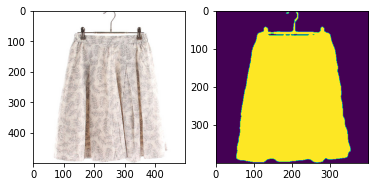

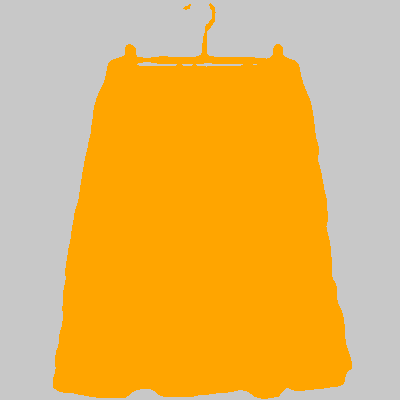

  0%|                                                               | 1/900 [00:00<02:39,  5.62it/s]

torch.Size([1, 3, 400, 400])
/mnt/nas4/hm/datasets/shopping_clothes/data/data900_personby100/dress/image/train_466.jpg
{'background': 0, 'top': 1, 'skirt': 2, 'outer': 3, 'dress': 4, 'bottom': 5}
Counter({0: 105355, 4: 54645})


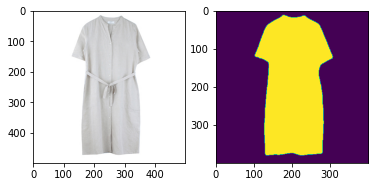

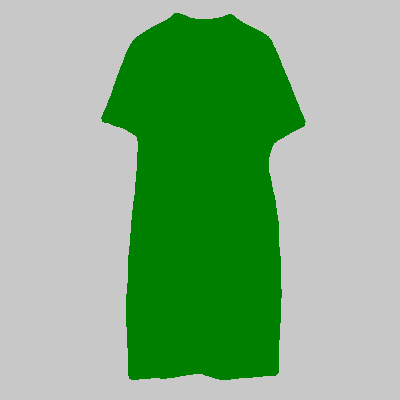

  0%|▏                                                              | 2/900 [00:00<02:21,  6.33it/s]

torch.Size([1, 3, 400, 400])
/mnt/nas4/hm/datasets/shopping_clothes/data/data900_personby100/bottom/image/train_1081.jpg
{'background': 0, 'top': 1, 'skirt': 2, 'outer': 3, 'dress': 4, 'bottom': 5}
Counter({5: 86001, 0: 73999})


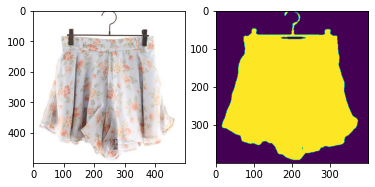

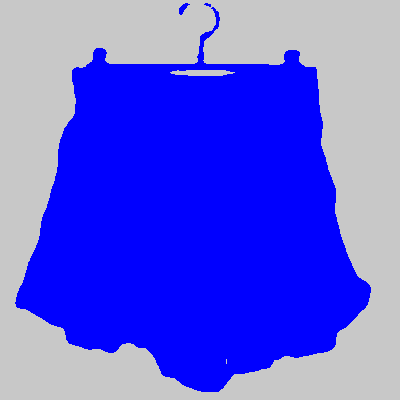

  0%|▏                                                              | 3/900 [00:00<02:16,  6.58it/s]

torch.Size([1, 3, 400, 400])
/mnt/nas4/hm/datasets/shopping_clothes/data/data900_personby100/bottom/image/train_3676.jpg
{'background': 0, 'top': 1, 'skirt': 2, 'outer': 3, 'dress': 4, 'bottom': 5}
Counter({0: 127919, 5: 32081})


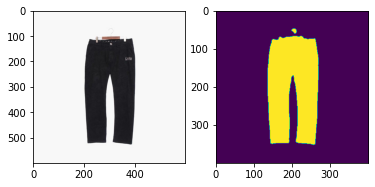

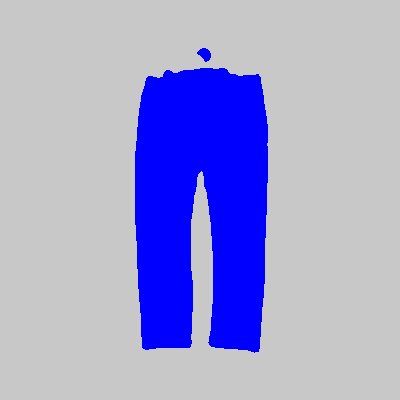

  0%|▎                                                              | 4/900 [00:00<02:14,  6.65it/s]

torch.Size([1, 3, 400, 400])
/mnt/nas4/hm/datasets/shopping_clothes/data/data900_personby100/top/image/train_11880.jpg
{'background': 0, 'top': 1, 'skirt': 2, 'outer': 3, 'dress': 4, 'bottom': 5}
Counter({0: 87918, 1: 72082})


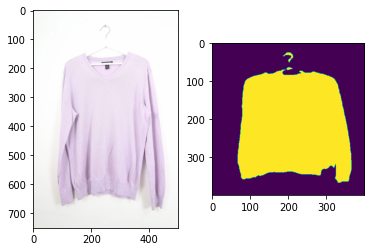

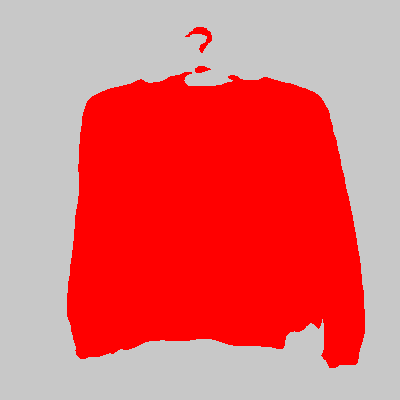

  1%|▎                                                              | 5/900 [00:00<02:17,  6.49it/s]

torch.Size([1, 3, 400, 400])
/mnt/nas4/hm/datasets/shopping_clothes/data/data900_personby100/outer/image/train_7378.jpg
{'background': 0, 'top': 1, 'skirt': 2, 'outer': 3, 'dress': 4, 'bottom': 5}
Counter({0: 106039, 3: 53961})


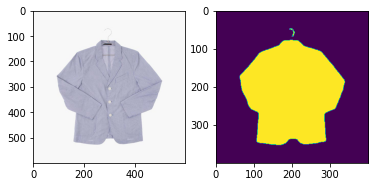

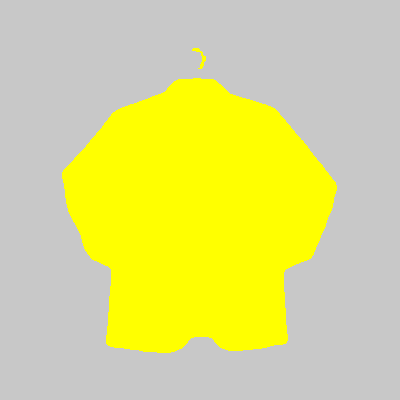

  1%|▍                                                              | 6/900 [00:00<02:16,  6.57it/s]

torch.Size([1, 3, 400, 400])
/mnt/nas4/hm/datasets/shopping_clothes/data/data900_personby100/bottom/image/train_2892.jpg
{'background': 0, 'top': 1, 'skirt': 2, 'outer': 3, 'dress': 4, 'bottom': 5}
Counter({0: 126543, 5: 33457})


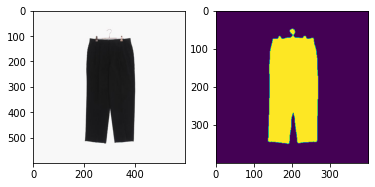

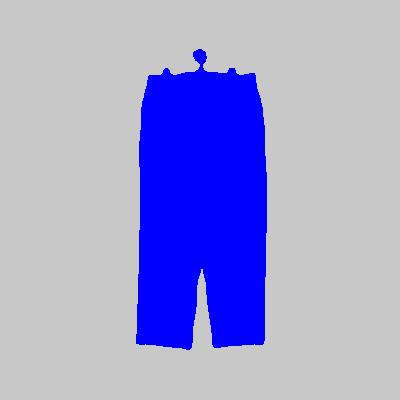

  1%|▍                                                              | 7/900 [00:01<02:14,  6.65it/s]

torch.Size([1, 3, 400, 400])
/mnt/nas4/hm/datasets/shopping_clothes/data/data900_personby100/outer/image/train_5416.jpg
{'background': 0, 'top': 1, 'skirt': 2, 'outer': 3, 'dress': 4, 'bottom': 5}
Counter({3: 92491, 0: 67509})


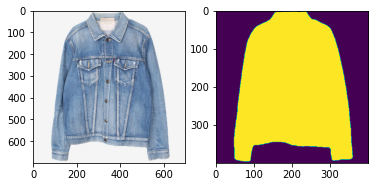

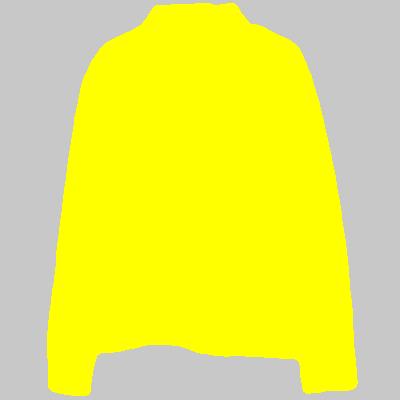

  1%|▌                                                              | 8/900 [00:01<02:34,  5.77it/s]

torch.Size([1, 3, 400, 400])
/mnt/nas4/hm/datasets/shopping_clothes/data/data900_personby100/top/image/train_11818.jpg
{'background': 0, 'top': 1, 'skirt': 2, 'outer': 3, 'dress': 4, 'bottom': 5}
Counter({0: 92569, 1: 67431})


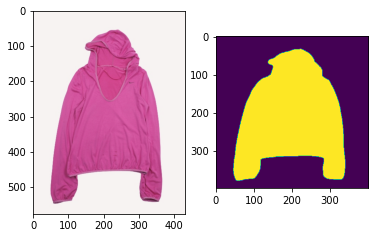

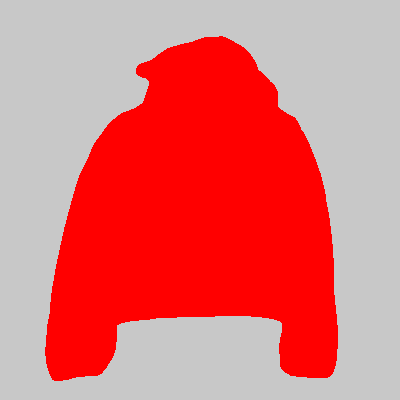

  1%|▋                                                              | 9/900 [00:01<02:27,  6.06it/s]

torch.Size([1, 3, 400, 400])
/mnt/nas4/hm/datasets/shopping_clothes/data/data900_personby100/skirt/image/train_520.jpg
{'background': 0, 'top': 1, 'skirt': 2, 'outer': 3, 'dress': 4, 'bottom': 5}
Counter({0: 91197, 2: 68803})


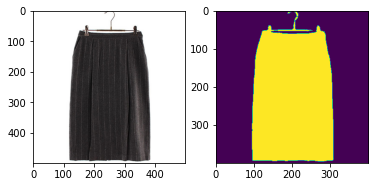

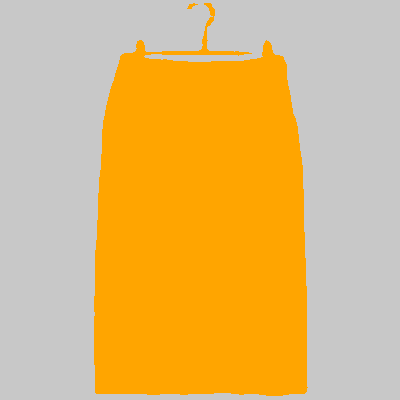

  1%|▋                                                             | 10/900 [00:01<02:20,  6.32it/s]

torch.Size([1, 3, 400, 400])
/mnt/nas4/hm/datasets/shopping_clothes/data/data900_personby100/bottom/image/train_1992.jpg
{'background': 0, 'top': 1, 'skirt': 2, 'outer': 3, 'dress': 4, 'bottom': 5}
Counter({0: 108430, 5: 51570})


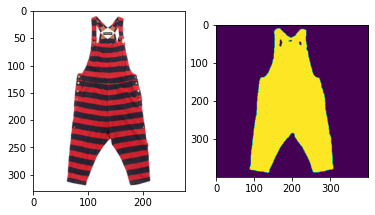

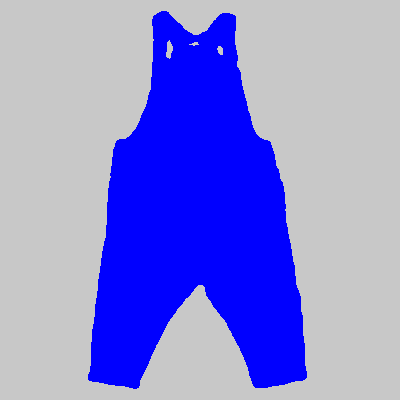

  1%|▊                                                             | 11/900 [00:01<02:14,  6.62it/s]

torch.Size([1, 3, 400, 400])
/mnt/nas4/hm/datasets/shopping_clothes/data/data900_personby100/bottom/image/train_439.jpg
{'background': 0, 'top': 1, 'skirt': 2, 'outer': 3, 'dress': 4, 'bottom': 5}
Counter({0: 97662, 5: 62338})


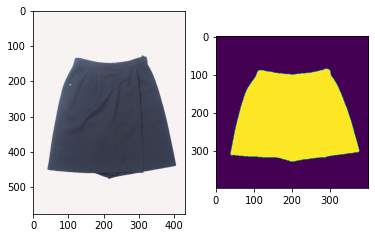

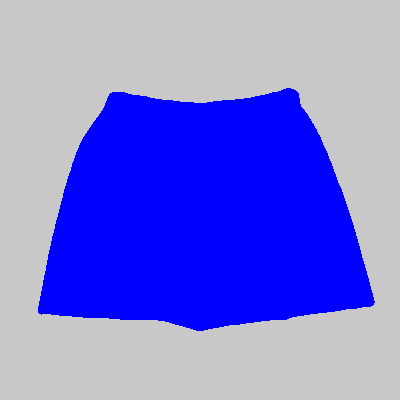

  1%|▊                                                             | 12/900 [00:01<02:12,  6.68it/s]

torch.Size([1, 3, 400, 400])
/mnt/nas4/hm/datasets/shopping_clothes/data/data900_personby100/dress/image/train_3383.jpg
{'background': 0, 'top': 1, 'skirt': 2, 'outer': 3, 'dress': 4, 'bottom': 5}
Counter({0: 109638, 4: 50362})


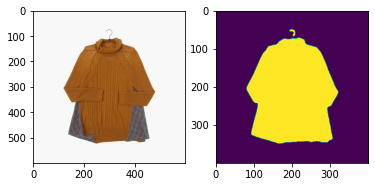

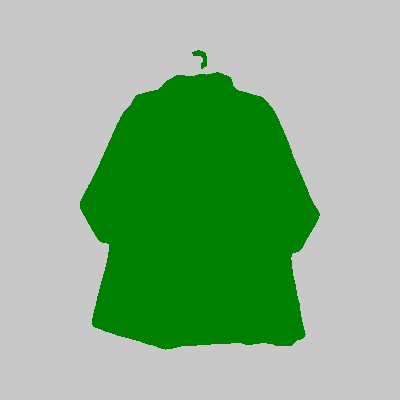

  1%|▉                                                             | 13/900 [00:02<02:12,  6.68it/s]

torch.Size([1, 3, 400, 400])
/mnt/nas4/hm/datasets/shopping_clothes/data/data900_personby100/bottom/image/train_1879.jpg
{'background': 0, 'top': 1, 'skirt': 2, 'outer': 3, 'dress': 4, 'bottom': 5}
Counter({0: 108052, 5: 51948})


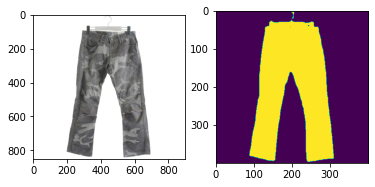

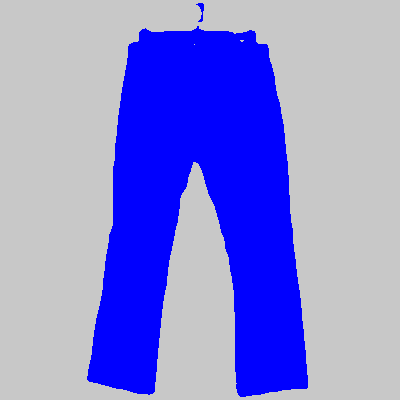

  2%|▉                                                             | 14/900 [00:02<02:21,  6.28it/s]

torch.Size([1, 3, 400, 400])
/mnt/nas4/hm/datasets/shopping_clothes/data/data900_personby100/dress/image/train_259.jpg
{'background': 0, 'top': 1, 'skirt': 2, 'outer': 3, 'dress': 4, 'bottom': 5}
Counter({0: 90588, 4: 69412})


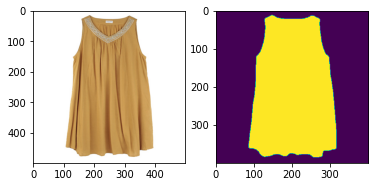

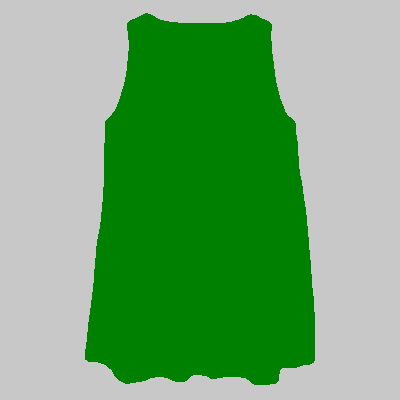

  2%|█                                                             | 15/900 [00:02<02:17,  6.44it/s]

torch.Size([1, 3, 400, 400])
/mnt/nas4/hm/datasets/shopping_clothes/data/data900_personby100/dress/image/train_2594.jpg
{'background': 0, 'top': 1, 'skirt': 2, 'outer': 3, 'dress': 4, 'bottom': 5}
Counter({0: 108263, 4: 51737})


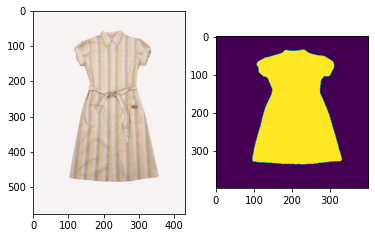

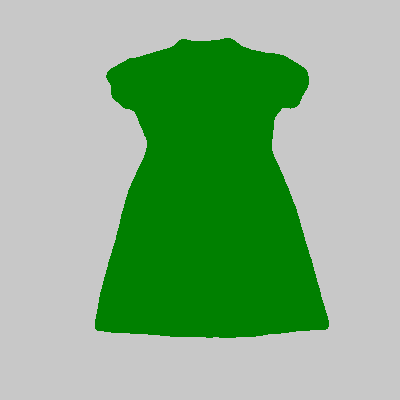

  2%|█                                                             | 16/900 [00:02<02:15,  6.54it/s]

torch.Size([1, 3, 400, 400])
/mnt/nas4/hm/datasets/shopping_clothes/data/data900_personby100/top/image/train_15546.jpg
{'background': 0, 'top': 1, 'skirt': 2, 'outer': 3, 'dress': 4, 'bottom': 5}
Counter({0: 90927, 1: 69073})


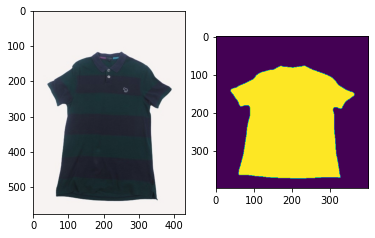

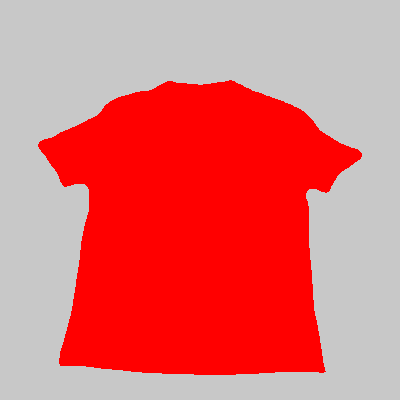

  2%|█▏                                                            | 17/900 [00:02<02:13,  6.60it/s]

torch.Size([1, 3, 400, 400])
/mnt/nas4/hm/datasets/shopping_clothes/data/data900_personby100/outer/image/train_8555.jpg
{'background': 0, 'top': 1, 'skirt': 2, 'outer': 3, 'dress': 4, 'bottom': 5}
Counter({3: 116798, 0: 43202})


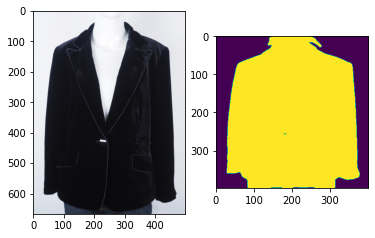

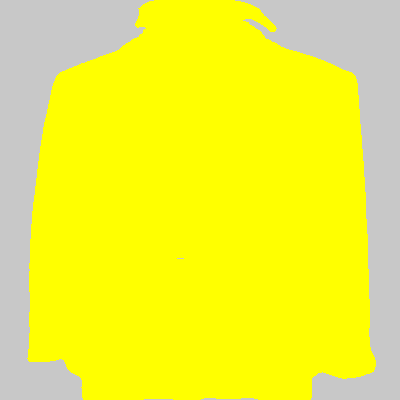

  2%|█▏                                                            | 18/900 [00:02<02:17,  6.43it/s]

torch.Size([1, 3, 400, 400])
/mnt/nas4/hm/datasets/shopping_clothes/data/data900_personby100/top/image/train_11283.jpg
{'background': 0, 'top': 1, 'skirt': 2, 'outer': 3, 'dress': 4, 'bottom': 5}
Counter({0: 80375, 1: 79625})


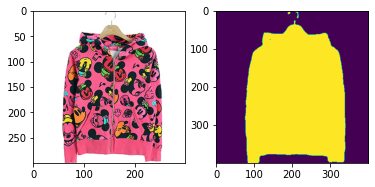

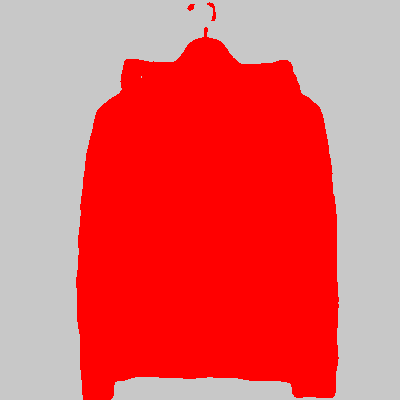

  2%|█▎                                                            | 19/900 [00:02<02:27,  5.97it/s]

torch.Size([1, 3, 400, 400])
/mnt/nas4/hm/datasets/shopping_clothes/data/data900_personby100/top/image/train_12746.jpg
{'background': 0, 'top': 1, 'skirt': 2, 'outer': 3, 'dress': 4, 'bottom': 5}
Counter({0: 124586, 1: 35414})


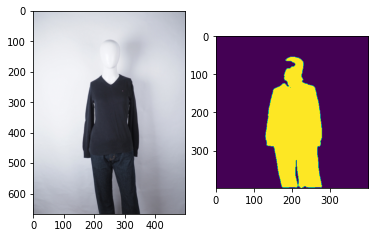

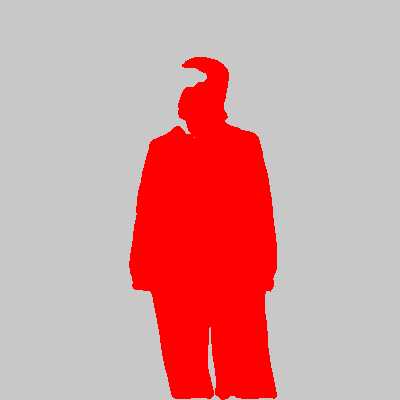

  2%|█▍                                                            | 20/900 [00:03<02:27,  5.97it/s]

torch.Size([1, 3, 400, 400])
/mnt/nas4/hm/datasets/shopping_clothes/data/data900_personby100/skirt/image/train_2053.jpg
{'background': 0, 'top': 1, 'skirt': 2, 'outer': 3, 'dress': 4, 'bottom': 5}
Counter({0: 84796, 2: 75204})


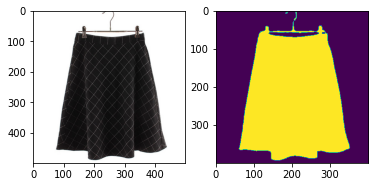

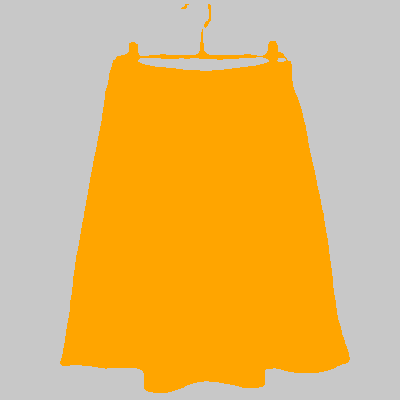

  2%|█▍                                                            | 21/900 [00:03<02:21,  6.22it/s]

torch.Size([1, 3, 400, 400])
/mnt/nas4/hm/datasets/shopping_clothes/data/data900_personby100/top/image/train_5324.jpg
{'background': 0, 'top': 1, 'skirt': 2, 'outer': 3, 'dress': 4, 'bottom': 5}
Counter({0: 99321, 1: 60679})


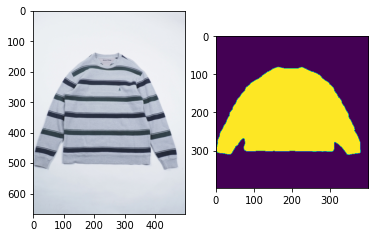

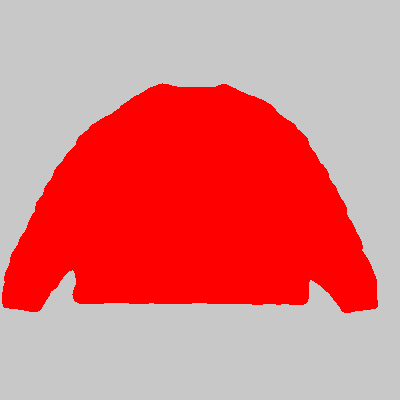

  2%|█▌                                                            | 22/900 [00:03<02:22,  6.15it/s]

torch.Size([1, 3, 400, 400])
/mnt/nas4/hm/datasets/shopping_clothes/data/data900_personby100/dress/image/train_1717.jpg
{'background': 0, 'top': 1, 'skirt': 2, 'outer': 3, 'dress': 4, 'bottom': 5}
Counter({0: 119148, 4: 40852})


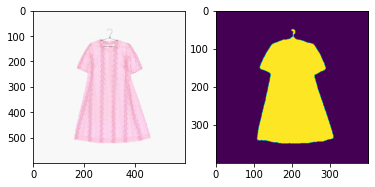

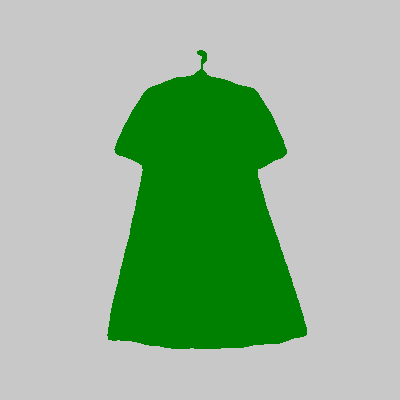

  3%|█▌                                                            | 23/900 [00:03<02:18,  6.32it/s]

torch.Size([1, 3, 400, 400])
/mnt/nas4/hm/datasets/shopping_clothes/data/data900_personby100/outer/image/train_10385.jpg
{'background': 0, 'top': 1, 'skirt': 2, 'outer': 3, 'dress': 4, 'bottom': 5}
Counter({0: 108720, 3: 51280})


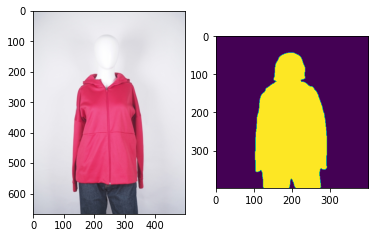

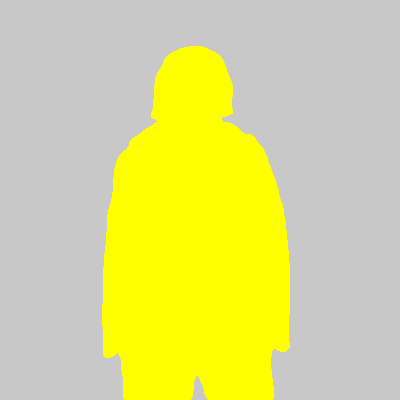

  3%|█▋                                                            | 24/900 [00:03<02:20,  6.25it/s]

torch.Size([1, 3, 400, 400])
/mnt/nas4/hm/datasets/shopping_clothes/data/data900_personby100/dress/image/train_3530.jpg
{'background': 0, 'top': 1, 'skirt': 2, 'outer': 3, 'dress': 4, 'bottom': 5}
Counter({0: 109591, 4: 50409})


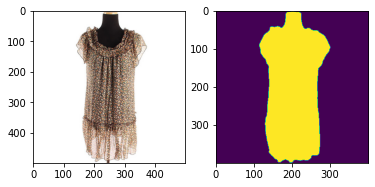

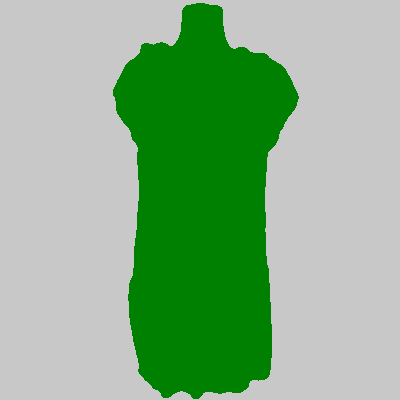

  3%|█▋                                                            | 25/900 [00:03<02:15,  6.44it/s]

torch.Size([1, 3, 400, 400])
/mnt/nas4/hm/datasets/shopping_clothes/data/data900_personby100/bottom/image/train_1305.jpg
{'background': 0, 'top': 1, 'skirt': 2, 'outer': 3, 'dress': 4, 'bottom': 5}
Counter({0: 87464, 5: 72536})


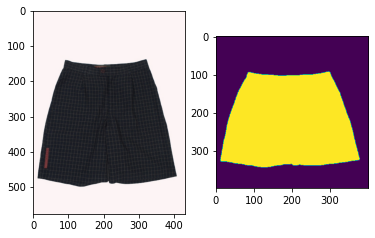

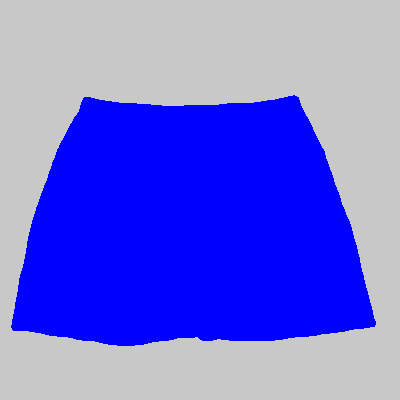

  3%|█▊                                                            | 26/900 [00:04<02:13,  6.54it/s]

torch.Size([1, 3, 400, 400])
/mnt/nas4/hm/datasets/shopping_clothes/data/data900_personby100/bottom/image/train_1744.jpg
{'background': 0, 'top': 1, 'skirt': 2, 'outer': 3, 'dress': 4, 'bottom': 5}
Counter({0: 111245, 5: 48755})


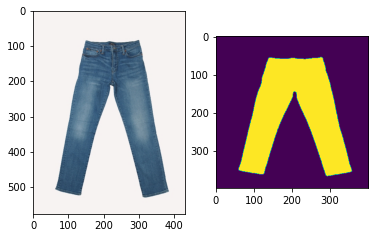

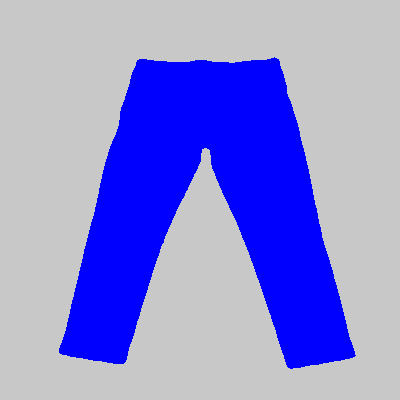

  3%|█▊                                                            | 27/900 [00:04<02:11,  6.63it/s]

torch.Size([1, 3, 400, 400])
/mnt/nas4/hm/datasets/shopping_clothes/data/data900_personby100/dress/image/train_2371.jpg
{'background': 0, 'top': 1, 'skirt': 2, 'outer': 3, 'dress': 4, 'bottom': 5}
Counter({0: 121402, 4: 38598})


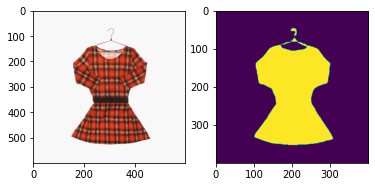

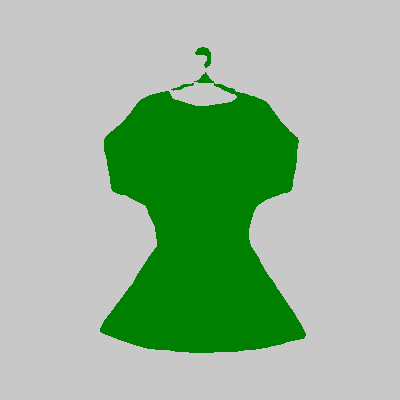

  3%|█▉                                                            | 28/900 [00:04<02:10,  6.67it/s]

torch.Size([1, 3, 400, 400])
/mnt/nas4/hm/datasets/shopping_clothes/data/data900_personby100/outer/image/train_9417.jpg
{'background': 0, 'top': 1, 'skirt': 2, 'outer': 3, 'dress': 4, 'bottom': 5}
Counter({3: 101780, 0: 58220})


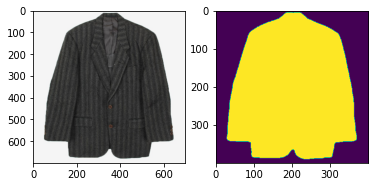

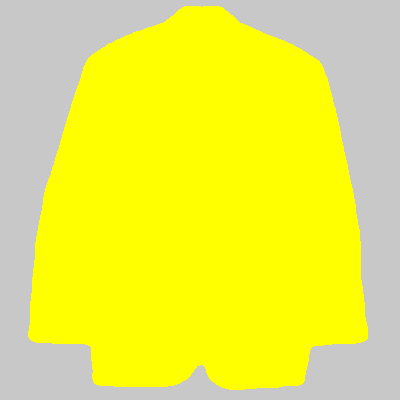

  3%|█▉                                                            | 29/900 [00:04<02:14,  6.48it/s]

torch.Size([1, 3, 400, 400])
/mnt/nas4/hm/datasets/shopping_clothes/data/data900_personby100/dress/image/train_1979.jpg
{'background': 0, 'top': 1, 'skirt': 2, 'outer': 3, 'dress': 4, 'bottom': 5}
Counter({0: 102765, 4: 57235})


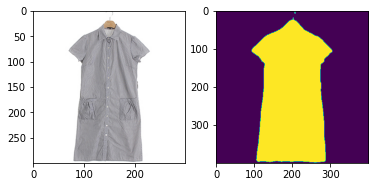

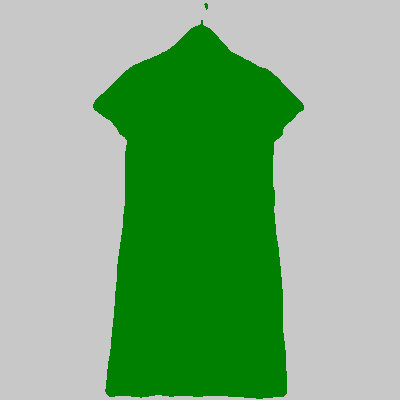

  3%|██                                                            | 30/900 [00:04<02:24,  6.04it/s]

torch.Size([1, 3, 400, 400])
/mnt/nas4/hm/datasets/shopping_clothes/data/data900_personby100/bottom/image/train_1844.jpg
{'background': 0, 'top': 1, 'skirt': 2, 'outer': 3, 'dress': 4, 'bottom': 5}
Counter({0: 124327, 5: 35673})


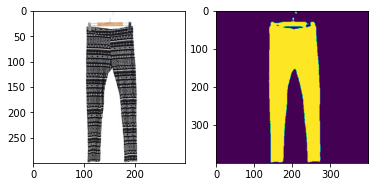

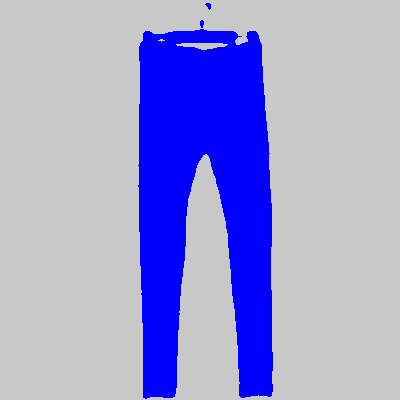

  3%|██▏                                                           | 31/900 [00:04<02:14,  6.44it/s]

torch.Size([1, 3, 400, 400])
/mnt/nas4/hm/datasets/shopping_clothes/data/data900_personby100/dress/image/train_2801.jpg
{'background': 0, 'top': 1, 'skirt': 2, 'outer': 3, 'dress': 4, 'bottom': 5}
Counter({0: 101757, 4: 58243})


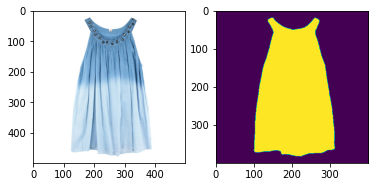

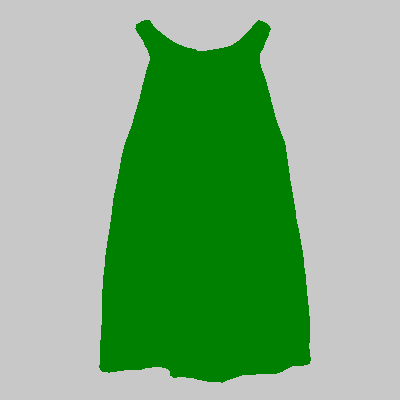

  4%|██▏                                                           | 32/900 [00:05<02:12,  6.57it/s]

torch.Size([1, 3, 400, 400])
/mnt/nas4/hm/datasets/shopping_clothes/data/data900_personby100/skirt/image/train_87.jpg
{'background': 0, 'top': 1, 'skirt': 2, 'outer': 3, 'dress': 4, 'bottom': 5}
Counter({0: 116997, 2: 43003})


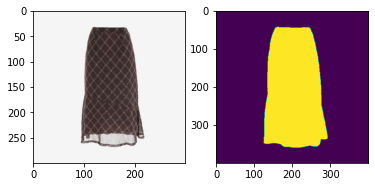

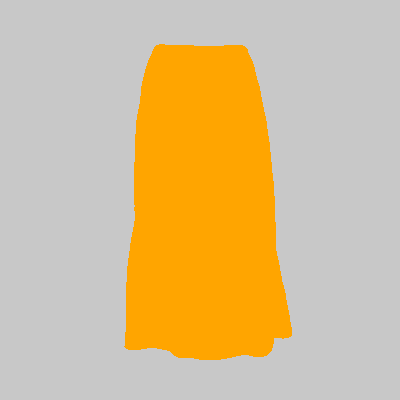

  4%|██▎                                                           | 33/900 [00:05<02:06,  6.85it/s]

torch.Size([1, 3, 400, 400])
/mnt/nas4/hm/datasets/shopping_clothes/data/data900_personby100/outer/image/train_9887.jpg
{'background': 0, 'top': 1, 'skirt': 2, 'outer': 3, 'dress': 4, 'bottom': 5}
Counter({0: 117113, 3: 42887})


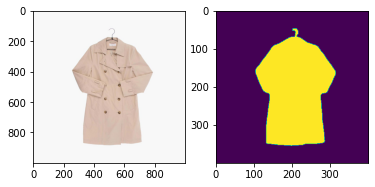

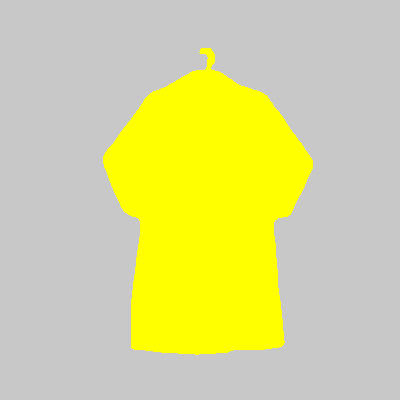

  4%|██▎                                                           | 34/900 [00:05<02:18,  6.24it/s]

torch.Size([1, 3, 400, 400])
/mnt/nas4/hm/datasets/shopping_clothes/data/data900_personby100/skirt/image/train_126.jpg
{'background': 0, 'top': 1, 'skirt': 2, 'outer': 3, 'dress': 4, 'bottom': 5}
Counter({2: 85224, 0: 74776})


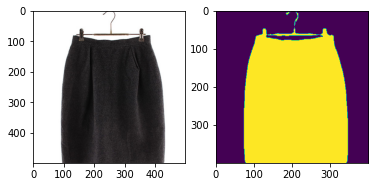

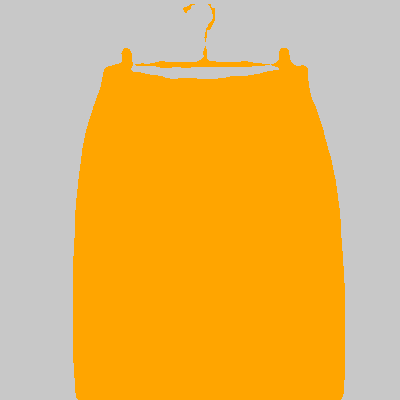

  4%|██▍                                                           | 35/900 [00:05<02:14,  6.45it/s]

torch.Size([1, 3, 400, 400])
/mnt/nas4/hm/datasets/shopping_clothes/data/data900_personby100/dress/image/train_1567.jpg
{'background': 0, 'top': 1, 'skirt': 2, 'outer': 3, 'dress': 4, 'bottom': 5}
Counter({0: 123957, 4: 36043})


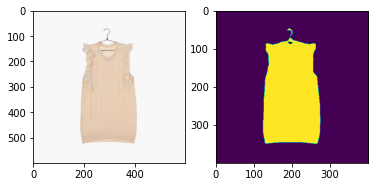

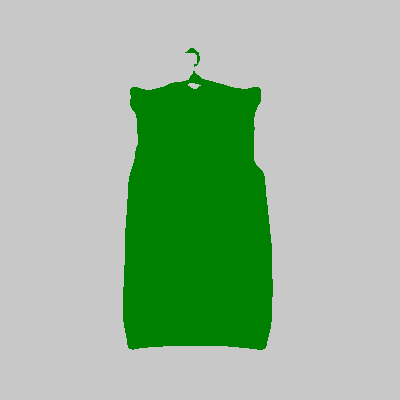

  4%|██▍                                                           | 36/900 [00:05<02:12,  6.52it/s]

torch.Size([1, 3, 400, 400])
/mnt/nas4/hm/datasets/shopping_clothes/data/data900_personby100/skirt/image/train_186.jpg
{'background': 0, 'top': 1, 'skirt': 2, 'outer': 3, 'dress': 4, 'bottom': 5}
Counter({0: 83861, 2: 76139})


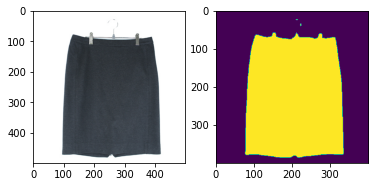

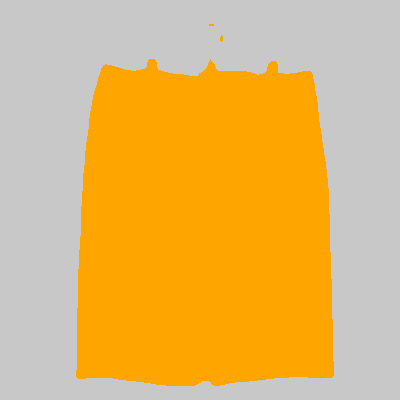

  4%|██▌                                                           | 37/900 [00:05<02:10,  6.60it/s]

torch.Size([1, 3, 400, 400])
/mnt/nas4/hm/datasets/shopping_clothes/data/data900_personby100/dress/image/train_1857.jpg
{'background': 0, 'top': 1, 'skirt': 2, 'outer': 3, 'dress': 4, 'bottom': 5}
Counter({0: 98774, 4: 61226})


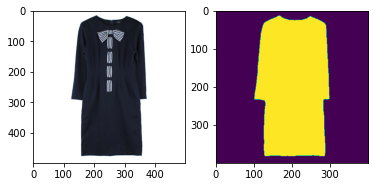

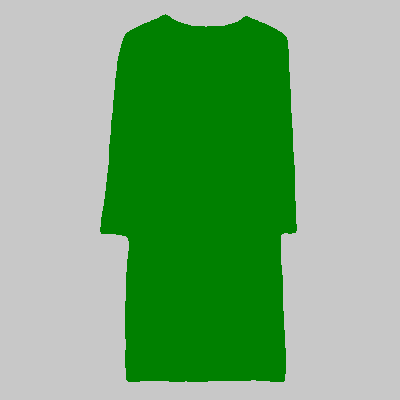

  4%|██▌                                                           | 38/900 [00:05<02:08,  6.70it/s]

torch.Size([1, 3, 400, 400])
/mnt/nas4/hm/datasets/shopping_clothes/data/data900_personby100/top/image/train_14802.jpg
{'background': 0, 'top': 1, 'skirt': 2, 'outer': 3, 'dress': 4, 'bottom': 5}
Counter({0: 102666, 1: 57334})


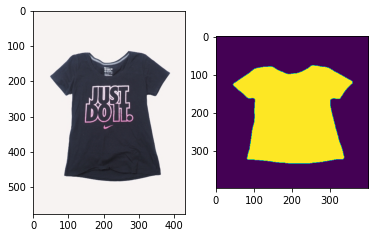

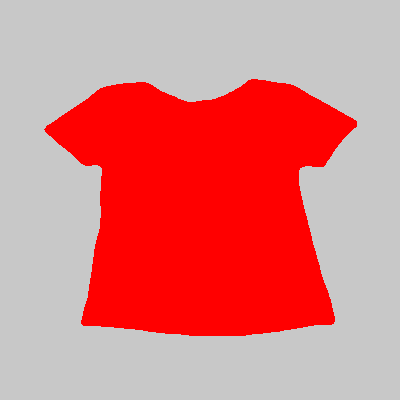

  4%|██▋                                                           | 39/900 [00:06<02:07,  6.75it/s]

torch.Size([1, 3, 400, 400])
/mnt/nas4/hm/datasets/shopping_clothes/data/data900_personby100/outer/image/train_outer_2928.jpg
{'background': 0, 'top': 1, 'skirt': 2, 'outer': 3, 'dress': 4, 'bottom': 5}
Counter({3: 100088, 0: 59912})


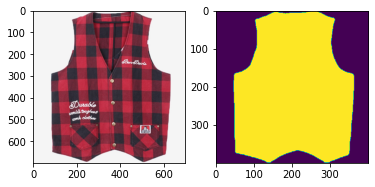

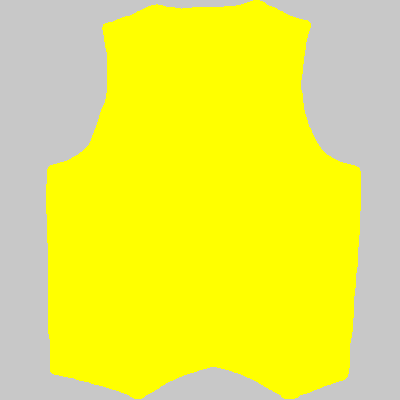

  4%|██▊                                                           | 40/900 [00:06<02:12,  6.47it/s]

torch.Size([1, 3, 400, 400])
/mnt/nas4/hm/datasets/shopping_clothes/data/data900_personby100/bottom/image/train_3189.jpg
{'background': 0, 'top': 1, 'skirt': 2, 'outer': 3, 'dress': 4, 'bottom': 5}
Counter({0: 110859, 5: 49141})


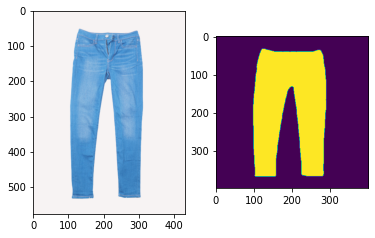

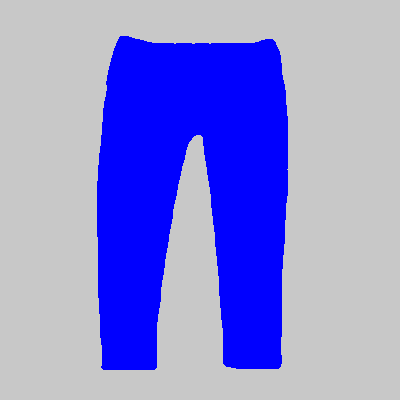

  5%|██▊                                                           | 41/900 [00:06<02:26,  5.86it/s]

torch.Size([1, 3, 400, 400])
/mnt/nas4/hm/datasets/shopping_clothes/data/data900_personby100/bottom/image/train_3644.jpg
{'background': 0, 'top': 1, 'skirt': 2, 'outer': 3, 'dress': 4, 'bottom': 5}
Counter({0: 102001, 5: 57999})


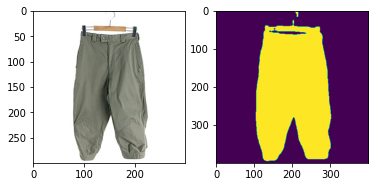

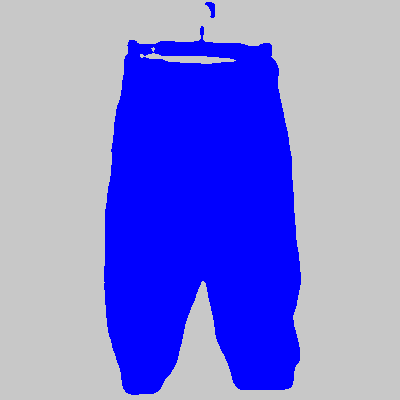

  5%|██▉                                                           | 42/900 [00:06<02:16,  6.27it/s]

torch.Size([1, 3, 400, 400])
/mnt/nas4/hm/datasets/shopping_clothes/data/data900_personby100/outer/image/train_3784.jpg
{'background': 0, 'top': 1, 'skirt': 2, 'outer': 3, 'dress': 4, 'bottom': 5}
Counter({0: 94609, 3: 65391})


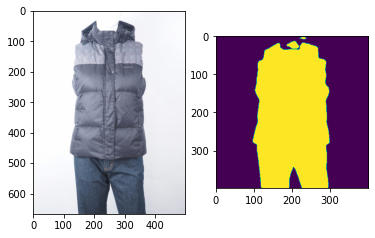

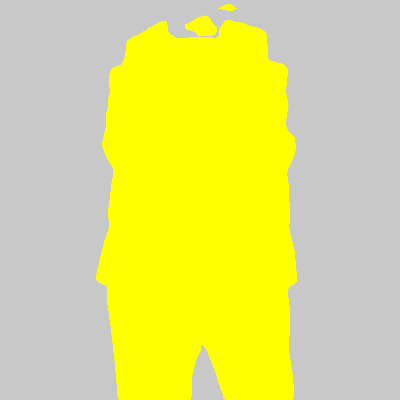

  5%|██▉                                                           | 43/900 [00:06<02:17,  6.22it/s]

torch.Size([1, 3, 400, 400])
/mnt/nas4/hm/datasets/shopping_clothes/data/data900_personby100/bottom/image/train_2936.jpg
{'background': 0, 'top': 1, 'skirt': 2, 'outer': 3, 'dress': 4, 'bottom': 5}
Counter({0: 108182, 5: 51818})


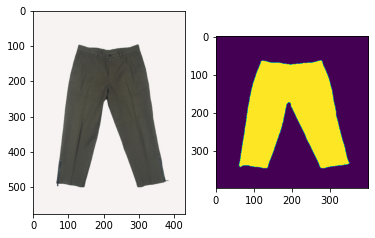

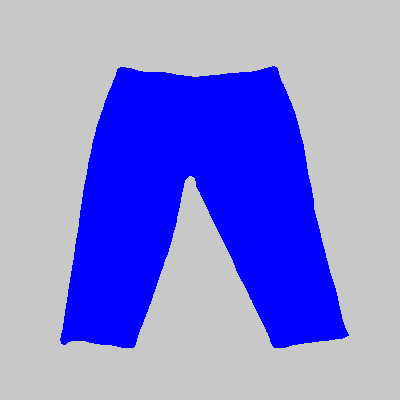

  5%|███                                                           | 44/900 [00:06<02:13,  6.39it/s]

torch.Size([1, 3, 400, 400])
/mnt/nas4/hm/datasets/shopping_clothes/data/data900_personby100/top/image/train_18392.jpg
{'background': 0, 'top': 1, 'skirt': 2, 'outer': 3, 'dress': 4, 'bottom': 5}
Counter({0: 97970, 1: 62030})


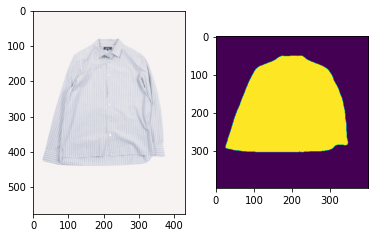

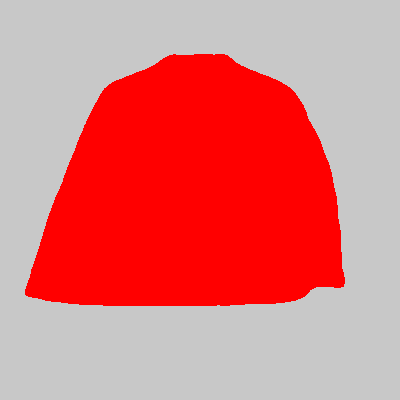

  5%|███                                                           | 45/900 [00:07<02:11,  6.52it/s]

torch.Size([1, 3, 400, 400])
/mnt/nas4/hm/datasets/shopping_clothes/data/data900_personby100/top/image/train_3244.jpg
{'background': 0, 'top': 1, 'skirt': 2, 'outer': 3, 'dress': 4, 'bottom': 5}
Counter({0: 91993, 1: 68007})


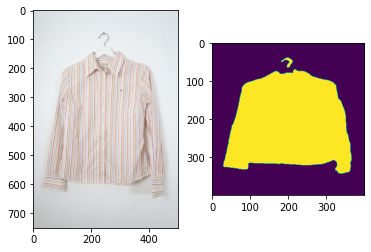

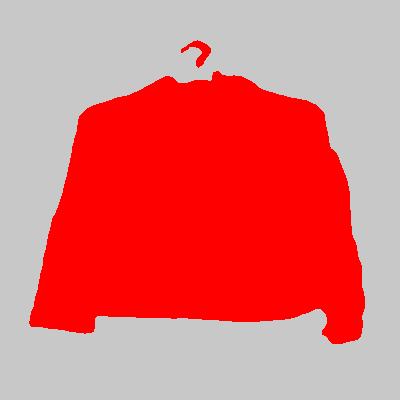

  5%|███▏                                                          | 46/900 [00:07<02:13,  6.42it/s]

torch.Size([1, 3, 400, 400])
/mnt/nas4/hm/datasets/shopping_clothes/data/data900_personby100/skirt/image/train_2851.jpg
{'background': 0, 'top': 1, 'skirt': 2, 'outer': 3, 'dress': 4, 'bottom': 5}
Counter({0: 97776, 2: 62224})


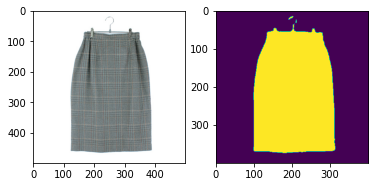

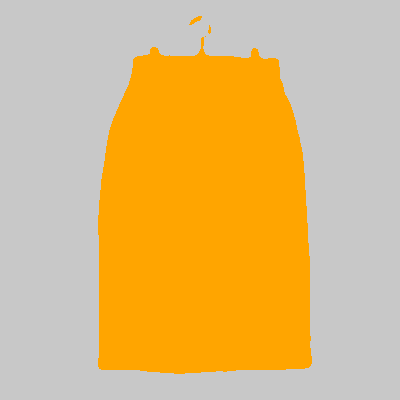

  5%|███▏                                                          | 47/900 [00:07<02:10,  6.56it/s]

torch.Size([1, 3, 400, 400])
/mnt/nas4/hm/datasets/shopping_clothes/data/data900_personby100/bottom/image/train_874.jpg
{'background': 0, 'top': 1, 'skirt': 2, 'outer': 3, 'dress': 4, 'bottom': 5}
Counter({0: 99371, 5: 60629})


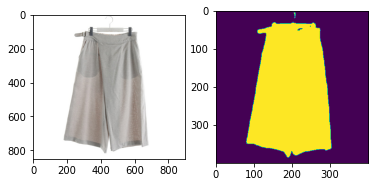

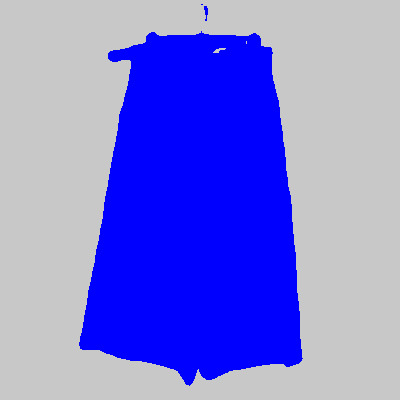

  5%|███▎                                                          | 48/900 [00:07<02:17,  6.19it/s]

torch.Size([1, 3, 400, 400])
/mnt/nas4/hm/datasets/shopping_clothes/data/data900_personby100/bottom/image/train_2630.jpg
{'background': 0, 'top': 1, 'skirt': 2, 'outer': 3, 'dress': 4, 'bottom': 5}
Counter({5: 99616, 0: 60384})


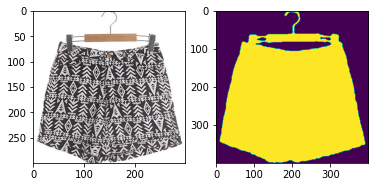

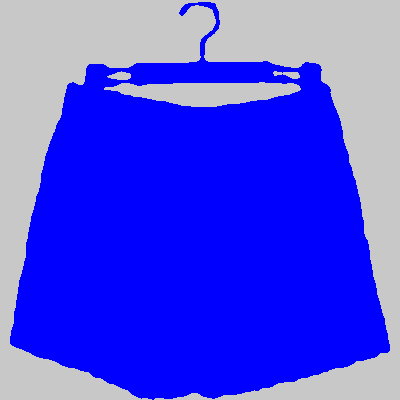

  5%|███▍                                                          | 49/900 [00:07<02:09,  6.55it/s]

torch.Size([1, 3, 400, 400])
/mnt/nas4/hm/datasets/shopping_clothes/data/data900_personby100/skirt/image/train_1889.jpg
{'background': 0, 'top': 1, 'skirt': 2, 'outer': 3, 'dress': 4, 'bottom': 5}
Counter({0: 88840, 2: 71160})


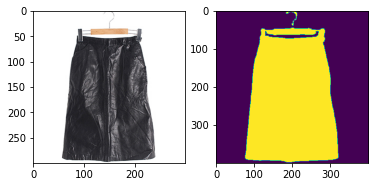

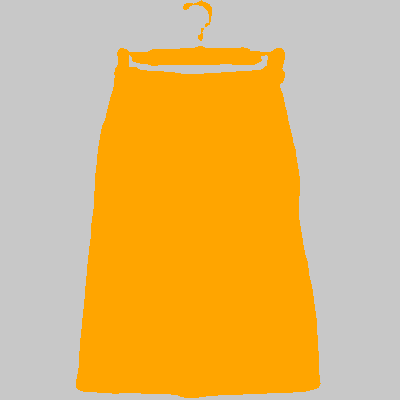

  6%|███▍                                                          | 50/900 [00:07<02:04,  6.83it/s]

torch.Size([1, 3, 400, 400])
/mnt/nas4/hm/datasets/shopping_clothes/data/data900_personby100/top/image/train_10332.jpg
{'background': 0, 'top': 1, 'skirt': 2, 'outer': 3, 'dress': 4, 'bottom': 5}
Counter({1: 81282, 0: 78718})


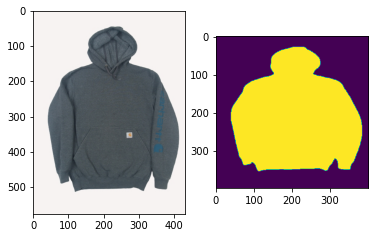

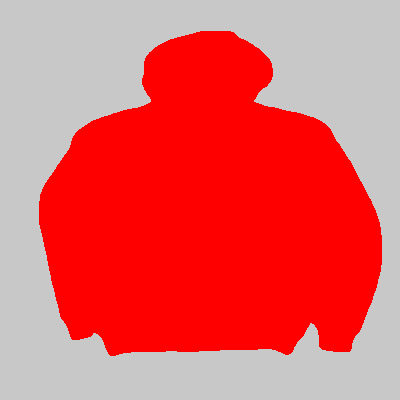

  6%|███▌                                                          | 51/900 [00:07<02:04,  6.80it/s]

torch.Size([1, 3, 400, 400])
/mnt/nas4/hm/datasets/shopping_clothes/data/data900_personby100/outer/image/train_7891.jpg
{'background': 0, 'top': 1, 'skirt': 2, 'outer': 3, 'dress': 4, 'bottom': 5}
Counter({3: 82582, 0: 77418})


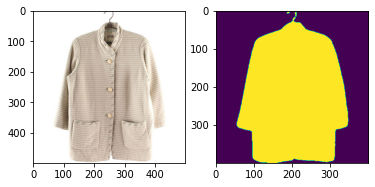

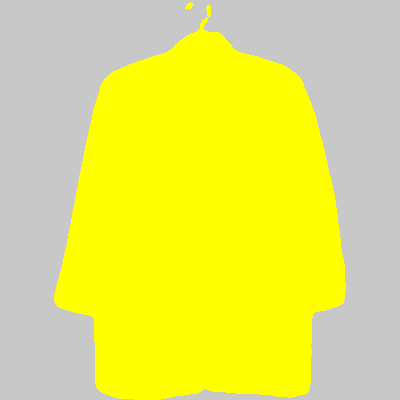

  6%|███▌                                                          | 52/900 [00:08<02:18,  6.12it/s]

torch.Size([1, 3, 400, 400])
/mnt/nas4/hm/datasets/shopping_clothes/data/data900_personby100/skirt/image/train_368.jpg
{'background': 0, 'top': 1, 'skirt': 2, 'outer': 3, 'dress': 4, 'bottom': 5}
Counter({0: 103326, 2: 56674})


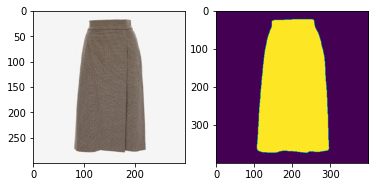

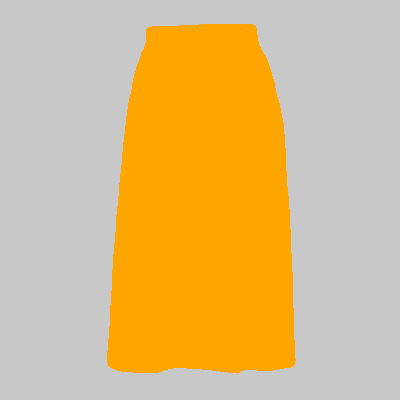

  6%|███▋                                                          | 53/900 [00:08<02:10,  6.50it/s]

torch.Size([1, 3, 400, 400])
/mnt/nas4/hm/datasets/shopping_clothes/data/data900_personby100/skirt/image/train_2759.jpg
{'background': 0, 'top': 1, 'skirt': 2, 'outer': 3, 'dress': 4, 'bottom': 5}
Counter({0: 107503, 2: 52497})


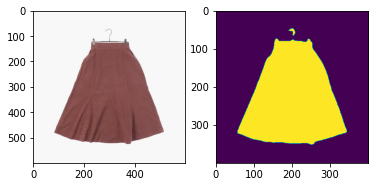

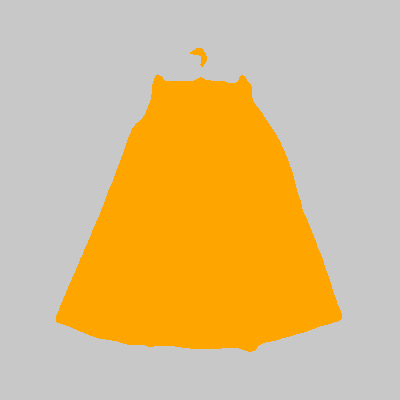

  6%|███▋                                                          | 54/900 [00:08<02:09,  6.54it/s]

torch.Size([1, 3, 400, 400])
/mnt/nas4/hm/datasets/shopping_clothes/data/data900_personby100/dress/image/train_1731.jpg
{'background': 0, 'top': 1, 'skirt': 2, 'outer': 3, 'dress': 4, 'bottom': 5}
Counter({0: 114989, 4: 45011})


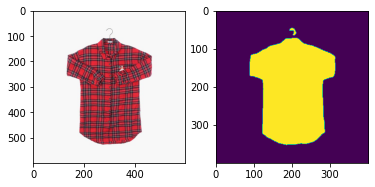

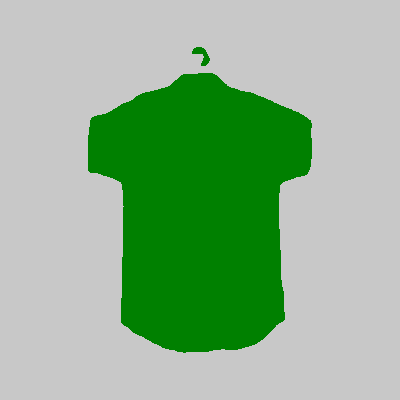

  6%|███▊                                                          | 55/900 [00:08<02:08,  6.56it/s]

torch.Size([1, 3, 400, 400])
/mnt/nas4/hm/datasets/shopping_clothes/data/data900_personby100/dress/image/train_1754.jpg
{'background': 0, 'top': 1, 'skirt': 2, 'outer': 3, 'dress': 4, 'bottom': 5}
Counter({4: 87843, 0: 72157})


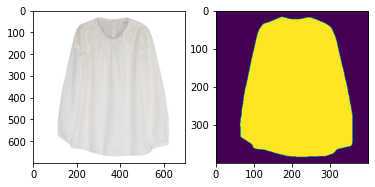

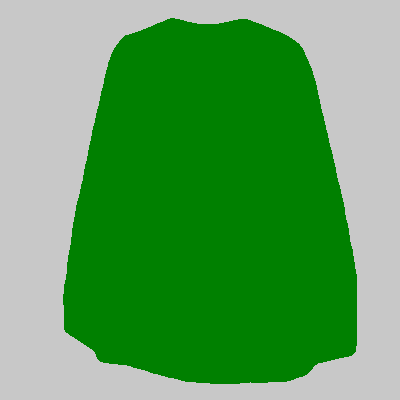

  6%|███▊                                                          | 56/900 [00:08<02:12,  6.37it/s]

torch.Size([1, 3, 400, 400])
/mnt/nas4/hm/datasets/shopping_clothes/data/data900_personby100/dress/image/train_2316.jpg
{'background': 0, 'top': 1, 'skirt': 2, 'outer': 3, 'dress': 4, 'bottom': 5}
Counter({0: 117872, 4: 42128})


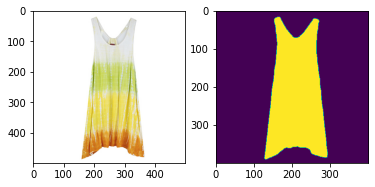

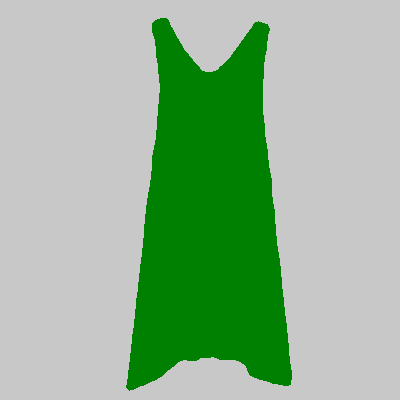

  6%|███▉                                                          | 57/900 [00:08<02:09,  6.52it/s]

torch.Size([1, 3, 400, 400])
/mnt/nas4/hm/datasets/shopping_clothes/data/data900_personby100/skirt/image/train_2284.jpg
{'background': 0, 'top': 1, 'skirt': 2, 'outer': 3, 'dress': 4, 'bottom': 5}
Counter({0: 107789, 2: 52211})


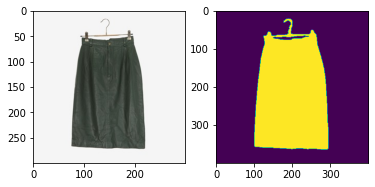

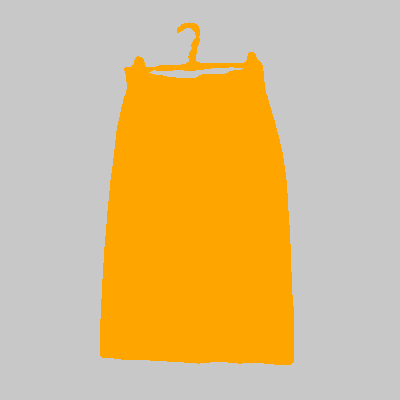

  6%|███▉                                                          | 58/900 [00:09<02:03,  6.79it/s]

torch.Size([1, 3, 400, 400])
/mnt/nas4/hm/datasets/shopping_clothes/data/data900_personby100/dress/image/train_1777.jpg
{'background': 0, 'top': 1, 'skirt': 2, 'outer': 3, 'dress': 4, 'bottom': 5}
Counter({0: 121802, 4: 38198})


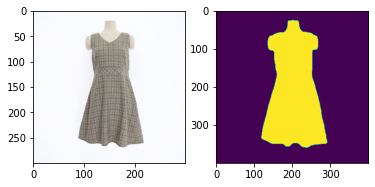

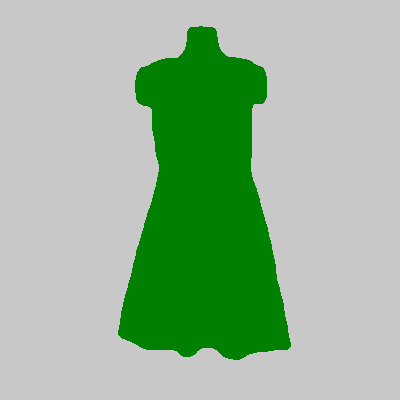

  7%|████                                                          | 59/900 [00:09<01:59,  7.01it/s]

torch.Size([1, 3, 400, 400])
/mnt/nas4/hm/datasets/shopping_clothes/data/data900_personby100/bottom/image/train_1807.jpg
{'background': 0, 'top': 1, 'skirt': 2, 'outer': 3, 'dress': 4, 'bottom': 5}
Counter({0: 109705, 5: 50295})


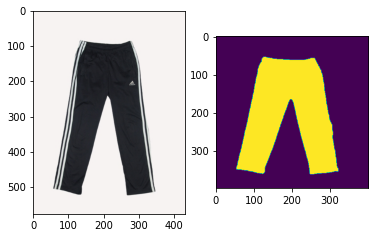

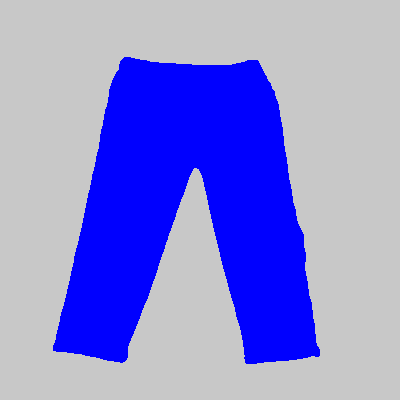

  7%|████▏                                                         | 60/900 [00:09<02:01,  6.93it/s]

torch.Size([1, 3, 400, 400])
/mnt/nas4/hm/datasets/shopping_clothes/data/data900_personby100/outer/image/train_1757.jpg
{'background': 0, 'top': 1, 'skirt': 2, 'outer': 3, 'dress': 4, 'bottom': 5}
Counter({0: 94040, 3: 65960})


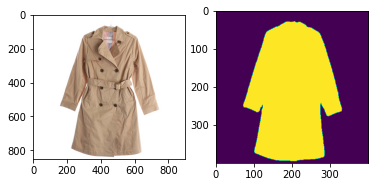

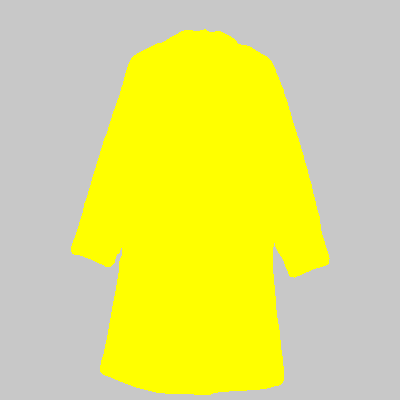

  7%|████▏                                                         | 61/900 [00:09<02:12,  6.32it/s]

torch.Size([1, 3, 400, 400])
/mnt/nas4/hm/datasets/shopping_clothes/data/data900_personby100/outer/image/train_5130.jpg
{'background': 0, 'top': 1, 'skirt': 2, 'outer': 3, 'dress': 4, 'bottom': 5}
Counter({0: 85347, 3: 74653})


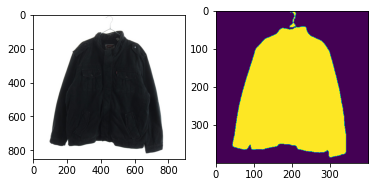

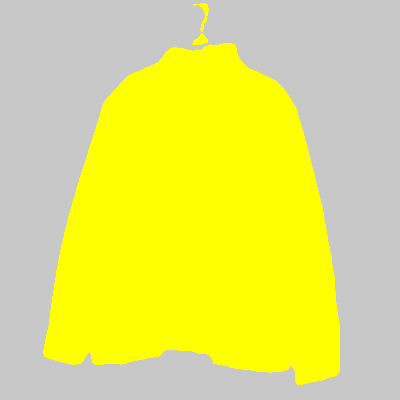

  7%|████▎                                                         | 62/900 [00:09<02:19,  6.01it/s]

torch.Size([1, 3, 400, 400])
/mnt/nas4/hm/datasets/shopping_clothes/data/data900_personby100/skirt/image/train_786.jpg
{'background': 0, 'top': 1, 'skirt': 2, 'outer': 3, 'dress': 4, 'bottom': 5}
Counter({2: 85513, 0: 74487})


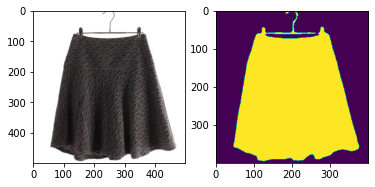

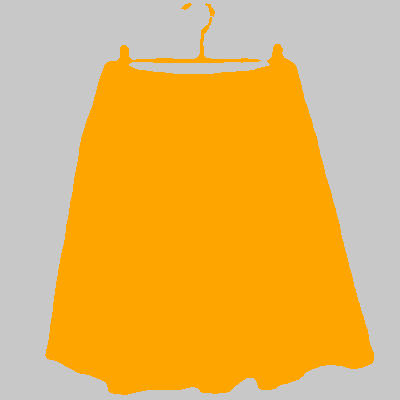

  7%|████▎                                                         | 63/900 [00:09<02:29,  5.59it/s]

torch.Size([1, 3, 400, 400])
/mnt/nas4/hm/datasets/shopping_clothes/data/data900_personby100/bottom/image/train_247.jpg
{'background': 0, 'top': 1, 'skirt': 2, 'outer': 3, 'dress': 4, 'bottom': 5}
Counter({0: 96715, 5: 63285})


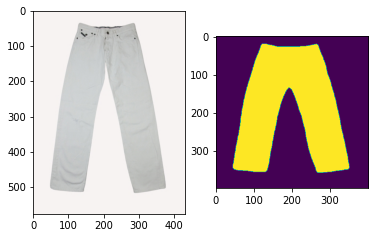

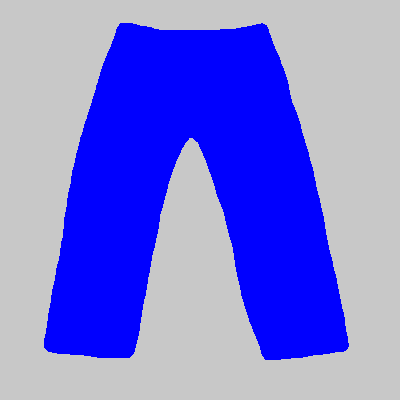

  7%|████▍                                                         | 64/900 [00:10<02:22,  5.88it/s]

torch.Size([1, 3, 400, 400])
/mnt/nas4/hm/datasets/shopping_clothes/data/data900_personby100/top/image/train_4067.jpg
{'background': 0, 'top': 1, 'skirt': 2, 'outer': 3, 'dress': 4, 'bottom': 5}
Counter({1: 86689, 0: 73311})


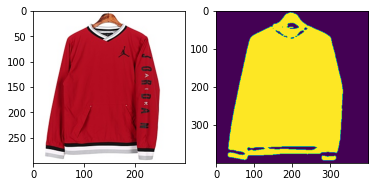

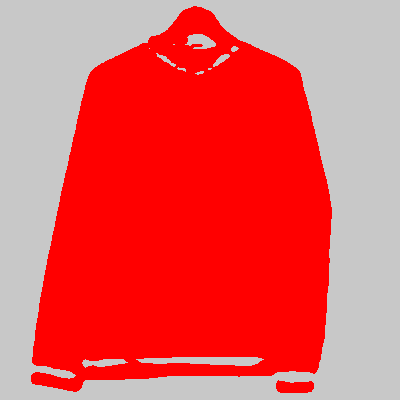

  7%|████▍                                                         | 65/900 [00:10<02:13,  6.27it/s]

torch.Size([1, 3, 400, 400])
/mnt/nas4/hm/datasets/shopping_clothes/data/data900_personby100/dress/image/train_3219.jpg
{'background': 0, 'top': 1, 'skirt': 2, 'outer': 3, 'dress': 4, 'bottom': 5}
Counter({0: 91869, 4: 68131})


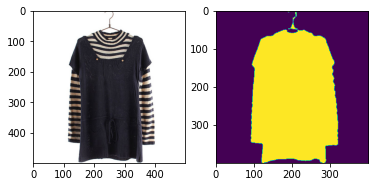

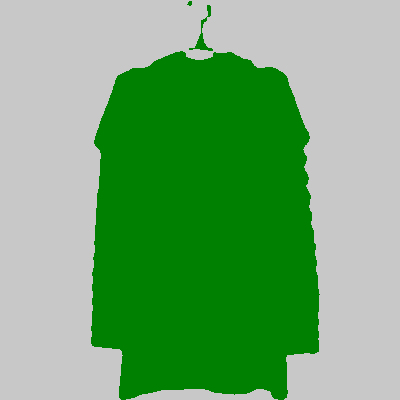

  7%|████▌                                                         | 66/900 [00:10<02:09,  6.45it/s]

torch.Size([1, 3, 400, 400])
/mnt/nas4/hm/datasets/shopping_clothes/data/data900_personby100/outer/image/train_3813.jpg
{'background': 0, 'top': 1, 'skirt': 2, 'outer': 3, 'dress': 4, 'bottom': 5}
Counter({0: 103581, 3: 56419})


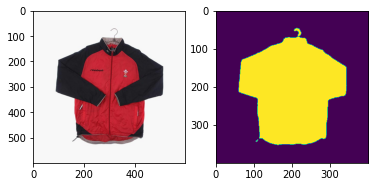

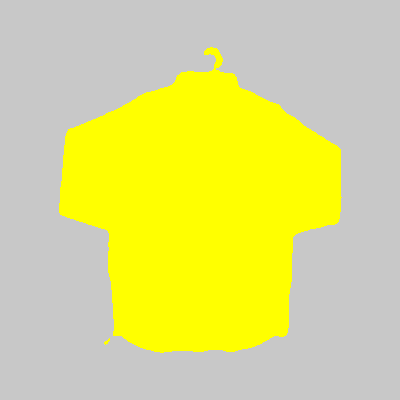

  7%|████▌                                                         | 67/900 [00:10<02:08,  6.49it/s]

torch.Size([1, 3, 400, 400])
/mnt/nas4/hm/datasets/shopping_clothes/data/data900_personby100/outer/image/train_10495.jpg
{'background': 0, 'top': 1, 'skirt': 2, 'outer': 3, 'dress': 4, 'bottom': 5}
Counter({0: 89147, 3: 70853})


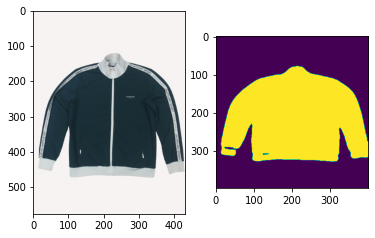

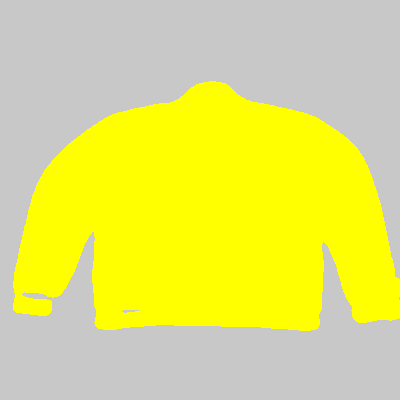

  8%|████▋                                                         | 68/900 [00:10<02:07,  6.55it/s]

torch.Size([1, 3, 400, 400])
/mnt/nas4/hm/datasets/shopping_clothes/data/data900_personby100/skirt/image/train_2351.jpg
{'background': 0, 'top': 1, 'skirt': 2, 'outer': 3, 'dress': 4, 'bottom': 5}
Counter({0: 95894, 2: 64106})


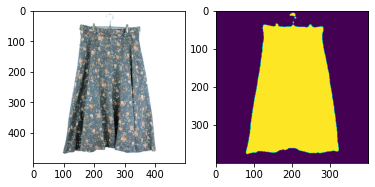

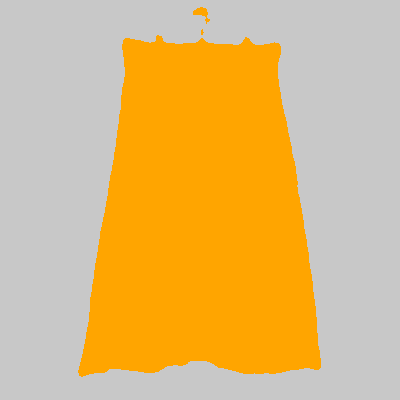

  8%|████▊                                                         | 69/900 [00:10<02:06,  6.58it/s]

torch.Size([1, 3, 400, 400])
/mnt/nas4/hm/datasets/shopping_clothes/data/data900_personby100/top/image/train_17082.jpg
{'background': 0, 'top': 1, 'skirt': 2, 'outer': 3, 'dress': 4, 'bottom': 5}
Counter({0: 99316, 1: 60684})


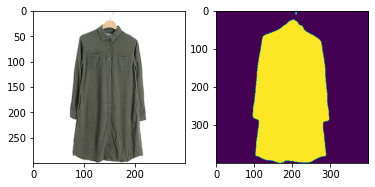

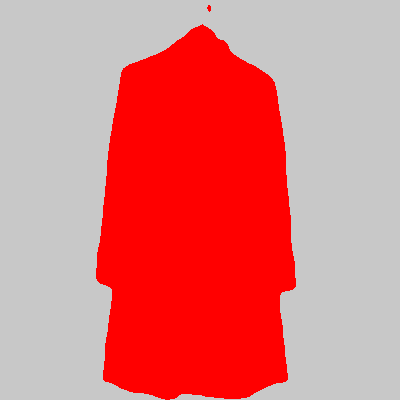

  8%|████▊                                                         | 70/900 [00:10<02:01,  6.82it/s]

torch.Size([1, 3, 400, 400])
/mnt/nas4/hm/datasets/shopping_clothes/data/data900_personby100/outer/image/train_485.jpg
{'background': 0, 'top': 1, 'skirt': 2, 'outer': 3, 'dress': 4, 'bottom': 5}
Counter({0: 97611, 3: 62389})


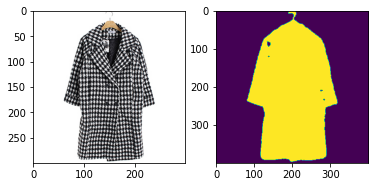

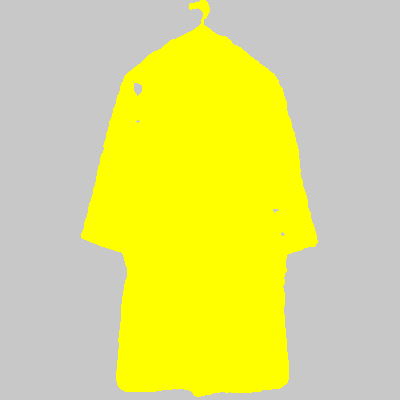

  8%|████▉                                                         | 71/900 [00:11<01:58,  7.01it/s]

torch.Size([1, 3, 400, 400])
/mnt/nas4/hm/datasets/shopping_clothes/data/data900_personby100/top/image/train_14145.jpg
{'background': 0, 'top': 1, 'skirt': 2, 'outer': 3, 'dress': 4, 'bottom': 5}
Counter({0: 83449, 1: 76551})


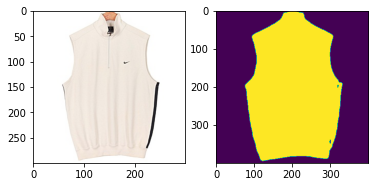

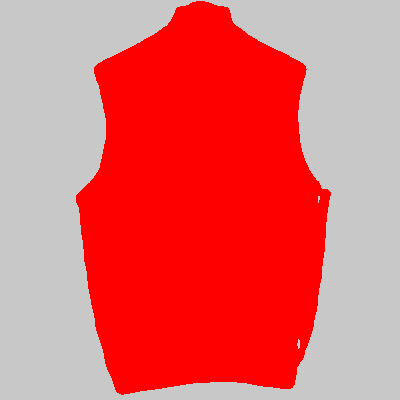

  8%|████▉                                                         | 72/900 [00:11<01:55,  7.16it/s]

torch.Size([1, 3, 400, 400])
/mnt/nas4/hm/datasets/shopping_clothes/data/data900_personby100/outer/image/train_1909.jpg
{'background': 0, 'top': 1, 'skirt': 2, 'outer': 3, 'dress': 4, 'bottom': 5}
Counter({0: 83074, 3: 76926})


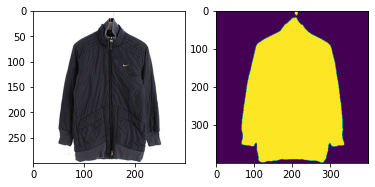

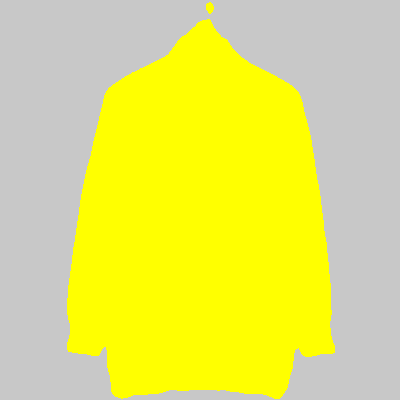

  8%|█████                                                         | 73/900 [00:11<01:54,  7.20it/s]

torch.Size([1, 3, 400, 400])
/mnt/nas4/hm/datasets/shopping_clothes/data/data900_personby100/skirt/image/train_1301.jpg
{'background': 0, 'top': 1, 'skirt': 2, 'outer': 3, 'dress': 4, 'bottom': 5}
Counter({0: 91793, 2: 68207})


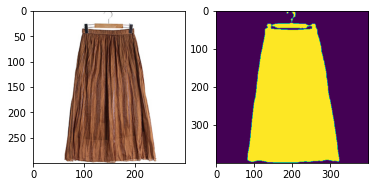

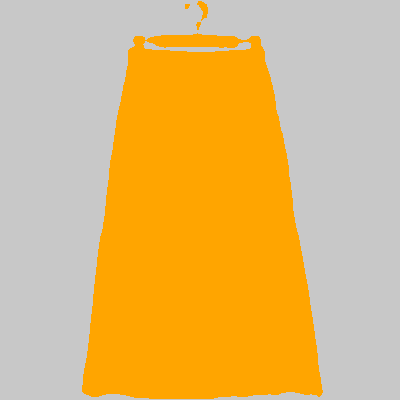

  8%|█████                                                         | 74/900 [00:11<02:08,  6.43it/s]

torch.Size([1, 3, 400, 400])
/mnt/nas4/hm/datasets/shopping_clothes/data/data900_personby100/top/image/train_4981.jpg
{'background': 0, 'top': 1, 'skirt': 2, 'outer': 3, 'dress': 4, 'bottom': 5}
Counter({0: 101243, 1: 58757})


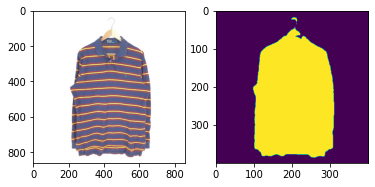

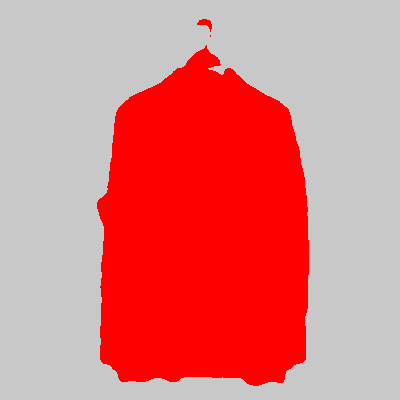

  8%|█████▏                                                        | 75/900 [00:11<02:14,  6.11it/s]

torch.Size([1, 3, 400, 400])
/mnt/nas4/hm/datasets/shopping_clothes/data/data900_personby100/top/image/train_13799.jpg
{'background': 0, 'top': 1, 'skirt': 2, 'outer': 3, 'dress': 4, 'bottom': 5}
Counter({0: 82649, 1: 77351})


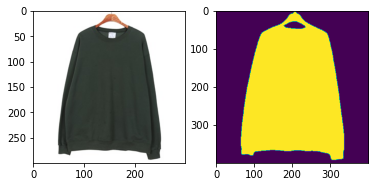

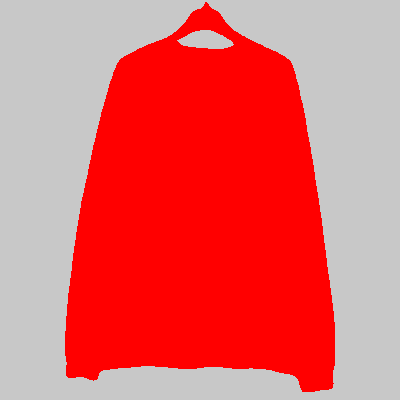

  8%|█████▏                                                        | 76/900 [00:11<02:07,  6.48it/s]

torch.Size([1, 3, 400, 400])
/mnt/nas4/hm/datasets/shopping_clothes/data/data900_personby100/skirt/image/train_2211.jpg
{'background': 0, 'top': 1, 'skirt': 2, 'outer': 3, 'dress': 4, 'bottom': 5}
Counter({0: 100977, 2: 59023})


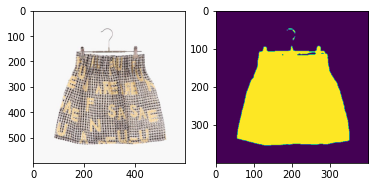

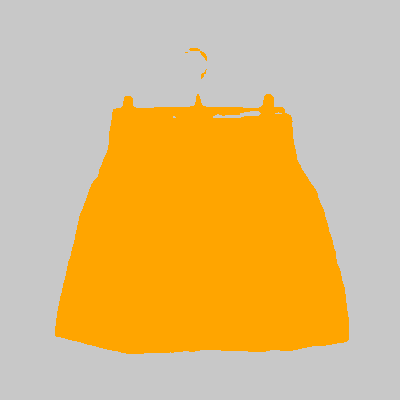

  9%|█████▎                                                        | 77/900 [00:11<02:05,  6.54it/s]

torch.Size([1, 3, 400, 400])
/mnt/nas4/hm/datasets/shopping_clothes/data/data900_personby100/outer/image/train_4728.jpg
{'background': 0, 'top': 1, 'skirt': 2, 'outer': 3, 'dress': 4, 'bottom': 5}
Counter({0: 85065, 3: 74935})


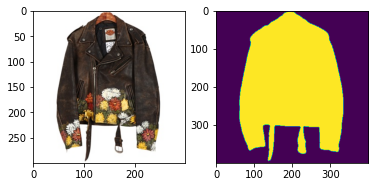

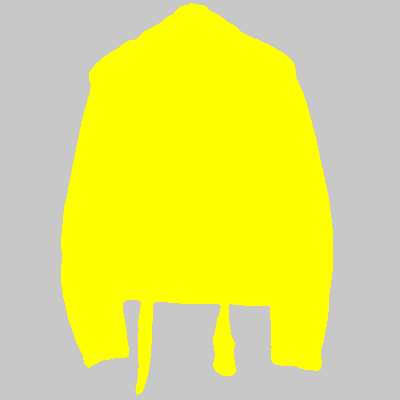

  9%|█████▎                                                        | 78/900 [00:12<02:00,  6.80it/s]

torch.Size([1, 3, 400, 400])
/mnt/nas4/hm/datasets/shopping_clothes/data/data900_personby100/outer/image/train_9561.jpg
{'background': 0, 'top': 1, 'skirt': 2, 'outer': 3, 'dress': 4, 'bottom': 5}
Counter({0: 100640, 3: 59360})


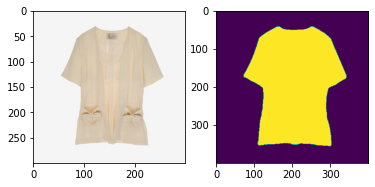

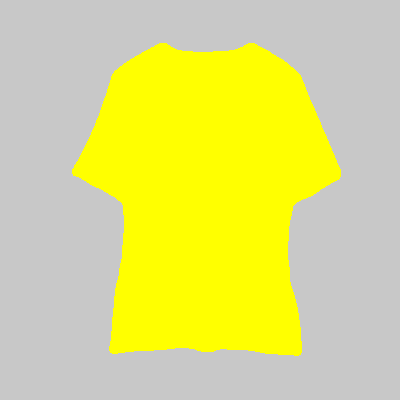

  9%|█████▍                                                        | 79/900 [00:12<01:57,  7.02it/s]

torch.Size([1, 3, 400, 400])
/mnt/nas4/hm/datasets/shopping_clothes/data/data900_personby100/skirt/image/train_403.jpg
{'background': 0, 'top': 1, 'skirt': 2, 'outer': 3, 'dress': 4, 'bottom': 5}
Counter({2: 89180, 0: 70820})


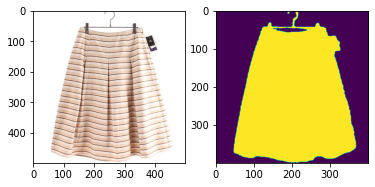

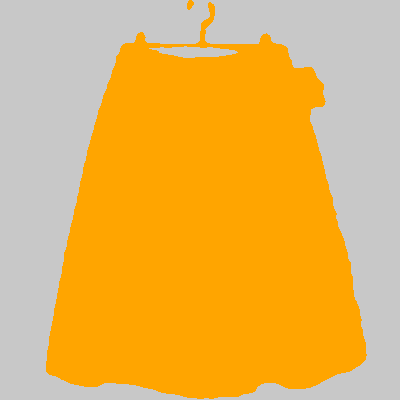

  9%|█████▌                                                        | 80/900 [00:12<01:57,  6.98it/s]

torch.Size([1, 3, 400, 400])
/mnt/nas4/hm/datasets/shopping_clothes/data/data900_personby100/outer/image/train_1992.jpg
{'background': 0, 'top': 1, 'skirt': 2, 'outer': 3, 'dress': 4, 'bottom': 5}
Counter({0: 95357, 3: 64643})


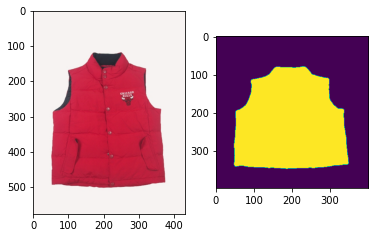

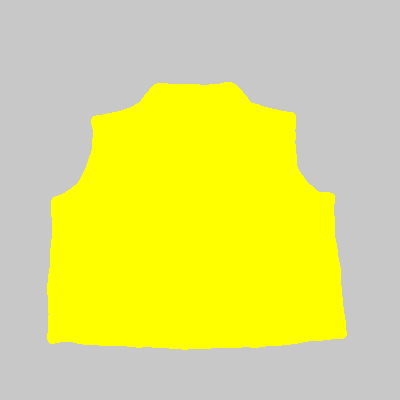

  9%|█████▌                                                        | 81/900 [00:12<01:58,  6.91it/s]

torch.Size([1, 3, 400, 400])
/mnt/nas4/hm/datasets/shopping_clothes/data/data900_personby100/skirt/image/train_2199.jpg
{'background': 0, 'top': 1, 'skirt': 2, 'outer': 3, 'dress': 4, 'bottom': 5}
Counter({0: 92430, 2: 67570})


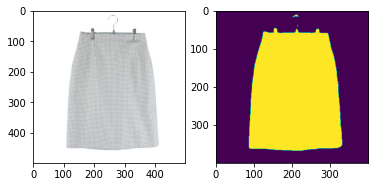

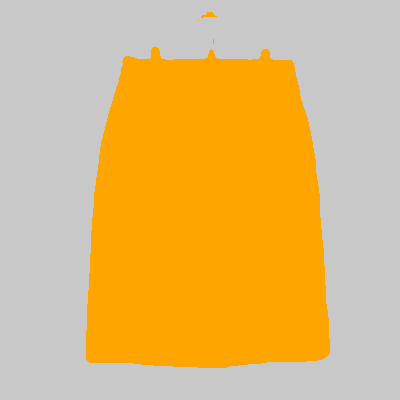

  9%|█████▋                                                        | 82/900 [00:12<01:59,  6.86it/s]

torch.Size([1, 3, 400, 400])
/mnt/nas4/hm/datasets/shopping_clothes/data/data900_personby100/dress/image/train_1578.jpg
{'background': 0, 'top': 1, 'skirt': 2, 'outer': 3, 'dress': 4, 'bottom': 5}
Counter({0: 115470, 4: 44530})


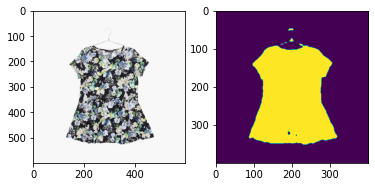

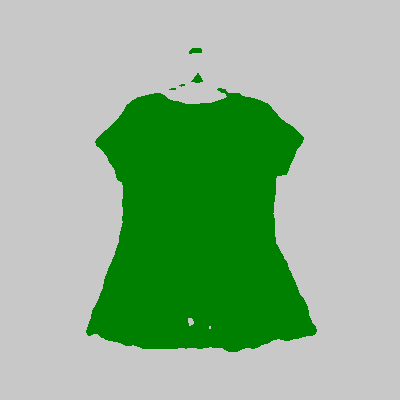

  9%|█████▋                                                        | 83/900 [00:12<01:59,  6.81it/s]

torch.Size([1, 3, 400, 400])
/mnt/nas4/hm/datasets/shopping_clothes/data/data900_personby100/dress/image/train_1768.jpg
{'background': 0, 'top': 1, 'skirt': 2, 'outer': 3, 'dress': 4, 'bottom': 5}
Counter({0: 116359, 4: 43641})


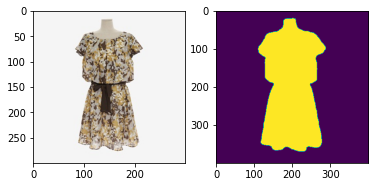

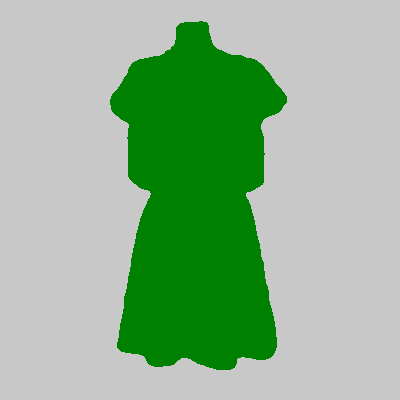

  9%|█████▊                                                        | 84/900 [00:12<01:56,  7.01it/s]

torch.Size([1, 3, 400, 400])
/mnt/nas4/hm/datasets/shopping_clothes/data/data900_personby100/top/image/train_7415.jpg
{'background': 0, 'top': 1, 'skirt': 2, 'outer': 3, 'dress': 4, 'bottom': 5}
Counter({0: 98562, 1: 61438})


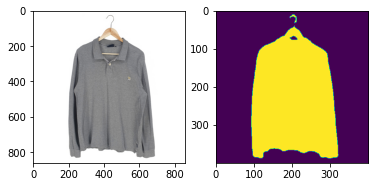

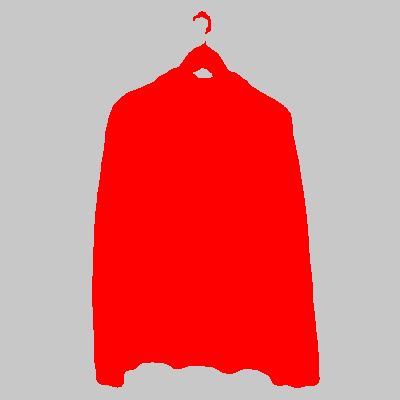

  9%|█████▊                                                        | 85/900 [00:13<02:20,  5.81it/s]

torch.Size([1, 3, 400, 400])
/mnt/nas4/hm/datasets/shopping_clothes/data/data900_personby100/dress/image/train_1163.jpg
{'background': 0, 'top': 1, 'skirt': 2, 'outer': 3, 'dress': 4, 'bottom': 5}
Counter({0: 92693, 4: 67307})


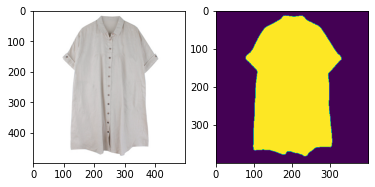

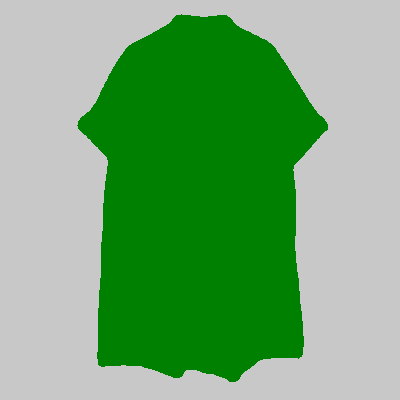

 10%|█████▉                                                        | 86/900 [00:13<02:13,  6.09it/s]

torch.Size([1, 3, 400, 400])
/mnt/nas4/hm/datasets/shopping_clothes/data/data900_personby100/dress/image/train_3527.jpg
{'background': 0, 'top': 1, 'skirt': 2, 'outer': 3, 'dress': 4, 'bottom': 5}
Counter({0: 115602, 4: 44398})


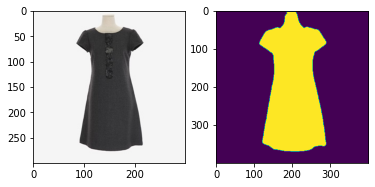

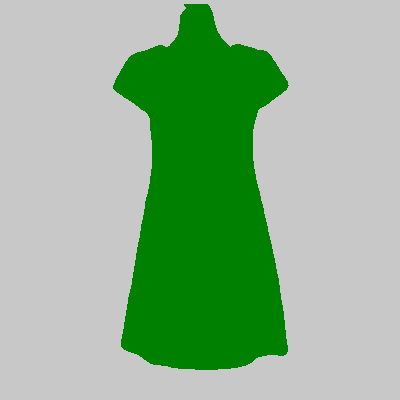

 10%|█████▉                                                        | 87/900 [00:13<02:05,  6.48it/s]

torch.Size([1, 3, 400, 400])
/mnt/nas4/hm/datasets/shopping_clothes/data/data900_personby100/outer/image/train_5020.jpg
{'background': 0, 'top': 1, 'skirt': 2, 'outer': 3, 'dress': 4, 'bottom': 5}
Counter({0: 113944, 3: 46056})


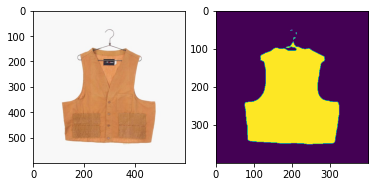

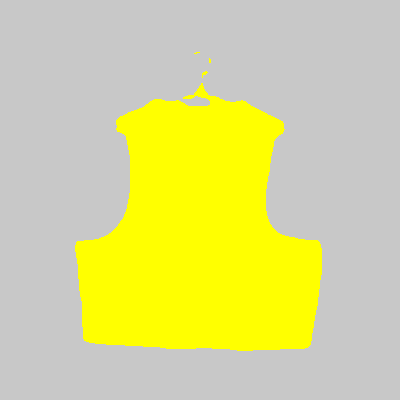

 10%|██████                                                        | 88/900 [00:13<02:04,  6.53it/s]

torch.Size([1, 3, 400, 400])
/mnt/nas4/hm/datasets/shopping_clothes/data/data900_personby100/dress/image/train_1556.jpg
{'background': 0, 'top': 1, 'skirt': 2, 'outer': 3, 'dress': 4, 'bottom': 5}
Counter({0: 106825, 4: 53175})


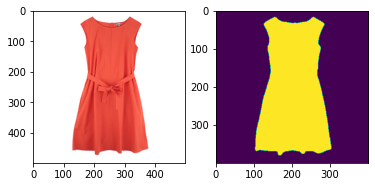

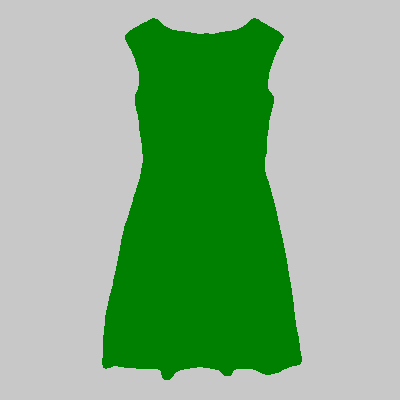

 10%|██████▏                                                       | 89/900 [00:13<02:02,  6.62it/s]

torch.Size([1, 3, 400, 400])
/mnt/nas4/hm/datasets/shopping_clothes/data/data900_personby100/bottom/image/train_3176.jpg
{'background': 0, 'top': 1, 'skirt': 2, 'outer': 3, 'dress': 4, 'bottom': 5}
Counter({0: 127445, 5: 32555})


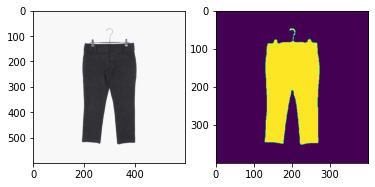

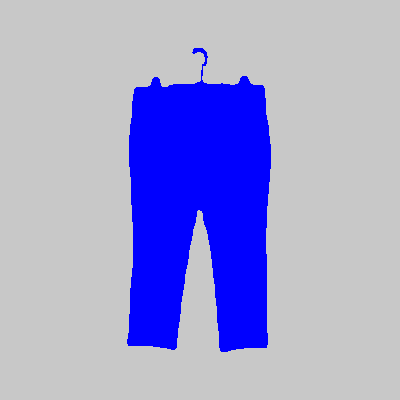

 10%|██████▏                                                       | 90/900 [00:13<02:01,  6.65it/s]

torch.Size([1, 3, 400, 400])
/mnt/nas4/hm/datasets/shopping_clothes/data/data900_personby100/dress/image/train_1815.jpg
{'background': 0, 'top': 1, 'skirt': 2, 'outer': 3, 'dress': 4, 'bottom': 5}
Counter({0: 118507, 4: 41493})


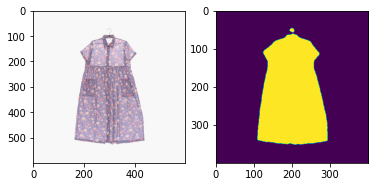

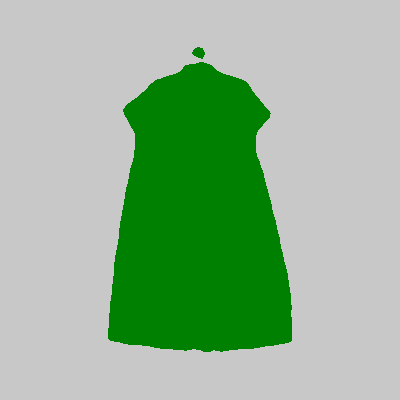

 10%|██████▎                                                       | 91/900 [00:14<02:01,  6.66it/s]

torch.Size([1, 3, 400, 400])
/mnt/nas4/hm/datasets/shopping_clothes/data/data900_personby100/bottom/image/train_1471.jpg
{'background': 0, 'top': 1, 'skirt': 2, 'outer': 3, 'dress': 4, 'bottom': 5}
Counter({0: 111050, 5: 48950})


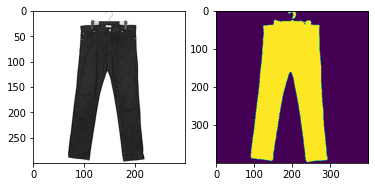

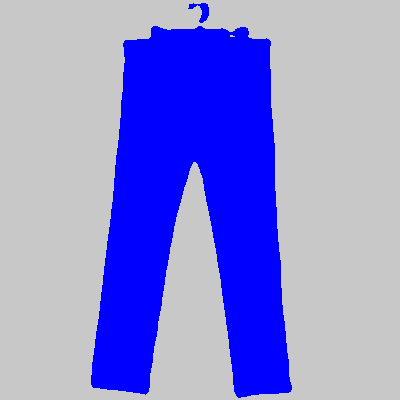

 10%|██████▎                                                       | 92/900 [00:14<01:56,  6.92it/s]

torch.Size([1, 3, 400, 400])
/mnt/nas4/hm/datasets/shopping_clothes/data/data900_personby100/top/image/train_1579.jpg
{'background': 0, 'top': 1, 'skirt': 2, 'outer': 3, 'dress': 4, 'bottom': 5}
Counter({0: 112393, 1: 47607})


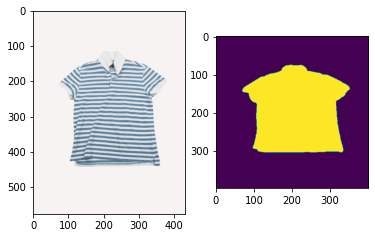

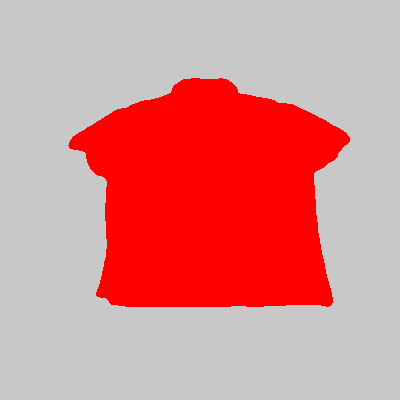

 10%|██████▍                                                       | 93/900 [00:14<01:56,  6.91it/s]

torch.Size([1, 3, 400, 400])
/mnt/nas4/hm/datasets/shopping_clothes/data/data900_personby100/outer/image/train_4841.jpg
{'background': 0, 'top': 1, 'skirt': 2, 'outer': 3, 'dress': 4, 'bottom': 5}
Counter({0: 112243, 3: 47757})


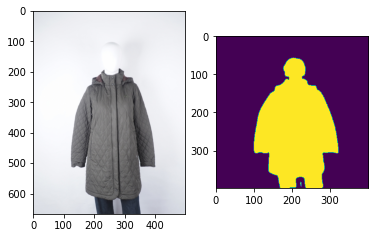

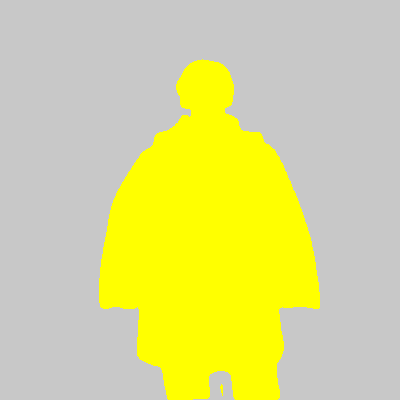

 10%|██████▍                                                       | 94/900 [00:14<02:01,  6.61it/s]

torch.Size([1, 3, 400, 400])
/mnt/nas4/hm/datasets/shopping_clothes/data/data900_personby100/skirt/image/train_2312.jpg
{'background': 0, 'top': 1, 'skirt': 2, 'outer': 3, 'dress': 4, 'bottom': 5}
Counter({0: 92159, 2: 67841})


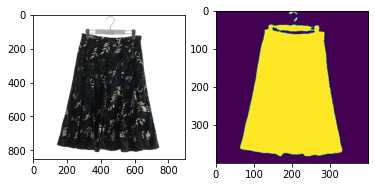

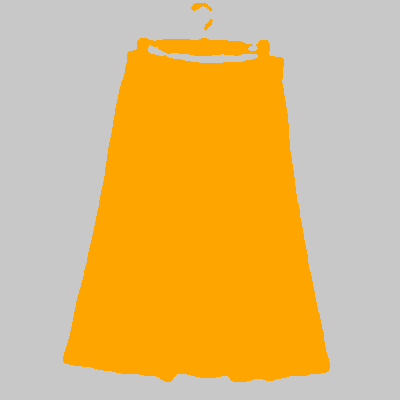

 11%|██████▌                                                       | 95/900 [00:14<02:11,  6.13it/s]

torch.Size([1, 3, 400, 400])
/mnt/nas4/hm/datasets/shopping_clothes/data/data900_personby100/outer/image/train_7228.jpg
{'background': 0, 'top': 1, 'skirt': 2, 'outer': 3, 'dress': 4, 'bottom': 5}
Counter({3: 95688, 0: 64312})


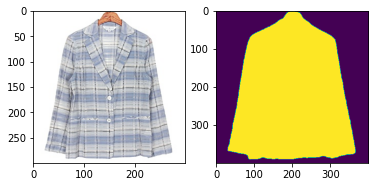

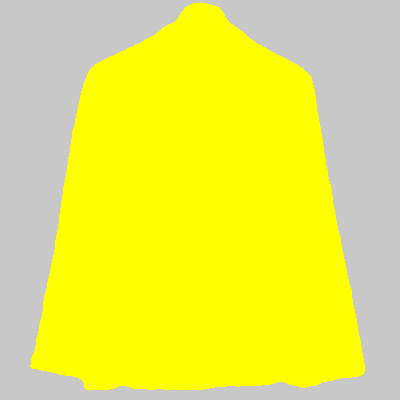

 11%|██████▌                                                       | 96/900 [00:14<02:18,  5.81it/s]

torch.Size([1, 3, 400, 400])
/mnt/nas4/hm/datasets/shopping_clothes/data/data900_personby100/bottom/image/train_2515.jpg
{'background': 0, 'top': 1, 'skirt': 2, 'outer': 3, 'dress': 4, 'bottom': 5}
Counter({5: 86840, 0: 73160})


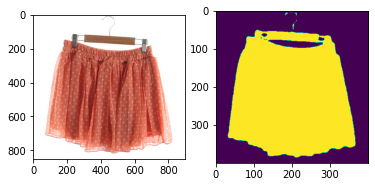

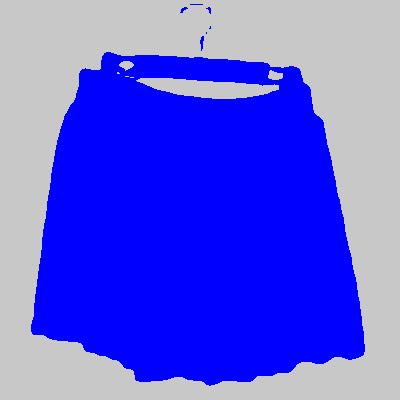

 11%|██████▋                                                       | 97/900 [00:15<02:23,  5.61it/s]

torch.Size([1, 3, 400, 400])
/mnt/nas4/hm/datasets/shopping_clothes/data/data900_personby100/dress/image/train_1213.jpg
{'background': 0, 'top': 1, 'skirt': 2, 'outer': 3, 'dress': 4, 'bottom': 5}
Counter({0: 126149, 4: 33851})


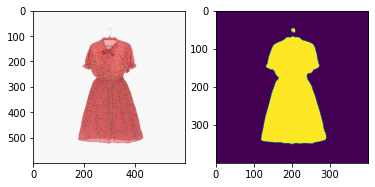

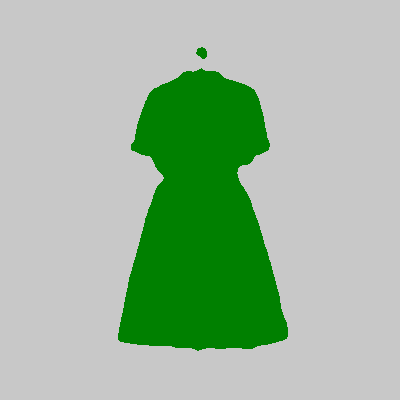

 11%|██████▊                                                       | 98/900 [00:15<02:15,  5.90it/s]

torch.Size([1, 3, 400, 400])
/mnt/nas4/hm/datasets/shopping_clothes/data/data900_personby100/bottom/image/train_1362.jpg
{'background': 0, 'top': 1, 'skirt': 2, 'outer': 3, 'dress': 4, 'bottom': 5}
Counter({0: 106893, 5: 53107})


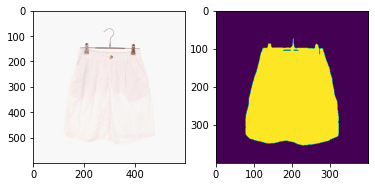

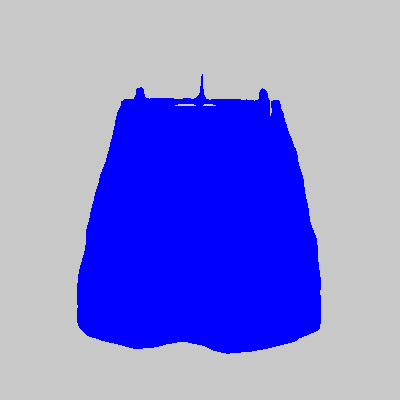

 11%|██████▊                                                       | 99/900 [00:15<02:10,  6.13it/s]

torch.Size([1, 3, 400, 400])
/mnt/nas4/hm/datasets/shopping_clothes/data/data900_personby100/top/image/train_375.jpg
{'background': 0, 'top': 1, 'skirt': 2, 'outer': 3, 'dress': 4, 'bottom': 5}
Counter({0: 92346, 1: 67654})


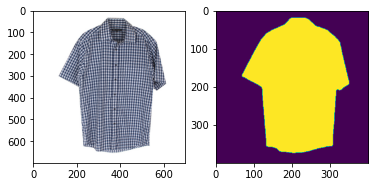

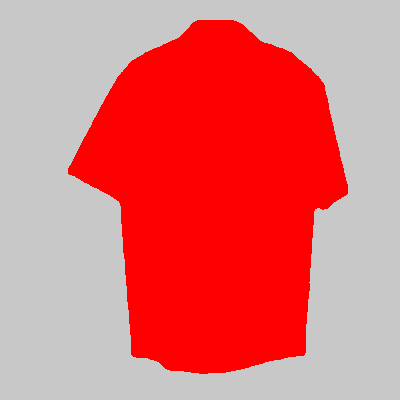

 11%|██████▊                                                      | 100/900 [00:15<02:10,  6.11it/s]

torch.Size([1, 3, 400, 400])
/mnt/nas4/hm/datasets/shopping_clothes/data/data900_personby100/dress/image/train_3787.jpg
{'background': 0, 'top': 1, 'skirt': 2, 'outer': 3, 'dress': 4, 'bottom': 5}
Counter({0: 114780, 4: 45220})


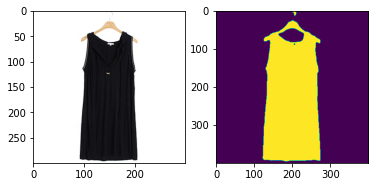

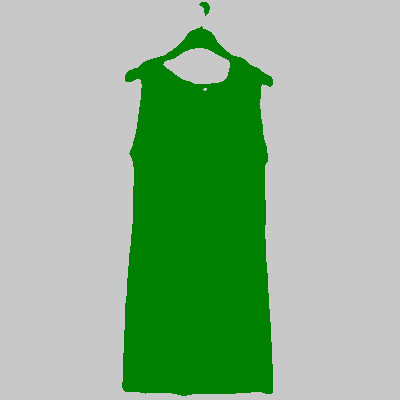

 11%|██████▊                                                      | 101/900 [00:15<02:03,  6.49it/s]

torch.Size([1, 3, 400, 400])
/mnt/nas4/hm/datasets/shopping_clothes/data/data900_personby100/dress/image/train_1718.jpg
{'background': 0, 'top': 1, 'skirt': 2, 'outer': 3, 'dress': 4, 'bottom': 5}
Counter({0: 97856, 4: 62144})


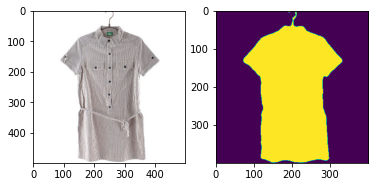

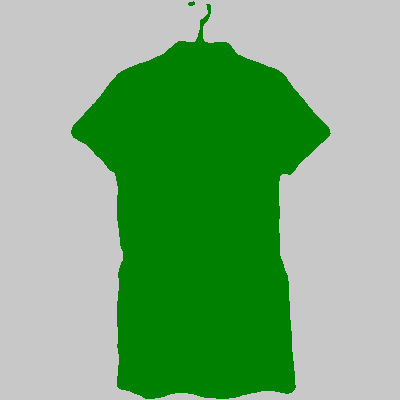

 11%|██████▉                                                      | 102/900 [00:15<02:00,  6.62it/s]

torch.Size([1, 3, 400, 400])
/mnt/nas4/hm/datasets/shopping_clothes/data/data900_personby100/outer/image/train_11169.jpg
{'background': 0, 'top': 1, 'skirt': 2, 'outer': 3, 'dress': 4, 'bottom': 5}
Counter({0: 114442, 3: 45558})


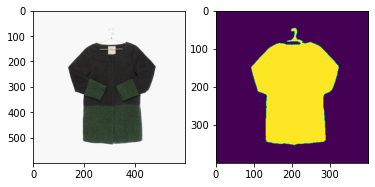

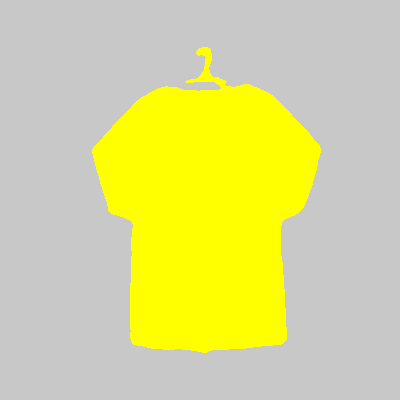

 11%|██████▉                                                      | 103/900 [00:15<02:00,  6.62it/s]

torch.Size([1, 3, 400, 400])
/mnt/nas4/hm/datasets/shopping_clothes/data/data900_personby100/top/image/train_9351.jpg
{'background': 0, 'top': 1, 'skirt': 2, 'outer': 3, 'dress': 4, 'bottom': 5}
Counter({0: 97337, 1: 62663})


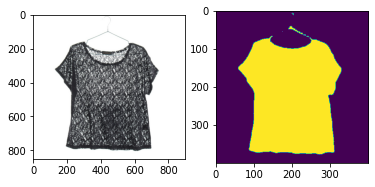

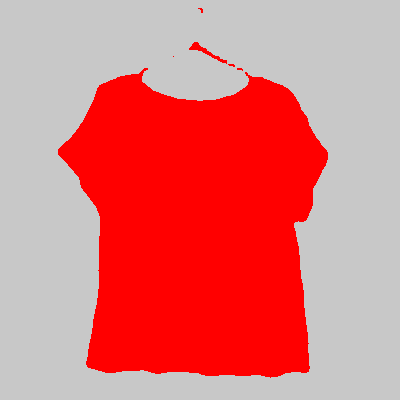

 12%|███████                                                      | 104/900 [00:16<02:08,  6.18it/s]

torch.Size([1, 3, 400, 400])
/mnt/nas4/hm/datasets/shopping_clothes/data/data900_personby100/outer/image/train_1736.jpg
{'background': 0, 'top': 1, 'skirt': 2, 'outer': 3, 'dress': 4, 'bottom': 5}
Counter({0: 129633, 3: 30367})


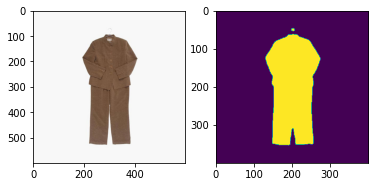

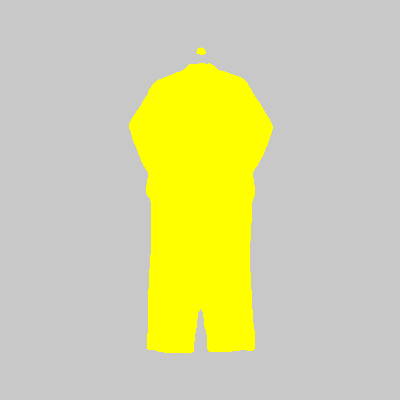

 12%|███████                                                      | 105/900 [00:16<02:05,  6.33it/s]

torch.Size([1, 3, 400, 400])
/mnt/nas4/hm/datasets/shopping_clothes/data/data900_personby100/dress/image/train_1427.jpg
{'background': 0, 'top': 1, 'skirt': 2, 'outer': 3, 'dress': 4, 'bottom': 5}
Counter({0: 128922, 4: 31078})


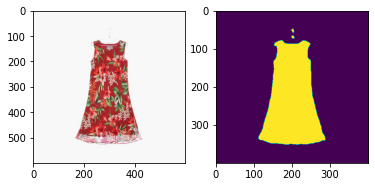

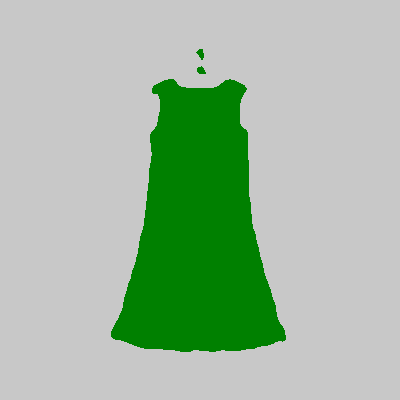

 12%|███████▏                                                     | 106/900 [00:16<02:03,  6.44it/s]

torch.Size([1, 3, 400, 400])
/mnt/nas4/hm/datasets/shopping_clothes/data/data900_personby100/outer/image/train_6594.jpg
{'background': 0, 'top': 1, 'skirt': 2, 'outer': 3, 'dress': 4, 'bottom': 5}
Counter({0: 101497, 3: 58503})


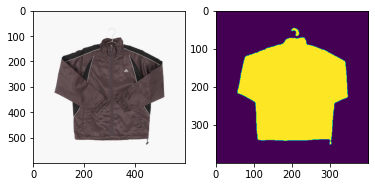

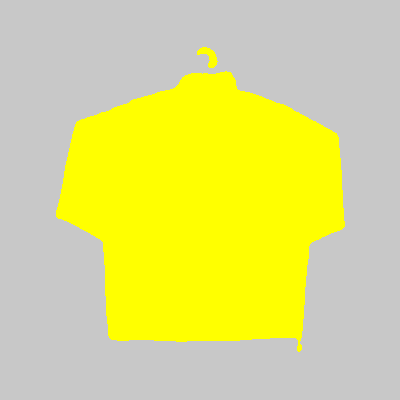

 12%|███████▎                                                     | 107/900 [00:16<02:15,  5.84it/s]

torch.Size([1, 3, 400, 400])
/mnt/nas4/hm/datasets/shopping_clothes/data/data900_personby100/dress/image/train_422.jpg
{'background': 0, 'top': 1, 'skirt': 2, 'outer': 3, 'dress': 4, 'bottom': 5}
Counter({0: 113626, 4: 46374})


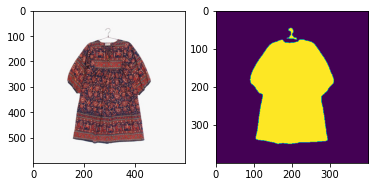

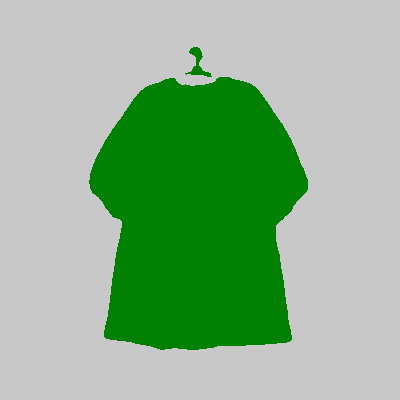

 12%|███████▎                                                     | 108/900 [00:16<02:10,  6.07it/s]

torch.Size([1, 3, 400, 400])
/mnt/nas4/hm/datasets/shopping_clothes/data/data900_personby100/outer/image/train_11164.jpg
{'background': 0, 'top': 1, 'skirt': 2, 'outer': 3, 'dress': 4, 'bottom': 5}
Counter({3: 88026, 0: 71974})


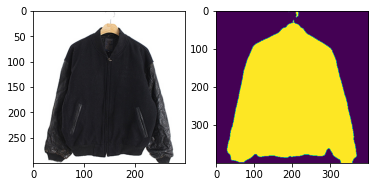

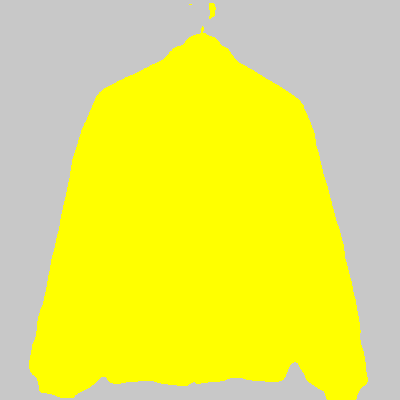

 12%|███████▍                                                     | 109/900 [00:16<02:03,  6.43it/s]

torch.Size([1, 3, 400, 400])
/mnt/nas4/hm/datasets/shopping_clothes/data/data900_personby100/outer/image/train_10608.jpg
{'background': 0, 'top': 1, 'skirt': 2, 'outer': 3, 'dress': 4, 'bottom': 5}
Counter({0: 120259, 3: 39741})


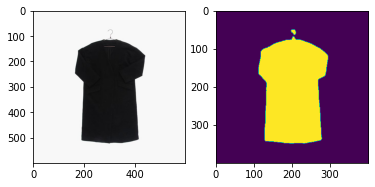

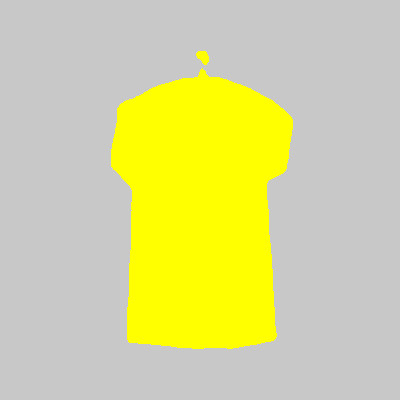

 12%|███████▍                                                     | 110/900 [00:17<02:01,  6.52it/s]

torch.Size([1, 3, 400, 400])
/mnt/nas4/hm/datasets/shopping_clothes/data/data900_personby100/top/image/train_131.jpg
{'background': 0, 'top': 1, 'skirt': 2, 'outer': 3, 'dress': 4, 'bottom': 5}
Counter({0: 92190, 1: 67810})


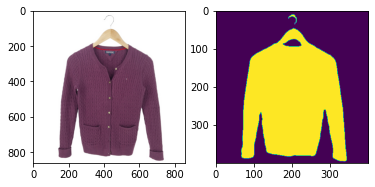

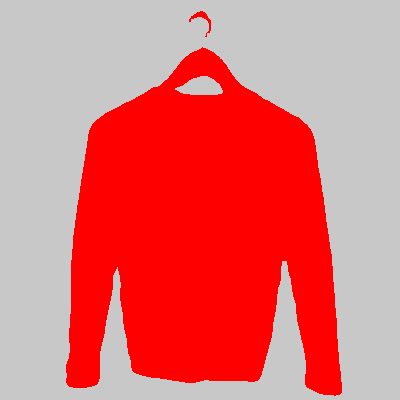

 12%|███████▌                                                     | 111/900 [00:17<02:07,  6.17it/s]

torch.Size([1, 3, 400, 400])
/mnt/nas4/hm/datasets/shopping_clothes/data/data900_personby100/top/image/train_11103.jpg
{'background': 0, 'top': 1, 'skirt': 2, 'outer': 3, 'dress': 4, 'bottom': 5}
Counter({0: 90200, 1: 69800})


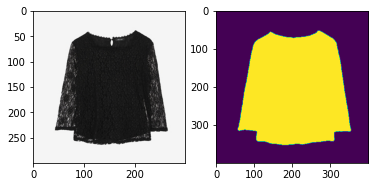

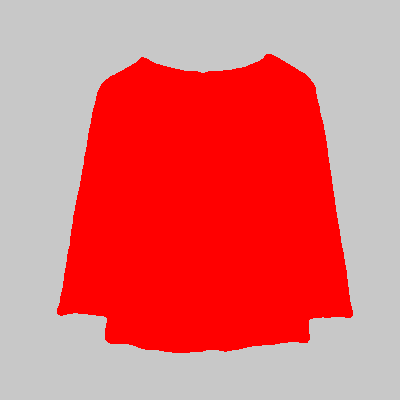

 12%|███████▌                                                     | 112/900 [00:17<02:00,  6.54it/s]

torch.Size([1, 3, 400, 400])
/mnt/nas4/hm/datasets/shopping_clothes/data/data900_personby100/dress/image/train_2604.jpg
{'background': 0, 'top': 1, 'skirt': 2, 'outer': 3, 'dress': 4, 'bottom': 5}
Counter({0: 114934, 4: 45066})


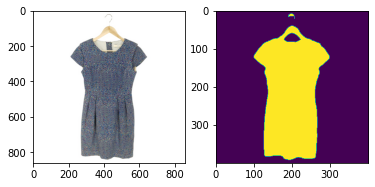

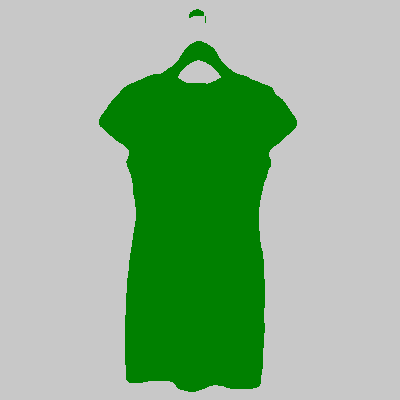

 13%|███████▋                                                     | 113/900 [00:17<02:06,  6.21it/s]

torch.Size([1, 3, 400, 400])
/mnt/nas4/hm/datasets/shopping_clothes/data/data900_personby100/dress/image/train_3779.jpg
{'background': 0, 'top': 1, 'skirt': 2, 'outer': 3, 'dress': 4, 'bottom': 5}
Counter({0: 125844, 4: 34156})


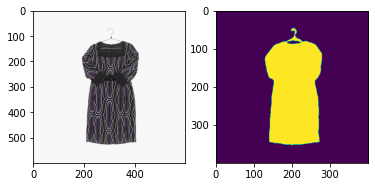

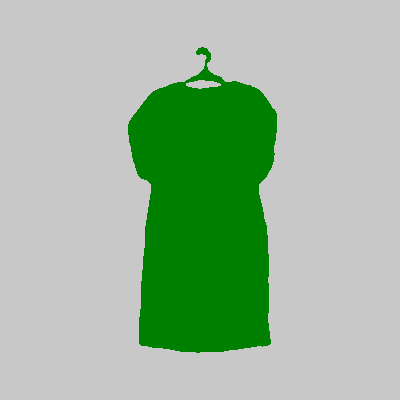

 13%|███████▋                                                     | 114/900 [00:17<02:03,  6.34it/s]

torch.Size([1, 3, 400, 400])
/mnt/nas4/hm/datasets/shopping_clothes/data/data900_personby100/skirt/image/train_1764.jpg
{'background': 0, 'top': 1, 'skirt': 2, 'outer': 3, 'dress': 4, 'bottom': 5}
Counter({0: 102715, 2: 57285})


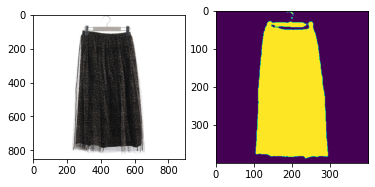

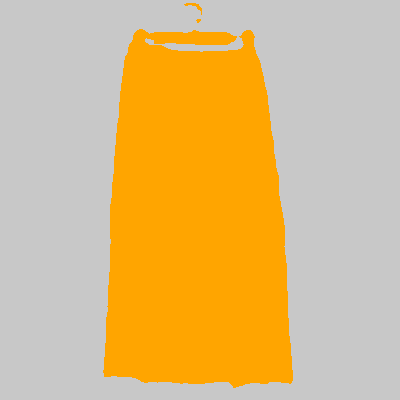

 13%|███████▊                                                     | 115/900 [00:17<02:11,  5.99it/s]

torch.Size([1, 3, 400, 400])
/mnt/nas4/hm/datasets/shopping_clothes/data/data900_personby100/outer/image/train_4867.jpg
{'background': 0, 'top': 1, 'skirt': 2, 'outer': 3, 'dress': 4, 'bottom': 5}
Counter({0: 91152, 3: 68848})


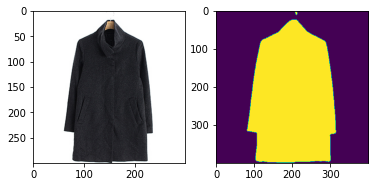

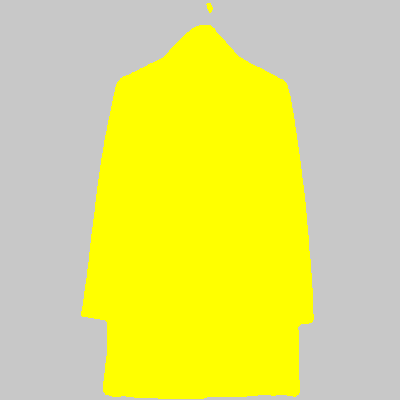

 13%|███████▊                                                     | 116/900 [00:18<02:03,  6.37it/s]

torch.Size([1, 3, 400, 400])
/mnt/nas4/hm/datasets/shopping_clothes/data/data900_personby100/skirt/image/train_1656.jpg
{'background': 0, 'top': 1, 'skirt': 2, 'outer': 3, 'dress': 4, 'bottom': 5}
Counter({0: 98327, 2: 61673})


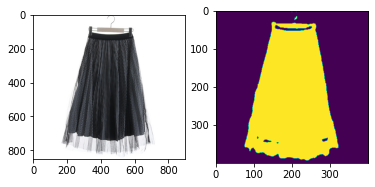

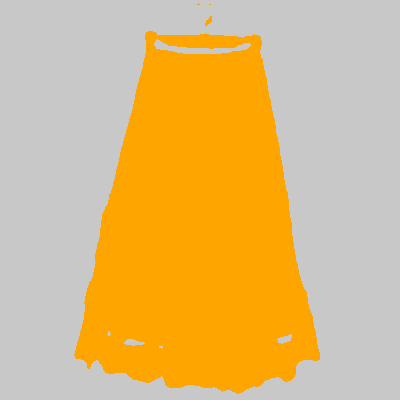

 13%|███████▉                                                     | 117/900 [00:18<02:10,  6.02it/s]

torch.Size([1, 3, 400, 400])
/mnt/nas4/hm/datasets/shopping_clothes/data/data900_personby100/top/image/train_2008.jpg
{'background': 0, 'top': 1, 'skirt': 2, 'outer': 3, 'dress': 4, 'bottom': 5}
Counter({1: 84804, 0: 75196})


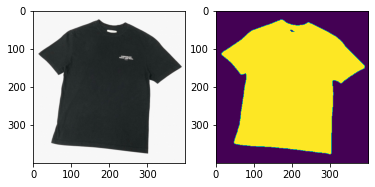

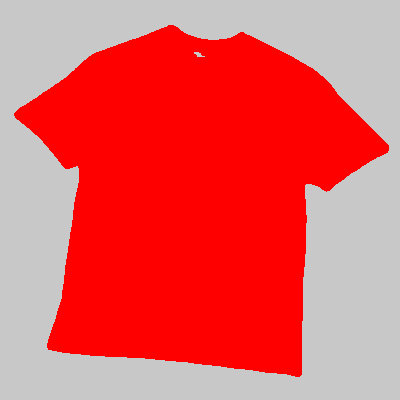

 13%|███████▉                                                     | 118/900 [00:18<02:17,  5.68it/s]

torch.Size([1, 3, 400, 400])
/mnt/nas4/hm/datasets/shopping_clothes/data/data900_personby100/skirt/image/train_2186.jpg
{'background': 0, 'top': 1, 'skirt': 2, 'outer': 3, 'dress': 4, 'bottom': 5}
Counter({0: 90571, 2: 69429})


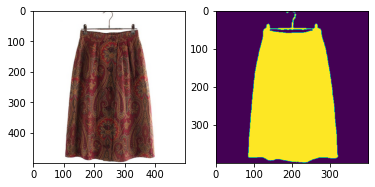

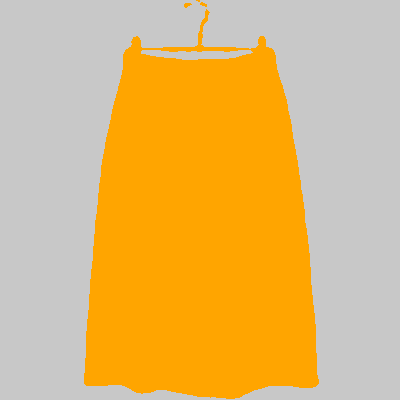

 13%|████████                                                     | 119/900 [00:18<02:10,  6.00it/s]

torch.Size([1, 3, 400, 400])
/mnt/nas4/hm/datasets/shopping_clothes/data/data900_personby100/dress/image/train_229.jpg
{'background': 0, 'top': 1, 'skirt': 2, 'outer': 3, 'dress': 4, 'bottom': 5}
Counter({0: 115861, 4: 44139})


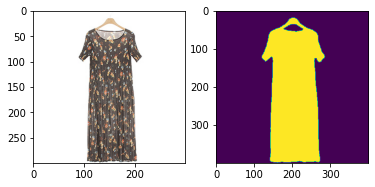

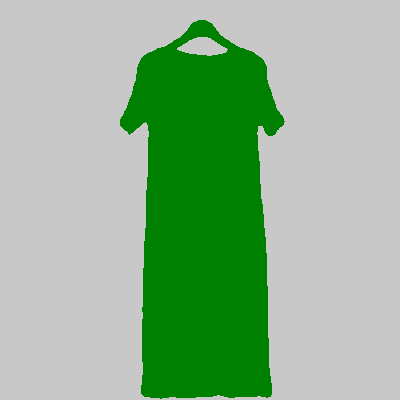

 13%|████████▏                                                    | 120/900 [00:18<02:02,  6.39it/s]

torch.Size([1, 3, 400, 400])
/mnt/nas4/hm/datasets/shopping_clothes/data/data900_personby100/bottom/image/train_3549.jpg
{'background': 0, 'top': 1, 'skirt': 2, 'outer': 3, 'dress': 4, 'bottom': 5}
Counter({0: 104924, 5: 55076})


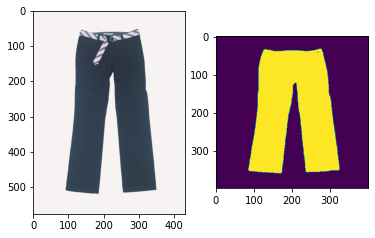

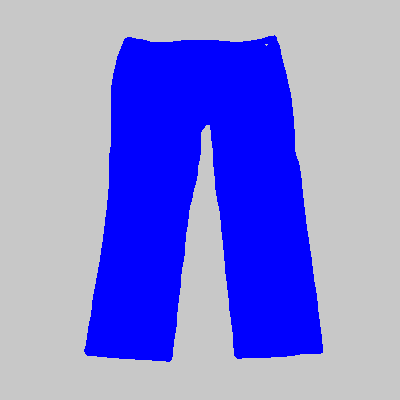

 13%|████████▏                                                    | 121/900 [00:18<01:59,  6.49it/s]

torch.Size([1, 3, 400, 400])
/mnt/nas4/hm/datasets/shopping_clothes/data/data900_personby100/outer/image/train_567.jpg
{'background': 0, 'top': 1, 'skirt': 2, 'outer': 3, 'dress': 4, 'bottom': 5}
Counter({0: 89297, 3: 70703})


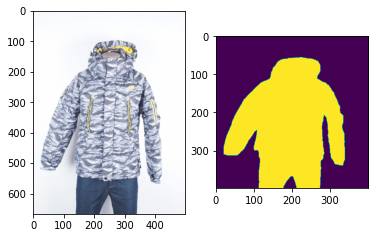

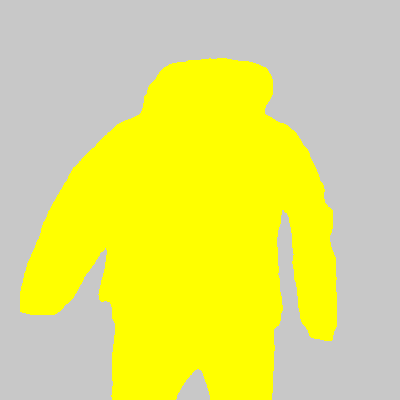

 14%|████████▎                                                    | 122/900 [00:19<02:02,  6.36it/s]

torch.Size([1, 3, 400, 400])
/mnt/nas4/hm/datasets/shopping_clothes/data/data900_personby100/bottom/image/train_2827.jpg
{'background': 0, 'top': 1, 'skirt': 2, 'outer': 3, 'dress': 4, 'bottom': 5}
Counter({0: 101689, 5: 58311})


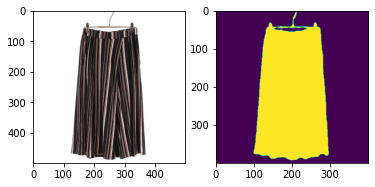

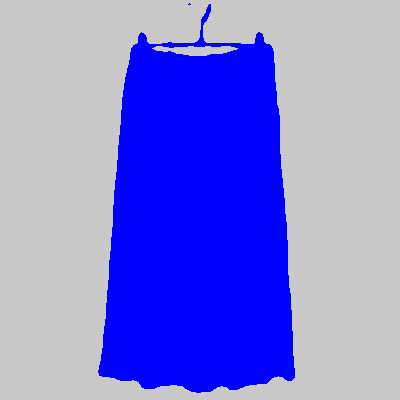

 14%|████████▎                                                    | 123/900 [00:19<01:58,  6.53it/s]

torch.Size([1, 3, 400, 400])
/mnt/nas4/hm/datasets/shopping_clothes/data/data900_personby100/skirt/image/train_365.jpg
{'background': 0, 'top': 1, 'skirt': 2, 'outer': 3, 'dress': 4, 'bottom': 5}
Counter({2: 81921, 0: 78079})


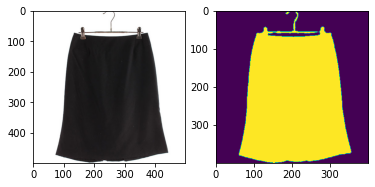

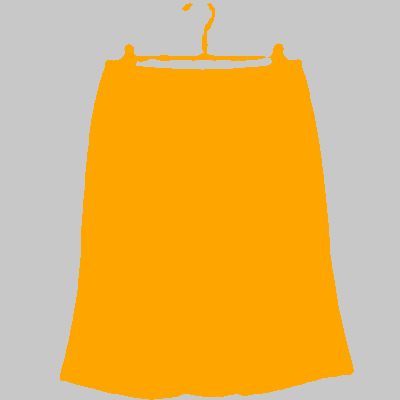

 14%|████████▍                                                    | 124/900 [00:19<01:56,  6.65it/s]

torch.Size([1, 3, 400, 400])
/mnt/nas4/hm/datasets/shopping_clothes/data/data900_personby100/outer/image/train_3257.jpg
{'background': 0, 'top': 1, 'skirt': 2, 'outer': 3, 'dress': 4, 'bottom': 5}
Counter({0: 87819, 3: 72181})


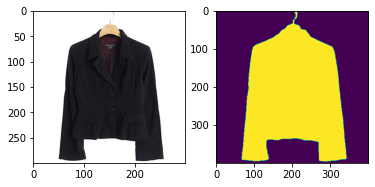

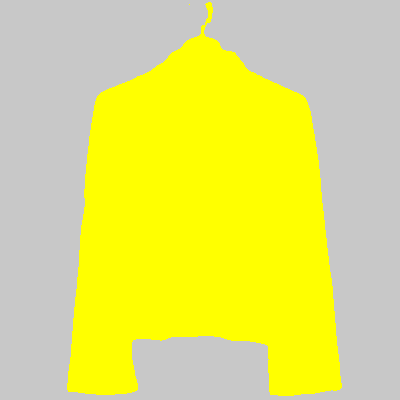

 14%|████████▍                                                    | 125/900 [00:19<01:52,  6.88it/s]

torch.Size([1, 3, 400, 400])
/mnt/nas4/hm/datasets/shopping_clothes/data/data900_personby100/dress/image/train_1960.jpg
{'background': 0, 'top': 1, 'skirt': 2, 'outer': 3, 'dress': 4, 'bottom': 5}
Counter({0: 111566, 4: 48434})


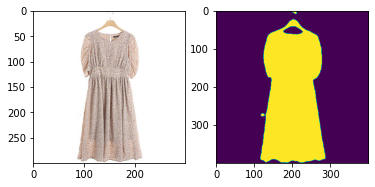

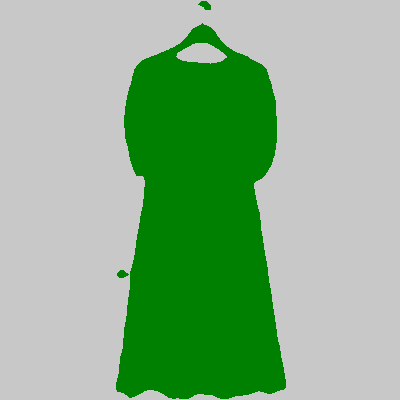

 14%|████████▌                                                    | 126/900 [00:19<01:49,  7.07it/s]

torch.Size([1, 3, 400, 400])
/mnt/nas4/hm/datasets/shopping_clothes/data/data900_personby100/top/image/train_12136.jpg
{'background': 0, 'top': 1, 'skirt': 2, 'outer': 3, 'dress': 4, 'bottom': 5}
Counter({0: 103417, 1: 56583})


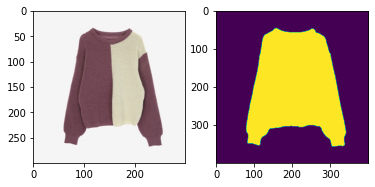

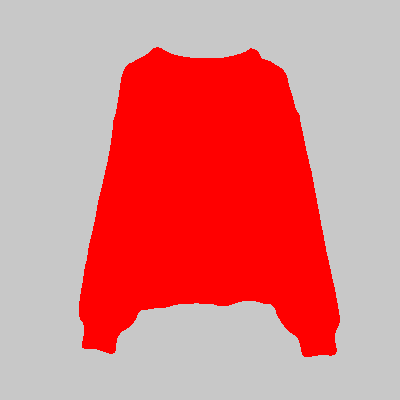

 14%|████████▌                                                    | 127/900 [00:19<01:46,  7.23it/s]

torch.Size([1, 3, 400, 400])
/mnt/nas4/hm/datasets/shopping_clothes/data/data900_personby100/top/image/train_12729.jpg
{'background': 0, 'top': 1, 'skirt': 2, 'outer': 3, 'dress': 4, 'bottom': 5}
Counter({1: 81201, 0: 78799})


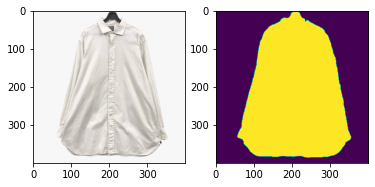

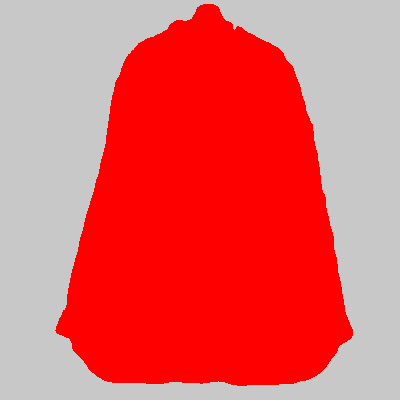

 14%|████████▋                                                    | 128/900 [00:19<01:46,  7.24it/s]

torch.Size([1, 3, 400, 400])
/mnt/nas4/hm/datasets/shopping_clothes/data/data900_personby100/skirt/image/train_2689.jpg
{'background': 0, 'top': 1, 'skirt': 2, 'outer': 3, 'dress': 4, 'bottom': 5}
Counter({0: 93907, 2: 66093})


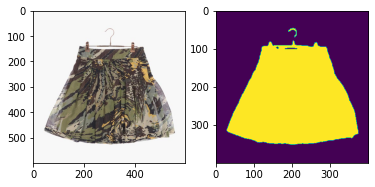

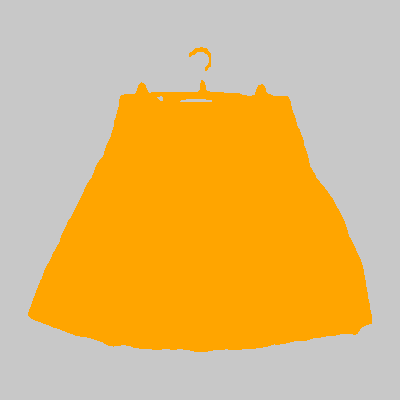

 14%|████████▋                                                    | 129/900 [00:20<02:03,  6.25it/s]

torch.Size([1, 3, 400, 400])
/mnt/nas4/hm/datasets/shopping_clothes/data/data900_personby100/outer/image/train_5029.jpg
{'background': 0, 'top': 1, 'skirt': 2, 'outer': 3, 'dress': 4, 'bottom': 5}
Counter({0: 89112, 3: 70888})


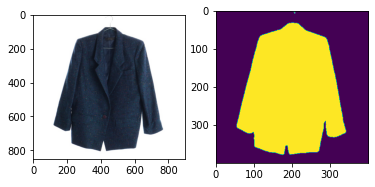

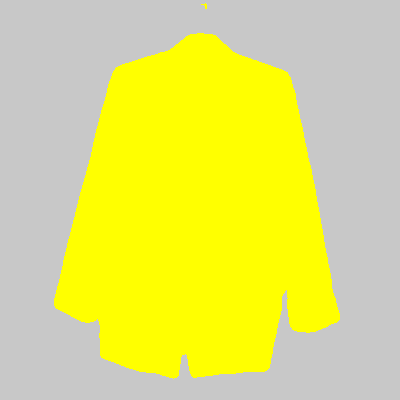

 14%|████████▊                                                    | 130/900 [00:20<02:10,  5.90it/s]

torch.Size([1, 3, 400, 400])
/mnt/nas4/hm/datasets/shopping_clothes/data/data900_personby100/top/image/train_4098.jpg
{'background': 0, 'top': 1, 'skirt': 2, 'outer': 3, 'dress': 4, 'bottom': 5}
Counter({0: 105782, 1: 54218})


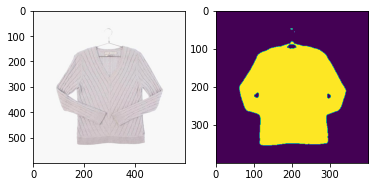

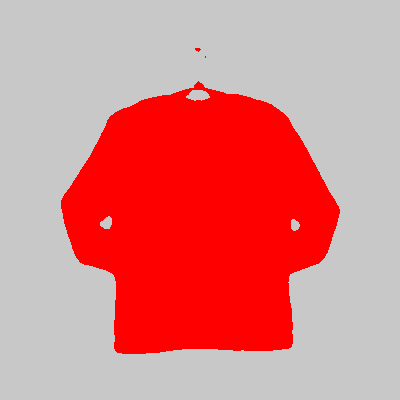

 15%|████████▉                                                    | 131/900 [00:20<02:06,  6.10it/s]

torch.Size([1, 3, 400, 400])
/mnt/nas4/hm/datasets/shopping_clothes/data/data900_personby100/bottom/image/train_3732.jpg
{'background': 0, 'top': 1, 'skirt': 2, 'outer': 3, 'dress': 4, 'bottom': 5}
Counter({0: 106517, 5: 53483})


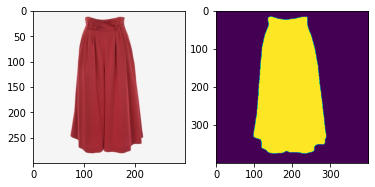

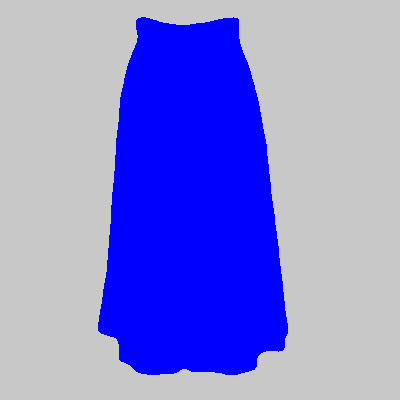

 15%|████████▉                                                    | 132/900 [00:20<01:58,  6.47it/s]

torch.Size([1, 3, 400, 400])
/mnt/nas4/hm/datasets/shopping_clothes/data/data900_personby100/skirt/image/train_1245.jpg
{'background': 0, 'top': 1, 'skirt': 2, 'outer': 3, 'dress': 4, 'bottom': 5}
Counter({0: 105602, 2: 54398})


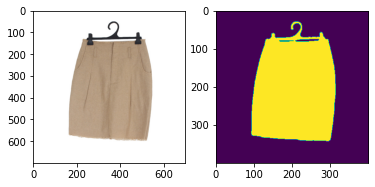

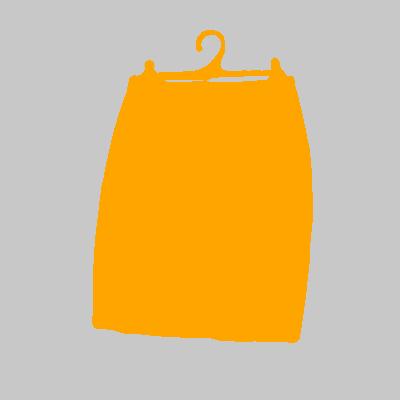

 15%|█████████                                                    | 133/900 [00:20<02:00,  6.35it/s]

torch.Size([1, 3, 400, 400])
/mnt/nas4/hm/datasets/shopping_clothes/data/data900_personby100/top/image/train_2564.jpg
{'background': 0, 'top': 1, 'skirt': 2, 'outer': 3, 'dress': 4, 'bottom': 5}
Counter({1: 110421, 0: 49579})


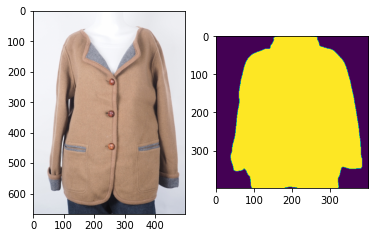

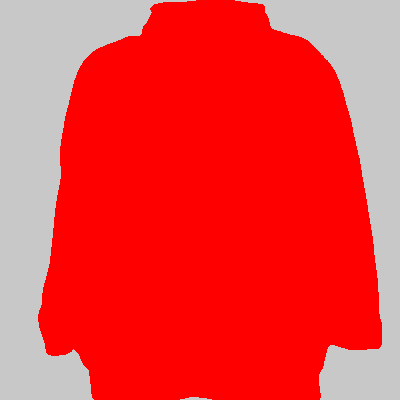

 15%|█████████                                                    | 134/900 [00:20<02:02,  6.24it/s]

torch.Size([1, 3, 400, 400])
/mnt/nas4/hm/datasets/shopping_clothes/data/data900_personby100/bottom/image/train_577.jpg
{'background': 0, 'top': 1, 'skirt': 2, 'outer': 3, 'dress': 4, 'bottom': 5}
Counter({0: 114531, 5: 45469})


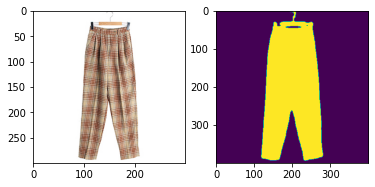

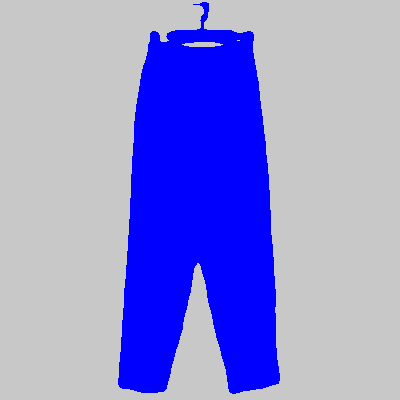

 15%|█████████▏                                                   | 135/900 [00:21<01:56,  6.59it/s]

torch.Size([1, 3, 400, 400])
/mnt/nas4/hm/datasets/shopping_clothes/data/data900_personby100/dress/image/train_3148.jpg
{'background': 0, 'top': 1, 'skirt': 2, 'outer': 3, 'dress': 4, 'bottom': 5}
Counter({0: 116239, 4: 43761})


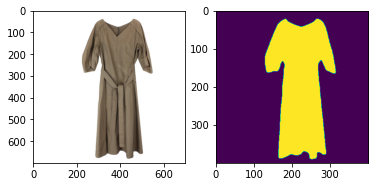

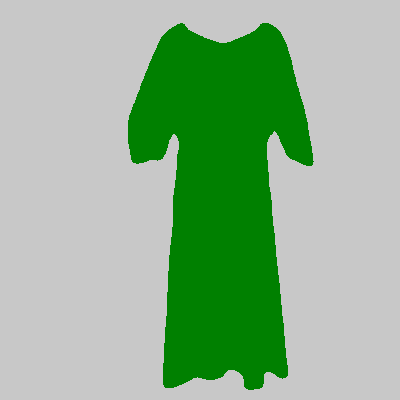

 15%|█████████▏                                                   | 136/900 [00:21<01:59,  6.39it/s]

torch.Size([1, 3, 400, 400])
/mnt/nas4/hm/datasets/shopping_clothes/data/data900_personby100/top/image/train_3863.jpg
{'background': 0, 'top': 1, 'skirt': 2, 'outer': 3, 'dress': 4, 'bottom': 5}
Counter({0: 98863, 1: 61137})


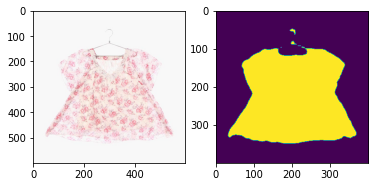

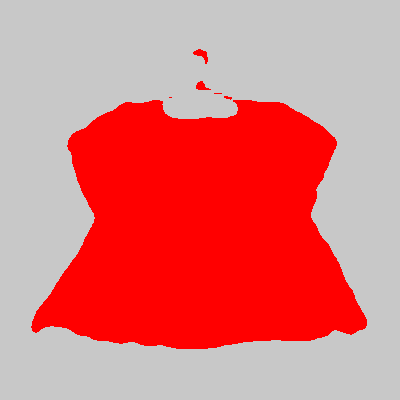

 15%|█████████▎                                                   | 137/900 [00:21<01:58,  6.46it/s]

torch.Size([1, 3, 400, 400])
/mnt/nas4/hm/datasets/shopping_clothes/data/data900_personby100/top/image/train_10187.jpg
{'background': 0, 'top': 1, 'skirt': 2, 'outer': 3, 'dress': 4, 'bottom': 5}
Counter({0: 83922, 1: 76078})


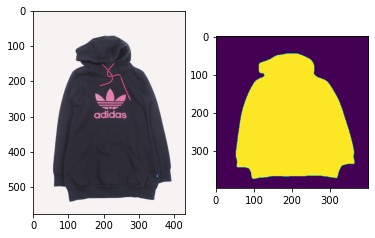

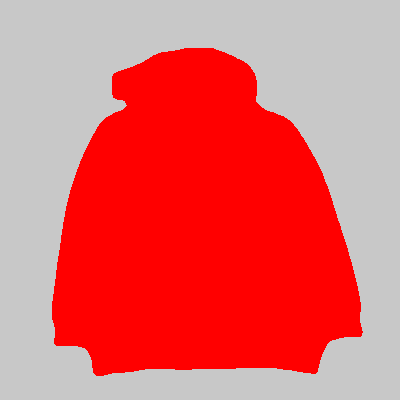

 15%|█████████▎                                                   | 138/900 [00:21<01:56,  6.54it/s]

torch.Size([1, 3, 400, 400])
/mnt/nas4/hm/datasets/shopping_clothes/data/data900_personby100/skirt/image/train_565.jpg
{'background': 0, 'top': 1, 'skirt': 2, 'outer': 3, 'dress': 4, 'bottom': 5}
Counter({0: 102663, 2: 57337})


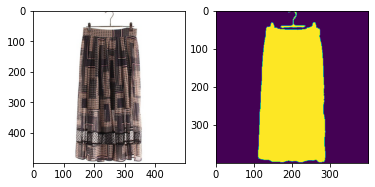

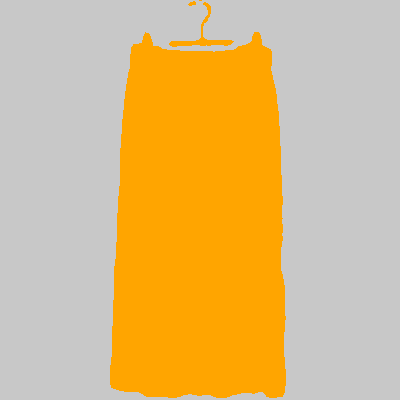

 15%|█████████▍                                                   | 139/900 [00:21<01:54,  6.67it/s]

torch.Size([1, 3, 400, 400])
/mnt/nas4/hm/datasets/shopping_clothes/data/data900_personby100/top/image/train_7922.jpg
{'background': 0, 'top': 1, 'skirt': 2, 'outer': 3, 'dress': 4, 'bottom': 5}
Counter({0: 111644, 1: 48356})


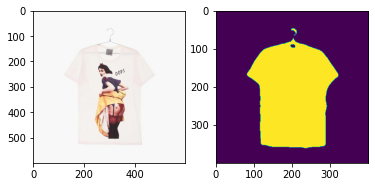

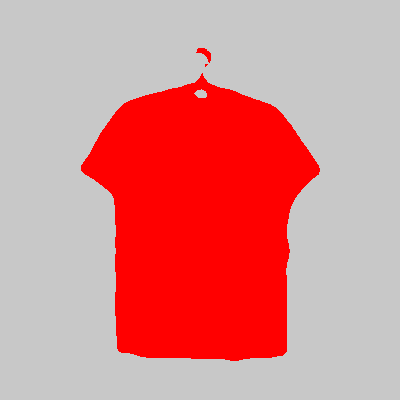

 16%|█████████▍                                                   | 140/900 [00:21<02:07,  5.97it/s]

torch.Size([1, 3, 400, 400])
/mnt/nas4/hm/datasets/shopping_clothes/data/data900_personby100/skirt/image/train_563.jpg
{'background': 0, 'top': 1, 'skirt': 2, 'outer': 3, 'dress': 4, 'bottom': 5}
Counter({0: 84051, 2: 75949})


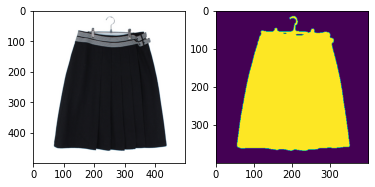

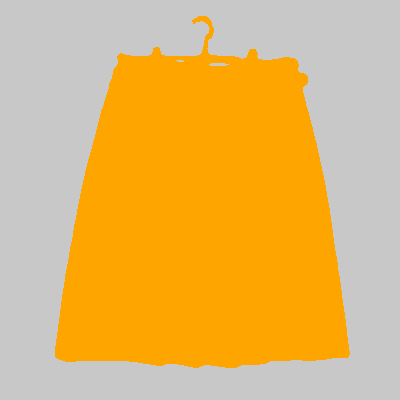

 16%|█████████▌                                                   | 141/900 [00:21<02:02,  6.22it/s]

torch.Size([1, 3, 400, 400])
/mnt/nas4/hm/datasets/shopping_clothes/data/data900_personby100/bottom/image/train_927.jpg
{'background': 0, 'top': 1, 'skirt': 2, 'outer': 3, 'dress': 4, 'bottom': 5}
Counter({5: 85978, 0: 74022})


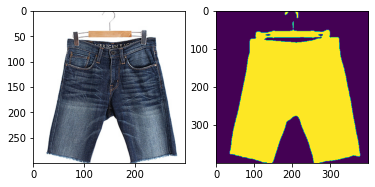

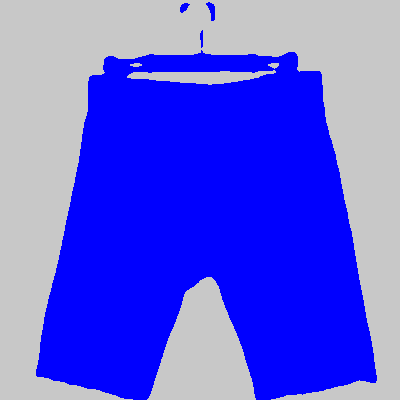

 16%|█████████▌                                                   | 142/900 [00:22<01:55,  6.54it/s]

torch.Size([1, 3, 400, 400])
/mnt/nas4/hm/datasets/shopping_clothes/data/data900_personby100/dress/image/train_53.jpg
{'background': 0, 'top': 1, 'skirt': 2, 'outer': 3, 'dress': 4, 'bottom': 5}
Counter({0: 102581, 4: 57419})


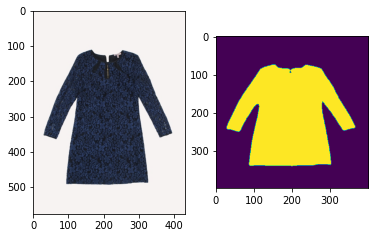

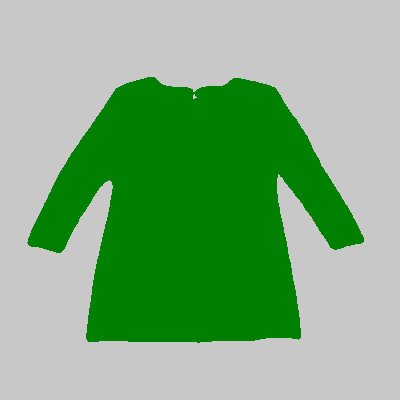

 16%|█████████▋                                                   | 143/900 [00:22<01:54,  6.62it/s]

torch.Size([1, 3, 400, 400])
/mnt/nas4/hm/datasets/shopping_clothes/data/data900_personby100/skirt/image/train_2173.jpg
{'background': 0, 'top': 1, 'skirt': 2, 'outer': 3, 'dress': 4, 'bottom': 5}
Counter({2: 86832, 0: 73168})


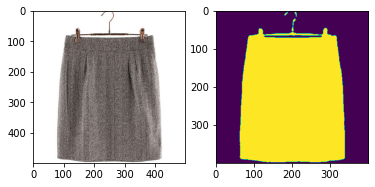

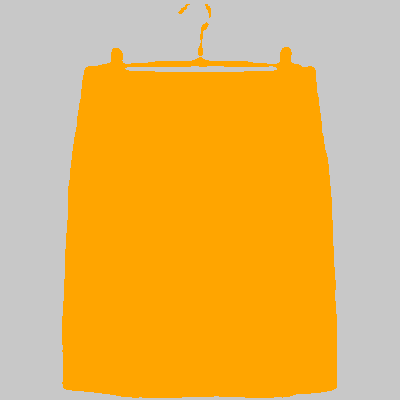

 16%|█████████▊                                                   | 144/900 [00:22<01:52,  6.72it/s]

torch.Size([1, 3, 400, 400])
/mnt/nas4/hm/datasets/shopping_clothes/data/data900_personby100/bottom/image/train_1446.jpg
{'background': 0, 'top': 1, 'skirt': 2, 'outer': 3, 'dress': 4, 'bottom': 5}
Counter({0: 112290, 5: 47710})


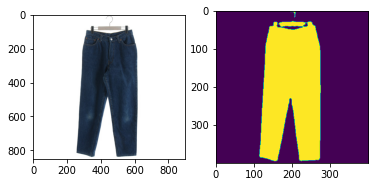

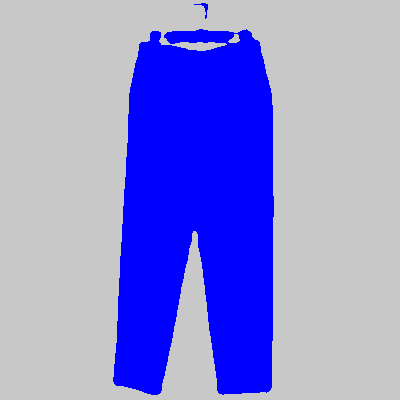

 16%|█████████▊                                                   | 145/900 [00:22<02:00,  6.25it/s]

torch.Size([1, 3, 400, 400])
/mnt/nas4/hm/datasets/shopping_clothes/data/data900_personby100/dress/image/train_280.jpg
{'background': 0, 'top': 1, 'skirt': 2, 'outer': 3, 'dress': 4, 'bottom': 5}
Counter({0: 117997, 4: 42003})


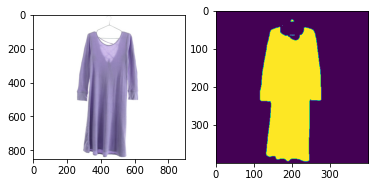

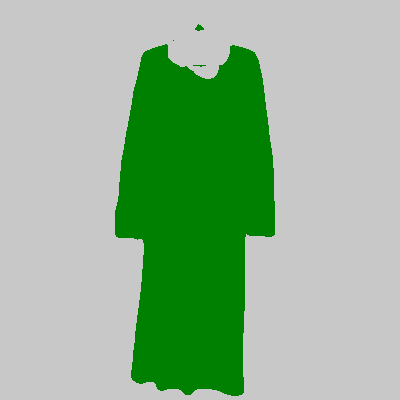

 16%|█████████▉                                                   | 146/900 [00:22<02:05,  6.03it/s]

torch.Size([1, 3, 400, 400])
/mnt/nas4/hm/datasets/shopping_clothes/data/data900_personby100/outer/image/train_7509.jpg
{'background': 0, 'top': 1, 'skirt': 2, 'outer': 3, 'dress': 4, 'bottom': 5}
Counter({0: 111107, 3: 48893})


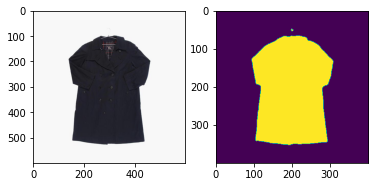

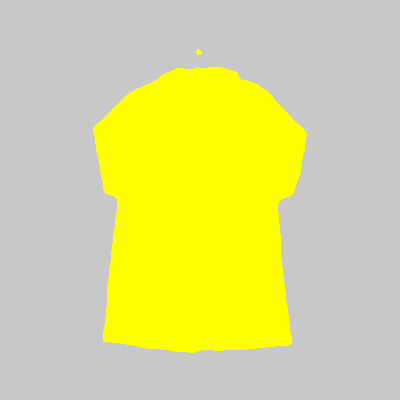

 16%|█████████▉                                                   | 147/900 [00:22<02:01,  6.21it/s]

torch.Size([1, 3, 400, 400])
/mnt/nas4/hm/datasets/shopping_clothes/data/data900_personby100/bottom/image/train_2450.jpg
{'background': 0, 'top': 1, 'skirt': 2, 'outer': 3, 'dress': 4, 'bottom': 5}
Counter({0: 119976, 5: 40024})


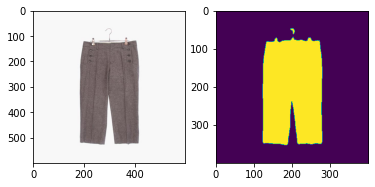

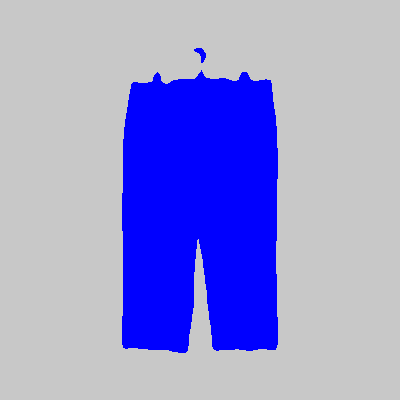

 16%|██████████                                                   | 148/900 [00:23<01:58,  6.36it/s]

torch.Size([1, 3, 400, 400])
/mnt/nas4/hm/datasets/shopping_clothes/data/data900_personby100/skirt/image/train_229.jpg
{'background': 0, 'top': 1, 'skirt': 2, 'outer': 3, 'dress': 4, 'bottom': 5}
Counter({0: 108268, 2: 51732})


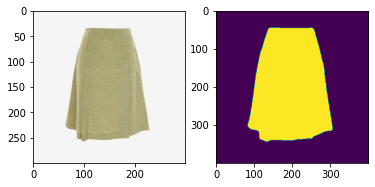

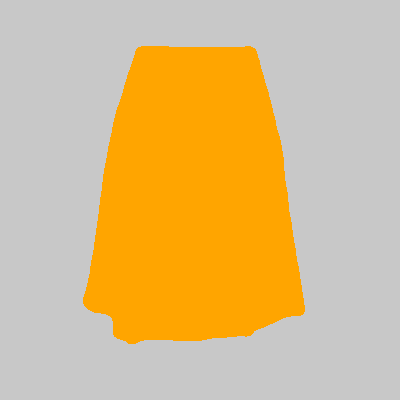

 17%|██████████                                                   | 149/900 [00:23<01:52,  6.69it/s]

torch.Size([1, 3, 400, 400])
/mnt/nas4/hm/datasets/shopping_clothes/data/data900_personby100/skirt/image/train_2060.jpg
{'background': 0, 'top': 1, 'skirt': 2, 'outer': 3, 'dress': 4, 'bottom': 5}
Counter({0: 92004, 2: 67996})


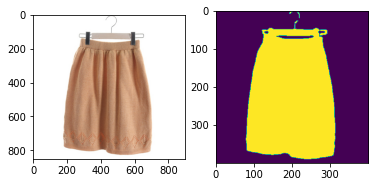

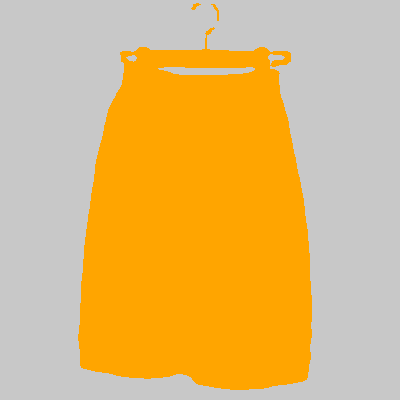

 17%|██████████▏                                                  | 150/900 [00:23<02:02,  6.14it/s]

torch.Size([1, 3, 400, 400])
/mnt/nas4/hm/datasets/shopping_clothes/data/data900_personby100/top/image/train_6387.jpg
{'background': 0, 'top': 1, 'skirt': 2, 'outer': 3, 'dress': 4, 'bottom': 5}
Counter({0: 113132, 1: 46868})


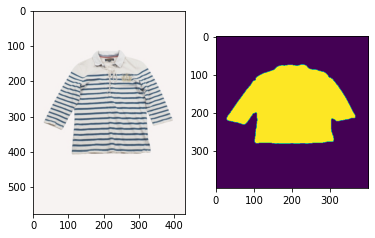

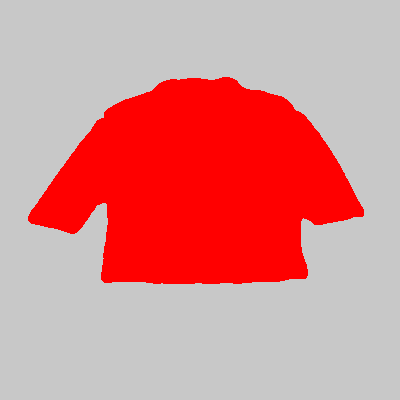

 17%|██████████▏                                                  | 151/900 [00:23<02:11,  5.69it/s]

torch.Size([1, 3, 400, 400])
/mnt/nas4/hm/datasets/shopping_clothes/data/data900_personby100/skirt/image/train_1426.jpg
{'background': 0, 'top': 1, 'skirt': 2, 'outer': 3, 'dress': 4, 'bottom': 5}
Counter({0: 94063, 2: 65937})


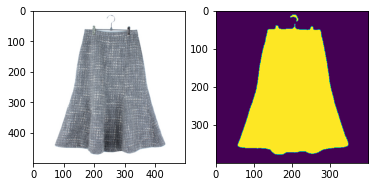

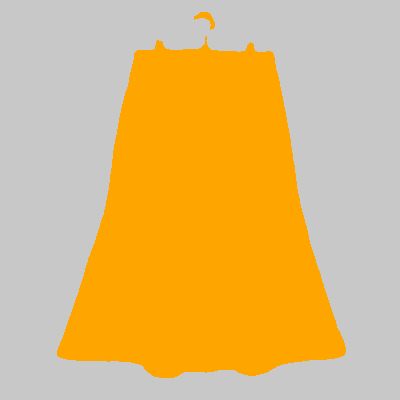

 17%|██████████▎                                                  | 152/900 [00:23<02:04,  5.99it/s]

torch.Size([1, 3, 400, 400])
/mnt/nas4/hm/datasets/shopping_clothes/data/data900_personby100/bottom/image/train_484.jpg
{'background': 0, 'top': 1, 'skirt': 2, 'outer': 3, 'dress': 4, 'bottom': 5}
Counter({0: 112941, 5: 47059})


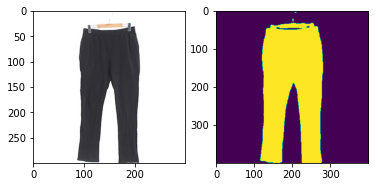

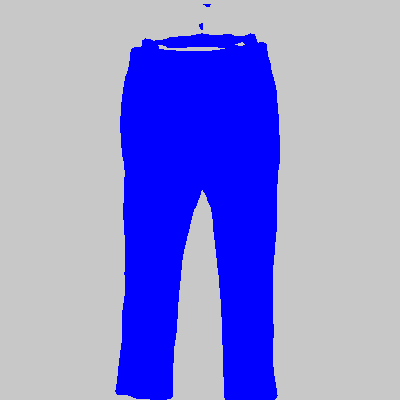

 17%|██████████▎                                                  | 153/900 [00:23<01:57,  6.38it/s]

torch.Size([1, 3, 400, 400])
/mnt/nas4/hm/datasets/shopping_clothes/data/data900_personby100/bottom/image/train_2005.jpg
{'background': 0, 'top': 1, 'skirt': 2, 'outer': 3, 'dress': 4, 'bottom': 5}
Counter({0: 108257, 5: 51743})


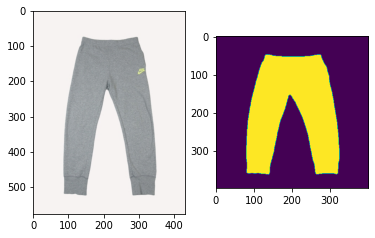

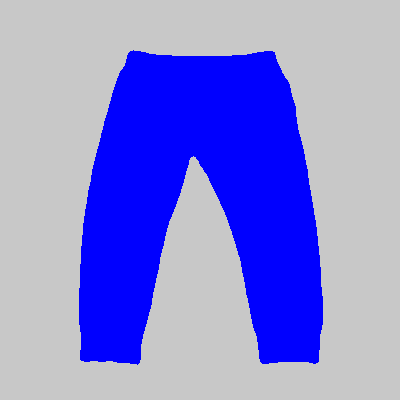

 17%|██████████▍                                                  | 154/900 [00:24<01:54,  6.52it/s]

torch.Size([1, 3, 400, 400])
/mnt/nas4/hm/datasets/shopping_clothes/data/data900_personby100/outer/image/train_3388.jpg
{'background': 0, 'top': 1, 'skirt': 2, 'outer': 3, 'dress': 4, 'bottom': 5}
Counter({0: 97850, 3: 62150})


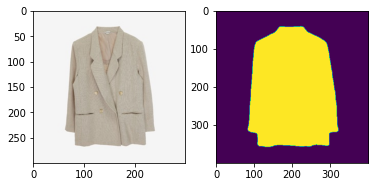

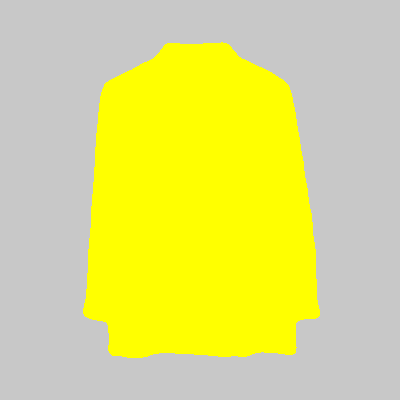

 17%|██████████▌                                                  | 155/900 [00:24<01:49,  6.81it/s]

torch.Size([1, 3, 400, 400])
/mnt/nas4/hm/datasets/shopping_clothes/data/data900_personby100/skirt/image/train_518.jpg
{'background': 0, 'top': 1, 'skirt': 2, 'outer': 3, 'dress': 4, 'bottom': 5}
Counter({0: 111756, 2: 48244})


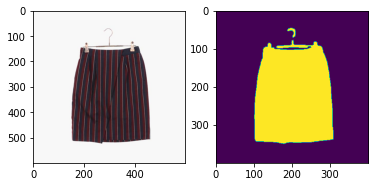

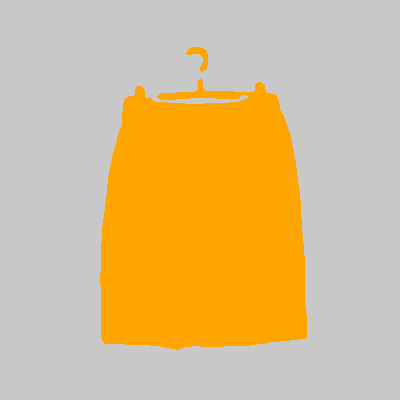

 17%|██████████▌                                                  | 156/900 [00:24<01:49,  6.78it/s]

torch.Size([1, 3, 400, 400])
/mnt/nas4/hm/datasets/shopping_clothes/data/data900_personby100/skirt/image/train_266.jpg
{'background': 0, 'top': 1, 'skirt': 2, 'outer': 3, 'dress': 4, 'bottom': 5}
Counter({0: 103056, 2: 56944})


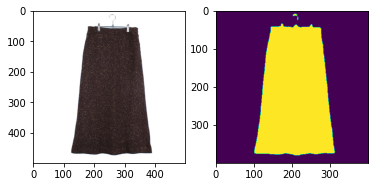

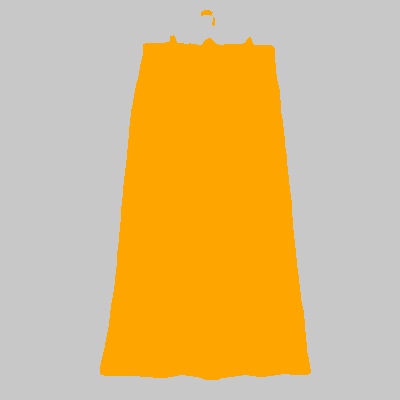

 17%|██████████▋                                                  | 157/900 [00:24<01:49,  6.79it/s]

torch.Size([1, 3, 400, 400])
/mnt/nas4/hm/datasets/shopping_clothes/data/data900_personby100/top/image/train_8979.jpg
{'background': 0, 'top': 1, 'skirt': 2, 'outer': 3, 'dress': 4, 'bottom': 5}
Counter({0: 104507, 1: 55493})


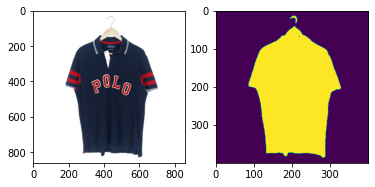

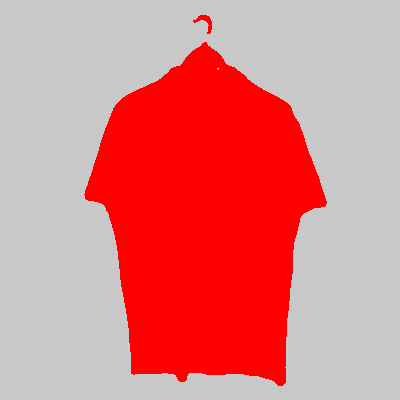

 18%|██████████▋                                                  | 158/900 [00:24<01:56,  6.38it/s]

torch.Size([1, 3, 400, 400])
/mnt/nas4/hm/datasets/shopping_clothes/data/data900_personby100/dress/image/train_3323.jpg
{'background': 0, 'top': 1, 'skirt': 2, 'outer': 3, 'dress': 4, 'bottom': 5}
Counter({0: 106684, 4: 53316})


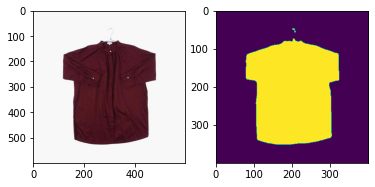

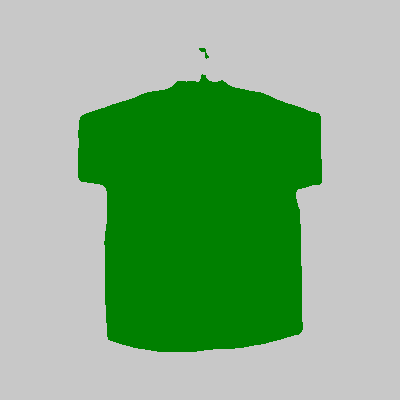

 18%|██████████▊                                                  | 159/900 [00:24<01:54,  6.47it/s]

torch.Size([1, 3, 400, 400])
/mnt/nas4/hm/datasets/shopping_clothes/data/data900_personby100/skirt/image/train_2013.jpg
{'background': 0, 'top': 1, 'skirt': 2, 'outer': 3, 'dress': 4, 'bottom': 5}
Counter({0: 81278, 2: 78722})


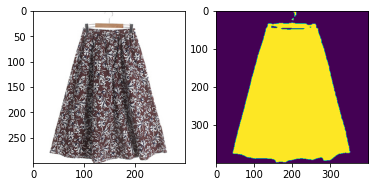

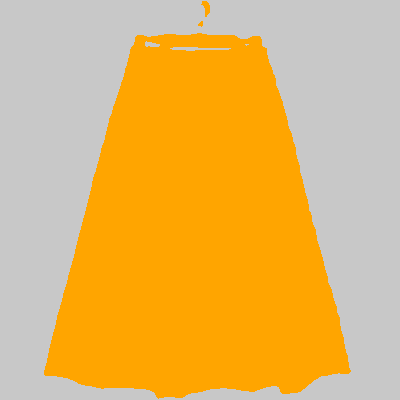

 18%|██████████▊                                                  | 160/900 [00:24<01:49,  6.75it/s]

torch.Size([1, 3, 400, 400])
/mnt/nas4/hm/datasets/shopping_clothes/data/data900_personby100/bottom/image/train_1424.jpg
{'background': 0, 'top': 1, 'skirt': 2, 'outer': 3, 'dress': 4, 'bottom': 5}
Counter({0: 115503, 5: 44497})


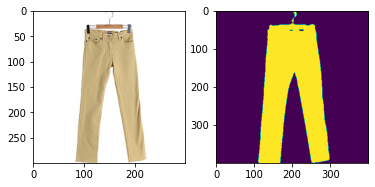

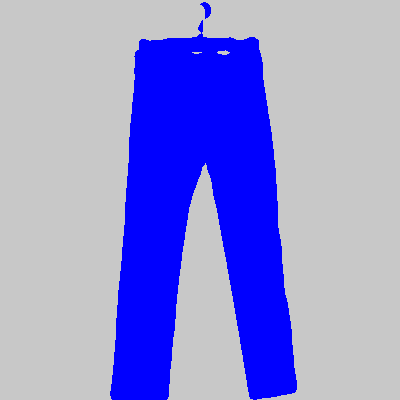

 18%|██████████▉                                                  | 161/900 [00:25<01:45,  6.99it/s]

torch.Size([1, 3, 400, 400])
/mnt/nas4/hm/datasets/shopping_clothes/data/data900_personby100/bottom/image/train_3318.jpg
{'background': 0, 'top': 1, 'skirt': 2, 'outer': 3, 'dress': 4, 'bottom': 5}
Counter({0: 114462, 5: 45538})


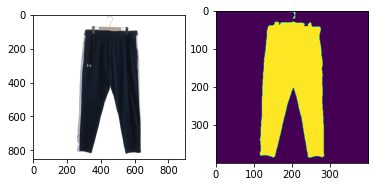

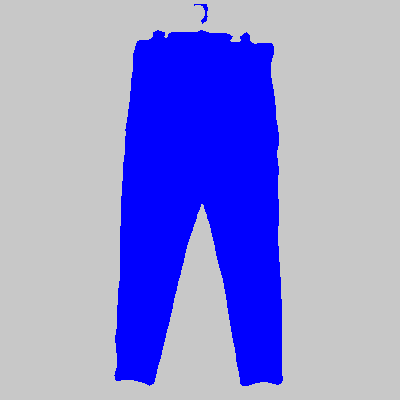

 18%|██████████▉                                                  | 162/900 [00:25<02:07,  5.80it/s]

torch.Size([1, 3, 400, 400])
/mnt/nas4/hm/datasets/shopping_clothes/data/data900_personby100/outer/image/train_9609.jpg
{'background': 0, 'top': 1, 'skirt': 2, 'outer': 3, 'dress': 4, 'bottom': 5}
Counter({0: 84158, 3: 75842})


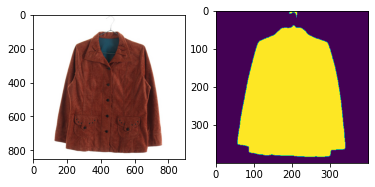

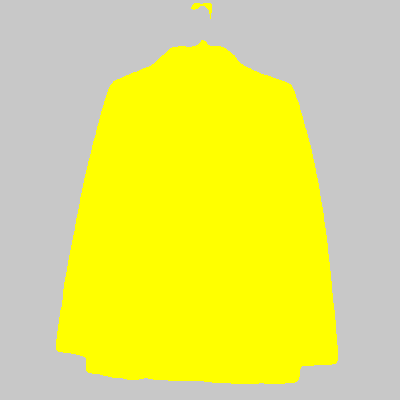

 18%|███████████                                                  | 163/900 [00:25<02:10,  5.63it/s]

torch.Size([1, 3, 400, 400])
/mnt/nas4/hm/datasets/shopping_clothes/data/data900_personby100/top/image/train_8348.jpg
{'background': 0, 'top': 1, 'skirt': 2, 'outer': 3, 'dress': 4, 'bottom': 5}
Counter({0: 91112, 1: 68888})


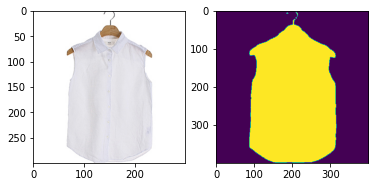

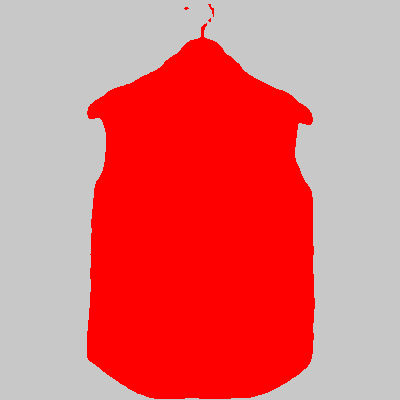

 18%|███████████                                                  | 164/900 [00:25<02:01,  6.08it/s]

torch.Size([1, 3, 400, 400])
/mnt/nas4/hm/datasets/shopping_clothes/data/data900_personby100/skirt/image/train_2325.jpg
{'background': 0, 'top': 1, 'skirt': 2, 'outer': 3, 'dress': 4, 'bottom': 5}
Counter({2: 88759, 0: 71241})


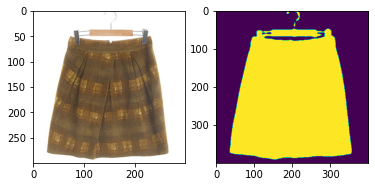

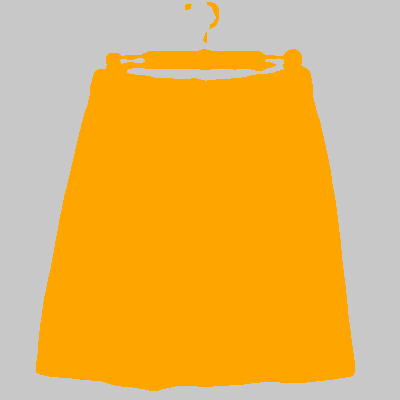

 18%|███████████▏                                                 | 165/900 [00:25<01:54,  6.45it/s]

torch.Size([1, 3, 400, 400])
/mnt/nas4/hm/datasets/shopping_clothes/data/data900_personby100/dress/image/train_2139.jpg
{'background': 0, 'top': 1, 'skirt': 2, 'outer': 3, 'dress': 4, 'bottom': 5}
Counter({0: 119789, 4: 40211})


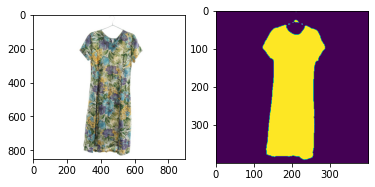

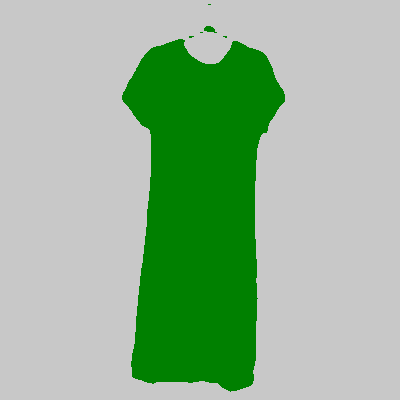

 18%|███████████▎                                                 | 166/900 [00:25<01:59,  6.14it/s]

torch.Size([1, 3, 400, 400])
/mnt/nas4/hm/datasets/shopping_clothes/data/data900_personby100/top/image/train_3954.jpg
{'background': 0, 'top': 1, 'skirt': 2, 'outer': 3, 'dress': 4, 'bottom': 5}
Counter({0: 114126, 1: 45874})


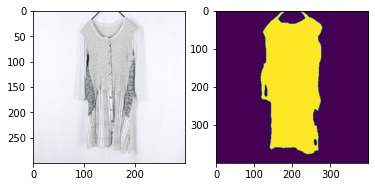

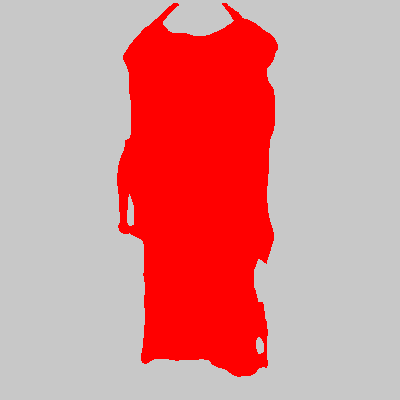

 19%|███████████▎                                                 | 167/900 [00:26<01:52,  6.51it/s]

torch.Size([1, 3, 400, 400])
/mnt/nas4/hm/datasets/shopping_clothes/data/data900_personby100/skirt/image/train_1451.jpg
{'background': 0, 'top': 1, 'skirt': 2, 'outer': 3, 'dress': 4, 'bottom': 5}
Counter({0: 105778, 2: 54222})


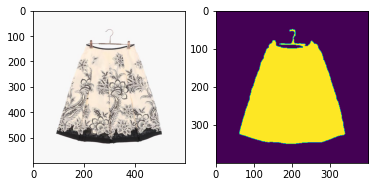

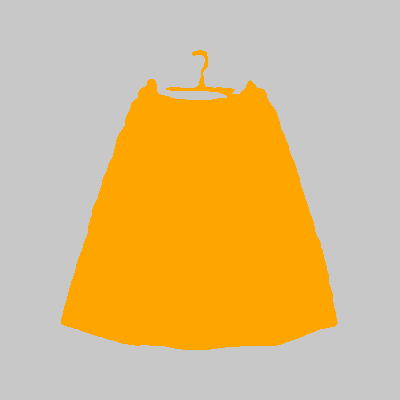

 19%|███████████▍                                                 | 168/900 [00:26<01:51,  6.58it/s]

torch.Size([1, 3, 400, 400])
/mnt/nas4/hm/datasets/shopping_clothes/data/data900_personby100/outer/image/train_1432.jpg
{'background': 0, 'top': 1, 'skirt': 2, 'outer': 3, 'dress': 4, 'bottom': 5}
Counter({0: 95836, 3: 64164})


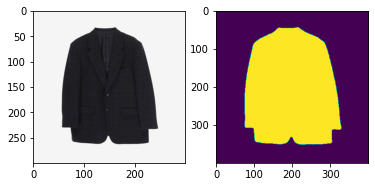

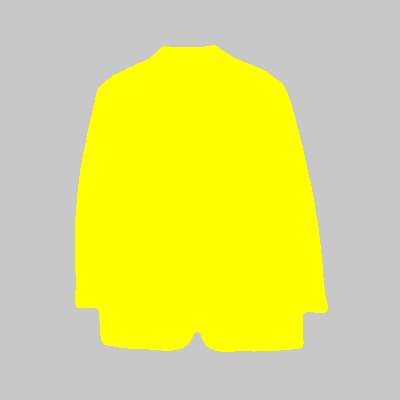

 19%|███████████▍                                                 | 169/900 [00:26<01:46,  6.87it/s]

torch.Size([1, 3, 400, 400])
/mnt/nas4/hm/datasets/shopping_clothes/data/data900_personby100/top/image/train_2482.jpg
{'background': 0, 'top': 1, 'skirt': 2, 'outer': 3, 'dress': 4, 'bottom': 5}
Counter({0: 92998, 1: 67002})


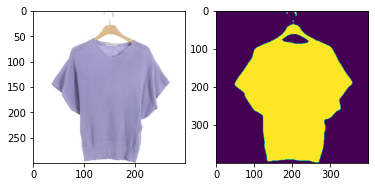

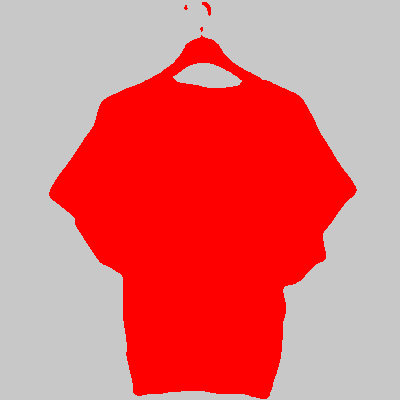

 19%|███████████▌                                                 | 170/900 [00:26<01:43,  7.06it/s]

torch.Size([1, 3, 400, 400])
/mnt/nas4/hm/datasets/shopping_clothes/data/data900_personby100/top/image/train_14560.jpg
{'background': 0, 'top': 1, 'skirt': 2, 'outer': 3, 'dress': 4, 'bottom': 5}
Counter({0: 93478, 1: 66522})


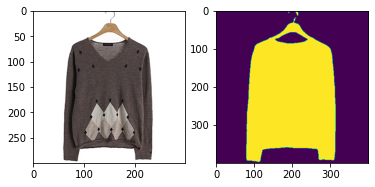

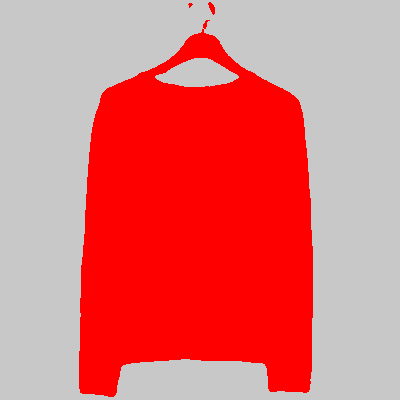

 19%|███████████▌                                                 | 171/900 [00:26<01:41,  7.18it/s]

torch.Size([1, 3, 400, 400])
/mnt/nas4/hm/datasets/shopping_clothes/data/data900_personby100/outer/image/train_8263.jpg
{'background': 0, 'top': 1, 'skirt': 2, 'outer': 3, 'dress': 4, 'bottom': 5}
Counter({0: 87166, 3: 72834})


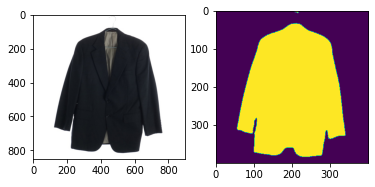

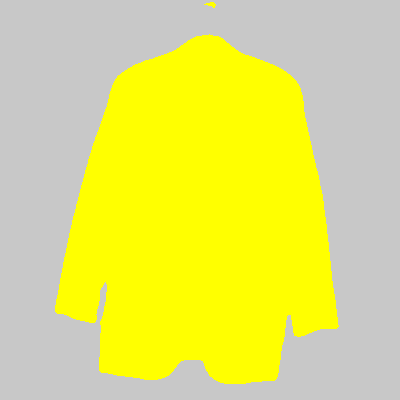

 19%|███████████▋                                                 | 172/900 [00:26<01:51,  6.54it/s]

torch.Size([1, 3, 400, 400])
/mnt/nas4/hm/datasets/shopping_clothes/data/data900_personby100/outer/image/train_7738.jpg
{'background': 0, 'top': 1, 'skirt': 2, 'outer': 3, 'dress': 4, 'bottom': 5}
Counter({0: 82143, 3: 77857})


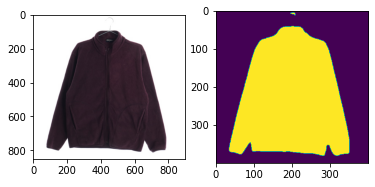

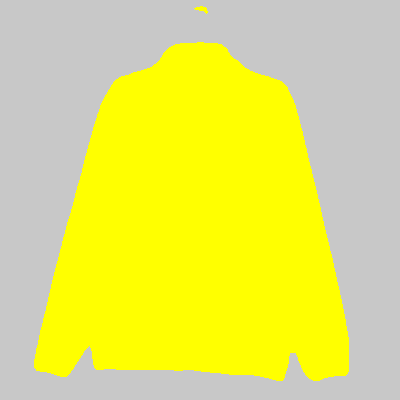

 19%|███████████▋                                                 | 173/900 [00:27<02:12,  5.47it/s]

torch.Size([1, 3, 400, 400])
/mnt/nas4/hm/datasets/shopping_clothes/data/data900_personby100/skirt/image/train_603.jpg
{'background': 0, 'top': 1, 'skirt': 2, 'outer': 3, 'dress': 4, 'bottom': 5}
Counter({0: 88271, 2: 71729})


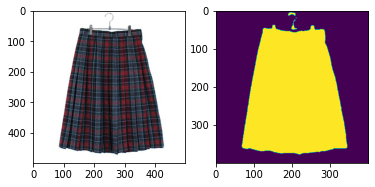

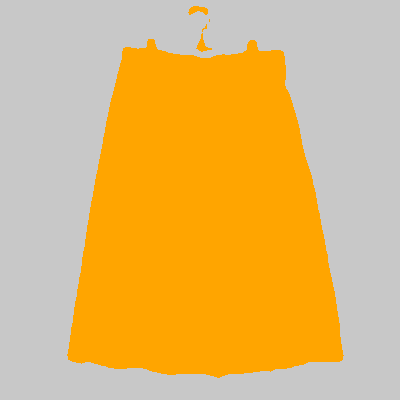

 19%|███████████▊                                                 | 174/900 [00:27<02:04,  5.82it/s]

torch.Size([1, 3, 400, 400])
/mnt/nas4/hm/datasets/shopping_clothes/data/data900_personby100/outer/image/train_2745.jpg
{'background': 0, 'top': 1, 'skirt': 2, 'outer': 3, 'dress': 4, 'bottom': 5}
Counter({3: 80196, 0: 79804})


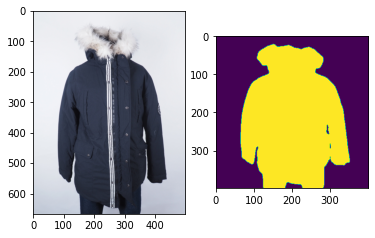

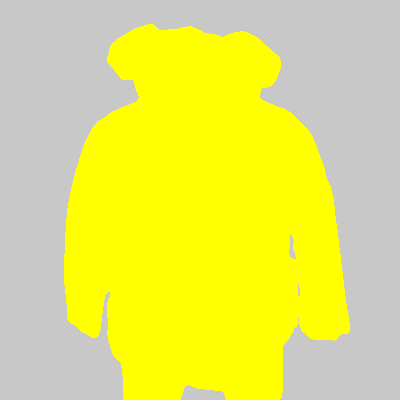

 19%|███████████▊                                                 | 175/900 [00:27<02:03,  5.86it/s]

torch.Size([1, 3, 400, 400])
/mnt/nas4/hm/datasets/shopping_clothes/data/data900_personby100/dress/image/train_3358.jpg
{'background': 0, 'top': 1, 'skirt': 2, 'outer': 3, 'dress': 4, 'bottom': 5}
Counter({0: 105212, 4: 54788})


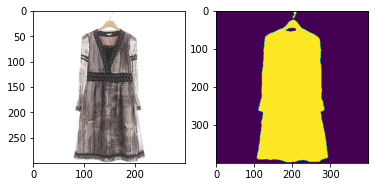

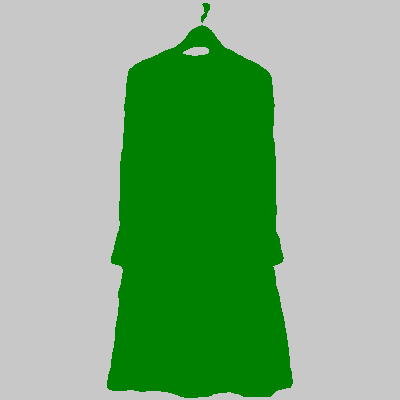

 20%|███████████▉                                                 | 176/900 [00:27<01:55,  6.28it/s]

torch.Size([1, 3, 400, 400])
/mnt/nas4/hm/datasets/shopping_clothes/data/data900_personby100/dress/image/train_1760.jpg
{'background': 0, 'top': 1, 'skirt': 2, 'outer': 3, 'dress': 4, 'bottom': 5}
Counter({0: 135845, 4: 24155})


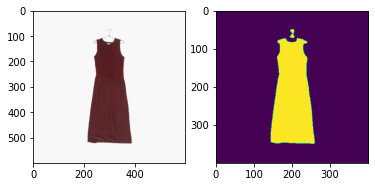

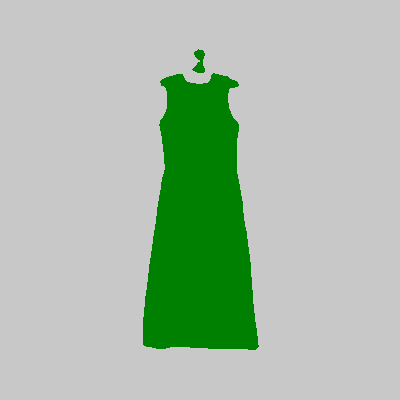

 20%|███████████▉                                                 | 177/900 [00:27<01:52,  6.41it/s]

torch.Size([1, 3, 400, 400])
/mnt/nas4/hm/datasets/shopping_clothes/data/data900_personby100/bottom/image/train_2699.jpg
{'background': 0, 'top': 1, 'skirt': 2, 'outer': 3, 'dress': 4, 'bottom': 5}
Counter({0: 107693, 5: 52307})


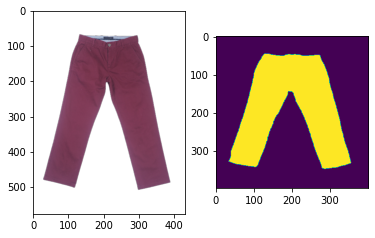

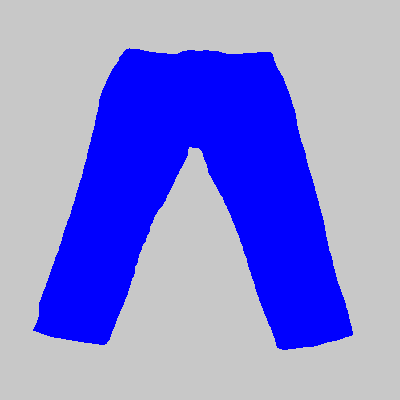

 20%|████████████                                                 | 178/900 [00:27<01:50,  6.52it/s]

torch.Size([1, 3, 400, 400])
/mnt/nas4/hm/datasets/shopping_clothes/data/data900_personby100/skirt/image/train_595.jpg
{'background': 0, 'top': 1, 'skirt': 2, 'outer': 3, 'dress': 4, 'bottom': 5}
Counter({0: 101760, 2: 58240})


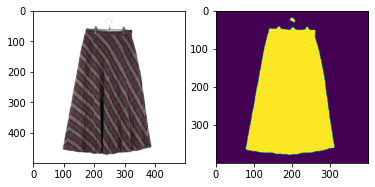

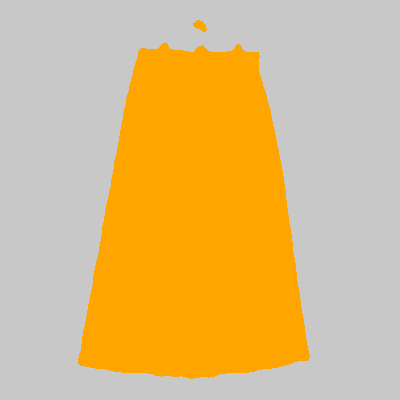

 20%|████████████▏                                                | 179/900 [00:27<01:48,  6.63it/s]

torch.Size([1, 3, 400, 400])
/mnt/nas4/hm/datasets/shopping_clothes/data/data900_personby100/top/image/train_2734.jpg
{'background': 0, 'top': 1, 'skirt': 2, 'outer': 3, 'dress': 4, 'bottom': 5}
Counter({0: 113705, 1: 46295})


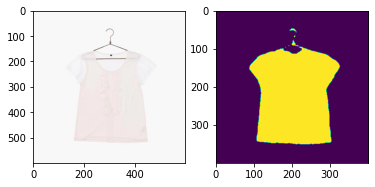

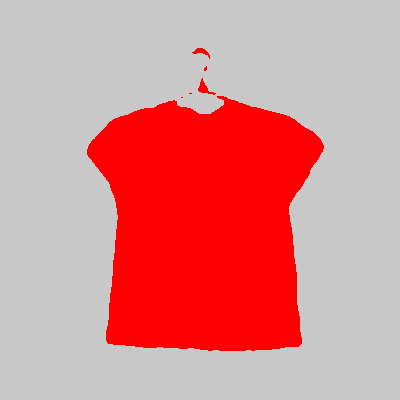

 20%|████████████▏                                                | 180/900 [00:28<01:48,  6.66it/s]

torch.Size([1, 3, 400, 400])
/mnt/nas4/hm/datasets/shopping_clothes/data/data900_personby100/top/image/train_12682.jpg
{'background': 0, 'top': 1, 'skirt': 2, 'outer': 3, 'dress': 4, 'bottom': 5}
Counter({0: 94659, 1: 65341})


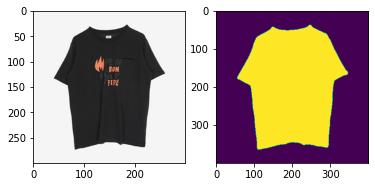

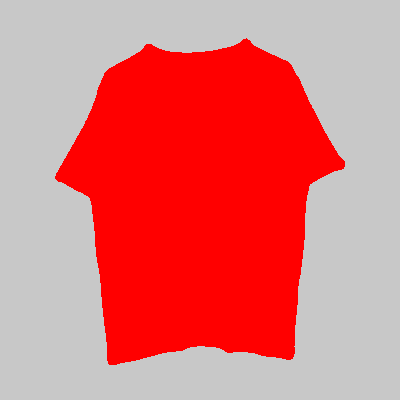

 20%|████████████▎                                                | 181/900 [00:28<01:44,  6.91it/s]

torch.Size([1, 3, 400, 400])
/mnt/nas4/hm/datasets/shopping_clothes/data/data900_personby100/top/image/train_3258.jpg
{'background': 0, 'top': 1, 'skirt': 2, 'outer': 3, 'dress': 4, 'bottom': 5}
Counter({0: 113866, 1: 46134})


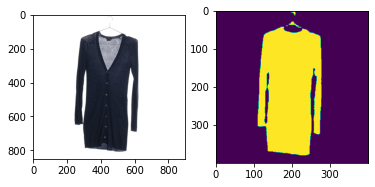

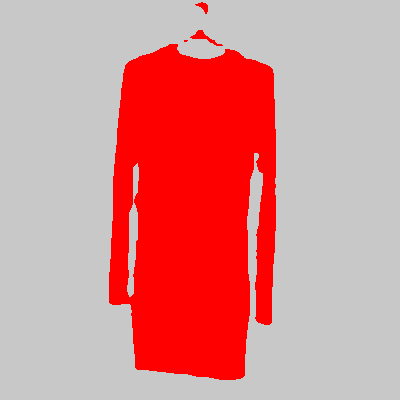

 20%|████████████▎                                                | 182/900 [00:28<01:52,  6.40it/s]

torch.Size([1, 3, 400, 400])
/mnt/nas4/hm/datasets/shopping_clothes/data/data900_personby100/bottom/image/train_83.jpg
{'background': 0, 'top': 1, 'skirt': 2, 'outer': 3, 'dress': 4, 'bottom': 5}
Counter({0: 120213, 5: 39787})


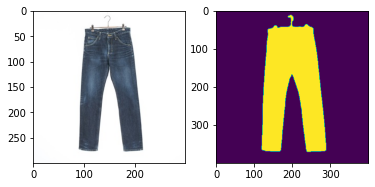

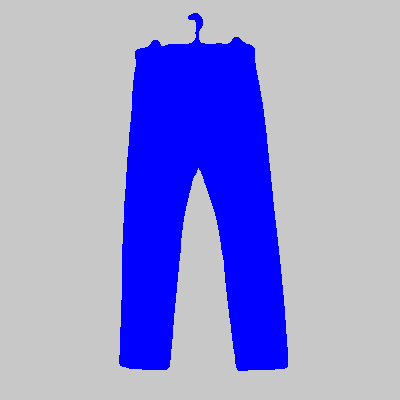

 20%|████████████▍                                                | 183/900 [00:28<01:46,  6.74it/s]

torch.Size([1, 3, 400, 400])
/mnt/nas4/hm/datasets/shopping_clothes/data/data900_personby100/skirt/image/train_1371.jpg
{'background': 0, 'top': 1, 'skirt': 2, 'outer': 3, 'dress': 4, 'bottom': 5}
Counter({0: 104796, 2: 55204})


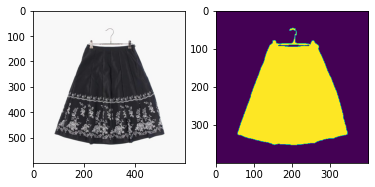

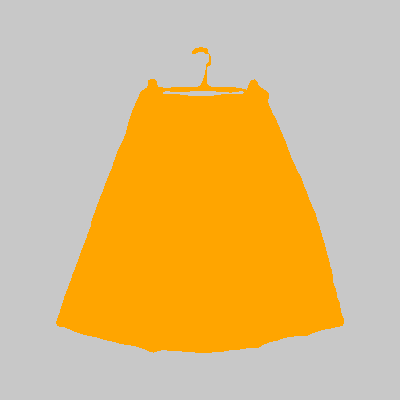

 20%|████████████▍                                                | 184/900 [00:28<01:59,  6.00it/s]

torch.Size([1, 3, 400, 400])
/mnt/nas4/hm/datasets/shopping_clothes/data/data900_personby100/bottom/image/train_904.jpg
{'background': 0, 'top': 1, 'skirt': 2, 'outer': 3, 'dress': 4, 'bottom': 5}
Counter({0: 98940, 5: 61060})


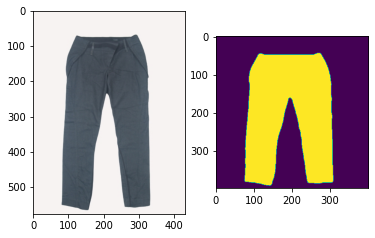

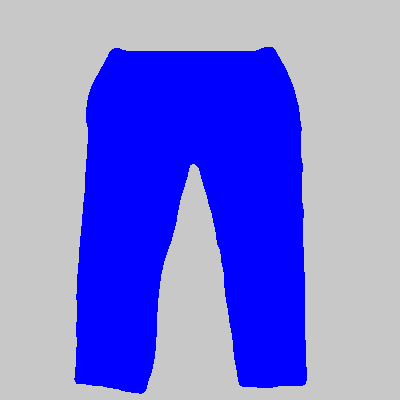

 21%|████████████▌                                                | 185/900 [00:28<01:55,  6.22it/s]

torch.Size([1, 3, 400, 400])
/mnt/nas4/hm/datasets/shopping_clothes/data/data900_personby100/outer/image/train_11508.jpg
{'background': 0, 'top': 1, 'skirt': 2, 'outer': 3, 'dress': 4, 'bottom': 5}
Counter({3: 80272, 0: 79728})


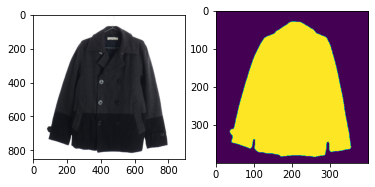

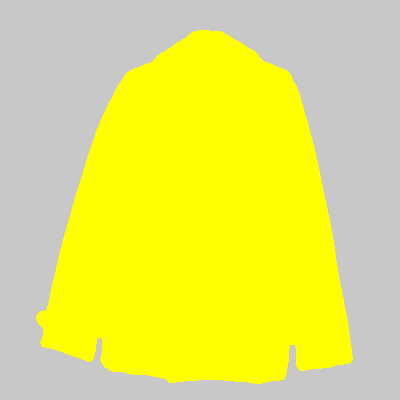

 21%|████████████▌                                                | 186/900 [00:29<02:00,  5.95it/s]

torch.Size([1, 3, 400, 400])
/mnt/nas4/hm/datasets/shopping_clothes/data/data900_personby100/skirt/image/train_1900.jpg
{'background': 0, 'top': 1, 'skirt': 2, 'outer': 3, 'dress': 4, 'bottom': 5}
Counter({0: 110839, 2: 49161})


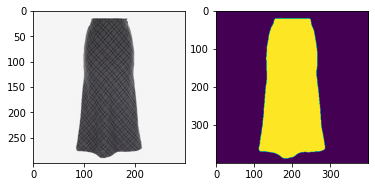

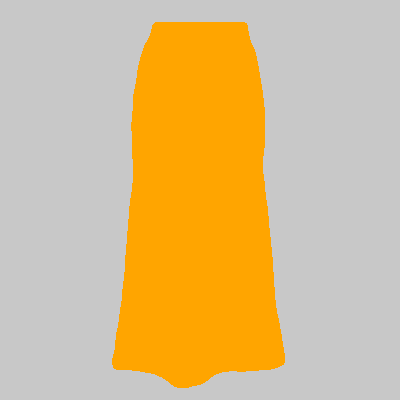

 21%|████████████▋                                                | 187/900 [00:29<01:51,  6.37it/s]

torch.Size([1, 3, 400, 400])
/mnt/nas4/hm/datasets/shopping_clothes/data/data900_personby100/skirt/image/train_2482.jpg
{'background': 0, 'top': 1, 'skirt': 2, 'outer': 3, 'dress': 4, 'bottom': 5}
Counter({0: 125340, 2: 34660})


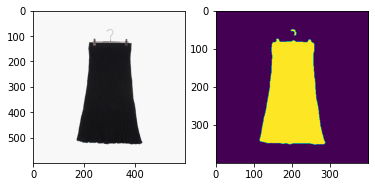

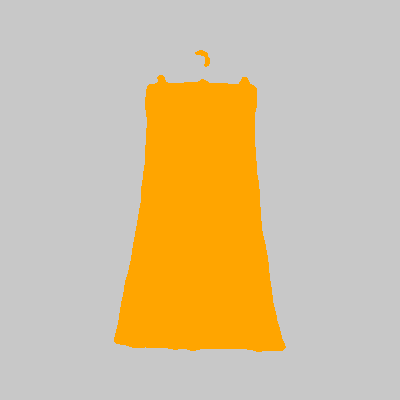

 21%|████████████▋                                                | 188/900 [00:29<01:49,  6.50it/s]

torch.Size([1, 3, 400, 400])
/mnt/nas4/hm/datasets/shopping_clothes/data/data900_personby100/top/image/train_11917.jpg
{'background': 0, 'top': 1, 'skirt': 2, 'outer': 3, 'dress': 4, 'bottom': 5}
Counter({0: 100262, 1: 59738})


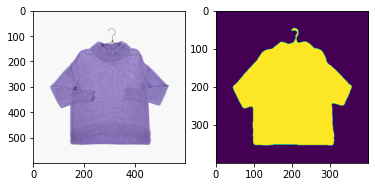

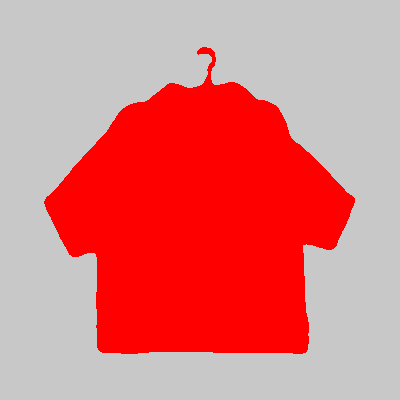

 21%|████████████▊                                                | 189/900 [00:29<01:48,  6.55it/s]

torch.Size([1, 3, 400, 400])
/mnt/nas4/hm/datasets/shopping_clothes/data/data900_personby100/dress/image/train_1669.jpg
{'background': 0, 'top': 1, 'skirt': 2, 'outer': 3, 'dress': 4, 'bottom': 5}
Counter({0: 113120, 4: 46880})


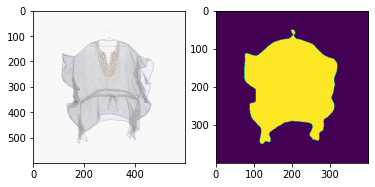

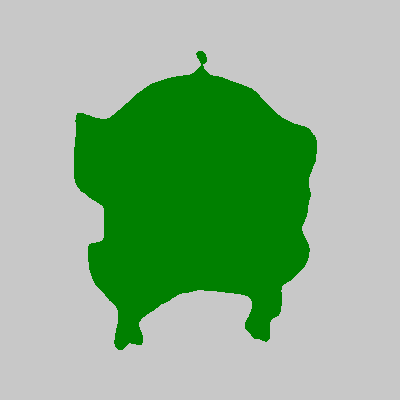

 21%|████████████▉                                                | 190/900 [00:29<01:47,  6.61it/s]

torch.Size([1, 3, 400, 400])
/mnt/nas4/hm/datasets/shopping_clothes/data/data900_personby100/skirt/image/train_1202.jpg
{'background': 0, 'top': 1, 'skirt': 2, 'outer': 3, 'dress': 4, 'bottom': 5}
Counter({0: 94383, 2: 65617})


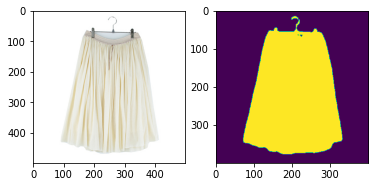

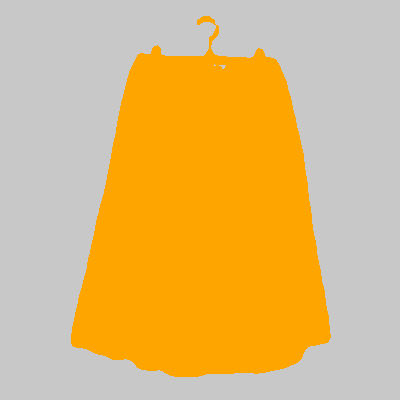

 21%|████████████▉                                                | 191/900 [00:29<01:45,  6.70it/s]

torch.Size([1, 3, 400, 400])
/mnt/nas4/hm/datasets/shopping_clothes/data/data900_personby100/bottom/image/train_1444.jpg
{'background': 0, 'top': 1, 'skirt': 2, 'outer': 3, 'dress': 4, 'bottom': 5}
Counter({0: 95805, 5: 64195})


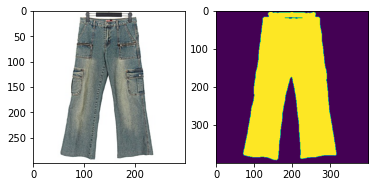

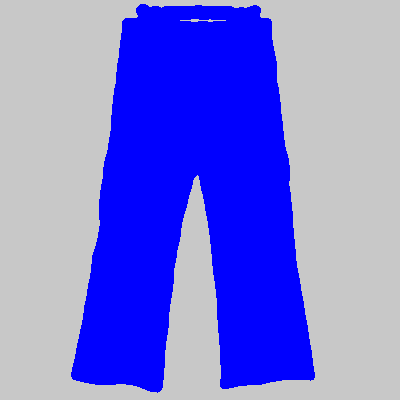

 21%|█████████████                                                | 192/900 [00:29<01:41,  6.95it/s]

torch.Size([1, 3, 400, 400])
/mnt/nas4/hm/datasets/shopping_clothes/data/data900_personby100/skirt/image/train_1796.jpg
{'background': 0, 'top': 1, 'skirt': 2, 'outer': 3, 'dress': 4, 'bottom': 5}
Counter({0: 112280, 2: 47720})


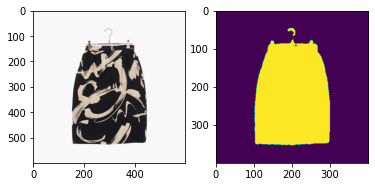

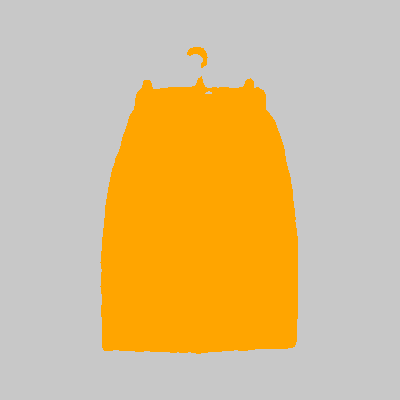

 21%|█████████████                                                | 193/900 [00:30<01:42,  6.89it/s]

torch.Size([1, 3, 400, 400])
/mnt/nas4/hm/datasets/shopping_clothes/data/data900_personby100/bottom/image/train_754.jpg
{'background': 0, 'top': 1, 'skirt': 2, 'outer': 3, 'dress': 4, 'bottom': 5}
Counter({0: 129476, 5: 30524})


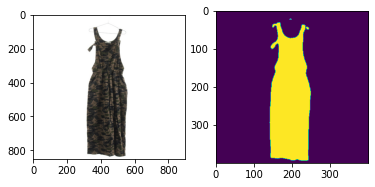

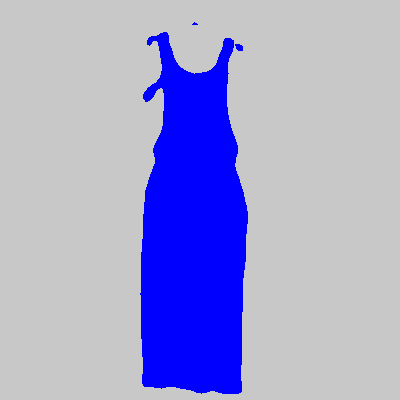

 22%|█████████████▏                                               | 194/900 [00:30<01:49,  6.45it/s]

torch.Size([1, 3, 400, 400])
/mnt/nas4/hm/datasets/shopping_clothes/data/data900_personby100/top/image/train_230.jpg
{'background': 0, 'top': 1, 'skirt': 2, 'outer': 3, 'dress': 4, 'bottom': 5}
Counter({1: 83807, 0: 76193})


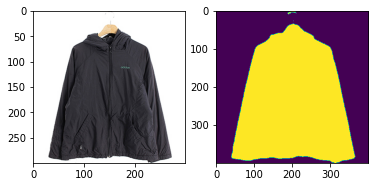

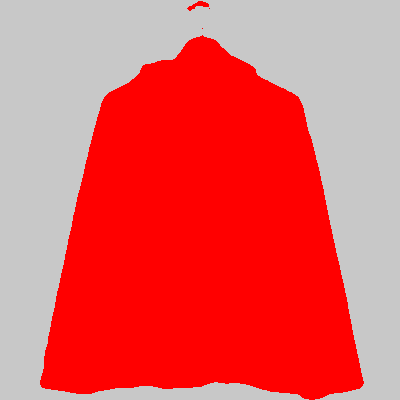

 22%|█████████████▏                                               | 195/900 [00:30<01:57,  5.99it/s]

torch.Size([1, 3, 400, 400])
/mnt/nas4/hm/datasets/shopping_clothes/data/data900_personby100/dress/image/train_dress_2928.jpg
{'background': 0, 'top': 1, 'skirt': 2, 'outer': 3, 'dress': 4, 'bottom': 5}
Counter({0: 118394, 4: 41606})


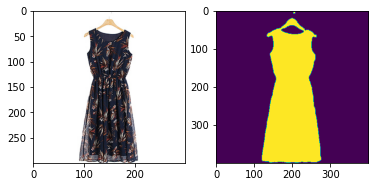

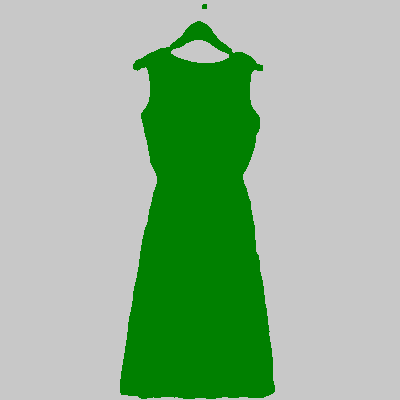

 22%|█████████████▎                                               | 196/900 [00:30<01:49,  6.41it/s]

torch.Size([1, 3, 400, 400])
/mnt/nas4/hm/datasets/shopping_clothes/data/data900_personby100/outer/image/train_4617.jpg
{'background': 0, 'top': 1, 'skirt': 2, 'outer': 3, 'dress': 4, 'bottom': 5}
Counter({0: 86325, 3: 73675})


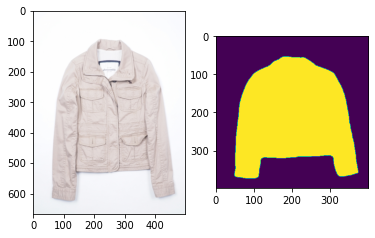

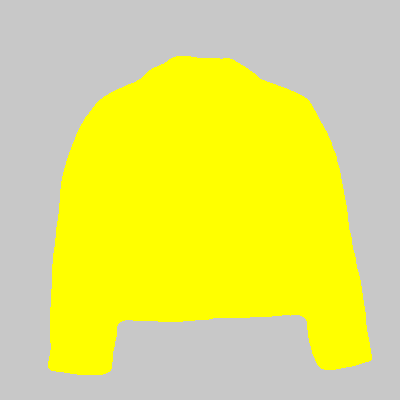

 22%|█████████████▎                                               | 197/900 [00:30<01:51,  6.32it/s]

torch.Size([1, 3, 400, 400])
/mnt/nas4/hm/datasets/shopping_clothes/data/data900_personby100/dress/image/train_817.jpg
{'background': 0, 'top': 1, 'skirt': 2, 'outer': 3, 'dress': 4, 'bottom': 5}
Counter({0: 112550, 4: 47450})


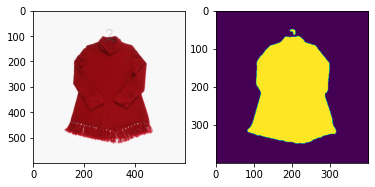

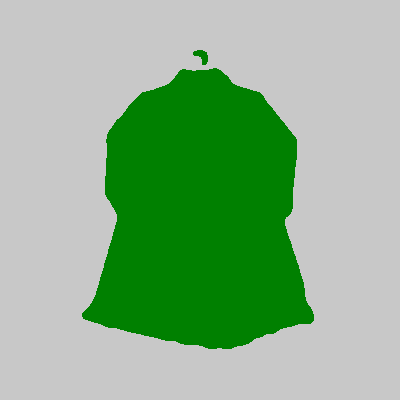

 22%|█████████████▍                                               | 198/900 [00:30<01:48,  6.44it/s]

torch.Size([1, 3, 400, 400])
/mnt/nas4/hm/datasets/shopping_clothes/data/data900_personby100/top/image/train_6969.jpg
{'background': 0, 'top': 1, 'skirt': 2, 'outer': 3, 'dress': 4, 'bottom': 5}
Counter({0: 109047, 1: 50953})


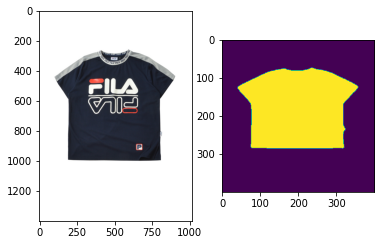

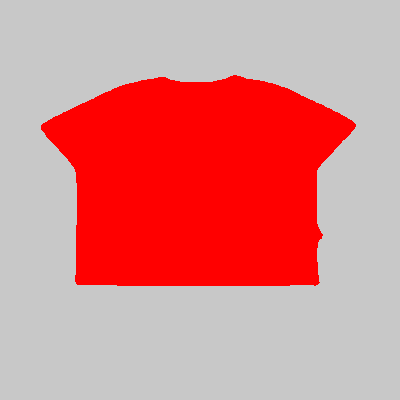

 22%|█████████████▍                                               | 199/900 [00:31<02:06,  5.54it/s]

torch.Size([1, 3, 400, 400])
/mnt/nas4/hm/datasets/shopping_clothes/data/data900_personby100/top/image/train_11018.jpg
{'background': 0, 'top': 1, 'skirt': 2, 'outer': 3, 'dress': 4, 'bottom': 5}
Counter({0: 84094, 1: 75906})


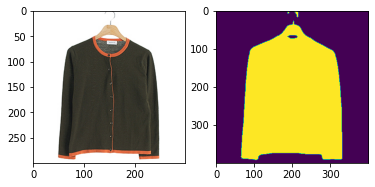

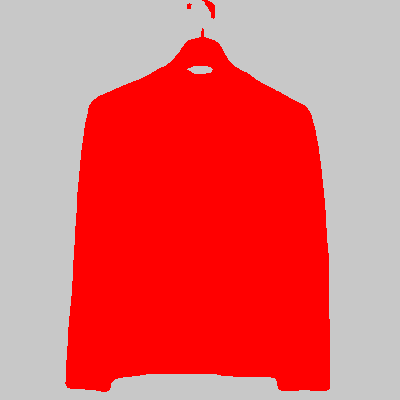

 22%|█████████████▌                                               | 200/900 [00:31<01:56,  6.00it/s]

torch.Size([1, 3, 400, 400])
/mnt/nas4/hm/datasets/shopping_clothes/data/data900_personby100/top/image/train_6353.jpg
{'background': 0, 'top': 1, 'skirt': 2, 'outer': 3, 'dress': 4, 'bottom': 5}
Counter({0: 94142, 1: 65858})


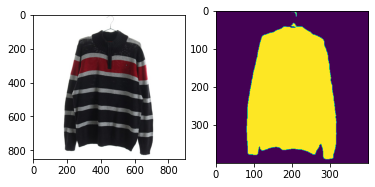

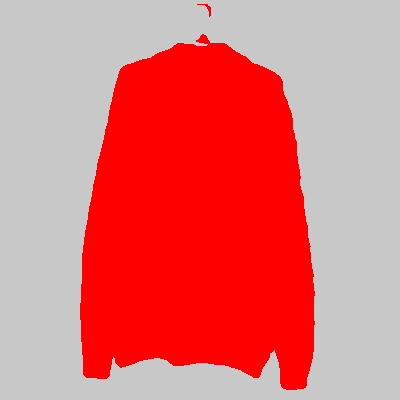

 22%|█████████████▌                                               | 201/900 [00:31<02:00,  5.79it/s]

torch.Size([1, 3, 400, 400])
/mnt/nas4/hm/datasets/shopping_clothes/data/data900_personby100/outer/image/train_4130.jpg
{'background': 0, 'top': 1, 'skirt': 2, 'outer': 3, 'dress': 4, 'bottom': 5}
Counter({0: 88149, 3: 71851})


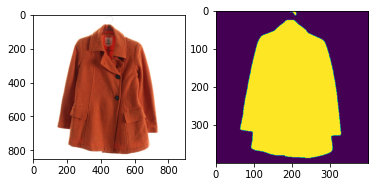

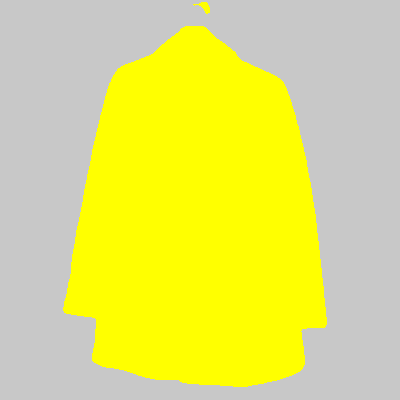

 22%|█████████████▋                                               | 202/900 [00:31<02:04,  5.59it/s]

torch.Size([1, 3, 400, 400])
/mnt/nas4/hm/datasets/shopping_clothes/data/data900_personby100/outer/image/train_8652.jpg
{'background': 0, 'top': 1, 'skirt': 2, 'outer': 3, 'dress': 4, 'bottom': 5}
Counter({0: 92793, 3: 67207})


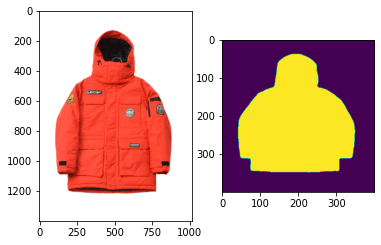

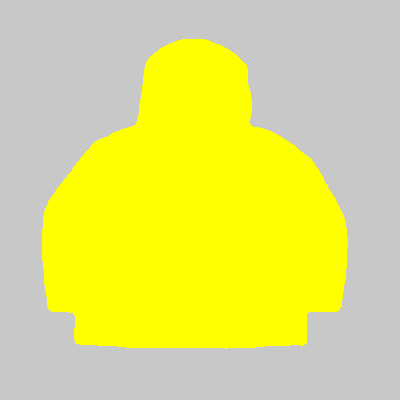

 23%|█████████████▊                                               | 203/900 [00:31<02:16,  5.10it/s]

torch.Size([1, 3, 400, 400])
/mnt/nas4/hm/datasets/shopping_clothes/data/data900_personby100/skirt/image/train_1135.jpg
{'background': 0, 'top': 1, 'skirt': 2, 'outer': 3, 'dress': 4, 'bottom': 5}
Counter({0: 100283, 2: 59717})


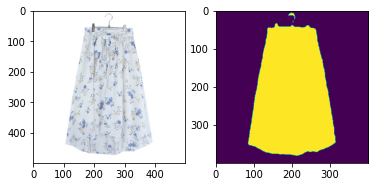

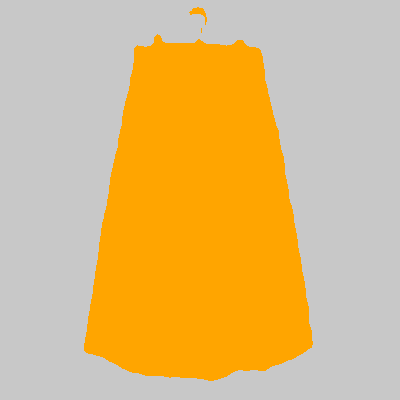

 23%|█████████████▊                                               | 204/900 [00:31<02:06,  5.51it/s]

torch.Size([1, 3, 400, 400])
/mnt/nas4/hm/datasets/shopping_clothes/data/data900_personby100/bottom/image/train_3632.jpg
{'background': 0, 'top': 1, 'skirt': 2, 'outer': 3, 'dress': 4, 'bottom': 5}
Counter({5: 101399, 0: 58601})


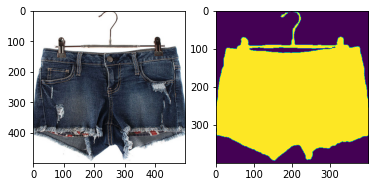

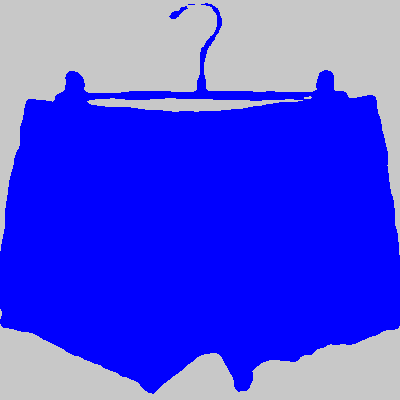

 23%|█████████████▉                                               | 205/900 [00:32<01:58,  5.87it/s]

torch.Size([1, 3, 400, 400])
/mnt/nas4/hm/datasets/shopping_clothes/data/data900_personby100/top/image/train_10147.jpg
{'background': 0, 'top': 1, 'skirt': 2, 'outer': 3, 'dress': 4, 'bottom': 5}
Counter({0: 80742, 1: 79258})


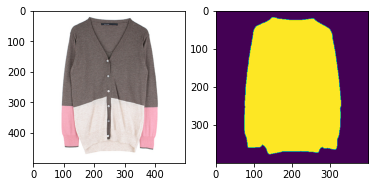

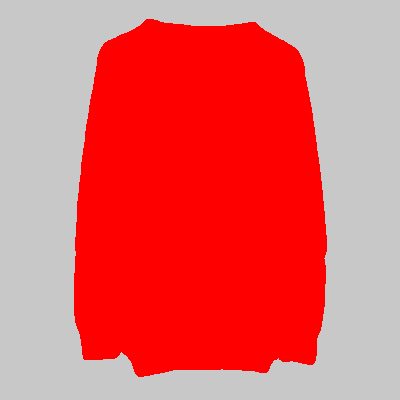

 23%|█████████████▉                                               | 206/900 [00:32<02:05,  5.51it/s]

torch.Size([1, 3, 400, 400])
/mnt/nas4/hm/datasets/shopping_clothes/data/data900_personby100/top/image/train_3807.jpg
{'background': 0, 'top': 1, 'skirt': 2, 'outer': 3, 'dress': 4, 'bottom': 5}
Counter({0: 97693, 1: 62307})


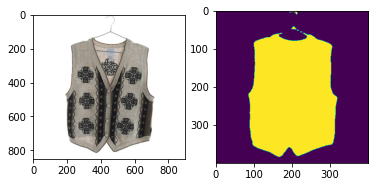

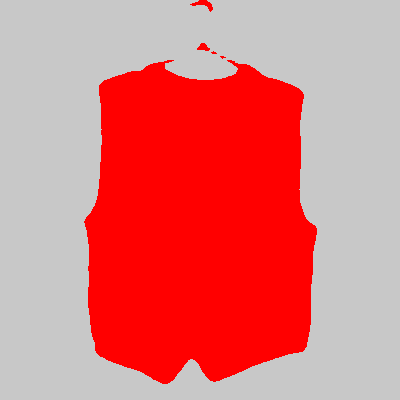

 23%|██████████████                                               | 207/900 [00:32<02:07,  5.44it/s]

torch.Size([1, 3, 400, 400])
/mnt/nas4/hm/datasets/shopping_clothes/data/data900_personby100/bottom/image/train_1831.jpg
{'background': 0, 'top': 1, 'skirt': 2, 'outer': 3, 'dress': 4, 'bottom': 5}
Counter({5: 81230, 0: 78770})


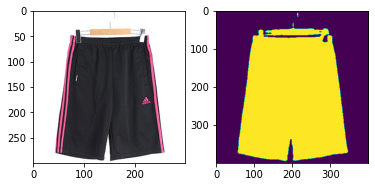

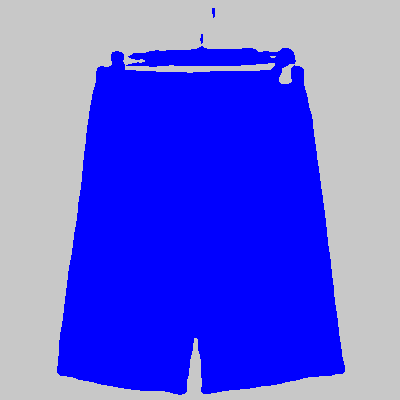

 23%|██████████████                                               | 208/900 [00:32<01:57,  5.91it/s]

torch.Size([1, 3, 400, 400])
/mnt/nas4/hm/datasets/shopping_clothes/data/data900_personby100/dress/image/train_1466.jpg
{'background': 0, 'top': 1, 'skirt': 2, 'outer': 3, 'dress': 4, 'bottom': 5}
Counter({0: 115051, 4: 44949})


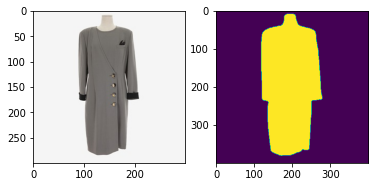

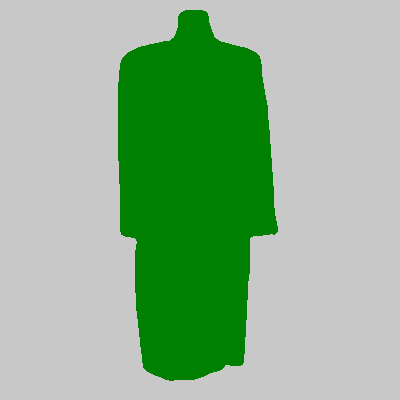

 23%|██████████████▏                                              | 209/900 [00:32<01:49,  6.33it/s]

torch.Size([1, 3, 400, 400])
/mnt/nas4/hm/datasets/shopping_clothes/data/data900_personby100/dress/image/train_1418.jpg
{'background': 0, 'top': 1, 'skirt': 2, 'outer': 3, 'dress': 4, 'bottom': 5}
Counter({0: 107287, 4: 52713})


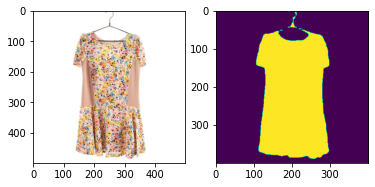

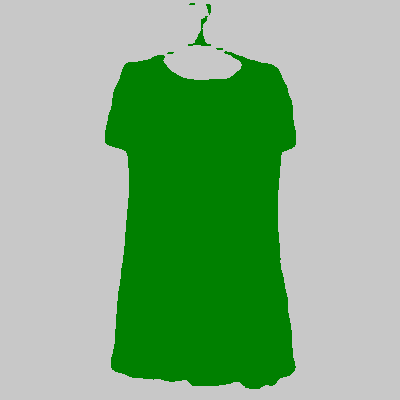

 23%|██████████████▏                                              | 210/900 [00:32<01:45,  6.51it/s]

torch.Size([1, 3, 400, 400])
/mnt/nas4/hm/datasets/shopping_clothes/data/data900_personby100/top/image/train_16668.jpg
{'background': 0, 'top': 1, 'skirt': 2, 'outer': 3, 'dress': 4, 'bottom': 5}
Counter({0: 111326, 1: 48674})


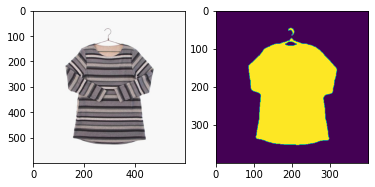

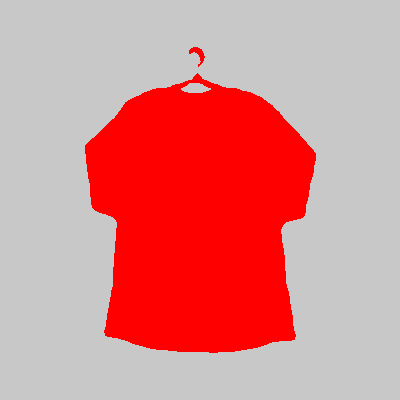

 23%|██████████████▎                                              | 211/900 [00:33<01:45,  6.56it/s]

torch.Size([1, 3, 400, 400])
/mnt/nas4/hm/datasets/shopping_clothes/data/data900_personby100/bottom/image/train_1496.jpg
{'background': 0, 'top': 1, 'skirt': 2, 'outer': 3, 'dress': 4, 'bottom': 5}
Counter({0: 106758, 5: 53242})


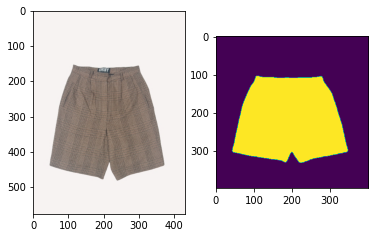

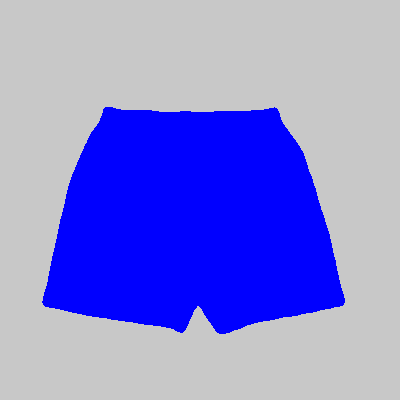

 24%|██████████████▎                                              | 212/900 [00:33<01:43,  6.63it/s]

torch.Size([1, 3, 400, 400])
/mnt/nas4/hm/datasets/shopping_clothes/data/data900_personby100/outer/image/train_7071.jpg
{'background': 0, 'top': 1, 'skirt': 2, 'outer': 3, 'dress': 4, 'bottom': 5}
Counter({0: 99712, 3: 60288})


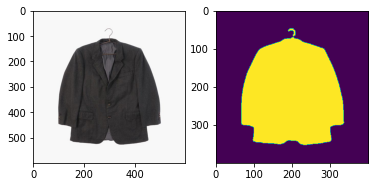

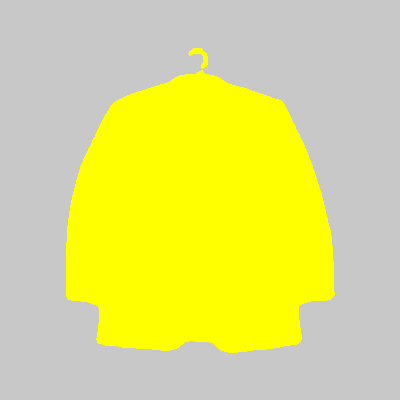

 24%|██████████████▍                                              | 213/900 [00:33<01:43,  6.63it/s]

torch.Size([1, 3, 400, 400])
/mnt/nas4/hm/datasets/shopping_clothes/data/data900_personby100/outer/image/train_5230.jpg
{'background': 0, 'top': 1, 'skirt': 2, 'outer': 3, 'dress': 4, 'bottom': 5}
Counter({0: 91925, 3: 68075})


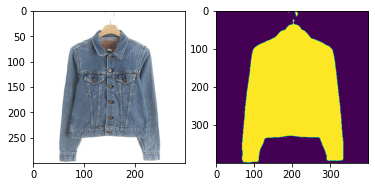

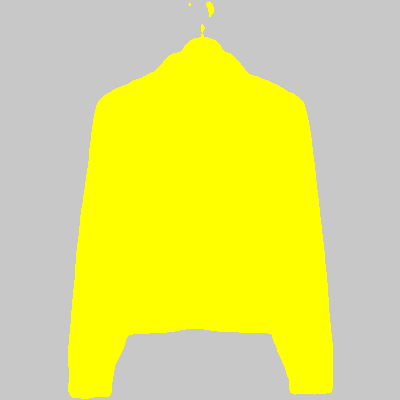

 24%|██████████████▌                                              | 214/900 [00:33<01:40,  6.83it/s]

torch.Size([1, 3, 400, 400])
/mnt/nas4/hm/datasets/shopping_clothes/data/data900_personby100/outer/image/train_6293.jpg
{'background': 0, 'top': 1, 'skirt': 2, 'outer': 3, 'dress': 4, 'bottom': 5}
Counter({3: 111443, 0: 48557})


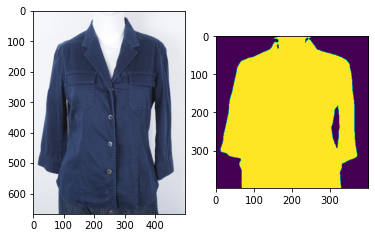

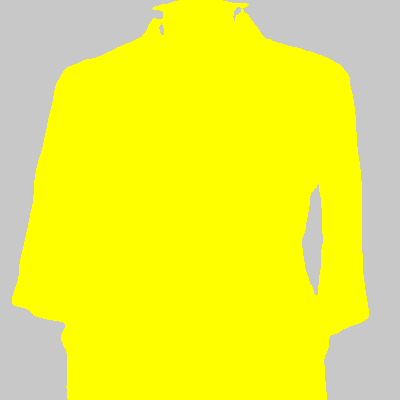

 24%|██████████████▌                                              | 215/900 [00:33<01:44,  6.56it/s]

torch.Size([1, 3, 400, 400])
/mnt/nas4/hm/datasets/shopping_clothes/data/data900_personby100/outer/image/train_7690.jpg
{'background': 0, 'top': 1, 'skirt': 2, 'outer': 3, 'dress': 4, 'bottom': 5}
Counter({3: 107471, 0: 52529})


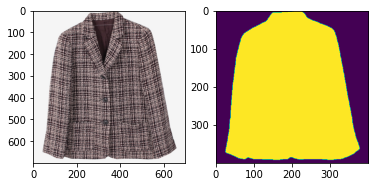

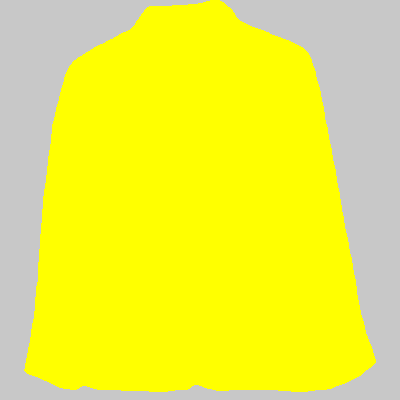

 24%|██████████████▋                                              | 216/900 [00:33<01:47,  6.35it/s]

torch.Size([1, 3, 400, 400])
/mnt/nas4/hm/datasets/shopping_clothes/data/data900_personby100/bottom/image/train_1243.jpg
{'background': 0, 'top': 1, 'skirt': 2, 'outer': 3, 'dress': 4, 'bottom': 5}
Counter({0: 114105, 5: 45895})


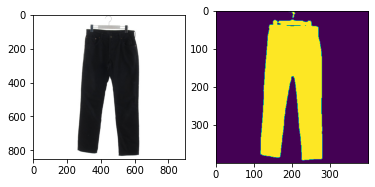

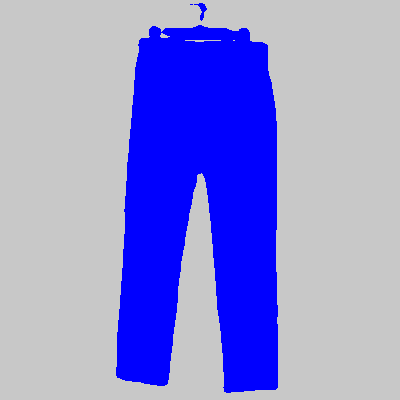

 24%|██████████████▋                                              | 217/900 [00:34<02:04,  5.47it/s]

torch.Size([1, 3, 400, 400])
/mnt/nas4/hm/datasets/shopping_clothes/data/data900_personby100/skirt/image/train_336.jpg
{'background': 0, 'top': 1, 'skirt': 2, 'outer': 3, 'dress': 4, 'bottom': 5}
Counter({2: 96208, 0: 63792})


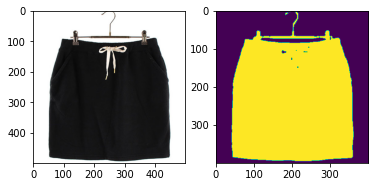

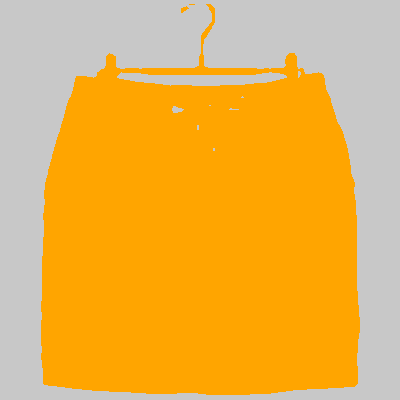

 24%|██████████████▊                                              | 218/900 [00:34<01:57,  5.82it/s]

torch.Size([1, 3, 400, 400])
/mnt/nas4/hm/datasets/shopping_clothes/data/data900_personby100/skirt/image/train_2413.jpg
{'background': 0, 'top': 1, 'skirt': 2, 'outer': 3, 'dress': 4, 'bottom': 5}
Counter({0: 83833, 2: 76167})


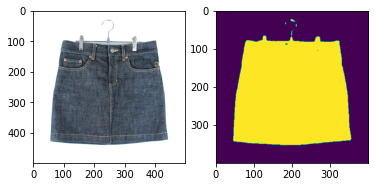

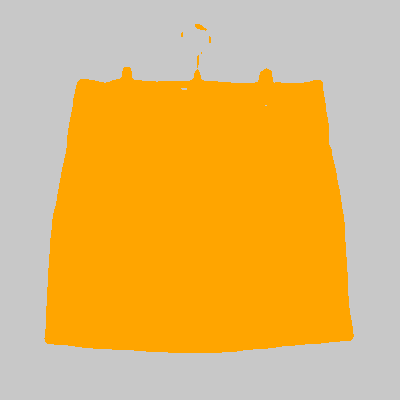

 24%|██████████████▊                                              | 219/900 [00:34<01:52,  6.06it/s]

torch.Size([1, 3, 400, 400])
/mnt/nas4/hm/datasets/shopping_clothes/data/data900_personby100/top/image/train_6581.jpg
{'background': 0, 'top': 1, 'skirt': 2, 'outer': 3, 'dress': 4, 'bottom': 5}
Counter({0: 90856, 1: 69144})


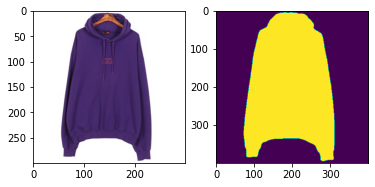

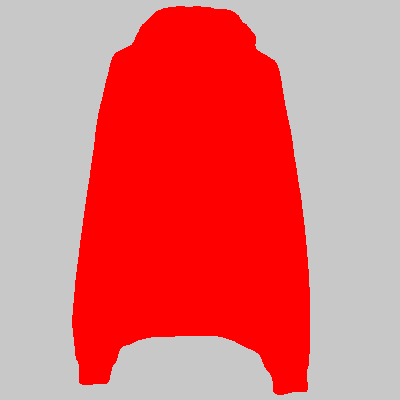

 24%|██████████████▉                                              | 220/900 [00:34<01:45,  6.44it/s]

torch.Size([1, 3, 400, 400])
/mnt/nas4/hm/datasets/shopping_clothes/data/data900_personby100/top/image/train_6761.jpg
{'background': 0, 'top': 1, 'skirt': 2, 'outer': 3, 'dress': 4, 'bottom': 5}
Counter({1: 89692, 0: 70308})


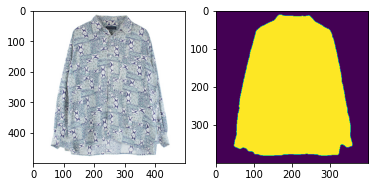

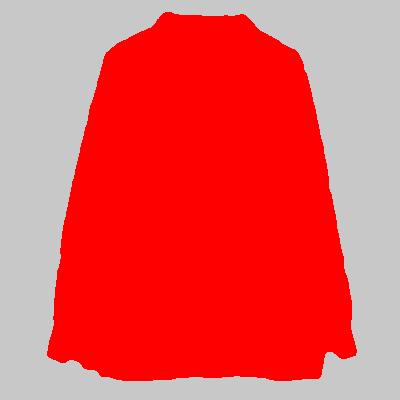

 25%|██████████████▉                                              | 221/900 [00:34<01:44,  6.50it/s]

torch.Size([1, 3, 400, 400])
/mnt/nas4/hm/datasets/shopping_clothes/data/data900_personby100/top/image/train_325.jpg
{'background': 0, 'top': 1, 'skirt': 2, 'outer': 3, 'dress': 4, 'bottom': 5}
Counter({0: 102037, 1: 57963})


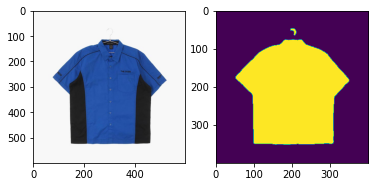

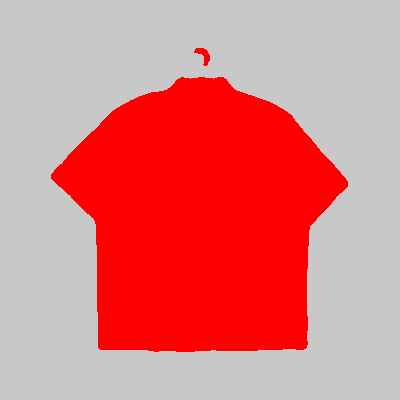

 25%|███████████████                                              | 222/900 [00:34<01:43,  6.56it/s]

torch.Size([1, 3, 400, 400])
/mnt/nas4/hm/datasets/shopping_clothes/data/data900_personby100/outer/image/train_6337.jpg
{'background': 0, 'top': 1, 'skirt': 2, 'outer': 3, 'dress': 4, 'bottom': 5}
Counter({0: 86350, 3: 73650})


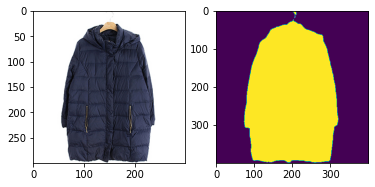

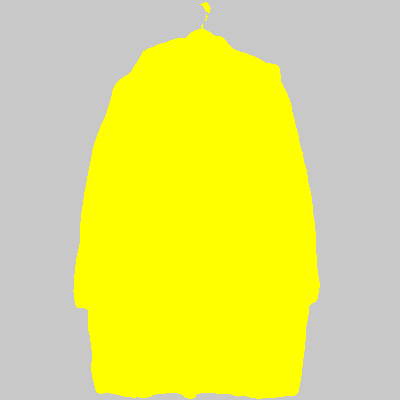

 25%|███████████████                                              | 223/900 [00:34<01:39,  6.81it/s]

torch.Size([1, 3, 400, 400])
/mnt/nas4/hm/datasets/shopping_clothes/data/data900_personby100/dress/image/train_1326.jpg
{'background': 0, 'top': 1, 'skirt': 2, 'outer': 3, 'dress': 4, 'bottom': 5}
Counter({0: 112390, 4: 47610})


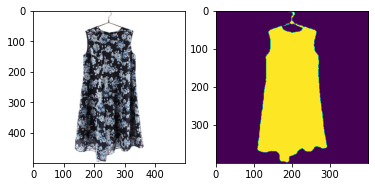

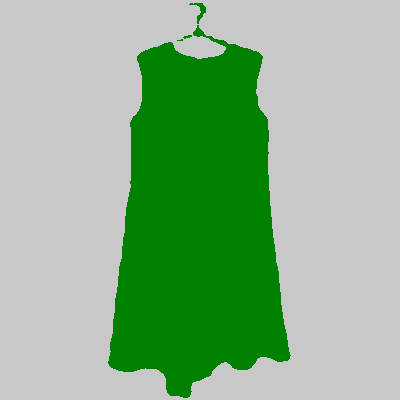

 25%|███████████████▏                                             | 224/900 [00:35<01:38,  6.86it/s]

torch.Size([1, 3, 400, 400])
/mnt/nas4/hm/datasets/shopping_clothes/data/data900_personby100/outer/image/train_3364.jpg
{'background': 0, 'top': 1, 'skirt': 2, 'outer': 3, 'dress': 4, 'bottom': 5}
Counter({3: 94051, 0: 65949})


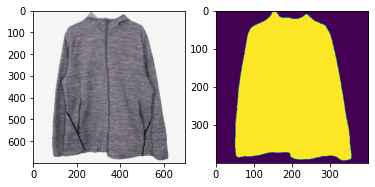

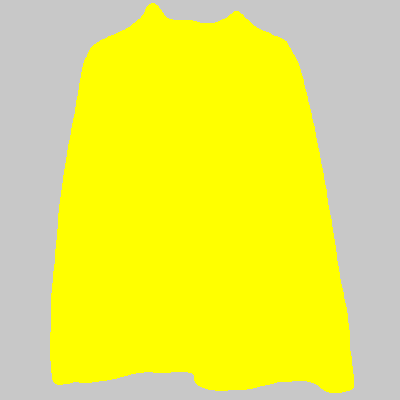

 25%|███████████████▎                                             | 225/900 [00:35<01:41,  6.62it/s]

torch.Size([1, 3, 400, 400])
/mnt/nas4/hm/datasets/shopping_clothes/data/data900_personby100/dress/image/train_3468.jpg
{'background': 0, 'top': 1, 'skirt': 2, 'outer': 3, 'dress': 4, 'bottom': 5}
Counter({0: 110580, 4: 49420})


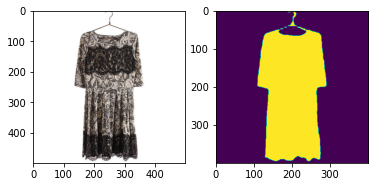

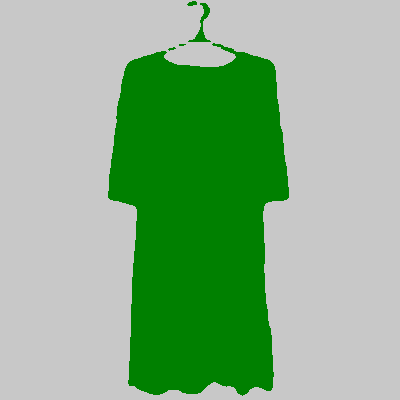

 25%|███████████████▎                                             | 226/900 [00:35<01:40,  6.73it/s]

torch.Size([1, 3, 400, 400])
/mnt/nas4/hm/datasets/shopping_clothes/data/data900_personby100/skirt/image/train_405.jpg
{'background': 0, 'top': 1, 'skirt': 2, 'outer': 3, 'dress': 4, 'bottom': 5}
Counter({0: 108502, 2: 51498})


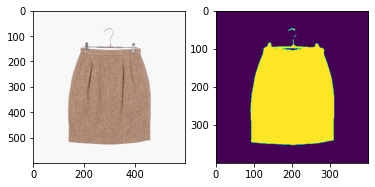

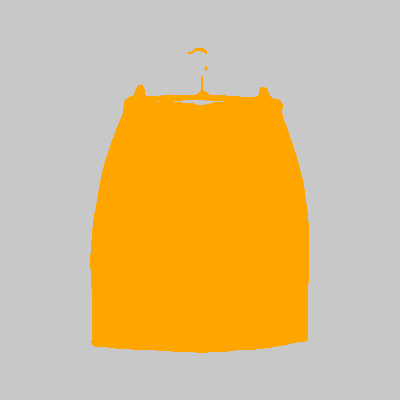

 25%|███████████████▍                                             | 227/900 [00:35<01:40,  6.68it/s]

torch.Size([1, 3, 400, 400])
/mnt/nas4/hm/datasets/shopping_clothes/data/data900_personby100/bottom/image/train_1534.jpg
{'background': 0, 'top': 1, 'skirt': 2, 'outer': 3, 'dress': 4, 'bottom': 5}
Counter({0: 100741, 5: 59259})


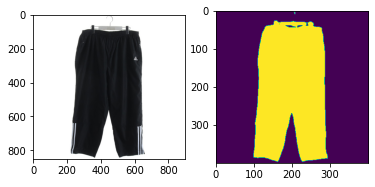

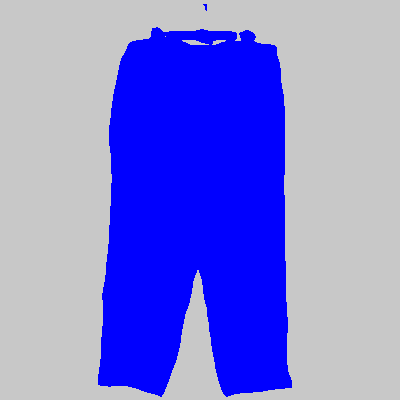

 25%|███████████████▍                                             | 228/900 [00:35<01:59,  5.62it/s]

torch.Size([1, 3, 400, 400])
/mnt/nas4/hm/datasets/shopping_clothes/data/data900_personby100/bottom/image/train_1490.jpg
{'background': 0, 'top': 1, 'skirt': 2, 'outer': 3, 'dress': 4, 'bottom': 5}
Counter({0: 120110, 5: 39890})


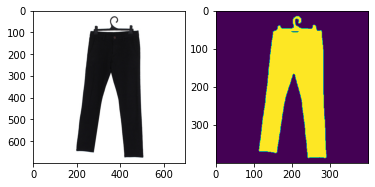

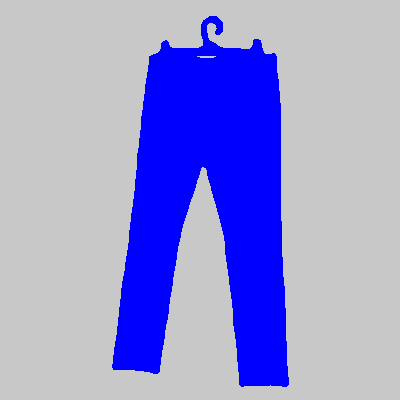

 25%|███████████████▌                                             | 229/900 [00:35<01:56,  5.75it/s]

torch.Size([1, 3, 400, 400])
/mnt/nas4/hm/datasets/shopping_clothes/data/data900_personby100/outer/image/train_6266.jpg
{'background': 0, 'top': 1, 'skirt': 2, 'outer': 3, 'dress': 4, 'bottom': 5}
Counter({0: 120424, 3: 39576})


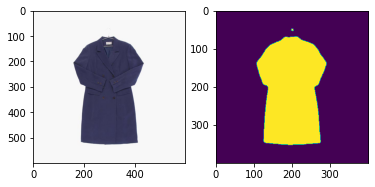

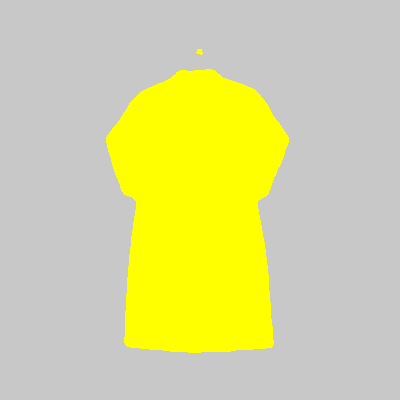

 26%|███████████████▌                                             | 230/900 [00:36<01:51,  5.99it/s]

torch.Size([1, 3, 400, 400])
/mnt/nas4/hm/datasets/shopping_clothes/data/data900_personby100/top/image/train_12545.jpg
{'background': 0, 'top': 1, 'skirt': 2, 'outer': 3, 'dress': 4, 'bottom': 5}
Counter({0: 111476, 1: 48524})


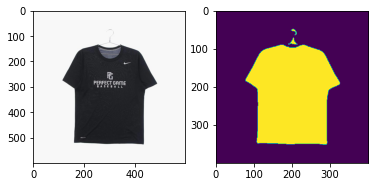

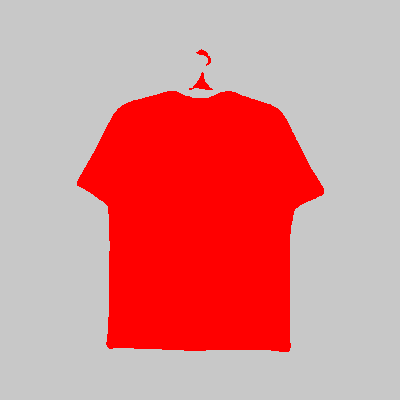

 26%|███████████████▋                                             | 231/900 [00:36<01:48,  6.16it/s]

torch.Size([1, 3, 400, 400])
/mnt/nas4/hm/datasets/shopping_clothes/data/data900_personby100/skirt/image/train_1199.jpg
{'background': 0, 'top': 1, 'skirt': 2, 'outer': 3, 'dress': 4, 'bottom': 5}
Counter({0: 94998, 2: 65002})


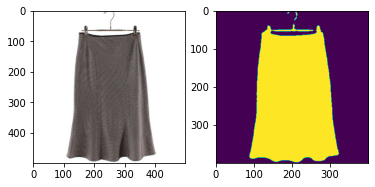

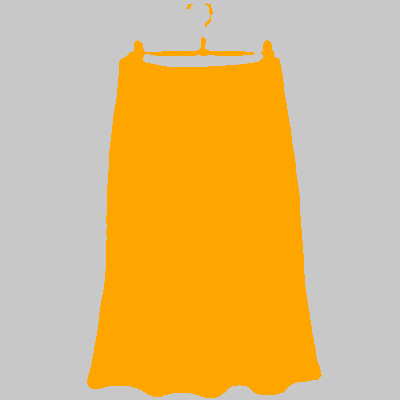

 26%|███████████████▋                                             | 232/900 [00:36<01:44,  6.37it/s]

torch.Size([1, 3, 400, 400])
/mnt/nas4/hm/datasets/shopping_clothes/data/data900_personby100/outer/image/train_5862.jpg
{'background': 0, 'top': 1, 'skirt': 2, 'outer': 3, 'dress': 4, 'bottom': 5}
Counter({3: 83384, 0: 76616})


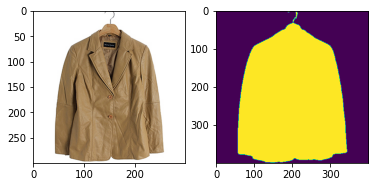

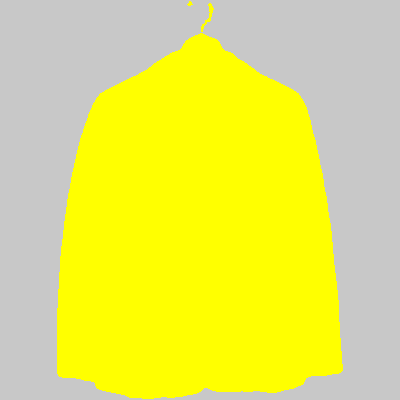

 26%|███████████████▊                                             | 233/900 [00:36<01:40,  6.65it/s]

torch.Size([1, 3, 400, 400])
/mnt/nas4/hm/datasets/shopping_clothes/data/data900_personby100/top/image/train_4458.jpg
{'background': 0, 'top': 1, 'skirt': 2, 'outer': 3, 'dress': 4, 'bottom': 5}
Counter({0: 110402, 1: 49598})


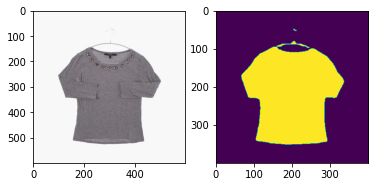

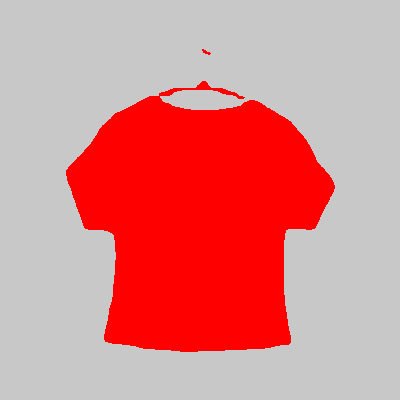

 26%|███████████████▊                                             | 234/900 [00:36<01:40,  6.63it/s]

torch.Size([1, 3, 400, 400])
/mnt/nas4/hm/datasets/shopping_clothes/data/data900_personby100/top/image/train_9623.jpg
{'background': 0, 'top': 1, 'skirt': 2, 'outer': 3, 'dress': 4, 'bottom': 5}
Counter({0: 92192, 1: 67808})


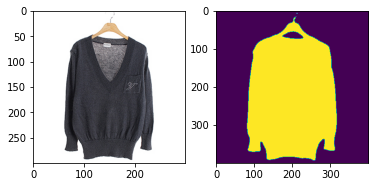

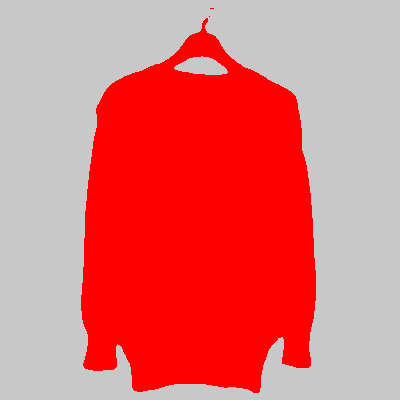

 26%|███████████████▉                                             | 235/900 [00:36<01:37,  6.85it/s]

torch.Size([1, 3, 400, 400])
/mnt/nas4/hm/datasets/shopping_clothes/data/data900_personby100/outer/image/train_8111.jpg
{'background': 0, 'top': 1, 'skirt': 2, 'outer': 3, 'dress': 4, 'bottom': 5}
Counter({0: 87227, 3: 72773})


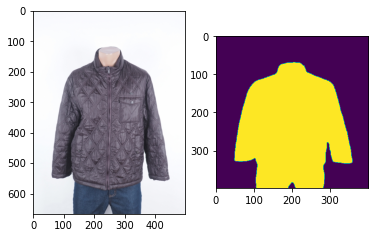

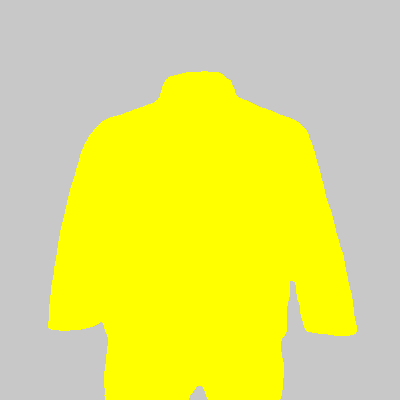

 26%|███████████████▉                                             | 236/900 [00:37<01:40,  6.58it/s]

torch.Size([1, 3, 400, 400])
/mnt/nas4/hm/datasets/shopping_clothes/data/data900_personby100/outer/image/train_4490.jpg
{'background': 0, 'top': 1, 'skirt': 2, 'outer': 3, 'dress': 4, 'bottom': 5}
Counter({0: 88808, 3: 71192})


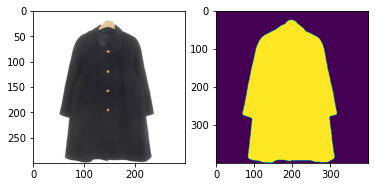

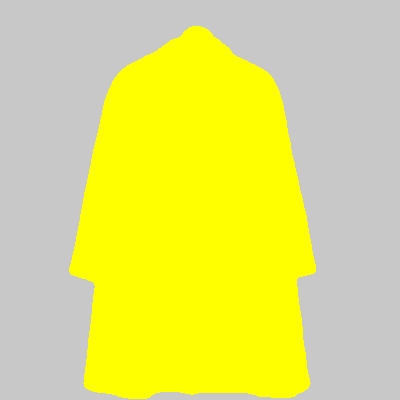

 26%|████████████████                                             | 237/900 [00:37<01:37,  6.82it/s]

torch.Size([1, 3, 400, 400])
/mnt/nas4/hm/datasets/shopping_clothes/data/data900_personby100/bottom/image/train_635.jpg
{'background': 0, 'top': 1, 'skirt': 2, 'outer': 3, 'dress': 4, 'bottom': 5}
Counter({0: 117894, 5: 42106})


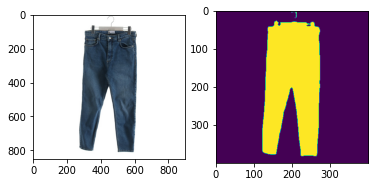

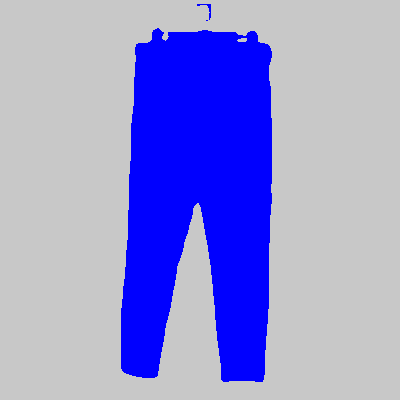

 26%|████████████████▏                                            | 238/900 [00:37<01:44,  6.31it/s]

torch.Size([1, 3, 400, 400])
/mnt/nas4/hm/datasets/shopping_clothes/data/data900_personby100/top/image/train_9070.jpg
{'background': 0, 'top': 1, 'skirt': 2, 'outer': 3, 'dress': 4, 'bottom': 5}
Counter({0: 85463, 1: 57572, 4: 16965})


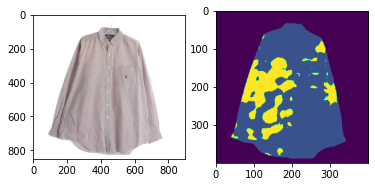

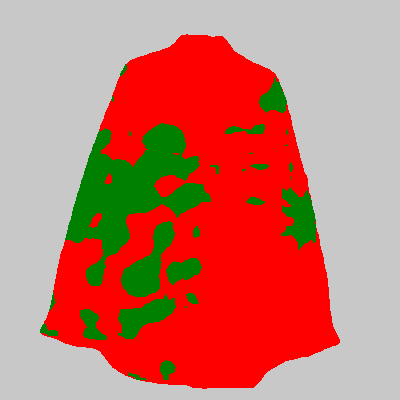

 27%|████████████████▏                                            | 239/900 [00:37<02:02,  5.41it/s]

torch.Size([1, 3, 400, 400])
/mnt/nas4/hm/datasets/shopping_clothes/data/data900_personby100/top/image/train_5482.jpg
{'background': 0, 'top': 1, 'skirt': 2, 'outer': 3, 'dress': 4, 'bottom': 5}
Counter({0: 108371, 1: 51629})


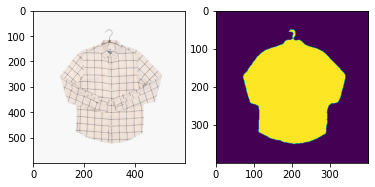

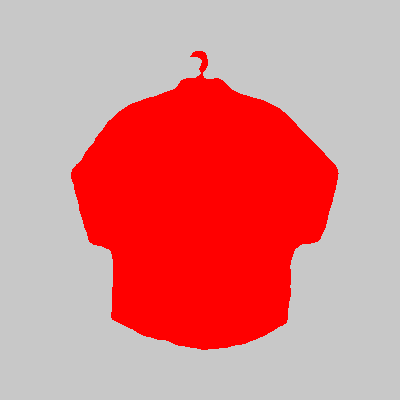

 27%|████████████████▎                                            | 240/900 [00:37<01:55,  5.72it/s]

torch.Size([1, 3, 400, 400])
/mnt/nas4/hm/datasets/shopping_clothes/data/data900_personby100/skirt/image/train_150.jpg
{'background': 0, 'top': 1, 'skirt': 2, 'outer': 3, 'dress': 4, 'bottom': 5}
Counter({0: 110513, 2: 49487})


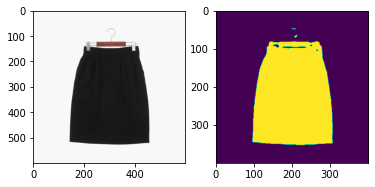

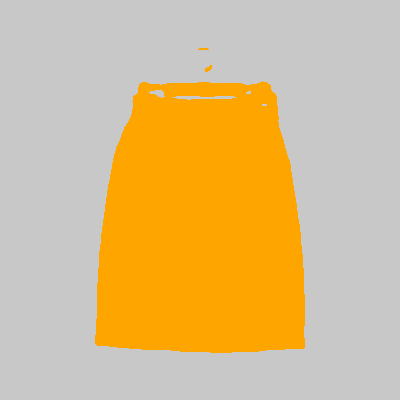

 27%|████████████████▎                                            | 241/900 [00:37<01:50,  5.98it/s]

torch.Size([1, 3, 400, 400])
/mnt/nas4/hm/datasets/shopping_clothes/data/data900_personby100/bottom/image/train_67.jpg
{'background': 0, 'top': 1, 'skirt': 2, 'outer': 3, 'dress': 4, 'bottom': 5}
Counter({0: 109288, 5: 50712})


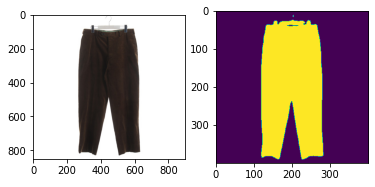

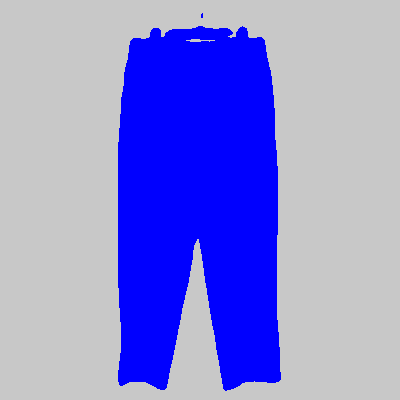

 27%|████████████████▍                                            | 242/900 [00:38<01:53,  5.78it/s]

torch.Size([1, 3, 400, 400])
/mnt/nas4/hm/datasets/shopping_clothes/data/data900_personby100/bottom/image/train_1580.jpg
{'background': 0, 'top': 1, 'skirt': 2, 'outer': 3, 'dress': 4, 'bottom': 5}
Counter({0: 94703, 5: 65297})


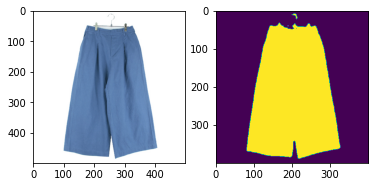

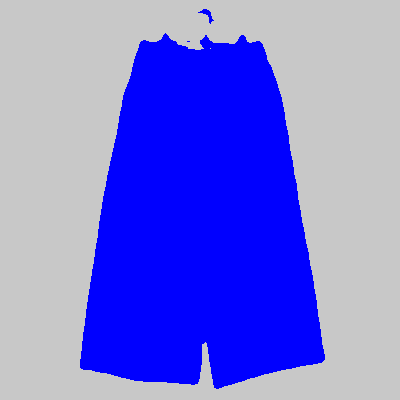

 27%|████████████████▍                                            | 243/900 [00:38<01:48,  6.06it/s]

torch.Size([1, 3, 400, 400])
/mnt/nas4/hm/datasets/shopping_clothes/data/data900_personby100/outer/image/train_7457.jpg
{'background': 0, 'top': 1, 'skirt': 2, 'outer': 3, 'dress': 4, 'bottom': 5}
Counter({3: 85524, 0: 74476})


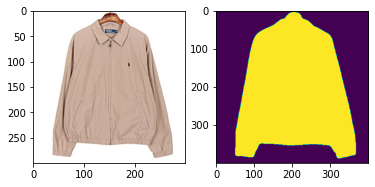

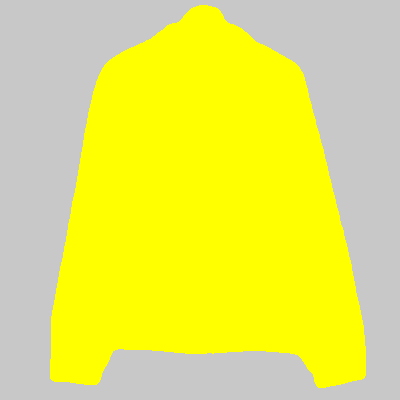

 27%|████████████████▌                                            | 244/900 [00:38<01:42,  6.41it/s]

torch.Size([1, 3, 400, 400])
/mnt/nas4/hm/datasets/shopping_clothes/data/data900_personby100/dress/image/train_2052.jpg
{'background': 0, 'top': 1, 'skirt': 2, 'outer': 3, 'dress': 4, 'bottom': 5}
Counter({0: 93355, 4: 66645})


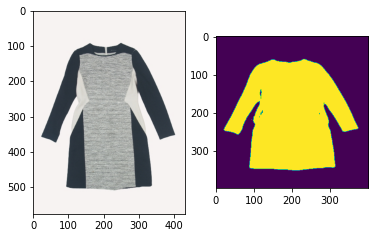

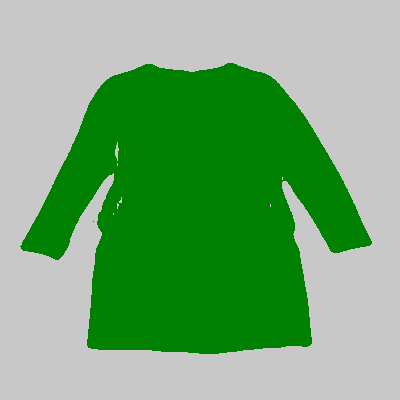

 27%|████████████████▌                                            | 245/900 [00:38<01:41,  6.48it/s]

torch.Size([1, 3, 400, 400])
/mnt/nas4/hm/datasets/shopping_clothes/data/data900_personby100/bottom/image/train_2033.jpg
{'background': 0, 'top': 1, 'skirt': 2, 'outer': 3, 'dress': 4, 'bottom': 5}
Counter({0: 113588, 5: 46412})


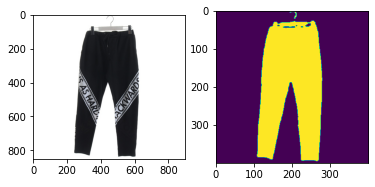

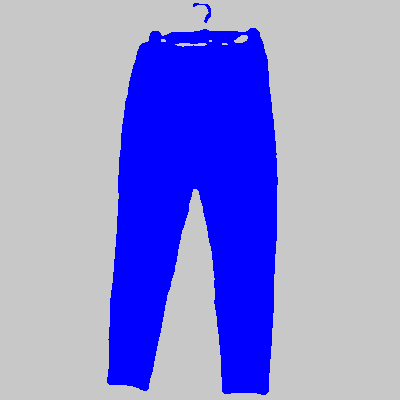

 27%|████████████████▋                                            | 246/900 [00:38<01:46,  6.13it/s]

torch.Size([1, 3, 400, 400])
/mnt/nas4/hm/datasets/shopping_clothes/data/data900_personby100/top/image/train_4711.jpg
{'background': 0, 'top': 1, 'skirt': 2, 'outer': 3, 'dress': 4, 'bottom': 5}
Counter({0: 83667, 1: 76333})


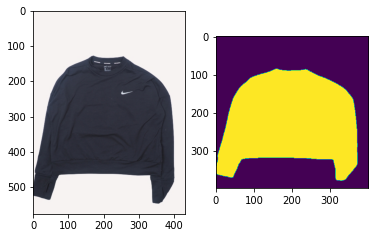

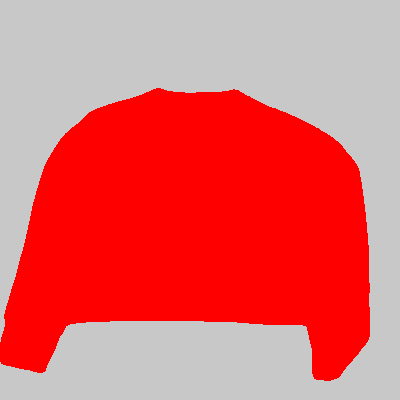

 27%|████████████████▋                                            | 247/900 [00:38<01:44,  6.25it/s]

torch.Size([1, 3, 400, 400])
/mnt/nas4/hm/datasets/shopping_clothes/data/data900_personby100/dress/image/train_3748.jpg
{'background': 0, 'top': 1, 'skirt': 2, 'outer': 3, 'dress': 4, 'bottom': 5}
Counter({0: 124608, 4: 35392})


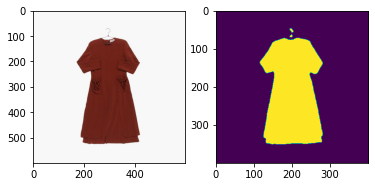

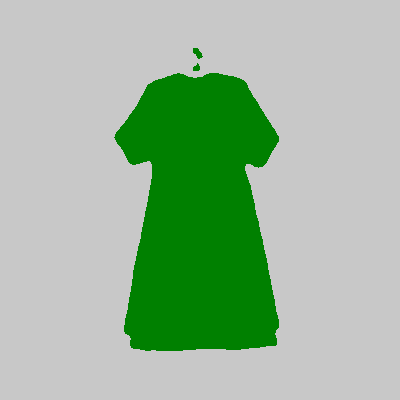

 28%|████████████████▊                                            | 248/900 [00:38<01:42,  6.38it/s]

torch.Size([1, 3, 400, 400])
/mnt/nas4/hm/datasets/shopping_clothes/data/data900_personby100/skirt/image/train_606.jpg
{'background': 0, 'top': 1, 'skirt': 2, 'outer': 3, 'dress': 4, 'bottom': 5}
Counter({0: 111898, 2: 48102})


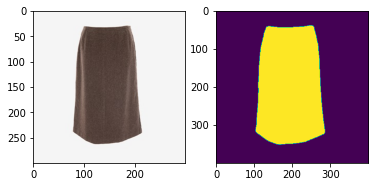

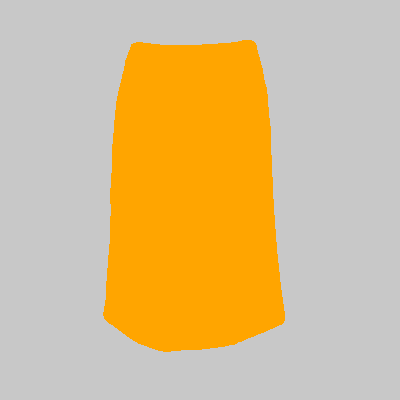

 28%|████████████████▉                                            | 249/900 [00:39<01:37,  6.67it/s]

torch.Size([1, 3, 400, 400])
/mnt/nas4/hm/datasets/shopping_clothes/data/data900_personby100/dress/image/train_729.jpg
{'background': 0, 'top': 1, 'skirt': 2, 'outer': 3, 'dress': 4, 'bottom': 5}
Counter({0: 104824, 4: 55176})


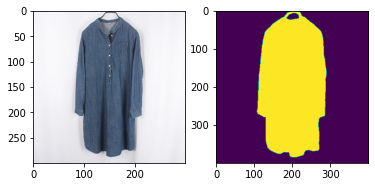

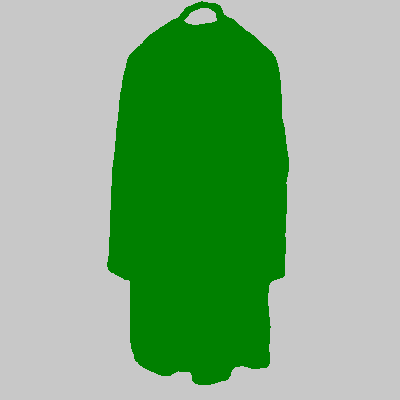

 28%|████████████████▉                                            | 250/900 [00:39<01:46,  6.12it/s]

torch.Size([1, 3, 400, 400])
/mnt/nas4/hm/datasets/shopping_clothes/data/data900_personby100/dress/image/train_2655.jpg
{'background': 0, 'top': 1, 'skirt': 2, 'outer': 3, 'dress': 4, 'bottom': 5}
Counter({0: 112663, 4: 47337})


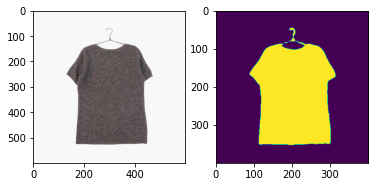

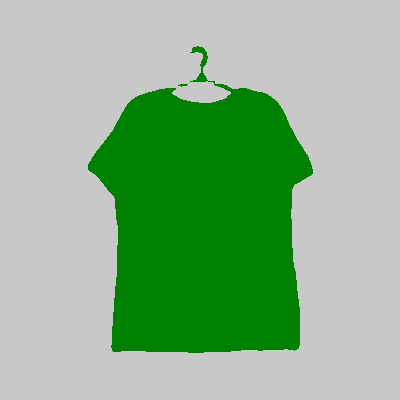

 28%|█████████████████                                            | 251/900 [00:39<01:43,  6.25it/s]

torch.Size([1, 3, 400, 400])
/mnt/nas4/hm/datasets/shopping_clothes/data/data900_personby100/top/image/train_2878.jpg
{'background': 0, 'top': 1, 'skirt': 2, 'outer': 3, 'dress': 4, 'bottom': 5}
Counter({0: 114685, 1: 45315})


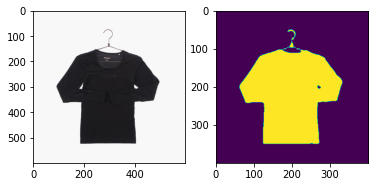

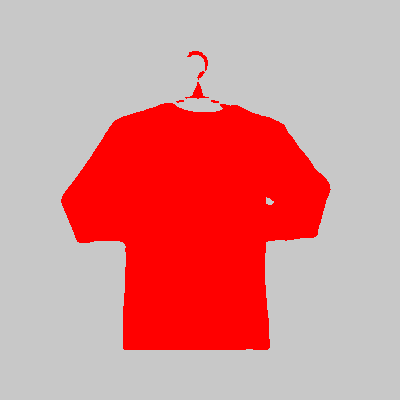

 28%|█████████████████                                            | 252/900 [00:39<01:41,  6.36it/s]

torch.Size([1, 3, 400, 400])
/mnt/nas4/hm/datasets/shopping_clothes/data/data900_personby100/skirt/image/train_47.jpg
{'background': 0, 'top': 1, 'skirt': 2, 'outer': 3, 'dress': 4, 'bottom': 5}
Counter({0: 98319, 2: 61681})


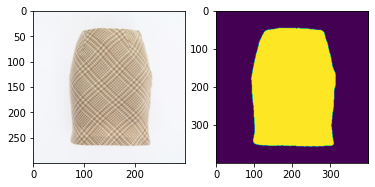

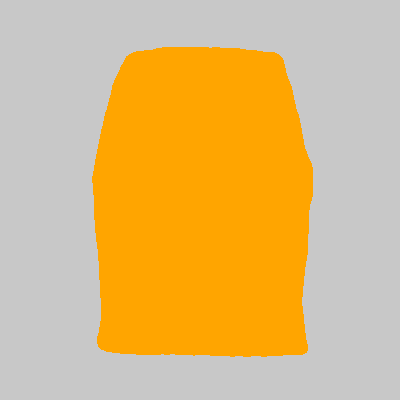

 28%|█████████████████▏                                           | 253/900 [00:39<01:37,  6.65it/s]

torch.Size([1, 3, 400, 400])
/mnt/nas4/hm/datasets/shopping_clothes/data/data900_personby100/outer/image/train_1676.jpg
{'background': 0, 'top': 1, 'skirt': 2, 'outer': 3, 'dress': 4, 'bottom': 5}
Counter({0: 84505, 3: 75495})


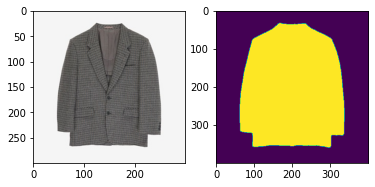

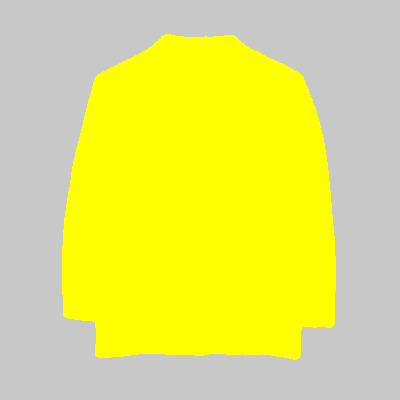

 28%|█████████████████▏                                           | 254/900 [00:39<01:33,  6.89it/s]

torch.Size([1, 3, 400, 400])
/mnt/nas4/hm/datasets/shopping_clothes/data/data900_personby100/bottom/image/train_2999.jpg
{'background': 0, 'top': 1, 'skirt': 2, 'outer': 3, 'dress': 4, 'bottom': 5}
Counter({0: 119624, 5: 40376})


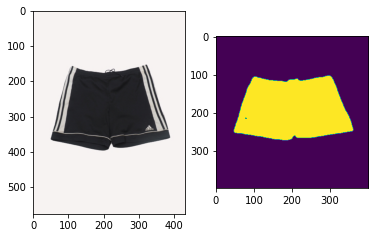

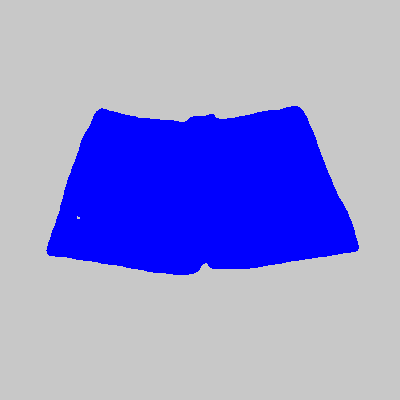

 28%|█████████████████▎                                           | 255/900 [00:40<01:33,  6.87it/s]

torch.Size([1, 3, 400, 400])
/mnt/nas4/hm/datasets/shopping_clothes/data/data900_personby100/dress/image/train_289.jpg
{'background': 0, 'top': 1, 'skirt': 2, 'outer': 3, 'dress': 4, 'bottom': 5}
Counter({0: 117873, 4: 42127})


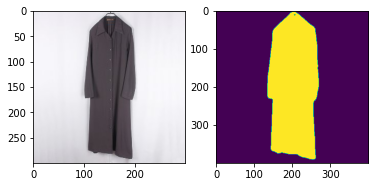

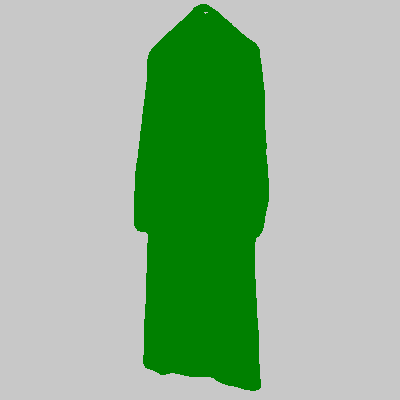

 28%|█████████████████▎                                           | 256/900 [00:40<01:31,  7.04it/s]

torch.Size([1, 3, 400, 400])
/mnt/nas4/hm/datasets/shopping_clothes/data/data900_personby100/top/image/train_13581.jpg
{'background': 0, 'top': 1, 'skirt': 2, 'outer': 3, 'dress': 4, 'bottom': 5}
Counter({0: 92665, 1: 67335})


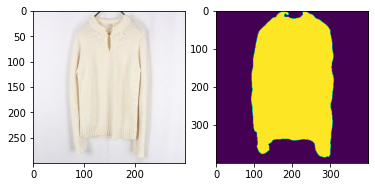

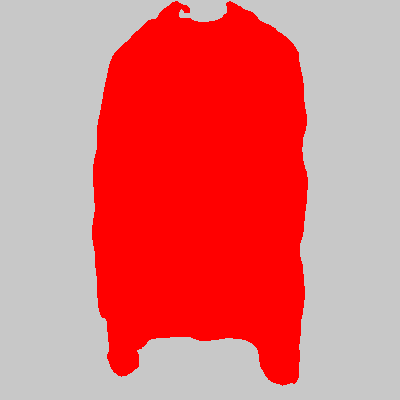

 29%|█████████████████▍                                           | 257/900 [00:40<01:29,  7.15it/s]

torch.Size([1, 3, 400, 400])
/mnt/nas4/hm/datasets/shopping_clothes/data/data900_personby100/outer/image/train_9979.jpg
{'background': 0, 'top': 1, 'skirt': 2, 'outer': 3, 'dress': 4, 'bottom': 5}
Counter({0: 105335, 3: 54665})


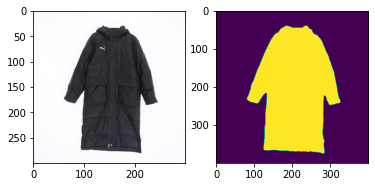

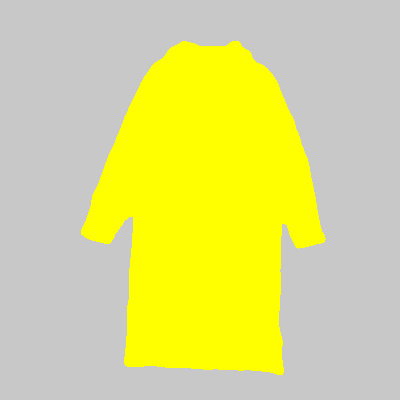

 29%|█████████████████▍                                           | 258/900 [00:40<01:28,  7.26it/s]

torch.Size([1, 3, 400, 400])
/mnt/nas4/hm/datasets/shopping_clothes/data/data900_personby100/outer/image/train_10395.jpg
{'background': 0, 'top': 1, 'skirt': 2, 'outer': 3, 'dress': 4, 'bottom': 5}
Counter({0: 103729, 3: 56271})


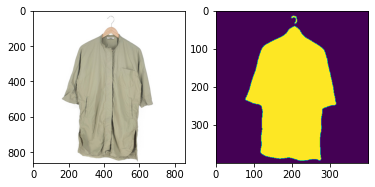

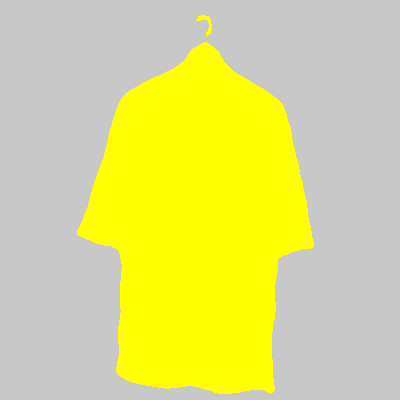

 29%|█████████████████▌                                           | 259/900 [00:40<01:36,  6.63it/s]

torch.Size([1, 3, 400, 400])
/mnt/nas4/hm/datasets/shopping_clothes/data/data900_personby100/outer/image/train_3717.jpg
{'background': 0, 'top': 1, 'skirt': 2, 'outer': 3, 'dress': 4, 'bottom': 5}
Counter({0: 105786, 3: 54214})


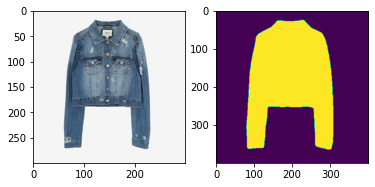

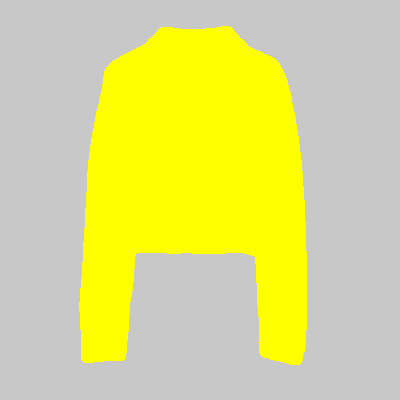

 29%|█████████████████▌                                           | 260/900 [00:40<01:33,  6.88it/s]

torch.Size([1, 3, 400, 400])
/mnt/nas4/hm/datasets/shopping_clothes/data/data900_personby100/bottom/image/train_1111.jpg
{'background': 0, 'top': 1, 'skirt': 2, 'outer': 3, 'dress': 4, 'bottom': 5}
Counter({5: 84049, 0: 75951})


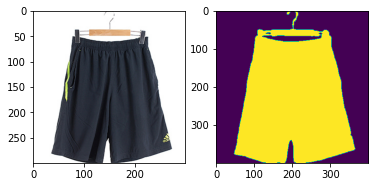

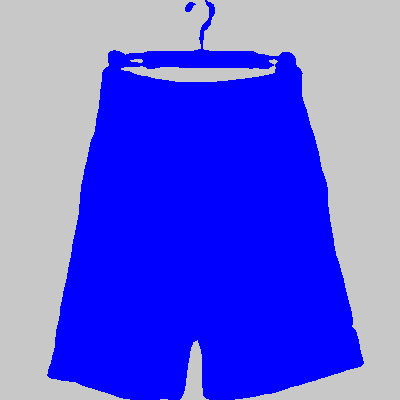

 29%|█████████████████▋                                           | 261/900 [00:40<01:42,  6.21it/s]

torch.Size([1, 3, 400, 400])
/mnt/nas4/hm/datasets/shopping_clothes/data/data900_personby100/top/image/train_2620.jpg
{'background': 0, 'top': 1, 'skirt': 2, 'outer': 3, 'dress': 4, 'bottom': 5}
Counter({0: 107864, 1: 52136})


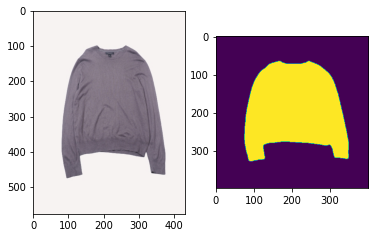

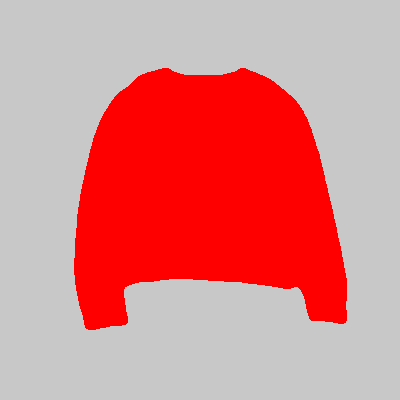

 29%|█████████████████▊                                           | 262/900 [00:41<01:40,  6.36it/s]

torch.Size([1, 3, 400, 400])
/mnt/nas4/hm/datasets/shopping_clothes/data/data900_personby100/dress/image/train_1458.jpg
{'background': 0, 'top': 1, 'skirt': 2, 'outer': 3, 'dress': 4, 'bottom': 5}
Counter({0: 111754, 4: 48246})


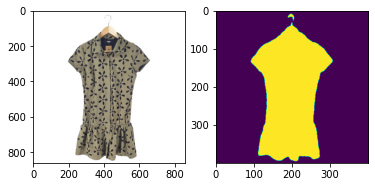

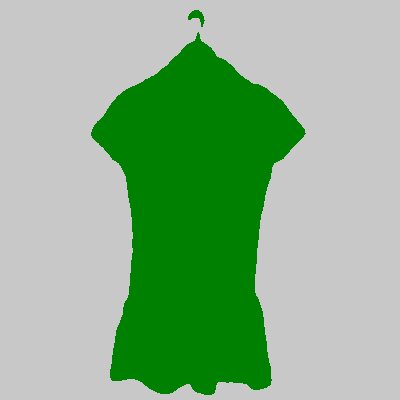

 29%|█████████████████▊                                           | 263/900 [00:41<01:44,  6.09it/s]

torch.Size([1, 3, 400, 400])
/mnt/nas4/hm/datasets/shopping_clothes/data/data900_personby100/skirt/image/train_973.jpg
{'background': 0, 'top': 1, 'skirt': 2, 'outer': 3, 'dress': 4, 'bottom': 5}
Counter({0: 110744, 2: 49256})


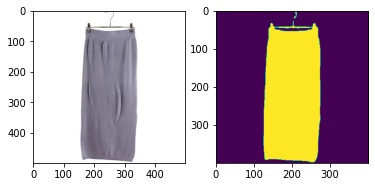

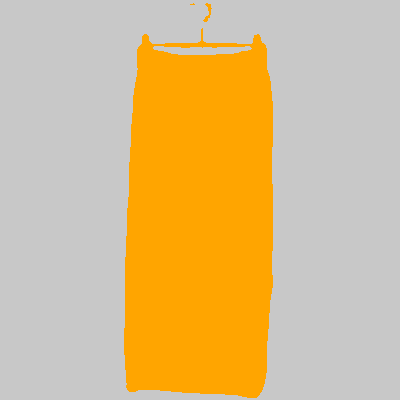

 29%|█████████████████▉                                           | 264/900 [00:41<01:40,  6.32it/s]

torch.Size([1, 3, 400, 400])
/mnt/nas4/hm/datasets/shopping_clothes/data/data900_personby100/skirt/image/train_2411.jpg
{'background': 0, 'top': 1, 'skirt': 2, 'outer': 3, 'dress': 4, 'bottom': 5}
Counter({0: 81419, 2: 78581})


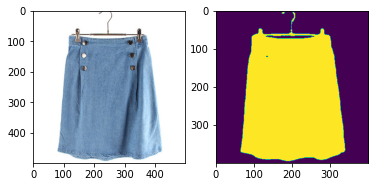

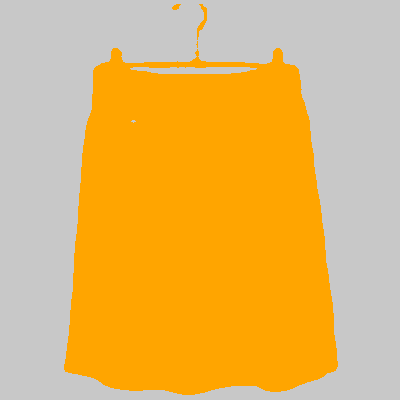

 29%|█████████████████▉                                           | 265/900 [00:41<01:38,  6.46it/s]

torch.Size([1, 3, 400, 400])
/mnt/nas4/hm/datasets/shopping_clothes/data/data900_personby100/dress/image/train_2169.jpg
{'background': 0, 'top': 1, 'skirt': 2, 'outer': 3, 'dress': 4, 'bottom': 5}
Counter({0: 109672, 4: 50328})


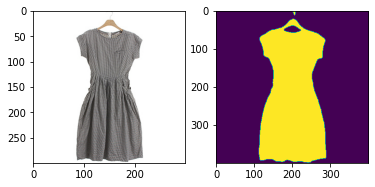

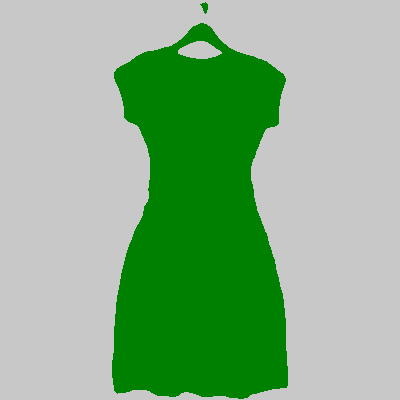

 30%|██████████████████                                           | 266/900 [00:41<01:34,  6.73it/s]

torch.Size([1, 3, 400, 400])
/mnt/nas4/hm/datasets/shopping_clothes/data/data900_personby100/skirt/image/train_46.jpg
{'background': 0, 'top': 1, 'skirt': 2, 'outer': 3, 'dress': 4, 'bottom': 5}
Counter({2: 96832, 0: 63168})


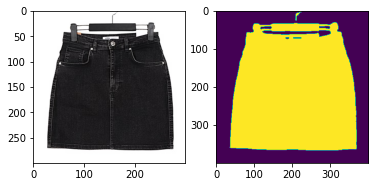

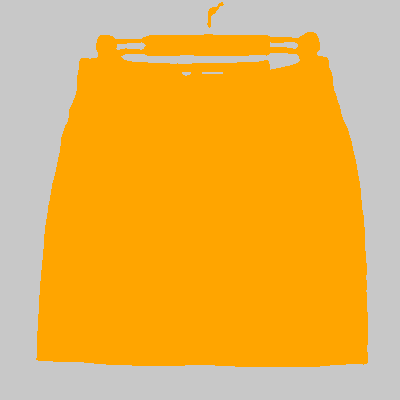

 30%|██████████████████                                           | 267/900 [00:41<01:31,  6.95it/s]

torch.Size([1, 3, 400, 400])
/mnt/nas4/hm/datasets/shopping_clothes/data/data900_personby100/bottom/image/train_1451.jpg
{'background': 0, 'top': 1, 'skirt': 2, 'outer': 3, 'dress': 4, 'bottom': 5}
Counter({0: 102374, 5: 57626})


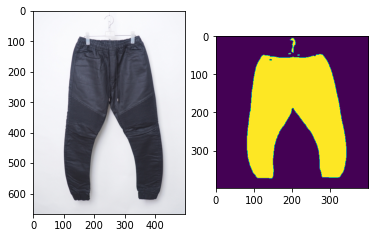

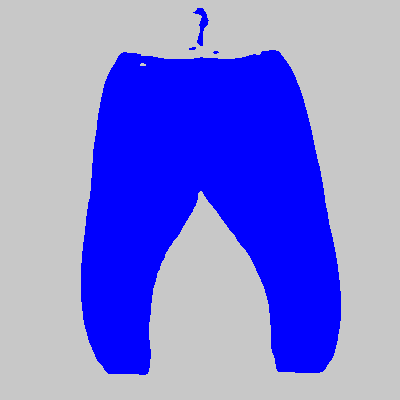

 30%|██████████████████▏                                          | 268/900 [00:42<01:35,  6.63it/s]

torch.Size([1, 3, 400, 400])
/mnt/nas4/hm/datasets/shopping_clothes/data/data900_personby100/top/image/train_18647.jpg
{'background': 0, 'top': 1, 'skirt': 2, 'outer': 3, 'dress': 4, 'bottom': 5}
Counter({0: 113386, 1: 46614})


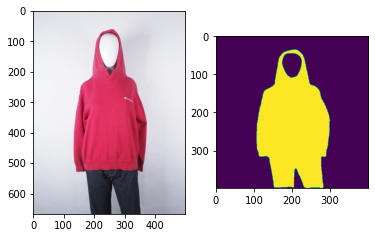

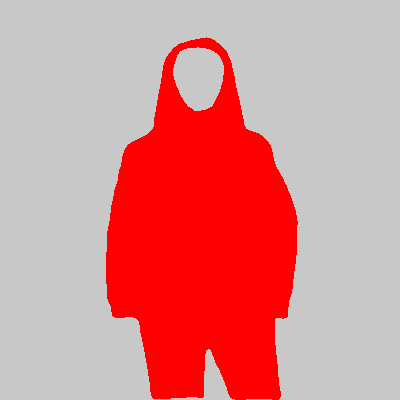

 30%|██████████████████▏                                          | 269/900 [00:42<01:38,  6.43it/s]

torch.Size([1, 3, 400, 400])
/mnt/nas4/hm/datasets/shopping_clothes/data/data900_personby100/dress/image/train_1255.jpg
{'background': 0, 'top': 1, 'skirt': 2, 'outer': 3, 'dress': 4, 'bottom': 5}
Counter({0: 88441, 4: 71559})


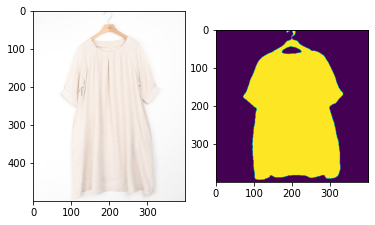

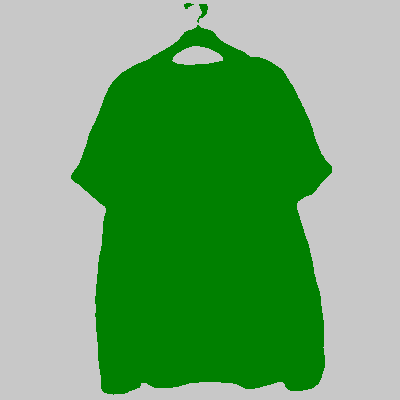

 30%|██████████████████▎                                          | 270/900 [00:42<01:35,  6.60it/s]

torch.Size([1, 3, 400, 400])
/mnt/nas4/hm/datasets/shopping_clothes/data/data900_personby100/top/image/train_5971.jpg
{'background': 0, 'top': 1, 'skirt': 2, 'outer': 3, 'dress': 4, 'bottom': 5}
Counter({0: 100071, 1: 59929})


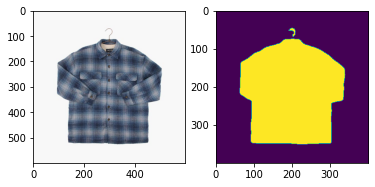

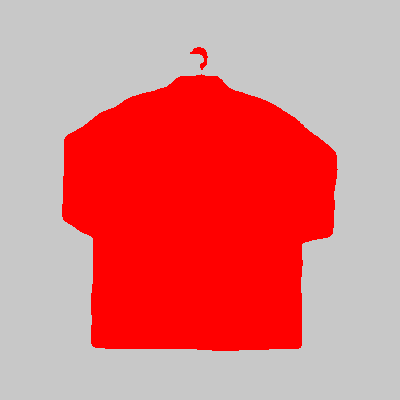

 30%|██████████████████▎                                          | 271/900 [00:42<01:35,  6.62it/s]

torch.Size([1, 3, 400, 400])
/mnt/nas4/hm/datasets/shopping_clothes/data/data900_personby100/dress/image/train_3776.jpg
{'background': 0, 'top': 1, 'skirt': 2, 'outer': 3, 'dress': 4, 'bottom': 5}
Counter({0: 120692, 4: 39308})


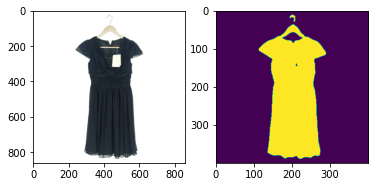

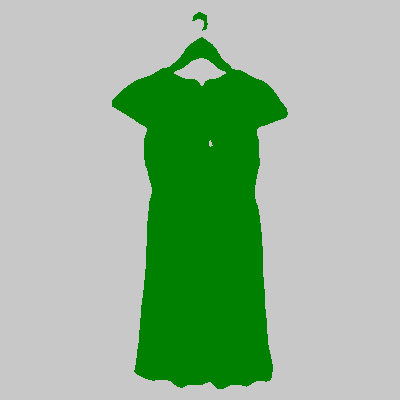

 30%|██████████████████▍                                          | 272/900 [00:42<01:51,  5.63it/s]

torch.Size([1, 3, 400, 400])
/mnt/nas4/hm/datasets/shopping_clothes/data/data900_personby100/bottom/image/train_393.jpg
{'background': 0, 'top': 1, 'skirt': 2, 'outer': 3, 'dress': 4, 'bottom': 5}
Counter({0: 132779, 5: 27221})


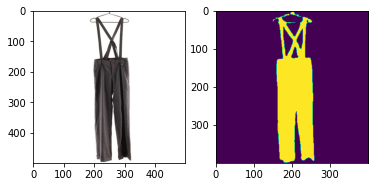

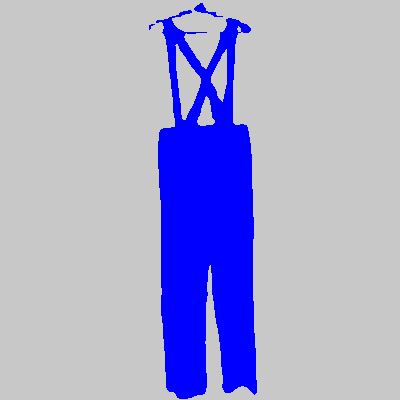

 30%|██████████████████▌                                          | 273/900 [00:42<01:44,  5.98it/s]

torch.Size([1, 3, 400, 400])
/mnt/nas4/hm/datasets/shopping_clothes/data/data900_personby100/outer/image/train_8364.jpg
{'background': 0, 'top': 1, 'skirt': 2, 'outer': 3, 'dress': 4, 'bottom': 5}
Counter({0: 89867, 3: 70133})


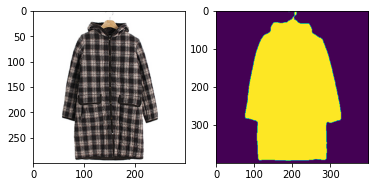

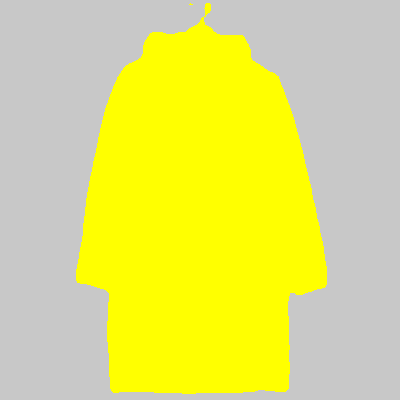

 30%|██████████████████▌                                          | 274/900 [00:42<01:38,  6.34it/s]

torch.Size([1, 3, 400, 400])
/mnt/nas4/hm/datasets/shopping_clothes/data/data900_personby100/outer/image/train_6073.jpg
{'background': 0, 'top': 1, 'skirt': 2, 'outer': 3, 'dress': 4, 'bottom': 5}
Counter({3: 80338, 0: 79662})


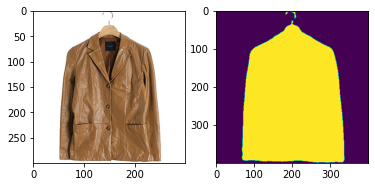

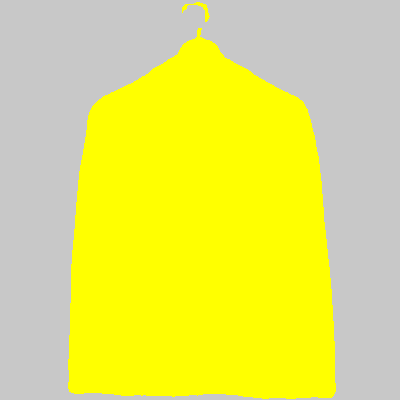

 31%|██████████████████▋                                          | 275/900 [00:43<01:34,  6.63it/s]

torch.Size([1, 3, 400, 400])
/mnt/nas4/hm/datasets/shopping_clothes/data/data900_personby100/outer/image/train_2982.jpg
{'background': 0, 'top': 1, 'skirt': 2, 'outer': 3, 'dress': 4, 'bottom': 5}
Counter({0: 96087, 3: 63913})


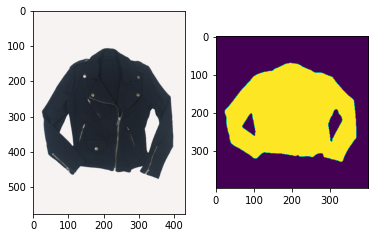

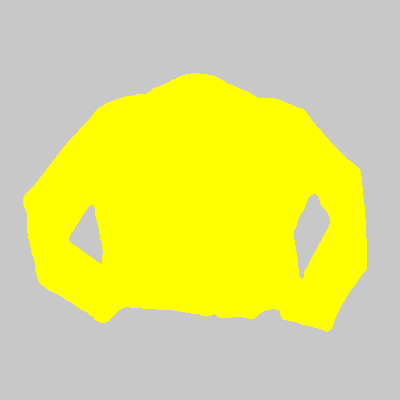

 31%|██████████████████▋                                          | 276/900 [00:43<01:34,  6.63it/s]

torch.Size([1, 3, 400, 400])
/mnt/nas4/hm/datasets/shopping_clothes/data/data900_personby100/outer/image/train_11655.jpg
{'background': 0, 'top': 1, 'skirt': 2, 'outer': 3, 'dress': 4, 'bottom': 5}
Counter({0: 93901, 3: 66099})


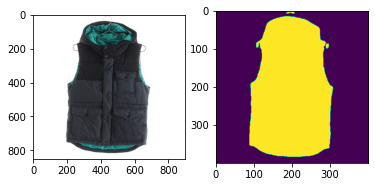

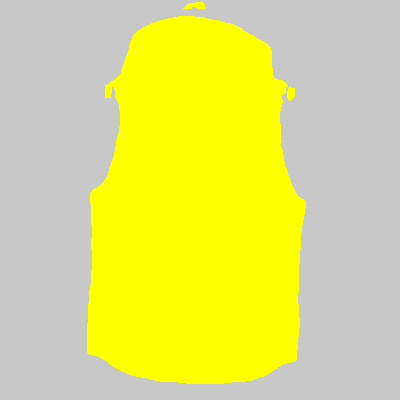

 31%|██████████████████▊                                          | 277/900 [00:43<01:40,  6.17it/s]

torch.Size([1, 3, 400, 400])
/mnt/nas4/hm/datasets/shopping_clothes/data/data900_personby100/outer/image/train_10736.jpg
{'background': 0, 'top': 1, 'skirt': 2, 'outer': 3, 'dress': 4, 'bottom': 5}
Counter({0: 111614, 3: 48386})


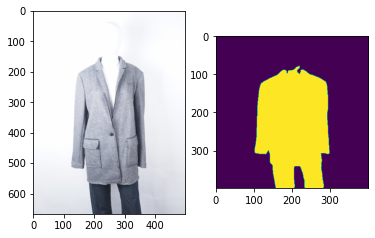

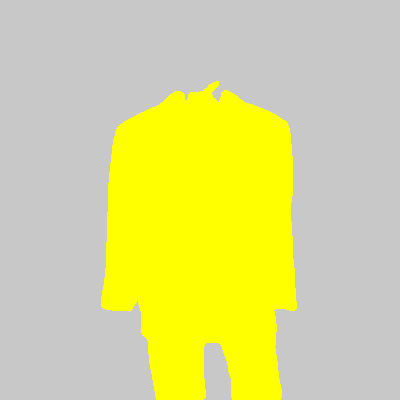

 31%|██████████████████▊                                          | 278/900 [00:43<01:41,  6.13it/s]

torch.Size([1, 3, 400, 400])
/mnt/nas4/hm/datasets/shopping_clothes/data/data900_personby100/bottom/image/train_2523.jpg
{'background': 0, 'top': 1, 'skirt': 2, 'outer': 3, 'dress': 4, 'bottom': 5}
Counter({0: 109766, 5: 50234})


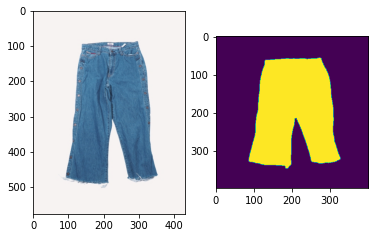

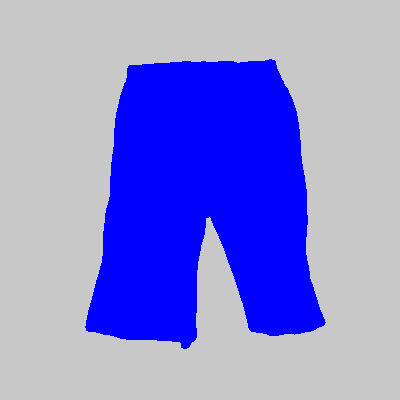

 31%|██████████████████▉                                          | 279/900 [00:43<01:38,  6.31it/s]

torch.Size([1, 3, 400, 400])
/mnt/nas4/hm/datasets/shopping_clothes/data/data900_personby100/outer/image/train_8615.jpg
{'background': 0, 'top': 1, 'skirt': 2, 'outer': 3, 'dress': 4, 'bottom': 5}
Counter({0: 101249, 3: 58751})


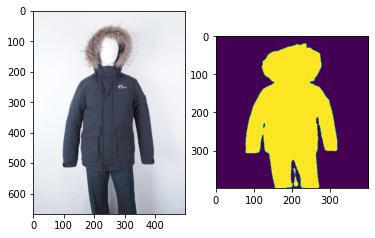

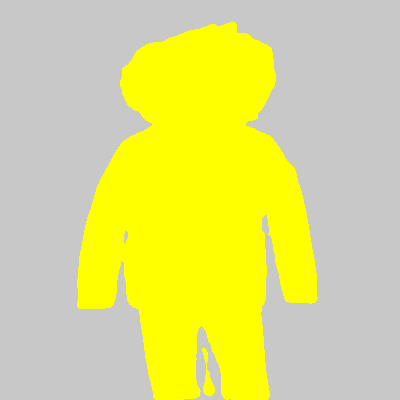

 31%|██████████████████▉                                          | 280/900 [00:43<01:39,  6.21it/s]

torch.Size([1, 3, 400, 400])
/mnt/nas4/hm/datasets/shopping_clothes/data/data900_personby100/top/image/train_8223.jpg
{'background': 0, 'top': 1, 'skirt': 2, 'outer': 3, 'dress': 4, 'bottom': 5}
Counter({0: 88669, 1: 71331})


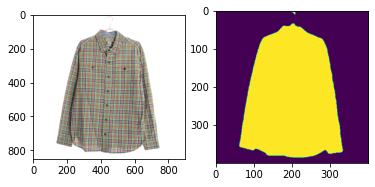

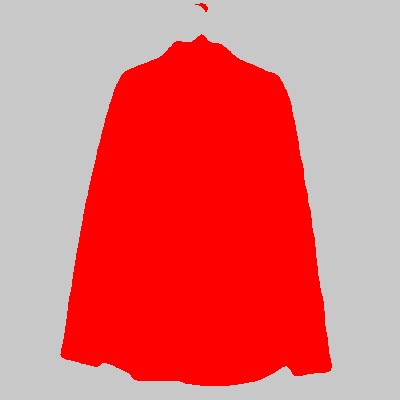

 31%|███████████████████                                          | 281/900 [00:44<01:44,  5.93it/s]

torch.Size([1, 3, 400, 400])
/mnt/nas4/hm/datasets/shopping_clothes/data/data900_personby100/skirt/image/train_2848.jpg
{'background': 0, 'top': 1, 'skirt': 2, 'outer': 3, 'dress': 4, 'bottom': 5}
Counter({0: 106075, 2: 53925})


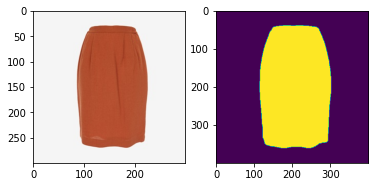

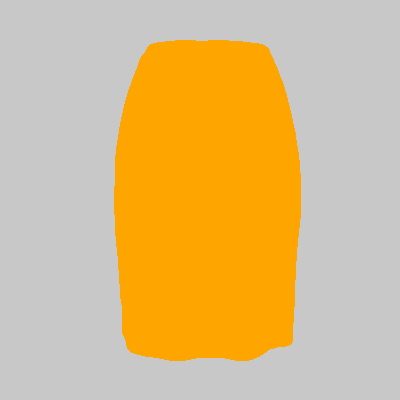

 31%|███████████████████                                          | 282/900 [00:44<01:38,  6.29it/s]

torch.Size([1, 3, 400, 400])
/mnt/nas4/hm/datasets/shopping_clothes/data/data900_personby100/skirt/image/train_2029.jpg
{'background': 0, 'top': 1, 'skirt': 2, 'outer': 3, 'dress': 4, 'bottom': 5}
Counter({0: 85422, 2: 74578})


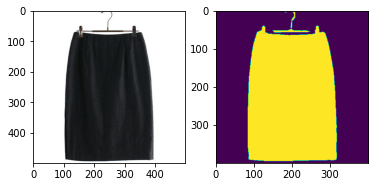

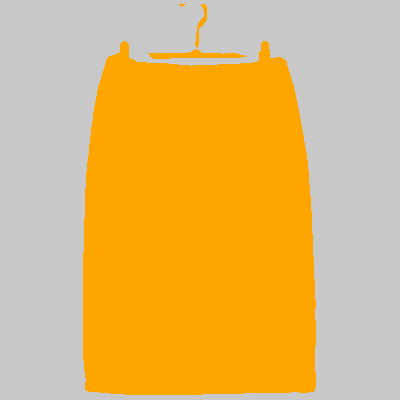

 31%|███████████████████▏                                         | 283/900 [00:44<01:46,  5.79it/s]

torch.Size([1, 3, 400, 400])
/mnt/nas4/hm/datasets/shopping_clothes/data/data900_personby100/bottom/image/train_1594.jpg
{'background': 0, 'top': 1, 'skirt': 2, 'outer': 3, 'dress': 4, 'bottom': 5}
Counter({0: 118753, 5: 41247})


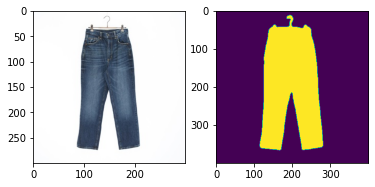

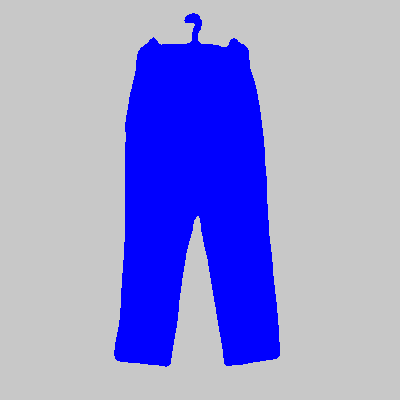

 32%|███████████████████▏                                         | 284/900 [00:44<01:39,  6.21it/s]

torch.Size([1, 3, 400, 400])
/mnt/nas4/hm/datasets/shopping_clothes/data/data900_personby100/skirt/image/train_1138.jpg
{'background': 0, 'top': 1, 'skirt': 2, 'outer': 3, 'dress': 4, 'bottom': 5}
Counter({0: 99504, 2: 60496})


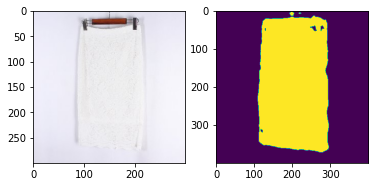

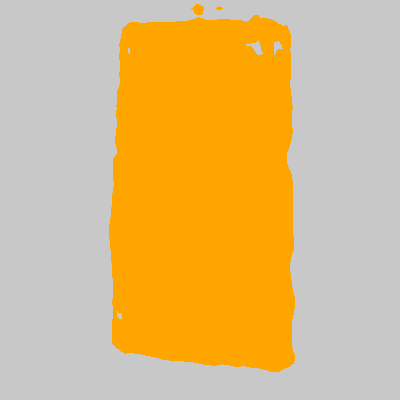

 32%|███████████████████▎                                         | 285/900 [00:44<01:34,  6.54it/s]

torch.Size([1, 3, 400, 400])
/mnt/nas4/hm/datasets/shopping_clothes/data/data900_personby100/skirt/image/train_905.jpg
{'background': 0, 'top': 1, 'skirt': 2, 'outer': 3, 'dress': 4, 'bottom': 5}
Counter({2: 90647, 0: 69353})


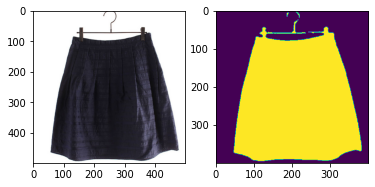

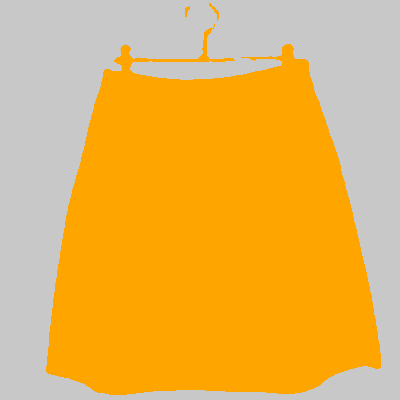

 32%|███████████████████▍                                         | 286/900 [00:44<01:32,  6.65it/s]

torch.Size([1, 3, 400, 400])
/mnt/nas4/hm/datasets/shopping_clothes/data/data900_personby100/skirt/image/train_56.jpg
{'background': 0, 'top': 1, 'skirt': 2, 'outer': 3, 'dress': 4, 'bottom': 5}
Counter({0: 91111, 2: 68889})


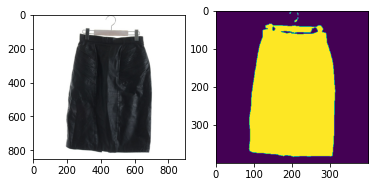

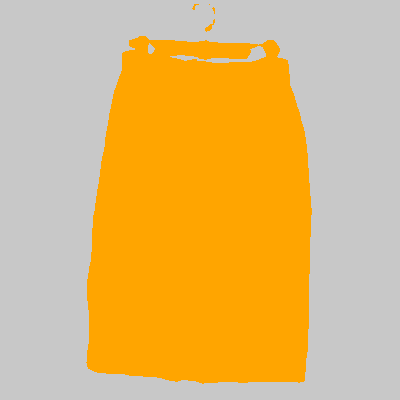

 32%|███████████████████▍                                         | 287/900 [00:45<01:39,  6.17it/s]

torch.Size([1, 3, 400, 400])
/mnt/nas4/hm/datasets/shopping_clothes/data/data900_personby100/skirt/image/train_491.jpg
{'background': 0, 'top': 1, 'skirt': 2, 'outer': 3, 'dress': 4, 'bottom': 5}
Counter({0: 90113, 2: 69887})


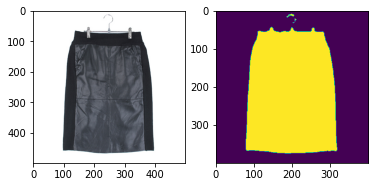

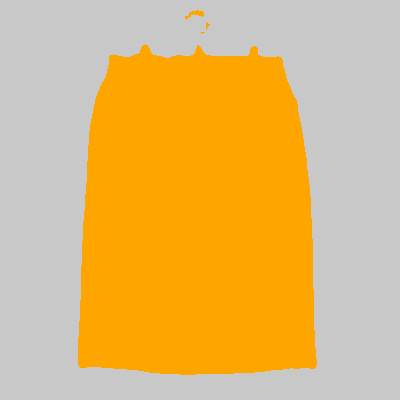

 32%|███████████████████▌                                         | 288/900 [00:45<01:36,  6.35it/s]

torch.Size([1, 3, 400, 400])
/mnt/nas4/hm/datasets/shopping_clothes/data/data900_personby100/top/image/train_12524.jpg
{'background': 0, 'top': 1, 'skirt': 2, 'outer': 3, 'dress': 4, 'bottom': 5}
Counter({0: 83165, 1: 76835})


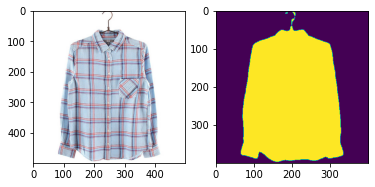

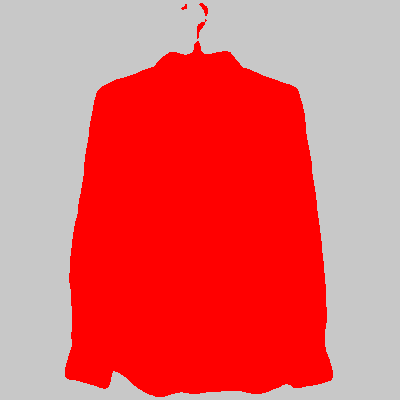

 32%|███████████████████▌                                         | 289/900 [00:45<01:33,  6.50it/s]

torch.Size([1, 3, 400, 400])
/mnt/nas4/hm/datasets/shopping_clothes/data/data900_personby100/skirt/image/train_1540.jpg
{'background': 0, 'top': 1, 'skirt': 2, 'outer': 3, 'dress': 4, 'bottom': 5}
Counter({0: 105501, 2: 54499})


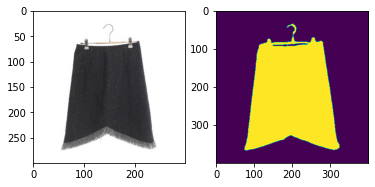

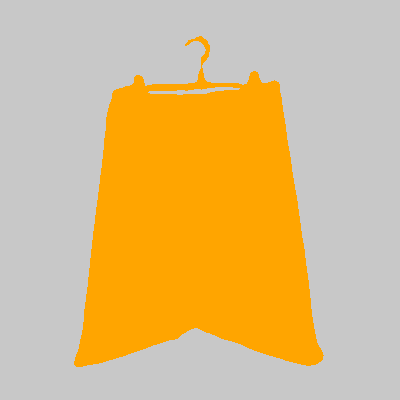

 32%|███████████████████▋                                         | 290/900 [00:45<01:30,  6.76it/s]

torch.Size([1, 3, 400, 400])
/mnt/nas4/hm/datasets/shopping_clothes/data/data900_personby100/bottom/image/train_3209.jpg
{'background': 0, 'top': 1, 'skirt': 2, 'outer': 3, 'dress': 4, 'bottom': 5}
Counter({0: 115559, 5: 44441})


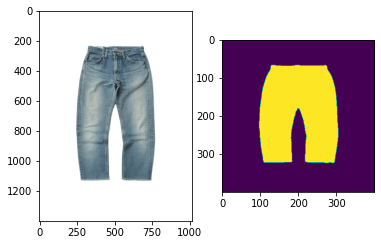

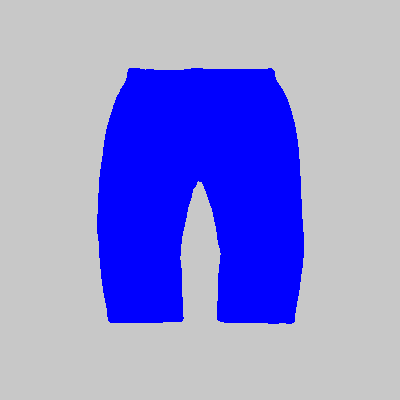

 32%|███████████████████▋                                         | 291/900 [00:45<01:47,  5.69it/s]

torch.Size([1, 3, 400, 400])
/mnt/nas4/hm/datasets/shopping_clothes/data/data900_personby100/bottom/image/train_975.jpg
{'background': 0, 'top': 1, 'skirt': 2, 'outer': 3, 'dress': 4, 'bottom': 5}
Counter({0: 105643, 5: 54357})


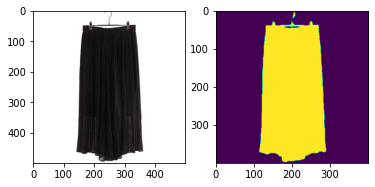

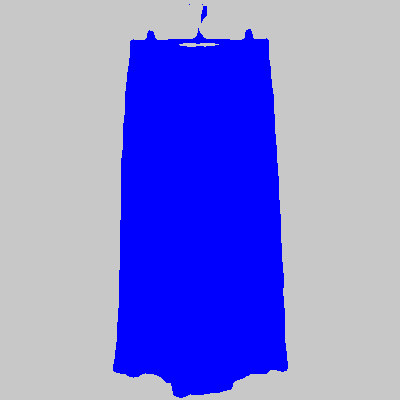

 32%|███████████████████▊                                         | 292/900 [00:45<01:41,  5.99it/s]

torch.Size([1, 3, 400, 400])
/mnt/nas4/hm/datasets/shopping_clothes/data/data900_personby100/bottom/image/train_263.jpg
{'background': 0, 'top': 1, 'skirt': 2, 'outer': 3, 'dress': 4, 'bottom': 5}
Counter({0: 114466, 5: 45534})


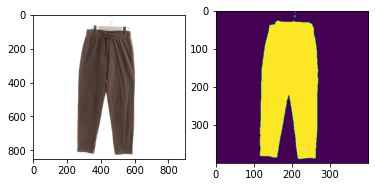

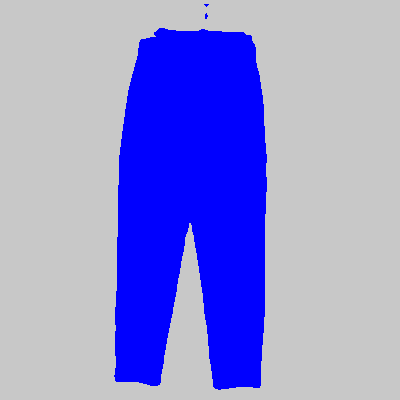

 33%|███████████████████▊                                         | 293/900 [00:46<01:44,  5.81it/s]

torch.Size([1, 3, 400, 400])
/mnt/nas4/hm/datasets/shopping_clothes/data/data900_personby100/outer/image/train_10603.jpg
{'background': 0, 'top': 1, 'skirt': 2, 'outer': 3, 'dress': 4, 'bottom': 5}
Counter({0: 101942, 3: 58058})


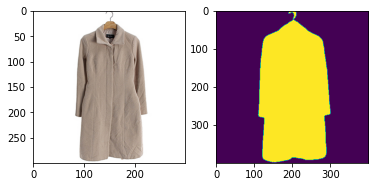

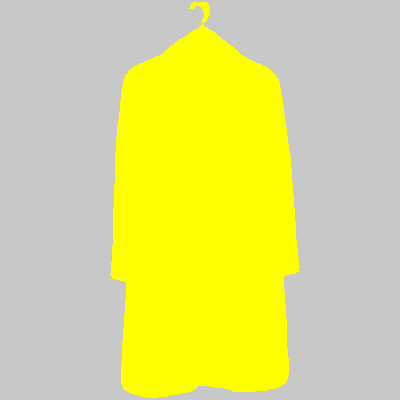

 33%|███████████████████▉                                         | 294/900 [00:46<01:48,  5.57it/s]

torch.Size([1, 3, 400, 400])
/mnt/nas4/hm/datasets/shopping_clothes/data/data900_personby100/skirt/image/train_2355.jpg
{'background': 0, 'top': 1, 'skirt': 2, 'outer': 3, 'dress': 4, 'bottom': 5}
Counter({2: 99701, 0: 60299})


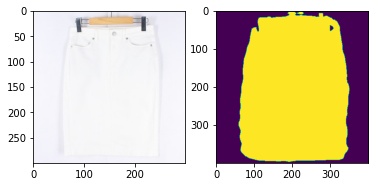

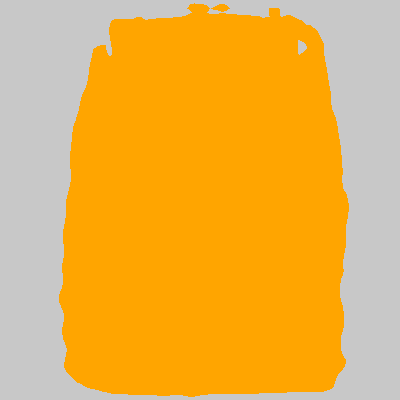

 33%|███████████████████▉                                         | 295/900 [00:46<01:40,  6.01it/s]

torch.Size([1, 3, 400, 400])
/mnt/nas4/hm/datasets/shopping_clothes/data/data900_personby100/top/image/train_3330.jpg
{'background': 0, 'top': 1, 'skirt': 2, 'outer': 3, 'dress': 4, 'bottom': 5}
Counter({0: 103466, 1: 56534})


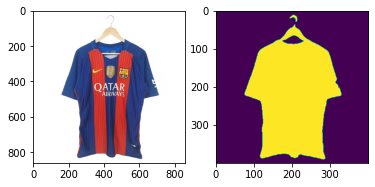

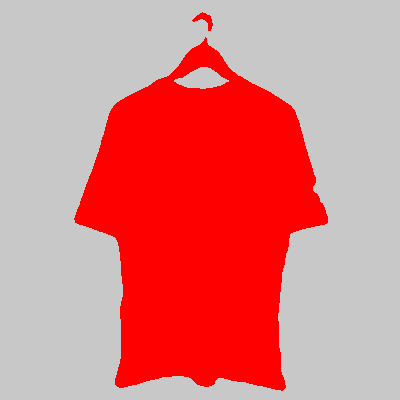

 33%|████████████████████                                         | 296/900 [00:46<01:43,  5.84it/s]

torch.Size([1, 3, 400, 400])
/mnt/nas4/hm/datasets/shopping_clothes/data/data900_personby100/top/image/train_5838.jpg
{'background': 0, 'top': 1, 'skirt': 2, 'outer': 3, 'dress': 4, 'bottom': 5}
Counter({0: 108081, 1: 51919})


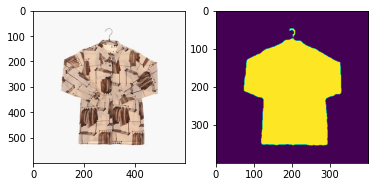

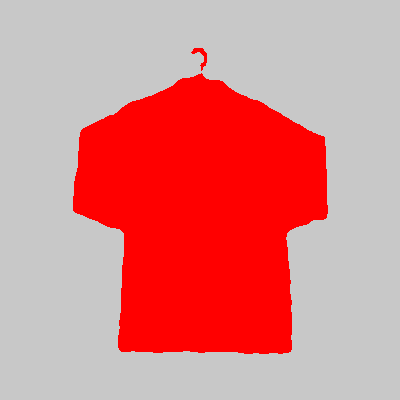

 33%|████████████████████▏                                        | 297/900 [00:46<01:39,  6.06it/s]

torch.Size([1, 3, 400, 400])
/mnt/nas4/hm/datasets/shopping_clothes/data/data900_personby100/skirt/image/train_1983.jpg
{'background': 0, 'top': 1, 'skirt': 2, 'outer': 3, 'dress': 4, 'bottom': 5}
Counter({2: 82742, 0: 77258})


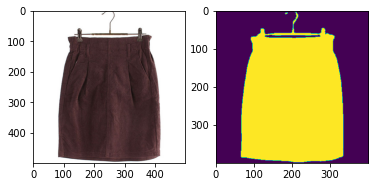

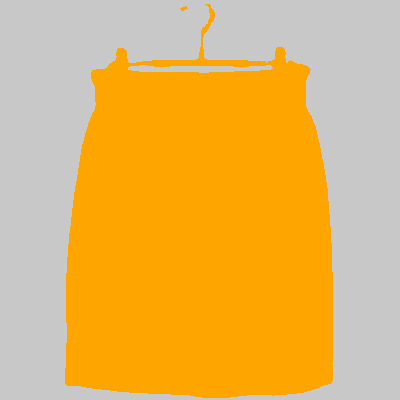

 33%|████████████████████▏                                        | 298/900 [00:46<01:36,  6.23it/s]

torch.Size([1, 3, 400, 400])
/mnt/nas4/hm/datasets/shopping_clothes/data/data900_personby100/bottom/image/train_483.jpg
{'background': 0, 'top': 1, 'skirt': 2, 'outer': 3, 'dress': 4, 'bottom': 5}
Counter({5: 85406, 0: 74594})


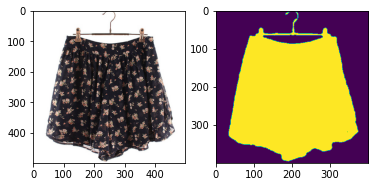

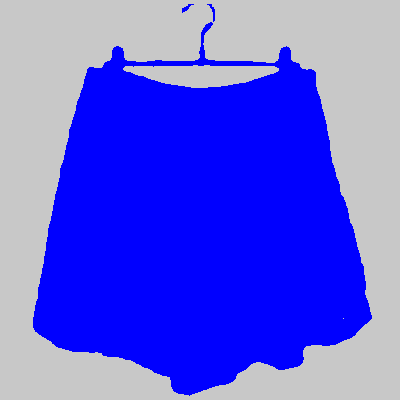

 33%|████████████████████▎                                        | 299/900 [00:47<01:33,  6.40it/s]

torch.Size([1, 3, 400, 400])
/mnt/nas4/hm/datasets/shopping_clothes/data/data900_personby100/dress/image/train_653.jpg
{'background': 0, 'top': 1, 'skirt': 2, 'outer': 3, 'dress': 4, 'bottom': 5}
Counter({0: 123473, 4: 36527})


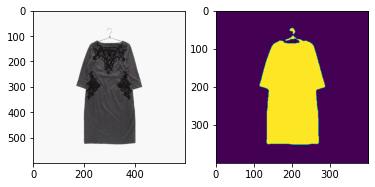

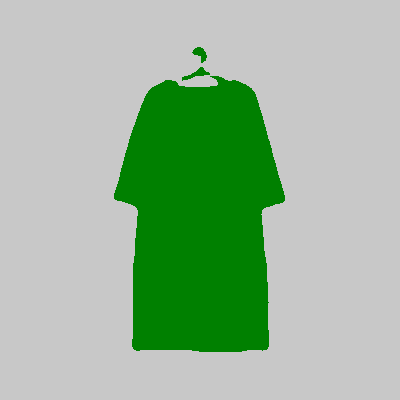

 33%|████████████████████▎                                        | 300/900 [00:47<01:32,  6.48it/s]

torch.Size([1, 3, 400, 400])
/mnt/nas4/hm/datasets/shopping_clothes/data/data900_personby100/outer/image/train_971.jpg
{'background': 0, 'top': 1, 'skirt': 2, 'outer': 3, 'dress': 4, 'bottom': 5}
Counter({3: 83607, 0: 76393})


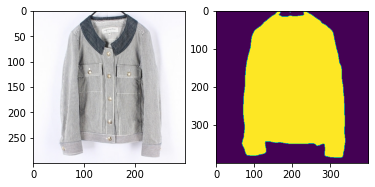

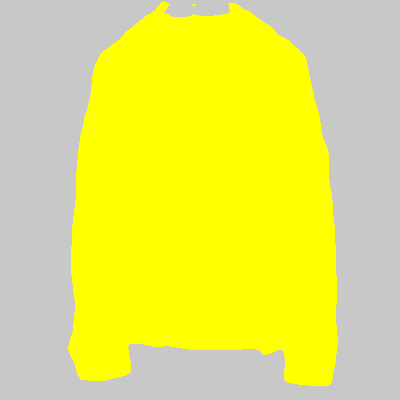

 33%|████████████████████▍                                        | 301/900 [00:47<01:29,  6.70it/s]

torch.Size([1, 3, 400, 400])
/mnt/nas4/hm/datasets/shopping_clothes/data/data900_personby100/top/image/train_12868.jpg
{'background': 0, 'top': 1, 'skirt': 2, 'outer': 3, 'dress': 4, 'bottom': 5}
Counter({0: 103162, 1: 56838})


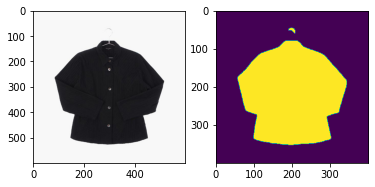

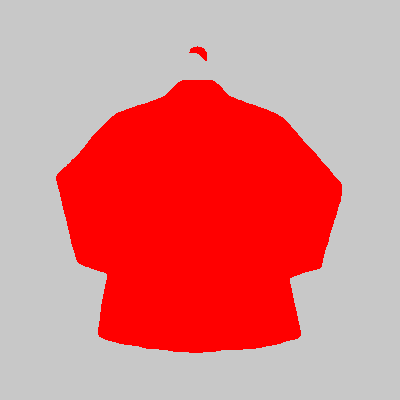

 34%|████████████████████▍                                        | 302/900 [00:47<01:29,  6.67it/s]

torch.Size([1, 3, 400, 400])
/mnt/nas4/hm/datasets/shopping_clothes/data/data900_personby100/bottom/image/train_957.jpg
{'background': 0, 'top': 1, 'skirt': 2, 'outer': 3, 'dress': 4, 'bottom': 5}
Counter({0: 86526, 5: 73474})


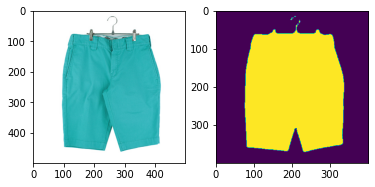

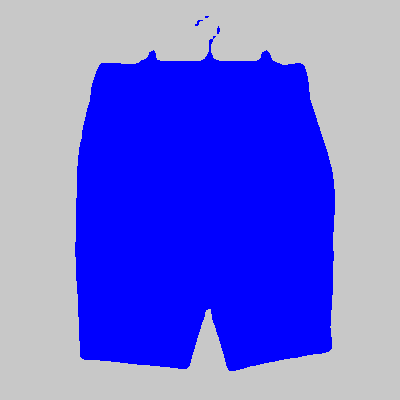

 34%|████████████████████▌                                        | 303/900 [00:47<01:29,  6.67it/s]

torch.Size([1, 3, 400, 400])
/mnt/nas4/hm/datasets/shopping_clothes/data/data900_personby100/skirt/image/train_447.jpg
{'background': 0, 'top': 1, 'skirt': 2, 'outer': 3, 'dress': 4, 'bottom': 5}
Counter({0: 84504, 2: 75496})


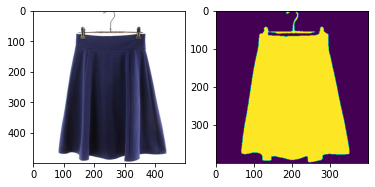

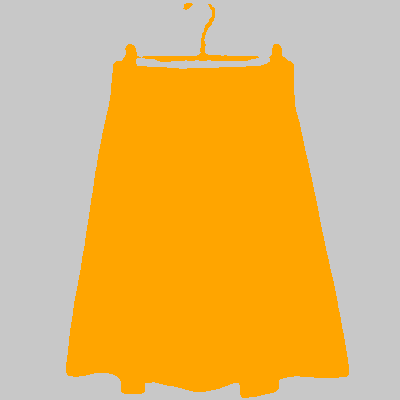

 34%|████████████████████▌                                        | 304/900 [00:47<01:28,  6.74it/s]

torch.Size([1, 3, 400, 400])
/mnt/nas4/hm/datasets/shopping_clothes/data/data900_personby100/bottom/image/train_2590.jpg
{'background': 0, 'top': 1, 'skirt': 2, 'outer': 3, 'dress': 4, 'bottom': 5}
Counter({0: 117415, 5: 42585})


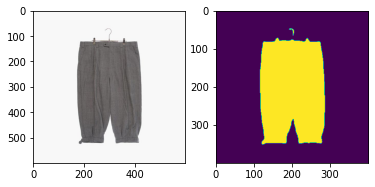

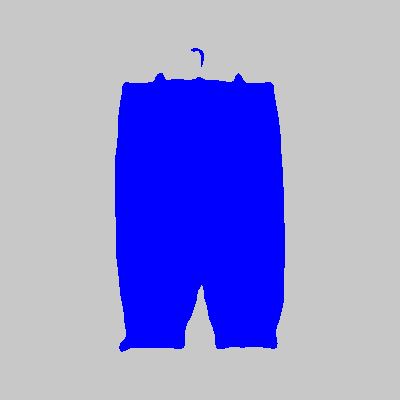

 34%|████████████████████▋                                        | 305/900 [00:47<01:38,  6.01it/s]

torch.Size([1, 3, 400, 400])
/mnt/nas4/hm/datasets/shopping_clothes/data/data900_personby100/skirt/image/train_800.jpg
{'background': 0, 'top': 1, 'skirt': 2, 'outer': 3, 'dress': 4, 'bottom': 5}
Counter({0: 80857, 2: 79143})


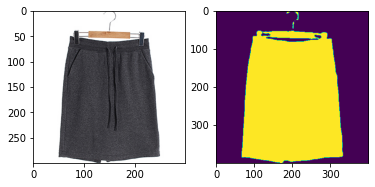

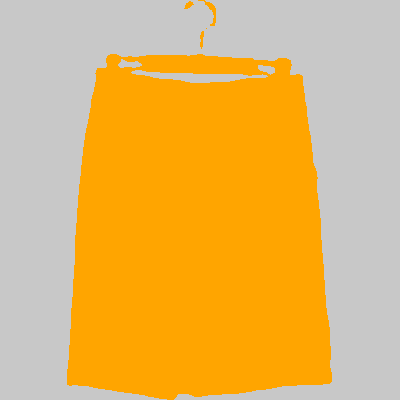

 34%|████████████████████▋                                        | 306/900 [00:48<01:33,  6.38it/s]

torch.Size([1, 3, 400, 400])
/mnt/nas4/hm/datasets/shopping_clothes/data/data900_personby100/skirt/image/train_1770.jpg
{'background': 0, 'top': 1, 'skirt': 2, 'outer': 3, 'dress': 4, 'bottom': 5}
Counter({0: 89403, 2: 70597})


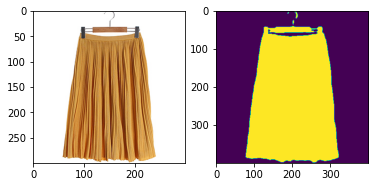

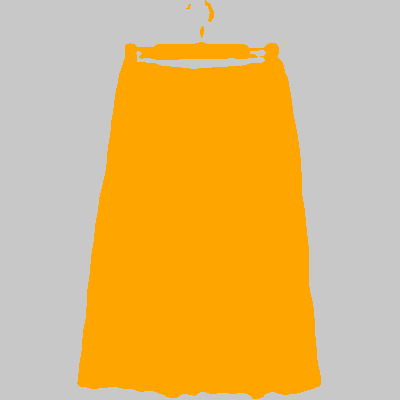

 34%|████████████████████▊                                        | 307/900 [00:48<01:29,  6.65it/s]

torch.Size([1, 3, 400, 400])
/mnt/nas4/hm/datasets/shopping_clothes/data/data900_personby100/outer/image/train_10819.jpg
{'background': 0, 'top': 1, 'skirt': 2, 'outer': 3, 'dress': 4, 'bottom': 5}
Counter({0: 87459, 3: 72541})


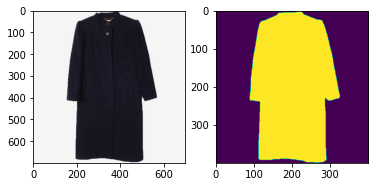

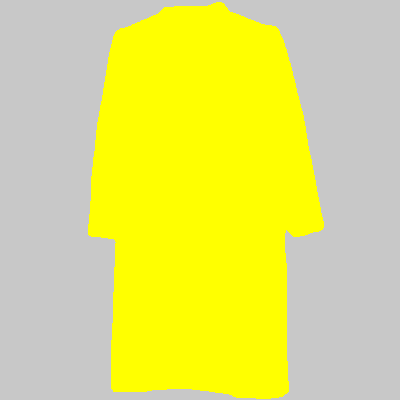

 34%|████████████████████▉                                        | 308/900 [00:48<01:31,  6.45it/s]

torch.Size([1, 3, 400, 400])
/mnt/nas4/hm/datasets/shopping_clothes/data/data900_personby100/dress/image/train_3412.jpg
{'background': 0, 'top': 1, 'skirt': 2, 'outer': 3, 'dress': 4, 'bottom': 5}
Counter({0: 109634, 4: 50366})


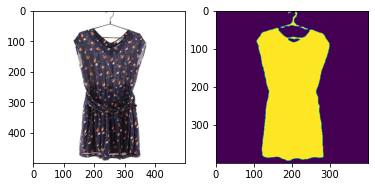

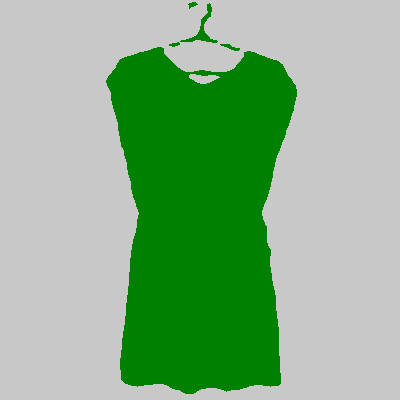

 34%|████████████████████▉                                        | 309/900 [00:48<01:29,  6.59it/s]

torch.Size([1, 3, 400, 400])
/mnt/nas4/hm/datasets/shopping_clothes/data/data900_personby100/bottom/image/train_2581.jpg
{'background': 0, 'top': 1, 'skirt': 2, 'outer': 3, 'dress': 4, 'bottom': 5}
Counter({0: 102291, 5: 57709})


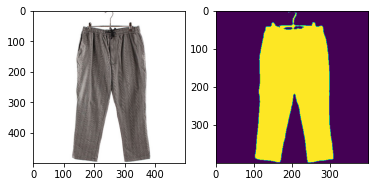

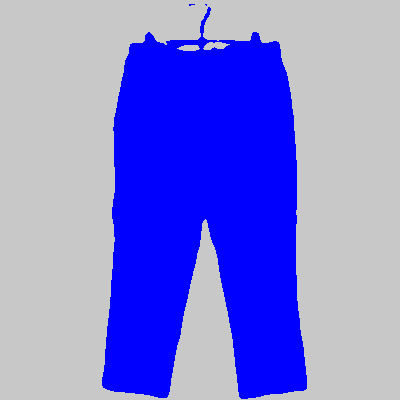

 34%|█████████████████████                                        | 310/900 [00:48<01:28,  6.69it/s]

torch.Size([1, 3, 400, 400])
/mnt/nas4/hm/datasets/shopping_clothes/data/data900_personby100/bottom/image/train_1881.jpg
{'background': 0, 'top': 1, 'skirt': 2, 'outer': 3, 'dress': 4, 'bottom': 5}
Counter({0: 109111, 5: 50889})


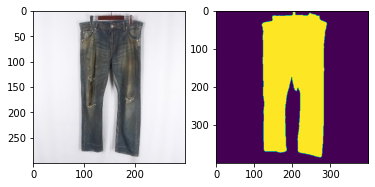

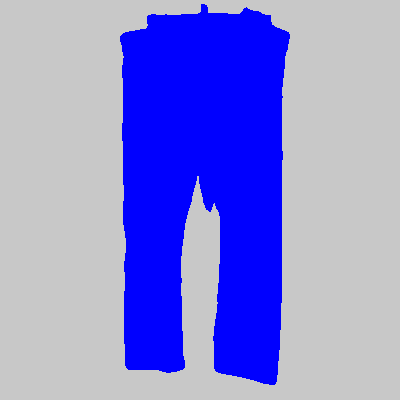

 35%|█████████████████████                                        | 311/900 [00:48<01:25,  6.90it/s]

torch.Size([1, 3, 400, 400])
/mnt/nas4/hm/datasets/shopping_clothes/data/data900_personby100/dress/image/train_1256.jpg
{'background': 0, 'top': 1, 'skirt': 2, 'outer': 3, 'dress': 4, 'bottom': 5}
Counter({0: 88472, 4: 71528})


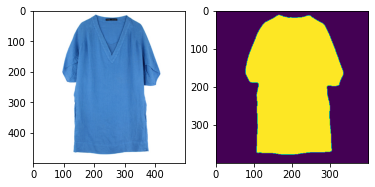

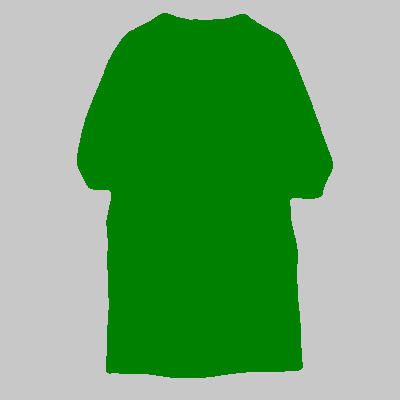

 35%|█████████████████████▏                                       | 312/900 [00:48<01:25,  6.84it/s]

torch.Size([1, 3, 400, 400])
/mnt/nas4/hm/datasets/shopping_clothes/data/data900_personby100/dress/image/train_61.jpg
{'background': 0, 'top': 1, 'skirt': 2, 'outer': 3, 'dress': 4, 'bottom': 5}
Counter({0: 106322, 4: 53678})


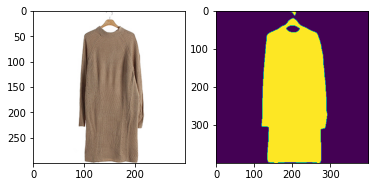

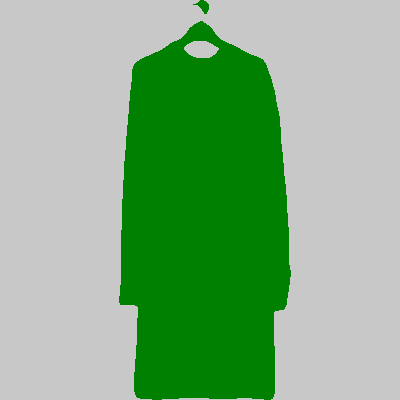

 35%|█████████████████████▏                                       | 313/900 [00:49<01:23,  7.01it/s]

torch.Size([1, 3, 400, 400])
/mnt/nas4/hm/datasets/shopping_clothes/data/data900_personby100/bottom/image/train_240.jpg
{'background': 0, 'top': 1, 'skirt': 2, 'outer': 3, 'dress': 4, 'bottom': 5}
Counter({0: 126016, 5: 33984})


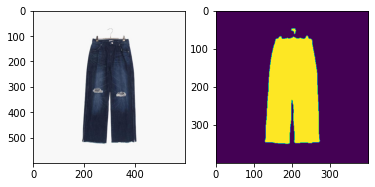

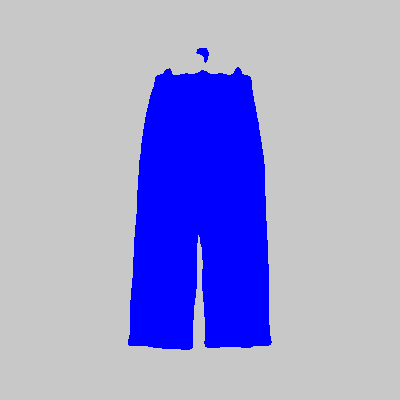

 35%|█████████████████████▎                                       | 314/900 [00:49<01:24,  6.90it/s]

torch.Size([1, 3, 400, 400])
/mnt/nas4/hm/datasets/shopping_clothes/data/data900_personby100/top/image/train_15523.jpg
{'background': 0, 'top': 1, 'skirt': 2, 'outer': 3, 'dress': 4, 'bottom': 5}
Counter({0: 88121, 1: 71879})


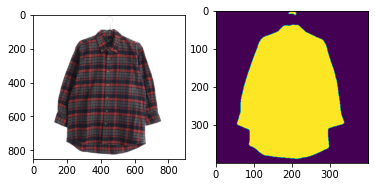

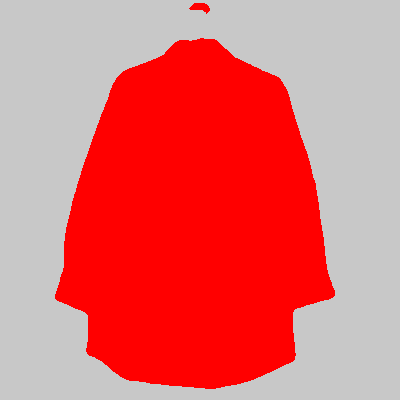

 35%|█████████████████████▎                                       | 315/900 [00:49<01:32,  6.33it/s]

torch.Size([1, 3, 400, 400])
/mnt/nas4/hm/datasets/shopping_clothes/data/data900_personby100/outer/image/train_876.jpg
{'background': 0, 'top': 1, 'skirt': 2, 'outer': 3, 'dress': 4, 'bottom': 5}
Counter({3: 82308, 0: 77692})


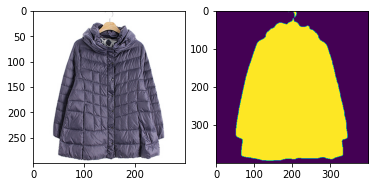

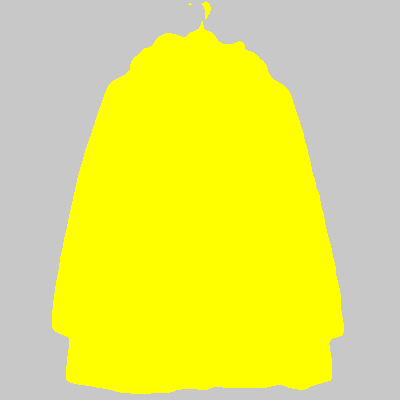

 35%|█████████████████████▍                                       | 316/900 [00:49<01:38,  5.90it/s]

torch.Size([1, 3, 400, 400])
/mnt/nas4/hm/datasets/shopping_clothes/data/data900_personby100/bottom/image/train_713.jpg
{'background': 0, 'top': 1, 'skirt': 2, 'outer': 3, 'dress': 4, 'bottom': 5}
Counter({0: 105297, 5: 54703})


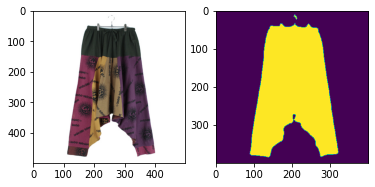

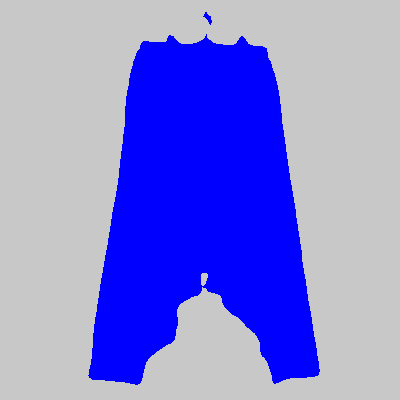

 35%|█████████████████████▍                                       | 317/900 [00:49<01:34,  6.14it/s]

torch.Size([1, 3, 400, 400])
/mnt/nas4/hm/datasets/shopping_clothes/data/data900_personby100/outer/image/train_4132.jpg
{'background': 0, 'top': 1, 'skirt': 2, 'outer': 3, 'dress': 4, 'bottom': 5}
Counter({3: 88481, 0: 71519})


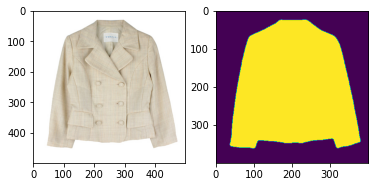

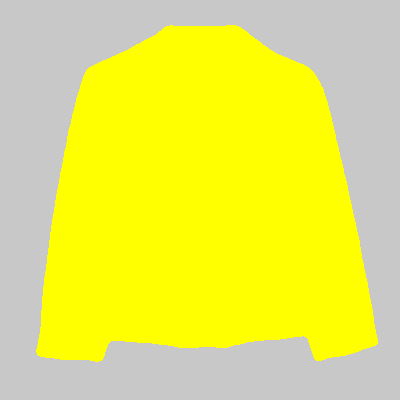

 35%|█████████████████████▌                                       | 318/900 [00:49<01:32,  6.28it/s]

torch.Size([1, 3, 400, 400])
/mnt/nas4/hm/datasets/shopping_clothes/data/data900_personby100/dress/image/train_746.jpg
{'background': 0, 'top': 1, 'skirt': 2, 'outer': 3, 'dress': 4, 'bottom': 5}
Counter({0: 116638, 4: 43362})


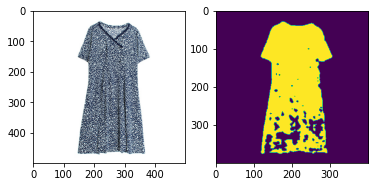

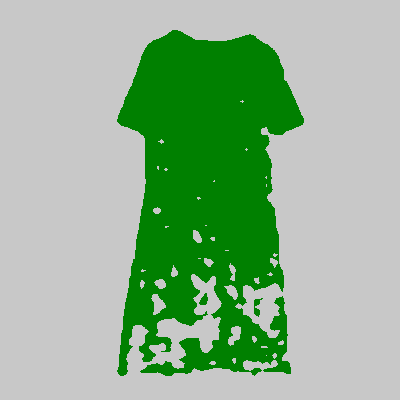

 35%|█████████████████████▌                                       | 319/900 [00:50<01:30,  6.43it/s]

torch.Size([1, 3, 400, 400])
/mnt/nas4/hm/datasets/shopping_clothes/data/data900_personby100/outer/image/train_3371.jpg
{'background': 0, 'top': 1, 'skirt': 2, 'outer': 3, 'dress': 4, 'bottom': 5}
Counter({3: 97061, 0: 62939})


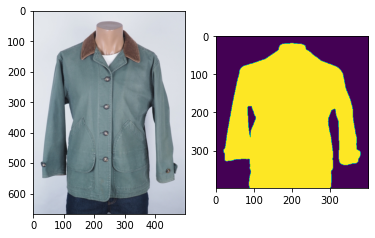

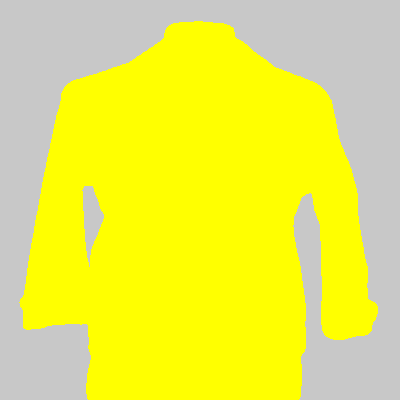

 36%|█████████████████████▋                                       | 320/900 [00:50<01:32,  6.30it/s]

torch.Size([1, 3, 400, 400])
/mnt/nas4/hm/datasets/shopping_clothes/data/data900_personby100/dress/image/train_1499.jpg
{'background': 0, 'top': 1, 'skirt': 2, 'outer': 3, 'dress': 4, 'bottom': 5}
Counter({0: 122141, 4: 37859})


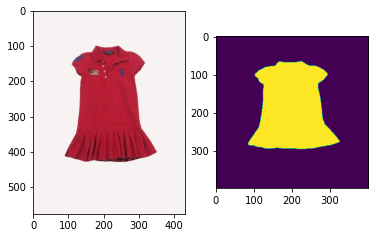

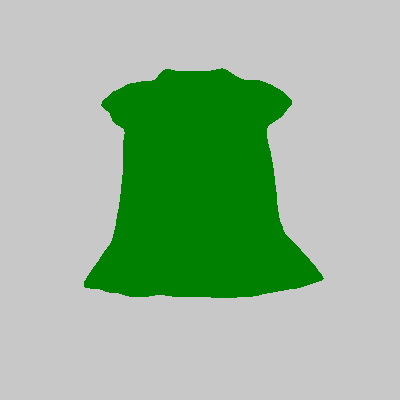

 36%|█████████████████████▊                                       | 321/900 [00:50<01:30,  6.43it/s]

torch.Size([1, 3, 400, 400])
/mnt/nas4/hm/datasets/shopping_clothes/data/data900_personby100/dress/image/train_487.jpg
{'background': 0, 'top': 1, 'skirt': 2, 'outer': 3, 'dress': 4, 'bottom': 5}
Counter({0: 100201, 4: 59799})


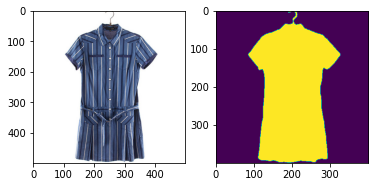

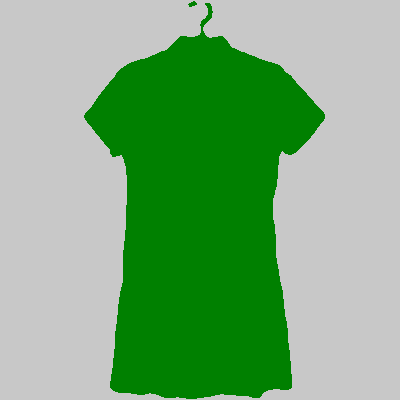

 36%|█████████████████████▊                                       | 322/900 [00:50<01:28,  6.56it/s]

torch.Size([1, 3, 400, 400])
/mnt/nas4/hm/datasets/shopping_clothes/data/data900_personby100/top/image/train_10468.jpg
{'background': 0, 'top': 1, 'skirt': 2, 'outer': 3, 'dress': 4, 'bottom': 5}
Counter({0: 103445, 1: 56555})


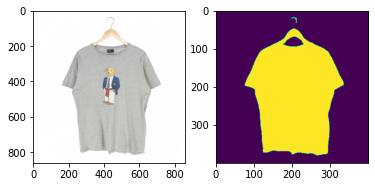

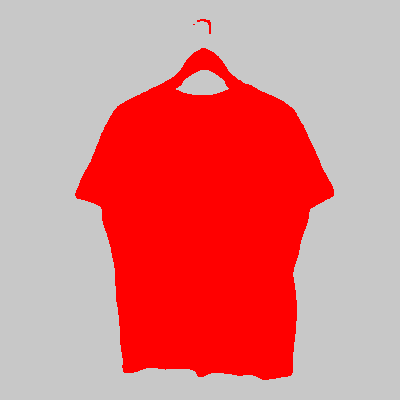

 36%|█████████████████████▉                                       | 323/900 [00:50<01:33,  6.20it/s]

torch.Size([1, 3, 400, 400])
/mnt/nas4/hm/datasets/shopping_clothes/data/data900_personby100/top/image/train_7225.jpg
{'background': 0, 'top': 1, 'skirt': 2, 'outer': 3, 'dress': 4, 'bottom': 5}
Counter({0: 101498, 1: 58502})


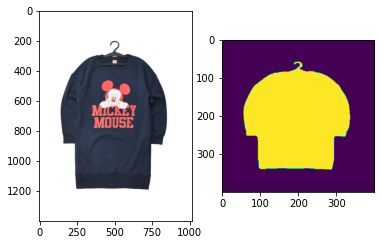

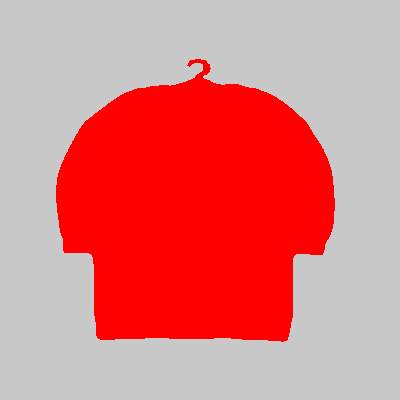

 36%|█████████████████████▉                                       | 324/900 [00:50<01:47,  5.36it/s]

torch.Size([1, 3, 400, 400])
/mnt/nas4/hm/datasets/shopping_clothes/data/data900_personby100/skirt/image/train_1706.jpg
{'background': 0, 'top': 1, 'skirt': 2, 'outer': 3, 'dress': 4, 'bottom': 5}
Counter({0: 93474, 2: 66526})


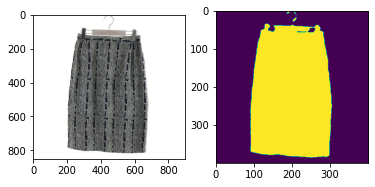

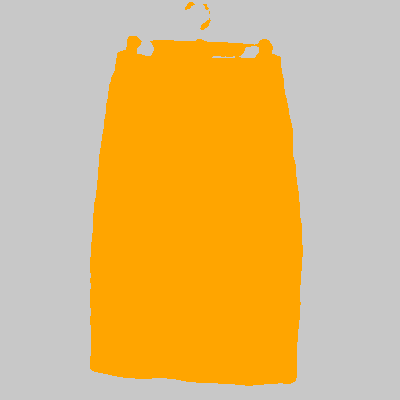

 36%|██████████████████████                                       | 325/900 [00:51<01:47,  5.33it/s]

torch.Size([1, 3, 400, 400])
/mnt/nas4/hm/datasets/shopping_clothes/data/data900_personby100/bottom/image/train_303.jpg
{'background': 0, 'top': 1, 'skirt': 2, 'outer': 3, 'dress': 4, 'bottom': 5}
Counter({0: 129138, 5: 30862})


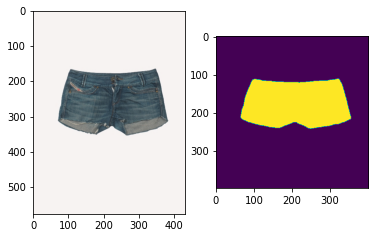

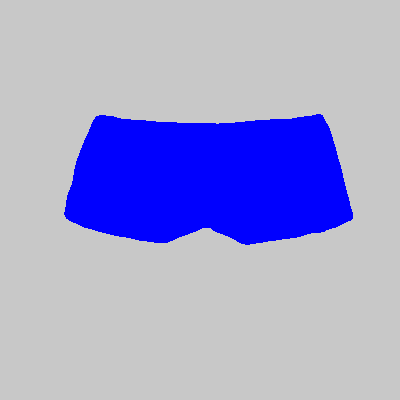

 36%|██████████████████████                                       | 326/900 [00:51<01:40,  5.72it/s]

torch.Size([1, 3, 400, 400])
/mnt/nas4/hm/datasets/shopping_clothes/data/data900_personby100/top/image/train_4492.jpg
{'background': 0, 'top': 1, 'skirt': 2, 'outer': 3, 'dress': 4, 'bottom': 5}
Counter({0: 112424, 1: 47576})


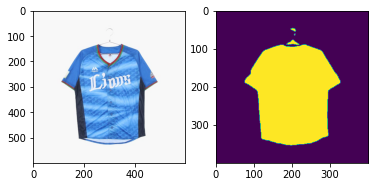

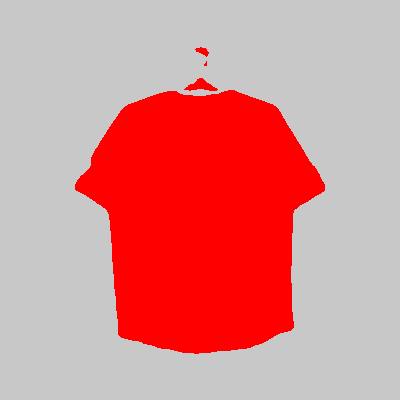

 36%|██████████████████████▏                                      | 327/900 [00:51<01:46,  5.37it/s]

torch.Size([1, 3, 400, 400])
/mnt/nas4/hm/datasets/shopping_clothes/data/data900_personby100/outer/image/train_11125.jpg
{'background': 0, 'top': 1, 'skirt': 2, 'outer': 3, 'dress': 4, 'bottom': 5}
Counter({0: 94495, 3: 65505})


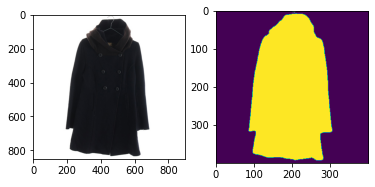

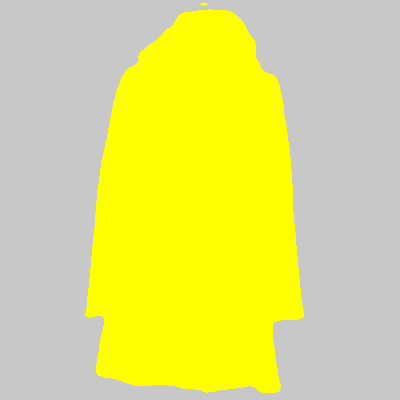

 36%|██████████████████████▏                                      | 328/900 [00:51<01:46,  5.39it/s]

torch.Size([1, 3, 400, 400])
/mnt/nas4/hm/datasets/shopping_clothes/data/data900_personby100/skirt/image/train_1453.jpg
{'background': 0, 'top': 1, 'skirt': 2, 'outer': 3, 'dress': 4, 'bottom': 5}
Counter({2: 88886, 0: 71114})


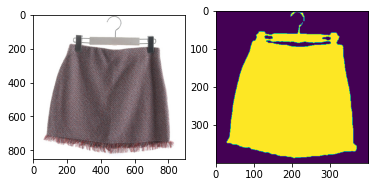

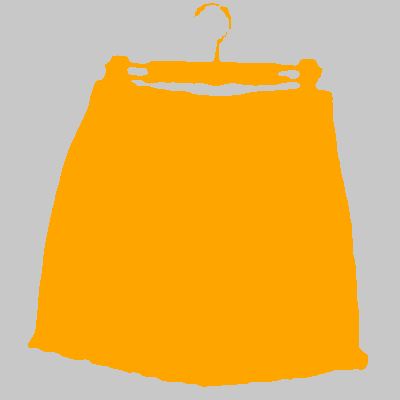

 37%|██████████████████████▎                                      | 329/900 [00:51<01:49,  5.24it/s]

torch.Size([1, 3, 400, 400])
/mnt/nas4/hm/datasets/shopping_clothes/data/data900_personby100/skirt/image/train_829.jpg
{'background': 0, 'top': 1, 'skirt': 2, 'outer': 3, 'dress': 4, 'bottom': 5}
Counter({0: 108290, 2: 51710})


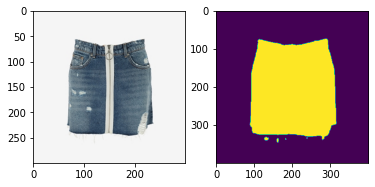

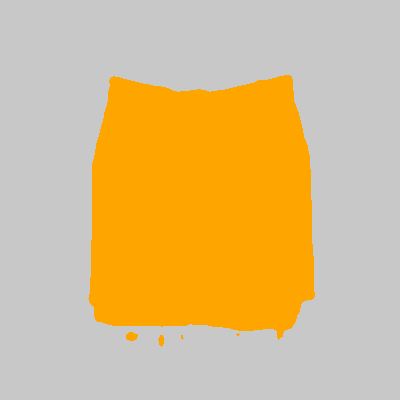

 37%|██████████████████████▎                                      | 330/900 [00:52<01:38,  5.77it/s]

torch.Size([1, 3, 400, 400])
/mnt/nas4/hm/datasets/shopping_clothes/data/data900_personby100/dress/image/train_878.jpg
{'background': 0, 'top': 1, 'skirt': 2, 'outer': 3, 'dress': 4, 'bottom': 5}
Counter({0: 115778, 4: 44222})


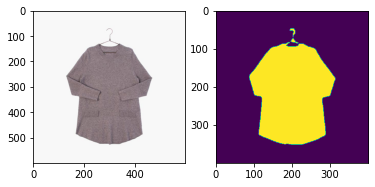

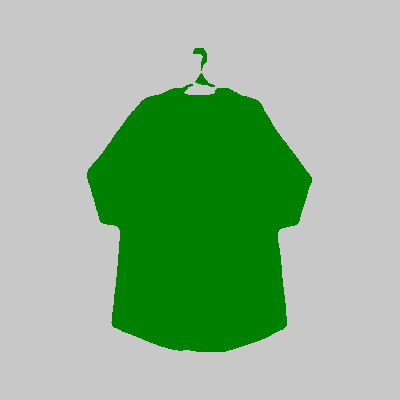

 37%|██████████████████████▍                                      | 331/900 [00:52<01:34,  6.01it/s]

torch.Size([1, 3, 400, 400])
/mnt/nas4/hm/datasets/shopping_clothes/data/data900_personby100/outer/image/train_2770.jpg
{'background': 0, 'top': 1, 'skirt': 2, 'outer': 3, 'dress': 4, 'bottom': 5}
Counter({3: 88474, 0: 71526})


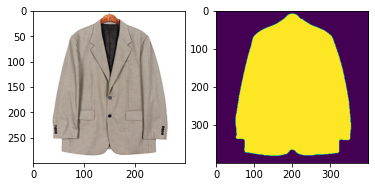

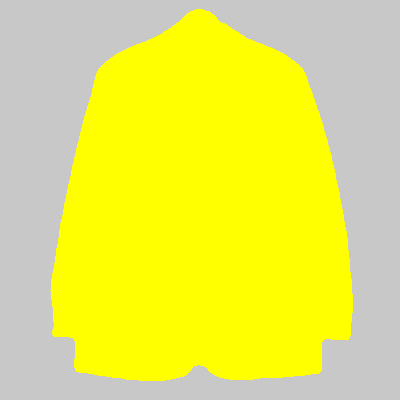

 37%|██████████████████████▌                                      | 332/900 [00:52<01:28,  6.39it/s]

torch.Size([1, 3, 400, 400])
/mnt/nas4/hm/datasets/shopping_clothes/data/data900_personby100/top/image/train_16524.jpg
{'background': 0, 'top': 1, 'skirt': 2, 'outer': 3, 'dress': 4, 'bottom': 5}
Counter({1: 93995, 0: 66005})


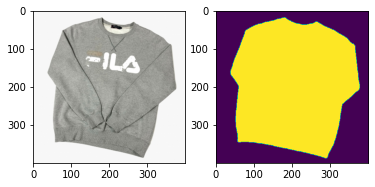

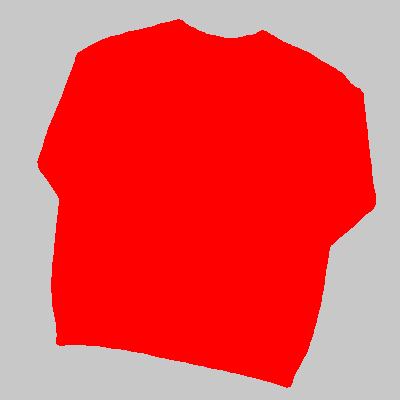

 37%|██████████████████████▌                                      | 333/900 [00:52<01:25,  6.62it/s]

torch.Size([1, 3, 400, 400])
/mnt/nas4/hm/datasets/shopping_clothes/data/data900_personby100/top/image/train_4956.jpg
{'background': 0, 'top': 1, 'skirt': 2, 'outer': 3, 'dress': 4, 'bottom': 5}
Counter({0: 103579, 1: 56421})


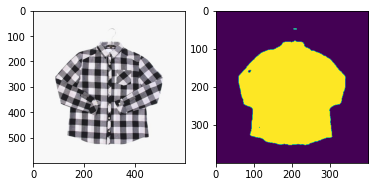

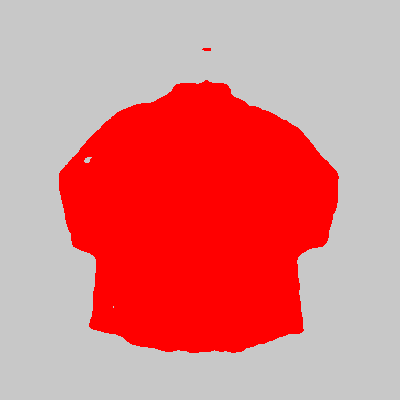

 37%|██████████████████████▋                                      | 334/900 [00:52<01:25,  6.62it/s]

torch.Size([1, 3, 400, 400])
/mnt/nas4/hm/datasets/shopping_clothes/data/data900_personby100/dress/image/train_3656.jpg
{'background': 0, 'top': 1, 'skirt': 2, 'outer': 3, 'dress': 4, 'bottom': 5}
Counter({0: 115718, 4: 44282})


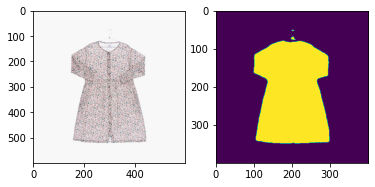

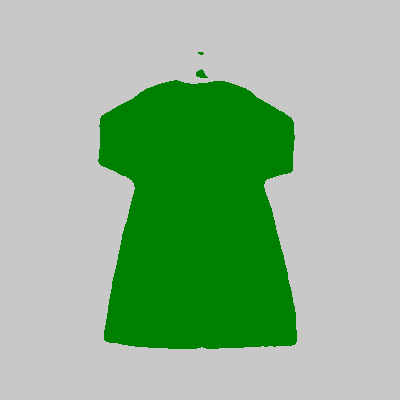

 37%|██████████████████████▋                                      | 335/900 [00:52<01:25,  6.63it/s]

torch.Size([1, 3, 400, 400])
/mnt/nas4/hm/datasets/shopping_clothes/data/data900_personby100/skirt/image/train_2500.jpg
{'background': 0, 'top': 1, 'skirt': 2, 'outer': 3, 'dress': 4, 'bottom': 5}
Counter({0: 84995, 2: 75005})


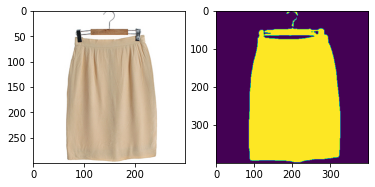

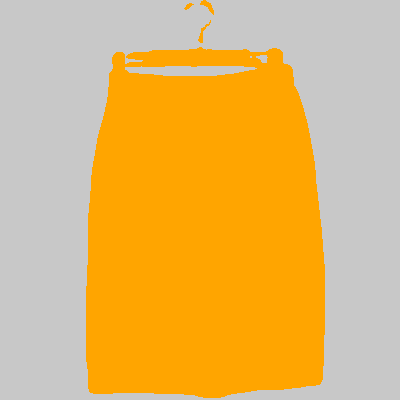

 37%|██████████████████████▊                                      | 336/900 [00:52<01:22,  6.84it/s]

torch.Size([1, 3, 400, 400])
/mnt/nas4/hm/datasets/shopping_clothes/data/data900_personby100/bottom/image/train_36.jpg
{'background': 0, 'top': 1, 'skirt': 2, 'outer': 3, 'dress': 4, 'bottom': 5}
Counter({0: 125633, 5: 34367})


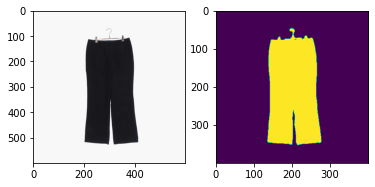

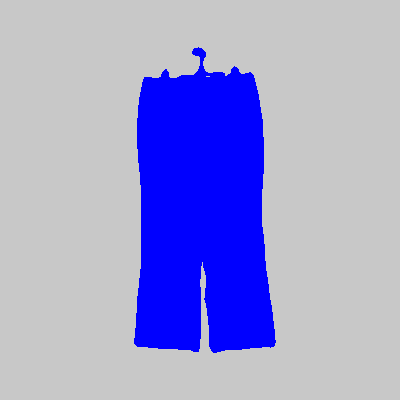

 37%|██████████████████████▊                                      | 337/900 [00:53<01:22,  6.80it/s]

torch.Size([1, 3, 400, 400])
/mnt/nas4/hm/datasets/shopping_clothes/data/data900_personby100/bottom/image/train_1802.jpg
{'background': 0, 'top': 1, 'skirt': 2, 'outer': 3, 'dress': 4, 'bottom': 5}
Counter({0: 109506, 5: 50494})


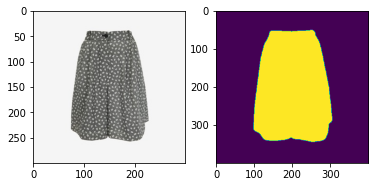

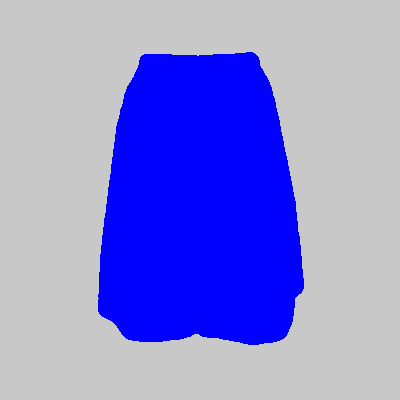

 38%|██████████████████████▉                                      | 338/900 [00:53<01:30,  6.21it/s]

torch.Size([1, 3, 400, 400])
/mnt/nas4/hm/datasets/shopping_clothes/data/data900_personby100/outer/image/train_195.jpg
{'background': 0, 'top': 1, 'skirt': 2, 'outer': 3, 'dress': 4, 'bottom': 5}
Counter({0: 82483, 3: 77517})


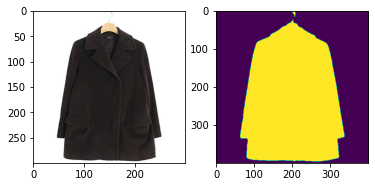

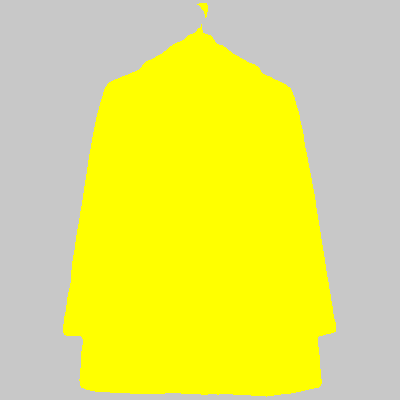

 38%|██████████████████████▉                                      | 339/900 [00:53<01:26,  6.49it/s]

torch.Size([1, 3, 400, 400])
/mnt/nas4/hm/datasets/shopping_clothes/data/data900_personby100/top/image/train_2343.jpg
{'background': 0, 'top': 1, 'skirt': 2, 'outer': 3, 'dress': 4, 'bottom': 5}
Counter({0: 85957, 1: 74043})


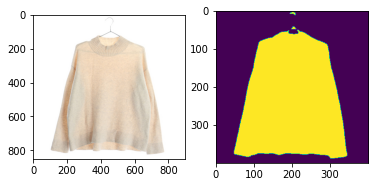

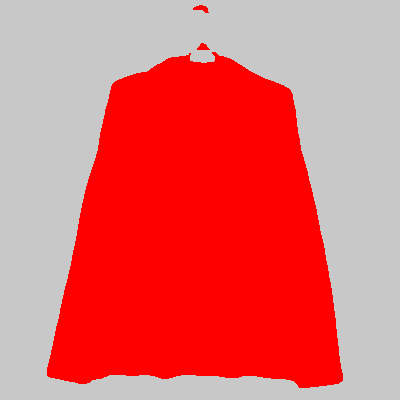

 38%|███████████████████████                                      | 340/900 [00:53<01:32,  6.07it/s]

torch.Size([1, 3, 400, 400])
/mnt/nas4/hm/datasets/shopping_clothes/data/data900_personby100/bottom/image/train_1055.jpg
{'background': 0, 'top': 1, 'skirt': 2, 'outer': 3, 'dress': 4, 'bottom': 5}
Counter({0: 123158, 5: 36842})


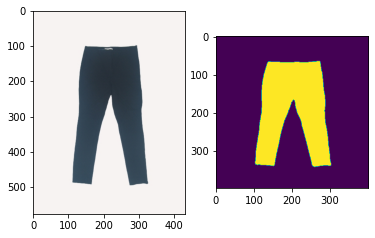

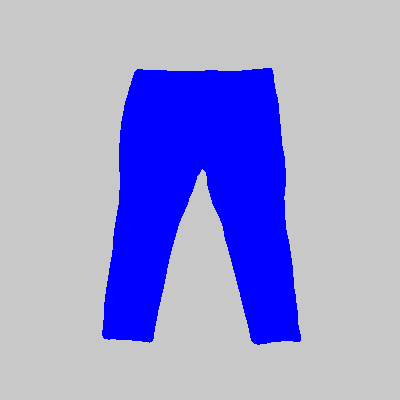

 38%|███████████████████████                                      | 341/900 [00:53<01:29,  6.27it/s]

torch.Size([1, 3, 400, 400])
/mnt/nas4/hm/datasets/shopping_clothes/data/data900_personby100/bottom/image/train_2804.jpg
{'background': 0, 'top': 1, 'skirt': 2, 'outer': 3, 'dress': 4, 'bottom': 5}
Counter({5: 107801, 0: 52199})


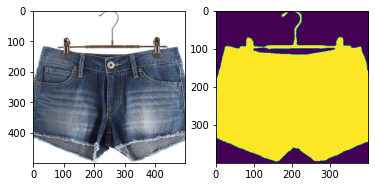

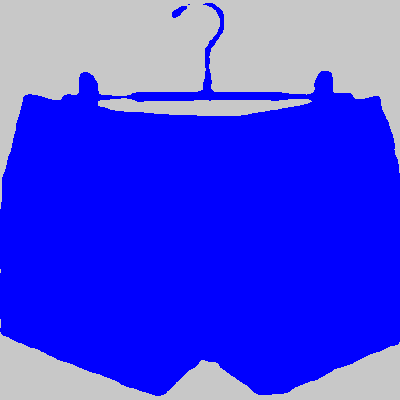

 38%|███████████████████████▏                                     | 342/900 [00:53<01:27,  6.41it/s]

torch.Size([1, 3, 400, 400])
/mnt/nas4/hm/datasets/shopping_clothes/data/data900_personby100/dress/image/train_2872.jpg
{'background': 0, 'top': 1, 'skirt': 2, 'outer': 3, 'dress': 4, 'bottom': 5}
Counter({0: 128093, 4: 31907})


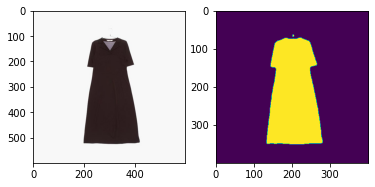

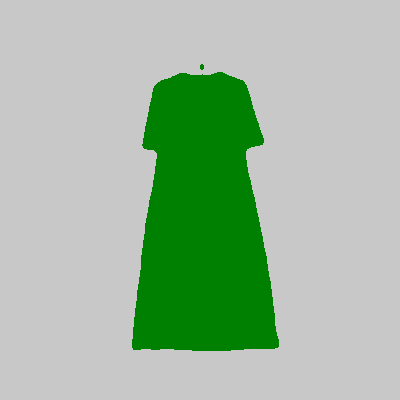

 38%|███████████████████████▏                                     | 343/900 [00:54<01:25,  6.48it/s]

torch.Size([1, 3, 400, 400])
/mnt/nas4/hm/datasets/shopping_clothes/data/data900_personby100/top/image/train_4924.jpg
{'background': 0, 'top': 1, 'skirt': 2, 'outer': 3, 'dress': 4, 'bottom': 5}
Counter({1: 98036, 0: 61964})


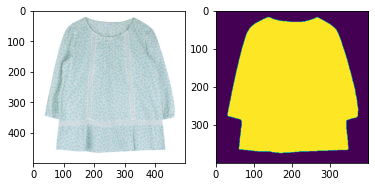

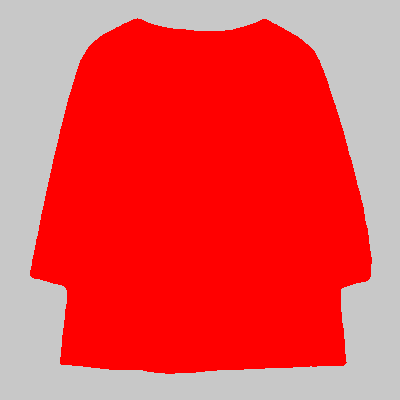

 38%|███████████████████████▎                                     | 344/900 [00:54<01:25,  6.51it/s]

torch.Size([1, 3, 400, 400])
/mnt/nas4/hm/datasets/shopping_clothes/data/data900_personby100/bottom/image/train_3713.jpg
{'background': 0, 'top': 1, 'skirt': 2, 'outer': 3, 'dress': 4, 'bottom': 5}
Counter({0: 107353, 5: 52647})


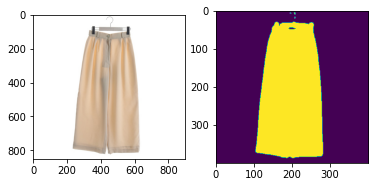

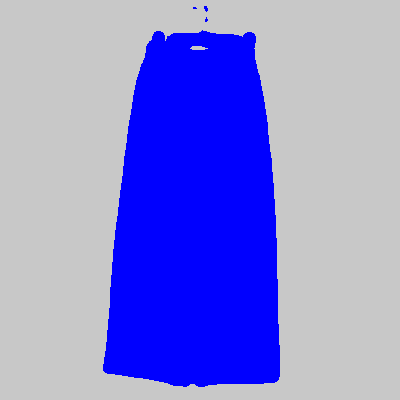

 38%|███████████████████████▍                                     | 345/900 [00:54<01:31,  6.09it/s]

torch.Size([1, 3, 400, 400])
/mnt/nas4/hm/datasets/shopping_clothes/data/data900_personby100/bottom/image/train_1334.jpg
{'background': 0, 'top': 1, 'skirt': 2, 'outer': 3, 'dress': 4, 'bottom': 5}
Counter({0: 114755, 5: 45245})


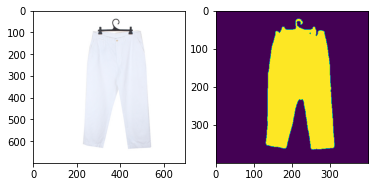

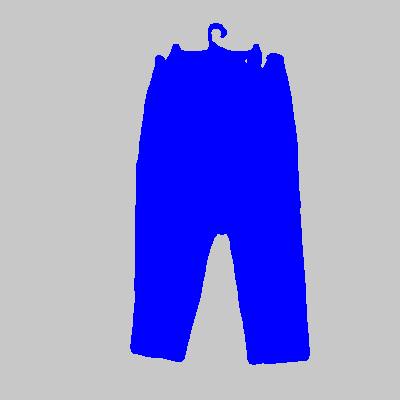

 38%|███████████████████████▍                                     | 346/900 [00:54<01:31,  6.08it/s]

torch.Size([1, 3, 400, 400])
/mnt/nas4/hm/datasets/shopping_clothes/data/data900_personby100/top/image/train_9245.jpg
{'background': 0, 'top': 1, 'skirt': 2, 'outer': 3, 'dress': 4, 'bottom': 5}
Counter({0: 102480, 1: 57520})


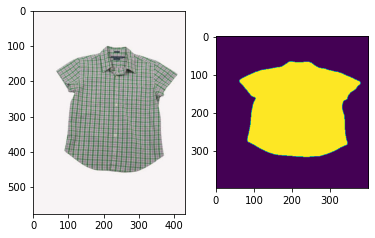

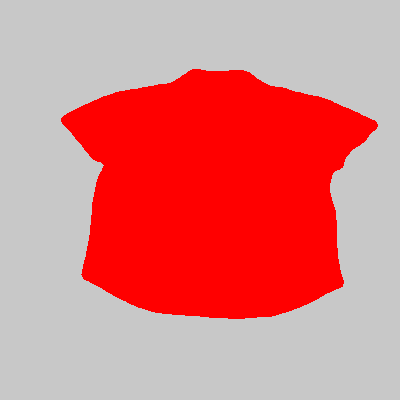

 39%|███████████████████████▌                                     | 347/900 [00:54<01:28,  6.26it/s]

torch.Size([1, 3, 400, 400])
/mnt/nas4/hm/datasets/shopping_clothes/data/data900_personby100/bottom/image/train_998.jpg
{'background': 0, 'top': 1, 'skirt': 2, 'outer': 3, 'dress': 4, 'bottom': 5}
Counter({0: 104173, 5: 55827})


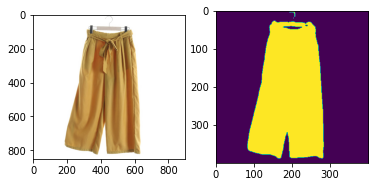

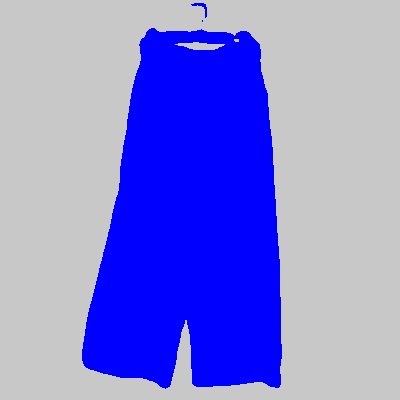

 39%|███████████████████████▌                                     | 348/900 [00:54<01:32,  5.99it/s]

torch.Size([1, 3, 400, 400])
/mnt/nas4/hm/datasets/shopping_clothes/data/data900_personby100/outer/image/train_5695.jpg
{'background': 0, 'top': 1, 'skirt': 2, 'outer': 3, 'dress': 4, 'bottom': 5}
Counter({0: 101615, 3: 58385})


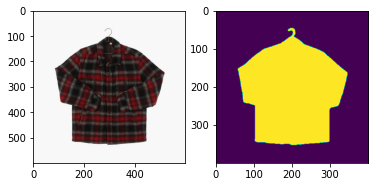

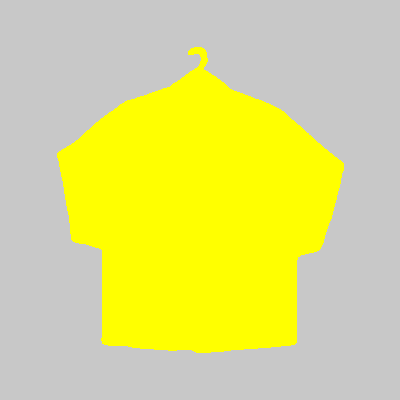

 39%|███████████████████████▋                                     | 349/900 [00:55<01:39,  5.55it/s]

torch.Size([1, 3, 400, 400])
/mnt/nas4/hm/datasets/shopping_clothes/data/data900_personby100/bottom/image/train_1456.jpg
{'background': 0, 'top': 1, 'skirt': 2, 'outer': 3, 'dress': 4, 'bottom': 5}
Counter({0: 106158, 5: 53842})


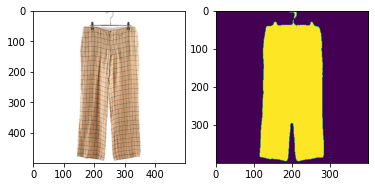

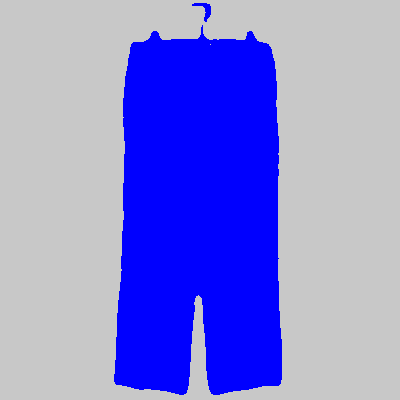

 39%|███████████████████████▋                                     | 350/900 [00:55<01:33,  5.88it/s]

torch.Size([1, 3, 400, 400])
/mnt/nas4/hm/datasets/shopping_clothes/data/data900_personby100/skirt/image/train_2651.jpg
{'background': 0, 'top': 1, 'skirt': 2, 'outer': 3, 'dress': 4, 'bottom': 5}
Counter({0: 98737, 2: 61263})


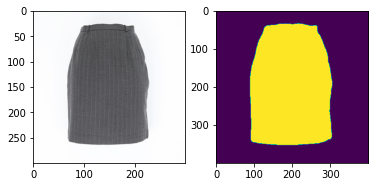

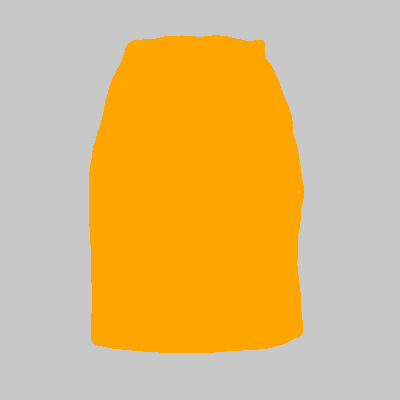

 39%|███████████████████████▊                                     | 351/900 [00:55<01:27,  6.26it/s]

torch.Size([1, 3, 400, 400])
/mnt/nas4/hm/datasets/shopping_clothes/data/data900_personby100/skirt/image/train_2499.jpg
{'background': 0, 'top': 1, 'skirt': 2, 'outer': 3, 'dress': 4, 'bottom': 5}
Counter({0: 84062, 2: 75938})


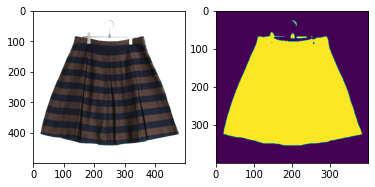

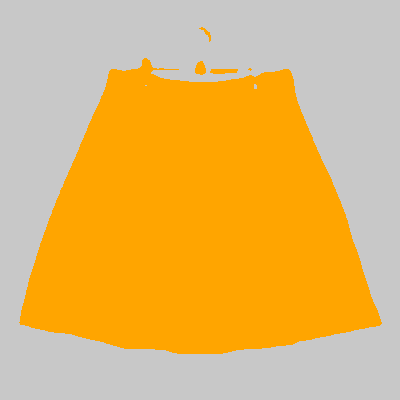

 39%|███████████████████████▊                                     | 352/900 [00:55<01:25,  6.39it/s]

torch.Size([1, 3, 400, 400])
/mnt/nas4/hm/datasets/shopping_clothes/data/data900_personby100/dress/image/train_333.jpg
{'background': 0, 'top': 1, 'skirt': 2, 'outer': 3, 'dress': 4, 'bottom': 5}
Counter({0: 91471, 4: 68529})


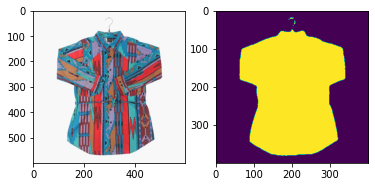

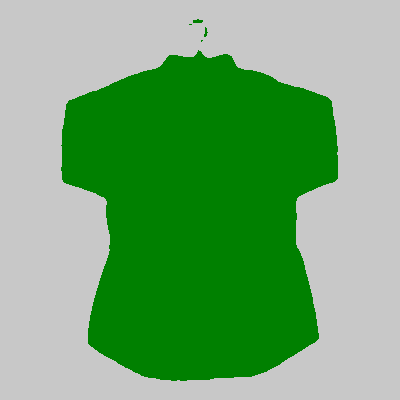

 39%|███████████████████████▉                                     | 353/900 [00:55<01:24,  6.46it/s]

torch.Size([1, 3, 400, 400])
/mnt/nas4/hm/datasets/shopping_clothes/data/data900_personby100/top/image/train_1920.jpg
{'background': 0, 'top': 1, 'skirt': 2, 'outer': 3, 'dress': 4, 'bottom': 5}
Counter({1: 81690, 0: 78310})


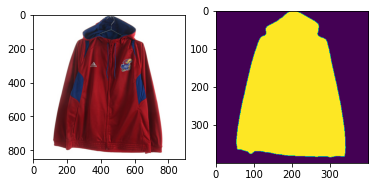

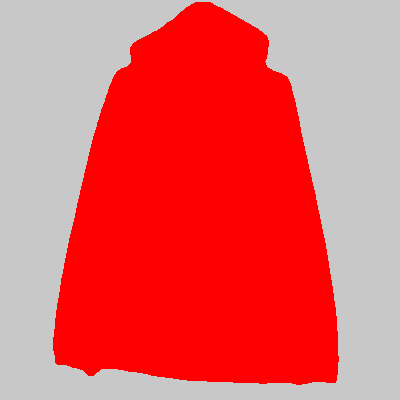

 39%|███████████████████████▉                                     | 354/900 [00:55<01:30,  6.03it/s]

torch.Size([1, 3, 400, 400])
/mnt/nas4/hm/datasets/shopping_clothes/data/data900_personby100/skirt/image/train_2426.jpg
{'background': 0, 'top': 1, 'skirt': 2, 'outer': 3, 'dress': 4, 'bottom': 5}
Counter({0: 87801, 2: 72199})


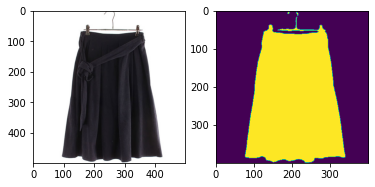

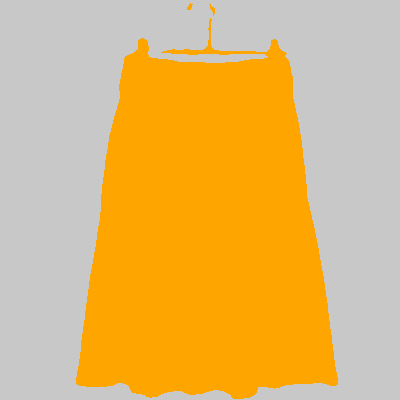

 39%|████████████████████████                                     | 355/900 [00:55<01:27,  6.26it/s]

torch.Size([1, 3, 400, 400])
/mnt/nas4/hm/datasets/shopping_clothes/data/data900_personby100/skirt/image/train_2019.jpg
{'background': 0, 'top': 1, 'skirt': 2, 'outer': 3, 'dress': 4, 'bottom': 5}
Counter({0: 101075, 2: 58925})


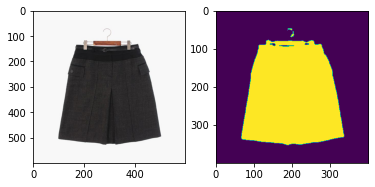

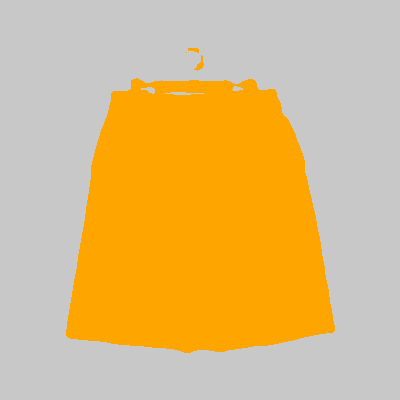

 40%|████████████████████████▏                                    | 356/900 [00:56<01:25,  6.36it/s]

torch.Size([1, 3, 400, 400])
/mnt/nas4/hm/datasets/shopping_clothes/data/data900_personby100/skirt/image/train_189.jpg
{'background': 0, 'top': 1, 'skirt': 2, 'outer': 3, 'dress': 4, 'bottom': 5}
Counter({0: 81469, 2: 78531})


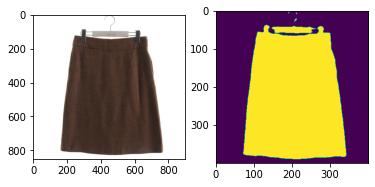

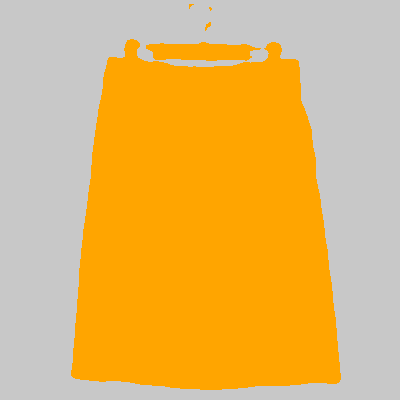

 40%|████████████████████████▏                                    | 357/900 [00:56<01:30,  5.99it/s]

torch.Size([1, 3, 400, 400])
/mnt/nas4/hm/datasets/shopping_clothes/data/data900_personby100/outer/image/train_2153.jpg
{'background': 0, 'top': 1, 'skirt': 2, 'outer': 3, 'dress': 4, 'bottom': 5}
Counter({3: 107218, 0: 52779, 2: 3})


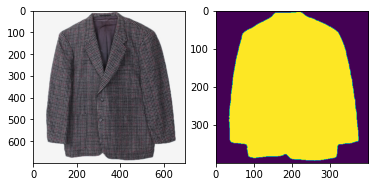

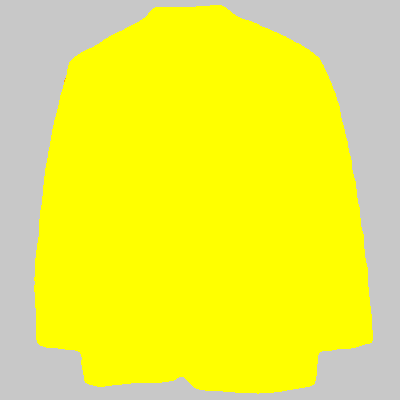

 40%|████████████████████████▎                                    | 358/900 [00:56<01:30,  5.96it/s]

torch.Size([1, 3, 400, 400])
/mnt/nas4/hm/datasets/shopping_clothes/data/data900_personby100/skirt/image/train_2339.jpg
{'background': 0, 'top': 1, 'skirt': 2, 'outer': 3, 'dress': 4, 'bottom': 5}
Counter({0: 109875, 2: 50125})


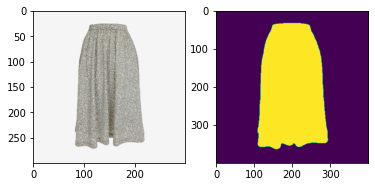

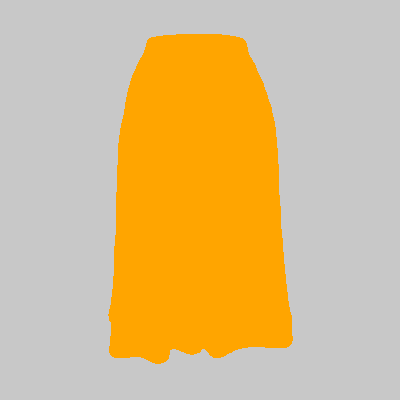

 40%|████████████████████████▎                                    | 359/900 [00:56<01:25,  6.34it/s]

torch.Size([1, 3, 400, 400])
/mnt/nas4/hm/datasets/shopping_clothes/data/data900_personby100/outer/image/train_5447.jpg
{'background': 0, 'top': 1, 'skirt': 2, 'outer': 3, 'dress': 4, 'bottom': 5}
Counter({0: 104709, 3: 55291})


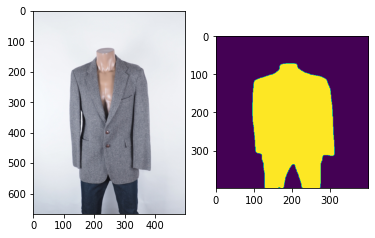

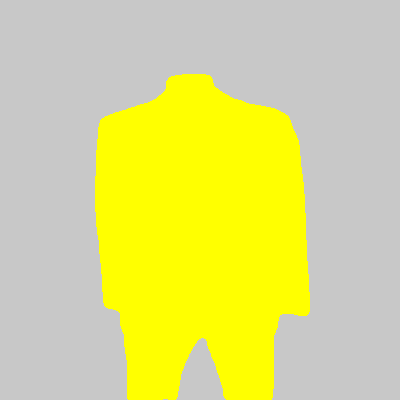

 40%|████████████████████████▍                                    | 360/900 [00:56<01:36,  5.60it/s]

torch.Size([1, 3, 400, 400])
/mnt/nas4/hm/datasets/shopping_clothes/data/data900_personby100/skirt/image/train_785.jpg
{'background': 0, 'top': 1, 'skirt': 2, 'outer': 3, 'dress': 4, 'bottom': 5}
Counter({0: 92345, 2: 67655})


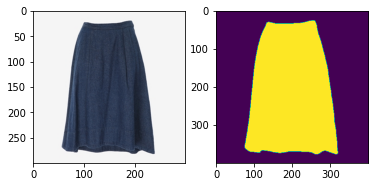

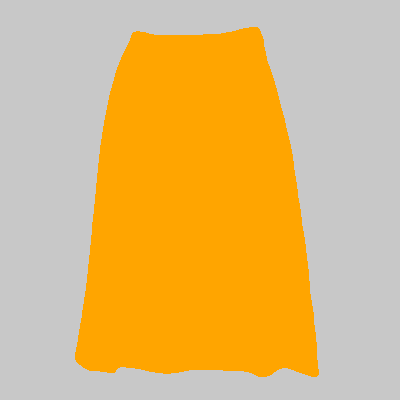

 40%|████████████████████████▍                                    | 361/900 [00:56<01:29,  6.04it/s]

torch.Size([1, 3, 400, 400])
/mnt/nas4/hm/datasets/shopping_clothes/data/data900_personby100/top/image/train_7894.jpg
{'background': 0, 'top': 1, 'skirt': 2, 'outer': 3, 'dress': 4, 'bottom': 5}
Counter({0: 98631, 1: 61369})


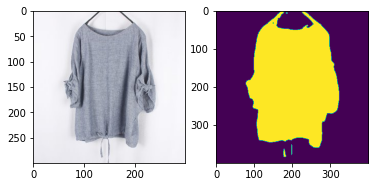

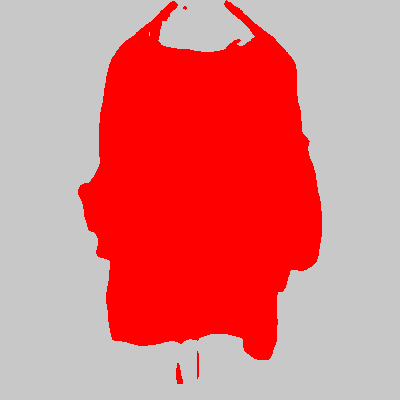

 40%|████████████████████████▌                                    | 362/900 [00:57<01:24,  6.39it/s]

torch.Size([1, 3, 400, 400])
/mnt/nas4/hm/datasets/shopping_clothes/data/data900_personby100/dress/image/train_3429.jpg
{'background': 0, 'top': 1, 'skirt': 2, 'outer': 3, 'dress': 4, 'bottom': 5}
Counter({0: 118669, 4: 41331})


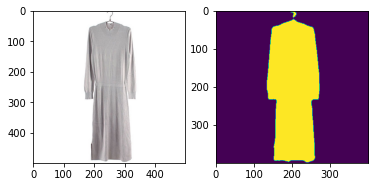

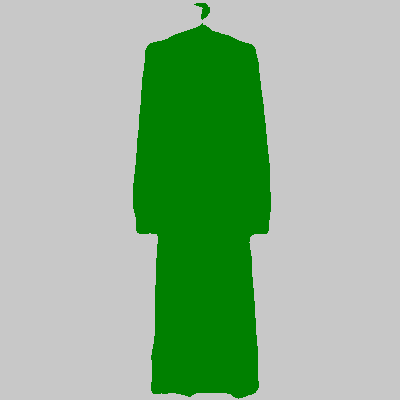

 40%|████████████████████████▌                                    | 363/900 [00:57<01:22,  6.54it/s]

torch.Size([1, 3, 400, 400])
/mnt/nas4/hm/datasets/shopping_clothes/data/data900_personby100/outer/image/train_11258.jpg
{'background': 0, 'top': 1, 'skirt': 2, 'outer': 3, 'dress': 4, 'bottom': 5}
Counter({3: 86023, 0: 73977})


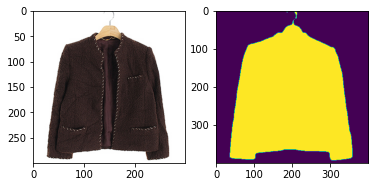

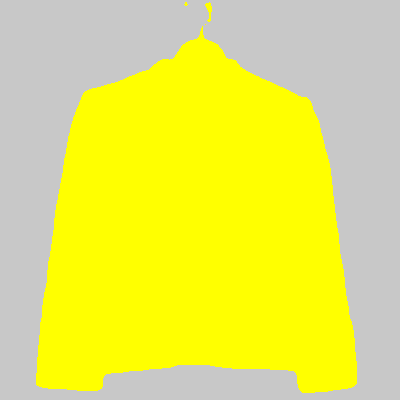

 40%|████████████████████████▋                                    | 364/900 [00:57<01:19,  6.76it/s]

torch.Size([1, 3, 400, 400])
/mnt/nas4/hm/datasets/shopping_clothes/data/data900_personby100/dress/image/train_2581.jpg
{'background': 0, 'top': 1, 'skirt': 2, 'outer': 3, 'dress': 4, 'bottom': 5}
Counter({0: 117675, 4: 42325})


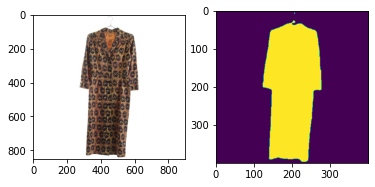

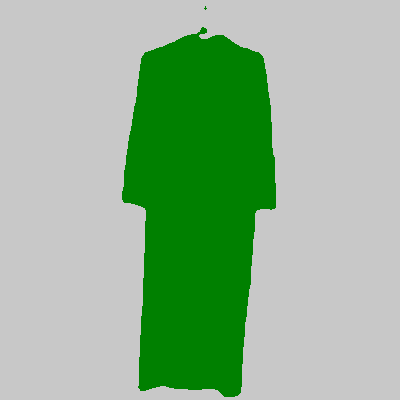

 41%|████████████████████████▋                                    | 365/900 [00:57<01:24,  6.30it/s]

torch.Size([1, 3, 400, 400])
/mnt/nas4/hm/datasets/shopping_clothes/data/data900_personby100/dress/image/train_531.jpg
{'background': 0, 'top': 1, 'skirt': 2, 'outer': 3, 'dress': 4, 'bottom': 5}
Counter({0: 112710, 4: 47290})


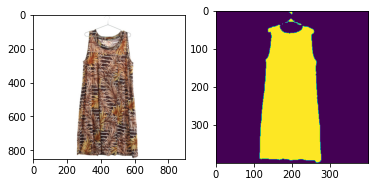

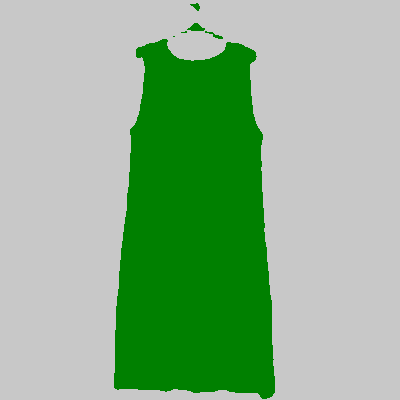

 41%|████████████████████████▊                                    | 366/900 [00:57<01:28,  6.02it/s]

torch.Size([1, 3, 400, 400])
/mnt/nas4/hm/datasets/shopping_clothes/data/data900_personby100/outer/image/train_10540.jpg
{'background': 0, 'top': 1, 'skirt': 2, 'outer': 3, 'dress': 4, 'bottom': 5}
Counter({0: 119424, 3: 40576})


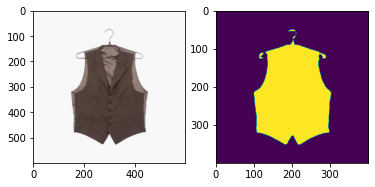

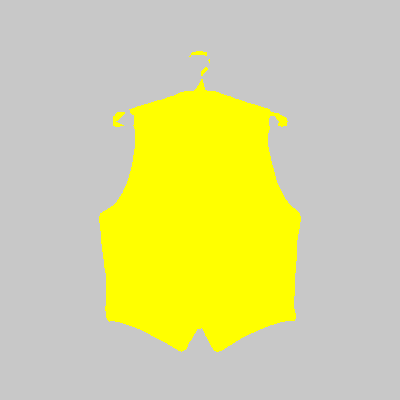

 41%|████████████████████████▊                                    | 367/900 [00:57<01:26,  6.18it/s]

torch.Size([1, 3, 400, 400])
/mnt/nas4/hm/datasets/shopping_clothes/data/data900_personby100/top/image/train_4663.jpg
{'background': 0, 'top': 1, 'skirt': 2, 'outer': 3, 'dress': 4, 'bottom': 5}
Counter({0: 100220, 1: 59780})


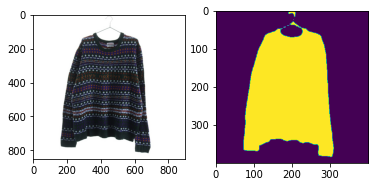

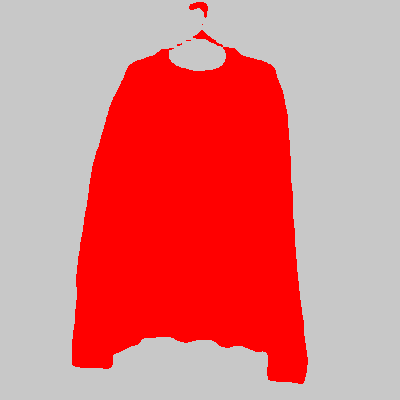

 41%|████████████████████████▉                                    | 368/900 [00:58<01:31,  5.83it/s]

torch.Size([1, 3, 400, 400])
/mnt/nas4/hm/datasets/shopping_clothes/data/data900_personby100/skirt/image/train_732.jpg
{'background': 0, 'top': 1, 'skirt': 2, 'outer': 3, 'dress': 4, 'bottom': 5}
Counter({0: 101642, 2: 58358})


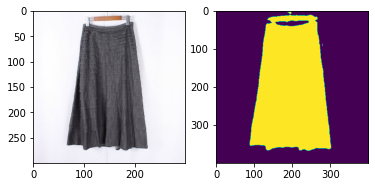

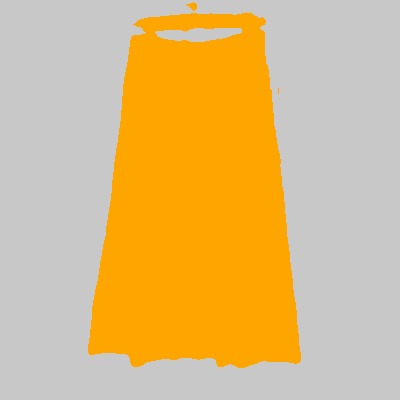

 41%|█████████████████████████                                    | 369/900 [00:58<01:25,  6.23it/s]

torch.Size([1, 3, 400, 400])
/mnt/nas4/hm/datasets/shopping_clothes/data/data900_personby100/skirt/image/train_2790.jpg
{'background': 0, 'top': 1, 'skirt': 2, 'outer': 3, 'dress': 4, 'bottom': 5}
Counter({0: 81376, 2: 78624})


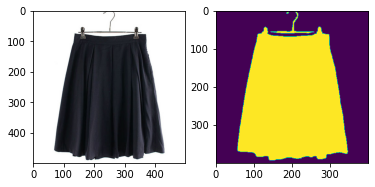

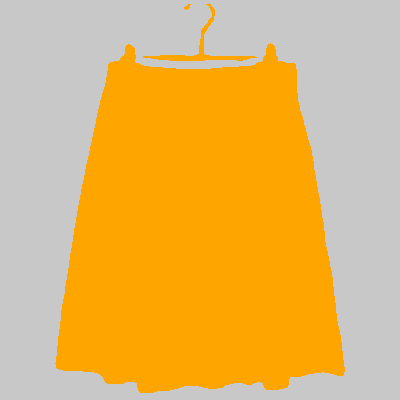

 41%|█████████████████████████                                    | 370/900 [00:58<01:22,  6.41it/s]

torch.Size([1, 3, 400, 400])
/mnt/nas4/hm/datasets/shopping_clothes/data/data900_personby100/bottom/image/train_2403.jpg
{'background': 0, 'top': 1, 'skirt': 2, 'outer': 3, 'dress': 4, 'bottom': 5}
Counter({0: 111000, 5: 49000})


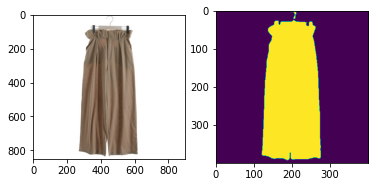

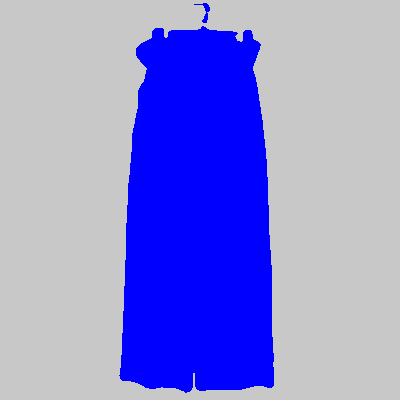

 41%|█████████████████████████▏                                   | 371/900 [00:58<01:36,  5.48it/s]

torch.Size([1, 3, 400, 400])
/mnt/nas4/hm/datasets/shopping_clothes/data/data900_personby100/top/image/train_17768.jpg
{'background': 0, 'top': 1, 'skirt': 2, 'outer': 3, 'dress': 4, 'bottom': 5}
Counter({0: 82913, 1: 77087})


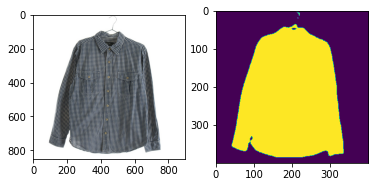

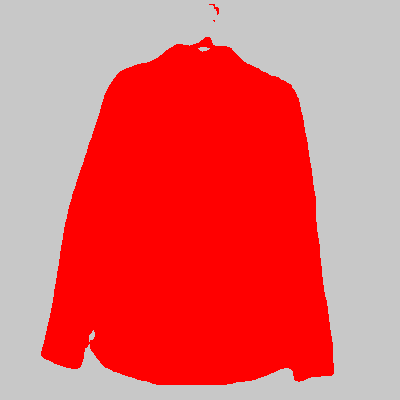

 41%|█████████████████████████▏                                   | 372/900 [00:58<01:36,  5.45it/s]

torch.Size([1, 3, 400, 400])
/mnt/nas4/hm/datasets/shopping_clothes/data/data900_personby100/dress/image/train_3544.jpg
{'background': 0, 'top': 1, 'skirt': 2, 'outer': 3, 'dress': 4, 'bottom': 5}
Counter({0: 121289, 4: 38711})


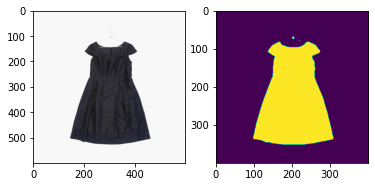

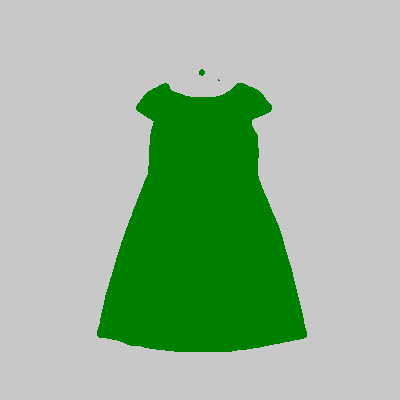

 41%|█████████████████████████▎                                   | 373/900 [00:58<01:31,  5.75it/s]

torch.Size([1, 3, 400, 400])
/mnt/nas4/hm/datasets/shopping_clothes/data/data900_personby100/outer/image/train_2729.jpg
{'background': 0, 'top': 1, 'skirt': 2, 'outer': 3, 'dress': 4, 'bottom': 5}
Counter({0: 83758, 3: 76242})


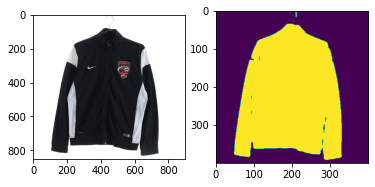

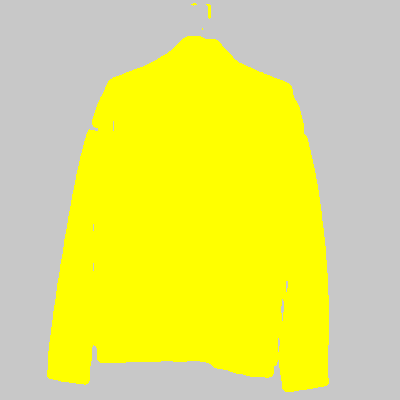

 42%|█████████████████████████▎                                   | 374/900 [00:59<01:33,  5.61it/s]

torch.Size([1, 3, 400, 400])
/mnt/nas4/hm/datasets/shopping_clothes/data/data900_personby100/skirt/image/train_2220.jpg
{'background': 0, 'top': 1, 'skirt': 2, 'outer': 3, 'dress': 4, 'bottom': 5}
Counter({0: 93220, 2: 66780})


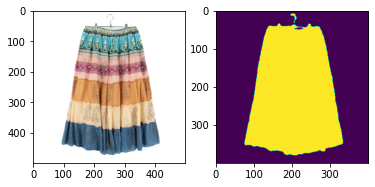

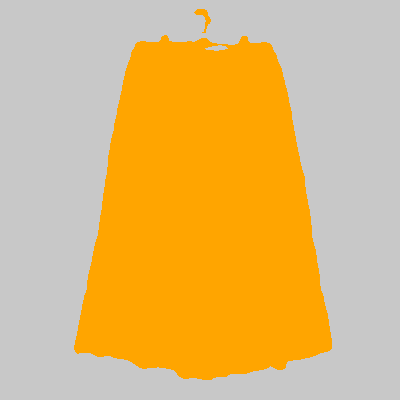

 42%|█████████████████████████▍                                   | 375/900 [00:59<01:29,  5.88it/s]

torch.Size([1, 3, 400, 400])
/mnt/nas4/hm/datasets/shopping_clothes/data/data900_personby100/dress/image/train_3176.jpg
{'background': 0, 'top': 1, 'skirt': 2, 'outer': 3, 'dress': 4, 'bottom': 5}
Counter({0: 118060, 4: 41940})


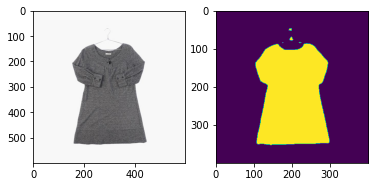

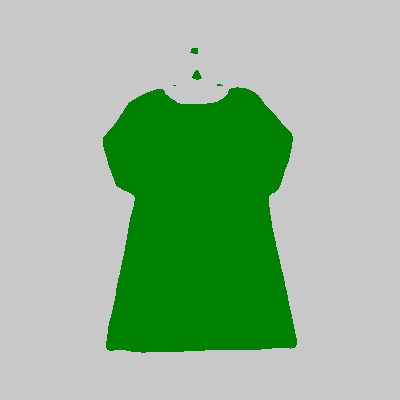

 42%|█████████████████████████▍                                   | 376/900 [00:59<01:26,  6.08it/s]

torch.Size([1, 3, 400, 400])
/mnt/nas4/hm/datasets/shopping_clothes/data/data900_personby100/outer/image/train_6699.jpg
{'background': 0, 'top': 1, 'skirt': 2, 'outer': 3, 'dress': 4, 'bottom': 5}
Counter({3: 105002, 0: 54998})


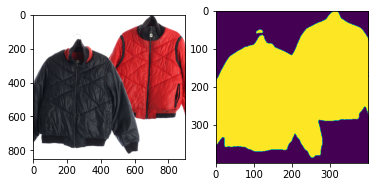

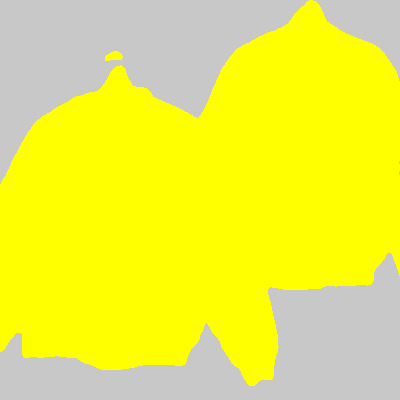

 42%|█████████████████████████▌                                   | 377/900 [00:59<01:30,  5.80it/s]

torch.Size([1, 3, 400, 400])
/mnt/nas4/hm/datasets/shopping_clothes/data/data900_personby100/bottom/image/train_2558.jpg
{'background': 0, 'top': 1, 'skirt': 2, 'outer': 3, 'dress': 4, 'bottom': 5}
Counter({0: 94898, 5: 65102})


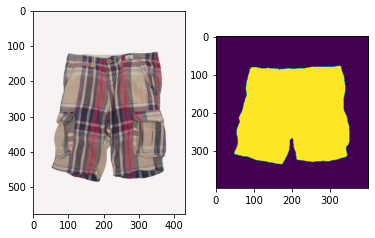

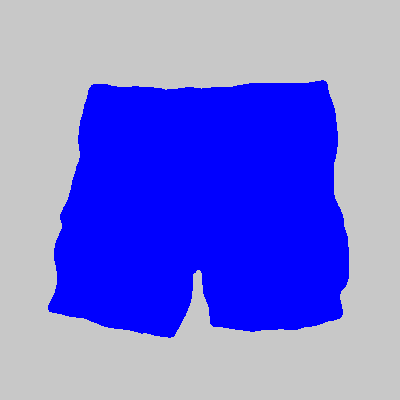

 42%|█████████████████████████▌                                   | 378/900 [00:59<01:26,  6.06it/s]

torch.Size([1, 3, 400, 400])
/mnt/nas4/hm/datasets/shopping_clothes/data/data900_personby100/top/image/train_2357.jpg
{'background': 0, 'top': 1, 'skirt': 2, 'outer': 3, 'dress': 4, 'bottom': 5}
Counter({0: 113675, 1: 46325})


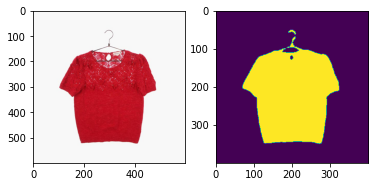

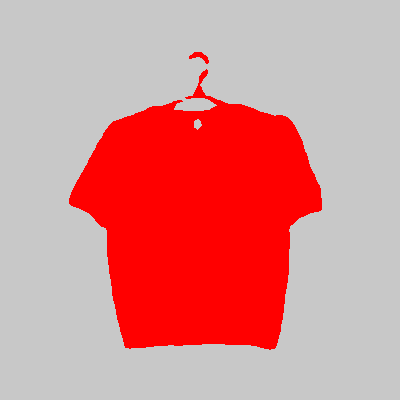

 42%|█████████████████████████▋                                   | 379/900 [00:59<01:23,  6.23it/s]

torch.Size([1, 3, 400, 400])
/mnt/nas4/hm/datasets/shopping_clothes/data/data900_personby100/outer/image/train_10513.jpg
{'background': 0, 'top': 1, 'skirt': 2, 'outer': 3, 'dress': 4, 'bottom': 5}
Counter({3: 80731, 0: 79269})


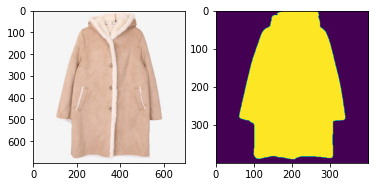

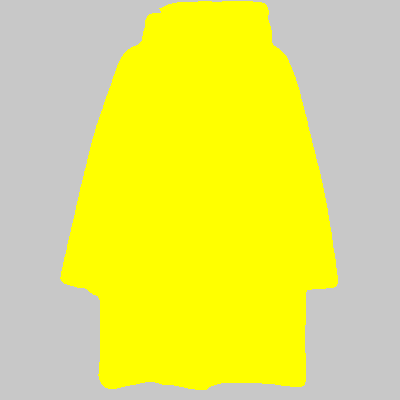

 42%|█████████████████████████▊                                   | 380/900 [01:00<01:24,  6.18it/s]

torch.Size([1, 3, 400, 400])
/mnt/nas4/hm/datasets/shopping_clothes/data/data900_personby100/bottom/image/train_1977.jpg
{'background': 0, 'top': 1, 'skirt': 2, 'outer': 3, 'dress': 4, 'bottom': 5}
Counter({0: 128186, 5: 31814})


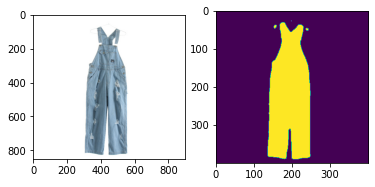

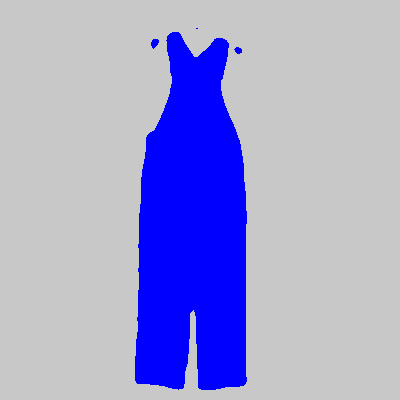

 42%|█████████████████████████▊                                   | 381/900 [01:00<01:27,  5.96it/s]

torch.Size([1, 3, 400, 400])
/mnt/nas4/hm/datasets/shopping_clothes/data/data900_personby100/bottom/image/train_3110.jpg
{'background': 0, 'top': 1, 'skirt': 2, 'outer': 3, 'dress': 4, 'bottom': 5}
Counter({0: 98436, 5: 61564})


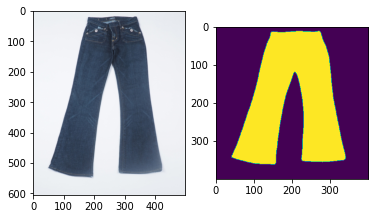

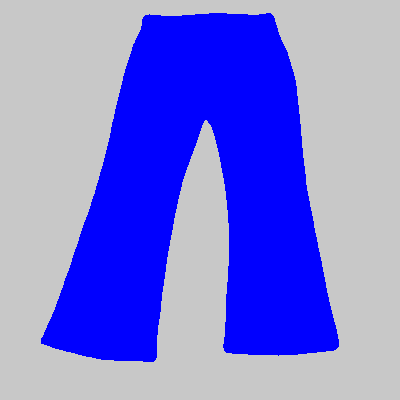

 42%|█████████████████████████▉                                   | 382/900 [01:00<01:34,  5.47it/s]

torch.Size([1, 3, 400, 400])
/mnt/nas4/hm/datasets/shopping_clothes/data/data900_personby100/bottom/image/train_2847.jpg
{'background': 0, 'top': 1, 'skirt': 2, 'outer': 3, 'dress': 4, 'bottom': 5}
Counter({0: 112099, 5: 47901})


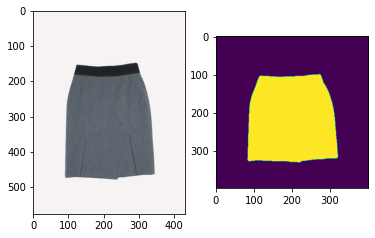

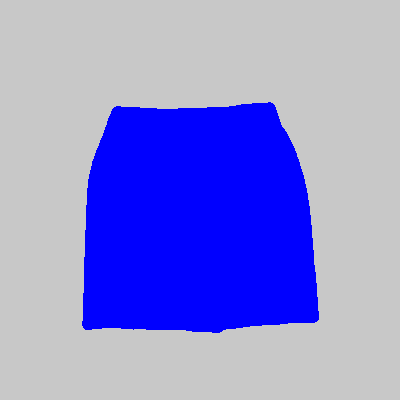

 43%|█████████████████████████▉                                   | 383/900 [01:00<01:29,  5.81it/s]

torch.Size([1, 3, 400, 400])
/mnt/nas4/hm/datasets/shopping_clothes/data/data900_personby100/dress/image/train_1344.jpg
{'background': 0, 'top': 1, 'skirt': 2, 'outer': 3, 'dress': 4, 'bottom': 5}
Counter({0: 129082, 4: 30918})


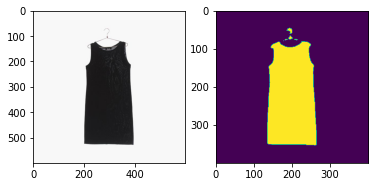

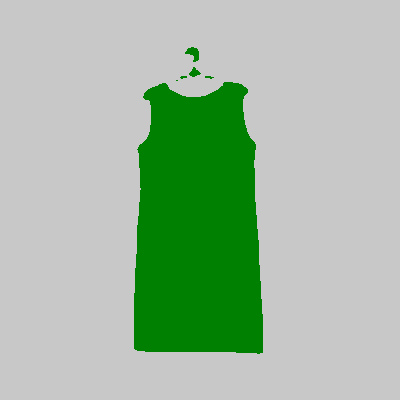

 43%|██████████████████████████                                   | 384/900 [01:00<01:25,  6.02it/s]

torch.Size([1, 3, 400, 400])
/mnt/nas4/hm/datasets/shopping_clothes/data/data900_personby100/top/image/train_9783.jpg
{'background': 0, 'top': 1, 'skirt': 2, 'outer': 3, 'dress': 4, 'bottom': 5}
Counter({0: 93176, 1: 66824})


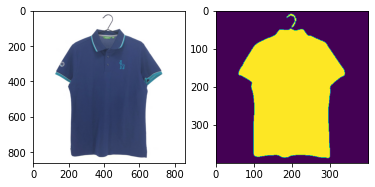

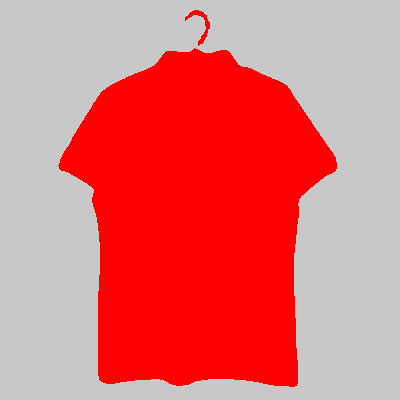

 43%|██████████████████████████                                   | 385/900 [01:01<01:27,  5.86it/s]

torch.Size([1, 3, 400, 400])
/mnt/nas4/hm/datasets/shopping_clothes/data/data900_personby100/dress/image/train_2456.jpg
{'background': 0, 'top': 1, 'skirt': 2, 'outer': 3, 'dress': 4, 'bottom': 5}
Counter({0: 113282, 4: 46718})


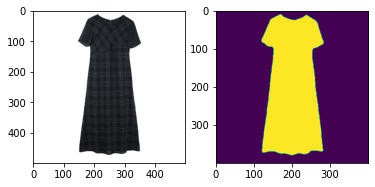

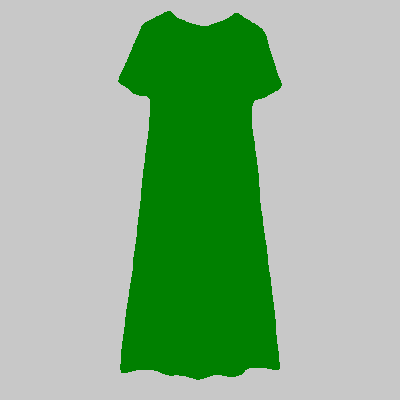

 43%|██████████████████████████▏                                  | 386/900 [01:01<01:23,  6.13it/s]

torch.Size([1, 3, 400, 400])
/mnt/nas4/hm/datasets/shopping_clothes/data/data900_personby100/bottom/image/train_1058.jpg
{'background': 0, 'top': 1, 'skirt': 2, 'outer': 3, 'dress': 4, 'bottom': 5}
Counter({0: 125841, 5: 34159})


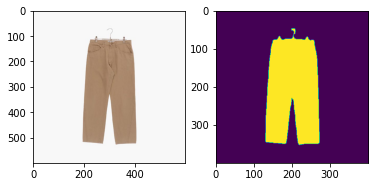

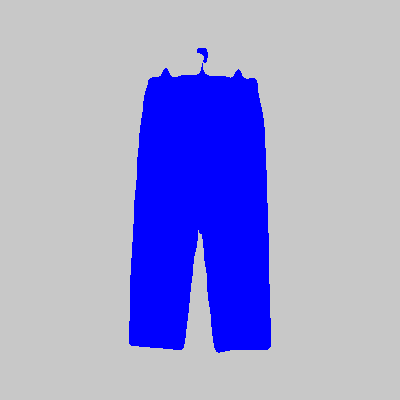

 43%|██████████████████████████▏                                  | 387/900 [01:01<01:21,  6.28it/s]

torch.Size([1, 3, 400, 400])
/mnt/nas4/hm/datasets/shopping_clothes/data/data900_personby100/top/image/train_13340.jpg
{'background': 0, 'top': 1, 'skirt': 2, 'outer': 3, 'dress': 4, 'bottom': 5}
Counter({0: 96119, 1: 63881})


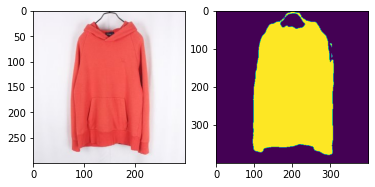

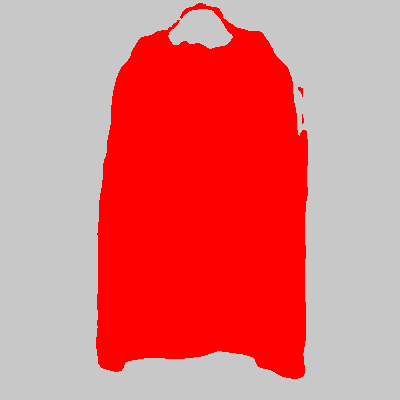

 43%|██████████████████████████▎                                  | 388/900 [01:01<01:18,  6.56it/s]

torch.Size([1, 3, 400, 400])
/mnt/nas4/hm/datasets/shopping_clothes/data/data900_personby100/top/image/train_15383.jpg
{'background': 0, 'top': 1, 'skirt': 2, 'outer': 3, 'dress': 4, 'bottom': 5}
Counter({0: 106369, 1: 53631})


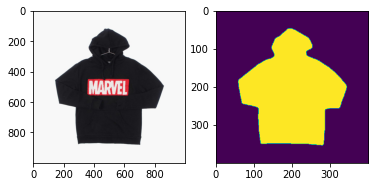

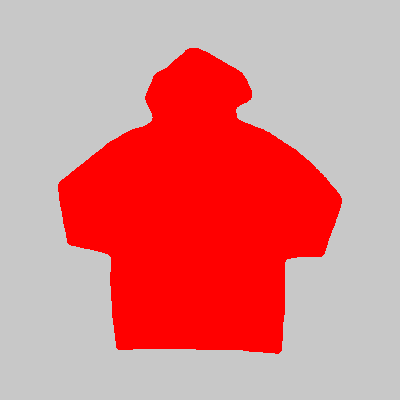

 43%|██████████████████████████▎                                  | 389/900 [01:01<01:24,  6.05it/s]

torch.Size([1, 3, 400, 400])
/mnt/nas4/hm/datasets/shopping_clothes/data/data900_personby100/dress/image/train_568.jpg
{'background': 0, 'top': 1, 'skirt': 2, 'outer': 3, 'dress': 4, 'bottom': 5}
Counter({0: 110620, 4: 49380})


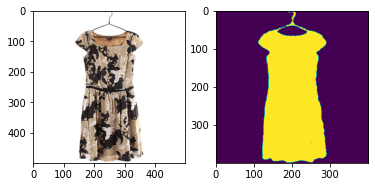

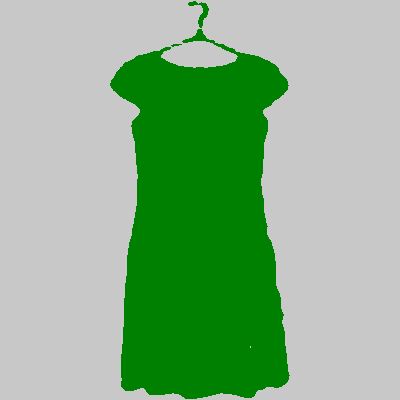

 43%|██████████████████████████▍                                  | 390/900 [01:01<01:20,  6.30it/s]

torch.Size([1, 3, 400, 400])
/mnt/nas4/hm/datasets/shopping_clothes/data/data900_personby100/outer/image/train_3302.jpg
{'background': 0, 'top': 1, 'skirt': 2, 'outer': 3, 'dress': 4, 'bottom': 5}
Counter({0: 82421, 3: 77579})


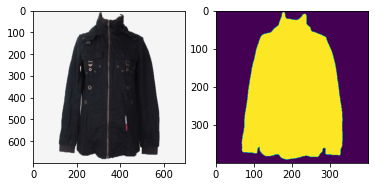

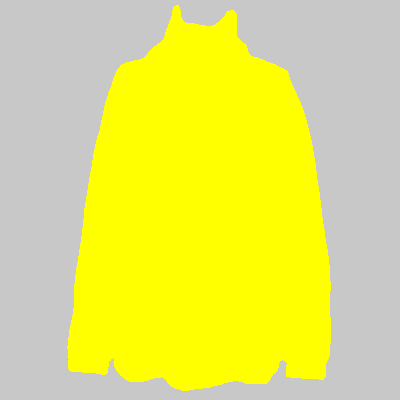

 43%|██████████████████████████▌                                  | 391/900 [01:01<01:22,  6.17it/s]

torch.Size([1, 3, 400, 400])
/mnt/nas4/hm/datasets/shopping_clothes/data/data900_personby100/dress/image/train_933.jpg
{'background': 0, 'top': 1, 'skirt': 2, 'outer': 3, 'dress': 4, 'bottom': 5}
Counter({0: 110027, 4: 49973})


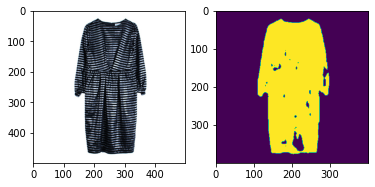

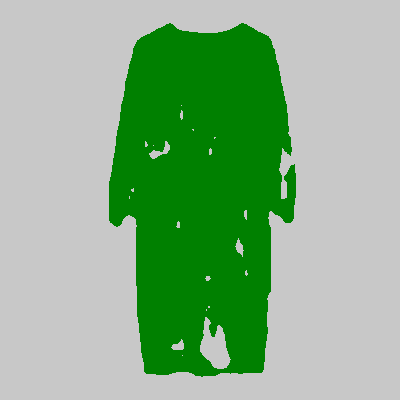

 44%|██████████████████████████▌                                  | 392/900 [01:02<01:19,  6.37it/s]

torch.Size([1, 3, 400, 400])
/mnt/nas4/hm/datasets/shopping_clothes/data/data900_personby100/bottom/image/train_274.jpg
{'background': 0, 'top': 1, 'skirt': 2, 'outer': 3, 'dress': 4, 'bottom': 5}
Counter({0: 112252, 5: 47748})


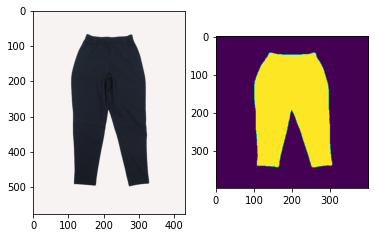

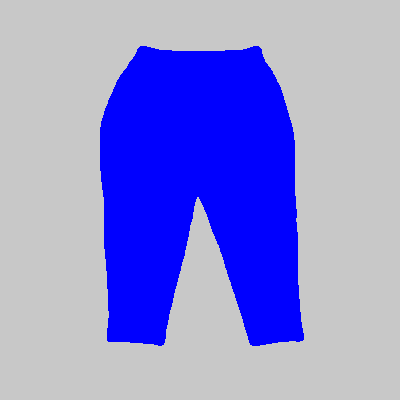

 44%|██████████████████████████▋                                  | 393/900 [01:02<01:27,  5.81it/s]

torch.Size([1, 3, 400, 400])
/mnt/nas4/hm/datasets/shopping_clothes/data/data900_personby100/dress/image/train_1314.jpg
{'background': 0, 'top': 1, 'skirt': 2, 'outer': 3, 'dress': 4, 'bottom': 5}
Counter({0: 110511, 4: 49489})


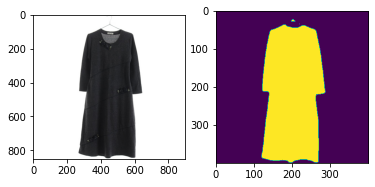

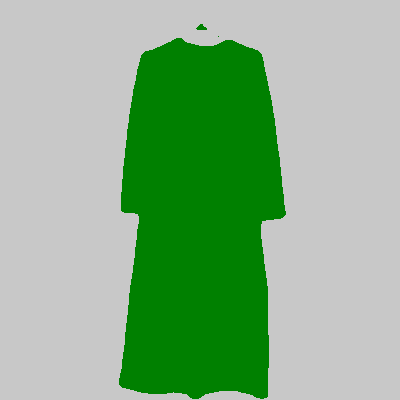

 44%|██████████████████████████▋                                  | 394/900 [01:02<01:29,  5.63it/s]

torch.Size([1, 3, 400, 400])
/mnt/nas4/hm/datasets/shopping_clothes/data/data900_personby100/top/image/train_13798.jpg
{'background': 0, 'top': 1, 'skirt': 2, 'outer': 3, 'dress': 4, 'bottom': 5}
Counter({0: 107491, 1: 52509})


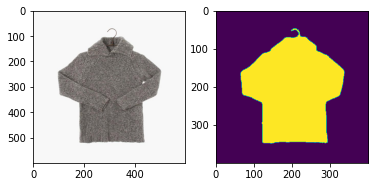

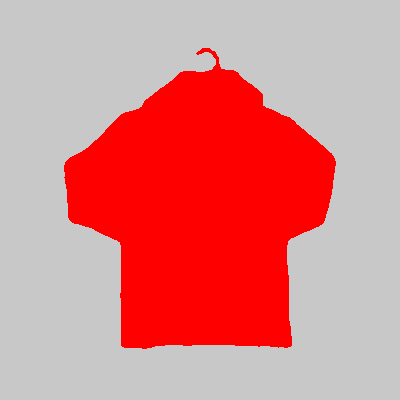

 44%|██████████████████████████▊                                  | 395/900 [01:02<01:25,  5.90it/s]

torch.Size([1, 3, 400, 400])
/mnt/nas4/hm/datasets/shopping_clothes/data/data900_personby100/dress/image/train_2814.jpg
{'background': 0, 'top': 1, 'skirt': 2, 'outer': 3, 'dress': 4, 'bottom': 5}
Counter({0: 125019, 4: 34981})


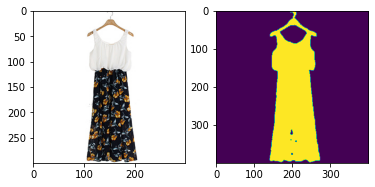

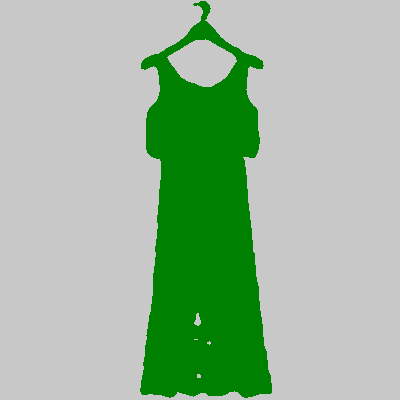

 44%|██████████████████████████▊                                  | 396/900 [01:02<01:19,  6.31it/s]

torch.Size([1, 3, 400, 400])
/mnt/nas4/hm/datasets/shopping_clothes/data/data900_personby100/skirt/image/train_2740.jpg
{'background': 0, 'top': 1, 'skirt': 2, 'outer': 3, 'dress': 4, 'bottom': 5}
Counter({0: 86307, 2: 73693})


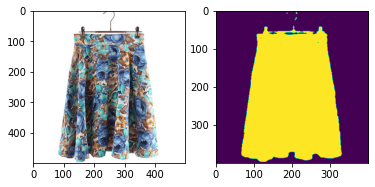

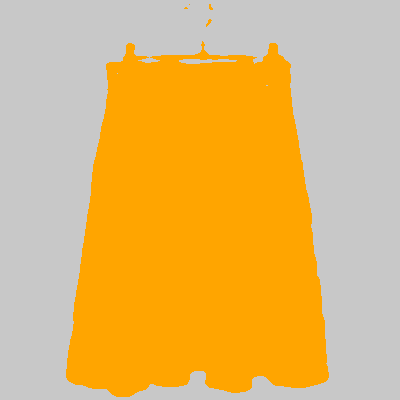

 44%|██████████████████████████▉                                  | 397/900 [01:02<01:17,  6.48it/s]

torch.Size([1, 3, 400, 400])
/mnt/nas4/hm/datasets/shopping_clothes/data/data900_personby100/skirt/image/train_1061.jpg
{'background': 0, 'top': 1, 'skirt': 2, 'outer': 3, 'dress': 4, 'bottom': 5}
Counter({0: 115866, 2: 44134})


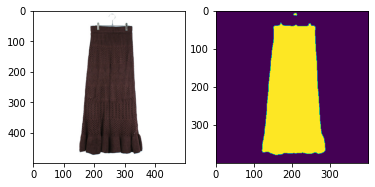

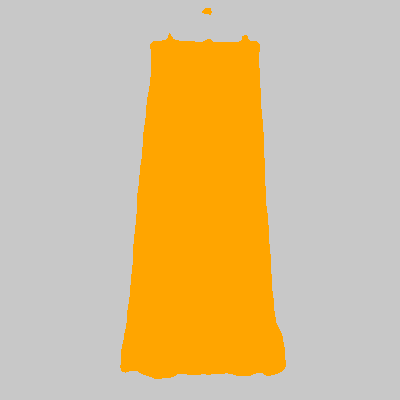

 44%|██████████████████████████▉                                  | 398/900 [01:03<01:16,  6.56it/s]

torch.Size([1, 3, 400, 400])
/mnt/nas4/hm/datasets/shopping_clothes/data/data900_personby100/skirt/image/train_2468.jpg
{'background': 0, 'top': 1, 'skirt': 2, 'outer': 3, 'dress': 4, 'bottom': 5}
Counter({2: 80007, 0: 79993})


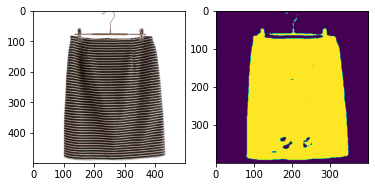

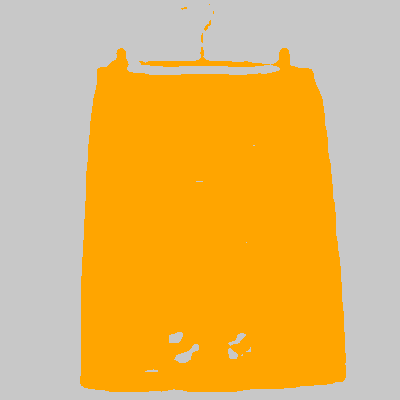

 44%|███████████████████████████                                  | 399/900 [01:03<01:15,  6.66it/s]

torch.Size([1, 3, 400, 400])
/mnt/nas4/hm/datasets/shopping_clothes/data/data900_personby100/outer/image/train_10334.jpg
{'background': 0, 'top': 1, 'skirt': 2, 'outer': 3, 'dress': 4, 'bottom': 5}
Counter({0: 82253, 3: 77747})


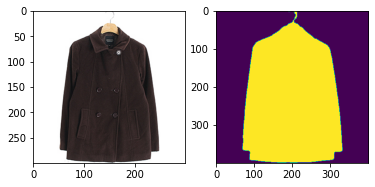

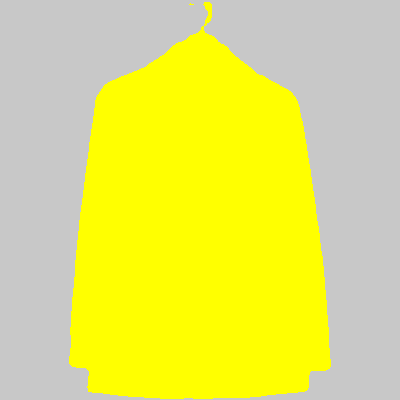

 44%|███████████████████████████                                  | 400/900 [01:03<01:12,  6.86it/s]

torch.Size([1, 3, 400, 400])
/mnt/nas4/hm/datasets/shopping_clothes/data/data900_personby100/top/image/train_12203.jpg
{'background': 0, 'top': 1, 'skirt': 2, 'outer': 3, 'dress': 4, 'bottom': 5}
Counter({0: 98341, 1: 61659})


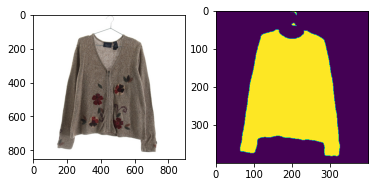

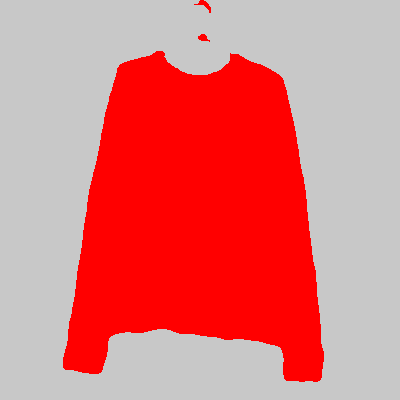

 45%|███████████████████████████▏                                 | 401/900 [01:03<01:19,  6.28it/s]

torch.Size([1, 3, 400, 400])
/mnt/nas4/hm/datasets/shopping_clothes/data/data900_personby100/bottom/image/train_174.jpg
{'background': 0, 'top': 1, 'skirt': 2, 'outer': 3, 'dress': 4, 'bottom': 5}
Counter({5: 85727, 0: 74273})


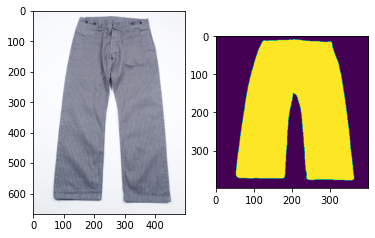

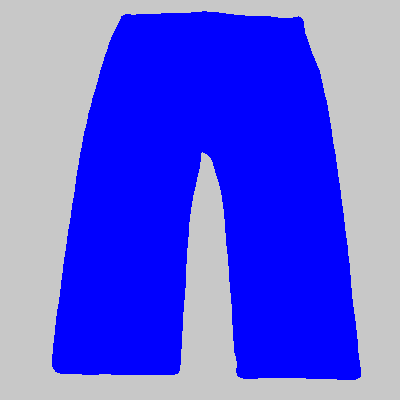

 45%|███████████████████████████▏                                 | 402/900 [01:03<01:20,  6.18it/s]

torch.Size([1, 3, 400, 400])
/mnt/nas4/hm/datasets/shopping_clothes/data/data900_personby100/top/image/train_10244.jpg
{'background': 0, 'top': 1, 'skirt': 2, 'outer': 3, 'dress': 4, 'bottom': 5}
Counter({0: 102429, 1: 57571})


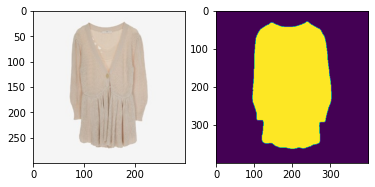

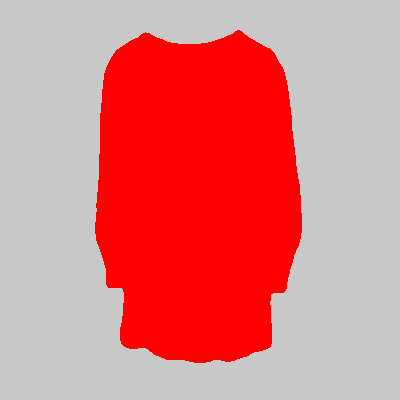

 45%|███████████████████████████▎                                 | 403/900 [01:03<01:16,  6.53it/s]

torch.Size([1, 3, 400, 400])
/mnt/nas4/hm/datasets/shopping_clothes/data/data900_personby100/top/image/train_13944.jpg
{'background': 0, 'top': 1, 'skirt': 2, 'outer': 3, 'dress': 4, 'bottom': 5}
Counter({1: 87143, 0: 72857})


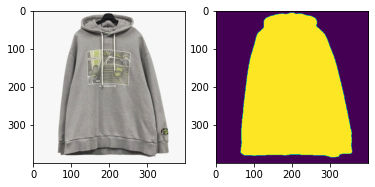

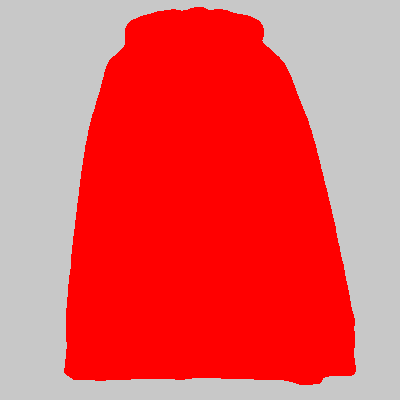

 45%|███████████████████████████▍                                 | 404/900 [01:04<01:22,  6.03it/s]

torch.Size([1, 3, 400, 400])
/mnt/nas4/hm/datasets/shopping_clothes/data/data900_personby100/bottom/image/train_1795.jpg
{'background': 0, 'top': 1, 'skirt': 2, 'outer': 3, 'dress': 4, 'bottom': 5}
Counter({0: 107799, 5: 52201})


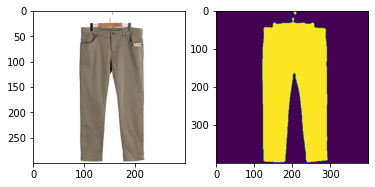

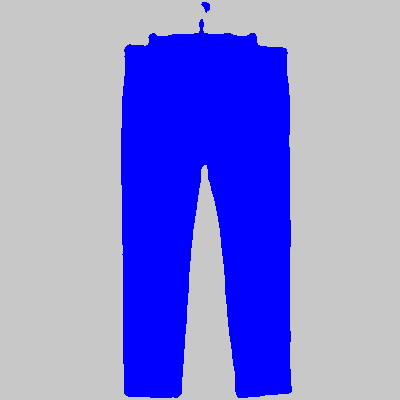

 45%|███████████████████████████▍                                 | 405/900 [01:04<01:17,  6.36it/s]

torch.Size([1, 3, 400, 400])
/mnt/nas4/hm/datasets/shopping_clothes/data/data900_personby100/outer/image/train_10384.jpg
{'background': 0, 'top': 1, 'skirt': 2, 'outer': 3, 'dress': 4, 'bottom': 5}
Counter({3: 89013, 0: 70987})


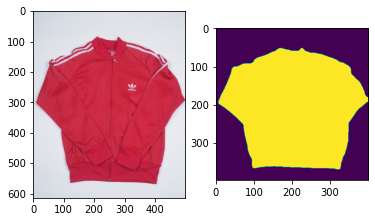

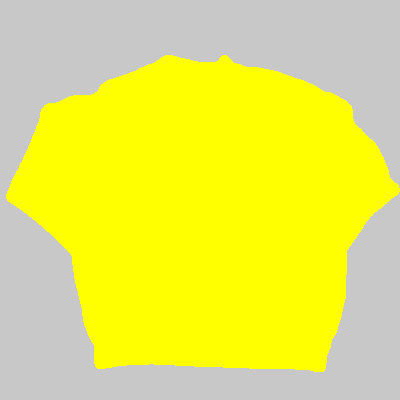

 45%|███████████████████████████▌                                 | 406/900 [01:04<01:17,  6.36it/s]

torch.Size([1, 3, 400, 400])
/mnt/nas4/hm/datasets/shopping_clothes/data/data900_personby100/top/image/train_5307.jpg
{'background': 0, 'top': 1, 'skirt': 2, 'outer': 3, 'dress': 4, 'bottom': 5}
Counter({1: 80749, 0: 79251})


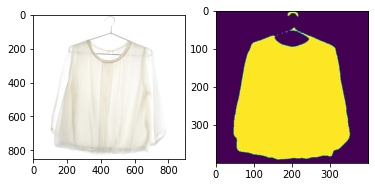

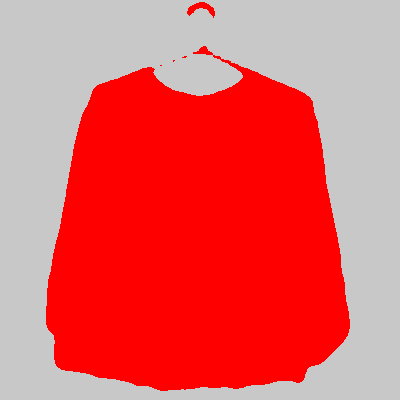

 45%|███████████████████████████▌                                 | 407/900 [01:04<01:21,  6.03it/s]

torch.Size([1, 3, 400, 400])
/mnt/nas4/hm/datasets/shopping_clothes/data/data900_personby100/outer/image/train_9403.jpg
{'background': 0, 'top': 1, 'skirt': 2, 'outer': 3, 'dress': 4, 'bottom': 5}
Counter({0: 82360, 3: 77640})


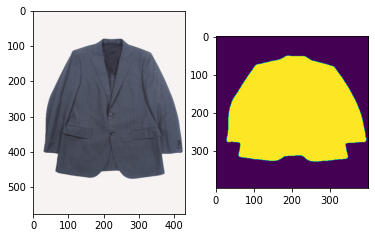

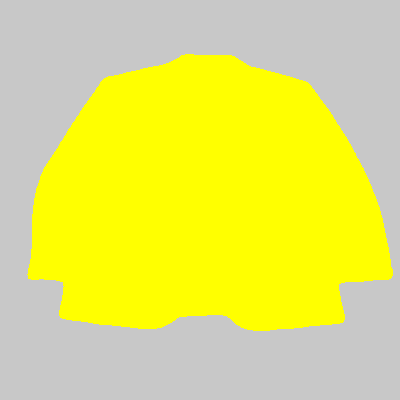

 45%|███████████████████████████▋                                 | 408/900 [01:04<01:19,  6.21it/s]

torch.Size([1, 3, 400, 400])
/mnt/nas4/hm/datasets/shopping_clothes/data/data900_personby100/dress/image/train_3463.jpg
{'background': 0, 'top': 1, 'skirt': 2, 'outer': 3, 'dress': 4, 'bottom': 5}
Counter({0: 98359, 4: 61641})


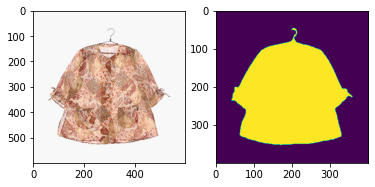

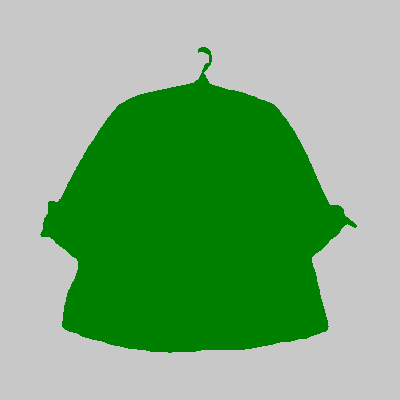

 45%|███████████████████████████▋                                 | 409/900 [01:04<01:17,  6.32it/s]

torch.Size([1, 3, 400, 400])
/mnt/nas4/hm/datasets/shopping_clothes/data/data900_personby100/bottom/image/train_157.jpg
{'background': 0, 'top': 1, 'skirt': 2, 'outer': 3, 'dress': 4, 'bottom': 5}
Counter({0: 99843, 5: 60157})


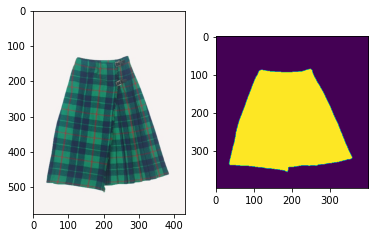

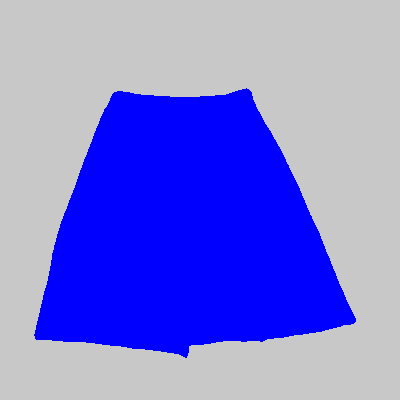

 46%|███████████████████████████▊                                 | 410/900 [01:04<01:15,  6.45it/s]

torch.Size([1, 3, 400, 400])
/mnt/nas4/hm/datasets/shopping_clothes/data/data900_personby100/dress/image/train_1157.jpg
{'background': 0, 'top': 1, 'skirt': 2, 'outer': 3, 'dress': 4, 'bottom': 5}
Counter({0: 110341, 4: 49659})


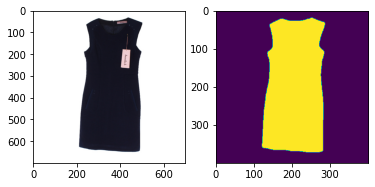

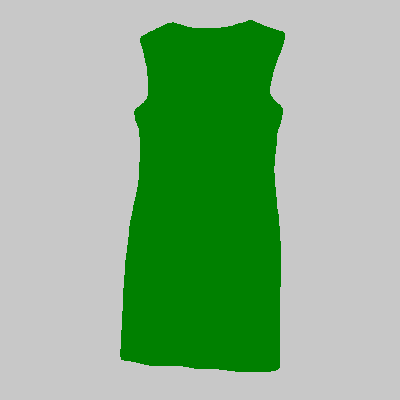

 46%|███████████████████████████▊                                 | 411/900 [01:05<01:17,  6.31it/s]

torch.Size([1, 3, 400, 400])
/mnt/nas4/hm/datasets/shopping_clothes/data/data900_personby100/bottom/image/train_3497.jpg
{'background': 0, 'top': 1, 'skirt': 2, 'outer': 3, 'dress': 4, 'bottom': 5}
Counter({0: 105157, 5: 54843})


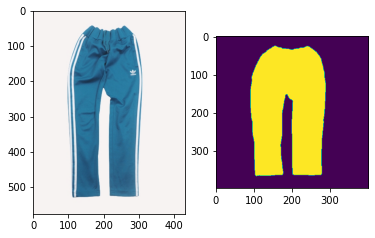

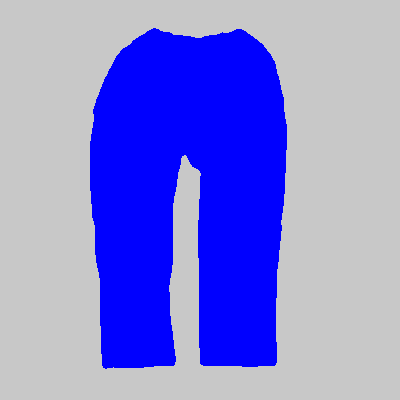

 46%|███████████████████████████▉                                 | 412/900 [01:05<01:15,  6.43it/s]

torch.Size([1, 3, 400, 400])
/mnt/nas4/hm/datasets/shopping_clothes/data/data900_personby100/dress/image/train_3480.jpg
{'background': 0, 'top': 1, 'skirt': 2, 'outer': 3, 'dress': 4, 'bottom': 5}
Counter({0: 104483, 4: 55517})


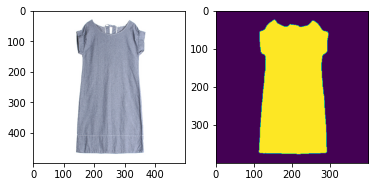

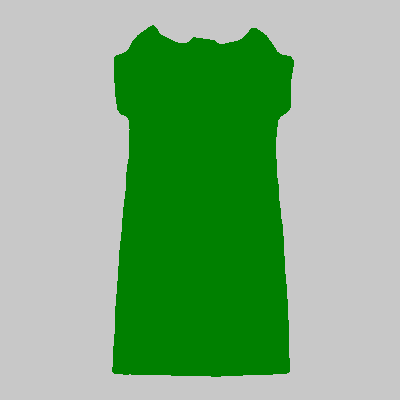

 46%|███████████████████████████▉                                 | 413/900 [01:05<01:14,  6.55it/s]

torch.Size([1, 3, 400, 400])
/mnt/nas4/hm/datasets/shopping_clothes/data/data900_personby100/bottom/image/train_799.jpg
{'background': 0, 'top': 1, 'skirt': 2, 'outer': 3, 'dress': 4, 'bottom': 5}
Counter({0: 107533, 5: 52467})


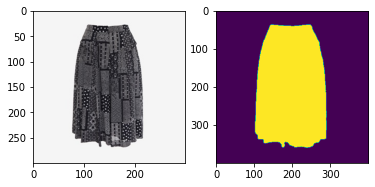

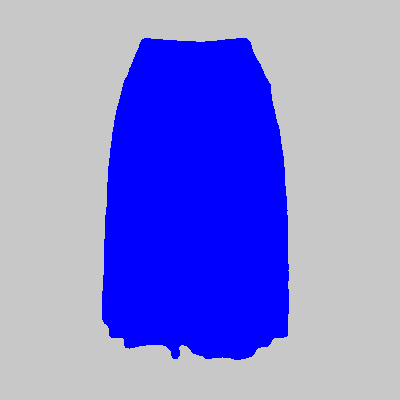

 46%|████████████████████████████                                 | 414/900 [01:05<01:11,  6.82it/s]

torch.Size([1, 3, 400, 400])
/mnt/nas4/hm/datasets/shopping_clothes/data/data900_personby100/bottom/image/train_847.jpg
{'background': 0, 'top': 1, 'skirt': 2, 'outer': 3, 'dress': 4, 'bottom': 5}
Counter({5: 97183, 0: 62817})


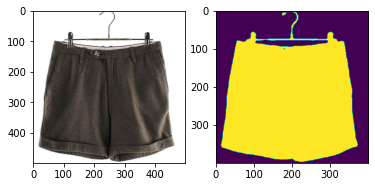

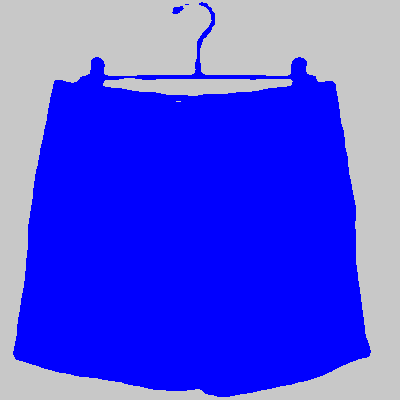

 46%|████████████████████████████▏                                | 415/900 [01:05<01:20,  6.06it/s]

torch.Size([1, 3, 400, 400])
/mnt/nas4/hm/datasets/shopping_clothes/data/data900_personby100/bottom/image/train_935.jpg
{'background': 0, 'top': 1, 'skirt': 2, 'outer': 3, 'dress': 4, 'bottom': 5}
Counter({0: 105493, 5: 54507})


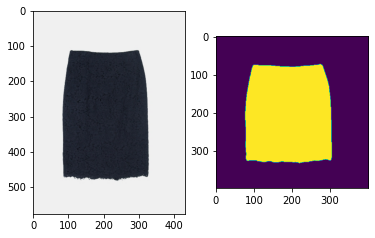

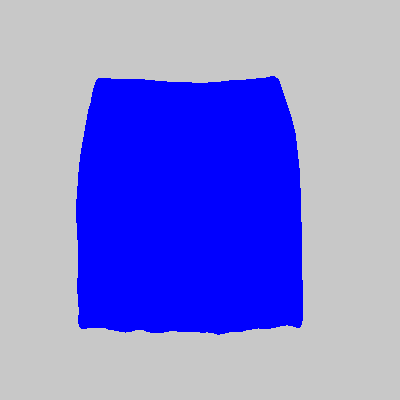

 46%|████████████████████████████▏                                | 416/900 [01:05<01:17,  6.22it/s]

torch.Size([1, 3, 400, 400])
/mnt/nas4/hm/datasets/shopping_clothes/data/data900_personby100/dress/image/train_3773.jpg
{'background': 0, 'top': 1, 'skirt': 2, 'outer': 3, 'dress': 4, 'bottom': 5}
Counter({0: 103772, 4: 56228})


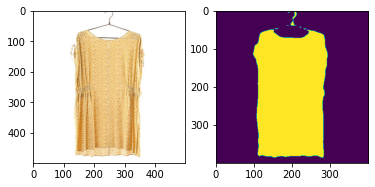

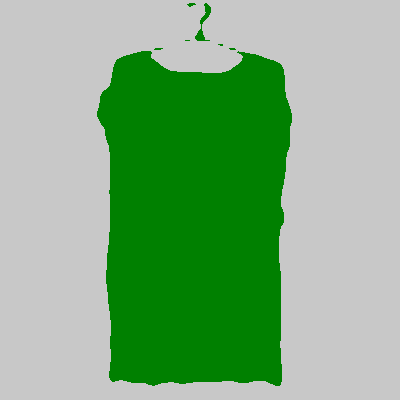

 46%|████████████████████████████▎                                | 417/900 [01:06<01:15,  6.40it/s]

torch.Size([1, 3, 400, 400])
/mnt/nas4/hm/datasets/shopping_clothes/data/data900_personby100/bottom/image/train_953.jpg
{'background': 0, 'top': 1, 'skirt': 2, 'outer': 3, 'dress': 4, 'bottom': 5}
Counter({0: 113121, 5: 46879})


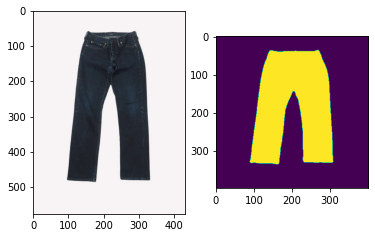

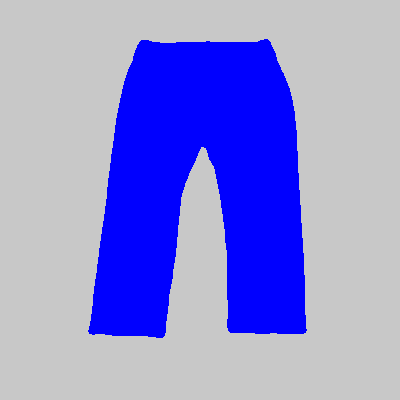

 46%|████████████████████████████▎                                | 418/900 [01:06<01:14,  6.50it/s]

torch.Size([1, 3, 400, 400])
/mnt/nas4/hm/datasets/shopping_clothes/data/data900_personby100/dress/image/train_2278.jpg
{'background': 0, 'top': 1, 'skirt': 2, 'outer': 3, 'dress': 4, 'bottom': 5}
Counter({0: 106938, 4: 53062})


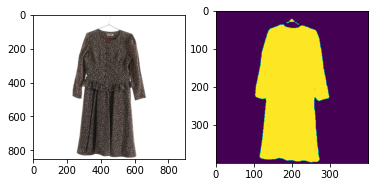

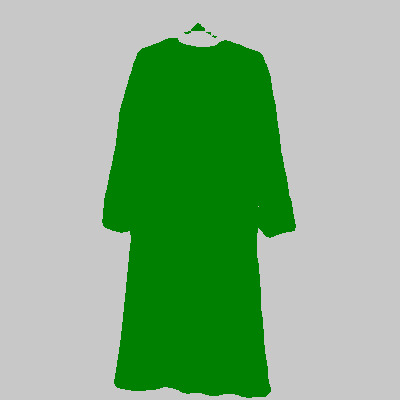

 47%|████████████████████████████▍                                | 419/900 [01:06<01:19,  6.07it/s]

torch.Size([1, 3, 400, 400])
/mnt/nas4/hm/datasets/shopping_clothes/data/data900_personby100/bottom/image/train_433.jpg
{'background': 0, 'top': 1, 'skirt': 2, 'outer': 3, 'dress': 4, 'bottom': 5}
Counter({0: 115541, 5: 44459})


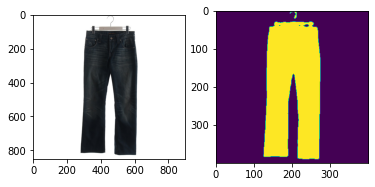

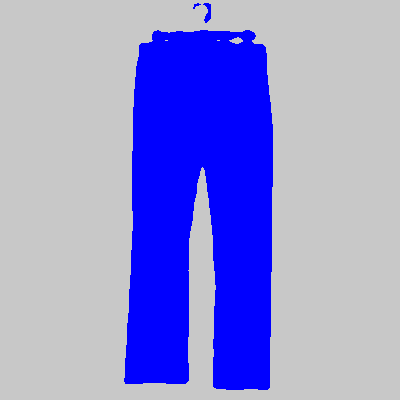

 47%|████████████████████████████▍                                | 420/900 [01:06<01:21,  5.88it/s]

torch.Size([1, 3, 400, 400])
/mnt/nas4/hm/datasets/shopping_clothes/data/data900_personby100/skirt/image/train_762.jpg
{'background': 0, 'top': 1, 'skirt': 2, 'outer': 3, 'dress': 4, 'bottom': 5}
Counter({2: 90260, 0: 69740})


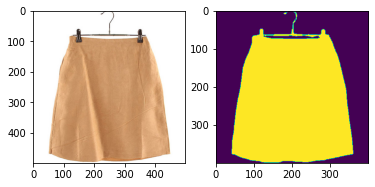

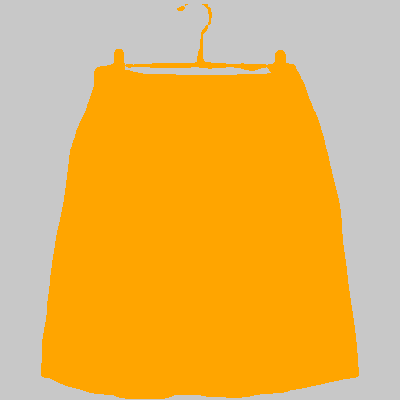

 47%|████████████████████████████▌                                | 421/900 [01:06<01:18,  6.14it/s]

torch.Size([1, 3, 400, 400])
/mnt/nas4/hm/datasets/shopping_clothes/data/data900_personby100/top/image/train_1769.jpg
{'background': 0, 'top': 1, 'skirt': 2, 'outer': 3, 'dress': 4, 'bottom': 5}
Counter({0: 103002, 1: 56998})


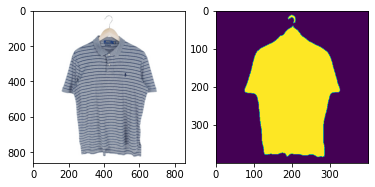

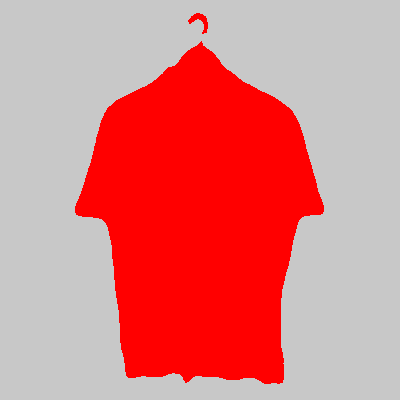

 47%|████████████████████████████▌                                | 422/900 [01:06<01:20,  5.95it/s]

torch.Size([1, 3, 400, 400])
/mnt/nas4/hm/datasets/shopping_clothes/data/data900_personby100/dress/image/train_2763.jpg
{'background': 0, 'top': 1, 'skirt': 2, 'outer': 3, 'dress': 4, 'bottom': 5}
Counter({0: 84066, 4: 75934})


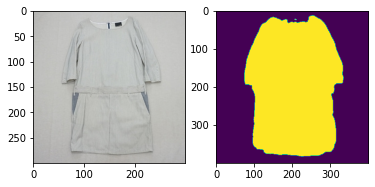

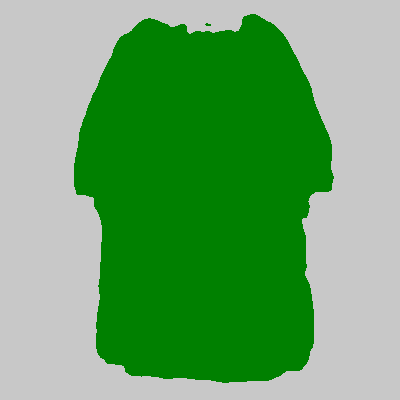

 47%|████████████████████████████▋                                | 423/900 [01:07<01:15,  6.30it/s]

torch.Size([1, 3, 400, 400])
/mnt/nas4/hm/datasets/shopping_clothes/data/data900_personby100/skirt/image/train_1485.jpg
{'background': 0, 'top': 1, 'skirt': 2, 'outer': 3, 'dress': 4, 'bottom': 5}
Counter({0: 99676, 2: 60324})


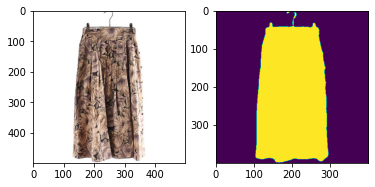

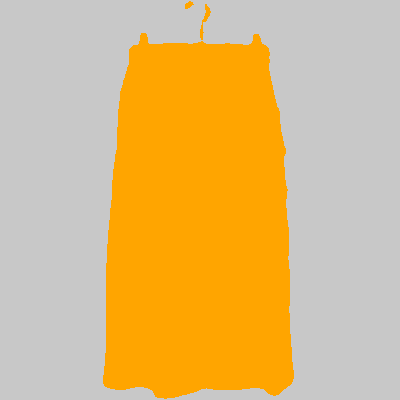

 47%|████████████████████████████▋                                | 424/900 [01:07<01:13,  6.45it/s]

torch.Size([1, 3, 400, 400])
/mnt/nas4/hm/datasets/shopping_clothes/data/data900_personby100/skirt/image/train_1779.jpg
{'background': 0, 'top': 1, 'skirt': 2, 'outer': 3, 'dress': 4, 'bottom': 5}
Counter({0: 109979, 2: 50021})


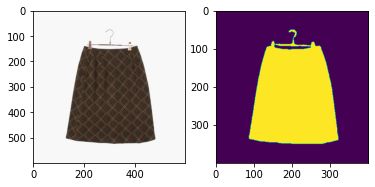

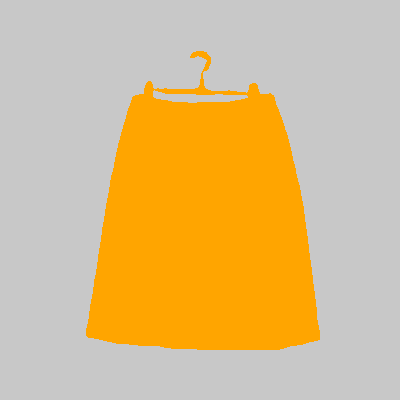

 47%|████████████████████████████▊                                | 425/900 [01:07<01:13,  6.49it/s]

torch.Size([1, 3, 400, 400])
/mnt/nas4/hm/datasets/shopping_clothes/data/data900_personby100/outer/image/train_9532.jpg
{'background': 0, 'top': 1, 'skirt': 2, 'outer': 3, 'dress': 4, 'bottom': 5}
Counter({0: 97971, 3: 62029})


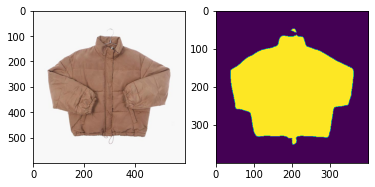

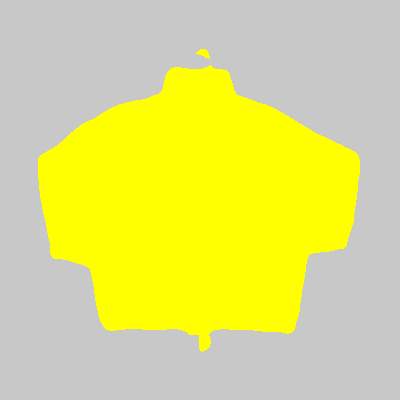

 47%|████████████████████████████▊                                | 426/900 [01:07<01:21,  5.85it/s]

torch.Size([1, 3, 400, 400])
/mnt/nas4/hm/datasets/shopping_clothes/data/data900_personby100/outer/image/train_1188.jpg
{'background': 0, 'top': 1, 'skirt': 2, 'outer': 3, 'dress': 4, 'bottom': 5}
Counter({3: 95025, 0: 64975})


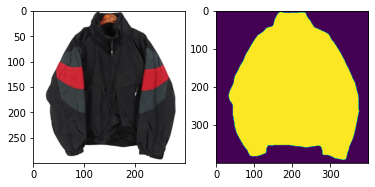

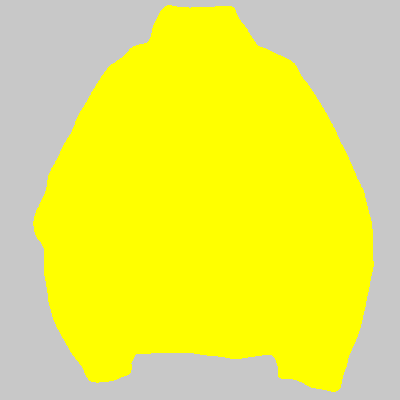

 47%|████████████████████████████▉                                | 427/900 [01:07<01:15,  6.27it/s]

torch.Size([1, 3, 400, 400])
/mnt/nas4/hm/datasets/shopping_clothes/data/data900_personby100/bottom/image/train_3340.jpg
{'background': 0, 'top': 1, 'skirt': 2, 'outer': 3, 'dress': 4, 'bottom': 5}
Counter({0: 110622, 5: 49378})


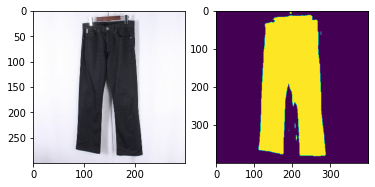

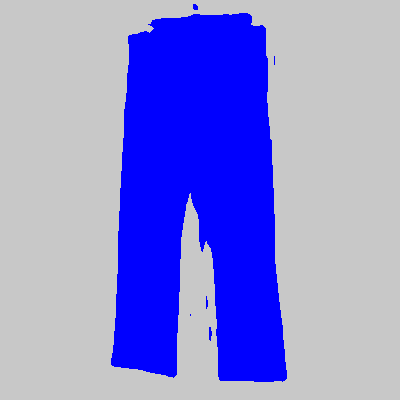

 48%|█████████████████████████████                                | 428/900 [01:07<01:11,  6.59it/s]

torch.Size([1, 3, 400, 400])
/mnt/nas4/hm/datasets/shopping_clothes/data/data900_personby100/skirt/image/train_55.jpg
{'background': 0, 'top': 1, 'skirt': 2, 'outer': 3, 'dress': 4, 'bottom': 5}
Counter({2: 92618, 0: 67382})


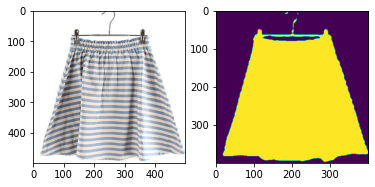

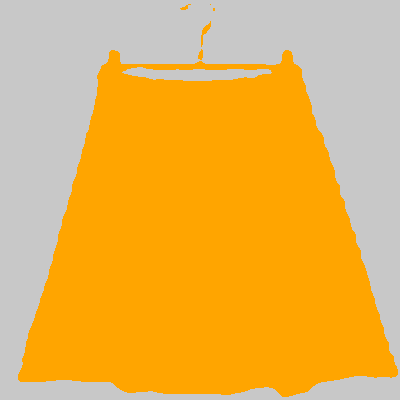

 48%|█████████████████████████████                                | 429/900 [01:07<01:10,  6.68it/s]

torch.Size([1, 3, 400, 400])
/mnt/nas4/hm/datasets/shopping_clothes/data/data900_personby100/skirt/image/train_1571.jpg
{'background': 0, 'top': 1, 'skirt': 2, 'outer': 3, 'dress': 4, 'bottom': 5}
Counter({0: 108623, 2: 51377})


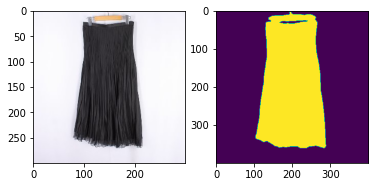

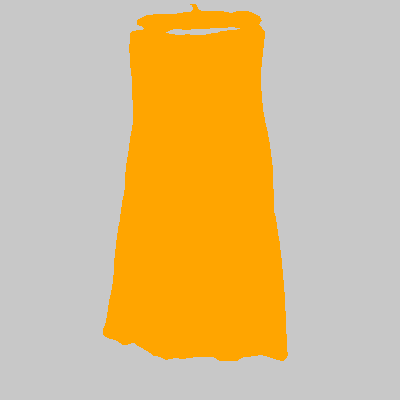

 48%|█████████████████████████████▏                               | 430/900 [01:08<01:08,  6.89it/s]

torch.Size([1, 3, 400, 400])
/mnt/nas4/hm/datasets/shopping_clothes/data/data900_personby100/outer/image/train_11053.jpg
{'background': 0, 'top': 1, 'skirt': 2, 'outer': 3, 'dress': 4, 'bottom': 5}
Counter({0: 105013, 3: 54987})


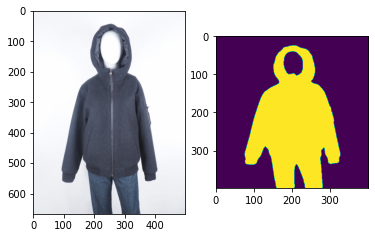

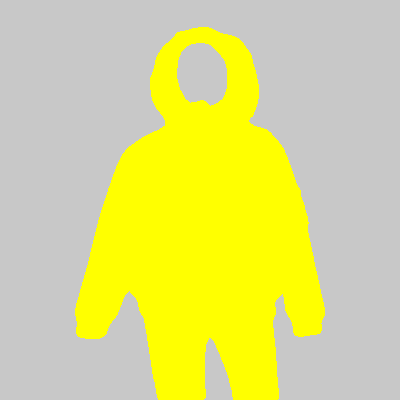

 48%|█████████████████████████████▏                               | 431/900 [01:08<01:10,  6.62it/s]

torch.Size([1, 3, 400, 400])
/mnt/nas4/hm/datasets/shopping_clothes/data/data900_personby100/skirt/image/train_624.jpg
{'background': 0, 'top': 1, 'skirt': 2, 'outer': 3, 'dress': 4, 'bottom': 5}
Counter({0: 95921, 2: 64079})


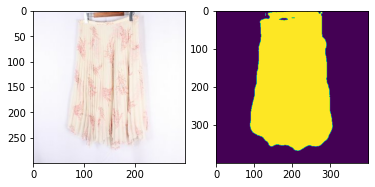

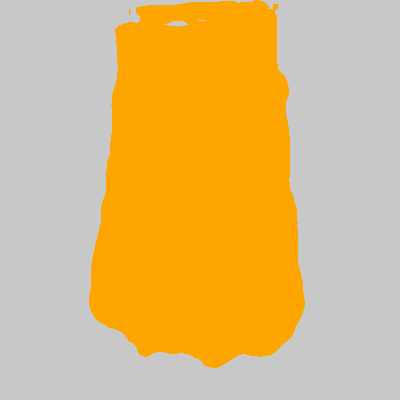

 48%|█████████████████████████████▎                               | 432/900 [01:08<01:08,  6.82it/s]

torch.Size([1, 3, 400, 400])
/mnt/nas4/hm/datasets/shopping_clothes/data/data900_personby100/skirt/image/train_1369.jpg
{'background': 0, 'top': 1, 'skirt': 2, 'outer': 3, 'dress': 4, 'bottom': 5}
Counter({0: 82773, 2: 77227})


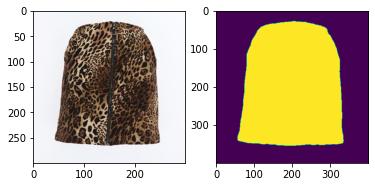

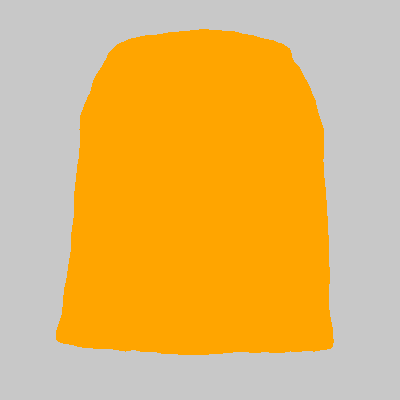

 48%|█████████████████████████████▎                               | 433/900 [01:08<01:06,  7.01it/s]

torch.Size([1, 3, 400, 400])
/mnt/nas4/hm/datasets/shopping_clothes/data/data900_personby100/dress/image/train_2414.jpg
{'background': 0, 'top': 1, 'skirt': 2, 'outer': 3, 'dress': 4, 'bottom': 5}
Counter({0: 124539, 4: 35461})


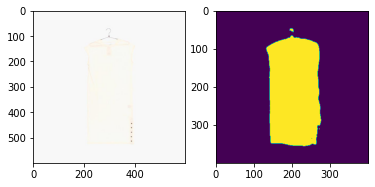

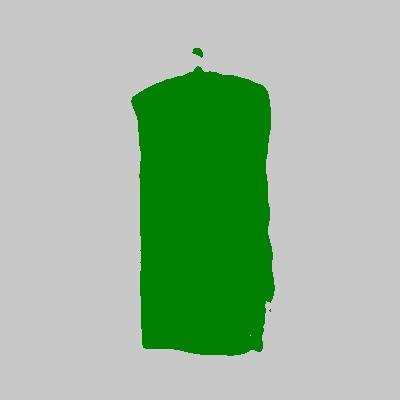

 48%|█████████████████████████████▍                               | 434/900 [01:08<01:07,  6.91it/s]

torch.Size([1, 3, 400, 400])
/mnt/nas4/hm/datasets/shopping_clothes/data/data900_personby100/dress/image/train_19.jpg
{'background': 0, 'top': 1, 'skirt': 2, 'outer': 3, 'dress': 4, 'bottom': 5}
Counter({0: 121810, 4: 38190})


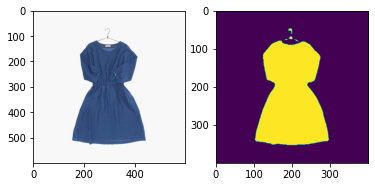

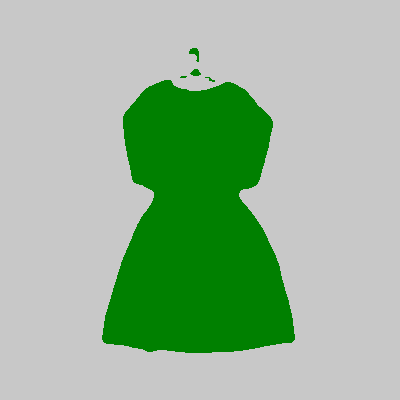

 48%|█████████████████████████████▍                               | 435/900 [01:08<01:08,  6.83it/s]

torch.Size([1, 3, 400, 400])
/mnt/nas4/hm/datasets/shopping_clothes/data/data900_personby100/top/image/train_5114.jpg
{'background': 0, 'top': 1, 'skirt': 2, 'outer': 3, 'dress': 4, 'bottom': 5}
Counter({1: 82846, 0: 77154})


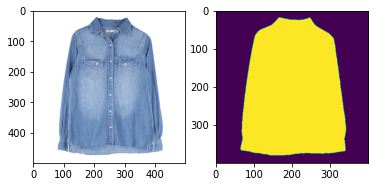

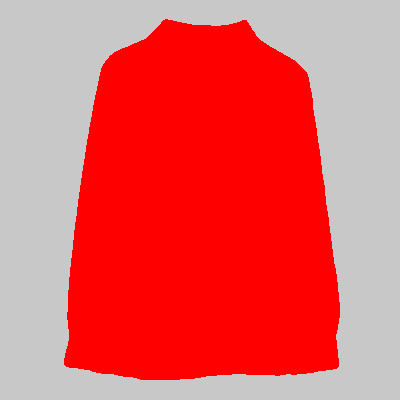

 48%|█████████████████████████████▌                               | 436/900 [01:08<01:08,  6.79it/s]

torch.Size([1, 3, 400, 400])
/mnt/nas4/hm/datasets/shopping_clothes/data/data900_personby100/skirt/image/train_2110.jpg
{'background': 0, 'top': 1, 'skirt': 2, 'outer': 3, 'dress': 4, 'bottom': 5}
Counter({0: 81853, 2: 78147})


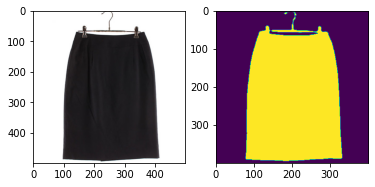

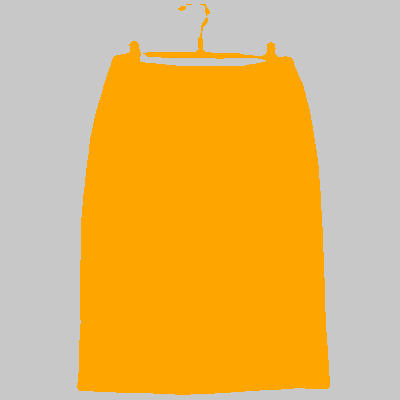

 49%|█████████████████████████████▌                               | 437/900 [01:09<01:16,  6.07it/s]

torch.Size([1, 3, 400, 400])
/mnt/nas4/hm/datasets/shopping_clothes/data/data900_personby100/outer/image/train_6131.jpg
{'background': 0, 'top': 1, 'skirt': 2, 'outer': 3, 'dress': 4, 'bottom': 5}
Counter({0: 106111, 3: 53889})


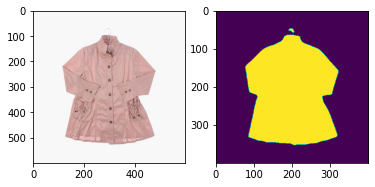

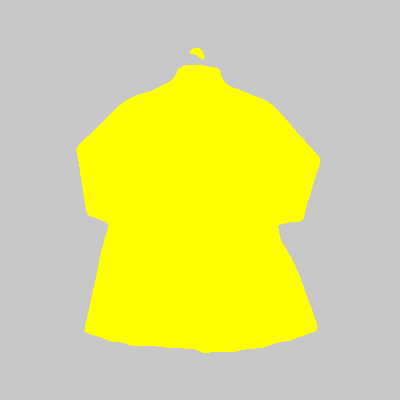

 49%|█████████████████████████████▋                               | 438/900 [01:09<01:14,  6.22it/s]

torch.Size([1, 3, 400, 400])
/mnt/nas4/hm/datasets/shopping_clothes/data/data900_personby100/bottom/image/train_2521.jpg
{'background': 0, 'top': 1, 'skirt': 2, 'outer': 3, 'dress': 4, 'bottom': 5}
Counter({0: 111390, 5: 48610})


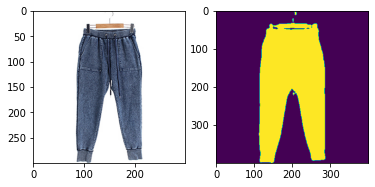

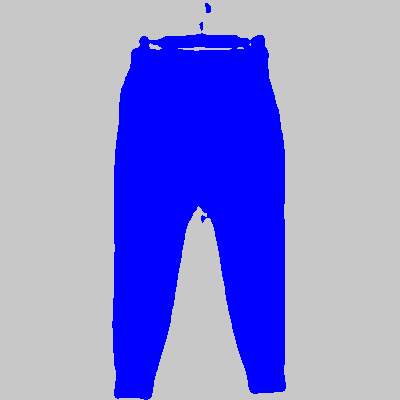

 49%|█████████████████████████████▊                               | 439/900 [01:09<01:10,  6.54it/s]

torch.Size([1, 3, 400, 400])
/mnt/nas4/hm/datasets/shopping_clothes/data/data900_personby100/top/image/train_14090.jpg
{'background': 0, 'top': 1, 'skirt': 2, 'outer': 3, 'dress': 4, 'bottom': 5}
Counter({0: 112301, 1: 47699})


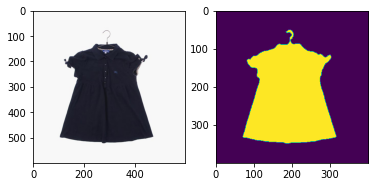

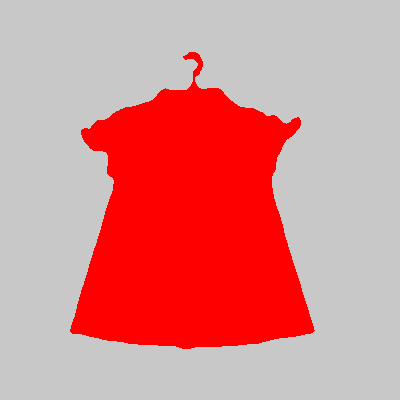

 49%|█████████████████████████████▊                               | 440/900 [01:09<01:10,  6.56it/s]

torch.Size([1, 3, 400, 400])
/mnt/nas4/hm/datasets/shopping_clothes/data/data900_personby100/outer/image/train_2445.jpg
{'background': 0, 'top': 1, 'skirt': 2, 'outer': 3, 'dress': 4, 'bottom': 5}
Counter({0: 81643, 3: 78357})


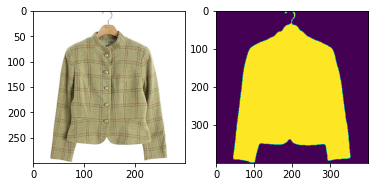

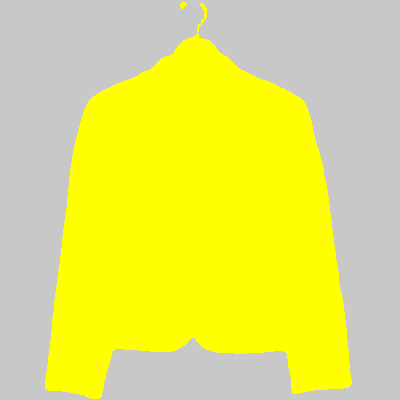

 49%|█████████████████████████████▉                               | 441/900 [01:09<01:07,  6.79it/s]

torch.Size([1, 3, 400, 400])
/mnt/nas4/hm/datasets/shopping_clothes/data/data900_personby100/skirt/image/train_2462.jpg
{'background': 0, 'top': 1, 'skirt': 2, 'outer': 3, 'dress': 4, 'bottom': 5}
Counter({0: 113501, 2: 46499})


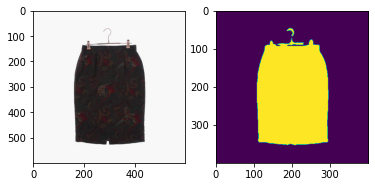

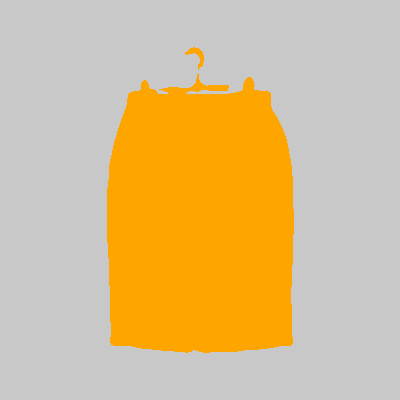

 49%|█████████████████████████████▉                               | 442/900 [01:09<01:07,  6.74it/s]

torch.Size([1, 3, 400, 400])
/mnt/nas4/hm/datasets/shopping_clothes/data/data900_personby100/dress/image/train_346.jpg
{'background': 0, 'top': 1, 'skirt': 2, 'outer': 3, 'dress': 4, 'bottom': 5}
Counter({0: 117675, 4: 42325})


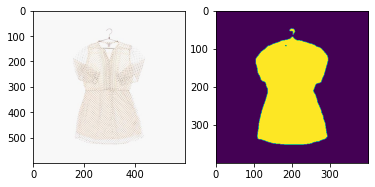

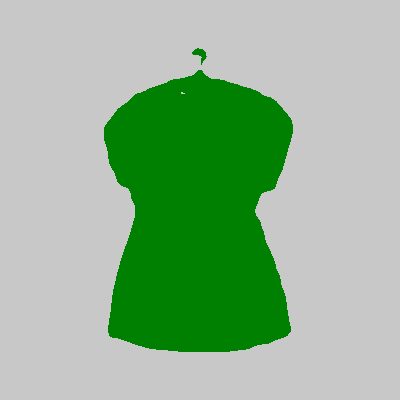

 49%|██████████████████████████████                               | 443/900 [01:10<01:08,  6.70it/s]

torch.Size([1, 3, 400, 400])
/mnt/nas4/hm/datasets/shopping_clothes/data/data900_personby100/bottom/image/train_2279.jpg
{'background': 0, 'top': 1, 'skirt': 2, 'outer': 3, 'dress': 4, 'bottom': 5}
Counter({0: 126168, 5: 33832})


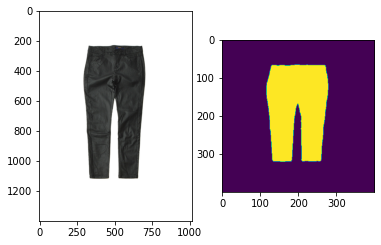

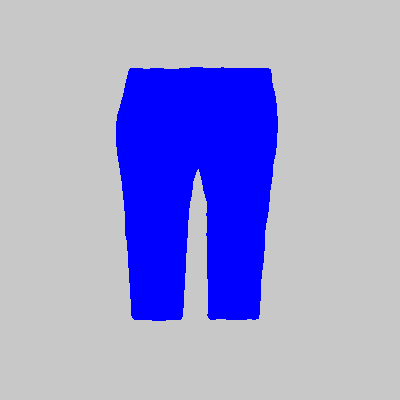

 49%|██████████████████████████████                               | 444/900 [01:10<01:19,  5.74it/s]

torch.Size([1, 3, 400, 400])
/mnt/nas4/hm/datasets/shopping_clothes/data/data900_personby100/dress/image/train_1841.jpg
{'background': 0, 'top': 1, 'skirt': 2, 'outer': 3, 'dress': 4, 'bottom': 5}
Counter({0: 121985, 4: 38015})


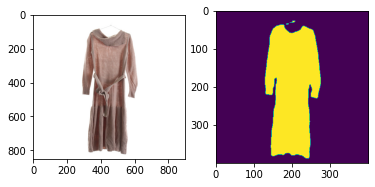

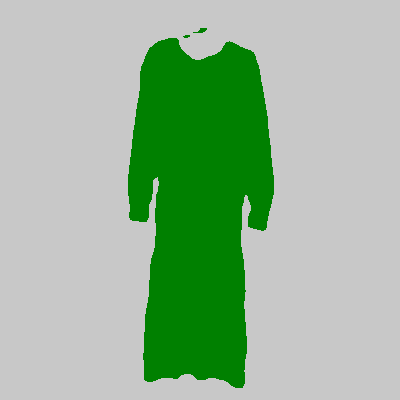

 49%|██████████████████████████████▏                              | 445/900 [01:10<01:20,  5.65it/s]

torch.Size([1, 3, 400, 400])
/mnt/nas4/hm/datasets/shopping_clothes/data/data900_personby100/skirt/image/train_2350.jpg
{'background': 0, 'top': 1, 'skirt': 2, 'outer': 3, 'dress': 4, 'bottom': 5}
Counter({0: 96577, 2: 63423})


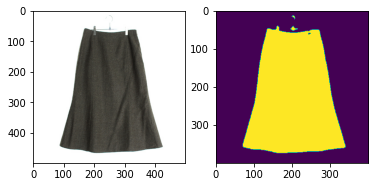

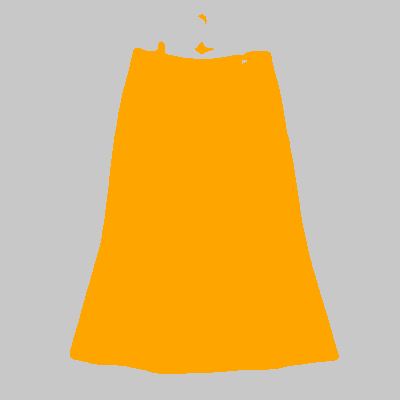

 50%|██████████████████████████████▏                              | 446/900 [01:10<01:16,  5.91it/s]

torch.Size([1, 3, 400, 400])
/mnt/nas4/hm/datasets/shopping_clothes/data/data900_personby100/outer/image/train_8029.jpg
{'background': 0, 'top': 1, 'skirt': 2, 'outer': 3, 'dress': 4, 'bottom': 5}
Counter({3: 84168, 0: 75832})


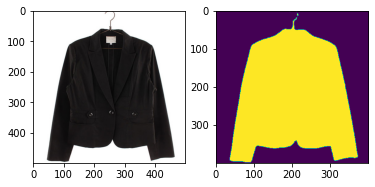

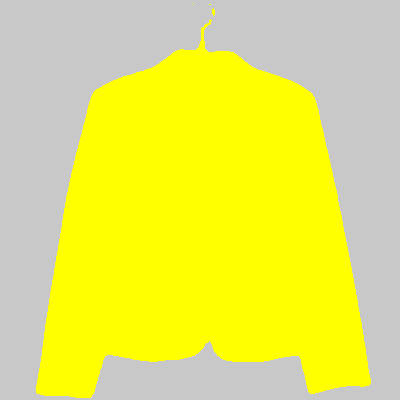

 50%|██████████████████████████████▎                              | 447/900 [01:10<01:13,  6.18it/s]

torch.Size([1, 3, 400, 400])
/mnt/nas4/hm/datasets/shopping_clothes/data/data900_personby100/outer/image/train_3081.jpg
{'background': 0, 'top': 1, 'skirt': 2, 'outer': 3, 'dress': 4, 'bottom': 5}
Counter({0: 88218, 3: 71782})


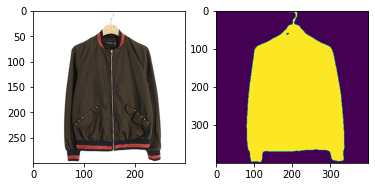

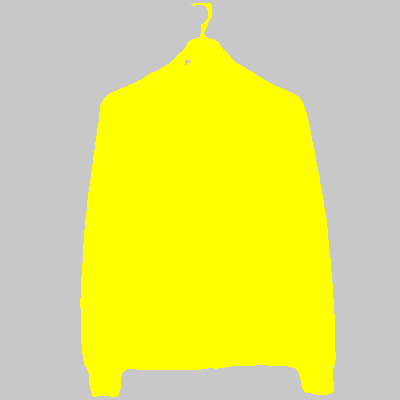

 50%|██████████████████████████████▎                              | 448/900 [01:10<01:17,  5.84it/s]

torch.Size([1, 3, 400, 400])
/mnt/nas4/hm/datasets/shopping_clothes/data/data900_personby100/dress/image/train_1677.jpg
{'background': 0, 'top': 1, 'skirt': 2, 'outer': 3, 'dress': 4, 'bottom': 5}
Counter({0: 118262, 4: 41738})


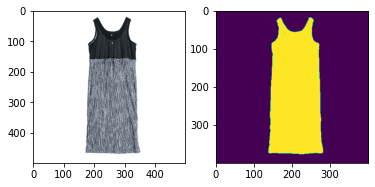

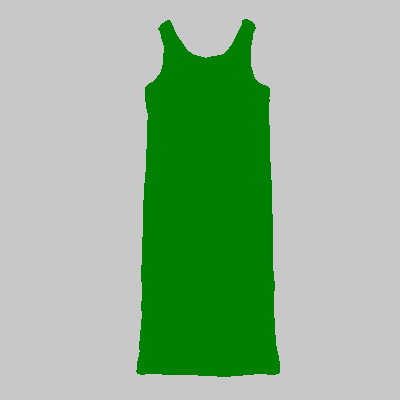

 50%|██████████████████████████████▍                              | 449/900 [01:11<01:13,  6.13it/s]

torch.Size([1, 3, 400, 400])
/mnt/nas4/hm/datasets/shopping_clothes/data/data900_personby100/skirt/image/train_1829.jpg
{'background': 0, 'top': 1, 'skirt': 2, 'outer': 3, 'dress': 4, 'bottom': 5}
Counter({2: 80281, 0: 79719})


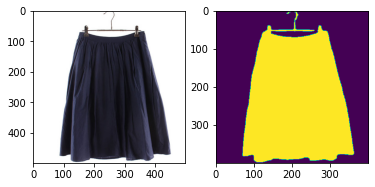

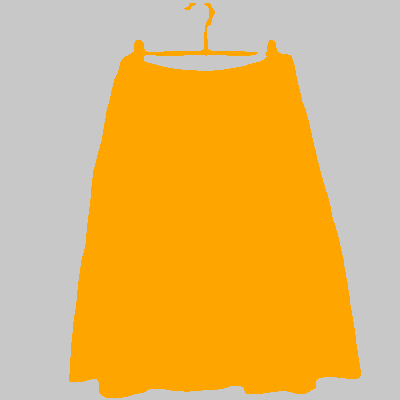

 50%|██████████████████████████████▌                              | 450/900 [01:11<01:10,  6.34it/s]

torch.Size([1, 3, 400, 400])
/mnt/nas4/hm/datasets/shopping_clothes/data/data900_personby100/dress/image/train_838.jpg
{'background': 0, 'top': 1, 'skirt': 2, 'outer': 3, 'dress': 4, 'bottom': 5}
Counter({0: 123687, 4: 36313})


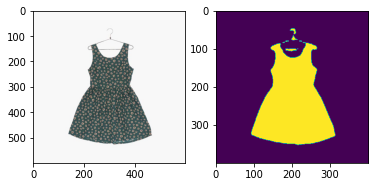

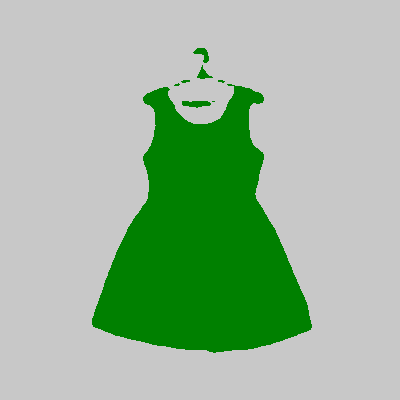

 50%|██████████████████████████████▌                              | 451/900 [01:11<01:09,  6.42it/s]

torch.Size([1, 3, 400, 400])
/mnt/nas4/hm/datasets/shopping_clothes/data/data900_personby100/skirt/image/train_2038.jpg
{'background': 0, 'top': 1, 'skirt': 2, 'outer': 3, 'dress': 4, 'bottom': 5}
Counter({0: 106439, 2: 53561})


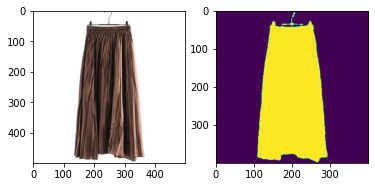

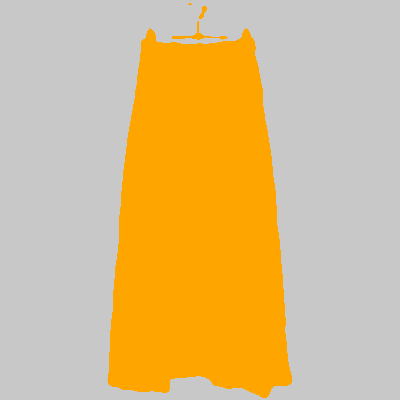

 50%|██████████████████████████████▋                              | 452/900 [01:11<01:08,  6.58it/s]

torch.Size([1, 3, 400, 400])
/mnt/nas4/hm/datasets/shopping_clothes/data/data900_personby100/bottom/image/train_3247.jpg
{'background': 0, 'top': 1, 'skirt': 2, 'outer': 3, 'dress': 4, 'bottom': 5}
Counter({0: 93234, 5: 66766})


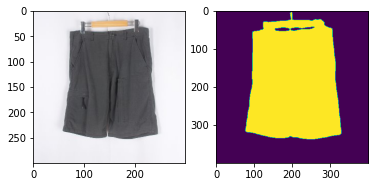

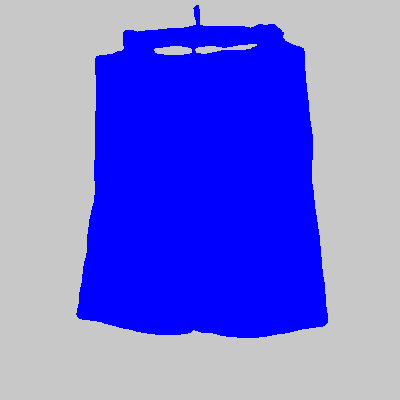

 50%|██████████████████████████████▋                              | 453/900 [01:11<01:05,  6.85it/s]

torch.Size([1, 3, 400, 400])
/mnt/nas4/hm/datasets/shopping_clothes/data/data900_personby100/top/image/train_16820.jpg
{'background': 0, 'top': 1, 'skirt': 2, 'outer': 3, 'dress': 4, 'bottom': 5}
Counter({0: 81820, 1: 78180})


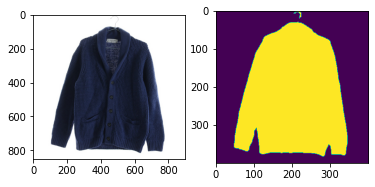

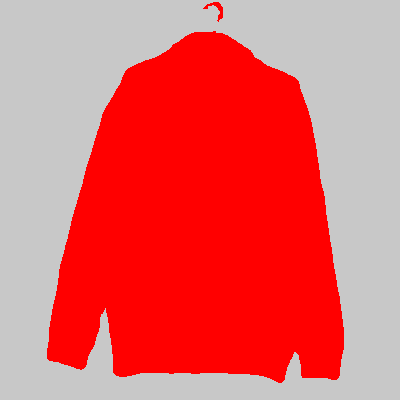

 50%|██████████████████████████████▊                              | 454/900 [01:11<01:11,  6.28it/s]

torch.Size([1, 3, 400, 400])
/mnt/nas4/hm/datasets/shopping_clothes/data/data900_personby100/outer/image/train_8024.jpg
{'background': 0, 'top': 1, 'skirt': 2, 'outer': 3, 'dress': 4, 'bottom': 5}
Counter({3: 84874, 0: 75126})


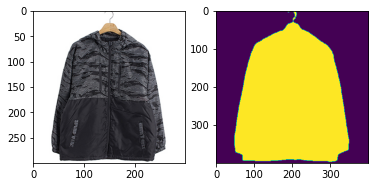

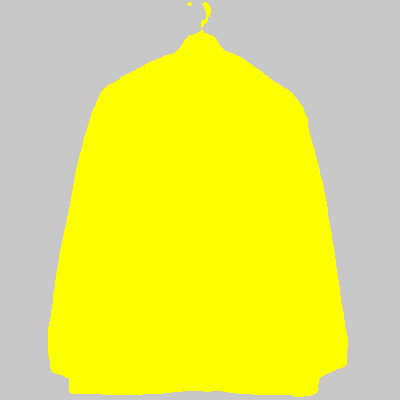

 51%|██████████████████████████████▊                              | 455/900 [01:12<01:07,  6.59it/s]

torch.Size([1, 3, 400, 400])
/mnt/nas4/hm/datasets/shopping_clothes/data/data900_personby100/top/image/train_14981.jpg
{'background': 0, 'top': 1, 'skirt': 2, 'outer': 3, 'dress': 4, 'bottom': 5}
Counter({0: 100833, 1: 59167})


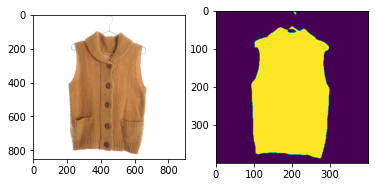

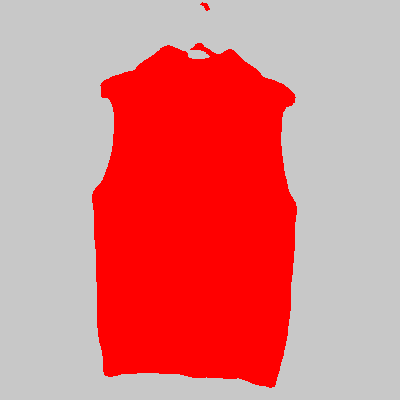

 51%|██████████████████████████████▉                              | 456/900 [01:12<01:12,  6.14it/s]

torch.Size([1, 3, 400, 400])
/mnt/nas4/hm/datasets/shopping_clothes/data/data900_personby100/bottom/image/train_377.jpg
{'background': 0, 'top': 1, 'skirt': 2, 'outer': 3, 'dress': 4, 'bottom': 5}
Counter({0: 100285, 5: 59715})


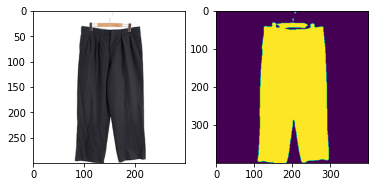

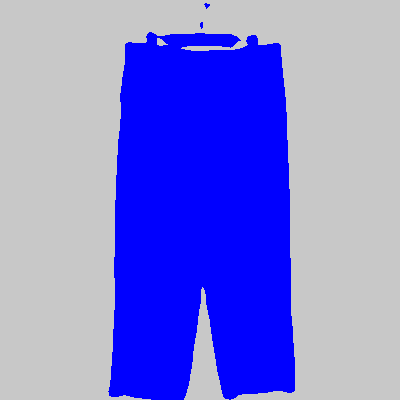

 51%|██████████████████████████████▉                              | 457/900 [01:12<01:08,  6.47it/s]

torch.Size([1, 3, 400, 400])
/mnt/nas4/hm/datasets/shopping_clothes/data/data900_personby100/outer/image/train_7063.jpg
{'background': 0, 'top': 1, 'skirt': 2, 'outer': 3, 'dress': 4, 'bottom': 5}
Counter({0: 94012, 3: 65988})


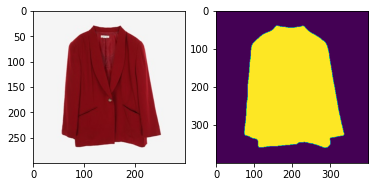

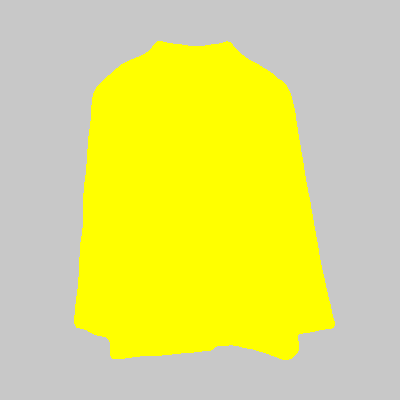

 51%|███████████████████████████████                              | 458/900 [01:12<01:05,  6.75it/s]

torch.Size([1, 3, 400, 400])
/mnt/nas4/hm/datasets/shopping_clothes/data/data900_personby100/skirt/image/train_668.jpg
{'background': 0, 'top': 1, 'skirt': 2, 'outer': 3, 'dress': 4, 'bottom': 5}
Counter({2: 99664, 0: 60336})


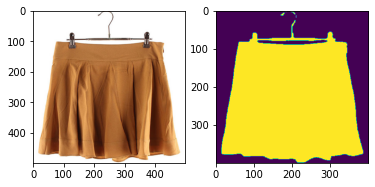

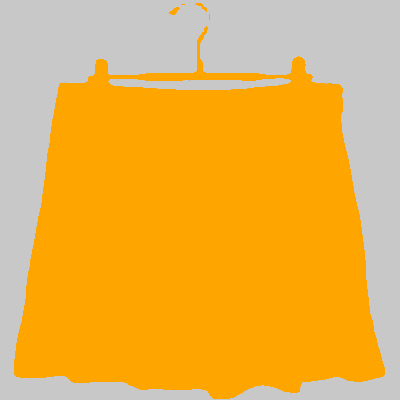

 51%|███████████████████████████████                              | 459/900 [01:12<01:12,  6.06it/s]

torch.Size([1, 3, 400, 400])
/mnt/nas4/hm/datasets/shopping_clothes/data/data900_personby100/skirt/image/train_895.jpg
{'background': 0, 'top': 1, 'skirt': 2, 'outer': 3, 'dress': 4, 'bottom': 5}
Counter({0: 82058, 2: 77942})


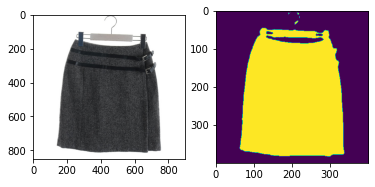

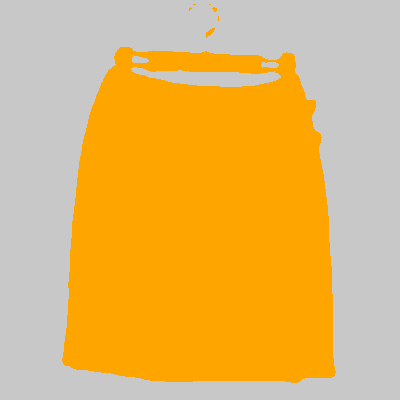

 51%|███████████████████████████████▏                             | 460/900 [01:12<01:16,  5.78it/s]

torch.Size([1, 3, 400, 400])
/mnt/nas4/hm/datasets/shopping_clothes/data/data900_personby100/bottom/image/train_6.jpg
{'background': 0, 'top': 1, 'skirt': 2, 'outer': 3, 'dress': 4, 'bottom': 5}
Counter({0: 110304, 5: 49696})


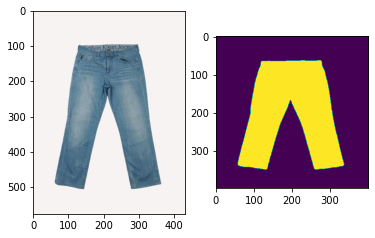

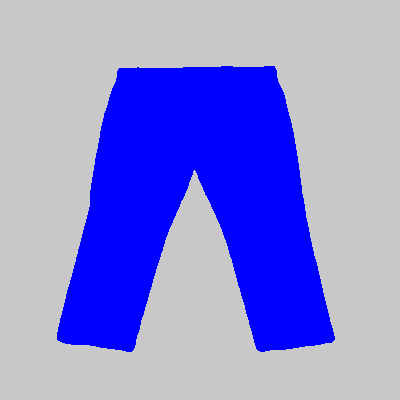

 51%|███████████████████████████████▏                             | 461/900 [01:13<01:12,  6.05it/s]

torch.Size([1, 3, 400, 400])
/mnt/nas4/hm/datasets/shopping_clothes/data/data900_personby100/dress/image/train_1464.jpg
{'background': 0, 'top': 1, 'skirt': 2, 'outer': 3, 'dress': 4, 'bottom': 5}
Counter({0: 134839, 4: 25161})


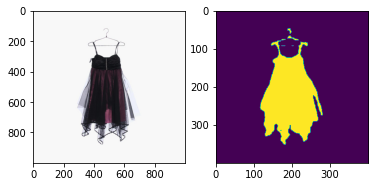

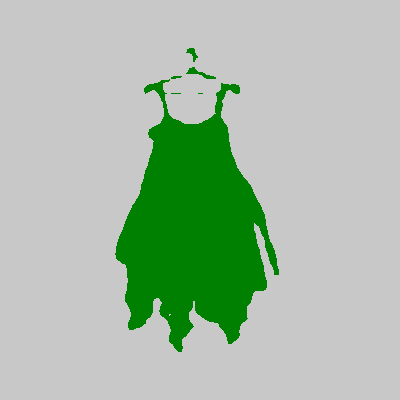

 51%|███████████████████████████████▎                             | 462/900 [01:13<01:16,  5.74it/s]

torch.Size([1, 3, 400, 400])
/mnt/nas4/hm/datasets/shopping_clothes/data/data900_personby100/top/image/train_16581.jpg
{'background': 0, 'top': 1, 'skirt': 2, 'outer': 3, 'dress': 4, 'bottom': 5}
Counter({0: 84272, 1: 75728})


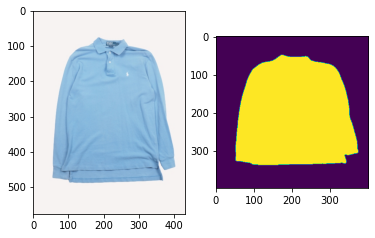

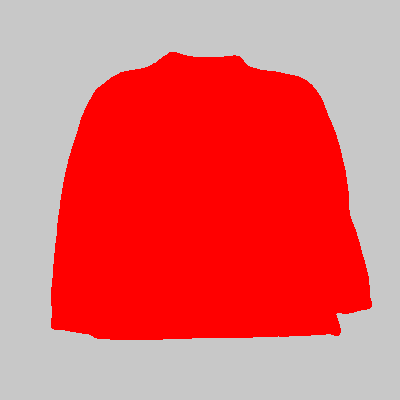

 51%|███████████████████████████████▍                             | 463/900 [01:13<01:12,  6.01it/s]

torch.Size([1, 3, 400, 400])
/mnt/nas4/hm/datasets/shopping_clothes/data/data900_personby100/dress/image/train_2938.jpg
{'background': 0, 'top': 1, 'skirt': 2, 'outer': 3, 'dress': 4, 'bottom': 5}
Counter({0: 107129, 4: 52871})


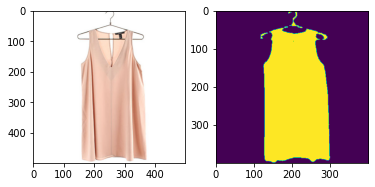

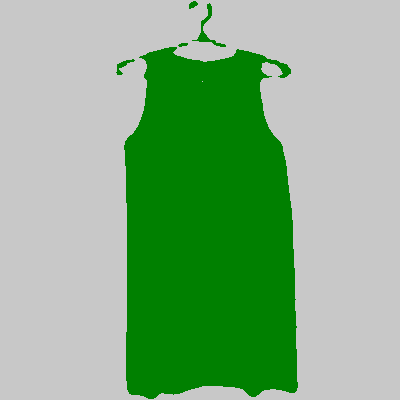

 52%|███████████████████████████████▍                             | 464/900 [01:13<01:09,  6.28it/s]

torch.Size([1, 3, 400, 400])
/mnt/nas4/hm/datasets/shopping_clothes/data/data900_personby100/dress/image/train_691.jpg
{'background': 0, 'top': 1, 'skirt': 2, 'outer': 3, 'dress': 4, 'bottom': 5}
Counter({0: 121976, 4: 38024})


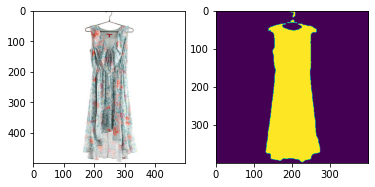

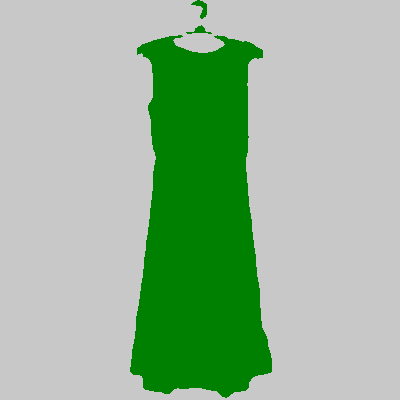

 52%|███████████████████████████████▌                             | 465/900 [01:13<01:06,  6.49it/s]

torch.Size([1, 3, 400, 400])
/mnt/nas4/hm/datasets/shopping_clothes/data/data900_personby100/dress/image/train_347.jpg
{'background': 0, 'top': 1, 'skirt': 2, 'outer': 3, 'dress': 4, 'bottom': 5}
Counter({0: 112902, 4: 47098})


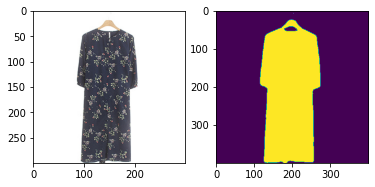

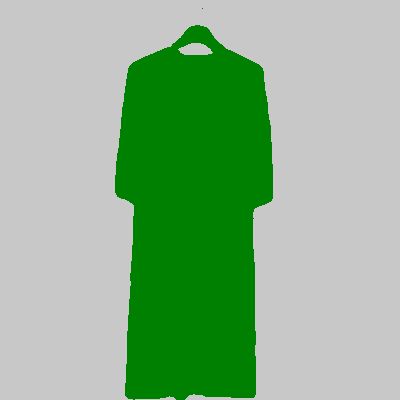

 52%|███████████████████████████████▌                             | 466/900 [01:13<01:04,  6.78it/s]

torch.Size([1, 3, 400, 400])
/mnt/nas4/hm/datasets/shopping_clothes/data/data900_personby100/top/image/train_810.jpg
{'background': 0, 'top': 1, 'skirt': 2, 'outer': 3, 'dress': 4, 'bottom': 5}
Counter({1: 84173, 0: 75827})


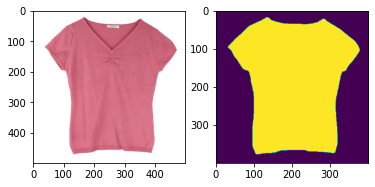

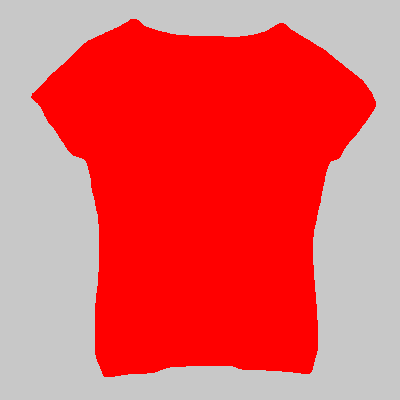

 52%|███████████████████████████████▋                             | 467/900 [01:13<01:04,  6.76it/s]

torch.Size([1, 3, 400, 400])
/mnt/nas4/hm/datasets/shopping_clothes/data/data900_personby100/outer/image/train_6870.jpg
{'background': 0, 'top': 1, 'skirt': 2, 'outer': 3, 'dress': 4, 'bottom': 5}
Counter({0: 96661, 3: 63339})


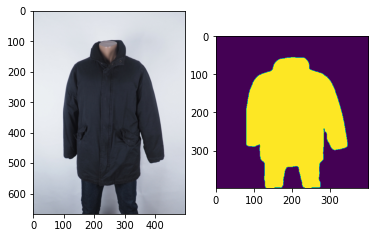

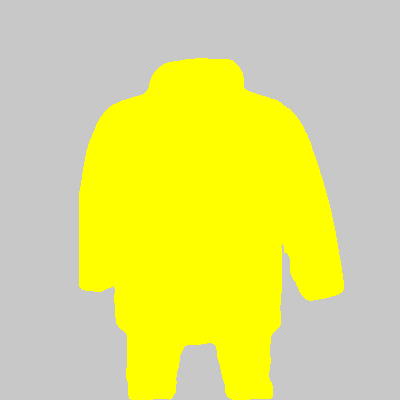

 52%|███████████████████████████████▋                             | 468/900 [01:14<01:06,  6.53it/s]

torch.Size([1, 3, 400, 400])
/mnt/nas4/hm/datasets/shopping_clothes/data/data900_personby100/top/image/train_3256.jpg
{'background': 0, 'top': 1, 'skirt': 2, 'outer': 3, 'dress': 4, 'bottom': 5}
Counter({0: 90225, 1: 69775})


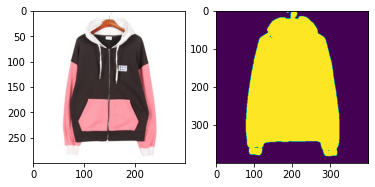

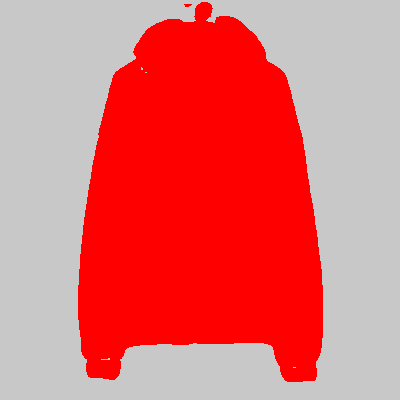

 52%|███████████████████████████████▊                             | 469/900 [01:14<01:03,  6.80it/s]

torch.Size([1, 3, 400, 400])
/mnt/nas4/hm/datasets/shopping_clothes/data/data900_personby100/dress/image/train_2718.jpg
{'background': 0, 'top': 1, 'skirt': 2, 'outer': 3, 'dress': 4, 'bottom': 5}
Counter({0: 119847, 4: 40153})


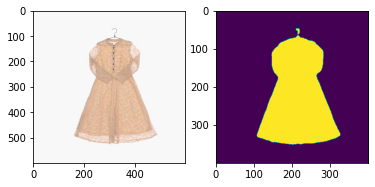

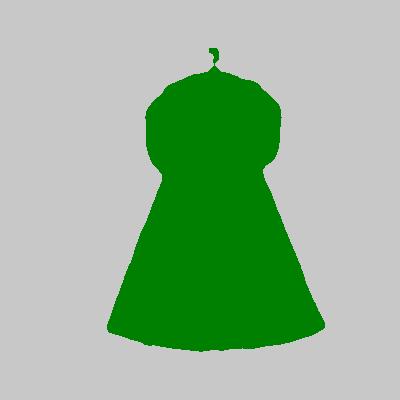

 52%|███████████████████████████████▊                             | 470/900 [01:14<01:11,  6.03it/s]

torch.Size([1, 3, 400, 400])
/mnt/nas4/hm/datasets/shopping_clothes/data/data900_personby100/skirt/image/train_193.jpg
{'background': 0, 'top': 1, 'skirt': 2, 'outer': 3, 'dress': 4, 'bottom': 5}
Counter({0: 90194, 2: 69806})


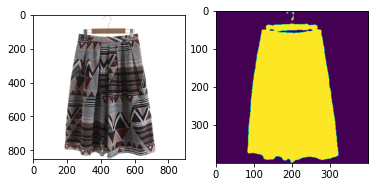

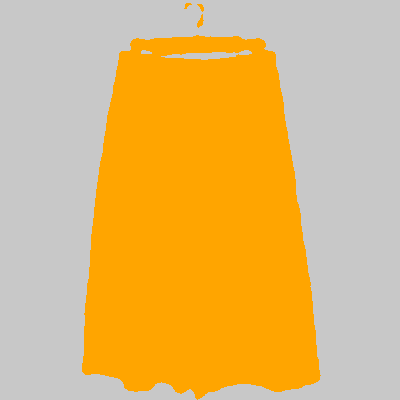

 52%|███████████████████████████████▉                             | 471/900 [01:14<01:13,  5.84it/s]

torch.Size([1, 3, 400, 400])
/mnt/nas4/hm/datasets/shopping_clothes/data/data900_personby100/dress/image/train_138.jpg
{'background': 0, 'top': 1, 'skirt': 2, 'outer': 3, 'dress': 4, 'bottom': 5}
Counter({0: 113377, 4: 46623})


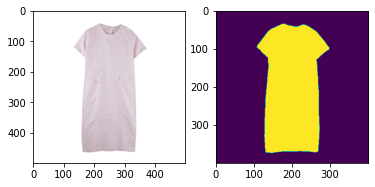

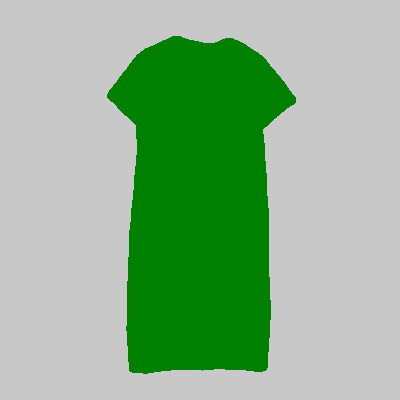

 52%|███████████████████████████████▉                             | 472/900 [01:14<01:10,  6.08it/s]

torch.Size([1, 3, 400, 400])
/mnt/nas4/hm/datasets/shopping_clothes/data/data900_personby100/skirt/image/train_2696.jpg
{'background': 0, 'top': 1, 'skirt': 2, 'outer': 3, 'dress': 4, 'bottom': 5}
Counter({2: 89714, 0: 70286})


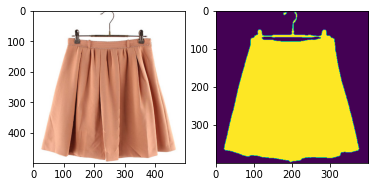

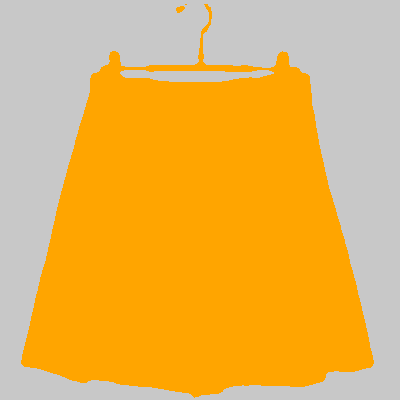

 53%|████████████████████████████████                             | 473/900 [01:14<01:07,  6.30it/s]

torch.Size([1, 3, 400, 400])
/mnt/nas4/hm/datasets/shopping_clothes/data/data900_personby100/outer/image/train_6080.jpg
{'background': 0, 'top': 1, 'skirt': 2, 'outer': 3, 'dress': 4, 'bottom': 5}
Counter({3: 85982, 0: 74018})


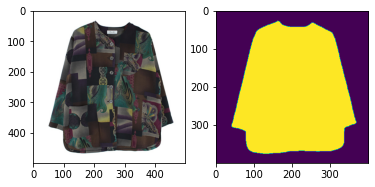

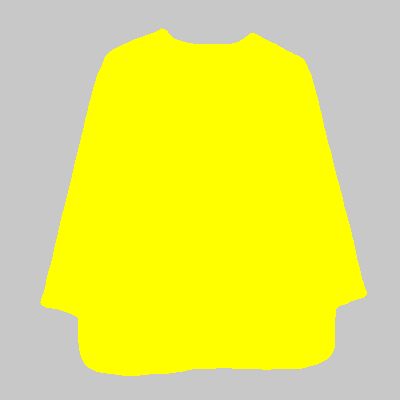

 53%|████████████████████████████████▏                            | 474/900 [01:15<01:06,  6.42it/s]

torch.Size([1, 3, 400, 400])
/mnt/nas4/hm/datasets/shopping_clothes/data/data900_personby100/skirt/image/train_2331.jpg
{'background': 0, 'top': 1, 'skirt': 2, 'outer': 3, 'dress': 4, 'bottom': 5}
Counter({0: 92527, 2: 67473})


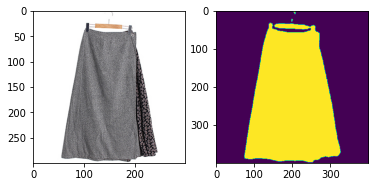

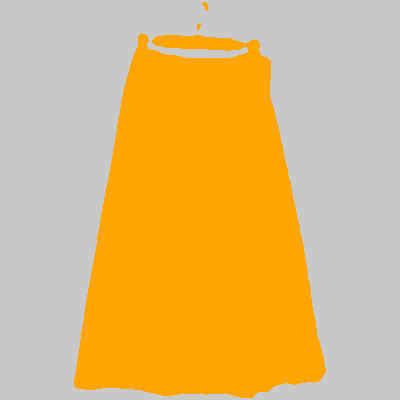

 53%|████████████████████████████████▏                            | 475/900 [01:15<01:03,  6.71it/s]

torch.Size([1, 3, 400, 400])
/mnt/nas4/hm/datasets/shopping_clothes/data/data900_personby100/outer/image/train_4328.jpg
{'background': 0, 'top': 1, 'skirt': 2, 'outer': 3, 'dress': 4, 'bottom': 5}
Counter({0: 83387, 3: 76613})


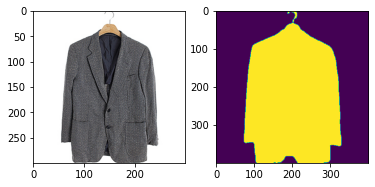

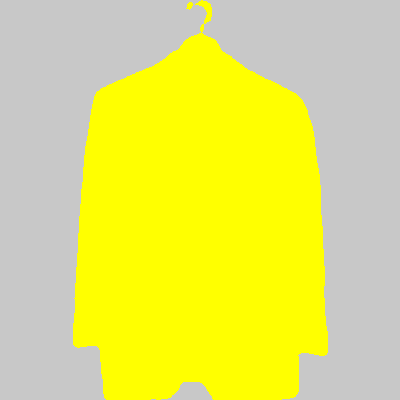

 53%|████████████████████████████████▎                            | 476/900 [01:15<01:01,  6.92it/s]

torch.Size([1, 3, 400, 400])
/mnt/nas4/hm/datasets/shopping_clothes/data/data900_personby100/bottom/image/train_2678.jpg
{'background': 0, 'top': 1, 'skirt': 2, 'outer': 3, 'dress': 4, 'bottom': 5}
Counter({0: 98635, 5: 61365})


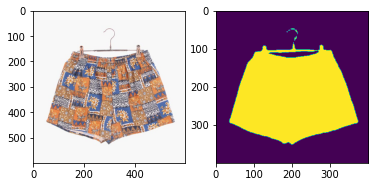

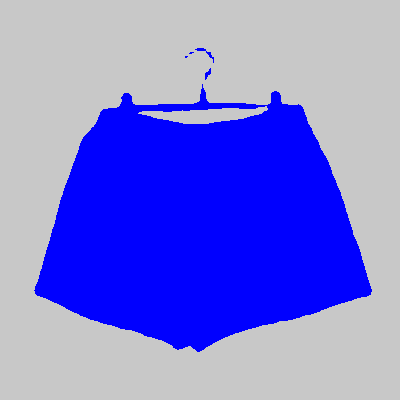

 53%|████████████████████████████████▎                            | 477/900 [01:15<01:02,  6.82it/s]

torch.Size([1, 3, 400, 400])
/mnt/nas4/hm/datasets/shopping_clothes/data/data900_personby100/bottom/image/train_1246.jpg
{'background': 0, 'top': 1, 'skirt': 2, 'outer': 3, 'dress': 4, 'bottom': 5}
Counter({0: 115126, 5: 44874})


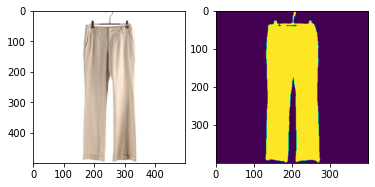

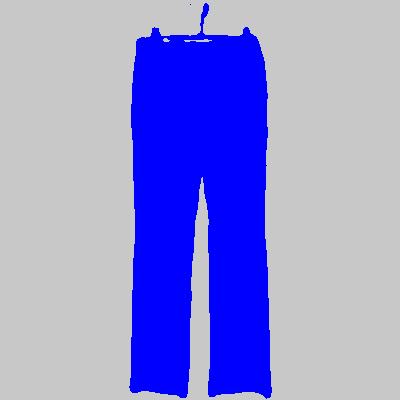

 53%|████████████████████████████████▍                            | 478/900 [01:15<01:01,  6.87it/s]

torch.Size([1, 3, 400, 400])
/mnt/nas4/hm/datasets/shopping_clothes/data/data900_personby100/dress/image/train_937.jpg
{'background': 0, 'top': 1, 'skirt': 2, 'outer': 3, 'dress': 4, 'bottom': 5}
Counter({0: 106979, 4: 53021})


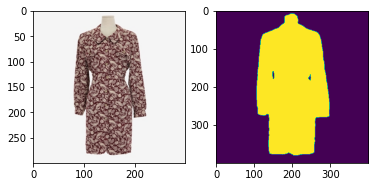

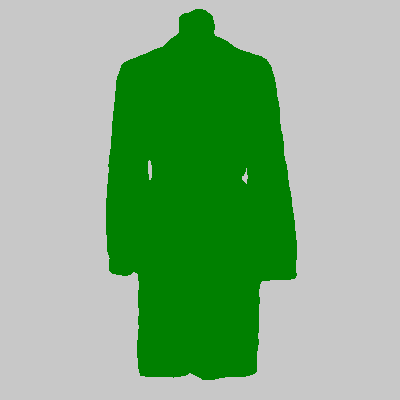

 53%|████████████████████████████████▍                            | 479/900 [01:15<00:59,  7.07it/s]

torch.Size([1, 3, 400, 400])
/mnt/nas4/hm/datasets/shopping_clothes/data/data900_personby100/outer/image/train_1133.jpg
{'background': 0, 'top': 1, 'skirt': 2, 'outer': 3, 'dress': 4, 'bottom': 5}
Counter({3: 80114, 0: 79886})


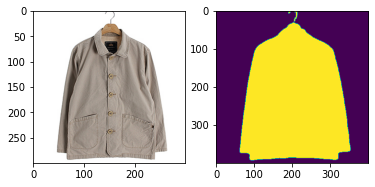

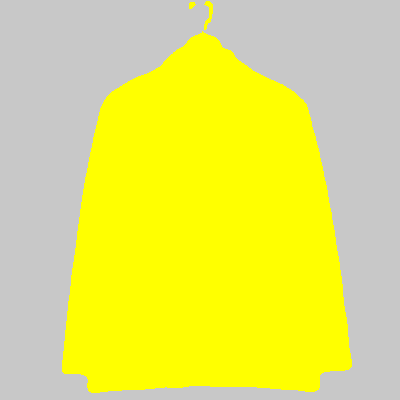

 53%|████████████████████████████████▌                            | 480/900 [01:15<00:58,  7.19it/s]

torch.Size([1, 3, 400, 400])
/mnt/nas4/hm/datasets/shopping_clothes/data/data900_personby100/top/image/train_14690.jpg
{'background': 0, 'top': 1, 'skirt': 2, 'outer': 3, 'dress': 4, 'bottom': 5}
Counter({1: 83495, 0: 76505})


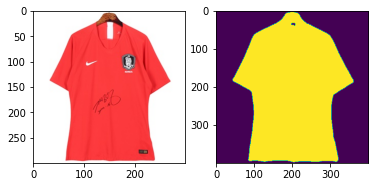

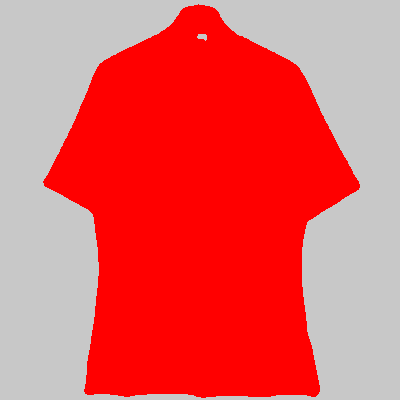

 53%|████████████████████████████████▌                            | 481/900 [01:16<01:04,  6.46it/s]

torch.Size([1, 3, 400, 400])
/mnt/nas4/hm/datasets/shopping_clothes/data/data900_personby100/bottom/image/train_1625.jpg
{'background': 0, 'top': 1, 'skirt': 2, 'outer': 3, 'dress': 4, 'bottom': 5}
Counter({5: 101162, 0: 58838})


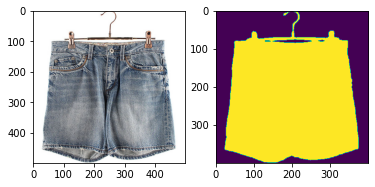

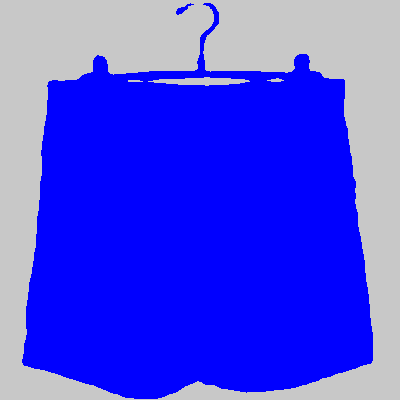

 54%|████████████████████████████████▋                            | 482/900 [01:16<01:03,  6.57it/s]

torch.Size([1, 3, 400, 400])
/mnt/nas4/hm/datasets/shopping_clothes/data/data900_personby100/skirt/image/train_772.jpg
{'background': 0, 'top': 1, 'skirt': 2, 'outer': 3, 'dress': 4, 'bottom': 5}
Counter({0: 97465, 2: 62535})


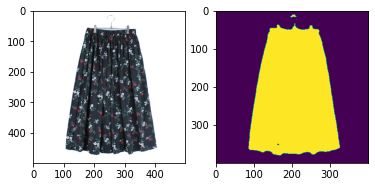

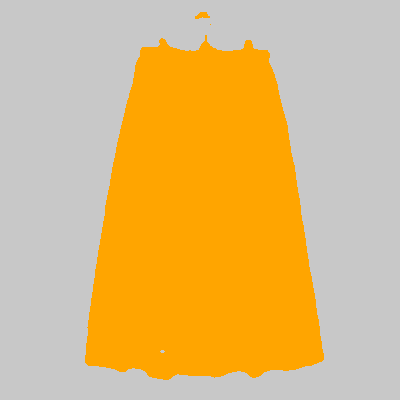

 54%|████████████████████████████████▋                            | 483/900 [01:16<01:03,  6.57it/s]

torch.Size([1, 3, 400, 400])
/mnt/nas4/hm/datasets/shopping_clothes/data/data900_personby100/top/image/train_763.jpg
{'background': 0, 'top': 1, 'skirt': 2, 'outer': 3, 'dress': 4, 'bottom': 5}
Counter({0: 85943, 1: 74057})


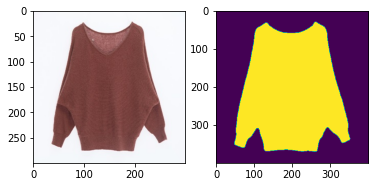

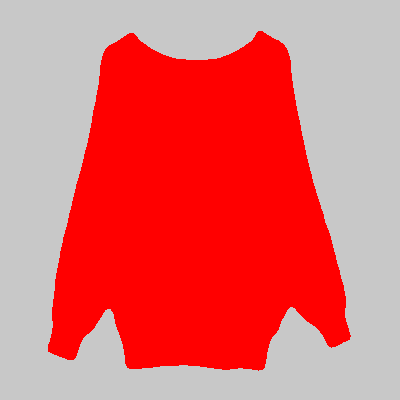

 54%|████████████████████████████████▊                            | 484/900 [01:16<01:00,  6.82it/s]

torch.Size([1, 3, 400, 400])
/mnt/nas4/hm/datasets/shopping_clothes/data/data900_personby100/top/image/train_17714.jpg
{'background': 0, 'top': 1, 'skirt': 2, 'outer': 3, 'dress': 4, 'bottom': 5}
Counter({1: 92592, 0: 67408})


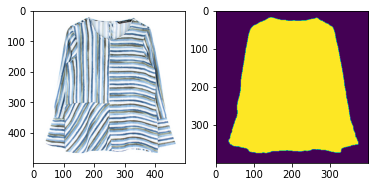

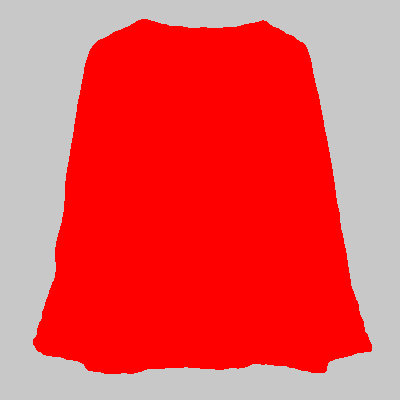

 54%|████████████████████████████████▊                            | 485/900 [01:16<01:01,  6.80it/s]

torch.Size([1, 3, 400, 400])
/mnt/nas4/hm/datasets/shopping_clothes/data/data900_personby100/dress/image/train_372.jpg
{'background': 0, 'top': 1, 'skirt': 2, 'outer': 3, 'dress': 4, 'bottom': 5}
Counter({0: 114640, 4: 45360})


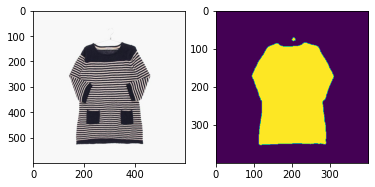

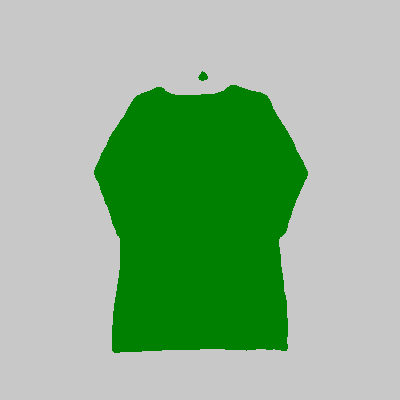

 54%|████████████████████████████████▉                            | 486/900 [01:16<01:01,  6.77it/s]

torch.Size([1, 3, 400, 400])
/mnt/nas4/hm/datasets/shopping_clothes/data/data900_personby100/top/image/train_5327.jpg
{'background': 0, 'top': 1, 'skirt': 2, 'outer': 3, 'dress': 4, 'bottom': 5}
Counter({0: 94209, 1: 65791})


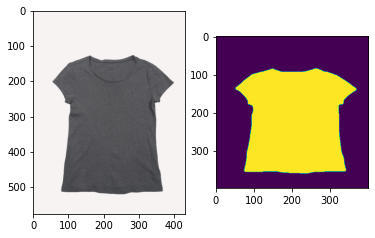

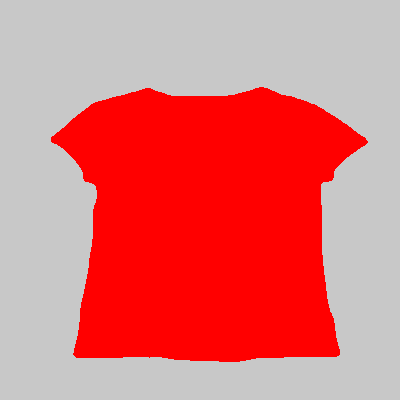

 54%|█████████████████████████████████                            | 487/900 [01:16<01:01,  6.76it/s]

torch.Size([1, 3, 400, 400])
/mnt/nas4/hm/datasets/shopping_clothes/data/data900_personby100/skirt/image/train_506.jpg
{'background': 0, 'top': 1, 'skirt': 2, 'outer': 3, 'dress': 4, 'bottom': 5}
Counter({0: 89405, 2: 70595})


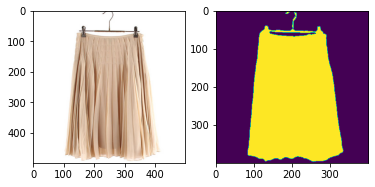

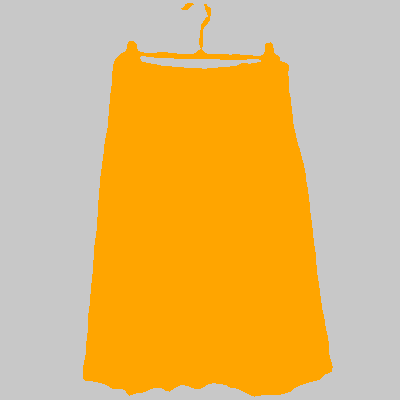

 54%|█████████████████████████████████                            | 488/900 [01:17<01:00,  6.81it/s]

torch.Size([1, 3, 400, 400])
/mnt/nas4/hm/datasets/shopping_clothes/data/data900_personby100/dress/image/train_109.jpg
{'background': 0, 'top': 1, 'skirt': 2, 'outer': 3, 'dress': 4, 'bottom': 5}
Counter({0: 116035, 4: 43965})


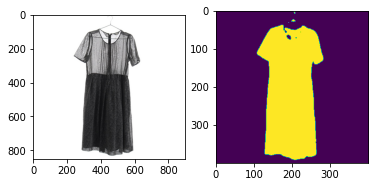

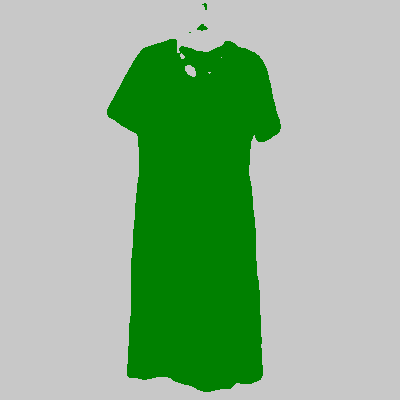

 54%|█████████████████████████████████▏                           | 489/900 [01:17<01:05,  6.28it/s]

torch.Size([1, 3, 400, 400])
/mnt/nas4/hm/datasets/shopping_clothes/data/data900_personby100/top/image/train_18433.jpg
{'background': 0, 'top': 1, 'skirt': 2, 'outer': 3, 'dress': 4, 'bottom': 5}
Counter({0: 103791, 1: 56209})


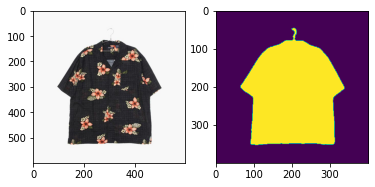

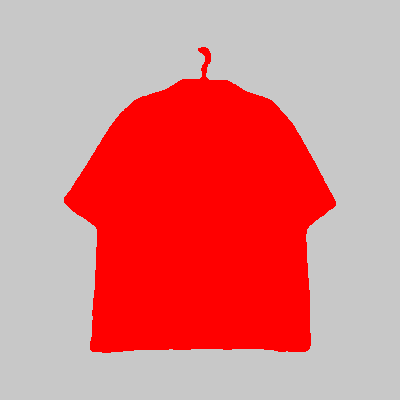

 54%|█████████████████████████████████▏                           | 490/900 [01:17<01:04,  6.38it/s]

torch.Size([1, 3, 400, 400])
/mnt/nas4/hm/datasets/shopping_clothes/data/data900_personby100/bottom/image/train_2171.jpg
{'background': 0, 'top': 1, 'skirt': 2, 'outer': 3, 'dress': 4, 'bottom': 5}
Counter({0: 110847, 5: 49153})


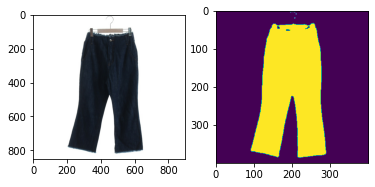

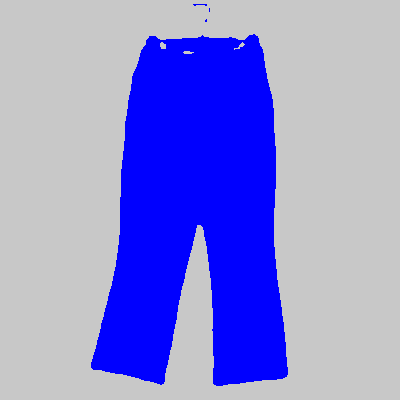

 55%|█████████████████████████████████▎                           | 491/900 [01:17<01:07,  6.06it/s]

torch.Size([1, 3, 400, 400])
/mnt/nas4/hm/datasets/shopping_clothes/data/data900_personby100/skirt/image/train_1665.jpg
{'background': 0, 'top': 1, 'skirt': 2, 'outer': 3, 'dress': 4, 'bottom': 5}
Counter({2: 104709, 0: 55291})


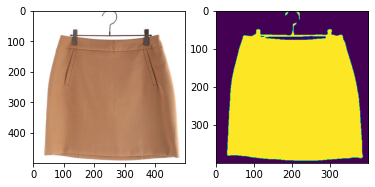

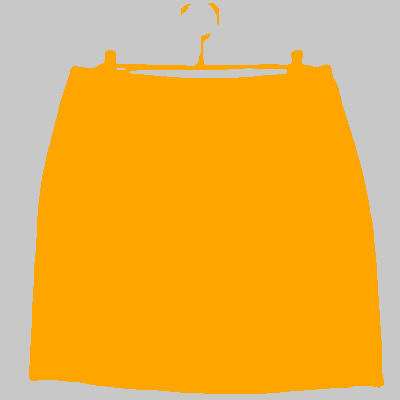

 55%|█████████████████████████████████▎                           | 492/900 [01:17<01:12,  5.65it/s]

torch.Size([1, 3, 400, 400])
/mnt/nas4/hm/datasets/shopping_clothes/data/data900_personby100/dress/image/train_1616.jpg
{'background': 0, 'top': 1, 'skirt': 2, 'outer': 3, 'dress': 4, 'bottom': 5}
Counter({0: 121275, 4: 38725})


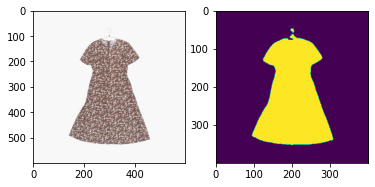

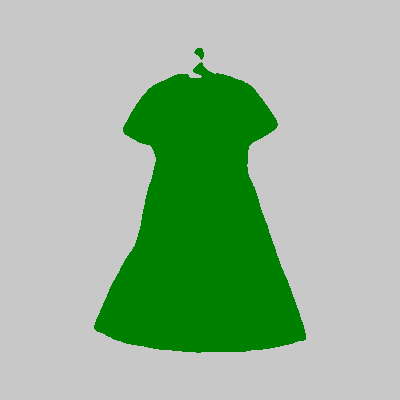

 55%|█████████████████████████████████▍                           | 493/900 [01:17<01:08,  5.92it/s]

torch.Size([1, 3, 400, 400])
/mnt/nas4/hm/datasets/shopping_clothes/data/data900_personby100/top/image/train_10961.jpg
{'background': 0, 'top': 1, 'skirt': 2, 'outer': 3, 'dress': 4, 'bottom': 5}
Counter({0: 118191, 1: 41809})


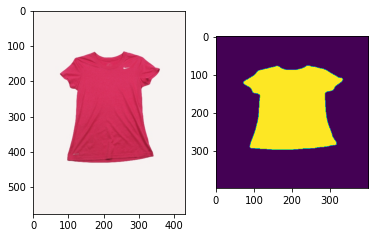

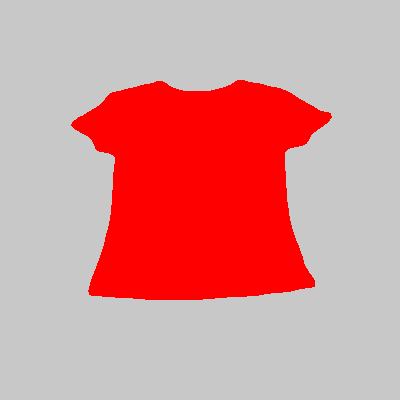

 55%|█████████████████████████████████▍                           | 494/900 [01:18<01:05,  6.15it/s]

torch.Size([1, 3, 400, 400])
/mnt/nas4/hm/datasets/shopping_clothes/data/data900_personby100/outer/image/train_6428.jpg
{'background': 0, 'top': 1, 'skirt': 2, 'outer': 3, 'dress': 4, 'bottom': 5}
Counter({0: 82266, 3: 77734})


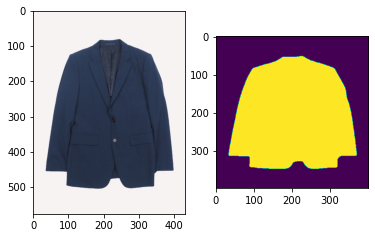

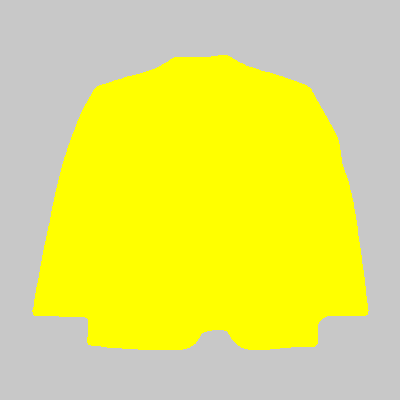

 55%|█████████████████████████████████▌                           | 495/900 [01:18<01:04,  6.32it/s]

torch.Size([1, 3, 400, 400])
/mnt/nas4/hm/datasets/shopping_clothes/data/data900_personby100/bottom/image/train_487.jpg
{'background': 0, 'top': 1, 'skirt': 2, 'outer': 3, 'dress': 4, 'bottom': 5}
Counter({0: 95951, 5: 64049})


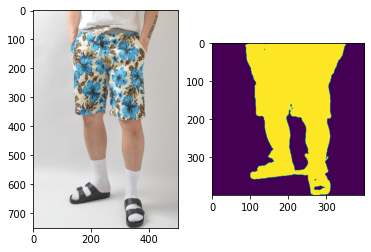

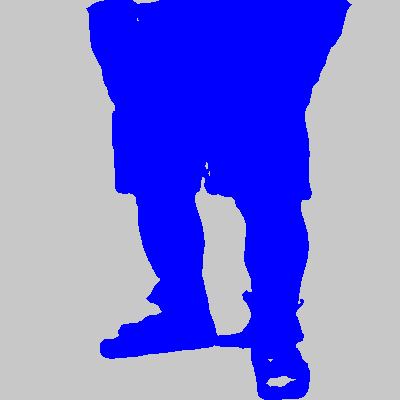

 55%|█████████████████████████████████▌                           | 496/900 [01:18<01:05,  6.21it/s]

torch.Size([1, 3, 400, 400])
/mnt/nas4/hm/datasets/shopping_clothes/data/data900_personby100/dress/image/train_546.jpg
{'background': 0, 'top': 1, 'skirt': 2, 'outer': 3, 'dress': 4, 'bottom': 5}
Counter({0: 104287, 4: 55713})


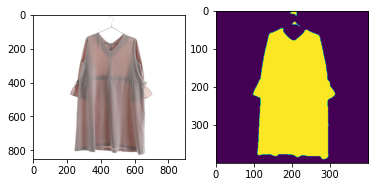

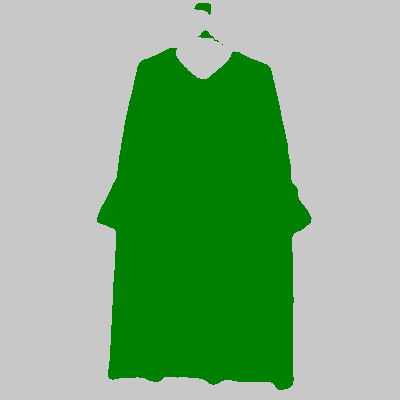

 55%|█████████████████████████████████▋                           | 497/900 [01:18<01:07,  5.96it/s]

torch.Size([1, 3, 400, 400])
/mnt/nas4/hm/datasets/shopping_clothes/data/data900_personby100/dress/image/train_3699.jpg
{'background': 0, 'top': 1, 'skirt': 2, 'outer': 3, 'dress': 4, 'bottom': 5}
Counter({0: 108290, 4: 51710})


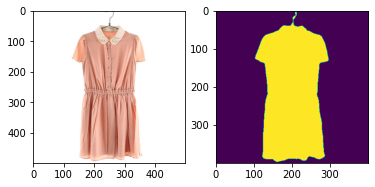

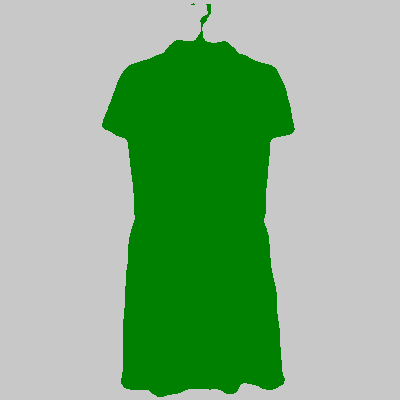

 55%|█████████████████████████████████▊                           | 498/900 [01:18<01:04,  6.23it/s]

torch.Size([1, 3, 400, 400])
/mnt/nas4/hm/datasets/shopping_clothes/data/data900_personby100/skirt/image/train_1861.jpg
{'background': 0, 'top': 1, 'skirt': 2, 'outer': 3, 'dress': 4, 'bottom': 5}
Counter({0: 81622, 2: 78378})


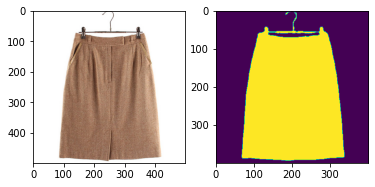

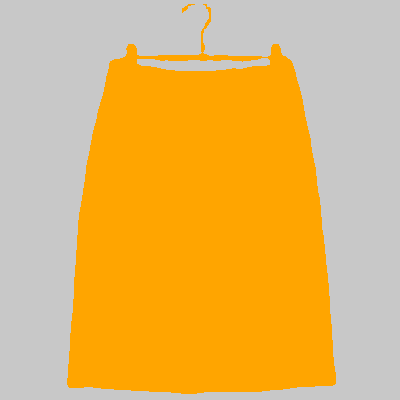

 55%|█████████████████████████████████▊                           | 499/900 [01:18<01:02,  6.41it/s]

torch.Size([1, 3, 400, 400])
/mnt/nas4/hm/datasets/shopping_clothes/data/data900_personby100/dress/image/train_1025.jpg
{'background': 0, 'top': 1, 'skirt': 2, 'outer': 3, 'dress': 4, 'bottom': 5}
Counter({0: 100927, 4: 59073})


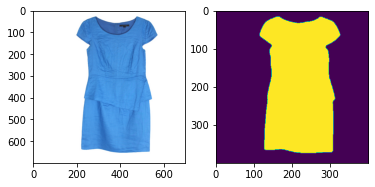

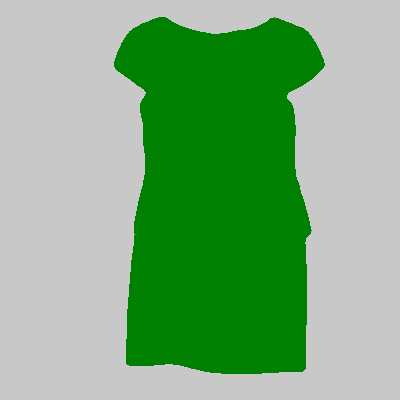

 56%|█████████████████████████████████▉                           | 500/900 [01:19<01:03,  6.27it/s]

torch.Size([1, 3, 400, 400])
/mnt/nas4/hm/datasets/shopping_clothes/data/data900_personby100/top/image/train_17306.jpg
{'background': 0, 'top': 1, 'skirt': 2, 'outer': 3, 'dress': 4, 'bottom': 5}
Counter({0: 113834, 1: 46166})


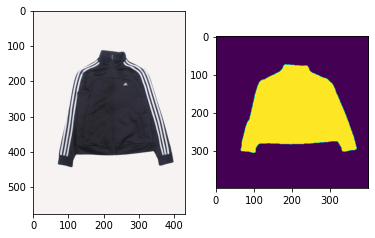

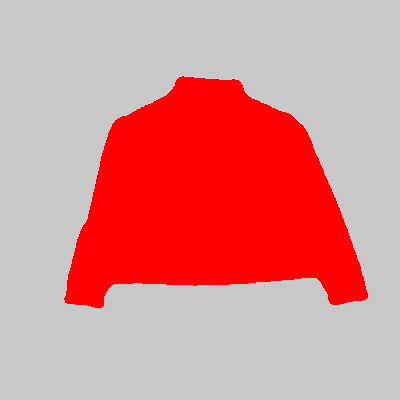

 56%|█████████████████████████████████▉                           | 501/900 [01:19<01:01,  6.44it/s]

torch.Size([1, 3, 400, 400])
/mnt/nas4/hm/datasets/shopping_clothes/data/data900_personby100/dress/image/train_1547.jpg
{'background': 0, 'top': 1, 'skirt': 2, 'outer': 3, 'dress': 4, 'bottom': 5}
Counter({0: 116422, 4: 43578})


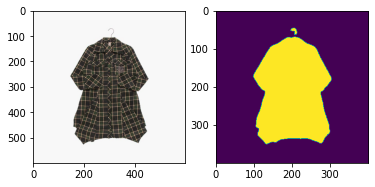

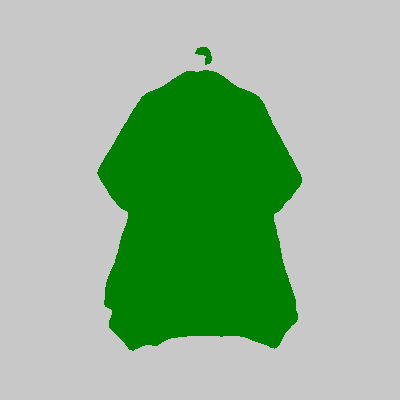

 56%|██████████████████████████████████                           | 502/900 [01:19<01:01,  6.51it/s]

torch.Size([1, 3, 400, 400])
/mnt/nas4/hm/datasets/shopping_clothes/data/data900_personby100/bottom/image/train_1967.jpg
{'background': 0, 'top': 1, 'skirt': 2, 'outer': 3, 'dress': 4, 'bottom': 5}
Counter({0: 100356, 5: 59644})


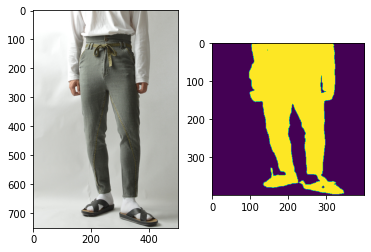

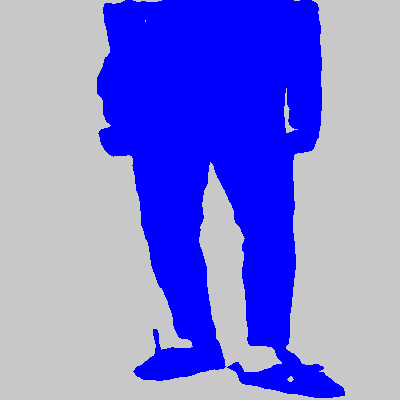

 56%|██████████████████████████████████                           | 503/900 [01:19<01:09,  5.69it/s]

torch.Size([1, 3, 400, 400])
/mnt/nas4/hm/datasets/shopping_clothes/data/data900_personby100/dress/image/train_3735.jpg
{'background': 0, 'top': 1, 'skirt': 2, 'outer': 3, 'dress': 4, 'bottom': 5}
Counter({0: 113440, 4: 46560})


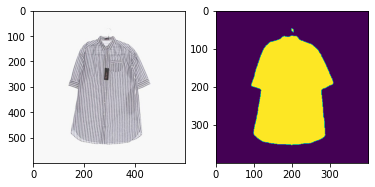

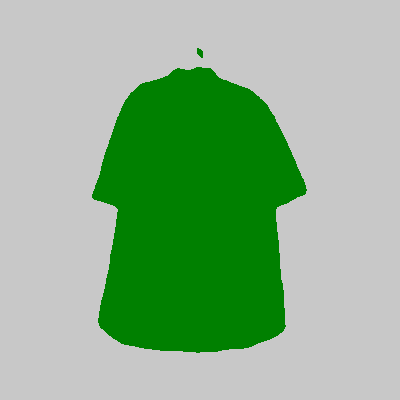

 56%|██████████████████████████████████▏                          | 504/900 [01:19<01:06,  5.96it/s]

torch.Size([1, 3, 400, 400])
/mnt/nas4/hm/datasets/shopping_clothes/data/data900_personby100/top/image/train_8259.jpg
{'background': 0, 'top': 1, 'skirt': 2, 'outer': 3, 'dress': 4, 'bottom': 5}
Counter({0: 91311, 1: 68689})


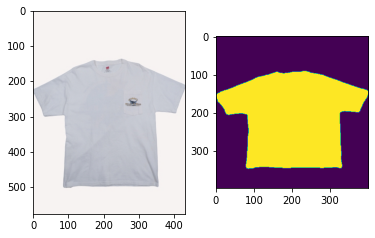

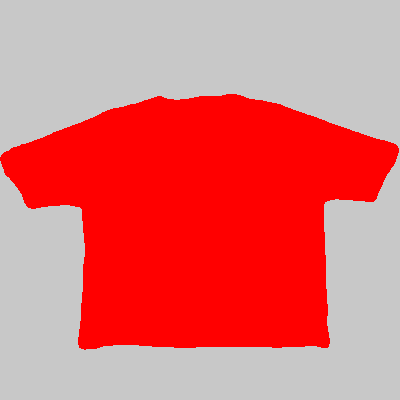

 56%|██████████████████████████████████▏                          | 505/900 [01:19<01:04,  6.16it/s]

torch.Size([1, 3, 400, 400])
/mnt/nas4/hm/datasets/shopping_clothes/data/data900_personby100/dress/image/train_2553.jpg
{'background': 0, 'top': 1, 'skirt': 2, 'outer': 3, 'dress': 4, 'bottom': 5}
Counter({0: 132823, 4: 27177})


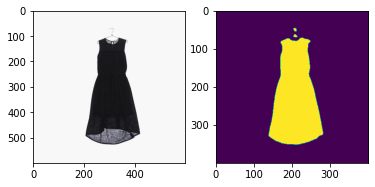

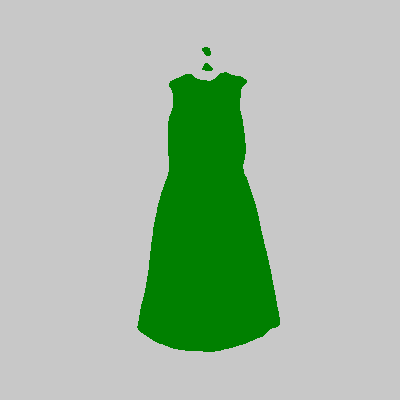

 56%|██████████████████████████████████▎                          | 506/900 [01:20<01:02,  6.30it/s]

torch.Size([1, 3, 400, 400])
/mnt/nas4/hm/datasets/shopping_clothes/data/data900_personby100/skirt/image/train_789.jpg
{'background': 0, 'top': 1, 'skirt': 2, 'outer': 3, 'dress': 4, 'bottom': 5}
Counter({0: 91311, 2: 68689})


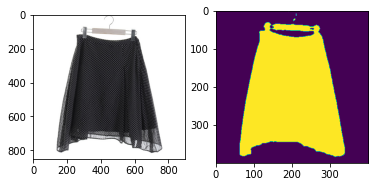

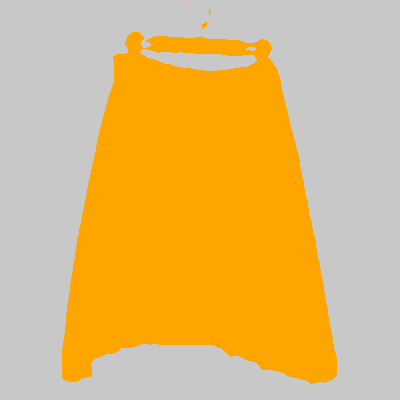

 56%|██████████████████████████████████▎                          | 507/900 [01:20<01:05,  5.98it/s]

torch.Size([1, 3, 400, 400])
/mnt/nas4/hm/datasets/shopping_clothes/data/data900_personby100/top/image/train_16110.jpg
{'background': 0, 'top': 1, 'skirt': 2, 'outer': 3, 'dress': 4, 'bottom': 5}
Counter({0: 83527, 1: 76473})


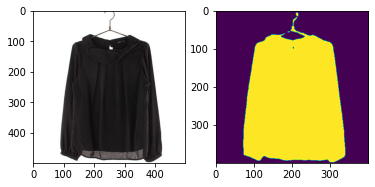

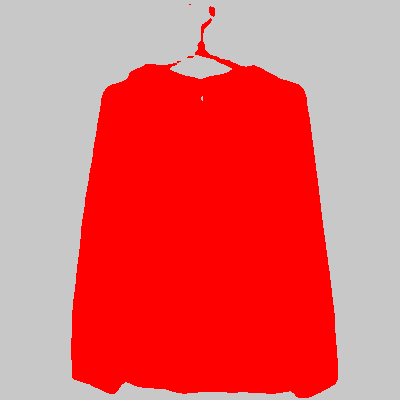

 56%|██████████████████████████████████▍                          | 508/900 [01:20<01:02,  6.23it/s]

torch.Size([1, 3, 400, 400])
/mnt/nas4/hm/datasets/shopping_clothes/data/data900_personby100/dress/image/train_301.jpg
{'background': 0, 'top': 1, 'skirt': 2, 'outer': 3, 'dress': 4, 'bottom': 5}
Counter({0: 115124, 4: 44876})


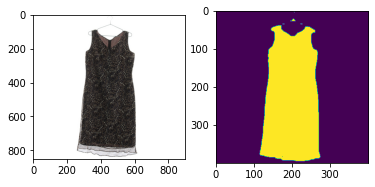

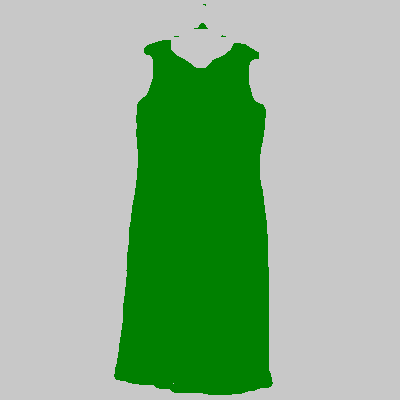

 57%|██████████████████████████████████▍                          | 509/900 [01:20<01:05,  5.96it/s]

torch.Size([1, 3, 400, 400])
/mnt/nas4/hm/datasets/shopping_clothes/data/data900_personby100/outer/image/train_11498.jpg
{'background': 0, 'top': 1, 'skirt': 2, 'outer': 3, 'dress': 4, 'bottom': 5}
Counter({3: 82393, 0: 77607})


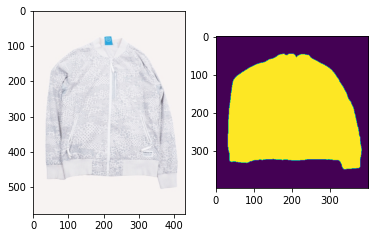

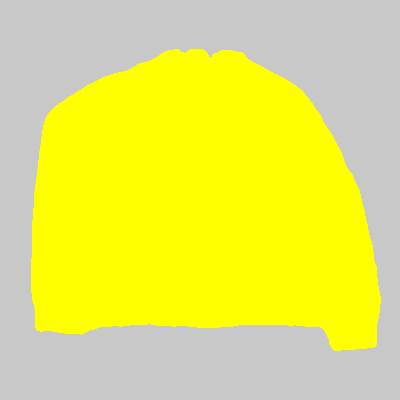

 57%|██████████████████████████████████▌                          | 510/900 [01:20<01:03,  6.17it/s]

torch.Size([1, 3, 400, 400])
/mnt/nas4/hm/datasets/shopping_clothes/data/data900_personby100/outer/image/train_5601.jpg
{'background': 0, 'top': 1, 'skirt': 2, 'outer': 3, 'dress': 4, 'bottom': 5}
Counter({3: 85818, 0: 74182})


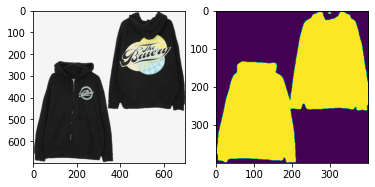

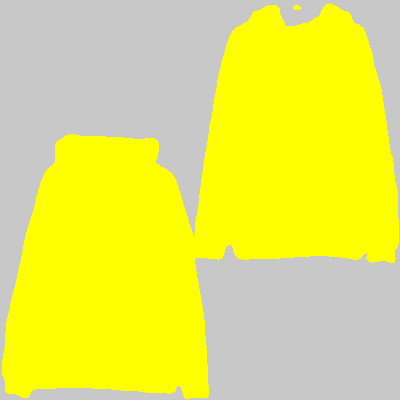

 57%|██████████████████████████████████▋                          | 511/900 [01:20<01:03,  6.13it/s]

torch.Size([1, 3, 400, 400])
/mnt/nas4/hm/datasets/shopping_clothes/data/data900_personby100/bottom/image/train_2360.jpg
{'background': 0, 'top': 1, 'skirt': 2, 'outer': 3, 'dress': 4, 'bottom': 5}
Counter({0: 114300, 5: 45700})


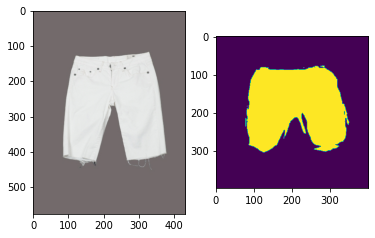

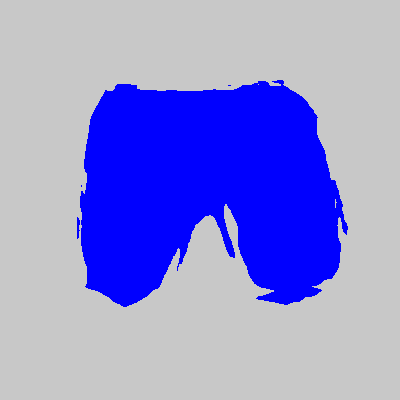

 57%|██████████████████████████████████▋                          | 512/900 [01:21<01:01,  6.32it/s]

torch.Size([1, 3, 400, 400])
/mnt/nas4/hm/datasets/shopping_clothes/data/data900_personby100/skirt/image/train_642.jpg
{'background': 0, 'top': 1, 'skirt': 2, 'outer': 3, 'dress': 4, 'bottom': 5}
Counter({0: 88109, 2: 71891})


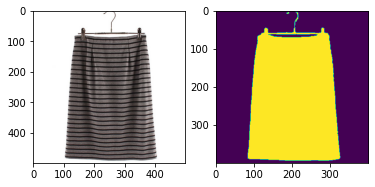

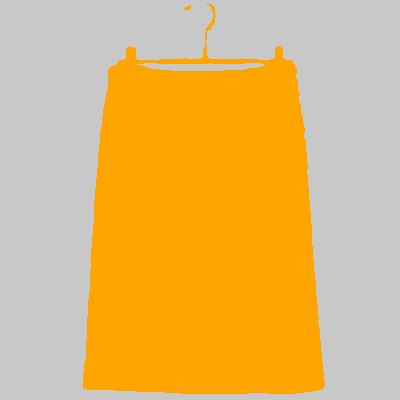

 57%|██████████████████████████████████▊                          | 513/900 [01:21<00:59,  6.49it/s]

torch.Size([1, 3, 400, 400])
/mnt/nas4/hm/datasets/shopping_clothes/data/data900_personby100/outer/image/train_4189.jpg
{'background': 0, 'top': 1, 'skirt': 2, 'outer': 3, 'dress': 4, 'bottom': 5}
Counter({0: 92771, 3: 67229})


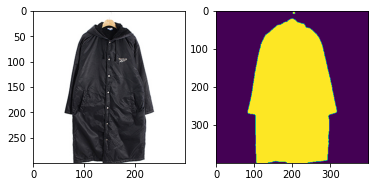

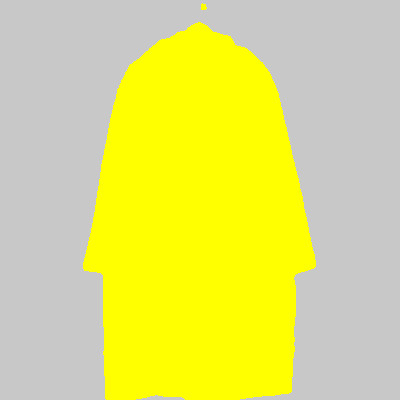

 57%|██████████████████████████████████▊                          | 514/900 [01:21<01:04,  6.01it/s]

torch.Size([1, 3, 400, 400])
/mnt/nas4/hm/datasets/shopping_clothes/data/data900_personby100/outer/image/train_2988.jpg
{'background': 0, 'top': 1, 'skirt': 2, 'outer': 3, 'dress': 4, 'bottom': 5}
Counter({0: 105886, 3: 54114})


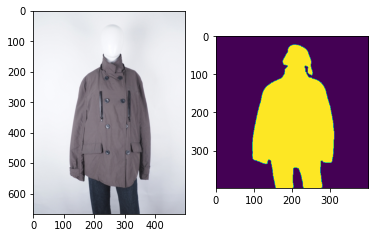

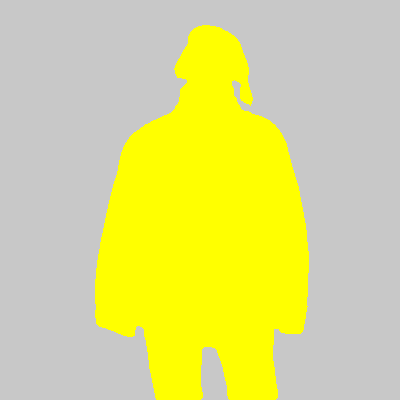

 57%|██████████████████████████████████▉                          | 515/900 [01:21<01:04,  6.01it/s]

torch.Size([1, 3, 400, 400])
/mnt/nas4/hm/datasets/shopping_clothes/data/data900_personby100/skirt/image/train_2132.jpg
{'background': 0, 'top': 1, 'skirt': 2, 'outer': 3, 'dress': 4, 'bottom': 5}
Counter({0: 86289, 2: 73711})


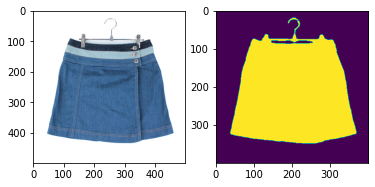

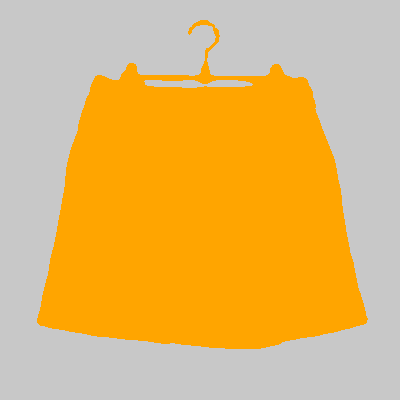

 57%|██████████████████████████████████▉                          | 516/900 [01:21<01:01,  6.21it/s]

torch.Size([1, 3, 400, 400])
/mnt/nas4/hm/datasets/shopping_clothes/data/data900_personby100/skirt/image/train_890.jpg
{'background': 0, 'top': 1, 'skirt': 2, 'outer': 3, 'dress': 4, 'bottom': 5}
Counter({0: 102759, 2: 57241})


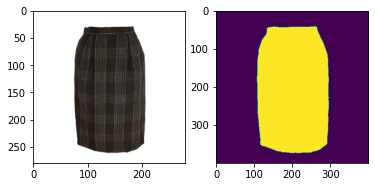

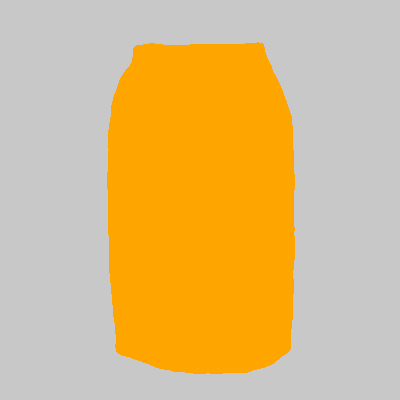

 57%|███████████████████████████████████                          | 517/900 [01:21<00:58,  6.57it/s]

torch.Size([1, 3, 400, 400])
/mnt/nas4/hm/datasets/shopping_clothes/data/data900_personby100/skirt/image/train_1916.jpg
{'background': 0, 'top': 1, 'skirt': 2, 'outer': 3, 'dress': 4, 'bottom': 5}
Counter({0: 86753, 2: 73247})


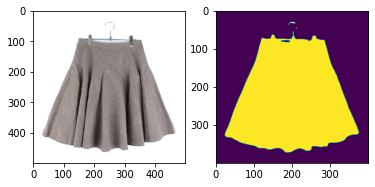

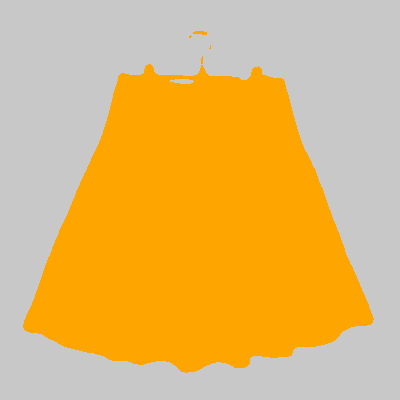

 58%|███████████████████████████████████                          | 518/900 [01:21<00:57,  6.64it/s]

torch.Size([1, 3, 400, 400])
/mnt/nas4/hm/datasets/shopping_clothes/data/data900_personby100/bottom/image/train_12.jpg
{'background': 0, 'top': 1, 'skirt': 2, 'outer': 3, 'dress': 4, 'bottom': 5}
Counter({0: 117447, 5: 42553})


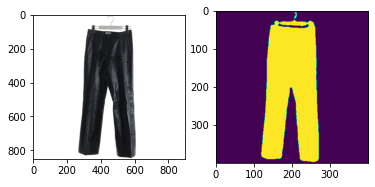

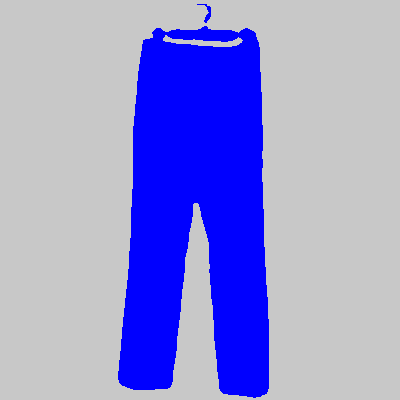

 58%|███████████████████████████████████▏                         | 519/900 [01:22<01:00,  6.25it/s]

torch.Size([1, 3, 400, 400])
/mnt/nas4/hm/datasets/shopping_clothes/data/data900_personby100/bottom/image/train_1821.jpg
{'background': 0, 'top': 1, 'skirt': 2, 'outer': 3, 'dress': 4, 'bottom': 5}
Counter({0: 111053, 5: 48947})


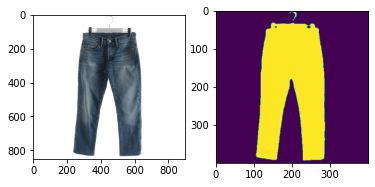

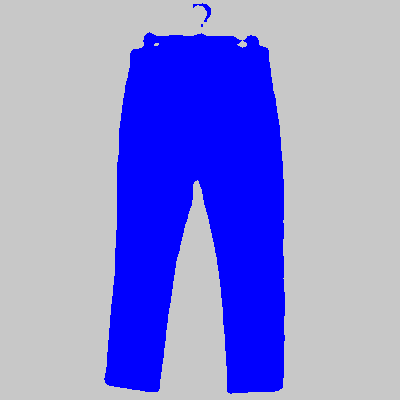

 58%|███████████████████████████████████▏                         | 520/900 [01:22<01:03,  5.96it/s]

torch.Size([1, 3, 400, 400])
/mnt/nas4/hm/datasets/shopping_clothes/data/data900_personby100/outer/image/train_8695.jpg
{'background': 0, 'top': 1, 'skirt': 2, 'outer': 3, 'dress': 4, 'bottom': 5}
Counter({0: 107579, 3: 52421})


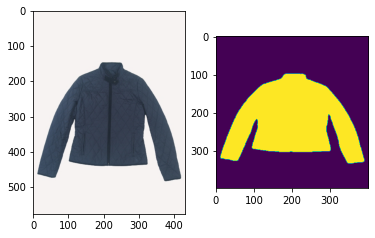

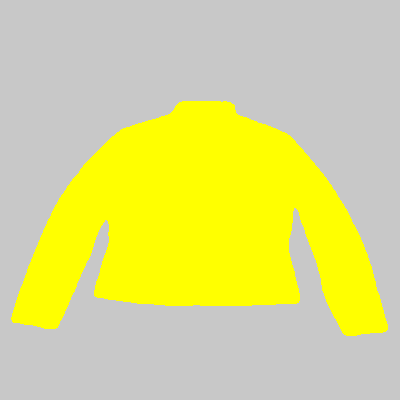

 58%|███████████████████████████████████▎                         | 521/900 [01:22<01:01,  6.18it/s]

torch.Size([1, 3, 400, 400])
/mnt/nas4/hm/datasets/shopping_clothes/data/data900_personby100/bottom/image/train_1833.jpg
{'background': 0, 'top': 1, 'skirt': 2, 'outer': 3, 'dress': 4, 'bottom': 5}
Counter({0: 82260, 5: 77740})


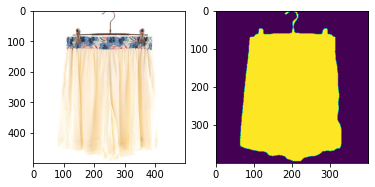

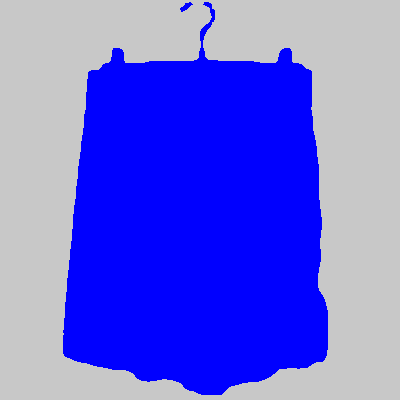

 58%|███████████████████████████████████▍                         | 522/900 [01:22<00:59,  6.38it/s]

torch.Size([1, 3, 400, 400])
/mnt/nas4/hm/datasets/shopping_clothes/data/data900_personby100/top/image/train_13201.jpg
{'background': 0, 'top': 1, 'skirt': 2, 'outer': 3, 'dress': 4, 'bottom': 5}
Counter({0: 101013, 1: 58987})


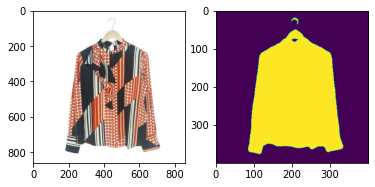

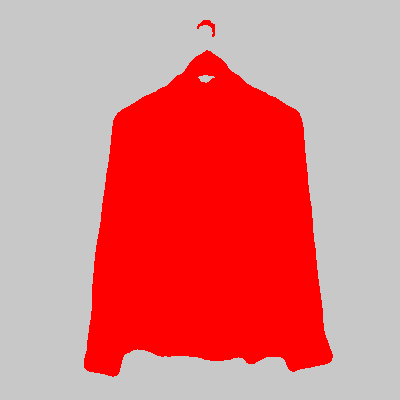

 58%|███████████████████████████████████▍                         | 523/900 [01:22<01:01,  6.12it/s]

torch.Size([1, 3, 400, 400])
/mnt/nas4/hm/datasets/shopping_clothes/data/data900_personby100/bottom/image/train_300.jpg
{'background': 0, 'top': 1, 'skirt': 2, 'outer': 3, 'dress': 4, 'bottom': 5}
Counter({5: 91235, 0: 68765})


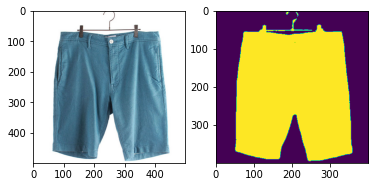

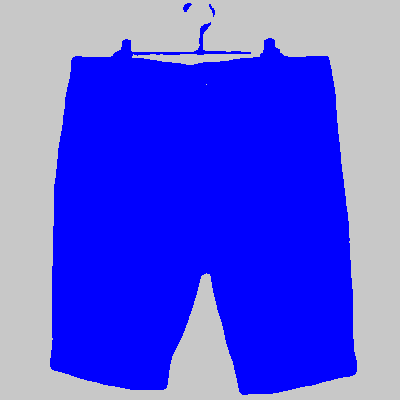

 58%|███████████████████████████████████▌                         | 524/900 [01:22<00:59,  6.31it/s]

torch.Size([1, 3, 400, 400])
/mnt/nas4/hm/datasets/shopping_clothes/data/data900_personby100/dress/image/train_3209.jpg
{'background': 0, 'top': 1, 'skirt': 2, 'outer': 3, 'dress': 4, 'bottom': 5}
Counter({0: 122747, 4: 37253})


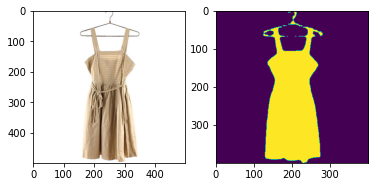

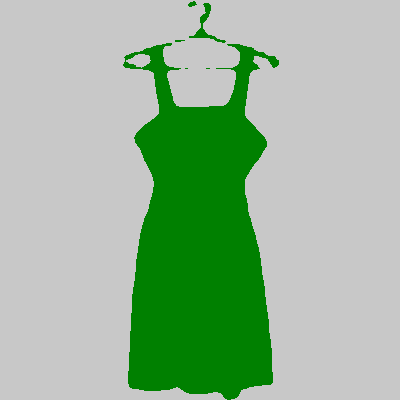

 58%|███████████████████████████████████▌                         | 525/900 [01:23<01:04,  5.81it/s]

torch.Size([1, 3, 400, 400])
/mnt/nas4/hm/datasets/shopping_clothes/data/data900_personby100/top/image/train_4162.jpg
{'background': 0, 'top': 1, 'skirt': 2, 'outer': 3, 'dress': 4, 'bottom': 5}
Counter({0: 98263, 1: 61737})


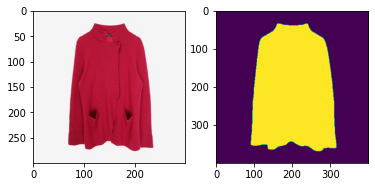

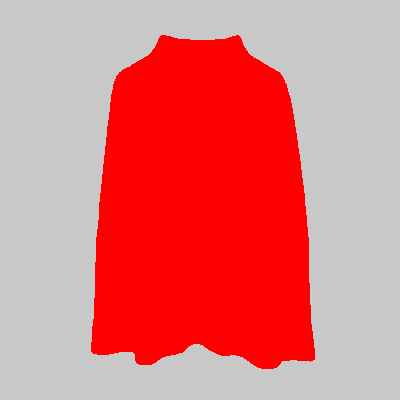

 58%|███████████████████████████████████▋                         | 526/900 [01:23<01:00,  6.23it/s]

torch.Size([1, 3, 400, 400])
/mnt/nas4/hm/datasets/shopping_clothes/data/data900_personby100/outer/image/train_1769.jpg
{'background': 0, 'top': 1, 'skirt': 2, 'outer': 3, 'dress': 4, 'bottom': 5}
Counter({0: 105229, 3: 54771})


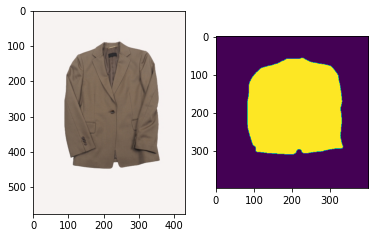

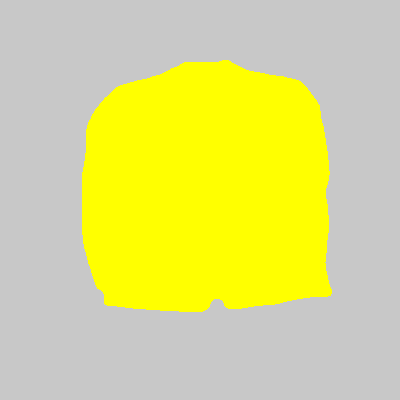

 59%|███████████████████████████████████▋                         | 527/900 [01:23<00:58,  6.39it/s]

torch.Size([1, 3, 400, 400])
/mnt/nas4/hm/datasets/shopping_clothes/data/data900_personby100/dress/image/train_2463.jpg
{'background': 0, 'top': 1, 'skirt': 2, 'outer': 3, 'dress': 4, 'bottom': 5}
Counter({0: 126241, 4: 33759})


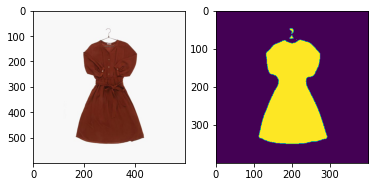

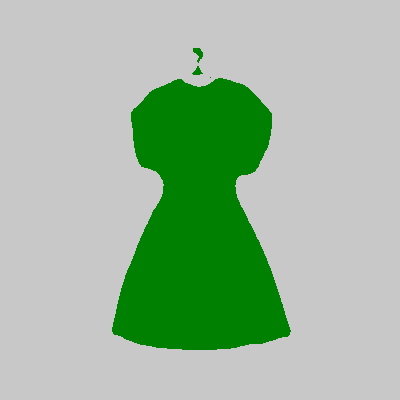

 59%|███████████████████████████████████▊                         | 528/900 [01:23<00:57,  6.45it/s]

torch.Size([1, 3, 400, 400])
/mnt/nas4/hm/datasets/shopping_clothes/data/data900_personby100/dress/image/train_1538.jpg
{'background': 0, 'top': 1, 'skirt': 2, 'outer': 3, 'dress': 4, 'bottom': 5}
Counter({0: 125771, 4: 34229})


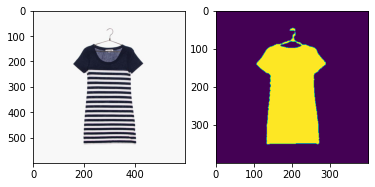

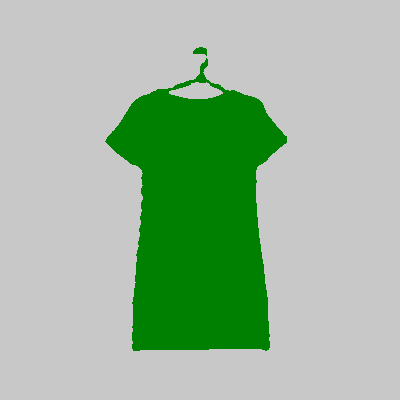

 59%|███████████████████████████████████▊                         | 529/900 [01:23<00:56,  6.52it/s]

torch.Size([1, 3, 400, 400])
/mnt/nas4/hm/datasets/shopping_clothes/data/data900_personby100/bottom/image/train_2322.jpg
{'background': 0, 'top': 1, 'skirt': 2, 'outer': 3, 'dress': 4, 'bottom': 5}
Counter({5: 107560, 0: 52440})


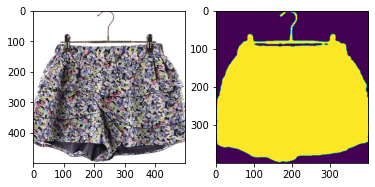

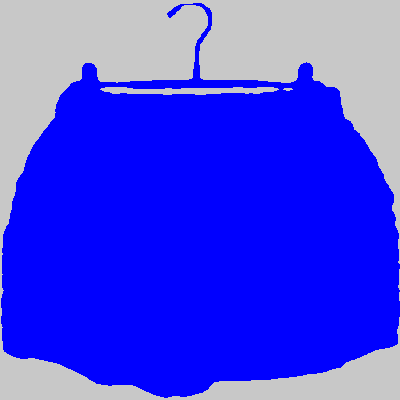

 59%|███████████████████████████████████▉                         | 530/900 [01:23<00:55,  6.61it/s]

torch.Size([1, 3, 400, 400])
/mnt/nas4/hm/datasets/shopping_clothes/data/data900_personby100/skirt/image/train_640.jpg
{'background': 0, 'top': 1, 'skirt': 2, 'outer': 3, 'dress': 4, 'bottom': 5}
Counter({0: 100337, 2: 59663})


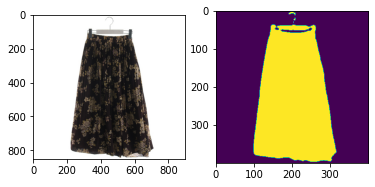

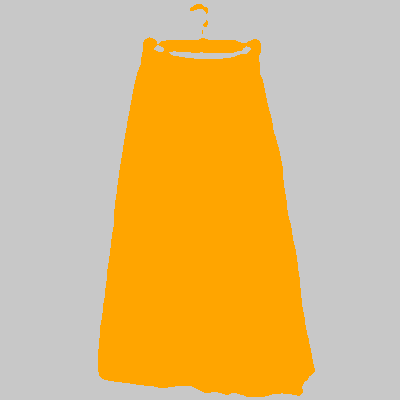

 59%|███████████████████████████████████▉                         | 531/900 [01:24<00:59,  6.17it/s]

torch.Size([1, 3, 400, 400])
/mnt/nas4/hm/datasets/shopping_clothes/data/data900_personby100/top/image/train_3916.jpg
{'background': 0, 'top': 1, 'skirt': 2, 'outer': 3, 'dress': 4, 'bottom': 5}
Counter({0: 107258, 1: 52742})


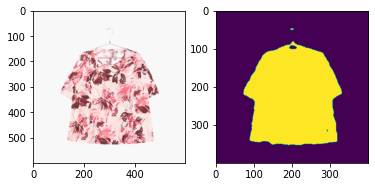

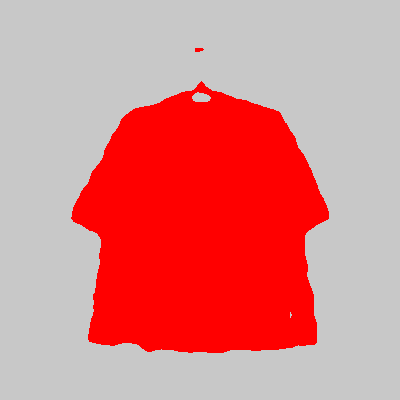

 59%|████████████████████████████████████                         | 532/900 [01:24<00:58,  6.28it/s]

torch.Size([1, 3, 400, 400])
/mnt/nas4/hm/datasets/shopping_clothes/data/data900_personby100/dress/image/train_2215.jpg
{'background': 0, 'top': 1, 'skirt': 2, 'outer': 3, 'dress': 4, 'bottom': 5}
Counter({0: 119791, 4: 40209})


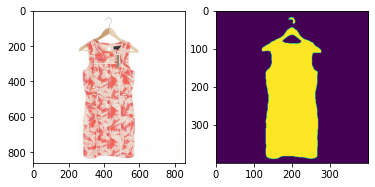

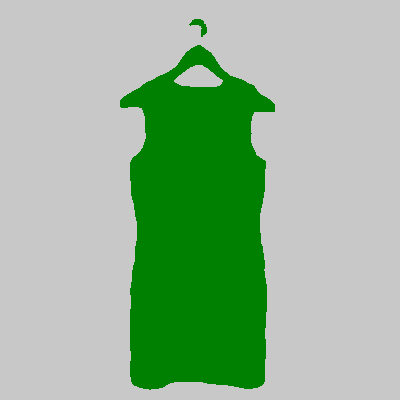

 59%|████████████████████████████████████▏                        | 533/900 [01:24<01:00,  6.05it/s]

torch.Size([1, 3, 400, 400])
/mnt/nas4/hm/datasets/shopping_clothes/data/data900_personby100/top/image/train_15234.jpg
{'background': 0, 'top': 1, 'skirt': 2, 'outer': 3, 'dress': 4, 'bottom': 5}
Counter({0: 89868, 1: 70132})


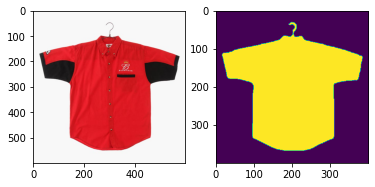

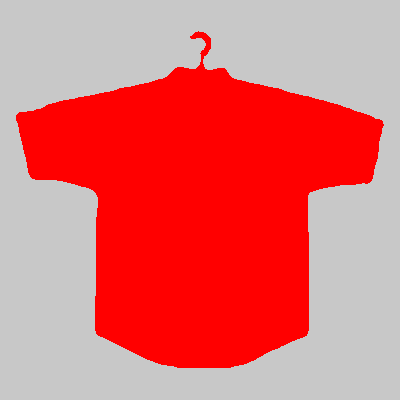

 59%|████████████████████████████████████▏                        | 534/900 [01:24<00:58,  6.21it/s]

torch.Size([1, 3, 400, 400])
/mnt/nas4/hm/datasets/shopping_clothes/data/data900_personby100/skirt/image/train_1781.jpg
{'background': 0, 'top': 1, 'skirt': 2, 'outer': 3, 'dress': 4, 'bottom': 5}
Counter({0: 94108, 2: 65892})


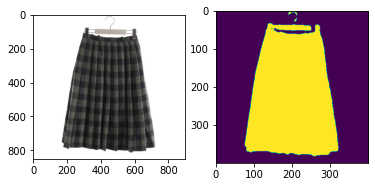

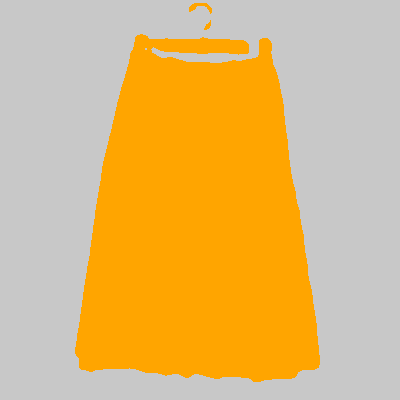

 59%|████████████████████████████████████▎                        | 535/900 [01:24<01:01,  5.92it/s]

torch.Size([1, 3, 400, 400])
/mnt/nas4/hm/datasets/shopping_clothes/data/data900_personby100/bottom/image/train_2856.jpg
{'background': 0, 'top': 1, 'skirt': 2, 'outer': 3, 'dress': 4, 'bottom': 5}
Counter({0: 125066, 5: 34934})


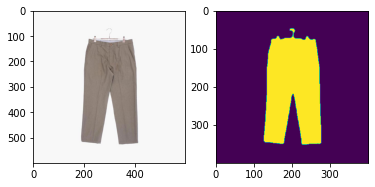

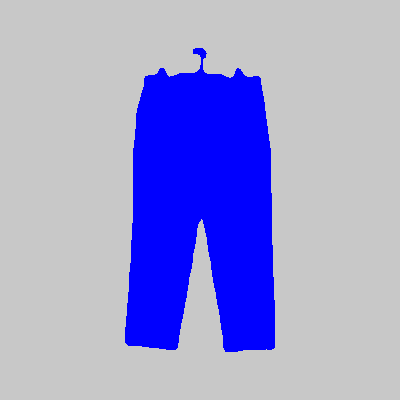

 60%|████████████████████████████████████▎                        | 536/900 [01:24<01:05,  5.53it/s]

torch.Size([1, 3, 400, 400])
/mnt/nas4/hm/datasets/shopping_clothes/data/data900_personby100/bottom/image/train_1884.jpg
{'background': 0, 'top': 1, 'skirt': 2, 'outer': 3, 'dress': 4, 'bottom': 5}
Counter({0: 95502, 5: 64498})


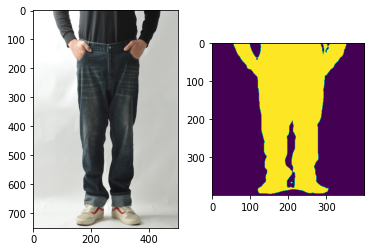

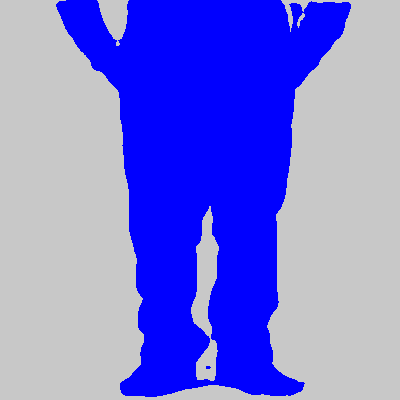

 60%|████████████████████████████████████▍                        | 537/900 [01:25<01:04,  5.65it/s]

torch.Size([1, 3, 400, 400])
/mnt/nas4/hm/datasets/shopping_clothes/data/data900_personby100/top/image/train_2551.jpg
{'background': 0, 'top': 1, 'skirt': 2, 'outer': 3, 'dress': 4, 'bottom': 5}
Counter({0: 93203, 1: 66797})


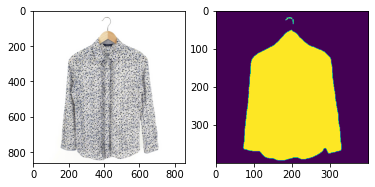

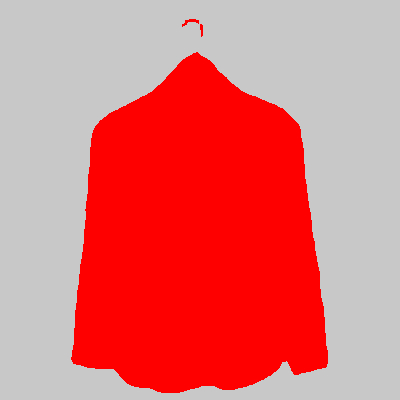

 60%|████████████████████████████████████▍                        | 538/900 [01:25<01:04,  5.60it/s]

torch.Size([1, 3, 400, 400])
/mnt/nas4/hm/datasets/shopping_clothes/data/data900_personby100/skirt/image/train_966.jpg
{'background': 0, 'top': 1, 'skirt': 2, 'outer': 3, 'dress': 4, 'bottom': 5}
Counter({0: 115263, 2: 44737})


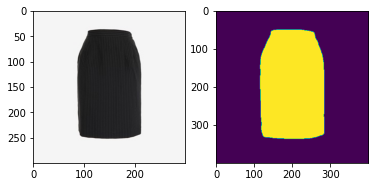

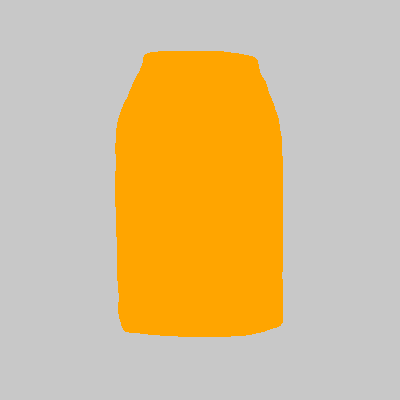

 60%|████████████████████████████████████▌                        | 539/900 [01:25<00:59,  6.09it/s]

torch.Size([1, 3, 400, 400])
/mnt/nas4/hm/datasets/shopping_clothes/data/data900_personby100/outer/image/train_11512.jpg
{'background': 0, 'top': 1, 'skirt': 2, 'outer': 3, 'dress': 4, 'bottom': 5}
Counter({0: 99718, 3: 60282})


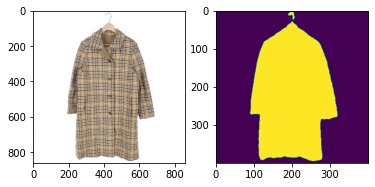

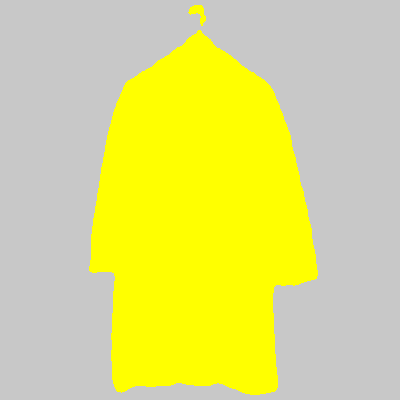

 60%|████████████████████████████████████▌                        | 540/900 [01:25<01:00,  5.92it/s]

torch.Size([1, 3, 400, 400])
/mnt/nas4/hm/datasets/shopping_clothes/data/data900_personby100/top/image/train_8860.jpg
{'background': 0, 'top': 1, 'skirt': 2, 'outer': 3, 'dress': 4, 'bottom': 5}
Counter({0: 109996, 1: 50004})


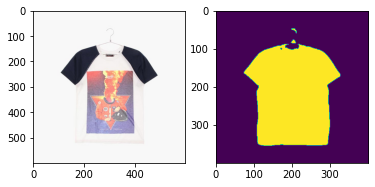

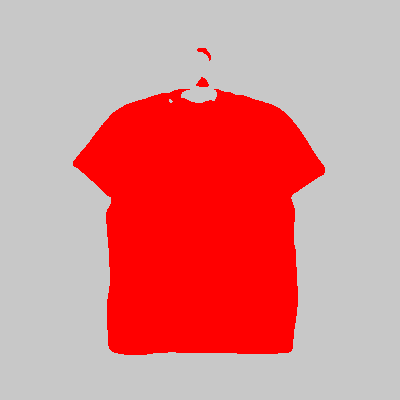

 60%|████████████████████████████████████▋                        | 541/900 [01:25<00:58,  6.12it/s]

torch.Size([1, 3, 400, 400])
/mnt/nas4/hm/datasets/shopping_clothes/data/data900_personby100/dress/image/train_1533.jpg
{'background': 0, 'top': 1, 'skirt': 2, 'outer': 3, 'dress': 4, 'bottom': 5}
Counter({0: 117776, 4: 42224})


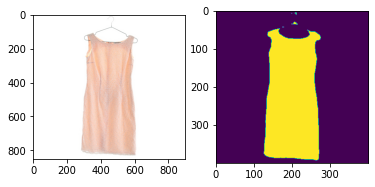

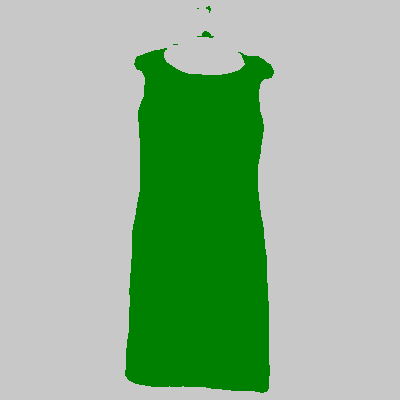

 60%|████████████████████████████████████▋                        | 542/900 [01:25<01:00,  5.88it/s]

torch.Size([1, 3, 400, 400])
/mnt/nas4/hm/datasets/shopping_clothes/data/data900_personby100/outer/image/train_1995.jpg
{'background': 0, 'top': 1, 'skirt': 2, 'outer': 3, 'dress': 4, 'bottom': 5}
Counter({0: 86198, 3: 73802})


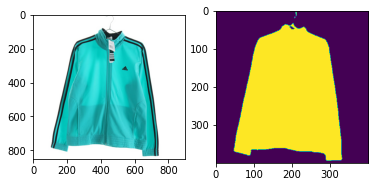

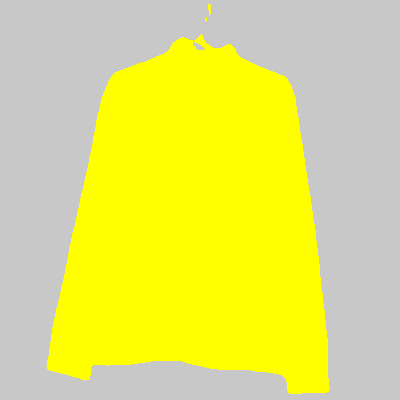

 60%|████████████████████████████████████▊                        | 543/900 [01:26<01:02,  5.70it/s]

torch.Size([1, 3, 400, 400])
/mnt/nas4/hm/datasets/shopping_clothes/data/data900_personby100/skirt/image/train_2568.jpg
{'background': 0, 'top': 1, 'skirt': 2, 'outer': 3, 'dress': 4, 'bottom': 5}
Counter({0: 100041, 2: 59959})


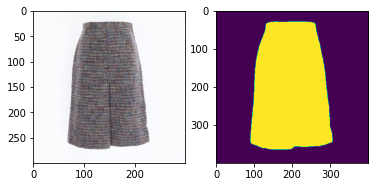

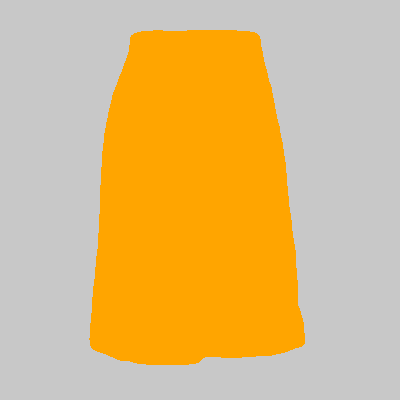

 60%|████████████████████████████████████▊                        | 544/900 [01:26<00:57,  6.14it/s]

torch.Size([1, 3, 400, 400])
/mnt/nas4/hm/datasets/shopping_clothes/data/data900_personby100/skirt/image/train_2476.jpg
{'background': 0, 'top': 1, 'skirt': 2, 'outer': 3, 'dress': 4, 'bottom': 5}
Counter({0: 110273, 2: 49727})


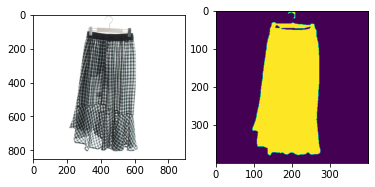

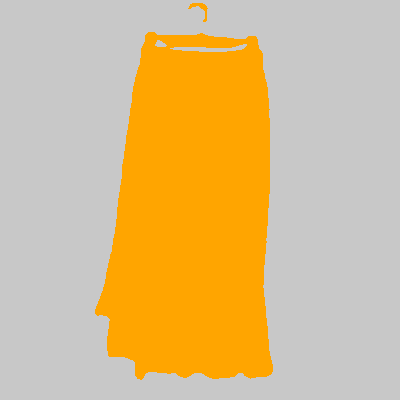

 61%|████████████████████████████████████▉                        | 545/900 [01:26<00:59,  5.95it/s]

torch.Size([1, 3, 400, 400])
/mnt/nas4/hm/datasets/shopping_clothes/data/data900_personby100/bottom/image/train_1402.jpg
{'background': 0, 'top': 1, 'skirt': 2, 'outer': 3, 'dress': 4, 'bottom': 5}
Counter({0: 87542, 5: 72458})


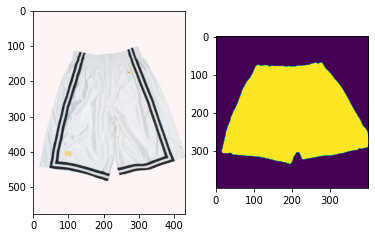

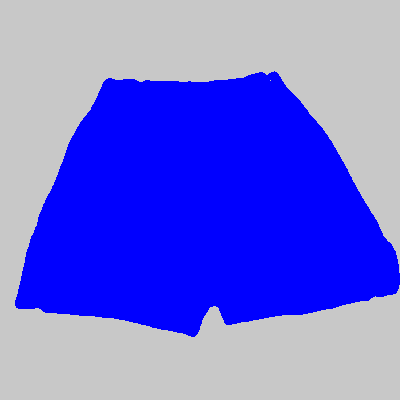

 61%|█████████████████████████████████████                        | 546/900 [01:26<00:57,  6.17it/s]

torch.Size([1, 3, 400, 400])
/mnt/nas4/hm/datasets/shopping_clothes/data/data900_personby100/skirt/image/train_225.jpg
{'background': 0, 'top': 1, 'skirt': 2, 'outer': 3, 'dress': 4, 'bottom': 5}
Counter({0: 88854, 2: 71146})


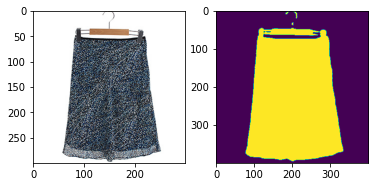

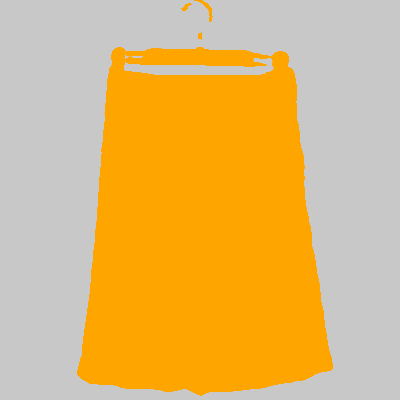

 61%|█████████████████████████████████████                        | 547/900 [01:26<01:00,  5.83it/s]

torch.Size([1, 3, 400, 400])
/mnt/nas4/hm/datasets/shopping_clothes/data/data900_personby100/top/image/train_757.jpg
{'background': 0, 'top': 1, 'skirt': 2, 'outer': 3, 'dress': 4, 'bottom': 5}
Counter({0: 94383, 1: 65617})


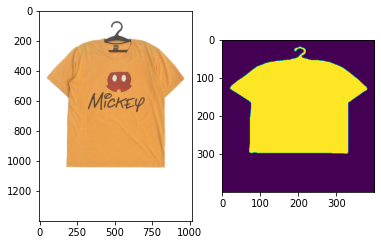

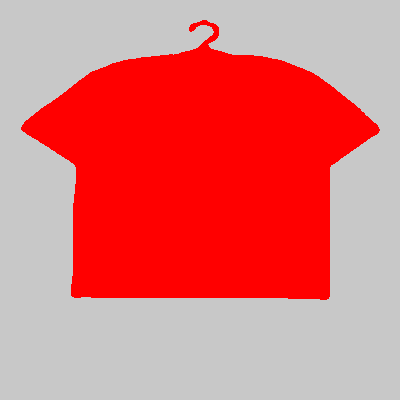

 61%|█████████████████████████████████████▏                       | 548/900 [01:27<01:07,  5.20it/s]

torch.Size([1, 3, 400, 400])
/mnt/nas4/hm/datasets/shopping_clothes/data/data900_personby100/outer/image/train_4059.jpg
{'background': 0, 'top': 1, 'skirt': 2, 'outer': 3, 'dress': 4, 'bottom': 5}
Counter({0: 99005, 3: 60995})


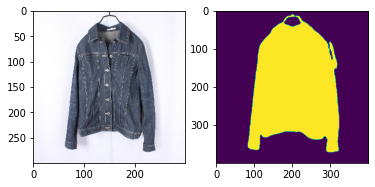

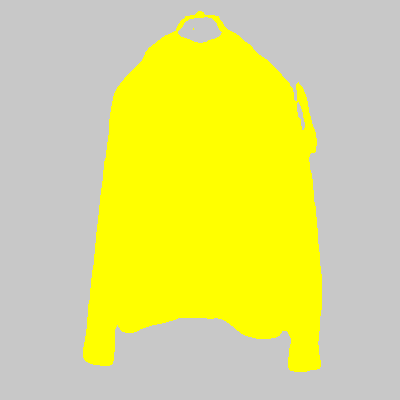

 61%|█████████████████████████████████████▏                       | 549/900 [01:27<01:01,  5.71it/s]

torch.Size([1, 3, 400, 400])
/mnt/nas4/hm/datasets/shopping_clothes/data/data900_personby100/bottom/image/train_1538.jpg
{'background': 0, 'top': 1, 'skirt': 2, 'outer': 3, 'dress': 4, 'bottom': 5}
Counter({0: 98674, 5: 61326})


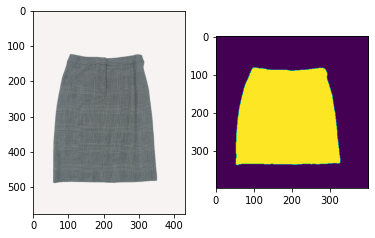

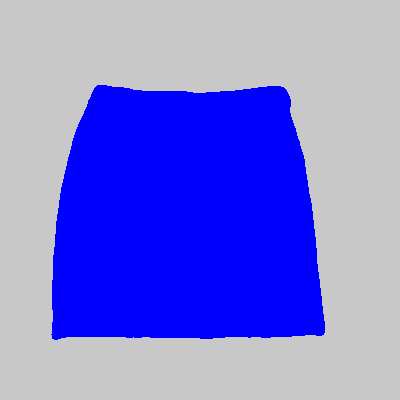

 61%|█████████████████████████████████████▎                       | 550/900 [01:27<00:58,  5.97it/s]

torch.Size([1, 3, 400, 400])
/mnt/nas4/hm/datasets/shopping_clothes/data/data900_personby100/skirt/image/train_2631.jpg
{'background': 0, 'top': 1, 'skirt': 2, 'outer': 3, 'dress': 4, 'bottom': 5}
Counter({0: 112166, 2: 47834})


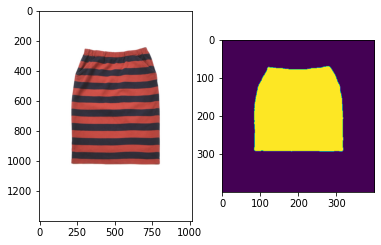

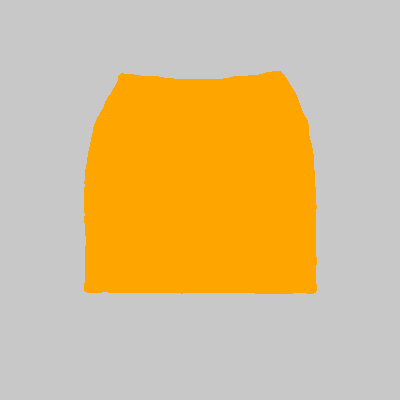

 61%|█████████████████████████████████████▎                       | 551/900 [01:27<01:05,  5.33it/s]

torch.Size([1, 3, 400, 400])
/mnt/nas4/hm/datasets/shopping_clothes/data/data900_personby100/outer/image/train_5274.jpg
{'background': 0, 'top': 1, 'skirt': 2, 'outer': 3, 'dress': 4, 'bottom': 5}
Counter({0: 87505, 3: 72495})


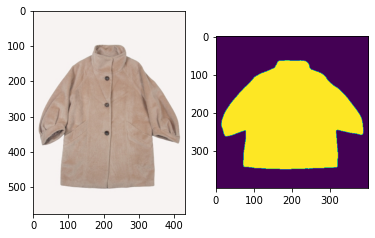

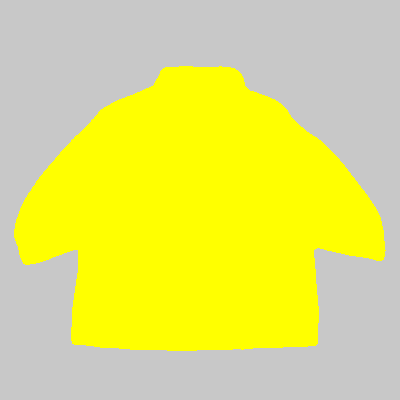

 61%|█████████████████████████████████████▍                       | 552/900 [01:27<01:01,  5.67it/s]

torch.Size([1, 3, 400, 400])
/mnt/nas4/hm/datasets/shopping_clothes/data/data900_personby100/top/image/train_10420.jpg
{'background': 0, 'top': 1, 'skirt': 2, 'outer': 3, 'dress': 4, 'bottom': 5}
Counter({0: 86887, 1: 73113})


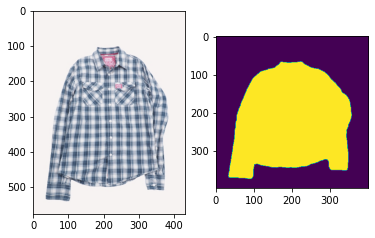

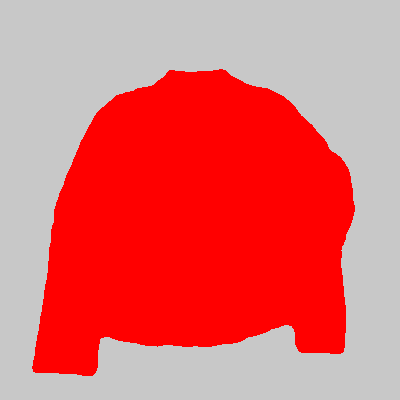

 61%|█████████████████████████████████████▍                       | 553/900 [01:27<00:58,  5.97it/s]

torch.Size([1, 3, 400, 400])
/mnt/nas4/hm/datasets/shopping_clothes/data/data900_personby100/outer/image/train_3908.jpg
{'background': 0, 'top': 1, 'skirt': 2, 'outer': 3, 'dress': 4, 'bottom': 5}
Counter({0: 86052, 3: 73948})


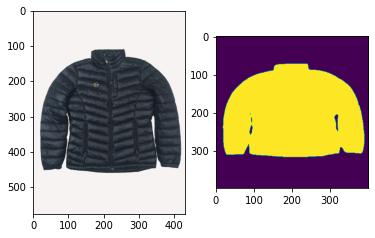

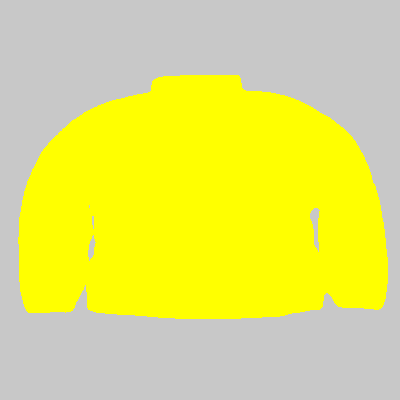

 62%|█████████████████████████████████████▌                       | 554/900 [01:27<00:55,  6.19it/s]

torch.Size([1, 3, 400, 400])
/mnt/nas4/hm/datasets/shopping_clothes/data/data900_personby100/skirt/image/train_2464.jpg
{'background': 0, 'top': 1, 'skirt': 2, 'outer': 3, 'dress': 4, 'bottom': 5}
Counter({0: 97104, 2: 62896})


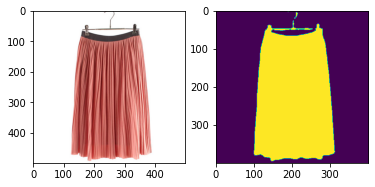

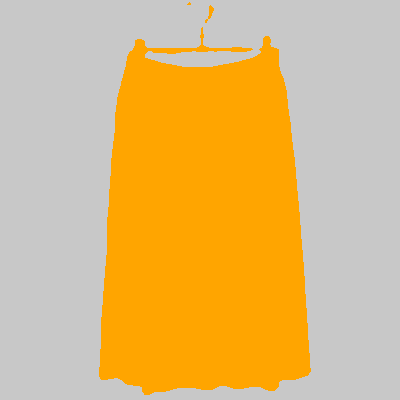

 62%|█████████████████████████████████████▌                       | 555/900 [01:28<00:53,  6.40it/s]

torch.Size([1, 3, 400, 400])
/mnt/nas4/hm/datasets/shopping_clothes/data/data900_personby100/top/image/train_16907.jpg
{'background': 0, 'top': 1, 'skirt': 2, 'outer': 3, 'dress': 4, 'bottom': 5}
Counter({0: 88579, 1: 71421})


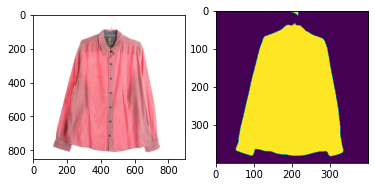

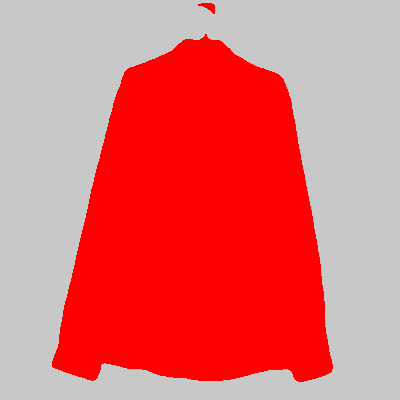

 62%|█████████████████████████████████████▋                       | 556/900 [01:28<00:56,  6.04it/s]

torch.Size([1, 3, 400, 400])
/mnt/nas4/hm/datasets/shopping_clothes/data/data900_personby100/bottom/image/train_2393.jpg
{'background': 0, 'top': 1, 'skirt': 2, 'outer': 3, 'dress': 4, 'bottom': 5}
Counter({0: 89928, 5: 70072})


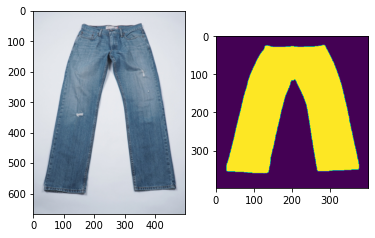

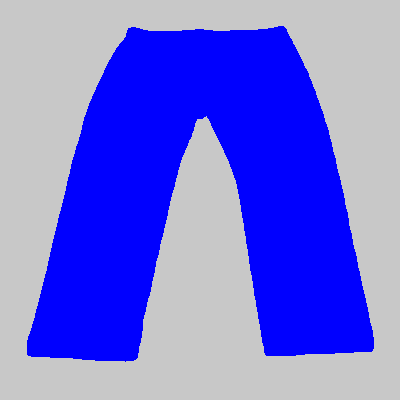

 62%|█████████████████████████████████████▊                       | 557/900 [01:28<00:56,  6.04it/s]

torch.Size([1, 3, 400, 400])
/mnt/nas4/hm/datasets/shopping_clothes/data/data900_personby100/top/image/train_424.jpg
{'background': 0, 'top': 1, 'skirt': 2, 'outer': 3, 'dress': 4, 'bottom': 5}
Counter({0: 108514, 1: 51486})


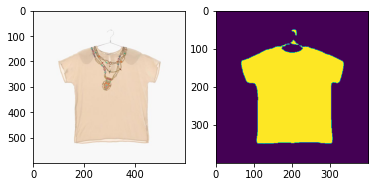

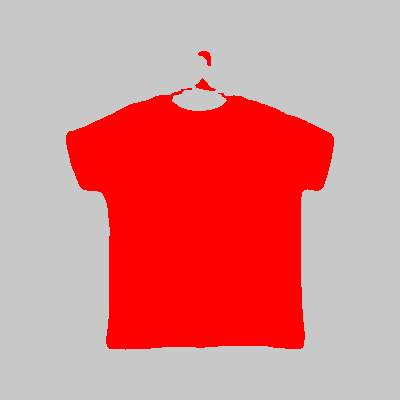

 62%|█████████████████████████████████████▊                       | 558/900 [01:28<01:01,  5.57it/s]

torch.Size([1, 3, 400, 400])
/mnt/nas4/hm/datasets/shopping_clothes/data/data900_personby100/top/image/train_10635.jpg
{'background': 0, 'top': 1, 'skirt': 2, 'outer': 3, 'dress': 4, 'bottom': 5}
Counter({0: 116934, 1: 43066})


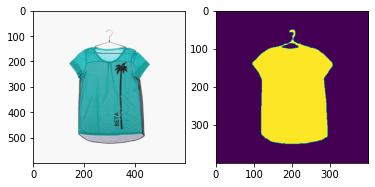

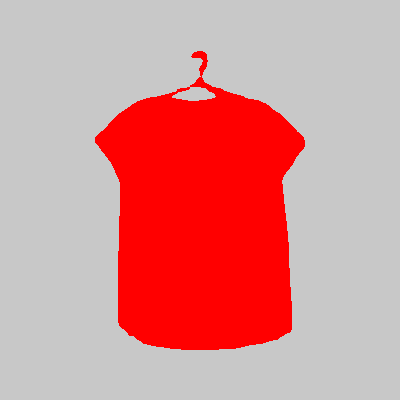

 62%|█████████████████████████████████████▉                       | 559/900 [01:28<00:58,  5.86it/s]

torch.Size([1, 3, 400, 400])
/mnt/nas4/hm/datasets/shopping_clothes/data/data900_personby100/skirt/image/train_1322.jpg
{'background': 0, 'top': 1, 'skirt': 2, 'outer': 3, 'dress': 4, 'bottom': 5}
Counter({0: 88803, 2: 71197})


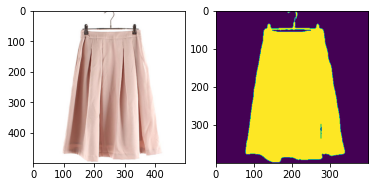

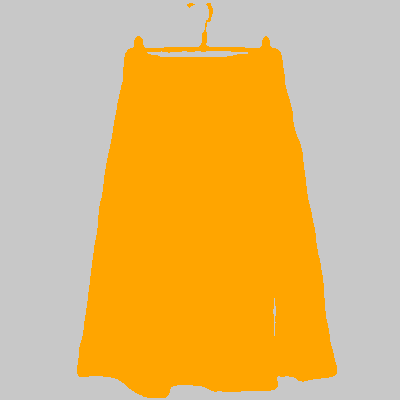

 62%|█████████████████████████████████████▉                       | 560/900 [01:28<00:55,  6.13it/s]

torch.Size([1, 3, 400, 400])
/mnt/nas4/hm/datasets/shopping_clothes/data/data900_personby100/bottom/image/train_1506.jpg
{'background': 0, 'top': 1, 'skirt': 2, 'outer': 3, 'dress': 4, 'bottom': 5}
Counter({0: 99947, 5: 60053})


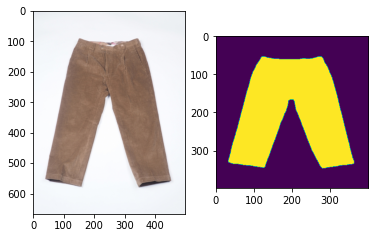

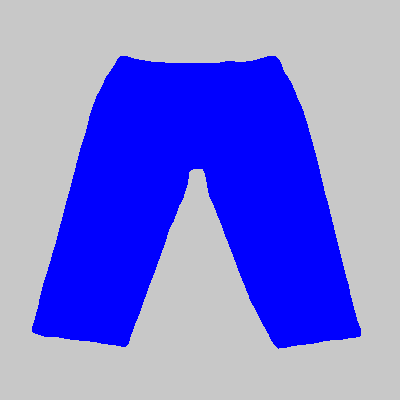

 62%|██████████████████████████████████████                       | 561/900 [01:29<00:55,  6.08it/s]

torch.Size([1, 3, 400, 400])
/mnt/nas4/hm/datasets/shopping_clothes/data/data900_personby100/dress/image/train_1137.jpg
{'background': 0, 'top': 1, 'skirt': 2, 'outer': 3, 'dress': 4, 'bottom': 5}
Counter({4: 86723, 0: 73277})


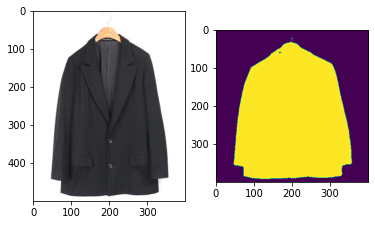

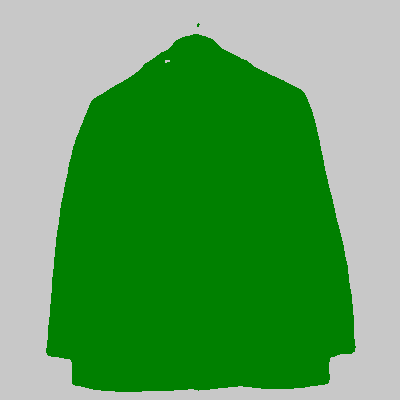

 62%|██████████████████████████████████████                       | 562/900 [01:29<00:53,  6.35it/s]

torch.Size([1, 3, 400, 400])
/mnt/nas4/hm/datasets/shopping_clothes/data/data900_personby100/outer/image/train_10012.jpg
{'background': 0, 'top': 1, 'skirt': 2, 'outer': 3, 'dress': 4, 'bottom': 5}
Counter({0: 97936, 3: 62064})


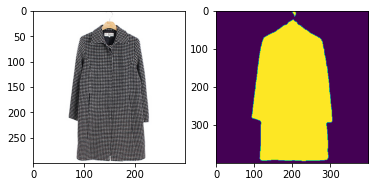

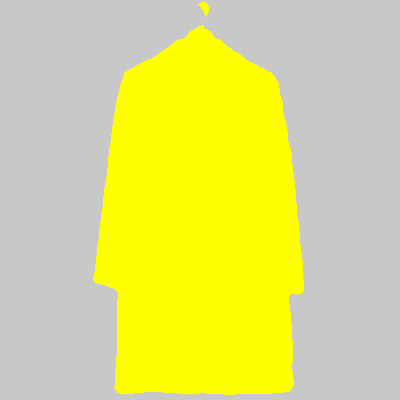

 63%|██████████████████████████████████████▏                      | 563/900 [01:29<00:50,  6.65it/s]

torch.Size([1, 3, 400, 400])
/mnt/nas4/hm/datasets/shopping_clothes/data/data900_personby100/bottom/image/train_3693.jpg
{'background': 0, 'top': 1, 'skirt': 2, 'outer': 3, 'dress': 4, 'bottom': 5}
Counter({0: 102865, 5: 57135})


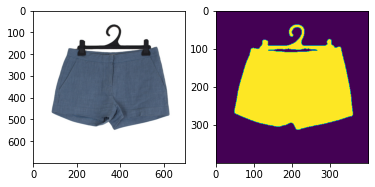

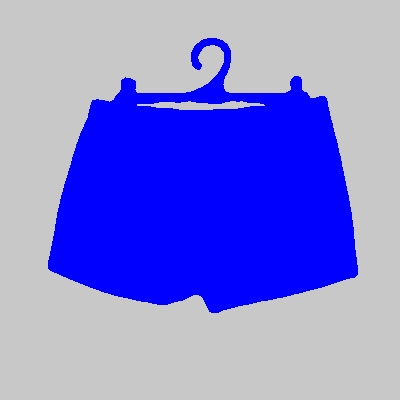

 63%|██████████████████████████████████████▏                      | 564/900 [01:29<00:52,  6.43it/s]

torch.Size([1, 3, 400, 400])
/mnt/nas4/hm/datasets/shopping_clothes/data/data900_personby100/dress/image/train_1177.jpg
{'background': 0, 'top': 1, 'skirt': 2, 'outer': 3, 'dress': 4, 'bottom': 5}
Counter({0: 94675, 4: 65325})


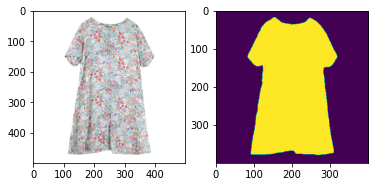

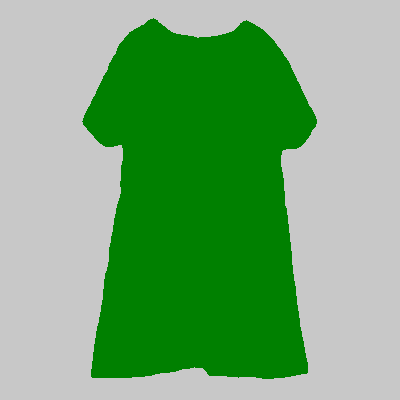

 63%|██████████████████████████████████████▎                      | 565/900 [01:29<00:51,  6.48it/s]

torch.Size([1, 3, 400, 400])
/mnt/nas4/hm/datasets/shopping_clothes/data/data900_personby100/bottom/image/train_202.jpg
{'background': 0, 'top': 1, 'skirt': 2, 'outer': 3, 'dress': 4, 'bottom': 5}
Counter({5: 90161, 0: 69839})


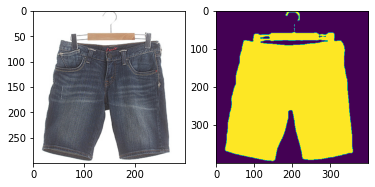

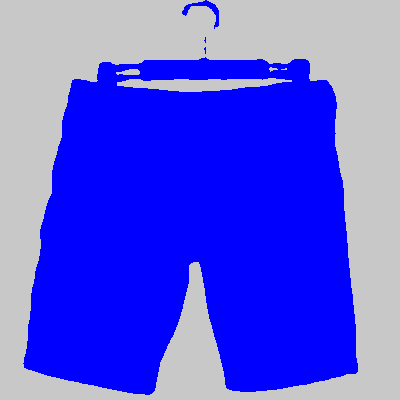

 63%|██████████████████████████████████████▎                      | 566/900 [01:29<00:49,  6.72it/s]

torch.Size([1, 3, 400, 400])
/mnt/nas4/hm/datasets/shopping_clothes/data/data900_personby100/outer/image/train_8964.jpg
{'background': 0, 'top': 1, 'skirt': 2, 'outer': 3, 'dress': 4, 'bottom': 5}
Counter({0: 82410, 3: 77590})


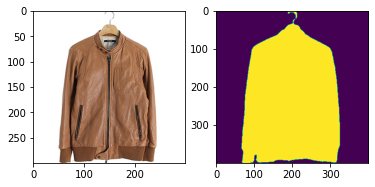

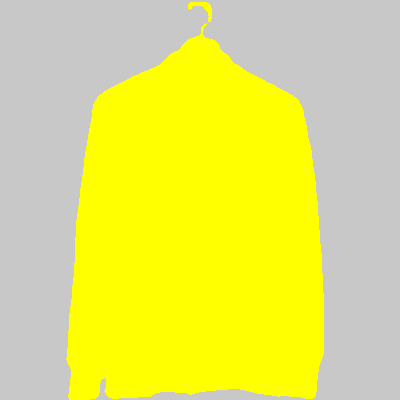

 63%|██████████████████████████████████████▍                      | 567/900 [01:30<00:48,  6.92it/s]

torch.Size([1, 3, 400, 400])
/mnt/nas4/hm/datasets/shopping_clothes/data/data900_personby100/top/image/train_9514.jpg
{'background': 0, 'top': 1, 'skirt': 2, 'outer': 3, 'dress': 4, 'bottom': 5}
Counter({0: 90141, 1: 69859})


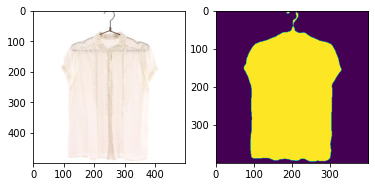

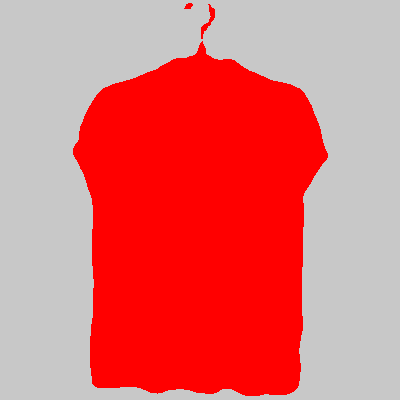

 63%|██████████████████████████████████████▍                      | 568/900 [01:30<00:48,  6.92it/s]

torch.Size([1, 3, 400, 400])
/mnt/nas4/hm/datasets/shopping_clothes/data/data900_personby100/dress/image/train_1017.jpg
{'background': 0, 'top': 1, 'skirt': 2, 'outer': 3, 'dress': 4, 'bottom': 5}
Counter({0: 100957, 4: 59043})


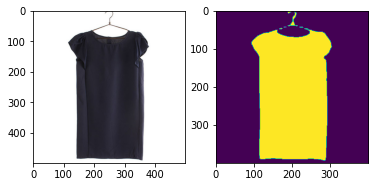

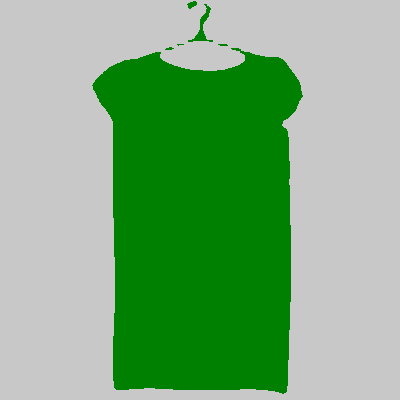

 63%|██████████████████████████████████████▌                      | 569/900 [01:30<00:53,  6.14it/s]

torch.Size([1, 3, 400, 400])
/mnt/nas4/hm/datasets/shopping_clothes/data/data900_personby100/skirt/image/train_991.jpg
{'background': 0, 'top': 1, 'skirt': 2, 'outer': 3, 'dress': 4, 'bottom': 5}
Counter({0: 87522, 2: 72478})


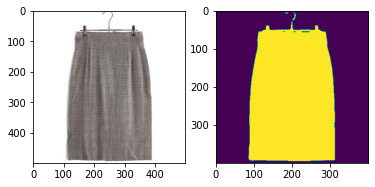

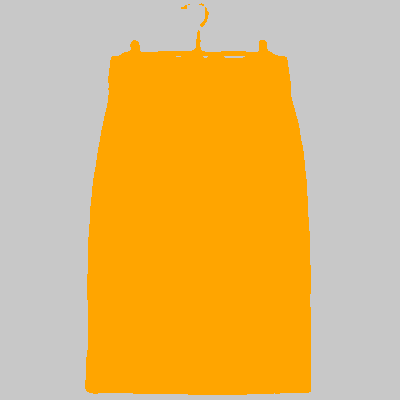

 63%|██████████████████████████████████████▋                      | 570/900 [01:30<00:52,  6.34it/s]

torch.Size([1, 3, 400, 400])
/mnt/nas4/hm/datasets/shopping_clothes/data/data900_personby100/bottom/image/train_2546.jpg
{'background': 0, 'top': 1, 'skirt': 2, 'outer': 3, 'dress': 4, 'bottom': 5}
Counter({0: 109525, 5: 50475})


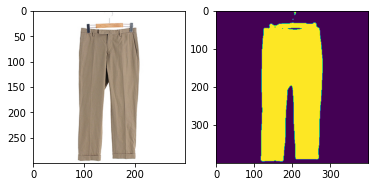

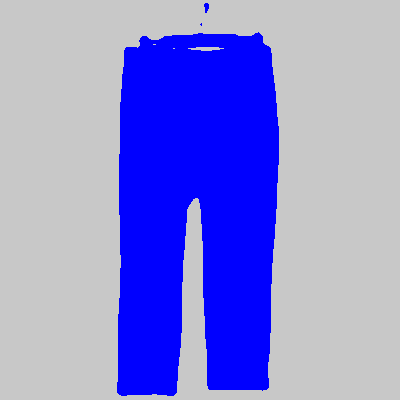

 63%|██████████████████████████████████████▋                      | 571/900 [01:30<00:49,  6.64it/s]

torch.Size([1, 3, 400, 400])
/mnt/nas4/hm/datasets/shopping_clothes/data/data900_personby100/outer/image/train_1899.jpg
{'background': 0, 'top': 1, 'skirt': 2, 'outer': 3, 'dress': 4, 'bottom': 5}
Counter({0: 92383, 3: 67617})


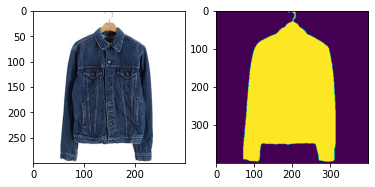

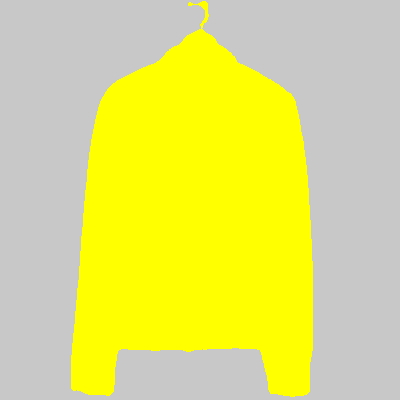

 64%|██████████████████████████████████████▊                      | 572/900 [01:30<00:47,  6.87it/s]

torch.Size([1, 3, 400, 400])
/mnt/nas4/hm/datasets/shopping_clothes/data/data900_personby100/skirt/image/train_1894.jpg
{'background': 0, 'top': 1, 'skirt': 2, 'outer': 3, 'dress': 4, 'bottom': 5}
Counter({2: 101221, 0: 58779})


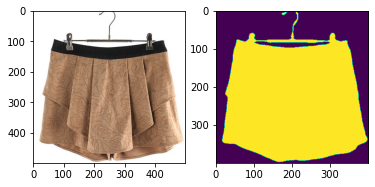

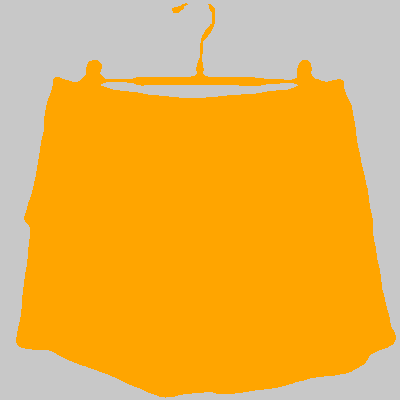

 64%|██████████████████████████████████████▊                      | 573/900 [01:30<00:47,  6.87it/s]

torch.Size([1, 3, 400, 400])
/mnt/nas4/hm/datasets/shopping_clothes/data/data900_personby100/skirt/image/train_892.jpg
{'background': 0, 'top': 1, 'skirt': 2, 'outer': 3, 'dress': 4, 'bottom': 5}
Counter({2: 87704, 0: 72296})


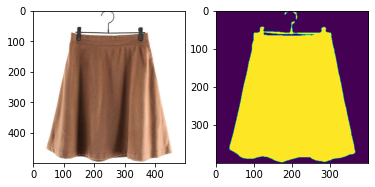

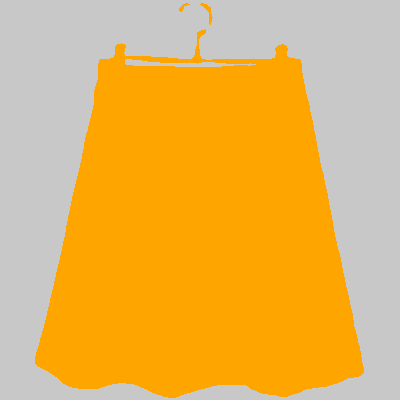

 64%|██████████████████████████████████████▉                      | 574/900 [01:31<00:47,  6.85it/s]

torch.Size([1, 3, 400, 400])
/mnt/nas4/hm/datasets/shopping_clothes/data/data900_personby100/skirt/image/train_510.jpg
{'background': 0, 'top': 1, 'skirt': 2, 'outer': 3, 'dress': 4, 'bottom': 5}
Counter({0: 84716, 2: 75284})


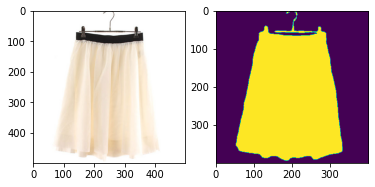

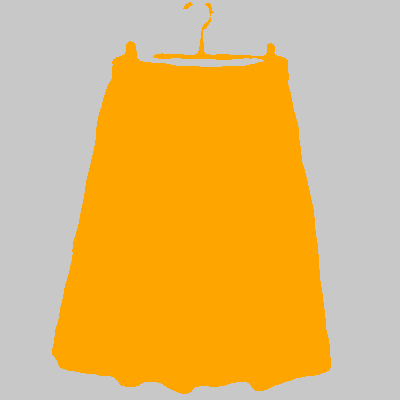

 64%|██████████████████████████████████████▉                      | 575/900 [01:31<00:47,  6.87it/s]

torch.Size([1, 3, 400, 400])
/mnt/nas4/hm/datasets/shopping_clothes/data/data900_personby100/top/image/train_2434.jpg
{'background': 0, 'top': 1, 'skirt': 2, 'outer': 3, 'dress': 4, 'bottom': 5}
Counter({0: 80017, 1: 79983})


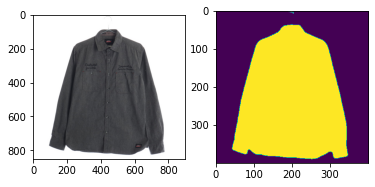

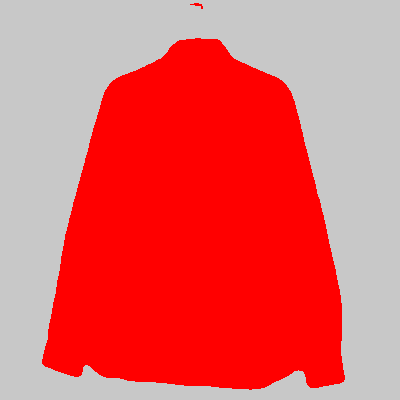

 64%|███████████████████████████████████████                      | 576/900 [01:31<00:51,  6.30it/s]

torch.Size([1, 3, 400, 400])
/mnt/nas4/hm/datasets/shopping_clothes/data/data900_personby100/outer/image/train_6578.jpg
{'background': 0, 'top': 1, 'skirt': 2, 'outer': 3, 'dress': 4, 'bottom': 5}
Counter({3: 88311, 0: 71689})


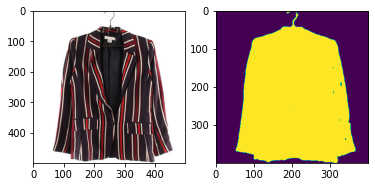

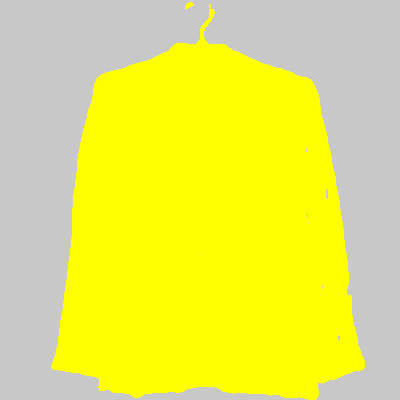

 64%|███████████████████████████████████████                      | 577/900 [01:31<00:50,  6.45it/s]

torch.Size([1, 3, 400, 400])
/mnt/nas4/hm/datasets/shopping_clothes/data/data900_personby100/outer/image/train_4598.jpg
{'background': 0, 'top': 1, 'skirt': 2, 'outer': 3, 'dress': 4, 'bottom': 5}
Counter({0: 86643, 3: 73357})


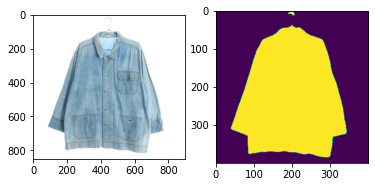

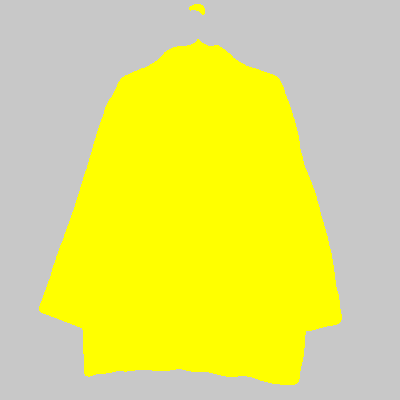

 64%|███████████████████████████████████████▏                     | 578/900 [01:31<00:53,  6.05it/s]

torch.Size([1, 3, 400, 400])
/mnt/nas4/hm/datasets/shopping_clothes/data/data900_personby100/bottom/image/train_1648.jpg
{'background': 0, 'top': 1, 'skirt': 2, 'outer': 3, 'dress': 4, 'bottom': 5}
Counter({0: 96733, 5: 63267})


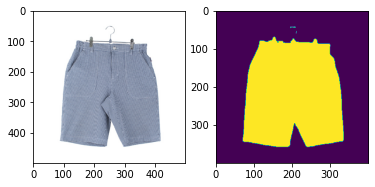

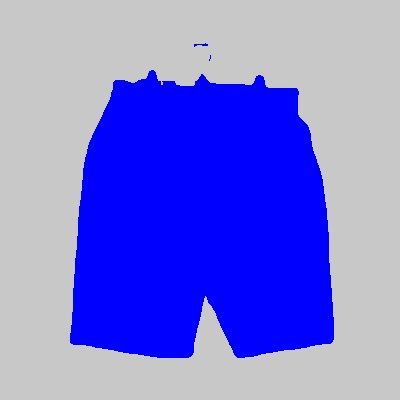

 64%|███████████████████████████████████████▏                     | 579/900 [01:31<00:51,  6.25it/s]

torch.Size([1, 3, 400, 400])
/mnt/nas4/hm/datasets/shopping_clothes/data/data900_personby100/top/image/train_14048.jpg
{'background': 0, 'top': 1, 'skirt': 2, 'outer': 3, 'dress': 4, 'bottom': 5}
Counter({0: 81511, 1: 78489})


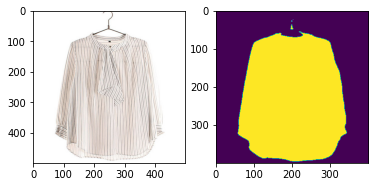

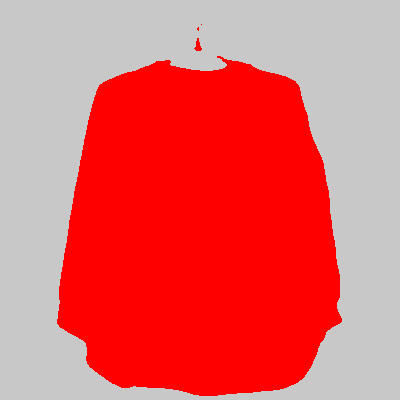

 64%|███████████████████████████████████████▎                     | 580/900 [01:32<00:55,  5.77it/s]

torch.Size([1, 3, 400, 400])
/mnt/nas4/hm/datasets/shopping_clothes/data/data900_personby100/dress/image/train_2131.jpg
{'background': 0, 'top': 1, 'skirt': 2, 'outer': 3, 'dress': 4, 'bottom': 5}
Counter({0: 103210, 4: 56790})


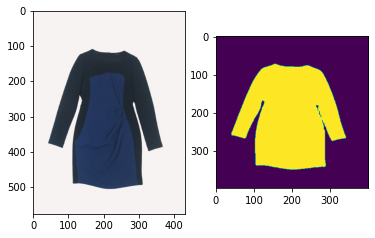

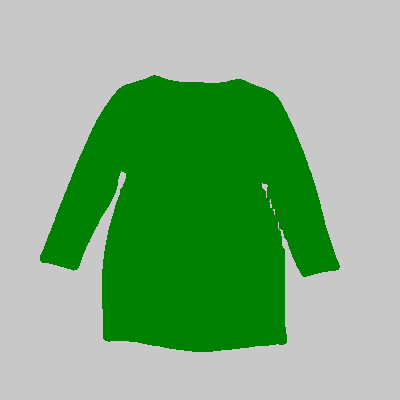

 65%|███████████████████████████████████████▍                     | 581/900 [01:32<00:52,  6.03it/s]

torch.Size([1, 3, 400, 400])
/mnt/nas4/hm/datasets/shopping_clothes/data/data900_personby100/outer/image/train_9660.jpg
{'background': 0, 'top': 1, 'skirt': 2, 'outer': 3, 'dress': 4, 'bottom': 5}
Counter({3: 89069, 0: 70931})


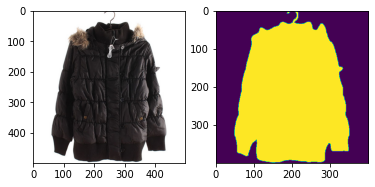

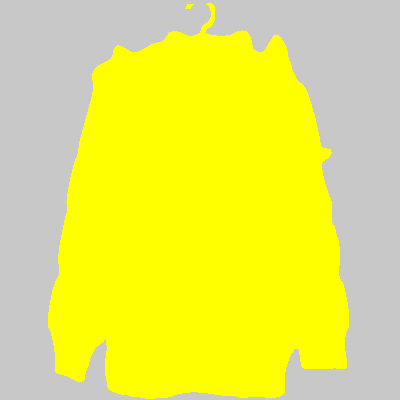

 65%|███████████████████████████████████████▍                     | 582/900 [01:32<00:50,  6.26it/s]

torch.Size([1, 3, 400, 400])
/mnt/nas4/hm/datasets/shopping_clothes/data/data900_personby100/outer/image/train_3074.jpg
{'background': 0, 'top': 1, 'skirt': 2, 'outer': 3, 'dress': 4, 'bottom': 5}
Counter({0: 106630, 3: 53370})


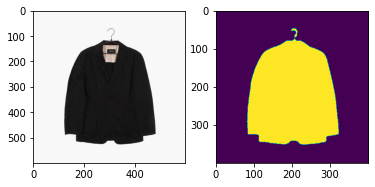

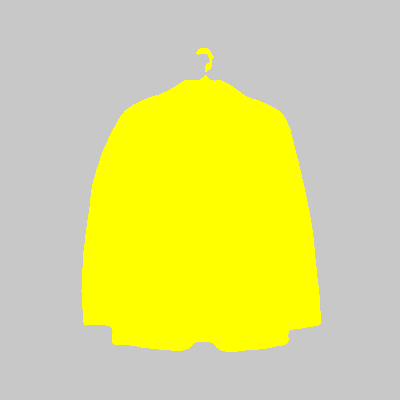

 65%|███████████████████████████████████████▌                     | 583/900 [01:32<00:49,  6.37it/s]

torch.Size([1, 3, 400, 400])
/mnt/nas4/hm/datasets/shopping_clothes/data/data900_personby100/skirt/image/train_1933.jpg
{'background': 0, 'top': 1, 'skirt': 2, 'outer': 3, 'dress': 4, 'bottom': 5}
Counter({0: 99611, 2: 60389})


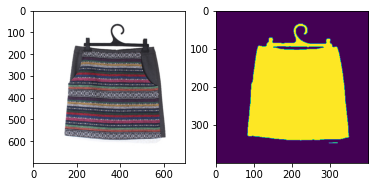

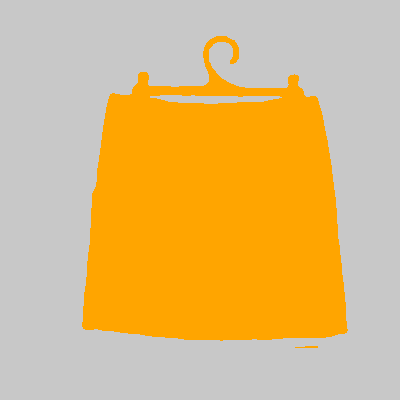

 65%|███████████████████████████████████████▌                     | 584/900 [01:32<00:51,  6.20it/s]

torch.Size([1, 3, 400, 400])
/mnt/nas4/hm/datasets/shopping_clothes/data/data900_personby100/top/image/train_18553.jpg
{'background': 0, 'top': 1, 'skirt': 2, 'outer': 3, 'dress': 4, 'bottom': 5}
Counter({0: 113368, 1: 46632})


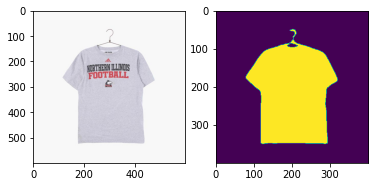

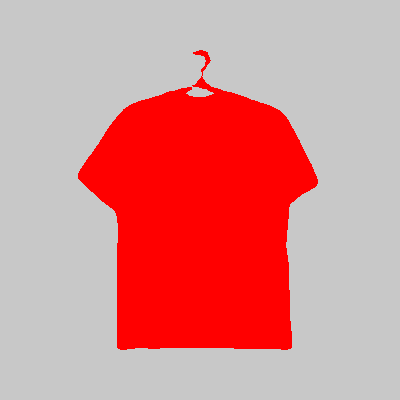

 65%|███████████████████████████████████████▋                     | 585/900 [01:32<00:50,  6.29it/s]

torch.Size([1, 3, 400, 400])
/mnt/nas4/hm/datasets/shopping_clothes/data/data900_personby100/bottom/image/train_2876.jpg
{'background': 0, 'top': 1, 'skirt': 2, 'outer': 3, 'dress': 4, 'bottom': 5}
Counter({0: 83728, 5: 76272})


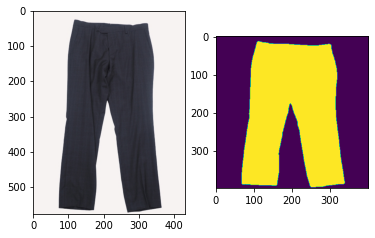

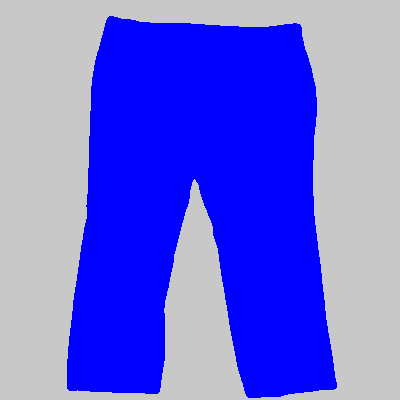

 65%|███████████████████████████████████████▋                     | 586/900 [01:33<00:49,  6.41it/s]

torch.Size([1, 3, 400, 400])
/mnt/nas4/hm/datasets/shopping_clothes/data/data900_personby100/outer/image/train_927.jpg
{'background': 0, 'top': 1, 'skirt': 2, 'outer': 3, 'dress': 4, 'bottom': 5}
Counter({0: 88449, 3: 71551})


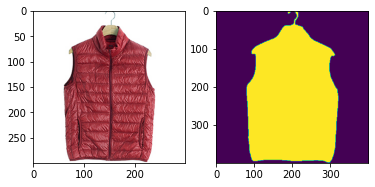

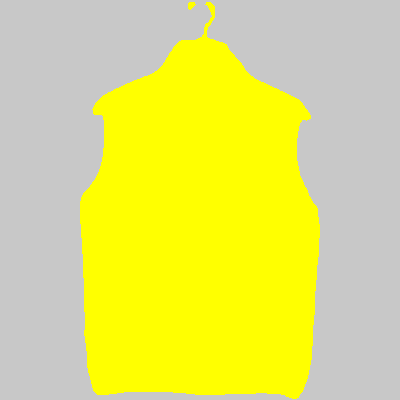

 65%|███████████████████████████████████████▊                     | 587/900 [01:33<00:46,  6.70it/s]

torch.Size([1, 3, 400, 400])
/mnt/nas4/hm/datasets/shopping_clothes/data/data900_personby100/skirt/image/train_1509.jpg
{'background': 0, 'top': 1, 'skirt': 2, 'outer': 3, 'dress': 4, 'bottom': 5}
Counter({2: 81133, 0: 78867})


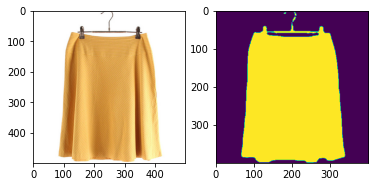

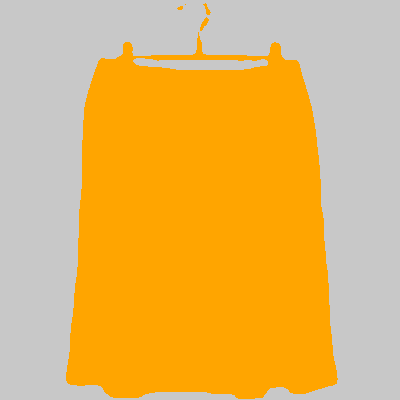

 65%|███████████████████████████████████████▊                     | 588/900 [01:33<00:46,  6.73it/s]

torch.Size([1, 3, 400, 400])
/mnt/nas4/hm/datasets/shopping_clothes/data/data900_personby100/dress/image/train_1733.jpg
{'background': 0, 'top': 1, 'skirt': 2, 'outer': 3, 'dress': 4, 'bottom': 5}
Counter({0: 109582, 4: 50418})


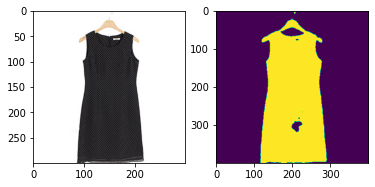

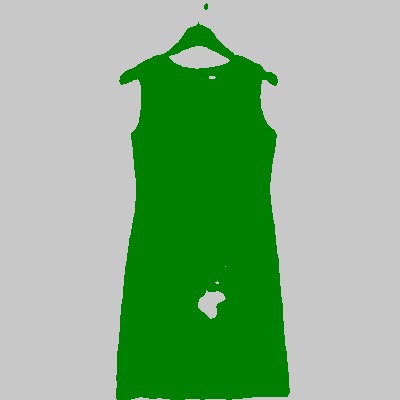

 65%|███████████████████████████████████████▉                     | 589/900 [01:33<00:44,  6.95it/s]

torch.Size([1, 3, 400, 400])
/mnt/nas4/hm/datasets/shopping_clothes/data/data900_personby100/outer/image/train_5878.jpg
{'background': 0, 'top': 1, 'skirt': 2, 'outer': 3, 'dress': 4, 'bottom': 5}
Counter({0: 90836, 3: 69164})


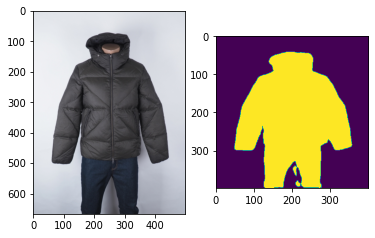

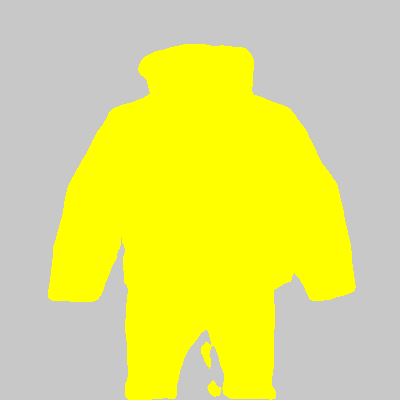

 66%|███████████████████████████████████████▉                     | 590/900 [01:33<00:46,  6.63it/s]

torch.Size([1, 3, 400, 400])
/mnt/nas4/hm/datasets/shopping_clothes/data/data900_personby100/top/image/train_4514.jpg
{'background': 0, 'top': 1, 'skirt': 2, 'outer': 3, 'dress': 4, 'bottom': 5}
Counter({0: 94113, 1: 65887})


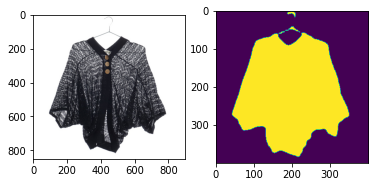

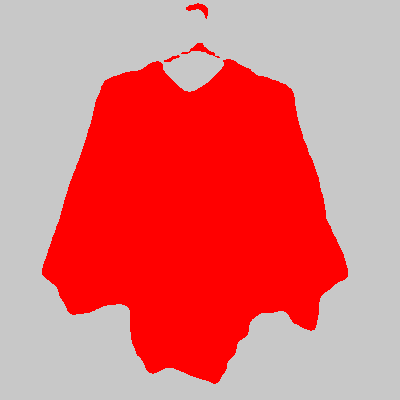

 66%|████████████████████████████████████████                     | 591/900 [01:33<00:55,  5.52it/s]

torch.Size([1, 3, 400, 400])
/mnt/nas4/hm/datasets/shopping_clothes/data/data900_personby100/bottom/image/train_2573.jpg
{'background': 0, 'top': 1, 'skirt': 2, 'outer': 3, 'dress': 4, 'bottom': 5}
Counter({0: 84146, 5: 75854})


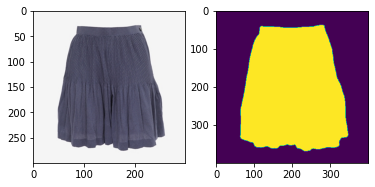

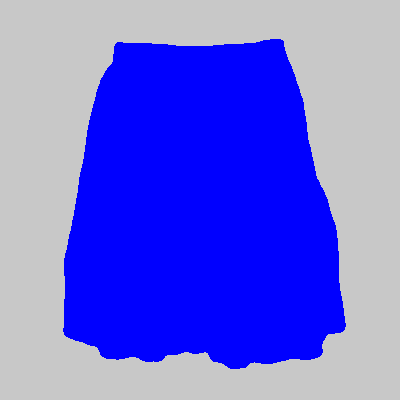

 66%|████████████████████████████████████████                     | 592/900 [01:33<00:51,  5.98it/s]

torch.Size([1, 3, 400, 400])
/mnt/nas4/hm/datasets/shopping_clothes/data/data900_personby100/bottom/image/train_2384.jpg
{'background': 0, 'top': 1, 'skirt': 2, 'outer': 3, 'dress': 4, 'bottom': 5}
Counter({0: 122637, 5: 37363})


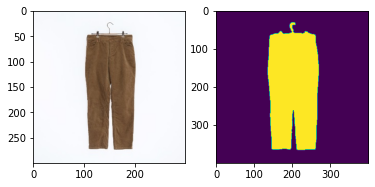

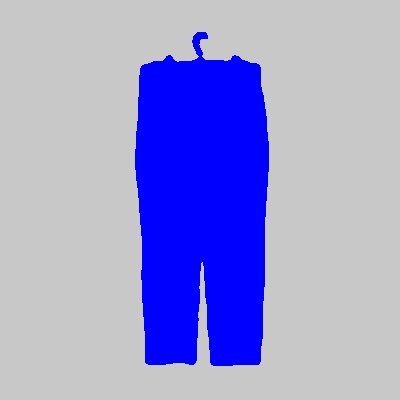

 66%|████████████████████████████████████████▏                    | 593/900 [01:34<00:48,  6.38it/s]

torch.Size([1, 3, 400, 400])
/mnt/nas4/hm/datasets/shopping_clothes/data/data900_personby100/skirt/image/train_1438.jpg
{'background': 0, 'top': 1, 'skirt': 2, 'outer': 3, 'dress': 4, 'bottom': 5}
Counter({0: 94139, 2: 65861})


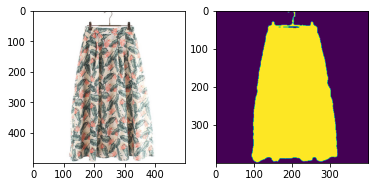

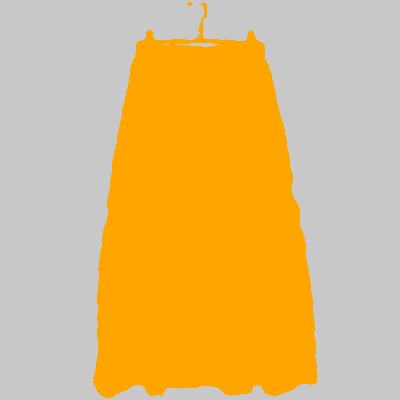

 66%|████████████████████████████████████████▎                    | 594/900 [01:34<00:46,  6.53it/s]

torch.Size([1, 3, 400, 400])
/mnt/nas4/hm/datasets/shopping_clothes/data/data900_personby100/skirt/image/train_2174.jpg
{'background': 0, 'top': 1, 'skirt': 2, 'outer': 3, 'dress': 4, 'bottom': 5}
Counter({0: 100065, 2: 59935})


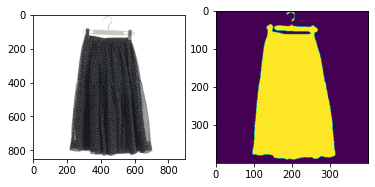

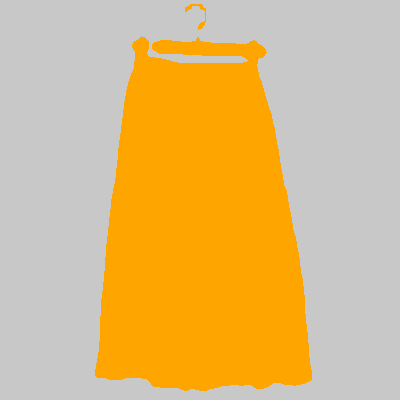

 66%|████████████████████████████████████████▎                    | 595/900 [01:34<00:50,  6.09it/s]

torch.Size([1, 3, 400, 400])
/mnt/nas4/hm/datasets/shopping_clothes/data/data900_personby100/outer/image/train_2945.jpg
{'background': 0, 'top': 1, 'skirt': 2, 'outer': 3, 'dress': 4, 'bottom': 5}
Counter({0: 114049, 3: 45951})


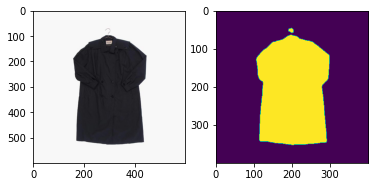

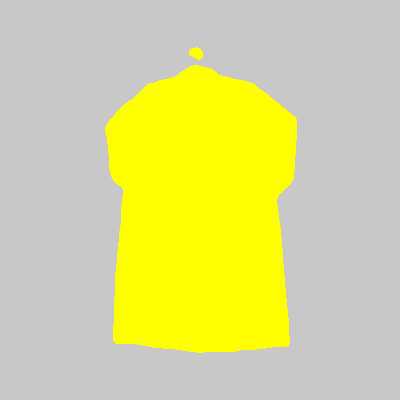

 66%|████████████████████████████████████████▍                    | 596/900 [01:34<00:48,  6.23it/s]

torch.Size([1, 3, 400, 400])
/mnt/nas4/hm/datasets/shopping_clothes/data/data900_personby100/outer/image/train_8290.jpg
{'background': 0, 'top': 1, 'skirt': 2, 'outer': 3, 'dress': 4, 'bottom': 5}
Counter({0: 113113, 3: 46887})


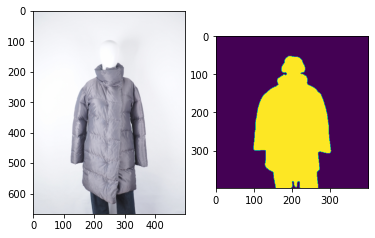

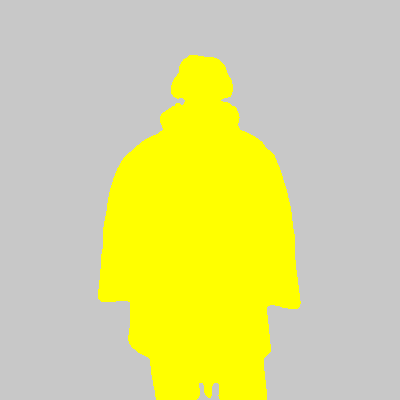

 66%|████████████████████████████████████████▍                    | 597/900 [01:34<00:49,  6.16it/s]

torch.Size([1, 3, 400, 400])
/mnt/nas4/hm/datasets/shopping_clothes/data/data900_personby100/top/image/train_16104.jpg
{'background': 0, 'top': 1, 'skirt': 2, 'outer': 3, 'dress': 4, 'bottom': 5}
Counter({1: 79348, 0: 78597, 4: 2055})


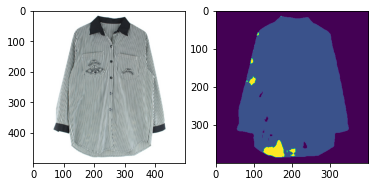

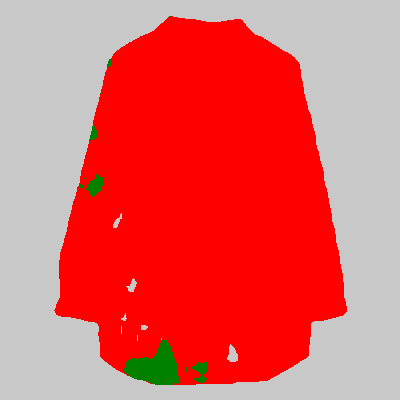

 66%|████████████████████████████████████████▌                    | 598/900 [01:34<00:47,  6.33it/s]

torch.Size([1, 3, 400, 400])
/mnt/nas4/hm/datasets/shopping_clothes/data/data900_personby100/bottom/image/train_2268.jpg
{'background': 0, 'top': 1, 'skirt': 2, 'outer': 3, 'dress': 4, 'bottom': 5}
Counter({0: 107394, 5: 52606})


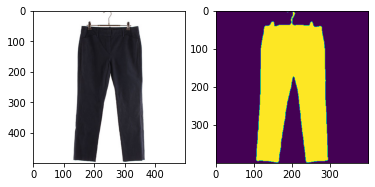

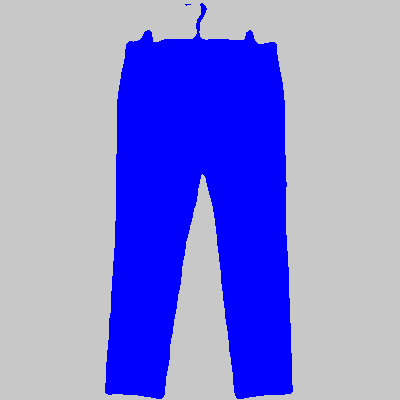

 67%|████████████████████████████████████████▌                    | 599/900 [01:35<00:46,  6.51it/s]

torch.Size([1, 3, 400, 400])
/mnt/nas4/hm/datasets/shopping_clothes/data/data900_personby100/skirt/image/train_1337.jpg
{'background': 0, 'top': 1, 'skirt': 2, 'outer': 3, 'dress': 4, 'bottom': 5}
Counter({0: 86399, 2: 73601})


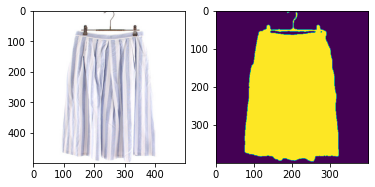

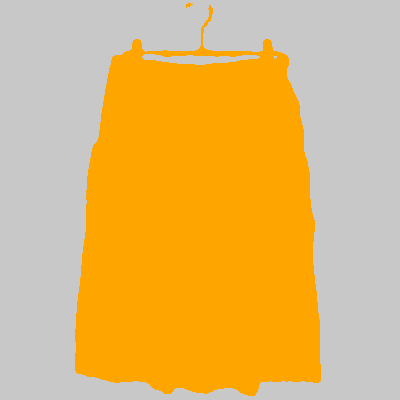

 67%|████████████████████████████████████████▋                    | 600/900 [01:35<00:45,  6.62it/s]

torch.Size([1, 3, 400, 400])
/mnt/nas4/hm/datasets/shopping_clothes/data/data900_personby100/outer/image/train_1307.jpg
{'background': 0, 'top': 1, 'skirt': 2, 'outer': 3, 'dress': 4, 'bottom': 5}
Counter({0: 83184, 3: 76816})


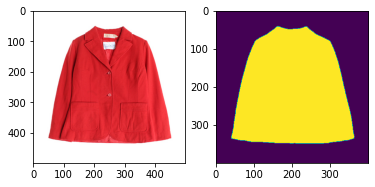

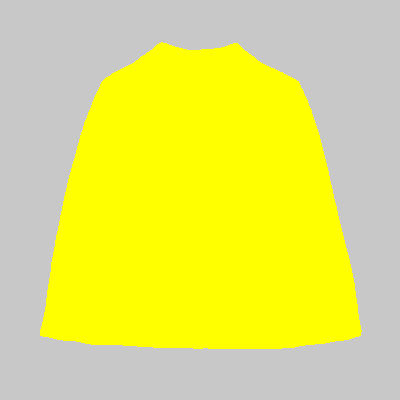

 67%|████████████████████████████████████████▋                    | 601/900 [01:35<00:44,  6.65it/s]

torch.Size([1, 3, 400, 400])
/mnt/nas4/hm/datasets/shopping_clothes/data/data900_personby100/outer/image/train_1640.jpg
{'background': 0, 'top': 1, 'skirt': 2, 'outer': 3, 'dress': 4, 'bottom': 5}
Counter({0: 105602, 3: 54398})


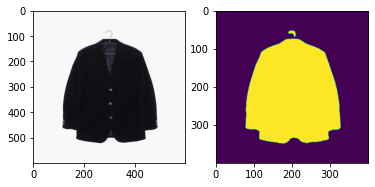

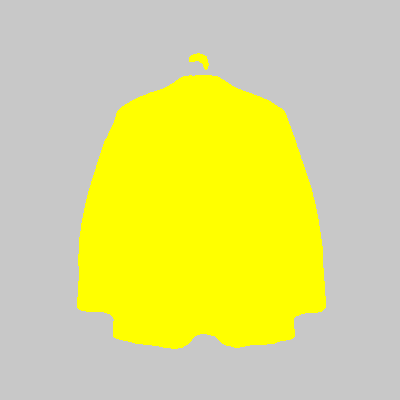

 67%|████████████████████████████████████████▊                    | 602/900 [01:35<00:50,  5.91it/s]

torch.Size([1, 3, 400, 400])
/mnt/nas4/hm/datasets/shopping_clothes/data/data900_personby100/skirt/image/train_1405.jpg
{'background': 0, 'top': 1, 'skirt': 2, 'outer': 3, 'dress': 4, 'bottom': 5}
Counter({0: 123785, 2: 36215})


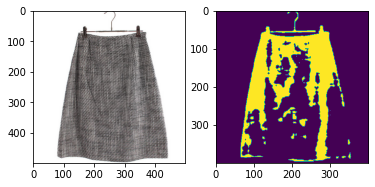

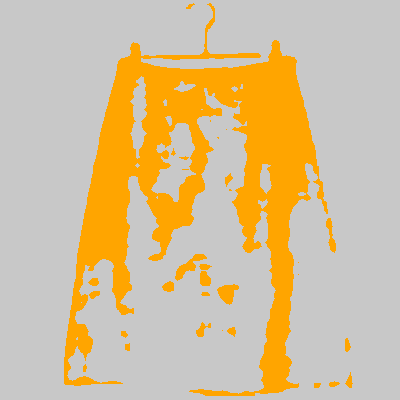

 67%|████████████████████████████████████████▊                    | 603/900 [01:35<00:48,  6.14it/s]

torch.Size([1, 3, 400, 400])
/mnt/nas4/hm/datasets/shopping_clothes/data/data900_personby100/bottom/image/train_357.jpg
{'background': 0, 'top': 1, 'skirt': 2, 'outer': 3, 'dress': 4, 'bottom': 5}
Counter({0: 113166, 5: 46834})


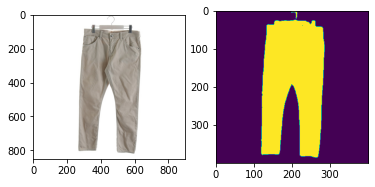

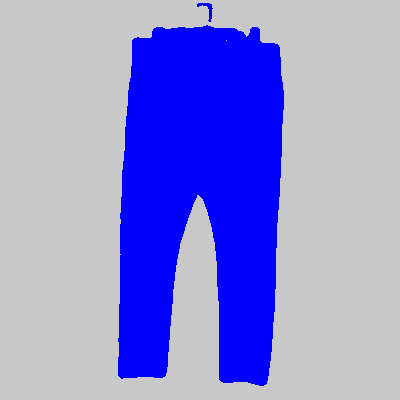

 67%|████████████████████████████████████████▉                    | 604/900 [01:35<00:50,  5.91it/s]

torch.Size([1, 3, 400, 400])
/mnt/nas4/hm/datasets/shopping_clothes/data/data900_personby100/bottom/image/train_2179.jpg
{'background': 0, 'top': 1, 'skirt': 2, 'outer': 3, 'dress': 4, 'bottom': 5}
Counter({0: 108797, 5: 51203})


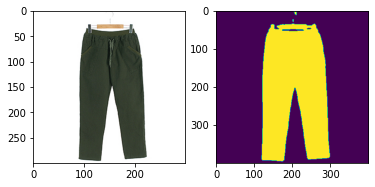

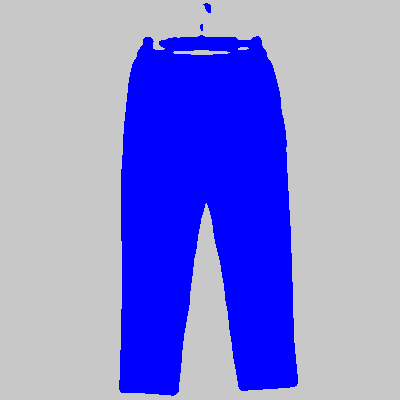

 67%|█████████████████████████████████████████                    | 605/900 [01:36<00:46,  6.31it/s]

torch.Size([1, 3, 400, 400])
/mnt/nas4/hm/datasets/shopping_clothes/data/data900_personby100/dress/image/train_3729.jpg
{'background': 0, 'top': 1, 'skirt': 2, 'outer': 3, 'dress': 4, 'bottom': 5}
Counter({0: 98949, 4: 61051})


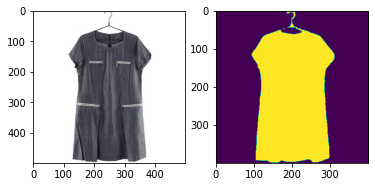

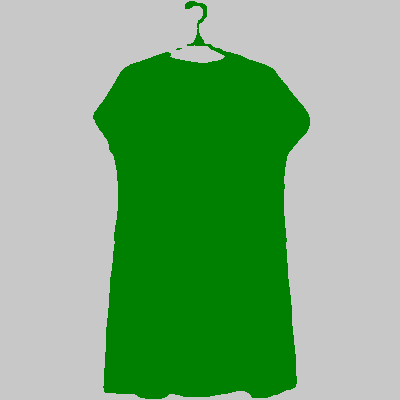

 67%|█████████████████████████████████████████                    | 606/900 [01:36<00:45,  6.48it/s]

torch.Size([1, 3, 400, 400])
/mnt/nas4/hm/datasets/shopping_clothes/data/data900_personby100/skirt/image/train_992.jpg
{'background': 0, 'top': 1, 'skirt': 2, 'outer': 3, 'dress': 4, 'bottom': 5}
Counter({0: 82176, 2: 77824})


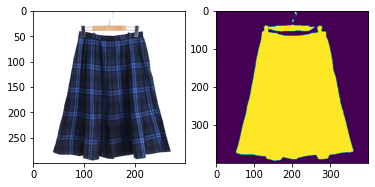

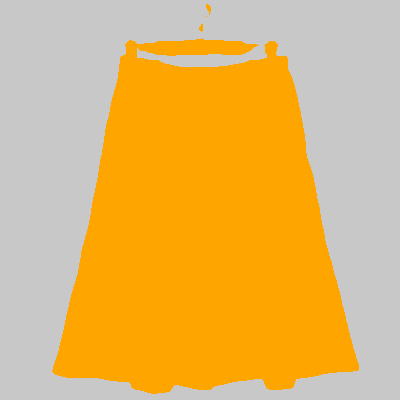

 67%|█████████████████████████████████████████▏                   | 607/900 [01:36<00:43,  6.72it/s]

torch.Size([1, 3, 400, 400])
/mnt/nas4/hm/datasets/shopping_clothes/data/data900_personby100/outer/image/train_1912.jpg
{'background': 0, 'top': 1, 'skirt': 2, 'outer': 3, 'dress': 4, 'bottom': 5}
Counter({0: 96315, 3: 63685})


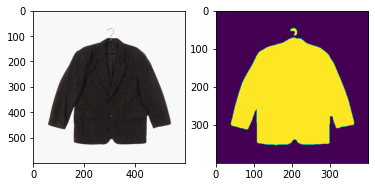

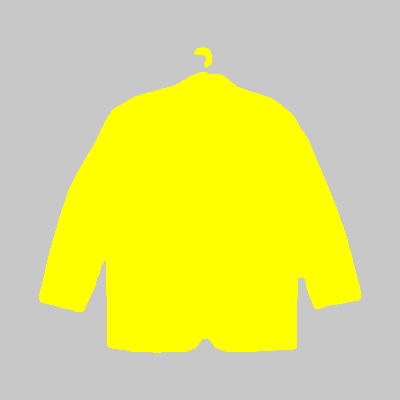

 68%|█████████████████████████████████████████▏                   | 608/900 [01:36<00:43,  6.69it/s]

torch.Size([1, 3, 400, 400])
/mnt/nas4/hm/datasets/shopping_clothes/data/data900_personby100/bottom/image/train_97.jpg
{'background': 0, 'top': 1, 'skirt': 2, 'outer': 3, 'dress': 4, 'bottom': 5}
Counter({5: 84854, 0: 75146})


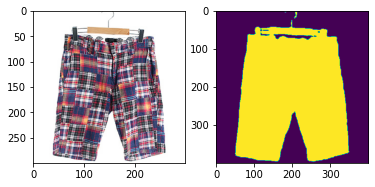

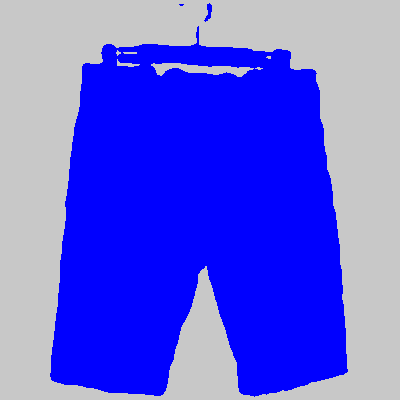

 68%|█████████████████████████████████████████▎                   | 609/900 [01:36<00:42,  6.87it/s]

torch.Size([1, 3, 400, 400])
/mnt/nas4/hm/datasets/shopping_clothes/data/data900_personby100/dress/image/train_3824.jpg
{'background': 0, 'top': 1, 'skirt': 2, 'outer': 3, 'dress': 4, 'bottom': 5}
Counter({0: 103390, 4: 56610})


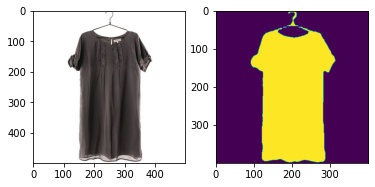

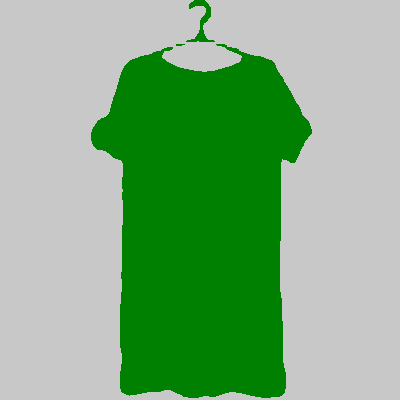

 68%|█████████████████████████████████████████▎                   | 610/900 [01:36<00:42,  6.88it/s]

torch.Size([1, 3, 400, 400])
/mnt/nas4/hm/datasets/shopping_clothes/data/data900_personby100/dress/image/train_2045.jpg
{'background': 0, 'top': 1, 'skirt': 2, 'outer': 3, 'dress': 4, 'bottom': 5}
Counter({0: 113388, 4: 46612})


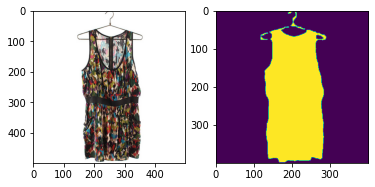

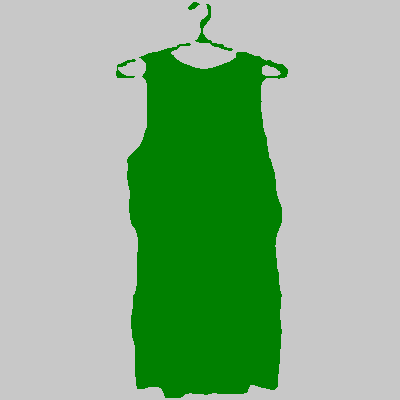

 68%|█████████████████████████████████████████▍                   | 611/900 [01:36<00:42,  6.86it/s]

torch.Size([1, 3, 400, 400])
/mnt/nas4/hm/datasets/shopping_clothes/data/data900_personby100/outer/image/train_4078.jpg
{'background': 0, 'top': 1, 'skirt': 2, 'outer': 3, 'dress': 4, 'bottom': 5}
Counter({0: 86396, 3: 73604})


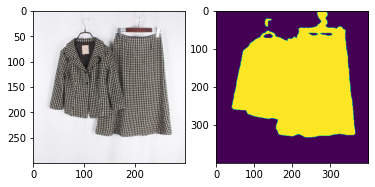

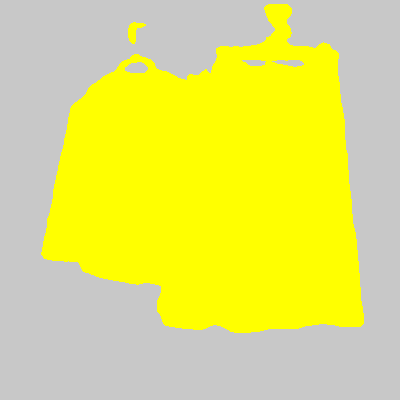

 68%|█████████████████████████████████████████▍                   | 612/900 [01:37<00:41,  7.01it/s]

torch.Size([1, 3, 400, 400])
/mnt/nas4/hm/datasets/shopping_clothes/data/data900_personby100/skirt/image/train_2326.jpg
{'background': 0, 'top': 1, 'skirt': 2, 'outer': 3, 'dress': 4, 'bottom': 5}
Counter({0: 82289, 2: 77711})


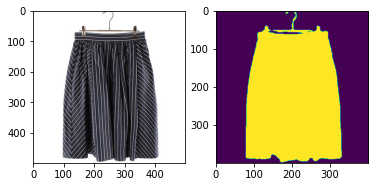

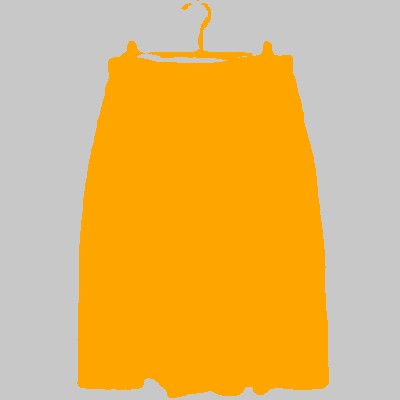

 68%|█████████████████████████████████████████▌                   | 613/900 [01:37<00:46,  6.18it/s]

torch.Size([1, 3, 400, 400])
/mnt/nas4/hm/datasets/shopping_clothes/data/data900_personby100/dress/image/train_1047.jpg
{'background': 0, 'top': 1, 'skirt': 2, 'outer': 3, 'dress': 4, 'bottom': 5}
Counter({0: 107371, 4: 52629})


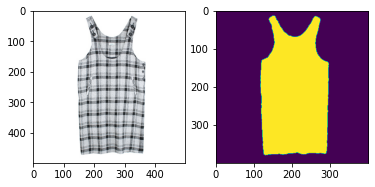

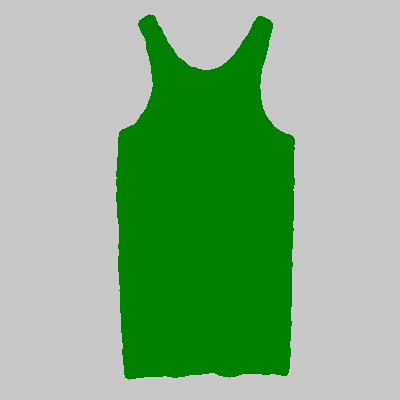

 68%|█████████████████████████████████████████▌                   | 614/900 [01:37<00:45,  6.33it/s]

torch.Size([1, 3, 400, 400])
/mnt/nas4/hm/datasets/shopping_clothes/data/data900_personby100/bottom/image/train_2490.jpg
{'background': 0, 'top': 1, 'skirt': 2, 'outer': 3, 'dress': 4, 'bottom': 5}
Counter({0: 109462, 5: 50538})


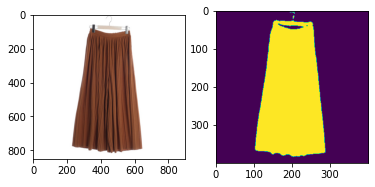

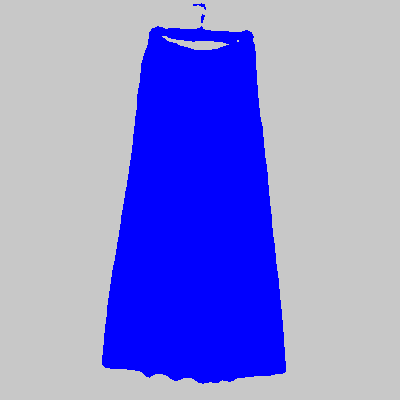

 68%|█████████████████████████████████████████▋                   | 615/900 [01:37<00:47,  6.02it/s]

torch.Size([1, 3, 400, 400])
/mnt/nas4/hm/datasets/shopping_clothes/data/data900_personby100/top/image/train_8255.jpg
{'background': 0, 'top': 1, 'skirt': 2, 'outer': 3, 'dress': 4, 'bottom': 5}
Counter({1: 83367, 0: 76633})


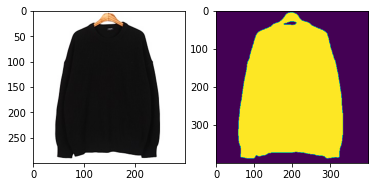

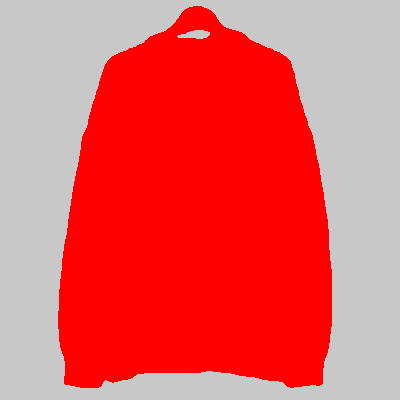

 68%|█████████████████████████████████████████▊                   | 616/900 [01:37<00:44,  6.40it/s]

torch.Size([1, 3, 400, 400])
/mnt/nas4/hm/datasets/shopping_clothes/data/data900_personby100/skirt/image/train_2111.jpg
{'background': 0, 'top': 1, 'skirt': 2, 'outer': 3, 'dress': 4, 'bottom': 5}
Counter({0: 82565, 2: 77435})


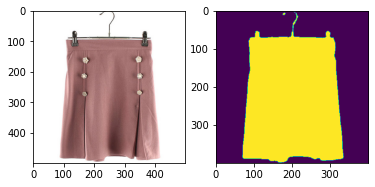

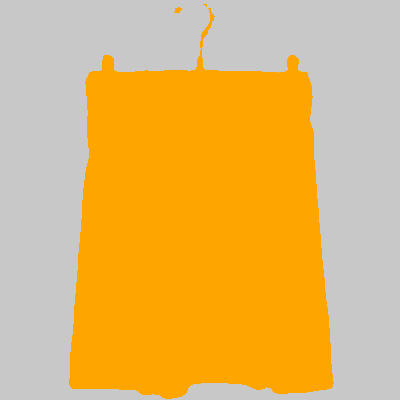

 69%|█████████████████████████████████████████▊                   | 617/900 [01:37<00:43,  6.52it/s]

torch.Size([1, 3, 400, 400])
/mnt/nas4/hm/datasets/shopping_clothes/data/data900_personby100/bottom/image/train_2875.jpg
{'background': 0, 'top': 1, 'skirt': 2, 'outer': 3, 'dress': 4, 'bottom': 5}
Counter({0: 111197, 5: 48803})


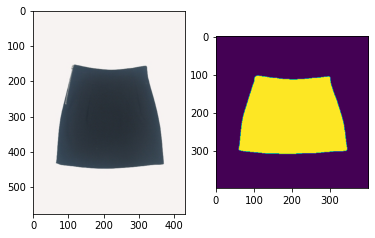

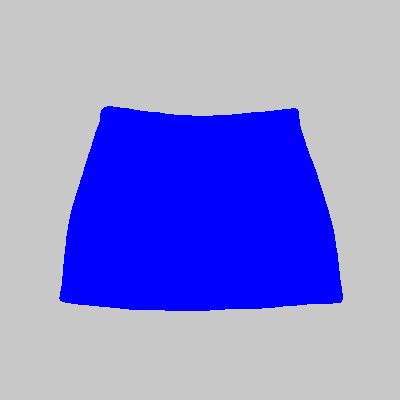

 69%|█████████████████████████████████████████▉                   | 618/900 [01:37<00:42,  6.59it/s]

torch.Size([1, 3, 400, 400])
/mnt/nas4/hm/datasets/shopping_clothes/data/data900_personby100/top/image/train_4940.jpg
{'background': 0, 'top': 1, 'skirt': 2, 'outer': 3, 'dress': 4, 'bottom': 5}
Counter({0: 107741, 1: 52259})


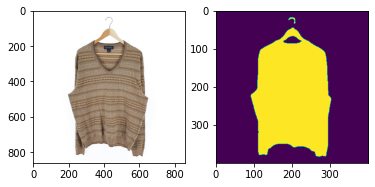

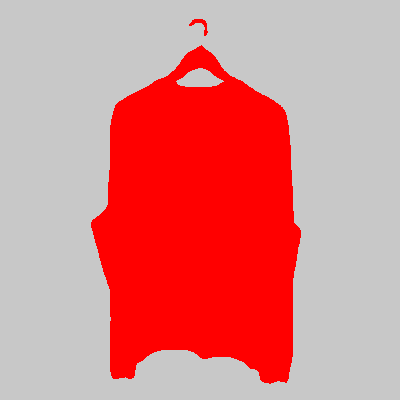

 69%|█████████████████████████████████████████▉                   | 619/900 [01:38<00:45,  6.22it/s]

torch.Size([1, 3, 400, 400])
/mnt/nas4/hm/datasets/shopping_clothes/data/data900_personby100/outer/image/train_8420.jpg
{'background': 0, 'top': 1, 'skirt': 2, 'outer': 3, 'dress': 4, 'bottom': 5}
Counter({0: 102219, 3: 57781})


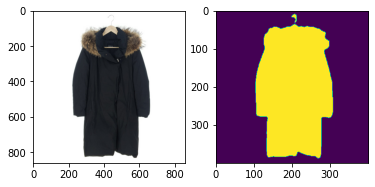

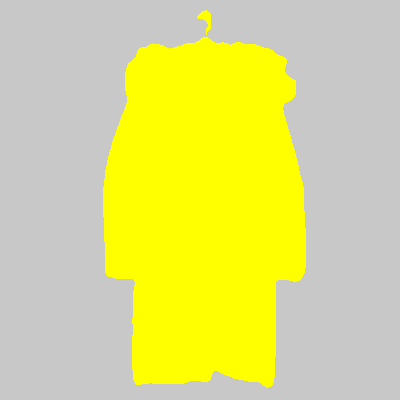

 69%|██████████████████████████████████████████                   | 620/900 [01:38<00:46,  6.01it/s]

torch.Size([1, 3, 400, 400])
/mnt/nas4/hm/datasets/shopping_clothes/data/data900_personby100/top/image/train_1293.jpg
{'background': 0, 'top': 1, 'skirt': 2, 'outer': 3, 'dress': 4, 'bottom': 5}
Counter({1: 90772, 0: 69228})


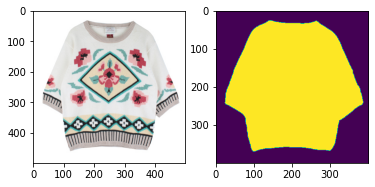

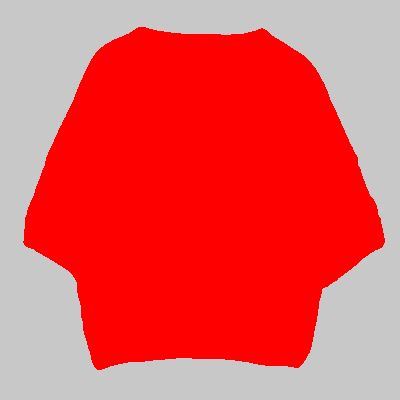

 69%|██████████████████████████████████████████                   | 621/900 [01:38<00:45,  6.19it/s]

torch.Size([1, 3, 400, 400])
/mnt/nas4/hm/datasets/shopping_clothes/data/data900_personby100/outer/image/train_2732.jpg
{'background': 0, 'top': 1, 'skirt': 2, 'outer': 3, 'dress': 4, 'bottom': 5}
Counter({0: 113872, 3: 46128})


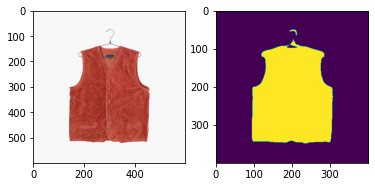

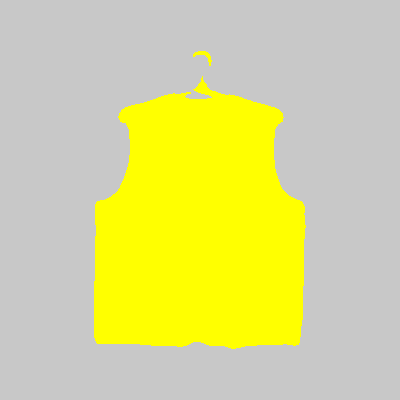

 69%|██████████████████████████████████████████▏                  | 622/900 [01:38<00:44,  6.31it/s]

torch.Size([1, 3, 400, 400])
/mnt/nas4/hm/datasets/shopping_clothes/data/data900_personby100/dress/image/train_303.jpg
{'background': 0, 'top': 1, 'skirt': 2, 'outer': 3, 'dress': 4, 'bottom': 5}
Counter({0: 134069, 4: 25931})


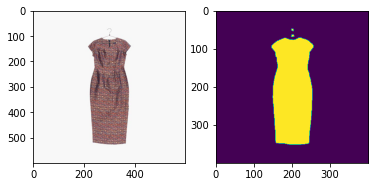

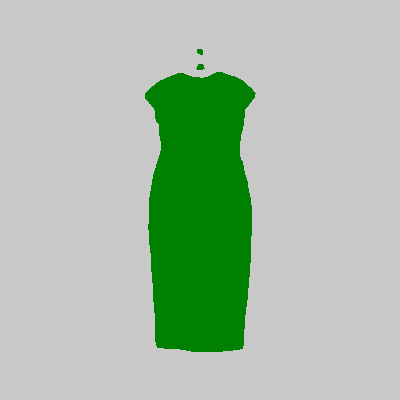

 69%|██████████████████████████████████████████▏                  | 623/900 [01:38<00:43,  6.43it/s]

torch.Size([1, 3, 400, 400])
/mnt/nas4/hm/datasets/shopping_clothes/data/data900_personby100/outer/image/train_1429.jpg
{'background': 0, 'top': 1, 'skirt': 2, 'outer': 3, 'dress': 4, 'bottom': 5}
Counter({3: 88504, 0: 71496})


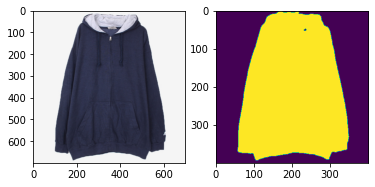

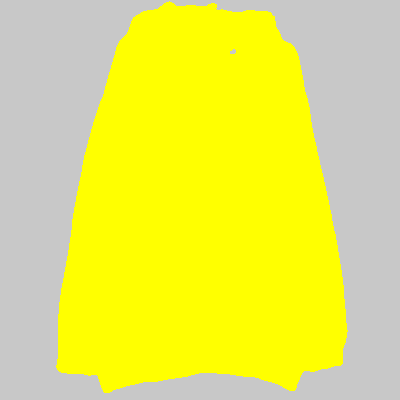

 69%|██████████████████████████████████████████▎                  | 624/900 [01:39<00:48,  5.63it/s]

torch.Size([1, 3, 400, 400])
/mnt/nas4/hm/datasets/shopping_clothes/data/data900_personby100/dress/image/train_1375.jpg
{'background': 0, 'top': 1, 'skirt': 2, 'outer': 3, 'dress': 4, 'bottom': 5}
Counter({0: 105248, 4: 54752})


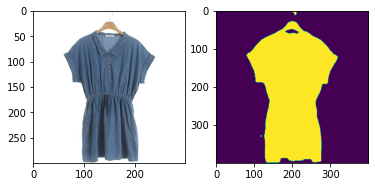

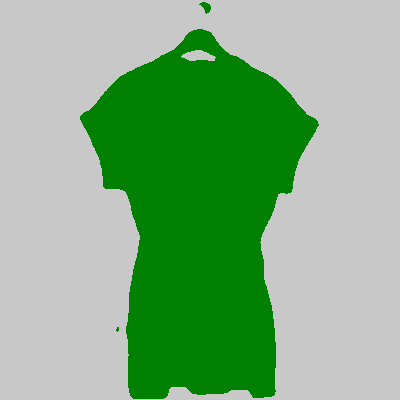

 69%|██████████████████████████████████████████▎                  | 625/900 [01:39<00:45,  6.07it/s]

torch.Size([1, 3, 400, 400])
/mnt/nas4/hm/datasets/shopping_clothes/data/data900_personby100/outer/image/train_4464.jpg
{'background': 0, 'top': 1, 'skirt': 2, 'outer': 3, 'dress': 4, 'bottom': 5}
Counter({3: 101338, 0: 58662})


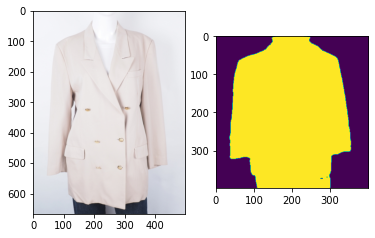

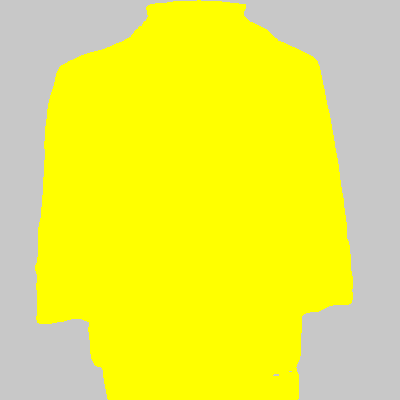

 70%|██████████████████████████████████████████▍                  | 626/900 [01:39<00:45,  6.04it/s]

torch.Size([1, 3, 400, 400])
/mnt/nas4/hm/datasets/shopping_clothes/data/data900_personby100/dress/image/train_3059.jpg
{'background': 0, 'top': 1, 'skirt': 2, 'outer': 3, 'dress': 4, 'bottom': 5}
Counter({0: 108291, 4: 51709})


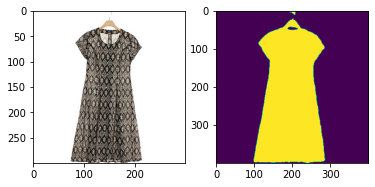

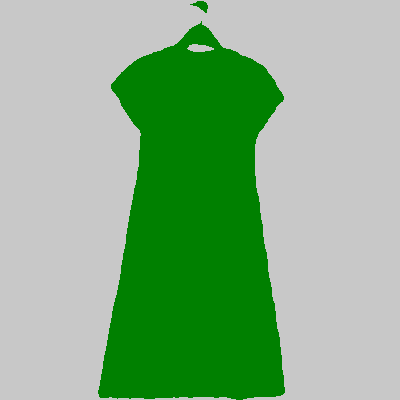

 70%|██████████████████████████████████████████▍                  | 627/900 [01:39<00:42,  6.41it/s]

torch.Size([1, 3, 400, 400])
/mnt/nas4/hm/datasets/shopping_clothes/data/data900_personby100/top/image/train_12849.jpg
{'background': 0, 'top': 1, 'skirt': 2, 'outer': 3, 'dress': 4, 'bottom': 5}
Counter({0: 103040, 1: 56960})


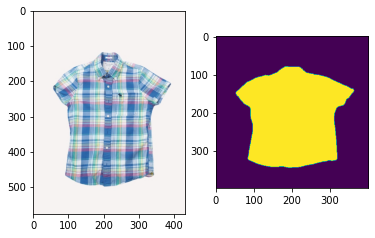

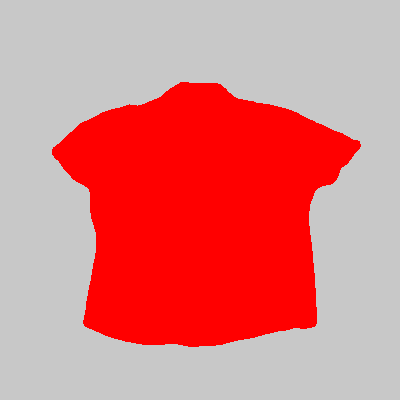

 70%|██████████████████████████████████████████▌                  | 628/900 [01:39<00:41,  6.51it/s]

torch.Size([1, 3, 400, 400])
/mnt/nas4/hm/datasets/shopping_clothes/data/data900_personby100/bottom/image/train_1325.jpg
{'background': 0, 'top': 1, 'skirt': 2, 'outer': 3, 'dress': 4, 'bottom': 5}
Counter({0: 112355, 5: 47645})


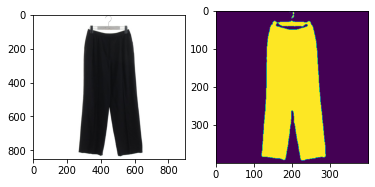

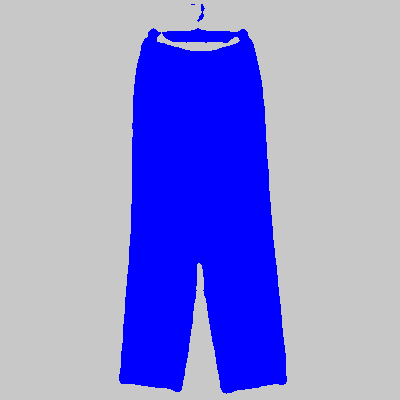

 70%|██████████████████████████████████████████▋                  | 629/900 [01:39<00:43,  6.16it/s]

torch.Size([1, 3, 400, 400])
/mnt/nas4/hm/datasets/shopping_clothes/data/data900_personby100/skirt/image/train_135.jpg
{'background': 0, 'top': 1, 'skirt': 2, 'outer': 3, 'dress': 4, 'bottom': 5}
Counter({2: 89246, 0: 70754})


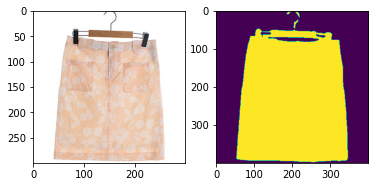

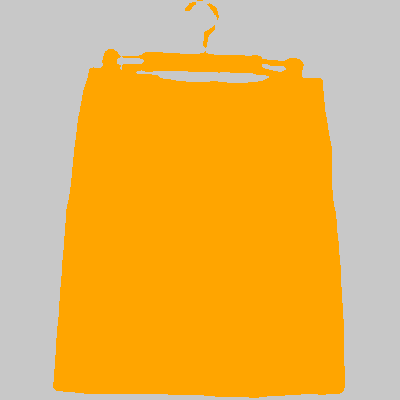

 70%|██████████████████████████████████████████▋                  | 630/900 [01:39<00:41,  6.48it/s]

torch.Size([1, 3, 400, 400])
/mnt/nas4/hm/datasets/shopping_clothes/data/data900_personby100/skirt/image/train_107.jpg
{'background': 0, 'top': 1, 'skirt': 2, 'outer': 3, 'dress': 4, 'bottom': 5}
Counter({0: 83895, 2: 76105})


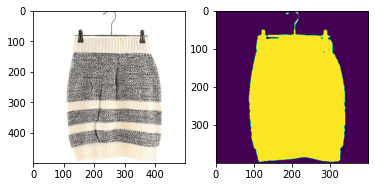

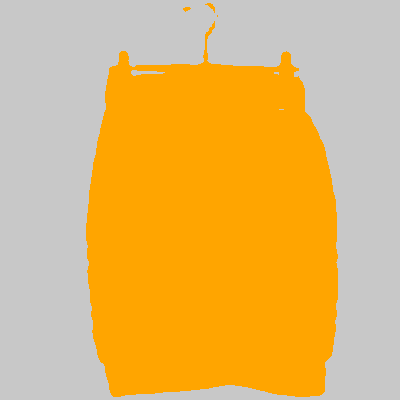

 70%|██████████████████████████████████████████▊                  | 631/900 [01:40<00:40,  6.60it/s]

torch.Size([1, 3, 400, 400])
/mnt/nas4/hm/datasets/shopping_clothes/data/data900_personby100/skirt/image/train_2579.jpg
{'background': 0, 'top': 1, 'skirt': 2, 'outer': 3, 'dress': 4, 'bottom': 5}
Counter({2: 88120, 0: 71880})


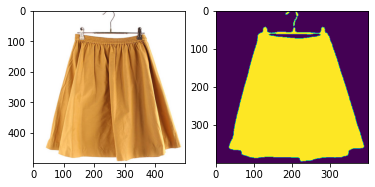

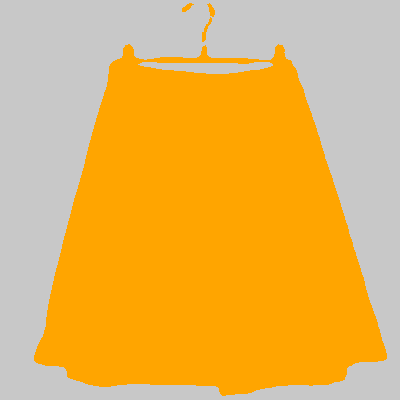

 70%|██████████████████████████████████████████▊                  | 632/900 [01:40<00:40,  6.68it/s]

torch.Size([1, 3, 400, 400])
/mnt/nas4/hm/datasets/shopping_clothes/data/data900_personby100/dress/image/train_3414.jpg
{'background': 0, 'top': 1, 'skirt': 2, 'outer': 3, 'dress': 4, 'bottom': 5}
Counter({0: 90077, 4: 69923})


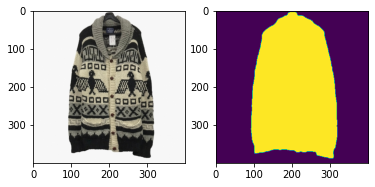

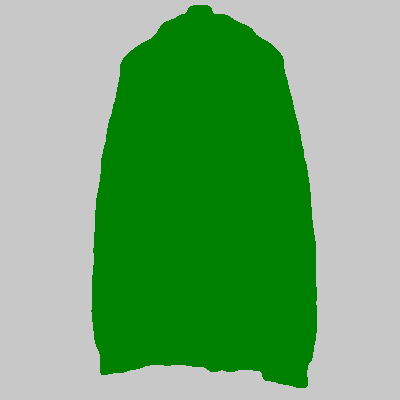

 70%|██████████████████████████████████████████▉                  | 633/900 [01:40<00:39,  6.84it/s]

torch.Size([1, 3, 400, 400])
/mnt/nas4/hm/datasets/shopping_clothes/data/data900_personby100/outer/image/train_7268.jpg
{'background': 0, 'top': 1, 'skirt': 2, 'outer': 3, 'dress': 4, 'bottom': 5}
Counter({0: 99523, 3: 60475, 2: 2})


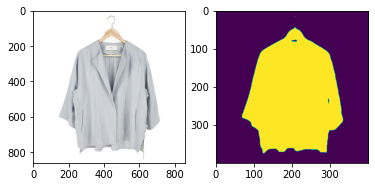

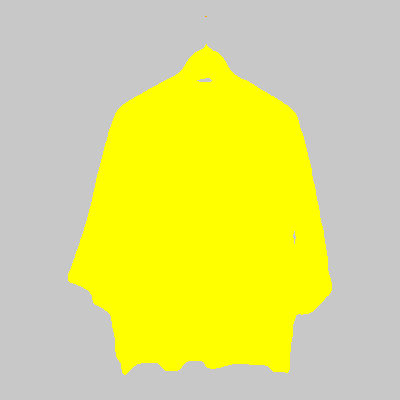

 70%|██████████████████████████████████████████▉                  | 634/900 [01:40<00:41,  6.39it/s]

torch.Size([1, 3, 400, 400])
/mnt/nas4/hm/datasets/shopping_clothes/data/data900_personby100/top/image/train_6773.jpg
{'background': 0, 'top': 1, 'skirt': 2, 'outer': 3, 'dress': 4, 'bottom': 5}
Counter({0: 110840, 1: 49160})


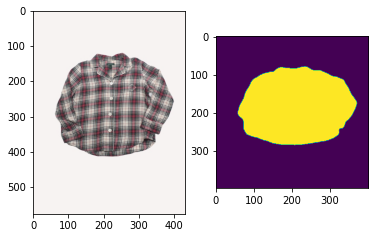

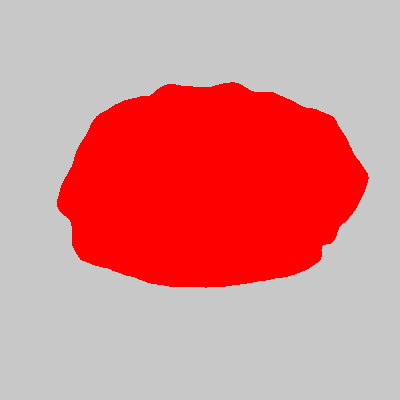

 71%|███████████████████████████████████████████                  | 635/900 [01:40<00:45,  5.81it/s]

torch.Size([1, 3, 400, 400])
/mnt/nas4/hm/datasets/shopping_clothes/data/data900_personby100/top/image/train_18754.jpg
{'background': 0, 'top': 1, 'skirt': 2, 'outer': 3, 'dress': 4, 'bottom': 5}
Counter({0: 101786, 1: 58214})


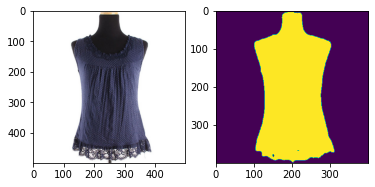

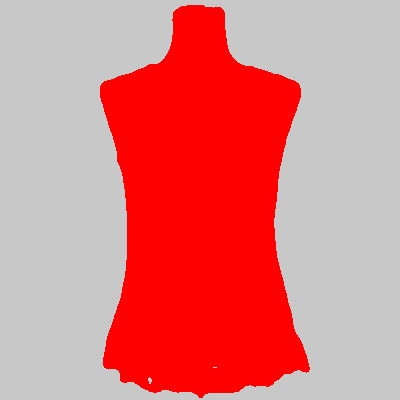

 71%|███████████████████████████████████████████                  | 636/900 [01:40<00:43,  6.08it/s]

torch.Size([1, 3, 400, 400])
/mnt/nas4/hm/datasets/shopping_clothes/data/data900_personby100/outer/image/train_10330.jpg
{'background': 0, 'top': 1, 'skirt': 2, 'outer': 3, 'dress': 4, 'bottom': 5}
Counter({0: 90021, 3: 69979})


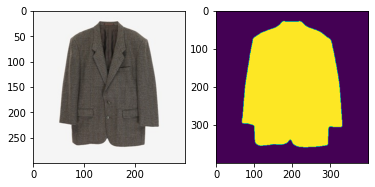

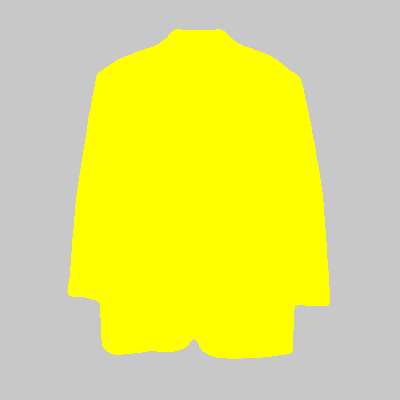

 71%|███████████████████████████████████████████▏                 | 637/900 [01:41<00:40,  6.44it/s]

torch.Size([1, 3, 400, 400])
/mnt/nas4/hm/datasets/shopping_clothes/data/data900_personby100/top/image/train_18320.jpg
{'background': 0, 'top': 1, 'skirt': 2, 'outer': 3, 'dress': 4, 'bottom': 5}
Counter({1: 83068, 0: 76932})


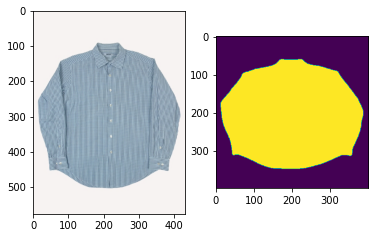

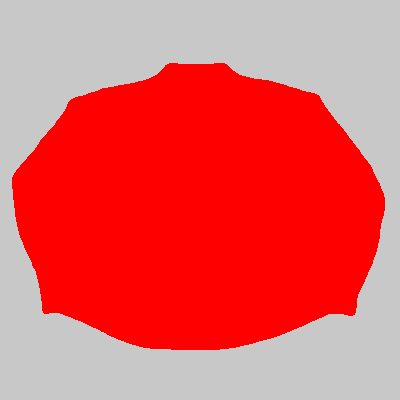

 71%|███████████████████████████████████████████▏                 | 638/900 [01:41<00:40,  6.46it/s]

torch.Size([1, 3, 400, 400])
/mnt/nas4/hm/datasets/shopping_clothes/data/data900_personby100/skirt/image/train_1483.jpg
{'background': 0, 'top': 1, 'skirt': 2, 'outer': 3, 'dress': 4, 'bottom': 5}
Counter({0: 91038, 2: 68962})


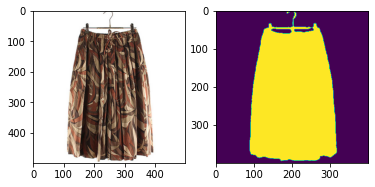

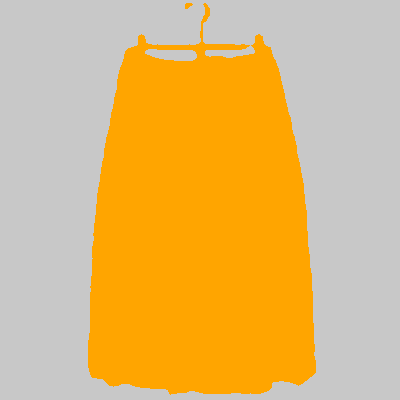

 71%|███████████████████████████████████████████▎                 | 639/900 [01:41<00:39,  6.58it/s]

torch.Size([1, 3, 400, 400])
/mnt/nas4/hm/datasets/shopping_clothes/data/data900_personby100/bottom/image/train_806.jpg
{'background': 0, 'top': 1, 'skirt': 2, 'outer': 3, 'dress': 4, 'bottom': 5}
Counter({0: 87355, 5: 72645})


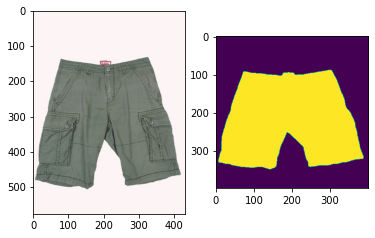

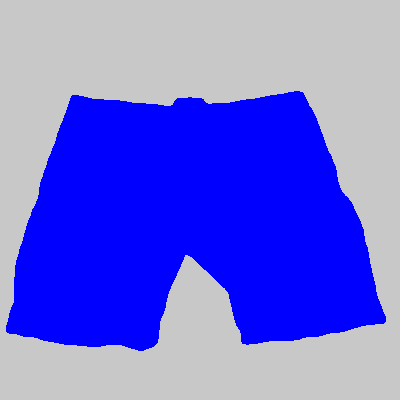

 71%|███████████████████████████████████████████▍                 | 640/900 [01:41<00:39,  6.61it/s]

torch.Size([1, 3, 400, 400])
/mnt/nas4/hm/datasets/shopping_clothes/data/data900_personby100/top/image/train_8570.jpg
{'background': 0, 'top': 1, 'skirt': 2, 'outer': 3, 'dress': 4, 'bottom': 5}
Counter({0: 104623, 1: 55377})


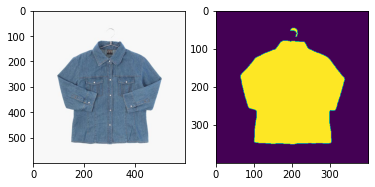

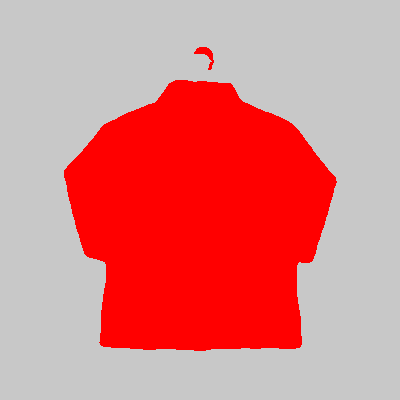

 71%|███████████████████████████████████████████▍                 | 641/900 [01:41<00:39,  6.59it/s]

torch.Size([1, 3, 400, 400])
/mnt/nas4/hm/datasets/shopping_clothes/data/data900_personby100/bottom/image/train_313.jpg
{'background': 0, 'top': 1, 'skirt': 2, 'outer': 3, 'dress': 4, 'bottom': 5}
Counter({0: 117677, 5: 42323})


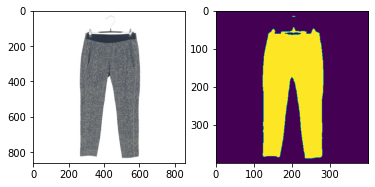

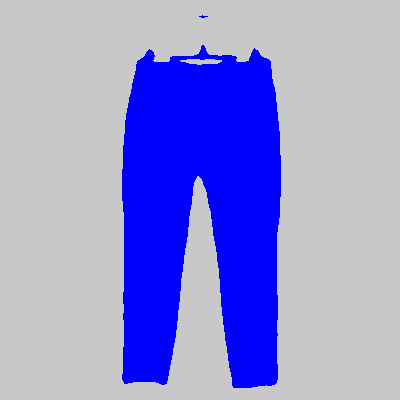

 71%|███████████████████████████████████████████▌                 | 642/900 [01:41<00:41,  6.24it/s]

torch.Size([1, 3, 400, 400])
/mnt/nas4/hm/datasets/shopping_clothes/data/data900_personby100/outer/image/train_5110.jpg
{'background': 0, 'top': 1, 'skirt': 2, 'outer': 3, 'dress': 4, 'bottom': 5}
Counter({0: 93785, 3: 66215})


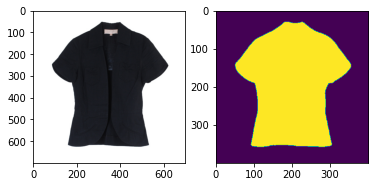

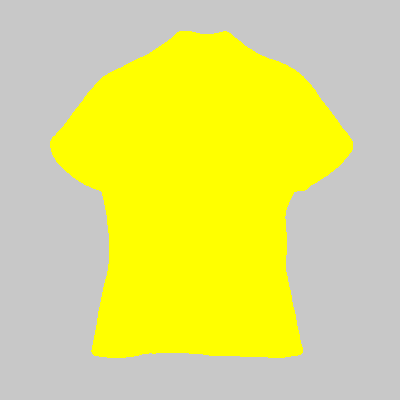

 71%|███████████████████████████████████████████▌                 | 643/900 [01:41<00:41,  6.13it/s]

torch.Size([1, 3, 400, 400])
/mnt/nas4/hm/datasets/shopping_clothes/data/data900_personby100/outer/image/train_2051.jpg
{'background': 0, 'top': 1, 'skirt': 2, 'outer': 3, 'dress': 4, 'bottom': 5}
Counter({0: 98286, 3: 61714})


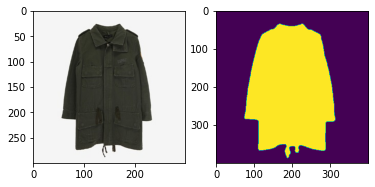

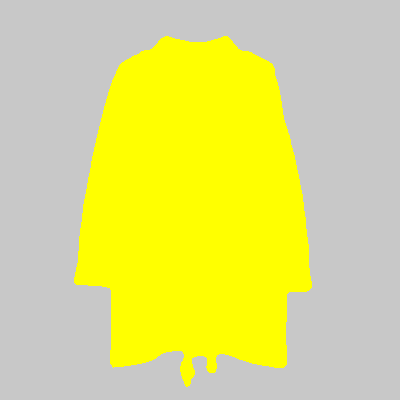

 72%|███████████████████████████████████████████▋                 | 644/900 [01:42<00:39,  6.48it/s]

torch.Size([1, 3, 400, 400])
/mnt/nas4/hm/datasets/shopping_clothes/data/data900_personby100/top/image/train_13743.jpg
{'background': 0, 'top': 1, 'skirt': 2, 'outer': 3, 'dress': 4, 'bottom': 5}
Counter({0: 98687, 1: 61313})


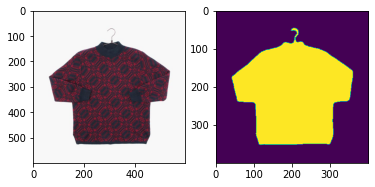

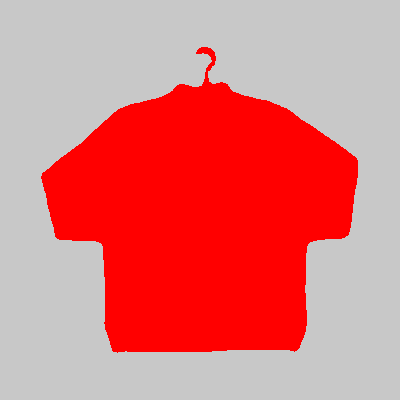

 72%|███████████████████████████████████████████▋                 | 645/900 [01:42<00:39,  6.47it/s]

torch.Size([1, 3, 400, 400])
/mnt/nas4/hm/datasets/shopping_clothes/data/data900_personby100/skirt/image/train_1021.jpg
{'background': 0, 'top': 1, 'skirt': 2, 'outer': 3, 'dress': 4, 'bottom': 5}
Counter({0: 96729, 2: 63271})


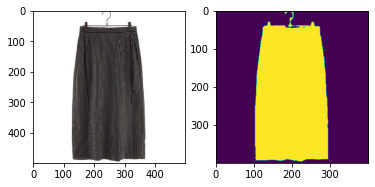

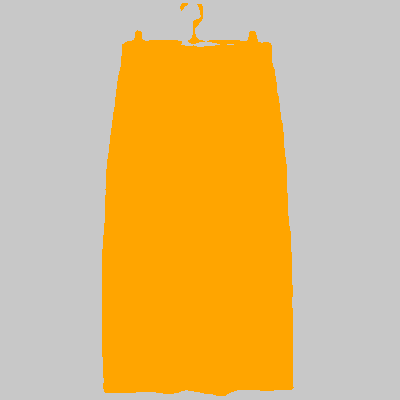

 72%|███████████████████████████████████████████▊                 | 646/900 [01:42<00:43,  5.88it/s]

torch.Size([1, 3, 400, 400])
/mnt/nas4/hm/datasets/shopping_clothes/data/data900_personby100/top/image/train_17547.jpg
{'background': 0, 'top': 1, 'skirt': 2, 'outer': 3, 'dress': 4, 'bottom': 5}
Counter({0: 108551, 1: 51449})


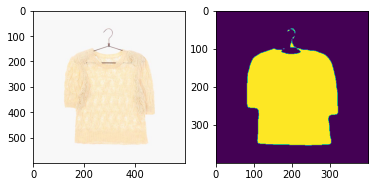

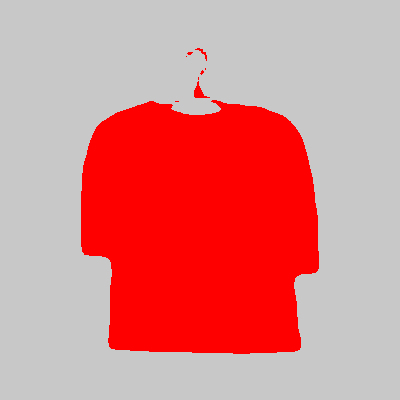

 72%|███████████████████████████████████████████▊                 | 647/900 [01:42<00:41,  6.08it/s]

torch.Size([1, 3, 400, 400])
/mnt/nas4/hm/datasets/shopping_clothes/data/data900_personby100/top/image/train_14618.jpg
{'background': 0, 'top': 1, 'skirt': 2, 'outer': 3, 'dress': 4, 'bottom': 5}
Counter({0: 87668, 1: 72332})


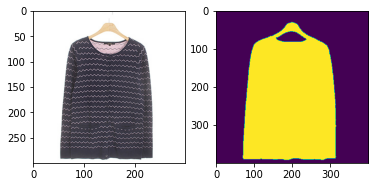

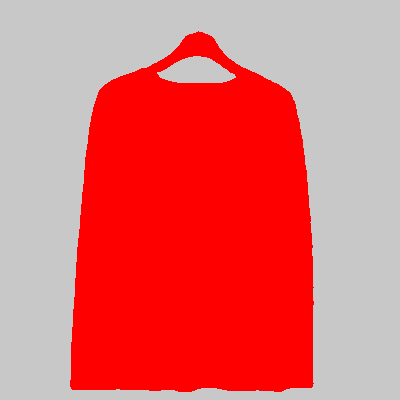

 72%|███████████████████████████████████████████▉                 | 648/900 [01:42<00:39,  6.41it/s]

torch.Size([1, 3, 400, 400])
/mnt/nas4/hm/datasets/shopping_clothes/data/data900_personby100/top/image/train_13254.jpg
{'background': 0, 'top': 1, 'skirt': 2, 'outer': 3, 'dress': 4, 'bottom': 5}
Counter({0: 88192, 1: 71808})


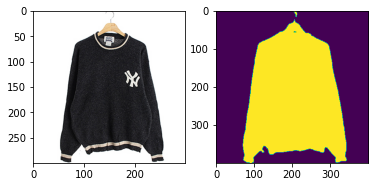

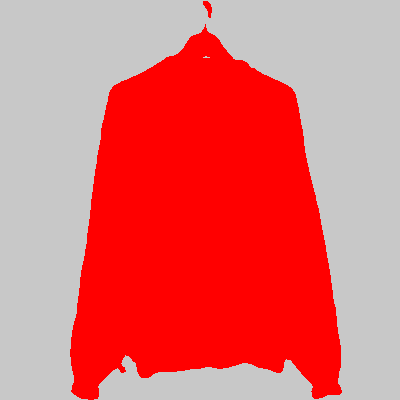

 72%|███████████████████████████████████████████▉                 | 649/900 [01:42<00:37,  6.69it/s]

torch.Size([1, 3, 400, 400])
/mnt/nas4/hm/datasets/shopping_clothes/data/data900_personby100/outer/image/train_3479.jpg
{'background': 0, 'top': 1, 'skirt': 2, 'outer': 3, 'dress': 4, 'bottom': 5}
Counter({0: 90054, 3: 69946})


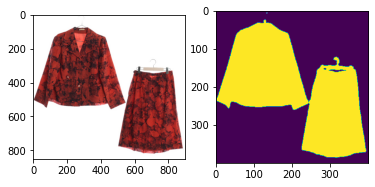

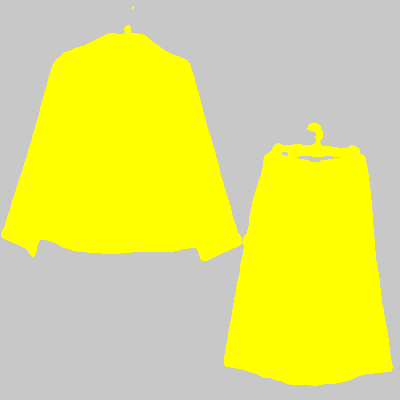

 72%|████████████████████████████████████████████                 | 650/900 [01:43<00:40,  6.12it/s]

torch.Size([1, 3, 400, 400])
/mnt/nas4/hm/datasets/shopping_clothes/data/data900_personby100/bottom/image/train_2332.jpg
{'background': 0, 'top': 1, 'skirt': 2, 'outer': 3, 'dress': 4, 'bottom': 5}
Counter({0: 105911, 5: 54089})


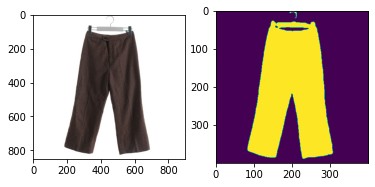

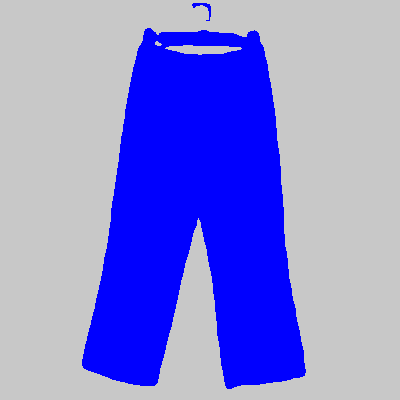

 72%|████████████████████████████████████████████                 | 651/900 [01:43<00:42,  5.84it/s]

torch.Size([1, 3, 400, 400])
/mnt/nas4/hm/datasets/shopping_clothes/data/data900_personby100/bottom/image/train_679.jpg
{'background': 0, 'top': 1, 'skirt': 2, 'outer': 3, 'dress': 4, 'bottom': 5}
Counter({0: 115813, 5: 44187})


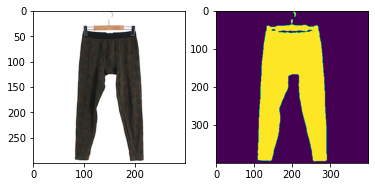

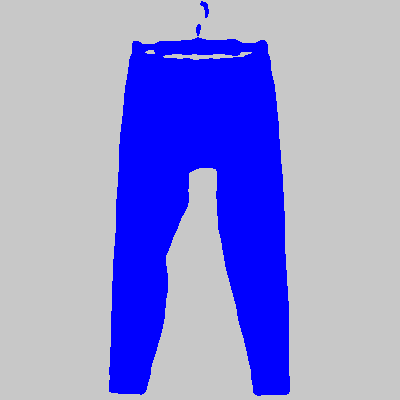

 72%|████████████████████████████████████████████▏                | 652/900 [01:43<00:39,  6.26it/s]

torch.Size([1, 3, 400, 400])
/mnt/nas4/hm/datasets/shopping_clothes/data/data900_personby100/bottom/image/train_1705.jpg
{'background': 0, 'top': 1, 'skirt': 2, 'outer': 3, 'dress': 4, 'bottom': 5}
Counter({0: 129909, 5: 30091})


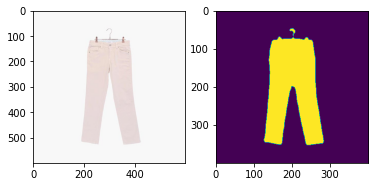

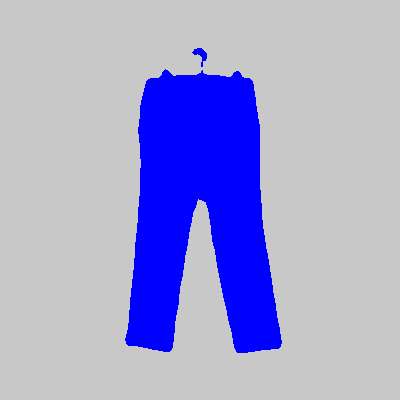

 73%|████████████████████████████████████████████▎                | 653/900 [01:43<00:38,  6.38it/s]

torch.Size([1, 3, 400, 400])
/mnt/nas4/hm/datasets/shopping_clothes/data/data900_personby100/skirt/image/train_2104.jpg
{'background': 0, 'top': 1, 'skirt': 2, 'outer': 3, 'dress': 4, 'bottom': 5}
Counter({0: 111068, 2: 48932})


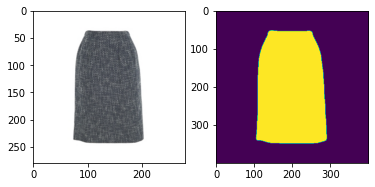

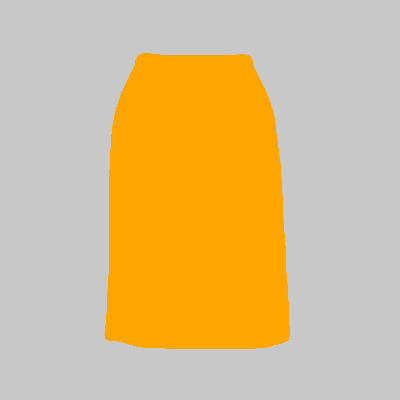

 73%|████████████████████████████████████████████▎                | 654/900 [01:43<00:36,  6.70it/s]

torch.Size([1, 3, 400, 400])
/mnt/nas4/hm/datasets/shopping_clothes/data/data900_personby100/dress/image/train_174.jpg
{'background': 0, 'top': 1, 'skirt': 2, 'outer': 3, 'dress': 4, 'bottom': 5}
Counter({0: 109300, 4: 50700})


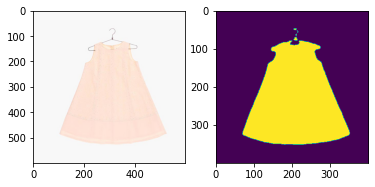

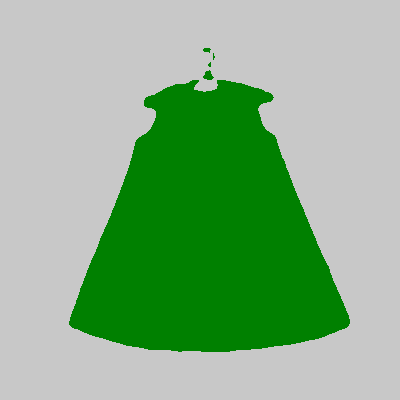

 73%|████████████████████████████████████████████▍                | 655/900 [01:43<00:36,  6.68it/s]

torch.Size([1, 3, 400, 400])
/mnt/nas4/hm/datasets/shopping_clothes/data/data900_personby100/dress/image/train_1304.jpg
{'background': 0, 'top': 1, 'skirt': 2, 'outer': 3, 'dress': 4, 'bottom': 5}
Counter({0: 110447, 4: 49553})


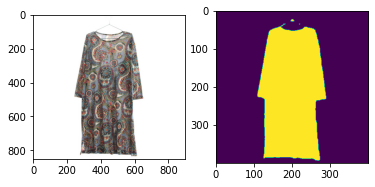

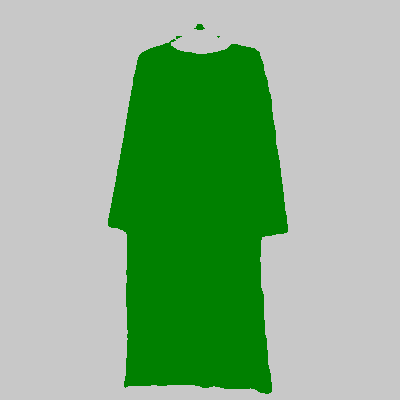

 73%|████████████████████████████████████████████▍                | 656/900 [01:44<00:39,  6.14it/s]

torch.Size([1, 3, 400, 400])
/mnt/nas4/hm/datasets/shopping_clothes/data/data900_personby100/bottom/image/train_2476.jpg
{'background': 0, 'top': 1, 'skirt': 2, 'outer': 3, 'dress': 4, 'bottom': 5}
Counter({0: 103818, 5: 56182})


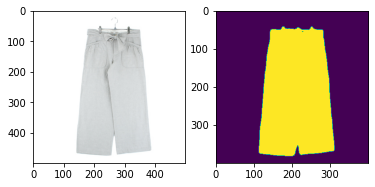

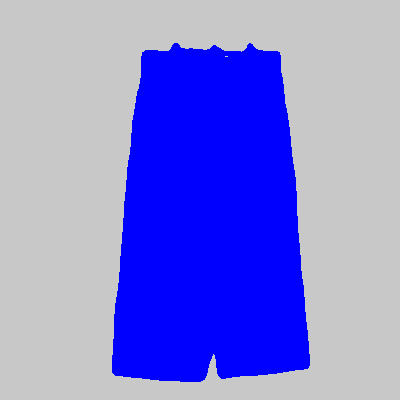

 73%|████████████████████████████████████████████▌                | 657/900 [01:44<00:42,  5.65it/s]

torch.Size([1, 3, 400, 400])
/mnt/nas4/hm/datasets/shopping_clothes/data/data900_personby100/dress/image/train_48.jpg
{'background': 0, 'top': 1, 'skirt': 2, 'outer': 3, 'dress': 4, 'bottom': 5}
Counter({0: 109718, 4: 50282})


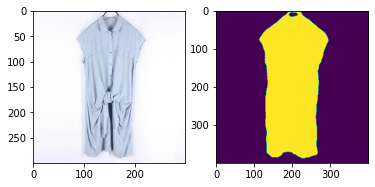

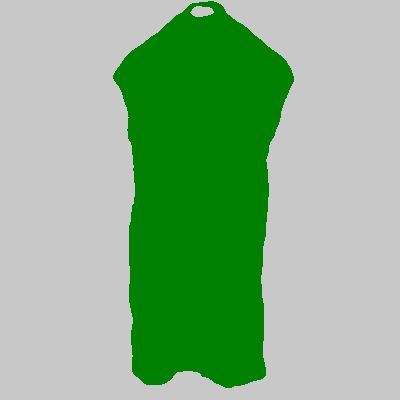

 73%|████████████████████████████████████████████▌                | 658/900 [01:44<00:39,  6.07it/s]

torch.Size([1, 3, 400, 400])
/mnt/nas4/hm/datasets/shopping_clothes/data/data900_personby100/dress/image/train_1209.jpg
{'background': 0, 'top': 1, 'skirt': 2, 'outer': 3, 'dress': 4, 'bottom': 5}
Counter({0: 112297, 4: 47703})


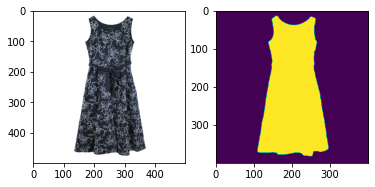

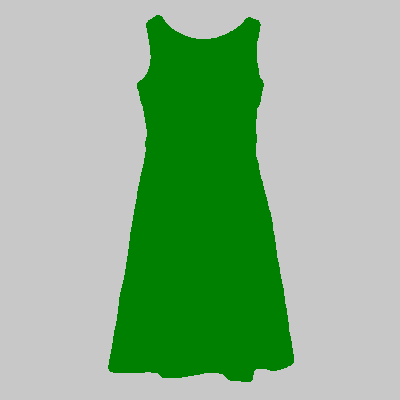

 73%|████████████████████████████████████████████▋                | 659/900 [01:44<00:38,  6.23it/s]

torch.Size([1, 3, 400, 400])
/mnt/nas4/hm/datasets/shopping_clothes/data/data900_personby100/dress/image/train_1063.jpg
{'background': 0, 'top': 1, 'skirt': 2, 'outer': 3, 'dress': 4, 'bottom': 5}
Counter({0: 108284, 4: 51716})


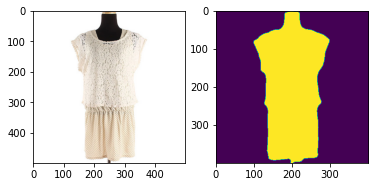

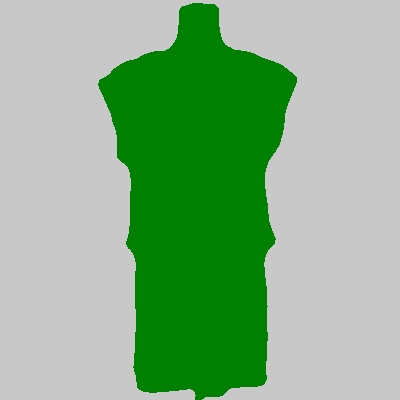

 73%|████████████████████████████████████████████▋                | 660/900 [01:44<00:37,  6.41it/s]

torch.Size([1, 3, 400, 400])
/mnt/nas4/hm/datasets/shopping_clothes/data/data900_personby100/bottom/image/train_1719.jpg
{'background': 0, 'top': 1, 'skirt': 2, 'outer': 3, 'dress': 4, 'bottom': 5}
Counter({0: 113977, 5: 46023})


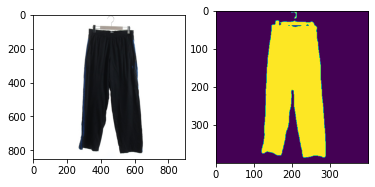

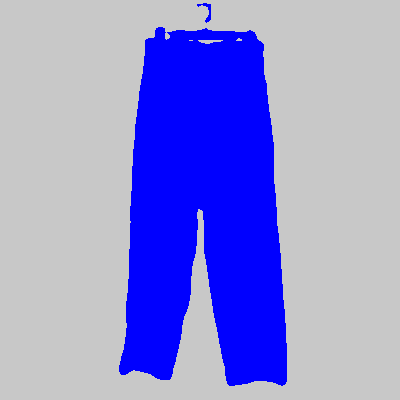

 73%|████████████████████████████████████████████▊                | 661/900 [01:44<00:39,  6.08it/s]

torch.Size([1, 3, 400, 400])
/mnt/nas4/hm/datasets/shopping_clothes/data/data900_personby100/top/image/train_6374.jpg
{'background': 0, 'top': 1, 'skirt': 2, 'outer': 3, 'dress': 4, 'bottom': 5}
Counter({0: 89638, 1: 70362})


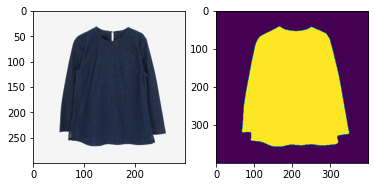

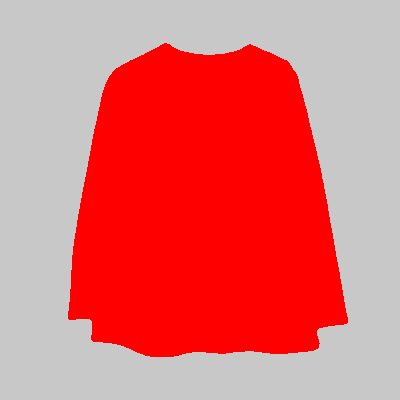

 74%|████████████████████████████████████████████▊                | 662/900 [01:45<00:37,  6.42it/s]

torch.Size([1, 3, 400, 400])
/mnt/nas4/hm/datasets/shopping_clothes/data/data900_personby100/bottom/image/train_818.jpg
{'background': 0, 'top': 1, 'skirt': 2, 'outer': 3, 'dress': 4, 'bottom': 5}
Counter({0: 128345, 5: 31655})


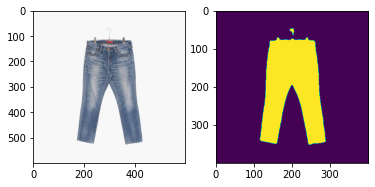

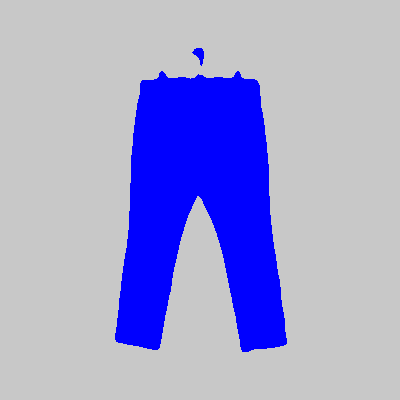

 74%|████████████████████████████████████████████▉                | 663/900 [01:45<00:36,  6.50it/s]

torch.Size([1, 3, 400, 400])
/mnt/nas4/hm/datasets/shopping_clothes/data/data900_personby100/skirt/image/train_2358.jpg
{'background': 0, 'top': 1, 'skirt': 2, 'outer': 3, 'dress': 4, 'bottom': 5}
Counter({0: 89243, 2: 70757})


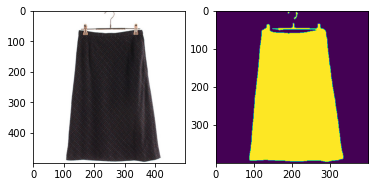

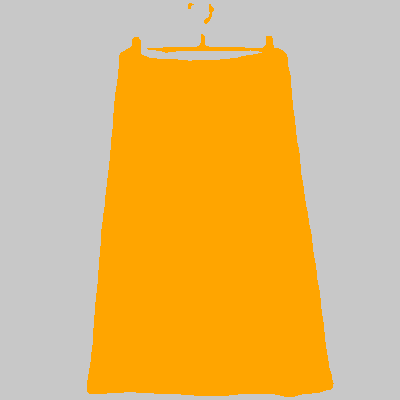

 74%|█████████████████████████████████████████████                | 664/900 [01:45<00:35,  6.60it/s]

torch.Size([1, 3, 400, 400])
/mnt/nas4/hm/datasets/shopping_clothes/data/data900_personby100/outer/image/train_10465.jpg
{'background': 0, 'top': 1, 'skirt': 2, 'outer': 3, 'dress': 4, 'bottom': 5}
Counter({0: 101598, 3: 58402})


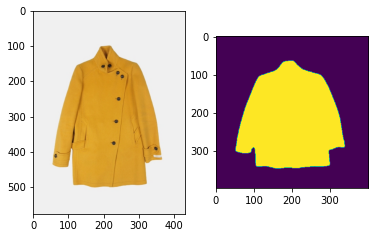

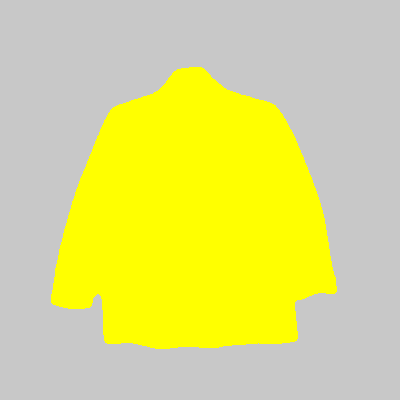

 74%|█████████████████████████████████████████████                | 665/900 [01:45<00:35,  6.62it/s]

torch.Size([1, 3, 400, 400])
/mnt/nas4/hm/datasets/shopping_clothes/data/data900_personby100/bottom/image/train_753.jpg
{'background': 0, 'top': 1, 'skirt': 2, 'outer': 3, 'dress': 4, 'bottom': 5}
Counter({0: 107421, 5: 52579})


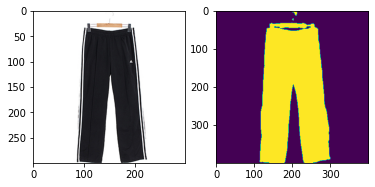

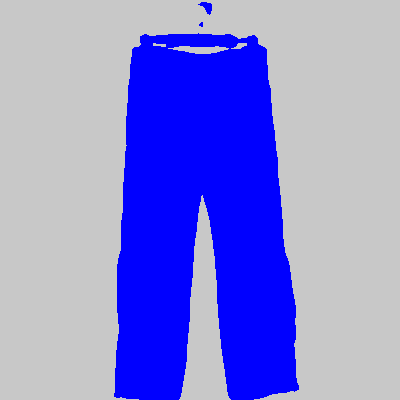

 74%|█████████████████████████████████████████████▏               | 666/900 [01:45<00:34,  6.85it/s]

torch.Size([1, 3, 400, 400])
/mnt/nas4/hm/datasets/shopping_clothes/data/data900_personby100/outer/image/train_8778.jpg
{'background': 0, 'top': 1, 'skirt': 2, 'outer': 3, 'dress': 4, 'bottom': 5}
Counter({3: 88747, 0: 71253})


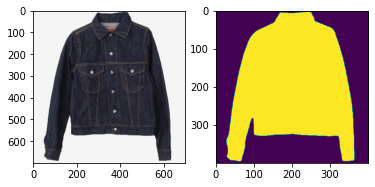

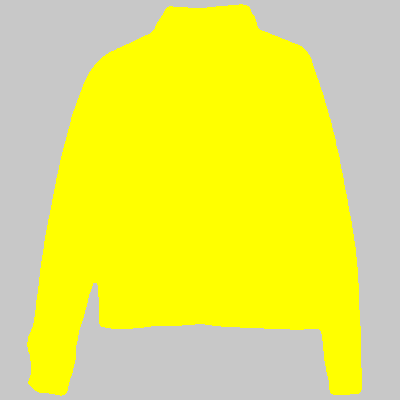

 74%|█████████████████████████████████████████████▏               | 667/900 [01:45<00:35,  6.56it/s]

torch.Size([1, 3, 400, 400])
/mnt/nas4/hm/datasets/shopping_clothes/data/data900_personby100/dress/image/train_1045.jpg
{'background': 0, 'top': 1, 'skirt': 2, 'outer': 3, 'dress': 4, 'bottom': 5}
Counter({0: 115793, 4: 44207})


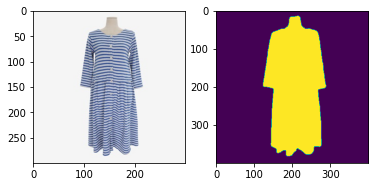

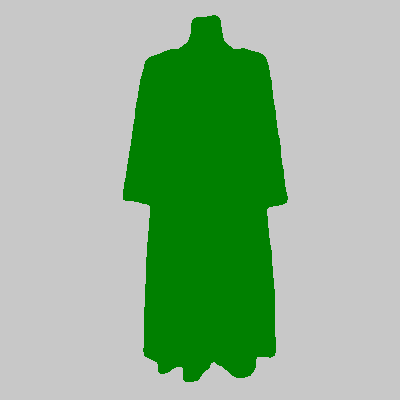

 74%|█████████████████████████████████████████████▎               | 668/900 [01:45<00:38,  6.07it/s]

torch.Size([1, 3, 400, 400])
/mnt/nas4/hm/datasets/shopping_clothes/data/data900_personby100/dress/image/train_2831.jpg
{'background': 0, 'top': 1, 'skirt': 2, 'outer': 3, 'dress': 4, 'bottom': 5}
Counter({4: 87984, 0: 72016})


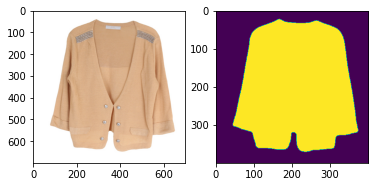

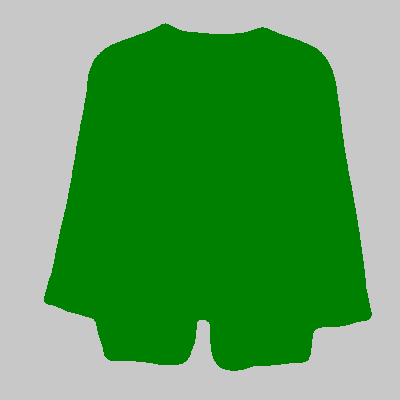

 74%|█████████████████████████████████████████████▎               | 669/900 [01:46<00:38,  5.98it/s]

torch.Size([1, 3, 400, 400])
/mnt/nas4/hm/datasets/shopping_clothes/data/data900_personby100/skirt/image/train_2518.jpg
{'background': 0, 'top': 1, 'skirt': 2, 'outer': 3, 'dress': 4, 'bottom': 5}
Counter({0: 103896, 2: 56104})


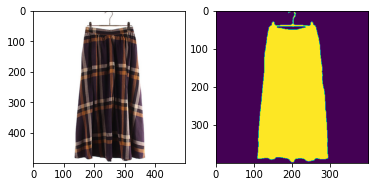

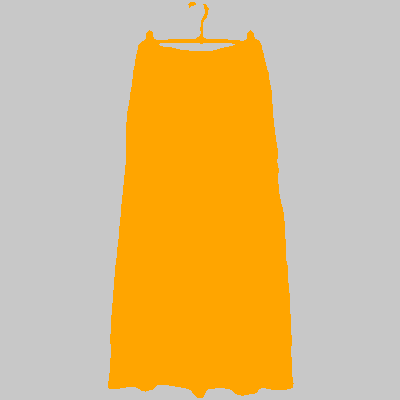

 74%|█████████████████████████████████████████████▍               | 670/900 [01:46<00:36,  6.23it/s]

torch.Size([1, 3, 400, 400])
/mnt/nas4/hm/datasets/shopping_clothes/data/data900_personby100/outer/image/train_10973.jpg
{'background': 0, 'top': 1, 'skirt': 2, 'outer': 3, 'dress': 4, 'bottom': 5}
Counter({0: 88640, 3: 71360})


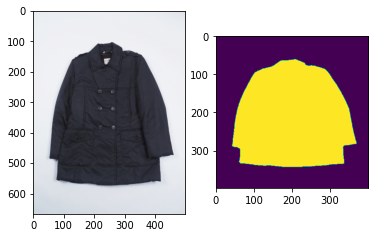

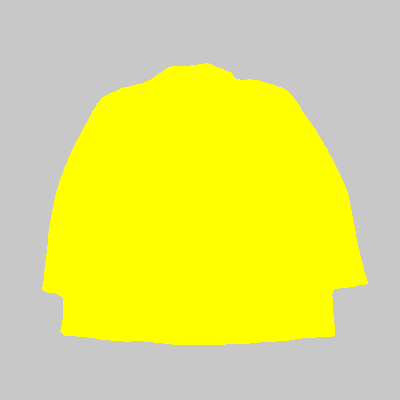

 75%|█████████████████████████████████████████████▍               | 671/900 [01:46<00:37,  6.14it/s]

torch.Size([1, 3, 400, 400])
/mnt/nas4/hm/datasets/shopping_clothes/data/data900_personby100/skirt/image/train_1303.jpg
{'background': 0, 'top': 1, 'skirt': 2, 'outer': 3, 'dress': 4, 'bottom': 5}
Counter({0: 87356, 2: 72644})


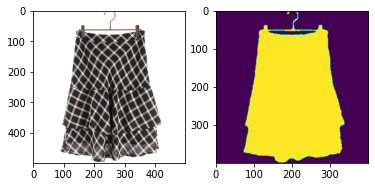

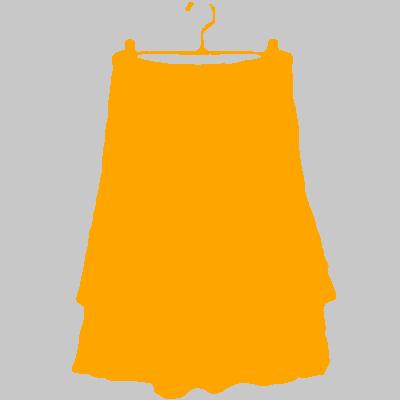

 75%|█████████████████████████████████████████████▌               | 672/900 [01:46<00:35,  6.34it/s]

torch.Size([1, 3, 400, 400])
/mnt/nas4/hm/datasets/shopping_clothes/data/data900_personby100/top/image/train_3212.jpg
{'background': 0, 'top': 1, 'skirt': 2, 'outer': 3, 'dress': 4, 'bottom': 5}
Counter({0: 113505, 1: 46495})


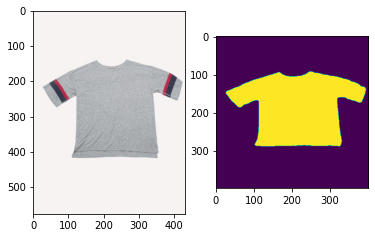

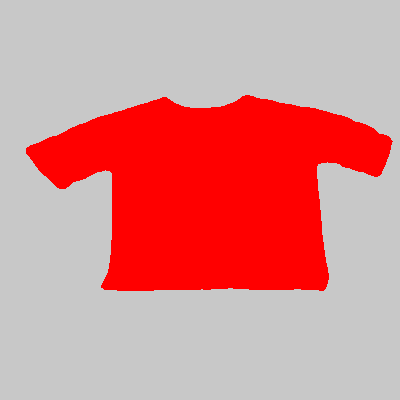

 75%|█████████████████████████████████████████████▌               | 673/900 [01:46<00:35,  6.47it/s]

torch.Size([1, 3, 400, 400])
/mnt/nas4/hm/datasets/shopping_clothes/data/data900_personby100/bottom/image/train_1576.jpg
{'background': 0, 'top': 1, 'skirt': 2, 'outer': 3, 'dress': 4, 'bottom': 5}
Counter({0: 99169, 5: 60831})


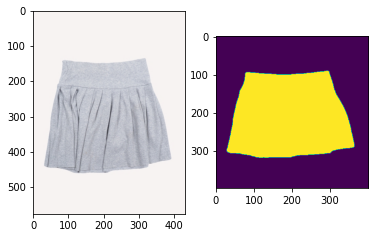

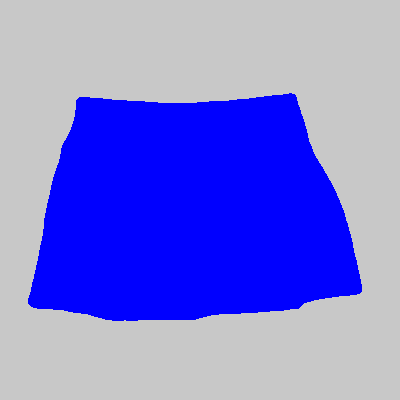

 75%|█████████████████████████████████████████████▋               | 674/900 [01:46<00:34,  6.56it/s]

torch.Size([1, 3, 400, 400])
/mnt/nas4/hm/datasets/shopping_clothes/data/data900_personby100/outer/image/train_542.jpg
{'background': 0, 'top': 1, 'skirt': 2, 'outer': 3, 'dress': 4, 'bottom': 5}
Counter({3: 81605, 0: 78395})


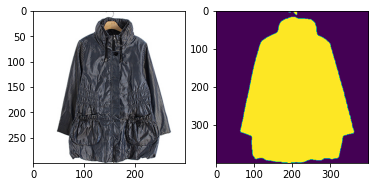

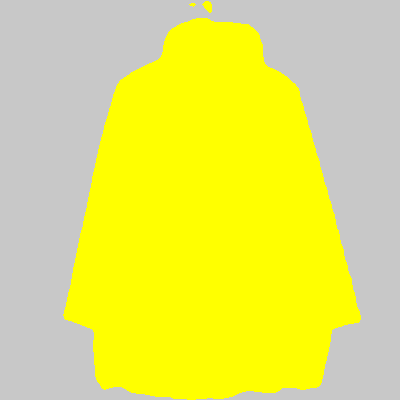

 75%|█████████████████████████████████████████████▊               | 675/900 [01:47<00:33,  6.80it/s]

torch.Size([1, 3, 400, 400])
/mnt/nas4/hm/datasets/shopping_clothes/data/data900_personby100/dress/image/train_3649.jpg
{'background': 0, 'top': 1, 'skirt': 2, 'outer': 3, 'dress': 4, 'bottom': 5}
Counter({0: 116322, 4: 43678})


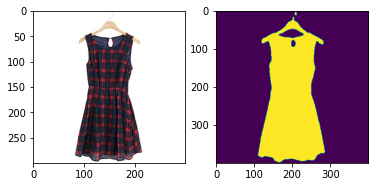

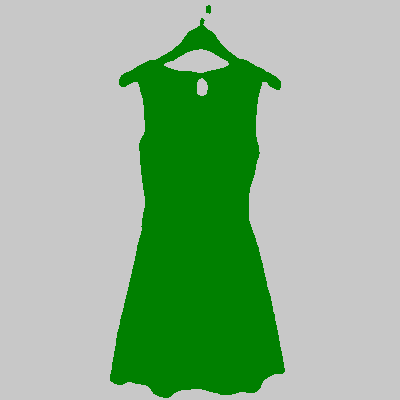

 75%|█████████████████████████████████████████████▊               | 676/900 [01:47<00:32,  6.99it/s]

torch.Size([1, 3, 400, 400])
/mnt/nas4/hm/datasets/shopping_clothes/data/data900_personby100/bottom/image/train_1924.jpg
{'background': 0, 'top': 1, 'skirt': 2, 'outer': 3, 'dress': 4, 'bottom': 5}
Counter({0: 126887, 5: 33113})


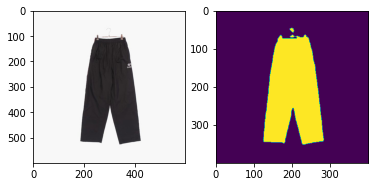

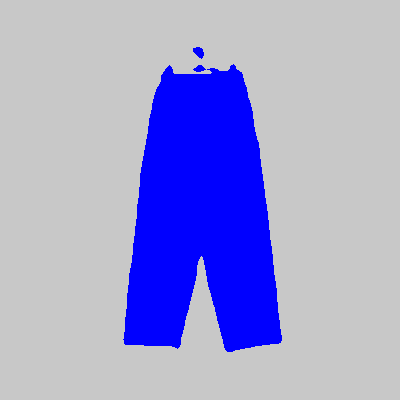

 75%|█████████████████████████████████████████████▉               | 677/900 [01:47<00:32,  6.91it/s]

torch.Size([1, 3, 400, 400])
/mnt/nas4/hm/datasets/shopping_clothes/data/data900_personby100/outer/image/train_9450.jpg
{'background': 0, 'top': 1, 'skirt': 2, 'outer': 3, 'dress': 4, 'bottom': 5}
Counter({0: 84607, 3: 75393})


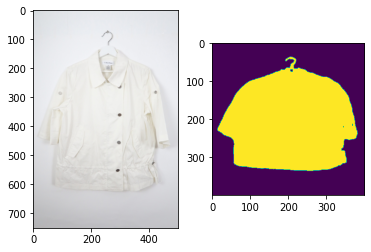

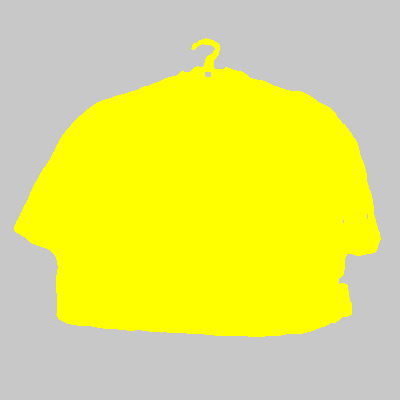

 75%|█████████████████████████████████████████████▉               | 678/900 [01:47<00:33,  6.65it/s]

torch.Size([1, 3, 400, 400])
/mnt/nas4/hm/datasets/shopping_clothes/data/data900_personby100/dress/image/train_3283.jpg
{'background': 0, 'top': 1, 'skirt': 2, 'outer': 3, 'dress': 4, 'bottom': 5}
Counter({0: 100373, 4: 59627})


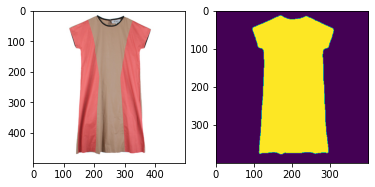

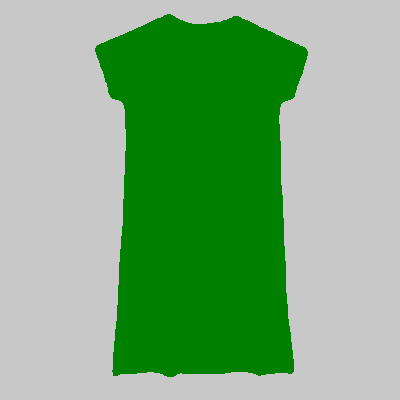

 75%|██████████████████████████████████████████████               | 679/900 [01:47<00:37,  5.97it/s]

torch.Size([1, 3, 400, 400])
/mnt/nas4/hm/datasets/shopping_clothes/data/data900_personby100/dress/image/train_1000.jpg
{'background': 0, 'top': 1, 'skirt': 2, 'outer': 3, 'dress': 4, 'bottom': 5}
Counter({0: 122256, 4: 37744})


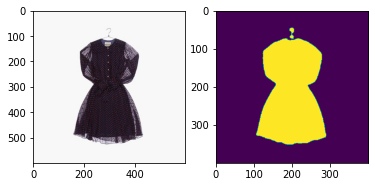

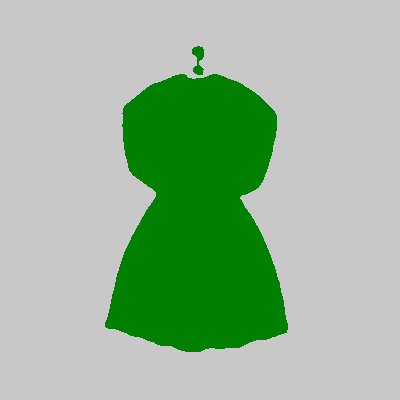

 76%|██████████████████████████████████████████████               | 680/900 [01:47<00:35,  6.16it/s]

torch.Size([1, 3, 400, 400])
/mnt/nas4/hm/datasets/shopping_clothes/data/data900_personby100/bottom/image/train_3055.jpg
{'background': 0, 'top': 1, 'skirt': 2, 'outer': 3, 'dress': 4, 'bottom': 5}
Counter({0: 100438, 5: 59562})


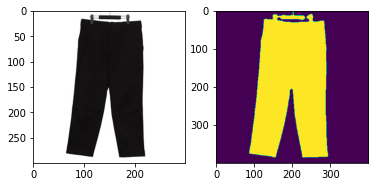

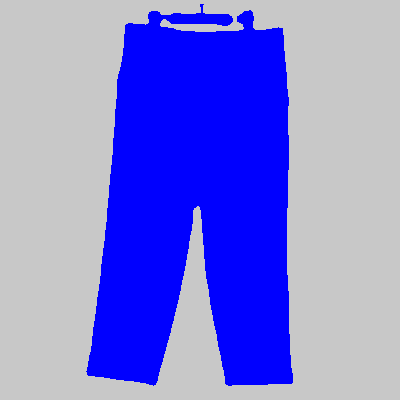

 76%|██████████████████████████████████████████████▏              | 681/900 [01:47<00:33,  6.52it/s]

torch.Size([1, 3, 400, 400])
/mnt/nas4/hm/datasets/shopping_clothes/data/data900_personby100/skirt/image/train_607.jpg
{'background': 0, 'top': 1, 'skirt': 2, 'outer': 3, 'dress': 4, 'bottom': 5}
Counter({0: 80496, 2: 79504})


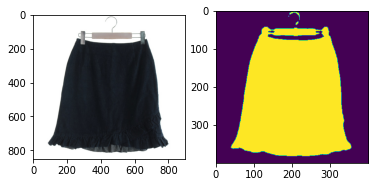

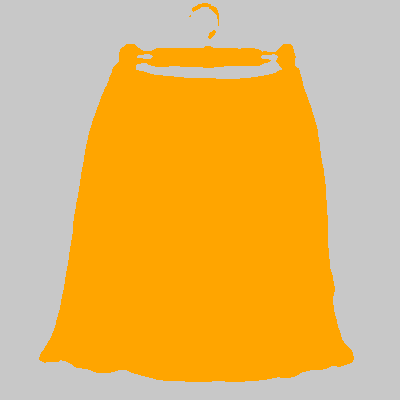

 76%|██████████████████████████████████████████████▏              | 682/900 [01:48<00:35,  6.07it/s]

torch.Size([1, 3, 400, 400])
/mnt/nas4/hm/datasets/shopping_clothes/data/data900_personby100/top/image/train_9807.jpg
{'background': 0, 'top': 1, 'skirt': 2, 'outer': 3, 'dress': 4, 'bottom': 5}
Counter({0: 85941, 1: 74059})


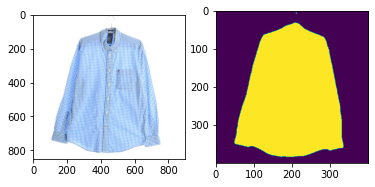

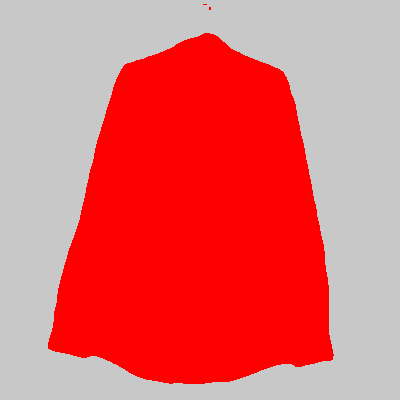

 76%|██████████████████████████████████████████████▎              | 683/900 [01:48<00:37,  5.84it/s]

torch.Size([1, 3, 400, 400])
/mnt/nas4/hm/datasets/shopping_clothes/data/data900_personby100/top/image/train_11140.jpg
{'background': 0, 'top': 1, 'skirt': 2, 'outer': 3, 'dress': 4, 'bottom': 5}
Counter({0: 105101, 1: 54899})


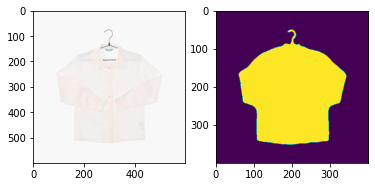

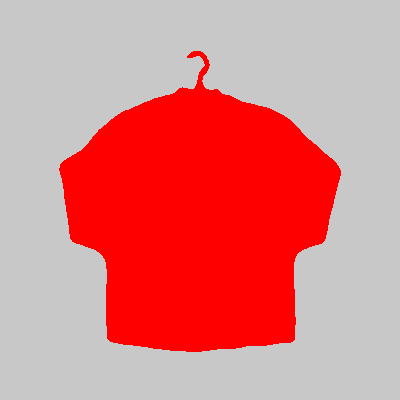

 76%|██████████████████████████████████████████████▎              | 684/900 [01:48<00:35,  6.04it/s]

torch.Size([1, 3, 400, 400])
/mnt/nas4/hm/datasets/shopping_clothes/data/data900_personby100/dress/image/train_3539.jpg
{'background': 0, 'top': 1, 'skirt': 2, 'outer': 3, 'dress': 4, 'bottom': 5}
Counter({0: 102762, 4: 57238})


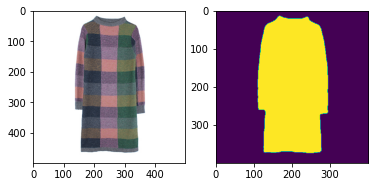

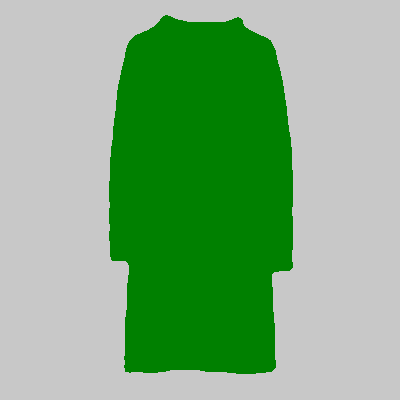

 76%|██████████████████████████████████████████████▍              | 685/900 [01:48<00:34,  6.25it/s]

torch.Size([1, 3, 400, 400])
/mnt/nas4/hm/datasets/shopping_clothes/data/data900_personby100/skirt/image/train_2834.jpg
{'background': 0, 'top': 1, 'skirt': 2, 'outer': 3, 'dress': 4, 'bottom': 5}
Counter({0: 123680, 2: 36320})


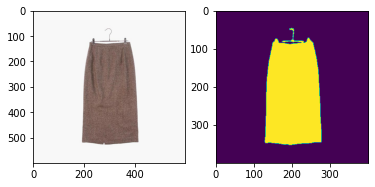

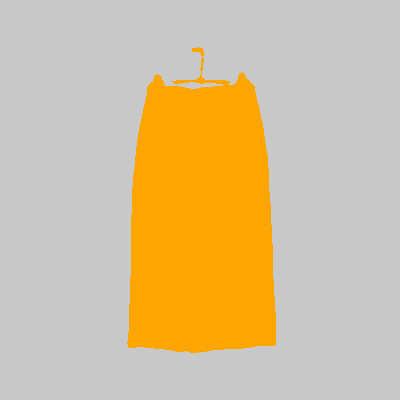

 76%|██████████████████████████████████████████████▍              | 686/900 [01:48<00:33,  6.36it/s]

torch.Size([1, 3, 400, 400])
/mnt/nas4/hm/datasets/shopping_clothes/data/data900_personby100/bottom/image/train_496.jpg
{'background': 0, 'top': 1, 'skirt': 2, 'outer': 3, 'dress': 4, 'bottom': 5}
Counter({0: 90220, 5: 69780})


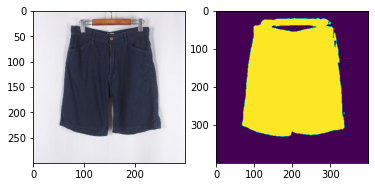

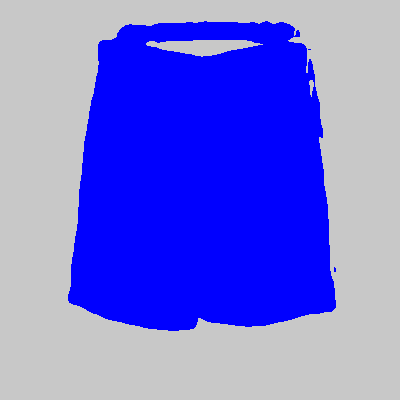

 76%|██████████████████████████████████████████████▌              | 687/900 [01:48<00:32,  6.63it/s]

torch.Size([1, 3, 400, 400])
/mnt/nas4/hm/datasets/shopping_clothes/data/data900_personby100/top/image/train_17777.jpg
{'background': 0, 'top': 1, 'skirt': 2, 'outer': 3, 'dress': 4, 'bottom': 5}
Counter({1: 80271, 0: 79729})


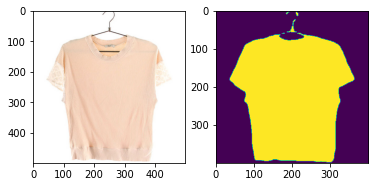

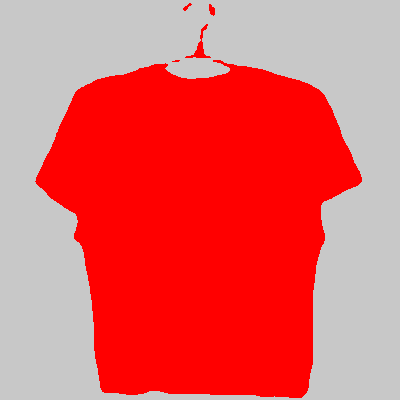

 76%|██████████████████████████████████████████████▋              | 688/900 [01:49<00:31,  6.69it/s]

torch.Size([1, 3, 400, 400])
/mnt/nas4/hm/datasets/shopping_clothes/data/data900_personby100/dress/image/train_1328.jpg
{'background': 0, 'top': 1, 'skirt': 2, 'outer': 3, 'dress': 4, 'bottom': 5}
Counter({0: 117926, 4: 42074})


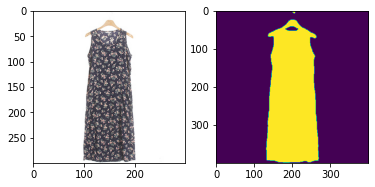

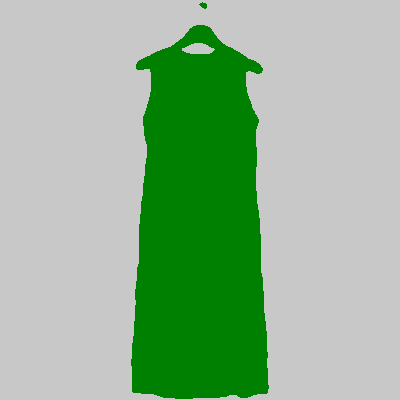

 77%|██████████████████████████████████████████████▋              | 689/900 [01:49<00:30,  6.91it/s]

torch.Size([1, 3, 400, 400])
/mnt/nas4/hm/datasets/shopping_clothes/data/data900_personby100/dress/image/train_380.jpg
{'background': 0, 'top': 1, 'skirt': 2, 'outer': 3, 'dress': 4, 'bottom': 5}
Counter({0: 110207, 4: 49793})


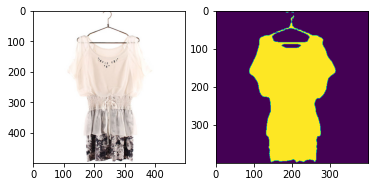

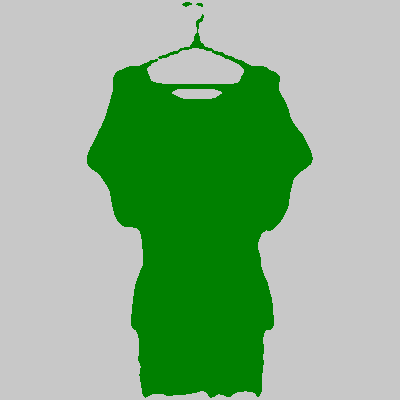

 77%|██████████████████████████████████████████████▊              | 690/900 [01:49<00:34,  6.14it/s]

torch.Size([1, 3, 400, 400])
/mnt/nas4/hm/datasets/shopping_clothes/data/data900_personby100/bottom/image/train_689.jpg
{'background': 0, 'top': 1, 'skirt': 2, 'outer': 3, 'dress': 4, 'bottom': 5}
Counter({0: 124871, 5: 35129})


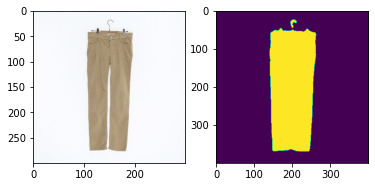

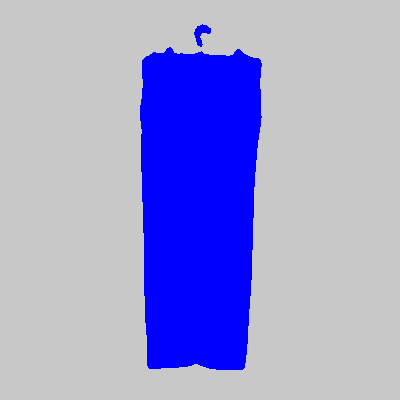

 77%|██████████████████████████████████████████████▊              | 691/900 [01:49<00:32,  6.50it/s]

torch.Size([1, 3, 400, 400])
/mnt/nas4/hm/datasets/shopping_clothes/data/data900_personby100/outer/image/train_9260.jpg
{'background': 0, 'top': 1, 'skirt': 2, 'outer': 3, 'dress': 4, 'bottom': 5}
Counter({0: 89741, 3: 70259})


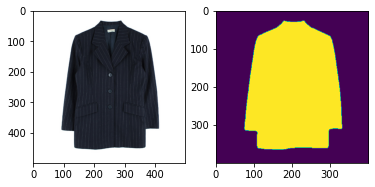

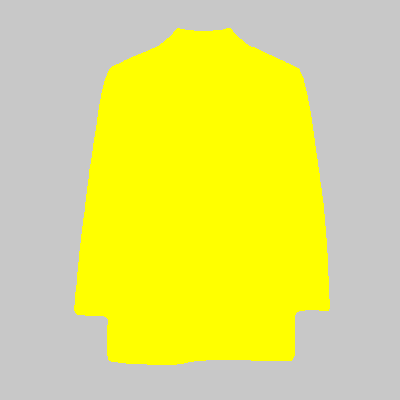

 77%|██████████████████████████████████████████████▉              | 692/900 [01:49<00:31,  6.57it/s]

torch.Size([1, 3, 400, 400])
/mnt/nas4/hm/datasets/shopping_clothes/data/data900_personby100/outer/image/train_4691.jpg
{'background': 0, 'top': 1, 'skirt': 2, 'outer': 3, 'dress': 4, 'bottom': 5}
Counter({3: 82127, 0: 77873})


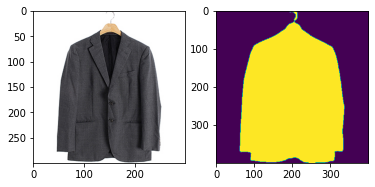

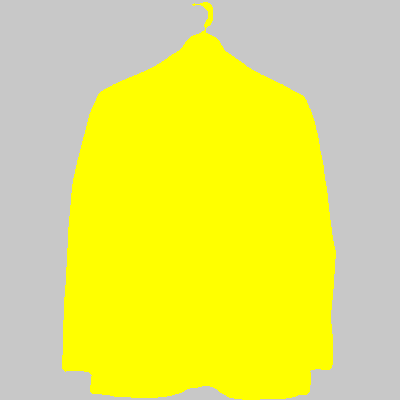

 77%|██████████████████████████████████████████████▉              | 693/900 [01:49<00:30,  6.77it/s]

torch.Size([1, 3, 400, 400])
/mnt/nas4/hm/datasets/shopping_clothes/data/data900_personby100/skirt/image/train_1666.jpg
{'background': 0, 'top': 1, 'skirt': 2, 'outer': 3, 'dress': 4, 'bottom': 5}
Counter({0: 112682, 2: 47318})


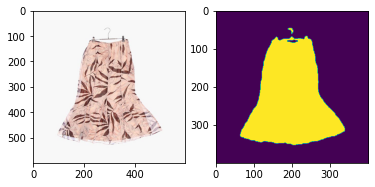

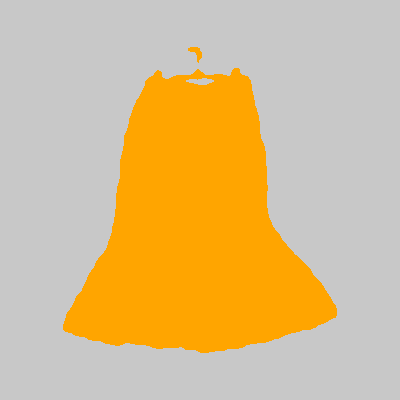

 77%|███████████████████████████████████████████████              | 694/900 [01:49<00:30,  6.68it/s]

torch.Size([1, 3, 400, 400])
/mnt/nas4/hm/datasets/shopping_clothes/data/data900_personby100/outer/image/train_5600.jpg
{'background': 0, 'top': 1, 'skirt': 2, 'outer': 3, 'dress': 4, 'bottom': 5}
Counter({3: 82198, 0: 77802})


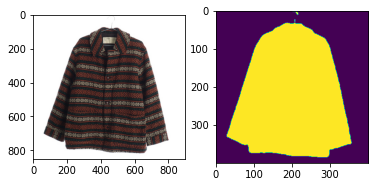

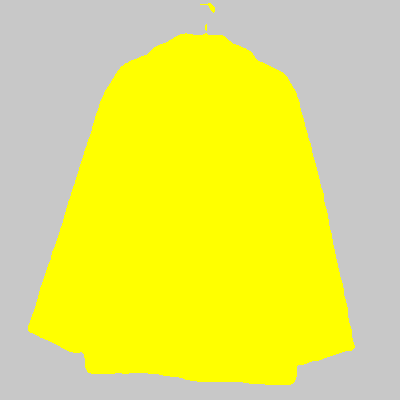

 77%|███████████████████████████████████████████████              | 695/900 [01:50<00:33,  6.05it/s]

torch.Size([1, 3, 400, 400])
/mnt/nas4/hm/datasets/shopping_clothes/data/data900_personby100/bottom/image/train_538.jpg
{'background': 0, 'top': 1, 'skirt': 2, 'outer': 3, 'dress': 4, 'bottom': 5}
Counter({0: 107258, 5: 52742})


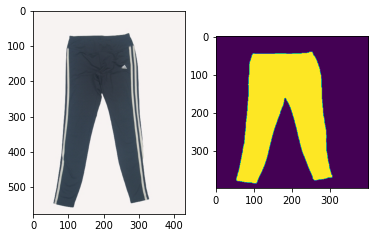

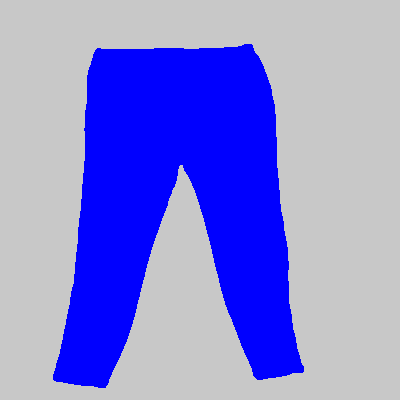

 77%|███████████████████████████████████████████████▏             | 696/900 [01:50<00:32,  6.24it/s]

torch.Size([1, 3, 400, 400])
/mnt/nas4/hm/datasets/shopping_clothes/data/data900_personby100/outer/image/train_8160.jpg
{'background': 0, 'top': 1, 'skirt': 2, 'outer': 3, 'dress': 4, 'bottom': 5}
Counter({0: 89641, 3: 70359})


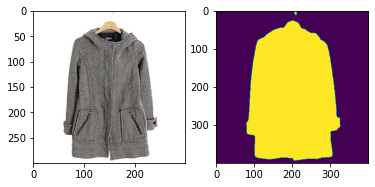

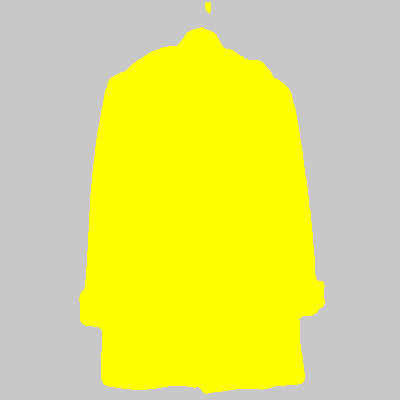

 77%|███████████████████████████████████████████████▏             | 697/900 [01:50<00:31,  6.55it/s]

torch.Size([1, 3, 400, 400])
/mnt/nas4/hm/datasets/shopping_clothes/data/data900_personby100/dress/image/train_3292.jpg
{'background': 0, 'top': 1, 'skirt': 2, 'outer': 3, 'dress': 4, 'bottom': 5}
Counter({0: 129056, 4: 30944})


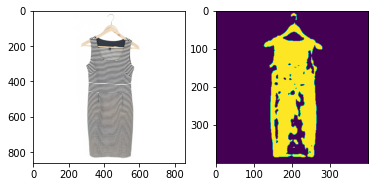

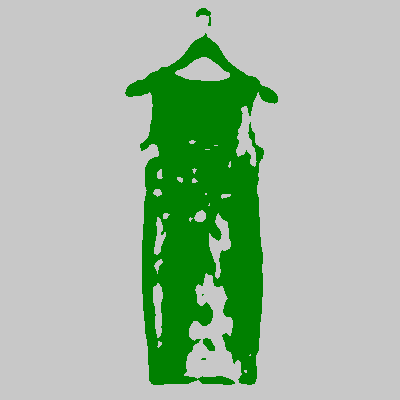

 78%|███████████████████████████████████████████████▎             | 698/900 [01:50<00:32,  6.19it/s]

torch.Size([1, 3, 400, 400])
/mnt/nas4/hm/datasets/shopping_clothes/data/data900_personby100/top/image/train_5209.jpg
{'background': 0, 'top': 1, 'skirt': 2, 'outer': 3, 'dress': 4, 'bottom': 5}
Counter({0: 93959, 1: 66041})


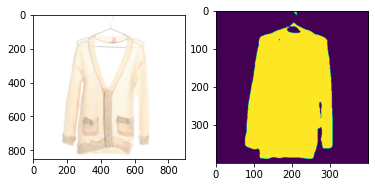

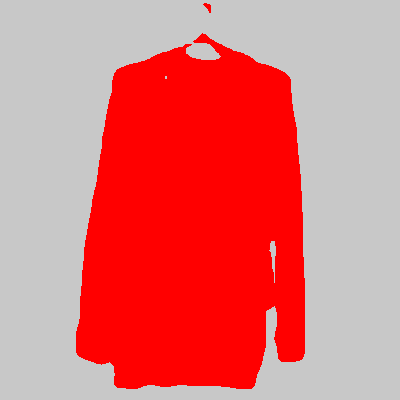

 78%|███████████████████████████████████████████████▍             | 699/900 [01:50<00:34,  5.91it/s]

torch.Size([1, 3, 400, 400])
/mnt/nas4/hm/datasets/shopping_clothes/data/data900_personby100/bottom/image/train_173.jpg
{'background': 0, 'top': 1, 'skirt': 2, 'outer': 3, 'dress': 4, 'bottom': 5}
Counter({0: 107392, 5: 52608})


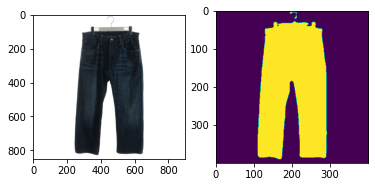

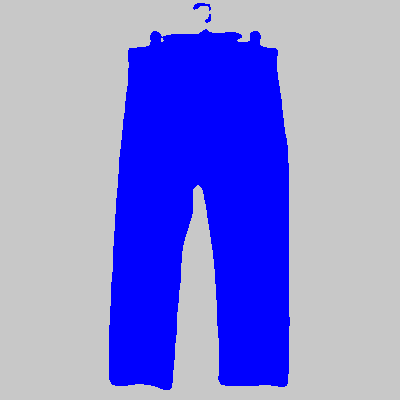

 78%|███████████████████████████████████████████████▍             | 700/900 [01:51<00:34,  5.74it/s]

torch.Size([1, 3, 400, 400])
/mnt/nas4/hm/datasets/shopping_clothes/data/data900_personby100/outer/image/train_7435.jpg
{'background': 0, 'top': 1, 'skirt': 2, 'outer': 3, 'dress': 4, 'bottom': 5}
Counter({3: 86426, 0: 73574})


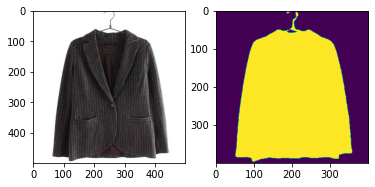

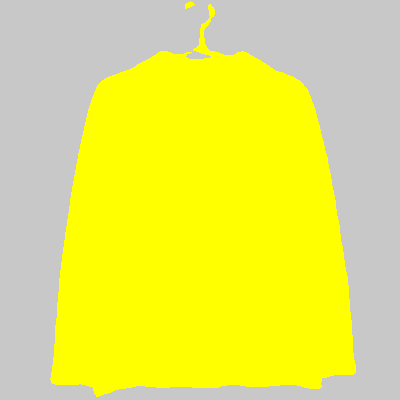

 78%|███████████████████████████████████████████████▌             | 701/900 [01:51<00:36,  5.40it/s]

torch.Size([1, 3, 400, 400])
/mnt/nas4/hm/datasets/shopping_clothes/data/data900_personby100/skirt/image/train_2781.jpg
{'background': 0, 'top': 1, 'skirt': 2, 'outer': 3, 'dress': 4, 'bottom': 5}
Counter({0: 88875, 2: 71125})


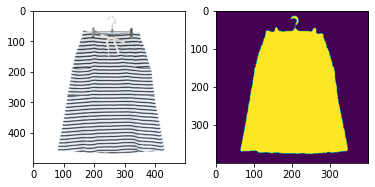

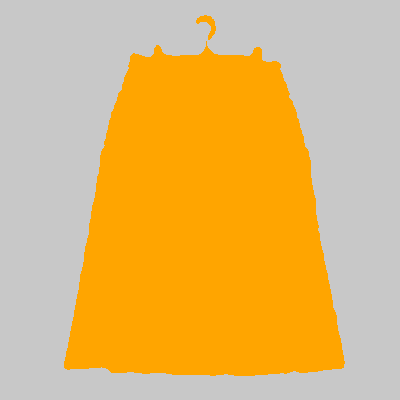

 78%|███████████████████████████████████████████████▌             | 702/900 [01:51<00:34,  5.75it/s]

torch.Size([1, 3, 400, 400])
/mnt/nas4/hm/datasets/shopping_clothes/data/data900_personby100/top/image/train_15890.jpg
{'background': 0, 'top': 1, 'skirt': 2, 'outer': 3, 'dress': 4, 'bottom': 5}
Counter({0: 96891, 1: 63109})


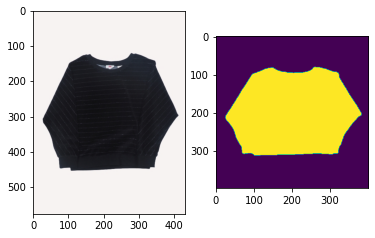

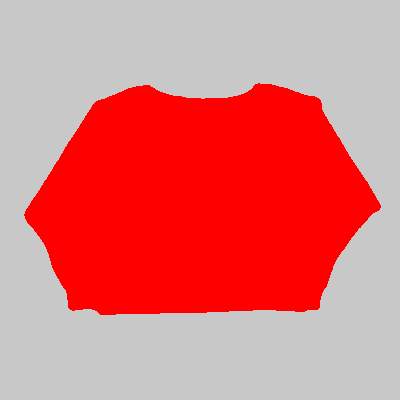

 78%|███████████████████████████████████████████████▋             | 703/900 [01:51<00:32,  6.00it/s]

torch.Size([1, 3, 400, 400])
/mnt/nas4/hm/datasets/shopping_clothes/data/data900_personby100/dress/image/train_3030.jpg
{'background': 0, 'top': 1, 'skirt': 2, 'outer': 3, 'dress': 4, 'bottom': 5}
Counter({0: 114623, 4: 45377})


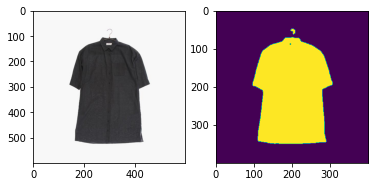

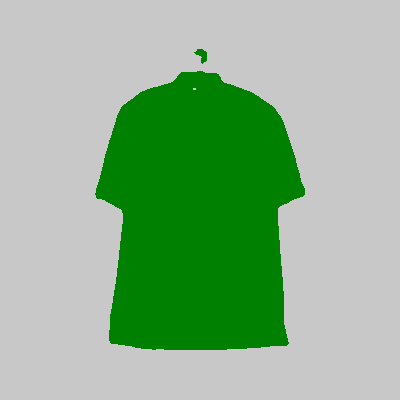

 78%|███████████████████████████████████████████████▋             | 704/900 [01:51<00:31,  6.17it/s]

torch.Size([1, 3, 400, 400])
/mnt/nas4/hm/datasets/shopping_clothes/data/data900_personby100/dress/image/train_2317.jpg
{'background': 0, 'top': 1, 'skirt': 2, 'outer': 3, 'dress': 4, 'bottom': 5}
Counter({0: 136404, 4: 23596})


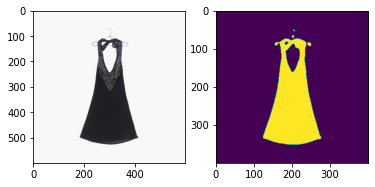

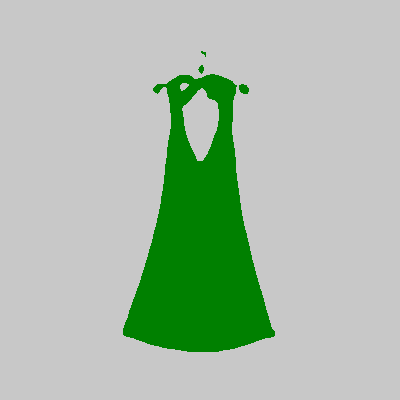

 78%|███████████████████████████████████████████████▊             | 705/900 [01:51<00:30,  6.30it/s]

torch.Size([1, 3, 400, 400])
/mnt/nas4/hm/datasets/shopping_clothes/data/data900_personby100/top/image/train_17174.jpg
{'background': 0, 'top': 1, 'skirt': 2, 'outer': 3, 'dress': 4, 'bottom': 5}
Counter({1: 93870, 0: 66130})


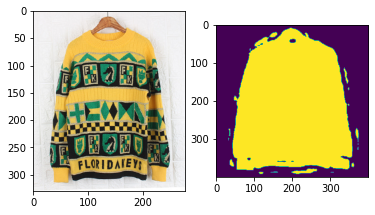

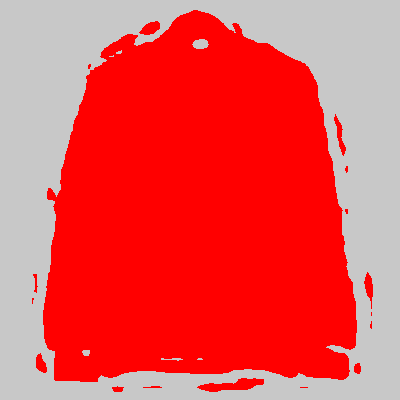

 78%|███████████████████████████████████████████████▊             | 706/900 [01:51<00:29,  6.48it/s]

torch.Size([1, 3, 400, 400])
/mnt/nas4/hm/datasets/shopping_clothes/data/data900_personby100/bottom/image/train_358.jpg
{'background': 0, 'top': 1, 'skirt': 2, 'outer': 3, 'dress': 4, 'bottom': 5}
Counter({0: 128149, 5: 30610, 2: 1007, 4: 234})


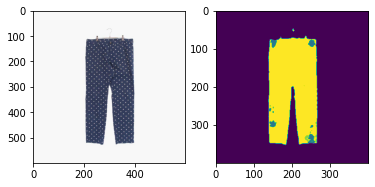

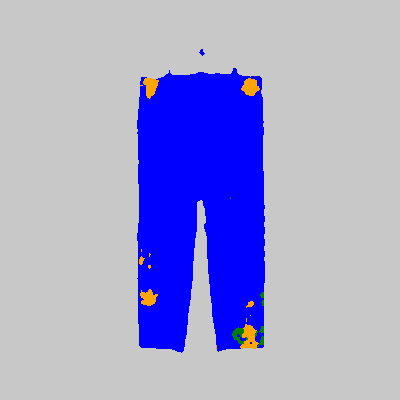

 79%|███████████████████████████████████████████████▉             | 707/900 [01:52<00:29,  6.54it/s]

torch.Size([1, 3, 400, 400])
/mnt/nas4/hm/datasets/shopping_clothes/data/data900_personby100/dress/image/train_924.jpg
{'background': 0, 'top': 1, 'skirt': 2, 'outer': 3, 'dress': 4, 'bottom': 5}
Counter({0: 122169, 4: 37831})


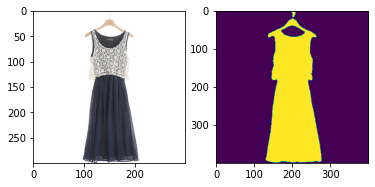

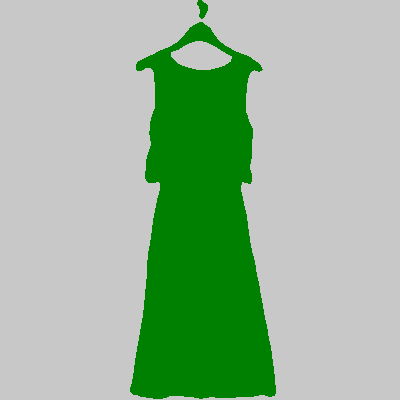

 79%|███████████████████████████████████████████████▉             | 708/900 [01:52<00:28,  6.81it/s]

torch.Size([1, 3, 400, 400])
/mnt/nas4/hm/datasets/shopping_clothes/data/data900_personby100/top/image/train_3652.jpg
{'background': 0, 'top': 1, 'skirt': 2, 'outer': 3, 'dress': 4, 'bottom': 5}
Counter({0: 99042, 1: 60958})


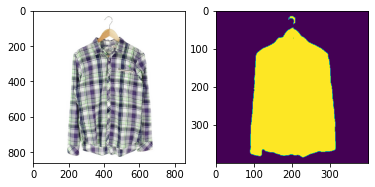

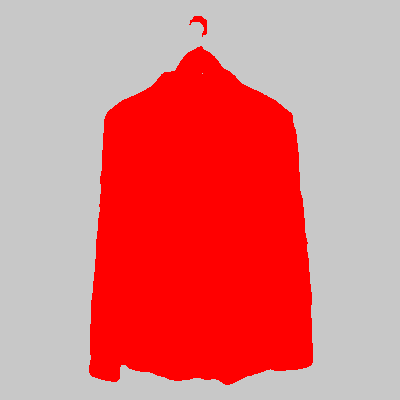

 79%|████████████████████████████████████████████████             | 709/900 [01:52<00:30,  6.36it/s]

torch.Size([1, 3, 400, 400])
/mnt/nas4/hm/datasets/shopping_clothes/data/data900_personby100/dress/image/train_2095.jpg
{'background': 0, 'top': 1, 'skirt': 2, 'outer': 3, 'dress': 4, 'bottom': 5}
Counter({0: 114426, 4: 45574})


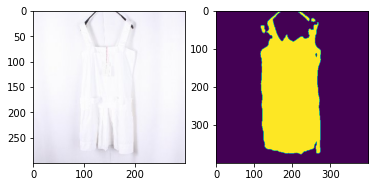

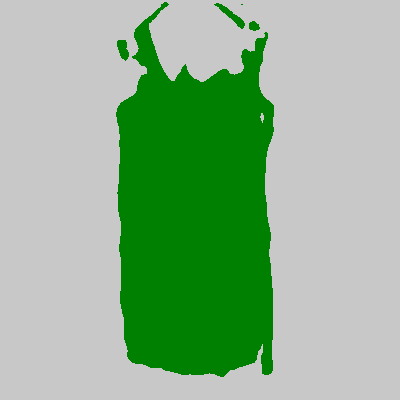

 79%|████████████████████████████████████████████████             | 710/900 [01:52<00:28,  6.66it/s]

torch.Size([1, 3, 400, 400])
/mnt/nas4/hm/datasets/shopping_clothes/data/data900_personby100/bottom/image/train_1426.jpg
{'background': 0, 'top': 1, 'skirt': 2, 'outer': 3, 'dress': 4, 'bottom': 5}
Counter({0: 127268, 5: 32732})


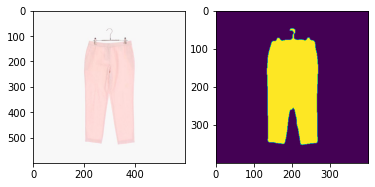

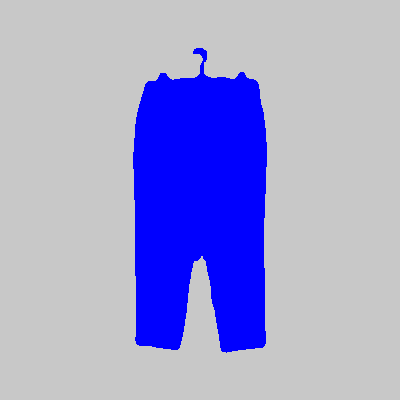

 79%|████████████████████████████████████████████████▏            | 711/900 [01:52<00:28,  6.66it/s]

torch.Size([1, 3, 400, 400])
/mnt/nas4/hm/datasets/shopping_clothes/data/data900_personby100/outer/image/train_940.jpg
{'background': 0, 'top': 1, 'skirt': 2, 'outer': 3, 'dress': 4, 'bottom': 5}
Counter({3: 84336, 0: 75664})


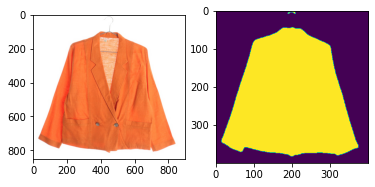

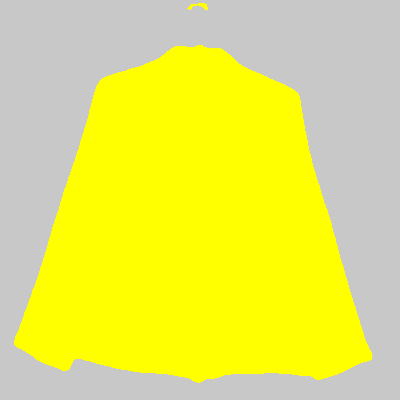

 79%|████████████████████████████████████████████████▎            | 712/900 [01:52<00:34,  5.51it/s]

torch.Size([1, 3, 400, 400])
/mnt/nas4/hm/datasets/shopping_clothes/data/data900_personby100/bottom/image/train_2737.jpg
{'background': 0, 'top': 1, 'skirt': 2, 'outer': 3, 'dress': 4, 'bottom': 5}
Counter({0: 98919, 5: 61081})


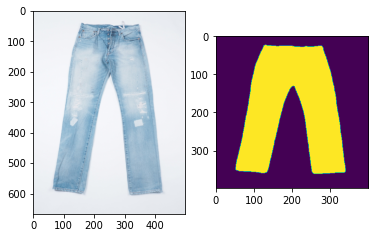

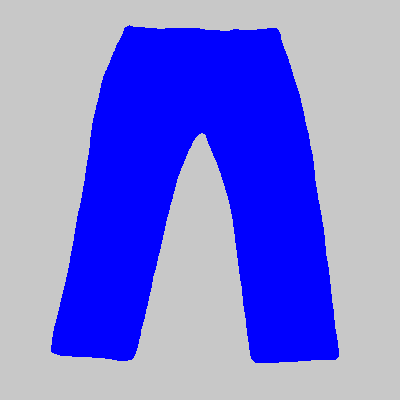

 79%|████████████████████████████████████████████████▎            | 713/900 [01:53<00:33,  5.63it/s]

torch.Size([1, 3, 400, 400])
/mnt/nas4/hm/datasets/shopping_clothes/data/data900_personby100/dress/image/train_2168.jpg
{'background': 0, 'top': 1, 'skirt': 2, 'outer': 3, 'dress': 4, 'bottom': 5}
Counter({0: 124762, 4: 35238})


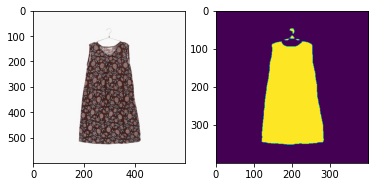

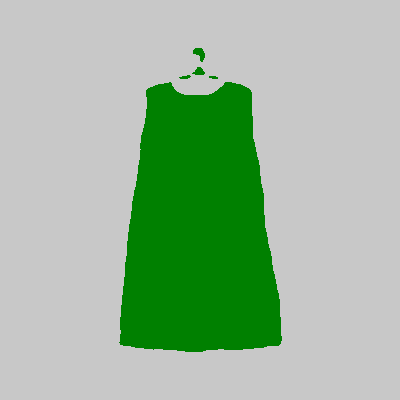

 79%|████████████████████████████████████████████████▍            | 714/900 [01:53<00:31,  5.90it/s]

torch.Size([1, 3, 400, 400])
/mnt/nas4/hm/datasets/shopping_clothes/data/data900_personby100/skirt/image/train_1816.jpg
{'background': 0, 'top': 1, 'skirt': 2, 'outer': 3, 'dress': 4, 'bottom': 5}
Counter({2: 90010, 0: 69990})


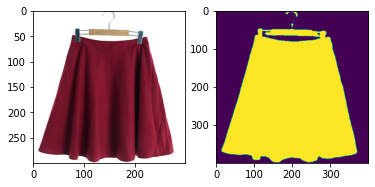

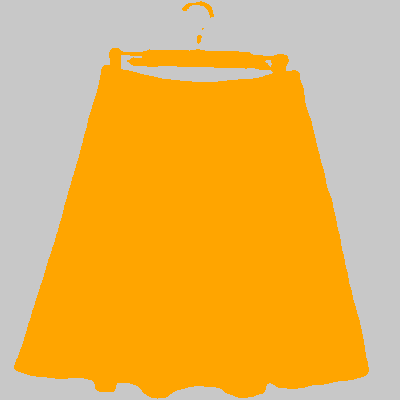

 79%|████████████████████████████████████████████████▍            | 715/900 [01:53<00:29,  6.24it/s]

torch.Size([1, 3, 400, 400])
/mnt/nas4/hm/datasets/shopping_clothes/data/data900_personby100/dress/image/train_3706.jpg
{'background': 0, 'top': 1, 'skirt': 2, 'outer': 3, 'dress': 4, 'bottom': 5}
Counter({0: 126120, 4: 33880})


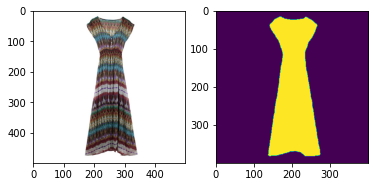

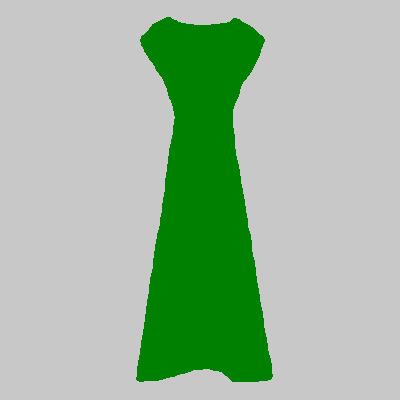

 80%|████████████████████████████████████████████████▌            | 716/900 [01:53<00:28,  6.42it/s]

torch.Size([1, 3, 400, 400])
/mnt/nas4/hm/datasets/shopping_clothes/data/data900_personby100/bottom/image/train_3150.jpg
{'background': 0, 'top': 1, 'skirt': 2, 'outer': 3, 'dress': 4, 'bottom': 5}
Counter({0: 113732, 5: 46268})


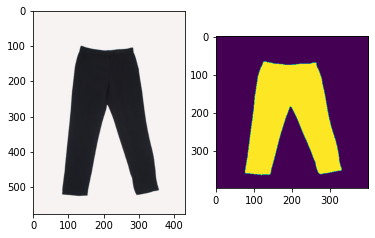

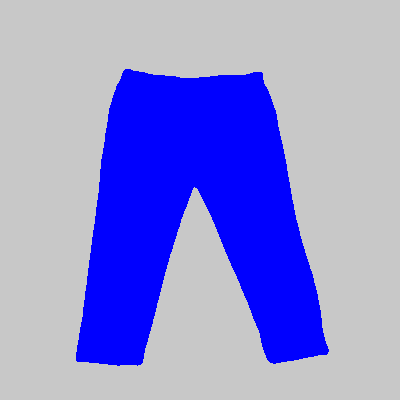

 80%|████████████████████████████████████████████████▌            | 717/900 [01:53<00:28,  6.52it/s]

torch.Size([1, 3, 400, 400])
/mnt/nas4/hm/datasets/shopping_clothes/data/data900_personby100/bottom/image/train_3307.jpg
{'background': 0, 'top': 1, 'skirt': 2, 'outer': 3, 'dress': 4, 'bottom': 5}
Counter({0: 116166, 5: 43834})


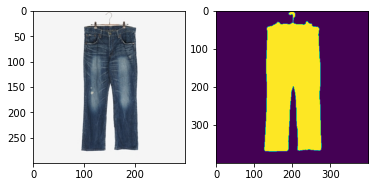

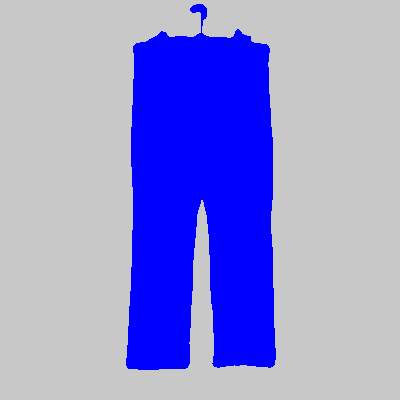

 80%|████████████████████████████████████████████████▋            | 718/900 [01:53<00:26,  6.79it/s]

torch.Size([1, 3, 400, 400])
/mnt/nas4/hm/datasets/shopping_clothes/data/data900_personby100/outer/image/train_5817.jpg
{'background': 0, 'top': 1, 'skirt': 2, 'outer': 3, 'dress': 4, 'bottom': 5}
Counter({3: 93238, 0: 66762})


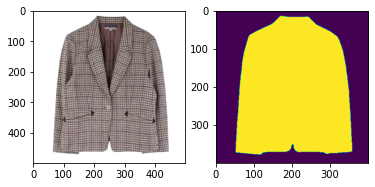

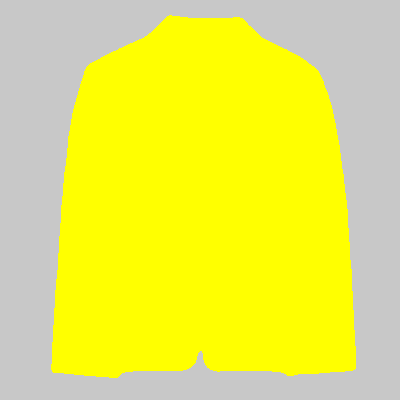

 80%|████████████████████████████████████████████████▋            | 719/900 [01:54<00:26,  6.73it/s]

torch.Size([1, 3, 400, 400])
/mnt/nas4/hm/datasets/shopping_clothes/data/data900_personby100/skirt/image/train_1610.jpg
{'background': 0, 'top': 1, 'skirt': 2, 'outer': 3, 'dress': 4, 'bottom': 5}
Counter({0: 95065, 2: 64935})


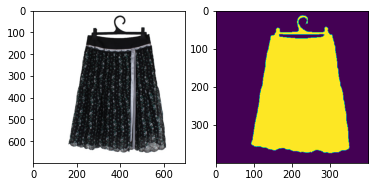

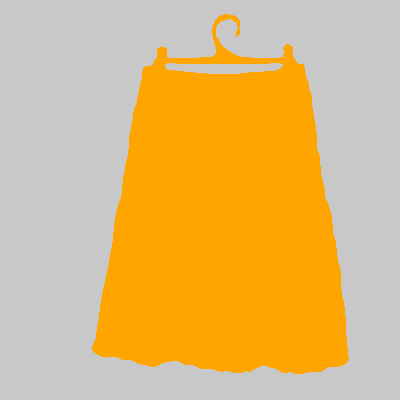

 80%|████████████████████████████████████████████████▊            | 720/900 [01:54<00:27,  6.47it/s]

torch.Size([1, 3, 400, 400])
/mnt/nas4/hm/datasets/shopping_clothes/data/data900_personby100/top/image/train_14063.jpg
{'background': 0, 'top': 1, 'skirt': 2, 'outer': 3, 'dress': 4, 'bottom': 5}
Counter({1: 91713, 0: 68287})


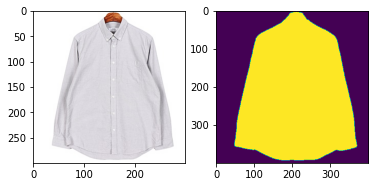

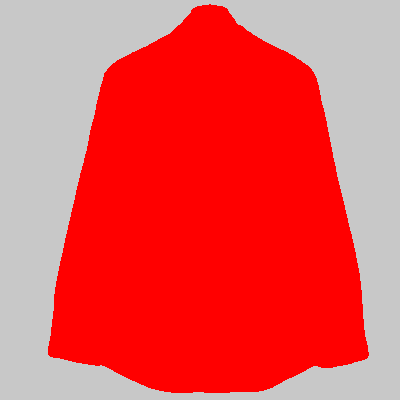

 80%|████████████████████████████████████████████████▊            | 721/900 [01:54<00:26,  6.74it/s]

torch.Size([1, 3, 400, 400])
/mnt/nas4/hm/datasets/shopping_clothes/data/data900_personby100/top/image/train_15849.jpg
{'background': 0, 'top': 1, 'skirt': 2, 'outer': 3, 'dress': 4, 'bottom': 5}
Counter({0: 90917, 1: 69083})


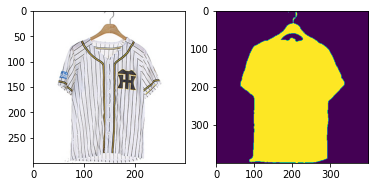

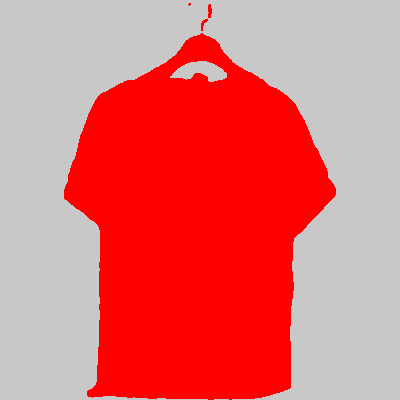

 80%|████████████████████████████████████████████████▉            | 722/900 [01:54<00:25,  6.93it/s]

torch.Size([1, 3, 400, 400])
/mnt/nas4/hm/datasets/shopping_clothes/data/data900_personby100/dress/image/train_1068.jpg
{'background': 0, 'top': 1, 'skirt': 2, 'outer': 3, 'dress': 4, 'bottom': 5}
Counter({0: 93981, 4: 66019})


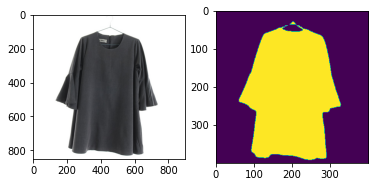

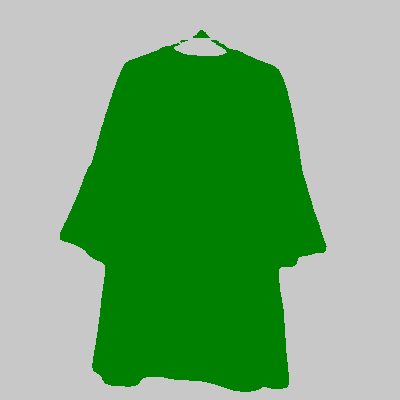

 80%|█████████████████████████████████████████████████            | 723/900 [01:54<00:30,  5.71it/s]

torch.Size([1, 3, 400, 400])
/mnt/nas4/hm/datasets/shopping_clothes/data/data900_personby100/skirt/image/train_1817.jpg
{'background': 0, 'top': 1, 'skirt': 2, 'outer': 3, 'dress': 4, 'bottom': 5}
Counter({2: 80984, 0: 79016})


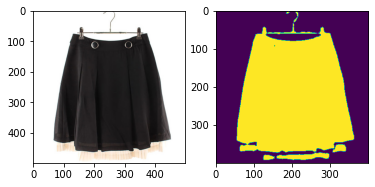

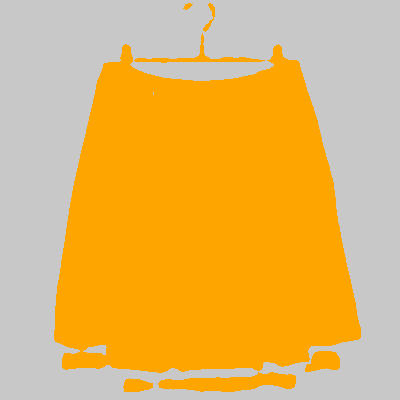

 80%|█████████████████████████████████████████████████            | 724/900 [01:54<00:29,  6.01it/s]

torch.Size([1, 3, 400, 400])
/mnt/nas4/hm/datasets/shopping_clothes/data/data900_personby100/dress/image/train_1030.jpg
{'background': 0, 'top': 1, 'skirt': 2, 'outer': 3, 'dress': 4, 'bottom': 5}
Counter({0: 124724, 4: 35276})


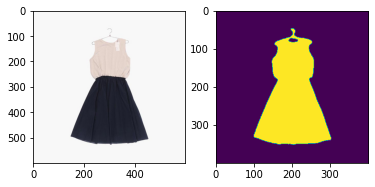

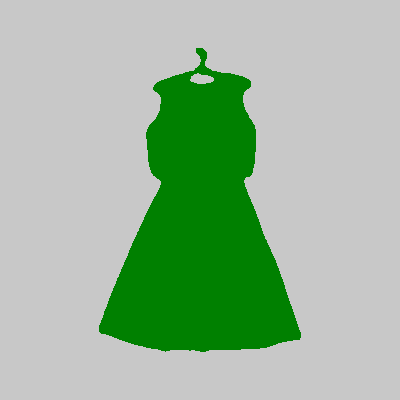

 81%|█████████████████████████████████████████████████▏           | 725/900 [01:54<00:28,  6.16it/s]

torch.Size([1, 3, 400, 400])
/mnt/nas4/hm/datasets/shopping_clothes/data/data900_personby100/bottom/image/train_3597.jpg
{'background': 0, 'top': 1, 'skirt': 2, 'outer': 3, 'dress': 4, 'bottom': 5}
Counter({0: 115677, 5: 44323})


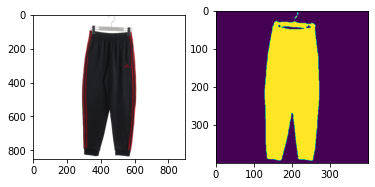

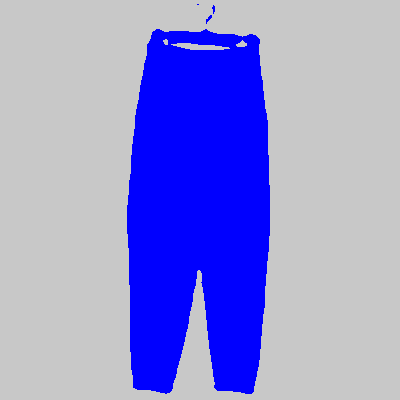

 81%|█████████████████████████████████████████████████▏           | 726/900 [01:55<00:29,  5.92it/s]

torch.Size([1, 3, 400, 400])
/mnt/nas4/hm/datasets/shopping_clothes/data/data900_personby100/top/image/train_15177.jpg
{'background': 0, 'top': 1, 'skirt': 2, 'outer': 3, 'dress': 4, 'bottom': 5}
Counter({0: 95233, 1: 64767})


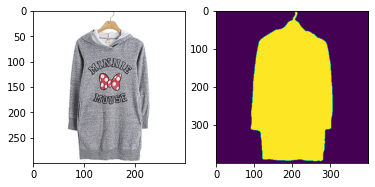

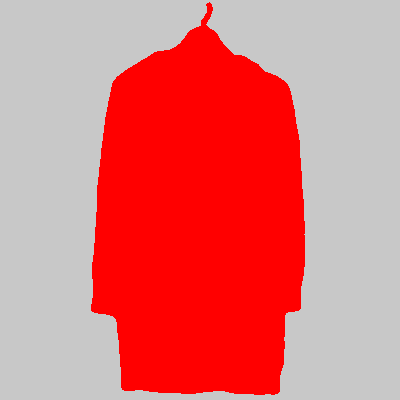

 81%|█████████████████████████████████████████████████▎           | 727/900 [01:55<00:27,  6.28it/s]

torch.Size([1, 3, 400, 400])
/mnt/nas4/hm/datasets/shopping_clothes/data/data900_personby100/dress/image/train_514.jpg
{'background': 0, 'top': 1, 'skirt': 2, 'outer': 3, 'dress': 4, 'bottom': 5}
Counter({0: 122925, 4: 37075})


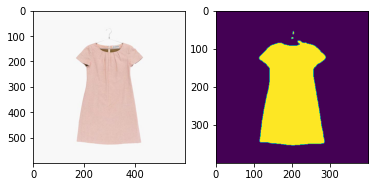

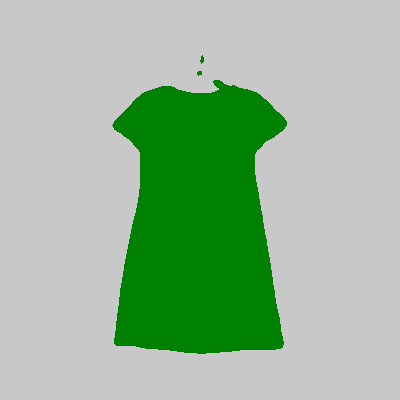

 81%|█████████████████████████████████████████████████▎           | 728/900 [01:55<00:26,  6.40it/s]

torch.Size([1, 3, 400, 400])
/mnt/nas4/hm/datasets/shopping_clothes/data/data900_personby100/bottom/image/train_2129.jpg
{'background': 0, 'top': 1, 'skirt': 2, 'outer': 3, 'dress': 4, 'bottom': 5}
Counter({0: 84943, 5: 75057})


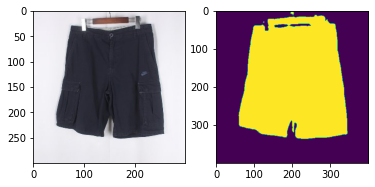

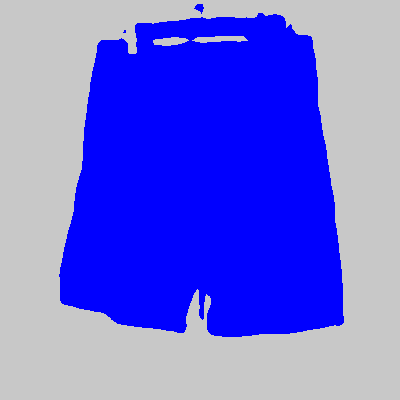

 81%|█████████████████████████████████████████████████▍           | 729/900 [01:55<00:25,  6.69it/s]

torch.Size([1, 3, 400, 400])
/mnt/nas4/hm/datasets/shopping_clothes/data/data900_personby100/top/image/train_13307.jpg
{'background': 0, 'top': 1, 'skirt': 2, 'outer': 3, 'dress': 4, 'bottom': 5}
Counter({1: 81199, 0: 78801})


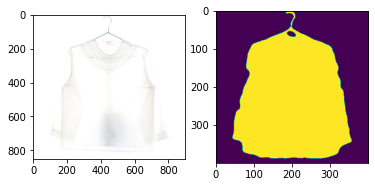

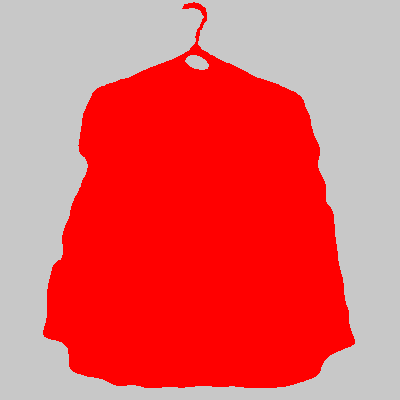

 81%|█████████████████████████████████████████████████▍           | 730/900 [01:55<00:27,  6.26it/s]

torch.Size([1, 3, 400, 400])
/mnt/nas4/hm/datasets/shopping_clothes/data/data900_personby100/bottom/image/train_2705.jpg
{'background': 0, 'top': 1, 'skirt': 2, 'outer': 3, 'dress': 4, 'bottom': 5}
Counter({0: 123801, 5: 36199})


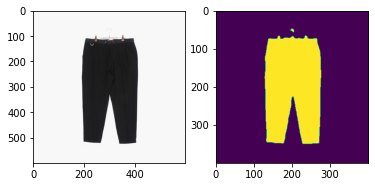

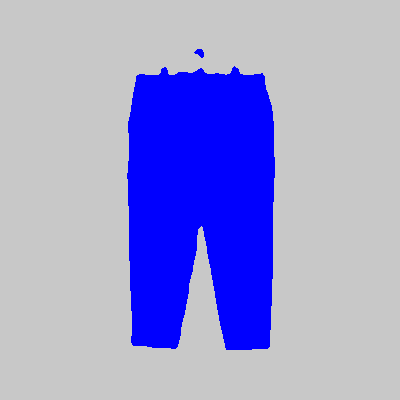

 81%|█████████████████████████████████████████████████▌           | 731/900 [01:55<00:26,  6.35it/s]

torch.Size([1, 3, 400, 400])
/mnt/nas4/hm/datasets/shopping_clothes/data/data900_personby100/outer/image/train_721.jpg
{'background': 0, 'top': 1, 'skirt': 2, 'outer': 3, 'dress': 4, 'bottom': 5}
Counter({3: 81969, 0: 78031})


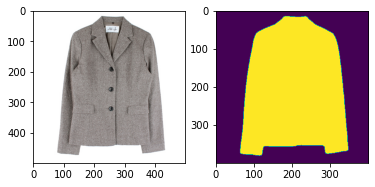

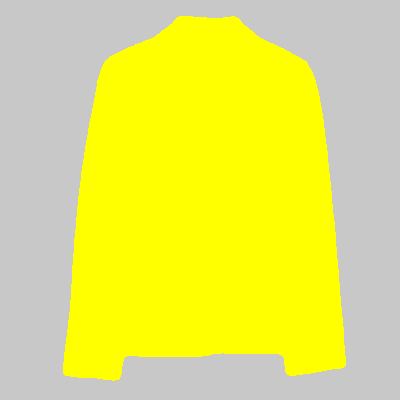

 81%|█████████████████████████████████████████████████▌           | 732/900 [01:56<00:26,  6.42it/s]

torch.Size([1, 3, 400, 400])
/mnt/nas4/hm/datasets/shopping_clothes/data/data900_personby100/bottom/image/train_2922.jpg
{'background': 0, 'top': 1, 'skirt': 2, 'outer': 3, 'dress': 4, 'bottom': 5}
Counter({0: 113400, 5: 46600})


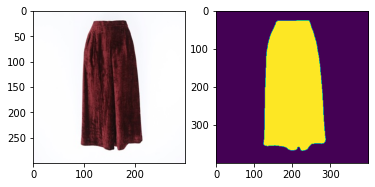

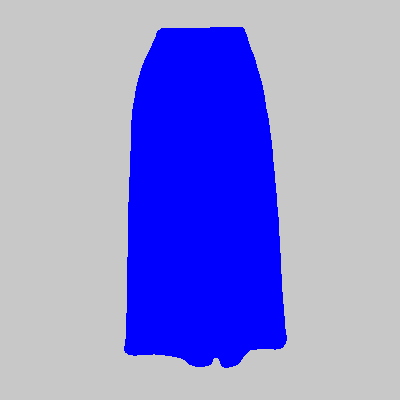

 81%|█████████████████████████████████████████████████▋           | 733/900 [01:56<00:25,  6.68it/s]

torch.Size([1, 3, 400, 400])
/mnt/nas4/hm/datasets/shopping_clothes/data/data900_personby100/dress/image/train_3598.jpg
{'background': 0, 'top': 1, 'skirt': 2, 'outer': 3, 'dress': 4, 'bottom': 5}
Counter({0: 118405, 4: 41595})


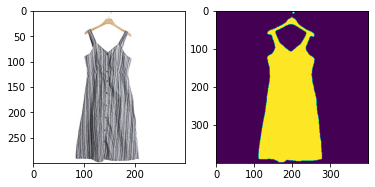

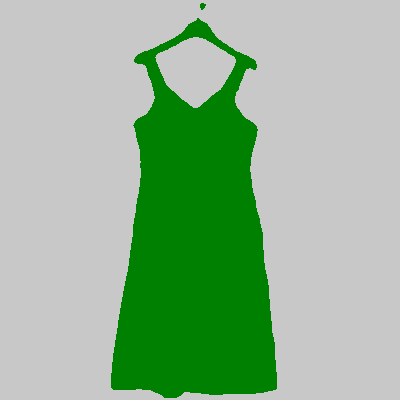

 82%|█████████████████████████████████████████████████▋           | 734/900 [01:56<00:26,  6.17it/s]

torch.Size([1, 3, 400, 400])
/mnt/nas4/hm/datasets/shopping_clothes/data/data900_personby100/skirt/image/train_2477.jpg
{'background': 0, 'top': 1, 'skirt': 2, 'outer': 3, 'dress': 4, 'bottom': 5}
Counter({0: 87235, 2: 72765})


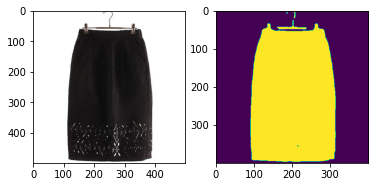

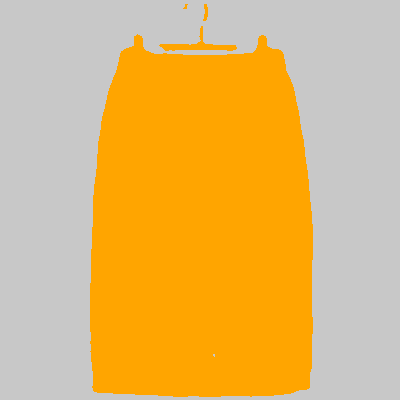

 82%|█████████████████████████████████████████████████▊           | 735/900 [01:56<00:25,  6.38it/s]

torch.Size([1, 3, 400, 400])
/mnt/nas4/hm/datasets/shopping_clothes/data/data900_personby100/bottom/image/train_3234.jpg
{'background': 0, 'top': 1, 'skirt': 2, 'outer': 3, 'dress': 4, 'bottom': 5}
Counter({0: 91410, 5: 68590})


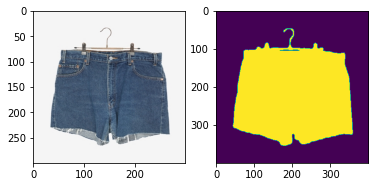

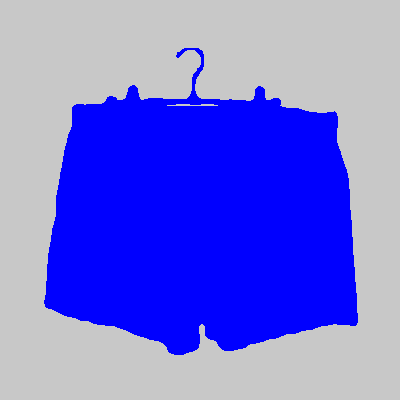

 82%|█████████████████████████████████████████████████▉           | 736/900 [01:56<00:24,  6.68it/s]

torch.Size([1, 3, 400, 400])
/mnt/nas4/hm/datasets/shopping_clothes/data/data900_personby100/dress/image/train_3584.jpg
{'background': 0, 'top': 1, 'skirt': 2, 'outer': 3, 'dress': 4, 'bottom': 5}
Counter({0: 112495, 4: 47505})


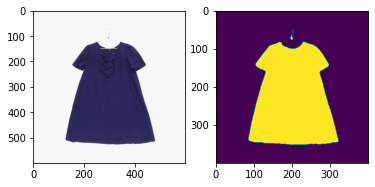

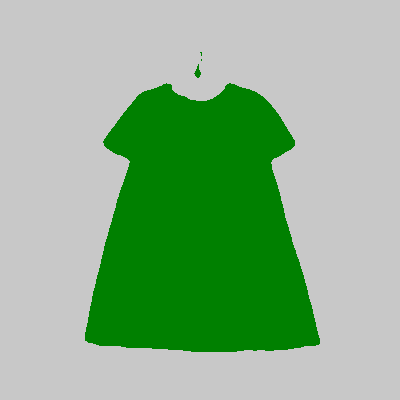

 82%|█████████████████████████████████████████████████▉           | 737/900 [01:56<00:24,  6.67it/s]

torch.Size([1, 3, 400, 400])
/mnt/nas4/hm/datasets/shopping_clothes/data/data900_personby100/top/image/train_13310.jpg
{'background': 0, 'top': 1, 'skirt': 2, 'outer': 3, 'dress': 4, 'bottom': 5}
Counter({1: 91307, 0: 68693})


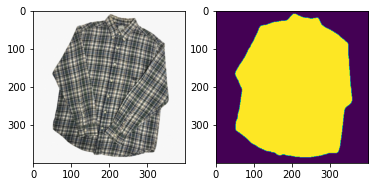

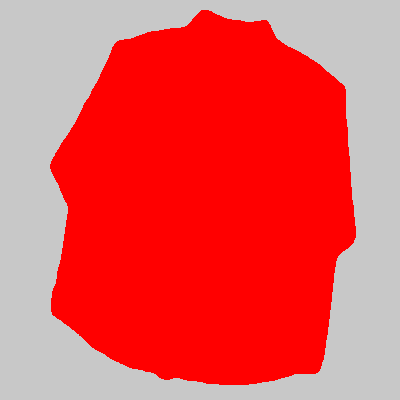

 82%|██████████████████████████████████████████████████           | 738/900 [01:56<00:23,  6.83it/s]

torch.Size([1, 3, 400, 400])
/mnt/nas4/hm/datasets/shopping_clothes/data/data900_personby100/skirt/image/train_1053.jpg
{'background': 0, 'top': 1, 'skirt': 2, 'outer': 3, 'dress': 4, 'bottom': 5}
Counter({2: 89597, 0: 70403})


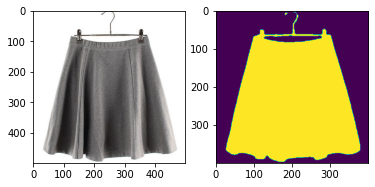

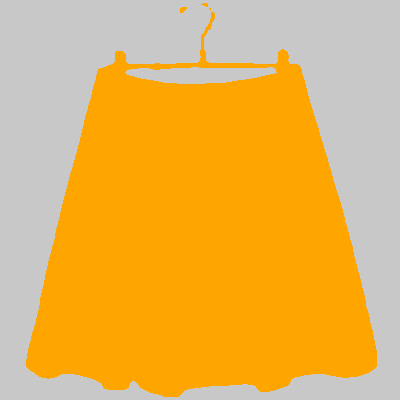

 82%|██████████████████████████████████████████████████           | 739/900 [01:57<00:23,  6.84it/s]

torch.Size([1, 3, 400, 400])
/mnt/nas4/hm/datasets/shopping_clothes/data/data900_personby100/skirt/image/train_677.jpg
{'background': 0, 'top': 1, 'skirt': 2, 'outer': 3, 'dress': 4, 'bottom': 5}
Counter({0: 92386, 2: 67614})


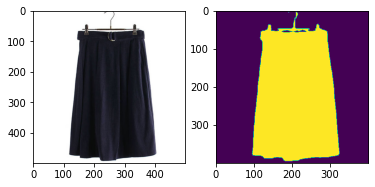

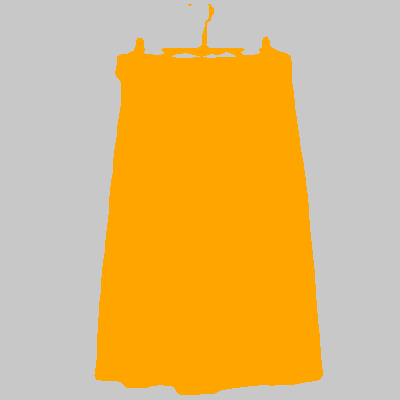

 82%|██████████████████████████████████████████████████▏          | 740/900 [01:57<00:23,  6.87it/s]

torch.Size([1, 3, 400, 400])
/mnt/nas4/hm/datasets/shopping_clothes/data/data900_personby100/bottom/image/train_988.jpg
{'background': 0, 'top': 1, 'skirt': 2, 'outer': 3, 'dress': 4, 'bottom': 5}
Counter({5: 96559, 0: 63441})


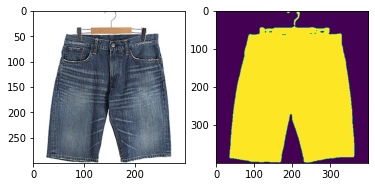

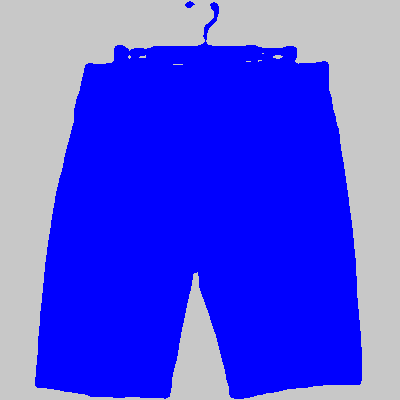

 82%|██████████████████████████████████████████████████▏          | 741/900 [01:57<00:22,  7.03it/s]

torch.Size([1, 3, 400, 400])
/mnt/nas4/hm/datasets/shopping_clothes/data/data900_personby100/skirt/image/train_1429.jpg
{'background': 0, 'top': 1, 'skirt': 2, 'outer': 3, 'dress': 4, 'bottom': 5}
Counter({2: 88662, 0: 71338})


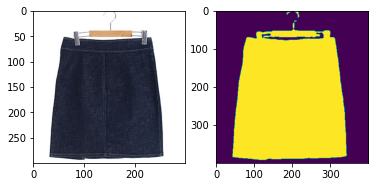

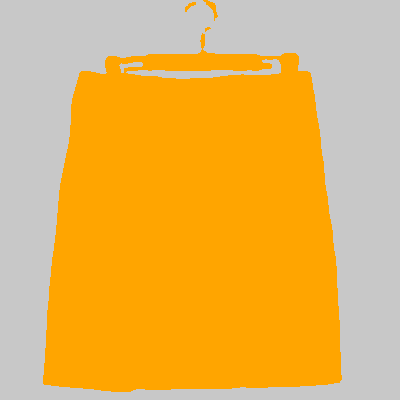

 82%|██████████████████████████████████████████████████▎          | 742/900 [01:57<00:22,  7.15it/s]

torch.Size([1, 3, 400, 400])
/mnt/nas4/hm/datasets/shopping_clothes/data/data900_personby100/dress/image/train_2149.jpg
{'background': 0, 'top': 1, 'skirt': 2, 'outer': 3, 'dress': 4, 'bottom': 5}
Counter({0: 112535, 4: 47465})


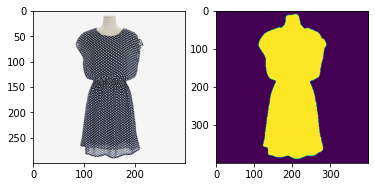

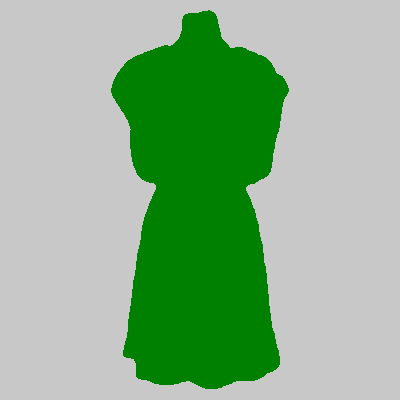

 83%|██████████████████████████████████████████████████▎          | 743/900 [01:57<00:21,  7.27it/s]

torch.Size([1, 3, 400, 400])
/mnt/nas4/hm/datasets/shopping_clothes/data/data900_personby100/outer/image/train_2967.jpg
{'background': 0, 'top': 1, 'skirt': 2, 'outer': 3, 'dress': 4, 'bottom': 5}
Counter({0: 97673, 3: 62327})


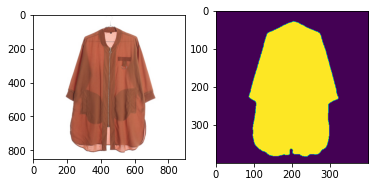

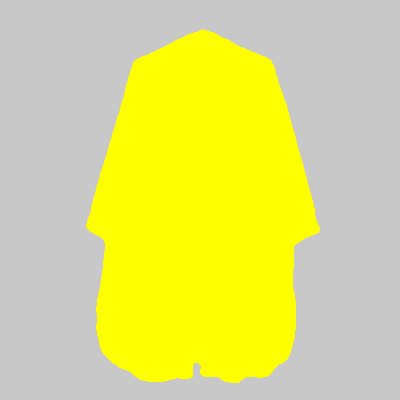

 83%|██████████████████████████████████████████████████▍          | 744/900 [01:57<00:23,  6.54it/s]

torch.Size([1, 3, 400, 400])
/mnt/nas4/hm/datasets/shopping_clothes/data/data900_personby100/dress/image/train_2348.jpg
{'background': 0, 'top': 1, 'skirt': 2, 'outer': 3, 'dress': 4, 'bottom': 5}
Counter({0: 119427, 4: 40573})


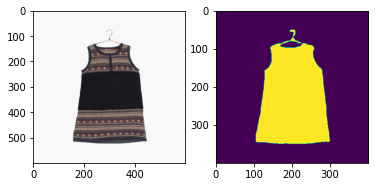

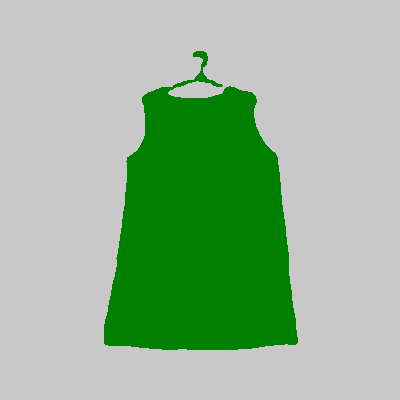

 83%|██████████████████████████████████████████████████▍          | 745/900 [01:58<00:26,  5.86it/s]

torch.Size([1, 3, 400, 400])
/mnt/nas4/hm/datasets/shopping_clothes/data/data900_personby100/outer/image/train_4902.jpg
{'background': 0, 'top': 1, 'skirt': 2, 'outer': 3, 'dress': 4, 'bottom': 5}
Counter({0: 82200, 3: 77800})


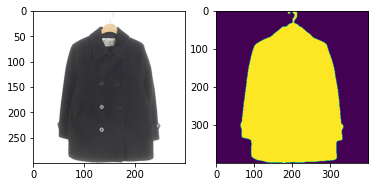

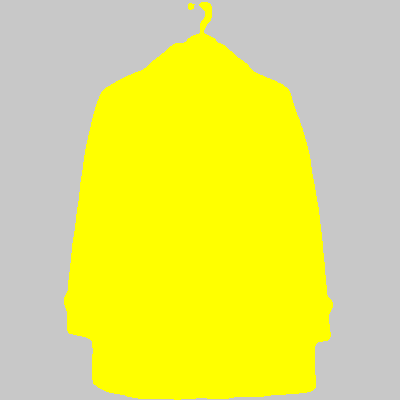

 83%|██████████████████████████████████████████████████▌          | 746/900 [01:58<00:24,  6.25it/s]

torch.Size([1, 3, 400, 400])
/mnt/nas4/hm/datasets/shopping_clothes/data/data900_personby100/top/image/train_2168.jpg
{'background': 0, 'top': 1, 'skirt': 2, 'outer': 3, 'dress': 4, 'bottom': 5}
Counter({0: 112150, 1: 47850})


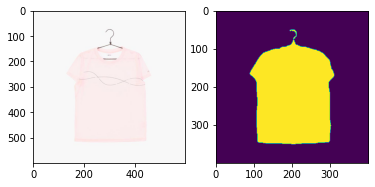

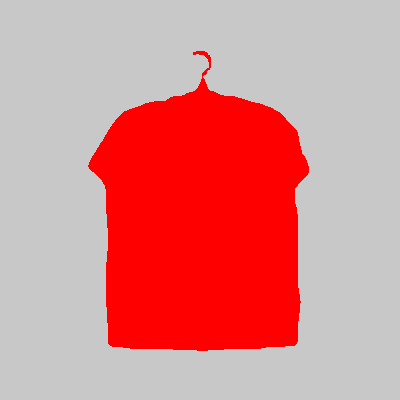

 83%|██████████████████████████████████████████████████▋          | 747/900 [01:58<00:23,  6.38it/s]

torch.Size([1, 3, 400, 400])
/mnt/nas4/hm/datasets/shopping_clothes/data/data900_personby100/outer/image/train_6206.jpg
{'background': 0, 'top': 1, 'skirt': 2, 'outer': 3, 'dress': 4, 'bottom': 5}
Counter({0: 97921, 3: 62079})


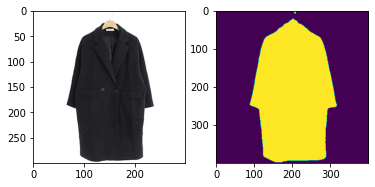

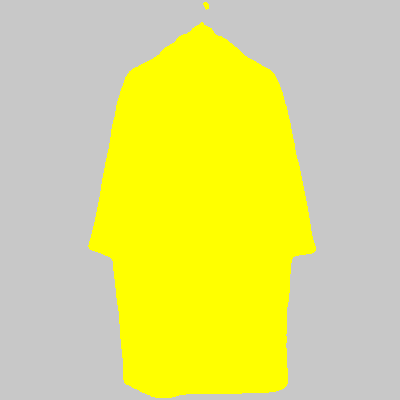

 83%|██████████████████████████████████████████████████▋          | 748/900 [01:58<00:22,  6.68it/s]

torch.Size([1, 3, 400, 400])
/mnt/nas4/hm/datasets/shopping_clothes/data/data900_personby100/outer/image/train_9819.jpg
{'background': 0, 'top': 1, 'skirt': 2, 'outer': 3, 'dress': 4, 'bottom': 5}
Counter({0: 104930, 3: 55070})


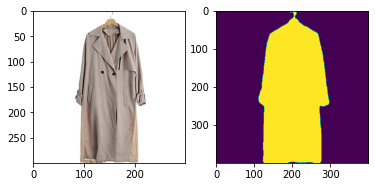

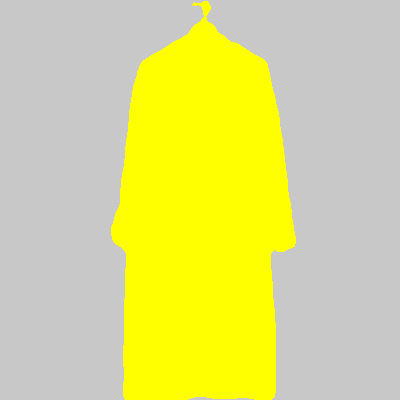

 83%|██████████████████████████████████████████████████▊          | 749/900 [01:58<00:21,  6.91it/s]

torch.Size([1, 3, 400, 400])
/mnt/nas4/hm/datasets/shopping_clothes/data/data900_personby100/top/image/train_18313.jpg
{'background': 0, 'top': 1, 'skirt': 2, 'outer': 3, 'dress': 4, 'bottom': 5}
Counter({0: 91535, 1: 68465})


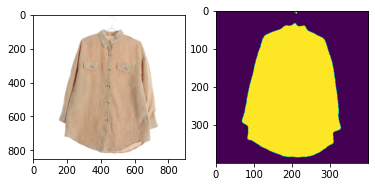

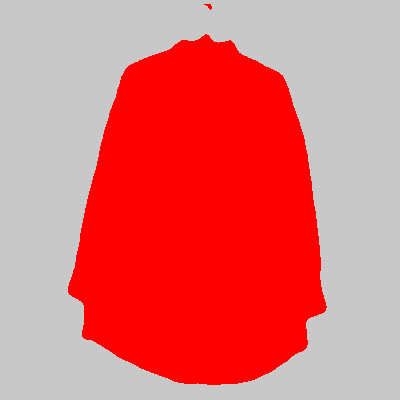

 83%|██████████████████████████████████████████████████▊          | 750/900 [01:58<00:23,  6.36it/s]

torch.Size([1, 3, 400, 400])
/mnt/nas4/hm/datasets/shopping_clothes/data/data900_personby100/top/image/train_5820.jpg
{'background': 0, 'top': 1, 'skirt': 2, 'outer': 3, 'dress': 4, 'bottom': 5}
Counter({0: 86927, 1: 73073})


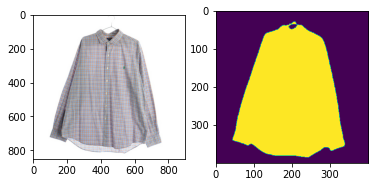

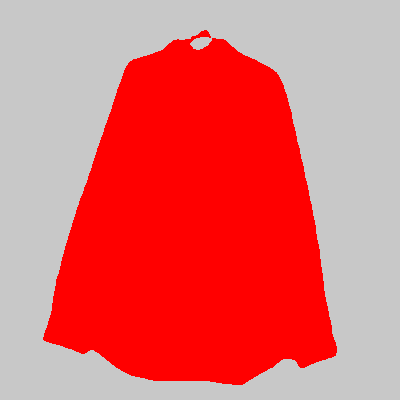

 83%|██████████████████████████████████████████████████▉          | 751/900 [01:58<00:25,  5.93it/s]

torch.Size([1, 3, 400, 400])
/mnt/nas4/hm/datasets/shopping_clothes/data/data900_personby100/bottom/image/train_1970.jpg
{'background': 0, 'top': 1, 'skirt': 2, 'outer': 3, 'dress': 4, 'bottom': 5}
Counter({0: 89095, 5: 70905})


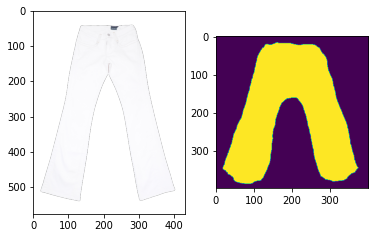

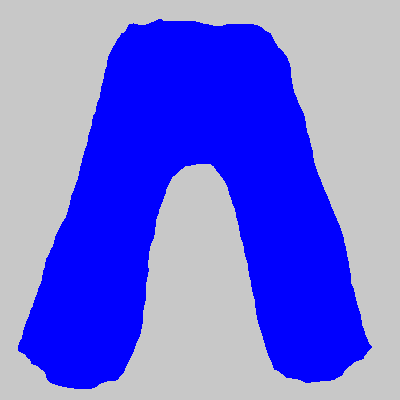

 84%|██████████████████████████████████████████████████▉          | 752/900 [01:59<00:24,  6.16it/s]

torch.Size([1, 3, 400, 400])
/mnt/nas4/hm/datasets/shopping_clothes/data/data900_personby100/outer/image/train_3710.jpg
{'background': 0, 'top': 1, 'skirt': 2, 'outer': 3, 'dress': 4, 'bottom': 5}
Counter({3: 108570, 0: 51430})


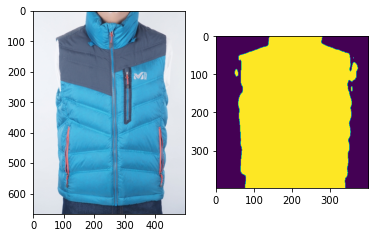

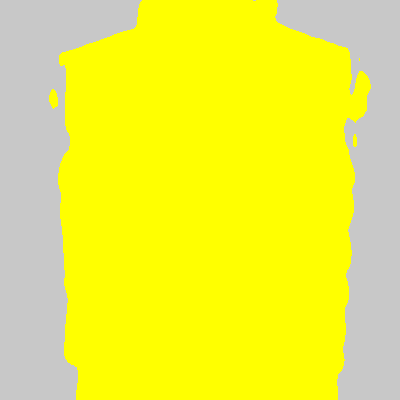

 84%|███████████████████████████████████████████████████          | 753/900 [01:59<00:24,  6.11it/s]

torch.Size([1, 3, 400, 400])
/mnt/nas4/hm/datasets/shopping_clothes/data/data900_personby100/top/image/train_11259.jpg
{'background': 0, 'top': 1, 'skirt': 2, 'outer': 3, 'dress': 4, 'bottom': 5}
Counter({0: 100926, 1: 59074})


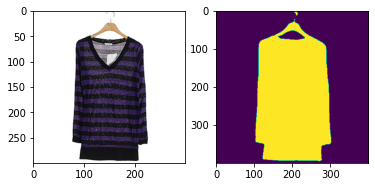

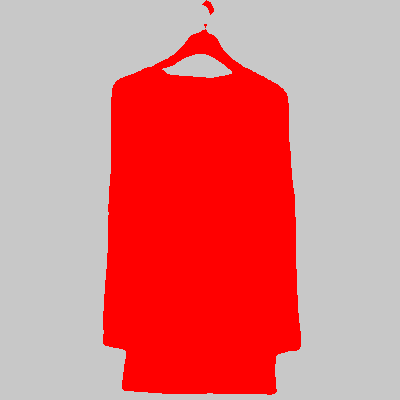

 84%|███████████████████████████████████████████████████          | 754/900 [01:59<00:22,  6.47it/s]

torch.Size([1, 3, 400, 400])
/mnt/nas4/hm/datasets/shopping_clothes/data/data900_personby100/outer/image/train_10961.jpg
{'background': 0, 'top': 1, 'skirt': 2, 'outer': 3, 'dress': 4, 'bottom': 5}
Counter({0: 89191, 3: 70809})


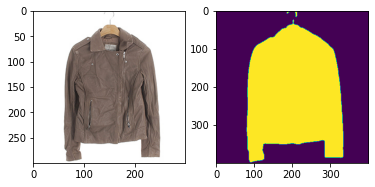

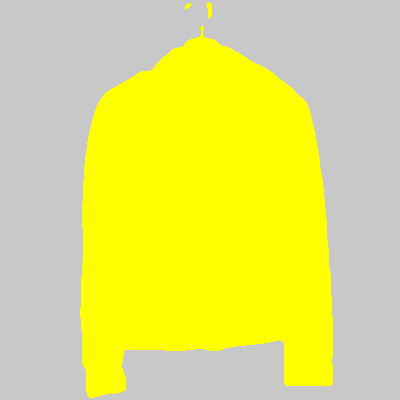

 84%|███████████████████████████████████████████████████▏         | 755/900 [01:59<00:21,  6.75it/s]

torch.Size([1, 3, 400, 400])
/mnt/nas4/hm/datasets/shopping_clothes/data/data900_personby100/skirt/image/train_953.jpg
{'background': 0, 'top': 1, 'skirt': 2, 'outer': 3, 'dress': 4, 'bottom': 5}
Counter({0: 84472, 2: 75528})


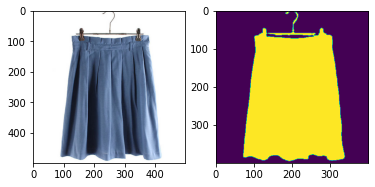

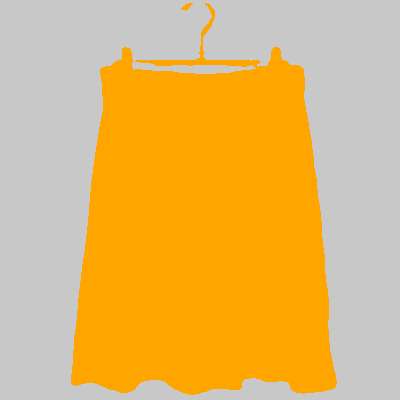

 84%|███████████████████████████████████████████████████▏         | 756/900 [01:59<00:23,  6.04it/s]

torch.Size([1, 3, 400, 400])
/mnt/nas4/hm/datasets/shopping_clothes/data/data900_personby100/dress/image/train_2654.jpg
{'background': 0, 'top': 1, 'skirt': 2, 'outer': 3, 'dress': 4, 'bottom': 5}
Counter({0: 116801, 4: 43199})


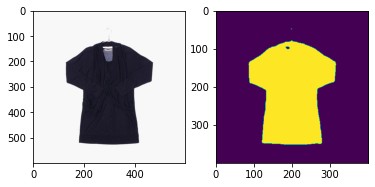

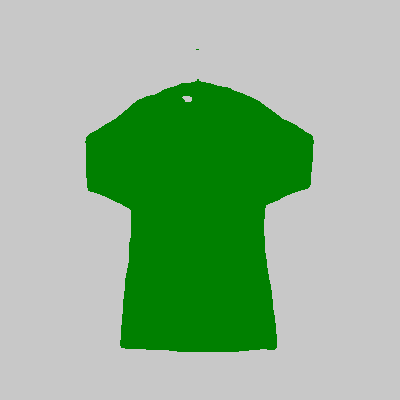

 84%|███████████████████████████████████████████████████▎         | 757/900 [01:59<00:24,  5.83it/s]

torch.Size([1, 3, 400, 400])
/mnt/nas4/hm/datasets/shopping_clothes/data/data900_personby100/top/image/train_1980.jpg
{'background': 0, 'top': 1, 'skirt': 2, 'outer': 3, 'dress': 4, 'bottom': 5}
Counter({0: 94896, 1: 65104})


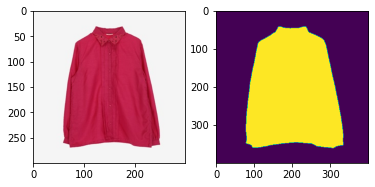

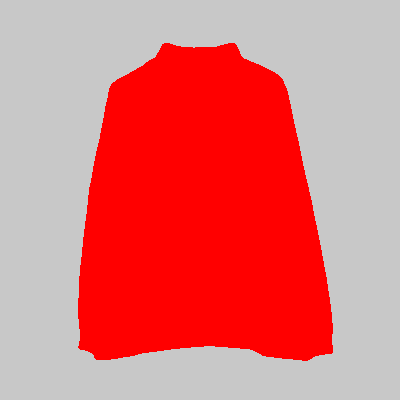

 84%|███████████████████████████████████████████████████▍         | 758/900 [02:00<00:23,  6.01it/s]

torch.Size([1, 3, 400, 400])
/mnt/nas4/hm/datasets/shopping_clothes/data/data900_personby100/bottom/image/train_1219.jpg
{'background': 0, 'top': 1, 'skirt': 2, 'outer': 3, 'dress': 4, 'bottom': 5}
Counter({0: 103522, 5: 56478})


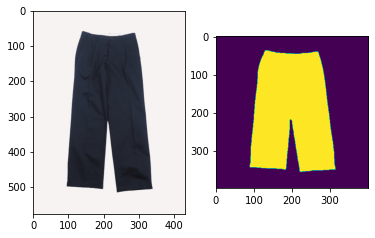

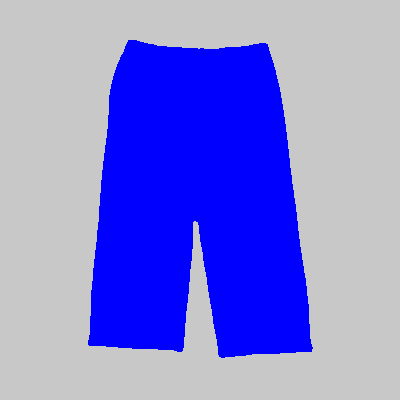

 84%|███████████████████████████████████████████████████▍         | 759/900 [02:00<00:22,  6.21it/s]

torch.Size([1, 3, 400, 400])
/mnt/nas4/hm/datasets/shopping_clothes/data/data900_personby100/outer/image/train_1388.jpg
{'background': 0, 'top': 1, 'skirt': 2, 'outer': 3, 'dress': 4, 'bottom': 5}
Counter({0: 86649, 3: 73351})


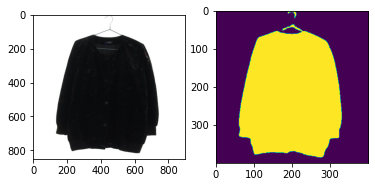

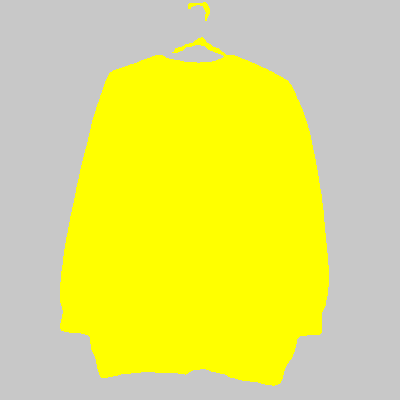

 84%|███████████████████████████████████████████████████▌         | 760/900 [02:00<00:23,  5.93it/s]

torch.Size([1, 3, 400, 400])
/mnt/nas4/hm/datasets/shopping_clothes/data/data900_personby100/outer/image/train_1017.jpg
{'background': 0, 'top': 1, 'skirt': 2, 'outer': 3, 'dress': 4, 'bottom': 5}
Counter({0: 109566, 3: 50434})


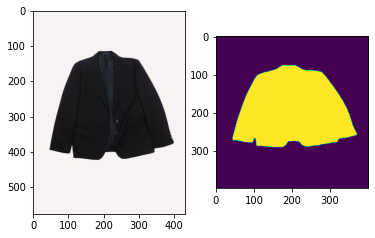

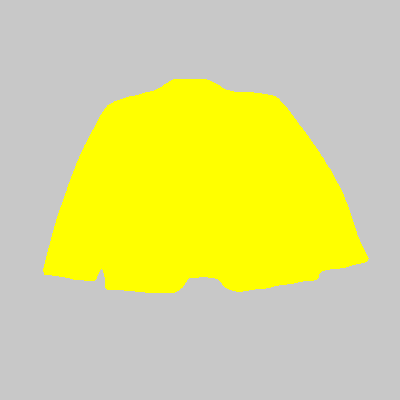

 85%|███████████████████████████████████████████████████▌         | 761/900 [02:00<00:22,  6.17it/s]

torch.Size([1, 3, 400, 400])
/mnt/nas4/hm/datasets/shopping_clothes/data/data900_personby100/bottom/image/train_2877.jpg
{'background': 0, 'top': 1, 'skirt': 2, 'outer': 3, 'dress': 4, 'bottom': 5}
Counter({0: 103526, 5: 56474})


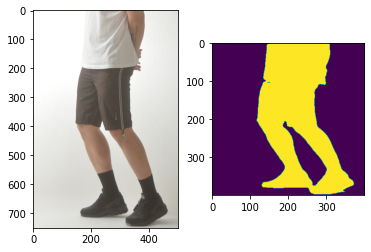

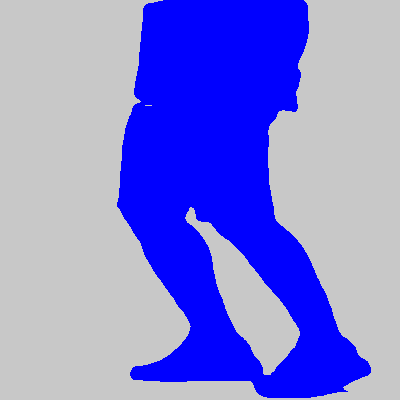

 85%|███████████████████████████████████████████████████▋         | 762/900 [02:00<00:22,  6.11it/s]

torch.Size([1, 3, 400, 400])
/mnt/nas4/hm/datasets/shopping_clothes/data/data900_personby100/top/image/train_4074.jpg
{'background': 0, 'top': 1, 'skirt': 2, 'outer': 3, 'dress': 4, 'bottom': 5}
Counter({0: 101044, 1: 58956})


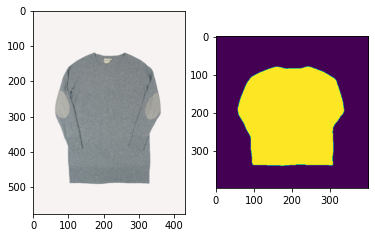

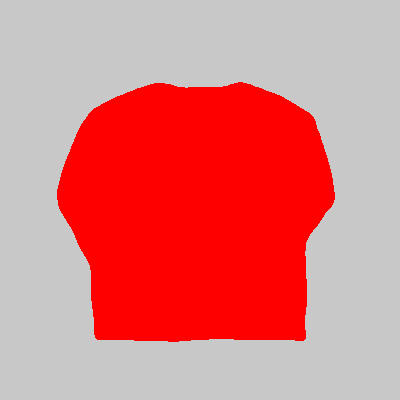

 85%|███████████████████████████████████████████████████▋         | 763/900 [02:00<00:21,  6.30it/s]

torch.Size([1, 3, 400, 400])
/mnt/nas4/hm/datasets/shopping_clothes/data/data900_personby100/dress/image/train_292.jpg
{'background': 0, 'top': 1, 'skirt': 2, 'outer': 3, 'dress': 4, 'bottom': 5}
Counter({0: 110712, 4: 49288})


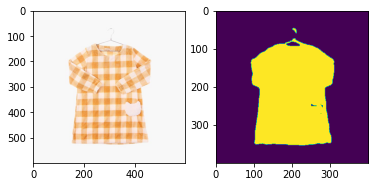

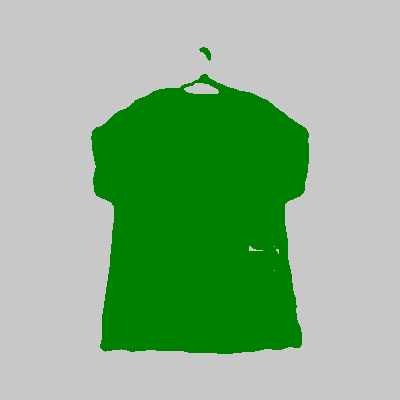

 85%|███████████████████████████████████████████████████▊         | 764/900 [02:01<00:21,  6.39it/s]

torch.Size([1, 3, 400, 400])
/mnt/nas4/hm/datasets/shopping_clothes/data/data900_personby100/bottom/image/train_1394.jpg
{'background': 0, 'top': 1, 'skirt': 2, 'outer': 3, 'dress': 4, 'bottom': 5}
Counter({0: 105325, 5: 54675})


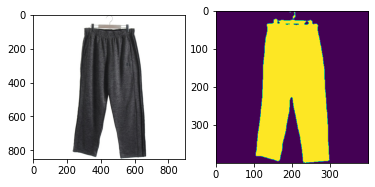

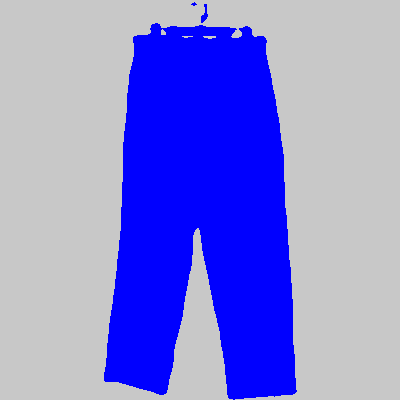

 85%|███████████████████████████████████████████████████▊         | 765/900 [02:01<00:22,  6.06it/s]

torch.Size([1, 3, 400, 400])
/mnt/nas4/hm/datasets/shopping_clothes/data/data900_personby100/skirt/image/train_2752.jpg
{'background': 0, 'top': 1, 'skirt': 2, 'outer': 3, 'dress': 4, 'bottom': 5}
Counter({0: 93923, 2: 66077})


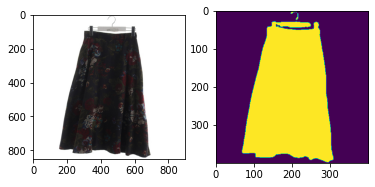

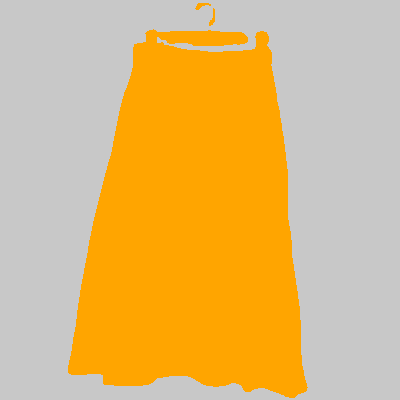

 85%|███████████████████████████████████████████████████▉         | 766/900 [02:01<00:23,  5.81it/s]

torch.Size([1, 3, 400, 400])
/mnt/nas4/hm/datasets/shopping_clothes/data/data900_personby100/bottom/image/train_253.jpg
{'background': 0, 'top': 1, 'skirt': 2, 'outer': 3, 'dress': 4, 'bottom': 5}
Counter({0: 99380, 5: 60620})


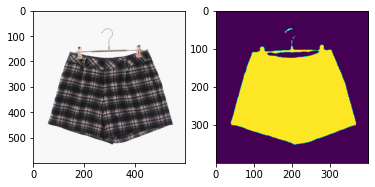

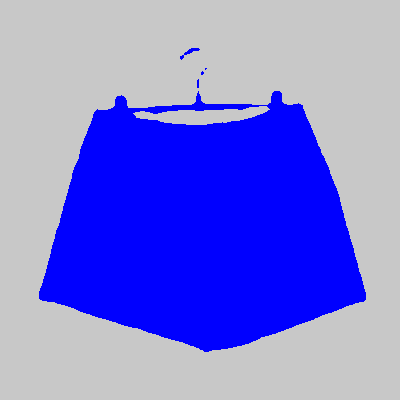

 85%|███████████████████████████████████████████████████▉         | 767/900 [02:01<00:24,  5.42it/s]

torch.Size([1, 3, 400, 400])
/mnt/nas4/hm/datasets/shopping_clothes/data/data900_personby100/top/image/train_1889.jpg
{'background': 0, 'top': 1, 'skirt': 2, 'outer': 3, 'dress': 4, 'bottom': 5}
Counter({0: 87748, 1: 72252})


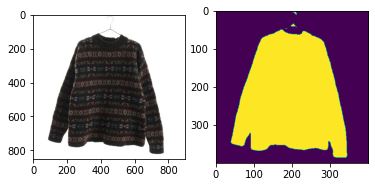

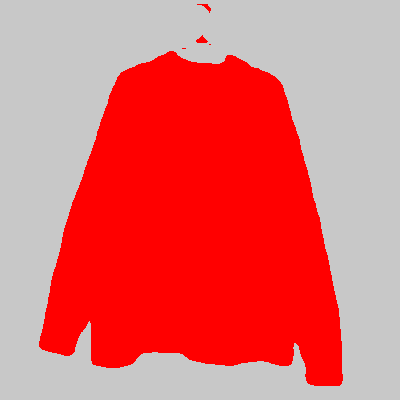

 85%|████████████████████████████████████████████████████         | 768/900 [02:01<00:24,  5.34it/s]

torch.Size([1, 3, 400, 400])
/mnt/nas4/hm/datasets/shopping_clothes/data/data900_personby100/bottom/image/train_1022.jpg
{'background': 0, 'top': 1, 'skirt': 2, 'outer': 3, 'dress': 4, 'bottom': 5}
Counter({0: 116681, 5: 43319})


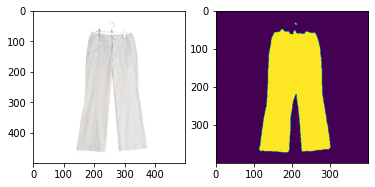

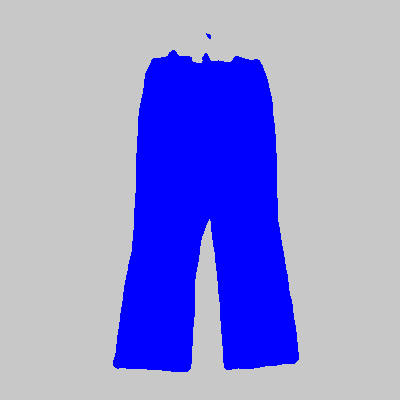

 85%|████████████████████████████████████████████████████         | 769/900 [02:01<00:22,  5.74it/s]

torch.Size([1, 3, 400, 400])
/mnt/nas4/hm/datasets/shopping_clothes/data/data900_personby100/top/image/train_9499.jpg
{'background': 0, 'top': 1, 'skirt': 2, 'outer': 3, 'dress': 4, 'bottom': 5}
Counter({0: 80122, 1: 79878})


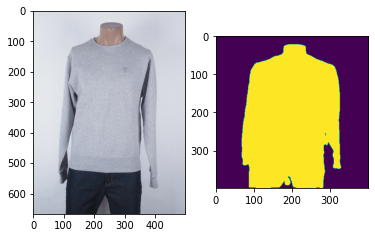

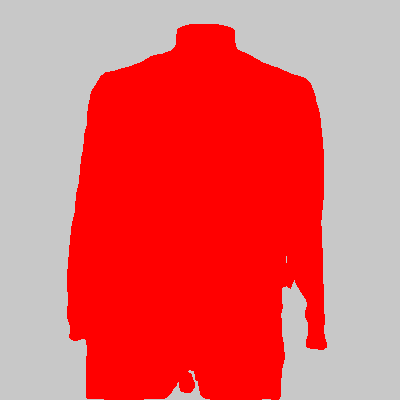

 86%|████████████████████████████████████████████████████▏        | 770/900 [02:02<00:22,  5.82it/s]

torch.Size([1, 3, 400, 400])
/mnt/nas4/hm/datasets/shopping_clothes/data/data900_personby100/dress/image/train_1575.jpg
{'background': 0, 'top': 1, 'skirt': 2, 'outer': 3, 'dress': 4, 'bottom': 5}
Counter({0: 115388, 4: 44612})


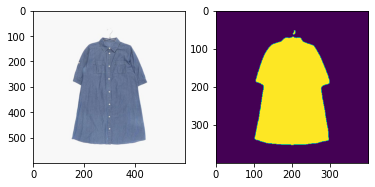

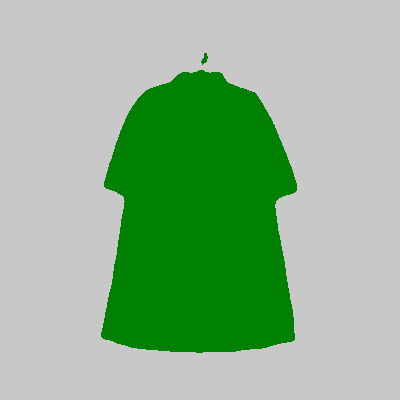

 86%|████████████████████████████████████████████████████▎        | 771/900 [02:02<00:21,  6.05it/s]

torch.Size([1, 3, 400, 400])
/mnt/nas4/hm/datasets/shopping_clothes/data/data900_personby100/outer/image/train_1979.jpg
{'background': 0, 'top': 1, 'skirt': 2, 'outer': 3, 'dress': 4, 'bottom': 5}
Counter({3: 99186, 0: 60814})


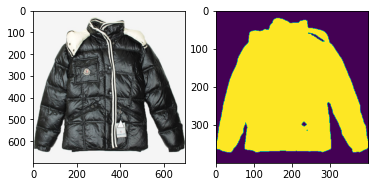

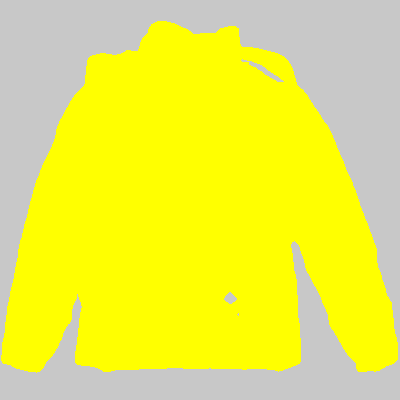

 86%|████████████████████████████████████████████████████▎        | 772/900 [02:02<00:21,  6.06it/s]

torch.Size([1, 3, 400, 400])
/mnt/nas4/hm/datasets/shopping_clothes/data/data900_personby100/top/image/train_18360.jpg
{'background': 0, 'top': 1, 'skirt': 2, 'outer': 3, 'dress': 4, 'bottom': 5}
Counter({0: 108719, 1: 51281})


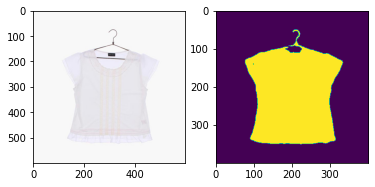

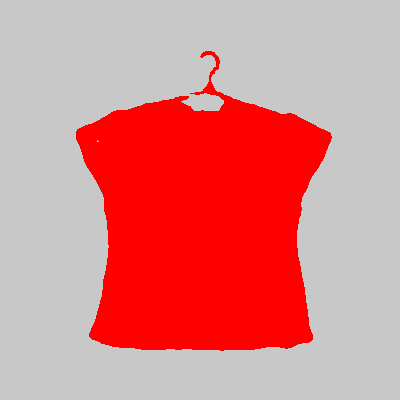

 86%|████████████████████████████████████████████████████▍        | 773/900 [02:02<00:20,  6.19it/s]

torch.Size([1, 3, 400, 400])
/mnt/nas4/hm/datasets/shopping_clothes/data/data900_personby100/dress/image/train_3214.jpg
{'background': 0, 'top': 1, 'skirt': 2, 'outer': 3, 'dress': 4, 'bottom': 5}
Counter({0: 115953, 4: 44047})


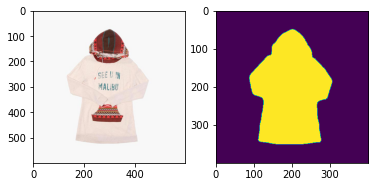

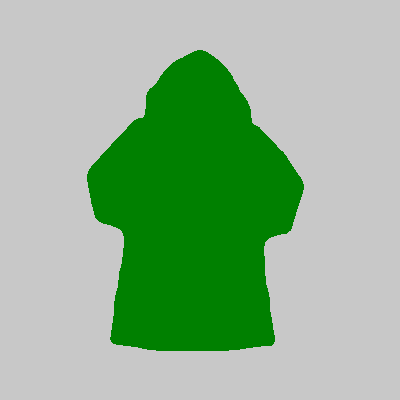

 86%|████████████████████████████████████████████████████▍        | 774/900 [02:02<00:19,  6.32it/s]

torch.Size([1, 3, 400, 400])
/mnt/nas4/hm/datasets/shopping_clothes/data/data900_personby100/outer/image/train_1779.jpg
{'background': 0, 'top': 1, 'skirt': 2, 'outer': 3, 'dress': 4, 'bottom': 5}
Counter({0: 96268, 3: 63732})


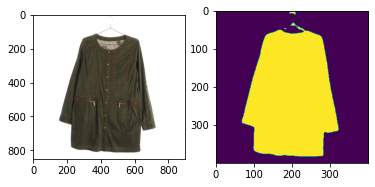

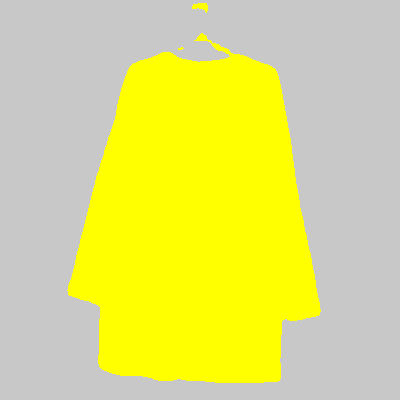

 86%|████████████████████████████████████████████████████▌        | 775/900 [02:02<00:20,  5.99it/s]

torch.Size([1, 3, 400, 400])
/mnt/nas4/hm/datasets/shopping_clothes/data/data900_personby100/dress/image/train_1535.jpg
{'background': 0, 'top': 1, 'skirt': 2, 'outer': 3, 'dress': 4, 'bottom': 5}
Counter({0: 88962, 4: 71038})


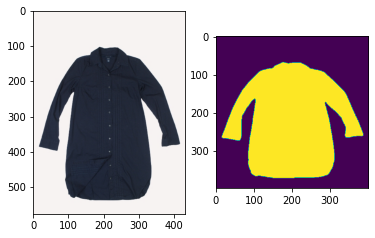

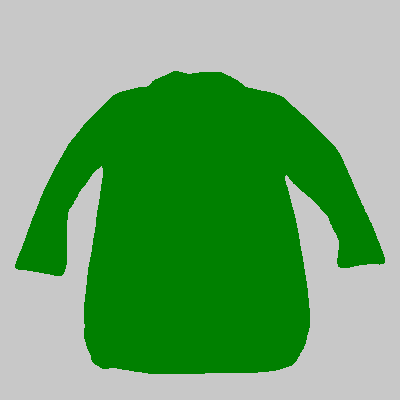

 86%|████████████████████████████████████████████████████▌        | 776/900 [02:03<00:20,  6.18it/s]

torch.Size([1, 3, 400, 400])
/mnt/nas4/hm/datasets/shopping_clothes/data/data900_personby100/outer/image/train_8604.jpg
{'background': 0, 'top': 1, 'skirt': 2, 'outer': 3, 'dress': 4, 'bottom': 5}
Counter({0: 81694, 3: 78306})


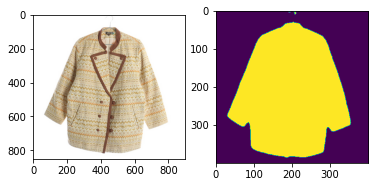

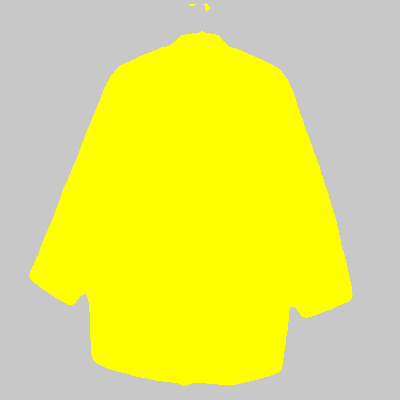

 86%|████████████████████████████████████████████████████▋        | 777/900 [02:03<00:21,  5.82it/s]

torch.Size([1, 3, 400, 400])
/mnt/nas4/hm/datasets/shopping_clothes/data/data900_personby100/dress/image/train_106.jpg
{'background': 0, 'top': 1, 'skirt': 2, 'outer': 3, 'dress': 4, 'bottom': 5}
Counter({0: 113889, 4: 46111})


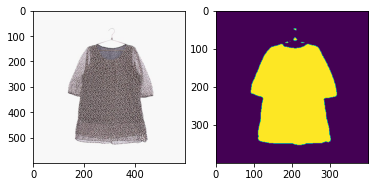

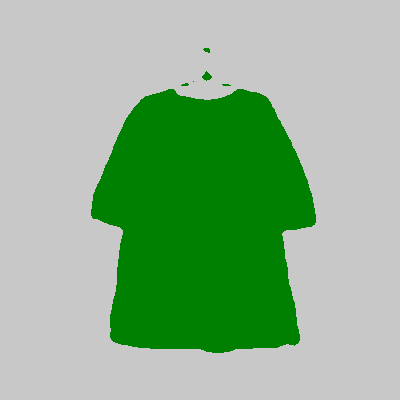

 86%|████████████████████████████████████████████████████▋        | 778/900 [02:03<00:22,  5.41it/s]

torch.Size([1, 3, 400, 400])
/mnt/nas4/hm/datasets/shopping_clothes/data/data900_personby100/outer/image/train_9311.jpg
{'background': 0, 'top': 1, 'skirt': 2, 'outer': 3, 'dress': 4, 'bottom': 5}
Counter({0: 96762, 3: 63238})


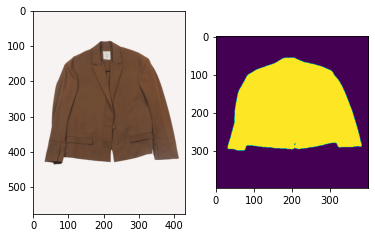

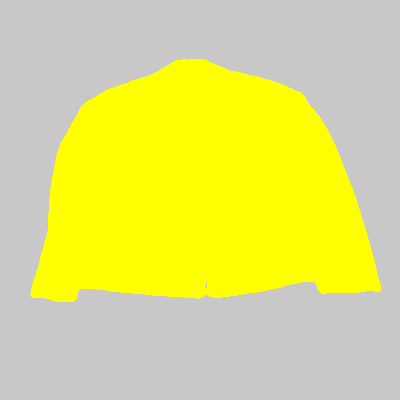

 87%|████████████████████████████████████████████████████▊        | 779/900 [02:03<00:21,  5.76it/s]

torch.Size([1, 3, 400, 400])
/mnt/nas4/hm/datasets/shopping_clothes/data/data900_personby100/bottom/image/train_2700.jpg
{'background': 0, 'top': 1, 'skirt': 2, 'outer': 3, 'dress': 4, 'bottom': 5}
Counter({0: 116044, 5: 43956})


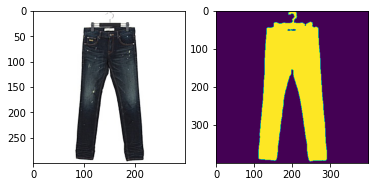

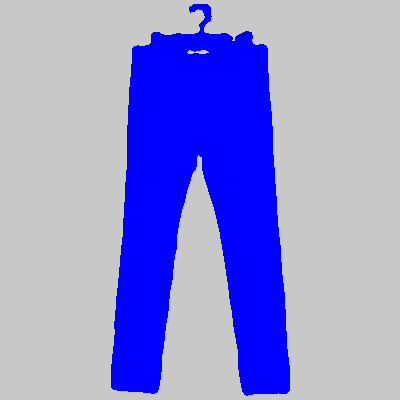

 87%|████████████████████████████████████████████████████▊        | 780/900 [02:03<00:19,  6.20it/s]

torch.Size([1, 3, 400, 400])
/mnt/nas4/hm/datasets/shopping_clothes/data/data900_personby100/outer/image/train_10261.jpg
{'background': 0, 'top': 1, 'skirt': 2, 'outer': 3, 'dress': 4, 'bottom': 5}
Counter({3: 89103, 0: 70897})


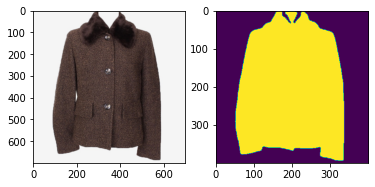

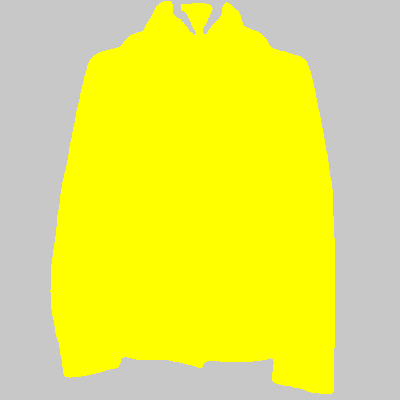

 87%|████████████████████████████████████████████████████▉        | 781/900 [02:03<00:19,  6.12it/s]

torch.Size([1, 3, 400, 400])
/mnt/nas4/hm/datasets/shopping_clothes/data/data900_personby100/skirt/image/train_1870.jpg
{'background': 0, 'top': 1, 'skirt': 2, 'outer': 3, 'dress': 4, 'bottom': 5}
Counter({0: 86532, 2: 73468})


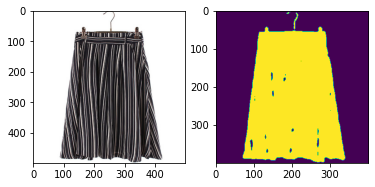

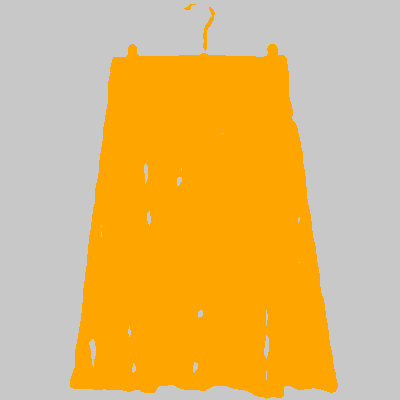

 87%|█████████████████████████████████████████████████████        | 782/900 [02:04<00:18,  6.33it/s]

torch.Size([1, 3, 400, 400])
/mnt/nas4/hm/datasets/shopping_clothes/data/data900_personby100/skirt/image/train_574.jpg
{'background': 0, 'top': 1, 'skirt': 2, 'outer': 3, 'dress': 4, 'bottom': 5}
Counter({0: 98835, 2: 61165})


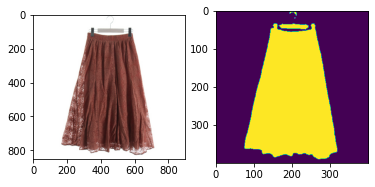

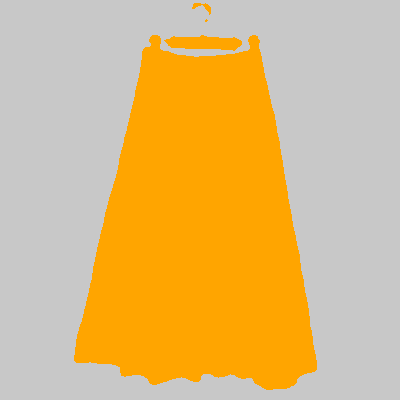

 87%|█████████████████████████████████████████████████████        | 783/900 [02:04<00:19,  5.98it/s]

torch.Size([1, 3, 400, 400])
/mnt/nas4/hm/datasets/shopping_clothes/data/data900_personby100/skirt/image/train_2850.jpg
{'background': 0, 'top': 1, 'skirt': 2, 'outer': 3, 'dress': 4, 'bottom': 5}
Counter({0: 83058, 2: 76942})


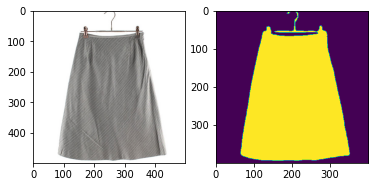

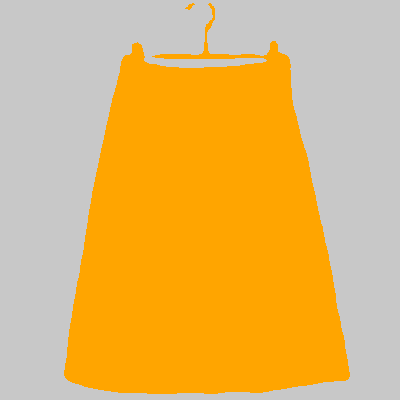

 87%|█████████████████████████████████████████████████████▏       | 784/900 [02:04<00:18,  6.22it/s]

torch.Size([1, 3, 400, 400])
/mnt/nas4/hm/datasets/shopping_clothes/data/data900_personby100/skirt/image/train_2177.jpg
{'background': 0, 'top': 1, 'skirt': 2, 'outer': 3, 'dress': 4, 'bottom': 5}
Counter({2: 82234, 0: 77766})


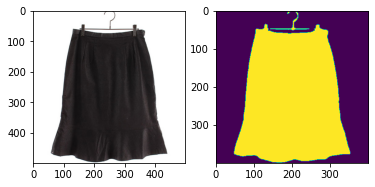

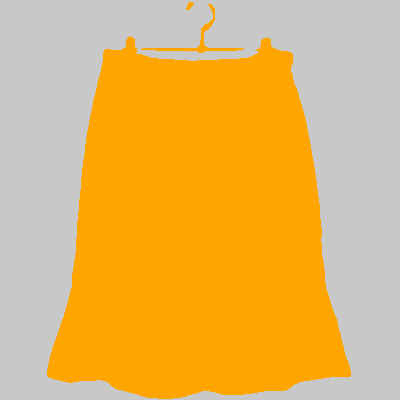

 87%|█████████████████████████████████████████████████████▏       | 785/900 [02:04<00:17,  6.41it/s]

torch.Size([1, 3, 400, 400])
/mnt/nas4/hm/datasets/shopping_clothes/data/data900_personby100/outer/image/train_9534.jpg
{'background': 0, 'top': 1, 'skirt': 2, 'outer': 3, 'dress': 4, 'bottom': 5}
Counter({0: 105639, 3: 54361})


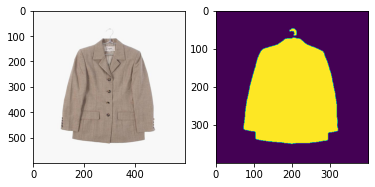

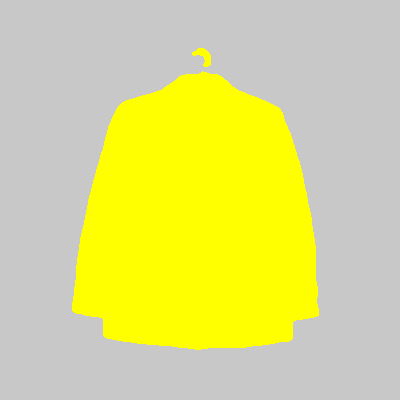

 87%|█████████████████████████████████████████████████████▎       | 786/900 [02:04<00:17,  6.47it/s]

torch.Size([1, 3, 400, 400])
/mnt/nas4/hm/datasets/shopping_clothes/data/data900_personby100/top/image/train_12265.jpg
{'background': 0, 'top': 1, 'skirt': 2, 'outer': 3, 'dress': 4, 'bottom': 5}
Counter({1: 80988, 0: 79012})


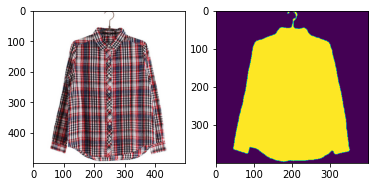

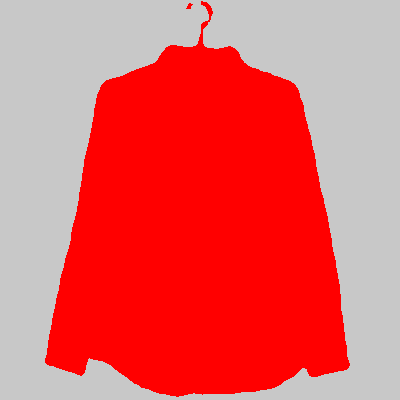

 87%|█████████████████████████████████████████████████████▎       | 787/900 [02:04<00:17,  6.59it/s]

torch.Size([1, 3, 400, 400])
/mnt/nas4/hm/datasets/shopping_clothes/data/data900_personby100/skirt/image/train_1198.jpg
{'background': 0, 'top': 1, 'skirt': 2, 'outer': 3, 'dress': 4, 'bottom': 5}
Counter({0: 99284, 2: 60716})


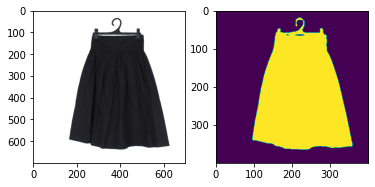

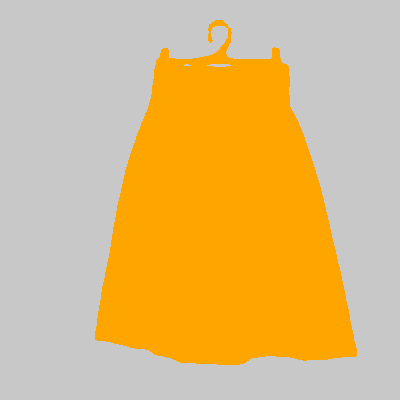

 88%|█████████████████████████████████████████████████████▍       | 788/900 [02:05<00:17,  6.40it/s]

torch.Size([1, 3, 400, 400])
/mnt/nas4/hm/datasets/shopping_clothes/data/data900_personby100/top/image/train_17342.jpg
{'background': 0, 'top': 1, 'skirt': 2, 'outer': 3, 'dress': 4, 'bottom': 5}
Counter({0: 88958, 1: 71042})


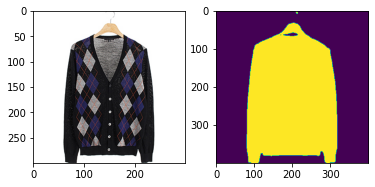

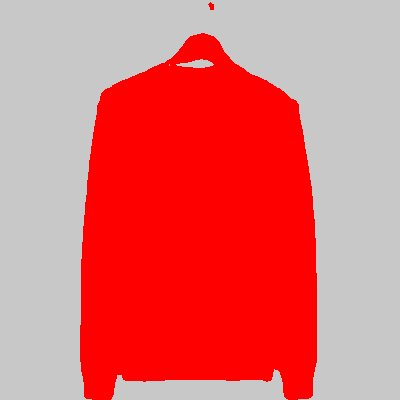

 88%|█████████████████████████████████████████████████████▍       | 789/900 [02:05<00:18,  5.95it/s]

torch.Size([1, 3, 400, 400])
/mnt/nas4/hm/datasets/shopping_clothes/data/data900_personby100/dress/image/train_1767.jpg
{'background': 0, 'top': 1, 'skirt': 2, 'outer': 3, 'dress': 4, 'bottom': 5}
Counter({0: 130710, 4: 29290})


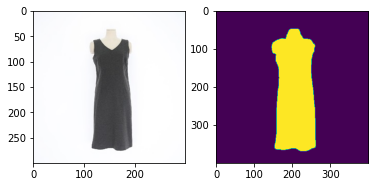

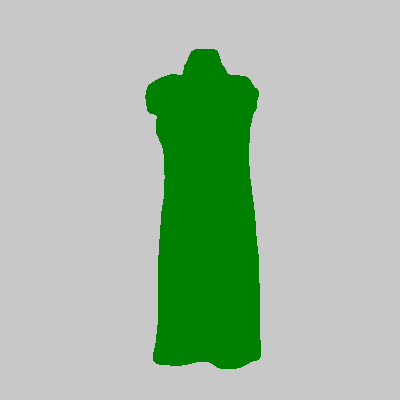

 88%|█████████████████████████████████████████████████████▌       | 790/900 [02:05<00:17,  6.35it/s]

torch.Size([1, 3, 400, 400])
/mnt/nas4/hm/datasets/shopping_clothes/data/data900_personby100/outer/image/train_357.jpg
{'background': 0, 'top': 1, 'skirt': 2, 'outer': 3, 'dress': 4, 'bottom': 5}
Counter({3: 87785, 0: 72215})


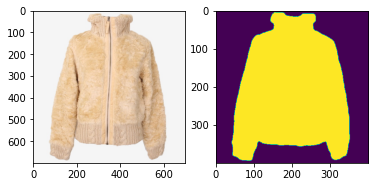

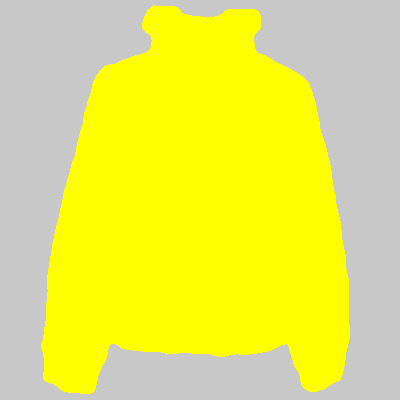

 88%|█████████████████████████████████████████████████████▌       | 791/900 [02:05<00:17,  6.25it/s]

torch.Size([1, 3, 400, 400])
/mnt/nas4/hm/datasets/shopping_clothes/data/data900_personby100/outer/image/train_1928.jpg
{'background': 0, 'top': 1, 'skirt': 2, 'outer': 3, 'dress': 4, 'bottom': 5}
Counter({3: 86592, 0: 73408})


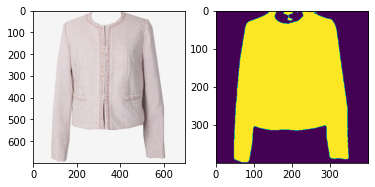

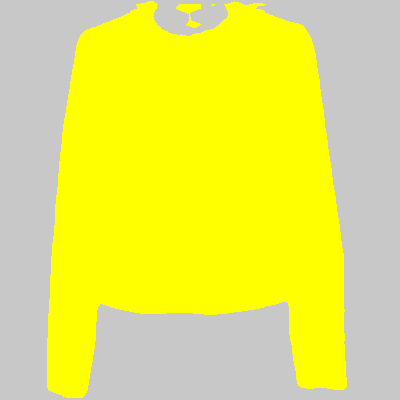

 88%|█████████████████████████████████████████████████████▋       | 792/900 [02:05<00:17,  6.15it/s]

torch.Size([1, 3, 400, 400])
/mnt/nas4/hm/datasets/shopping_clothes/data/data900_personby100/top/image/train_6009.jpg
{'background': 0, 'top': 1, 'skirt': 2, 'outer': 3, 'dress': 4, 'bottom': 5}
Counter({1: 84191, 0: 75809})


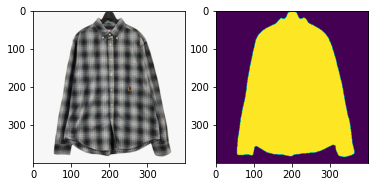

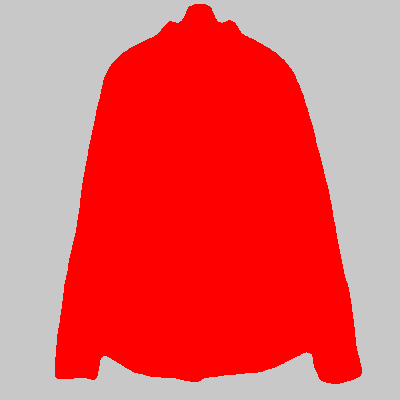

 88%|█████████████████████████████████████████████████████▋       | 793/900 [02:05<00:16,  6.42it/s]

torch.Size([1, 3, 400, 400])
/mnt/nas4/hm/datasets/shopping_clothes/data/data900_personby100/dress/image/train_463.jpg
{'background': 0, 'top': 1, 'skirt': 2, 'outer': 3, 'dress': 4, 'bottom': 5}
Counter({0: 94389, 4: 65611})


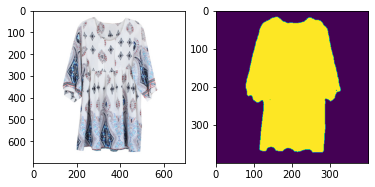

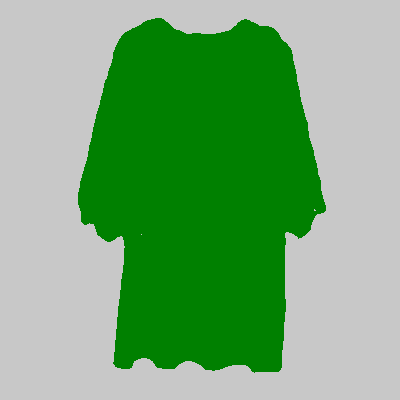

 88%|█████████████████████████████████████████████████████▊       | 794/900 [02:06<00:16,  6.24it/s]

torch.Size([1, 3, 400, 400])
/mnt/nas4/hm/datasets/shopping_clothes/data/data900_personby100/bottom/image/train_2264.jpg
{'background': 0, 'top': 1, 'skirt': 2, 'outer': 3, 'dress': 4, 'bottom': 5}
Counter({0: 114533, 5: 45467})


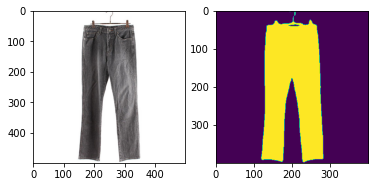

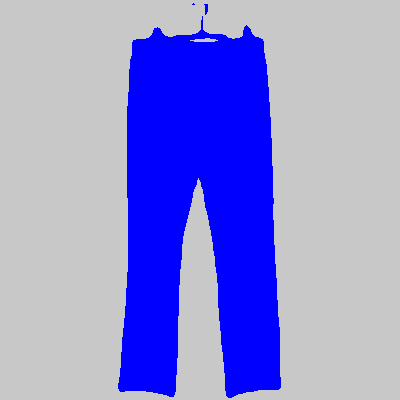

 88%|█████████████████████████████████████████████████████▉       | 795/900 [02:06<00:16,  6.43it/s]

torch.Size([1, 3, 400, 400])
/mnt/nas4/hm/datasets/shopping_clothes/data/data900_personby100/dress/image/train_1285.jpg
{'background': 0, 'top': 1, 'skirt': 2, 'outer': 3, 'dress': 4, 'bottom': 5}
Counter({0: 104477, 4: 55523})


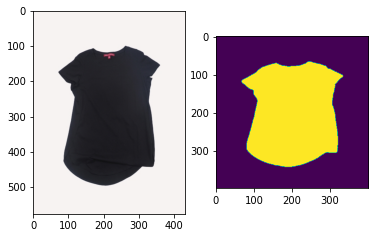

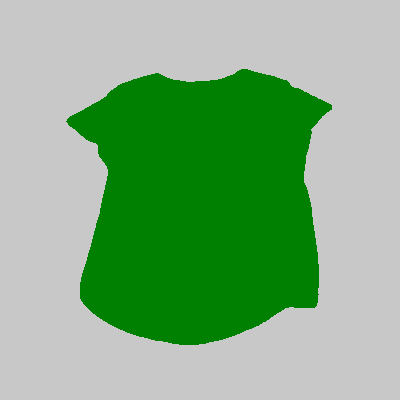

 88%|█████████████████████████████████████████████████████▉       | 796/900 [02:06<00:15,  6.53it/s]

torch.Size([1, 3, 400, 400])
/mnt/nas4/hm/datasets/shopping_clothes/data/data900_personby100/outer/image/train_9431.jpg
{'background': 0, 'top': 1, 'skirt': 2, 'outer': 3, 'dress': 4, 'bottom': 5}
Counter({0: 101075, 3: 58925})


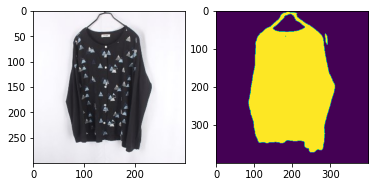

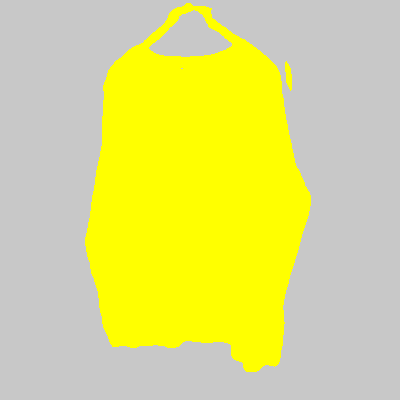

 89%|██████████████████████████████████████████████████████       | 797/900 [02:06<00:15,  6.77it/s]

torch.Size([1, 3, 400, 400])
/mnt/nas4/hm/datasets/shopping_clothes/data/data900_personby100/outer/image/train_798.jpg
{'background': 0, 'top': 1, 'skirt': 2, 'outer': 3, 'dress': 4, 'bottom': 5}
Counter({0: 91761, 3: 68239})


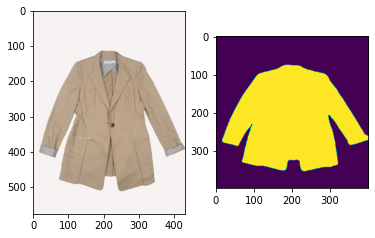

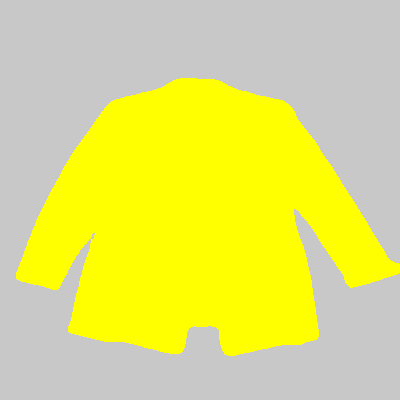

 89%|██████████████████████████████████████████████████████       | 798/900 [02:06<00:15,  6.74it/s]

torch.Size([1, 3, 400, 400])
/mnt/nas4/hm/datasets/shopping_clothes/data/data900_personby100/outer/image/train_936.jpg
{'background': 0, 'top': 1, 'skirt': 2, 'outer': 3, 'dress': 4, 'bottom': 5}
Counter({0: 82788, 3: 77212})


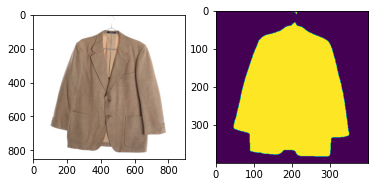

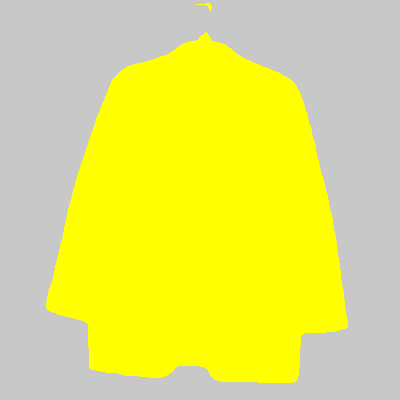

 89%|██████████████████████████████████████████████████████▏      | 799/900 [02:06<00:16,  6.20it/s]

torch.Size([1, 3, 400, 400])
/mnt/nas4/hm/datasets/shopping_clothes/data/data900_personby100/top/image/train_2294.jpg
{'background': 0, 'top': 1, 'skirt': 2, 'outer': 3, 'dress': 4, 'bottom': 5}
Counter({0: 100618, 1: 59382})


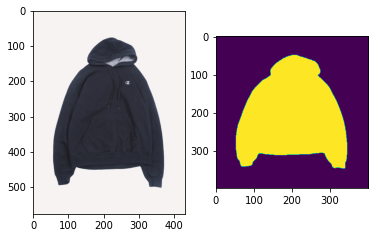

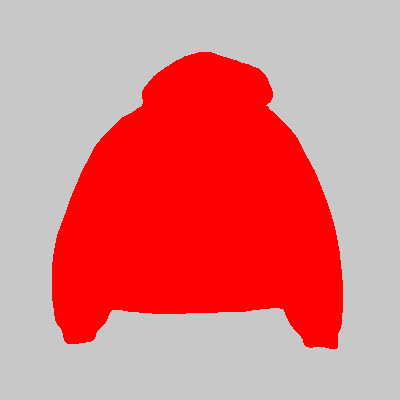

 89%|██████████████████████████████████████████████████████▏      | 800/900 [02:07<00:17,  5.67it/s]

torch.Size([1, 3, 400, 400])
/mnt/nas4/hm/datasets/shopping_clothes/data/data900_personby100/bottom/image/train_569.jpg
{'background': 0, 'top': 1, 'skirt': 2, 'outer': 3, 'dress': 4, 'bottom': 5}
Counter({0: 136453, 5: 23547})


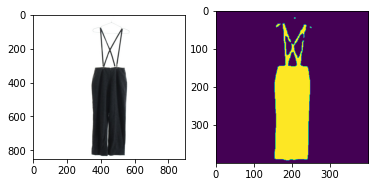

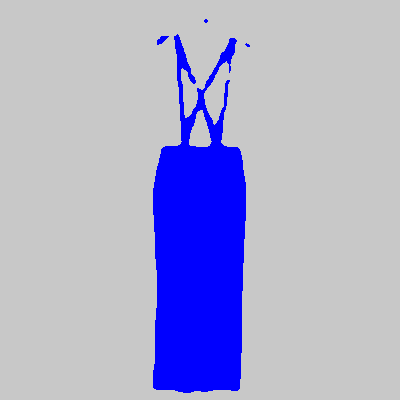

 89%|██████████████████████████████████████████████████████▎      | 801/900 [02:07<00:17,  5.61it/s]

torch.Size([1, 3, 400, 400])
/mnt/nas4/hm/datasets/shopping_clothes/data/data900_personby100/dress/image/train_263.jpg
{'background': 0, 'top': 1, 'skirt': 2, 'outer': 3, 'dress': 4, 'bottom': 5}
Counter({0: 118186, 4: 41814})


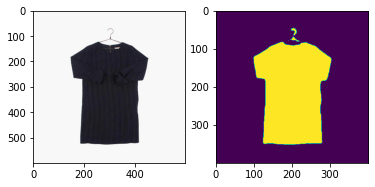

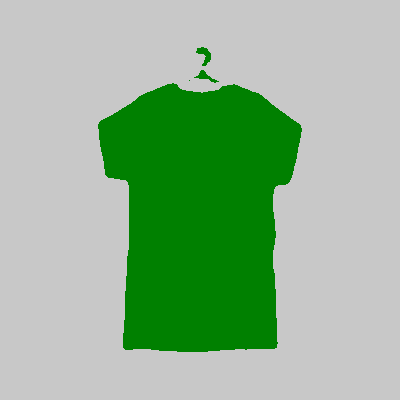

 89%|██████████████████████████████████████████████████████▎      | 802/900 [02:07<00:16,  5.86it/s]

torch.Size([1, 3, 400, 400])
/mnt/nas4/hm/datasets/shopping_clothes/data/data900_personby100/skirt/image/train_1847.jpg
{'background': 0, 'top': 1, 'skirt': 2, 'outer': 3, 'dress': 4, 'bottom': 5}
Counter({0: 105104, 2: 54896})


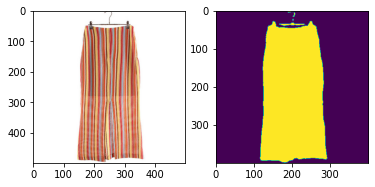

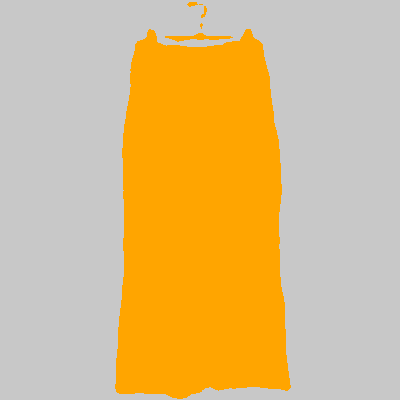

 89%|██████████████████████████████████████████████████████▍      | 803/900 [02:07<00:15,  6.14it/s]

torch.Size([1, 3, 400, 400])
/mnt/nas4/hm/datasets/shopping_clothes/data/data900_personby100/skirt/image/train_1020.jpg
{'background': 0, 'top': 1, 'skirt': 2, 'outer': 3, 'dress': 4, 'bottom': 5}
Counter({0: 88895, 2: 71105})


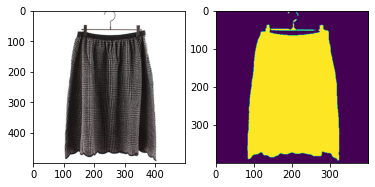

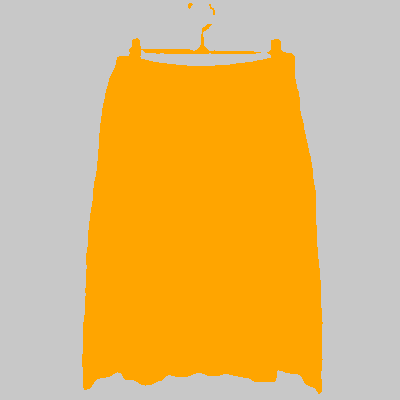

 89%|██████████████████████████████████████████████████████▍      | 804/900 [02:07<00:15,  6.34it/s]

torch.Size([1, 3, 400, 400])
/mnt/nas4/hm/datasets/shopping_clothes/data/data900_personby100/dress/image/train_2275.jpg
{'background': 0, 'top': 1, 'skirt': 2, 'outer': 3, 'dress': 4, 'bottom': 5}
Counter({0: 99150, 4: 60850})


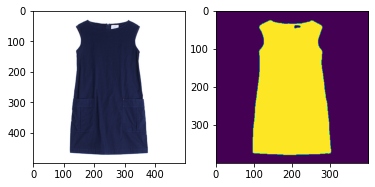

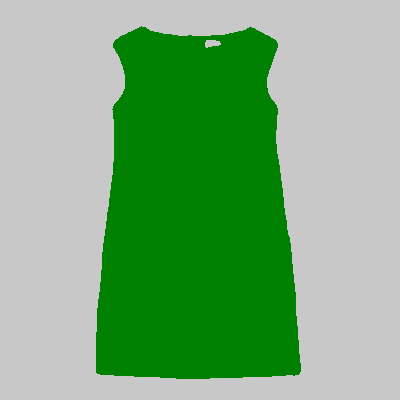

 89%|██████████████████████████████████████████████████████▌      | 805/900 [02:07<00:14,  6.48it/s]

torch.Size([1, 3, 400, 400])
/mnt/nas4/hm/datasets/shopping_clothes/data/data900_personby100/skirt/image/train_1471.jpg
{'background': 0, 'top': 1, 'skirt': 2, 'outer': 3, 'dress': 4, 'bottom': 5}
Counter({0: 109940, 2: 50060})


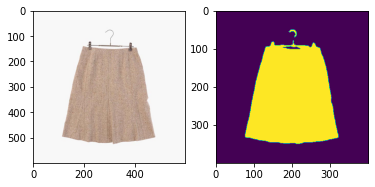

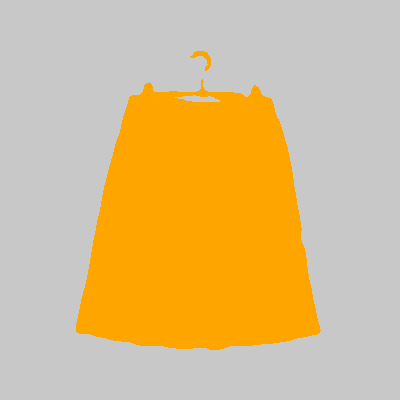

 90%|██████████████████████████████████████████████████████▋      | 806/900 [02:07<00:14,  6.53it/s]

torch.Size([1, 3, 400, 400])
/mnt/nas4/hm/datasets/shopping_clothes/data/data900_personby100/dress/image/train_2126.jpg
{'background': 0, 'top': 1, 'skirt': 2, 'outer': 3, 'dress': 4, 'bottom': 5}
Counter({0: 126827, 4: 33173})


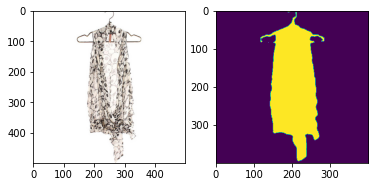

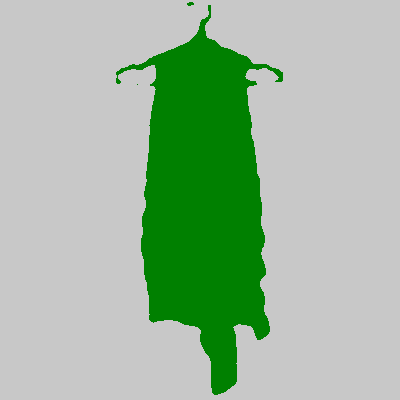

 90%|██████████████████████████████████████████████████████▋      | 807/900 [02:08<00:13,  6.65it/s]

torch.Size([1, 3, 400, 400])
/mnt/nas4/hm/datasets/shopping_clothes/data/data900_personby100/outer/image/train_9401.jpg
{'background': 0, 'top': 1, 'skirt': 2, 'outer': 3, 'dress': 4, 'bottom': 5}
Counter({3: 84770, 0: 75230})


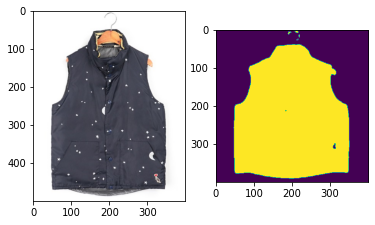

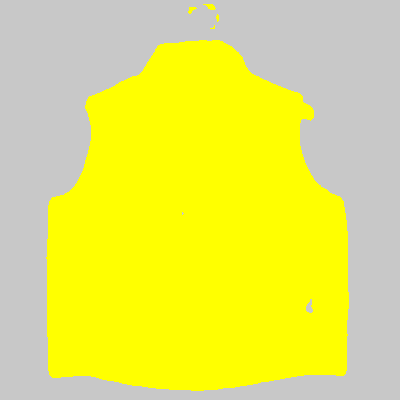

 90%|██████████████████████████████████████████████████████▊      | 808/900 [02:08<00:13,  6.76it/s]

torch.Size([1, 3, 400, 400])
/mnt/nas4/hm/datasets/shopping_clothes/data/data900_personby100/skirt/image/train_2929.jpg
{'background': 0, 'top': 1, 'skirt': 2, 'outer': 3, 'dress': 4, 'bottom': 5}
Counter({0: 107014, 2: 52986})


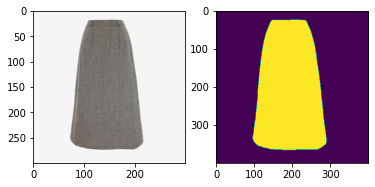

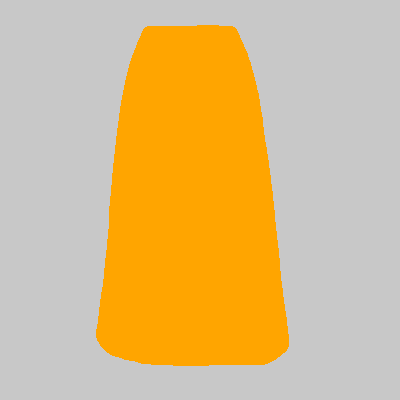

 90%|██████████████████████████████████████████████████████▊      | 809/900 [02:08<00:13,  6.98it/s]

torch.Size([1, 3, 400, 400])
/mnt/nas4/hm/datasets/shopping_clothes/data/data900_personby100/dress/image/train_3816.jpg
{'background': 0, 'top': 1, 'skirt': 2, 'outer': 3, 'dress': 4, 'bottom': 5}
Counter({0: 120840, 4: 39160})


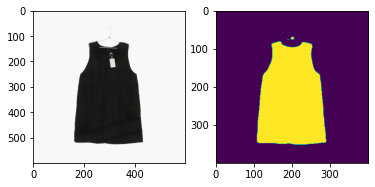

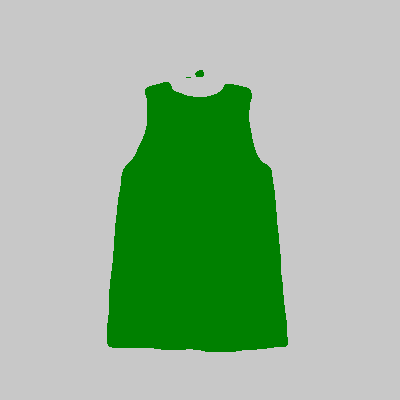

 90%|██████████████████████████████████████████████████████▉      | 810/900 [02:08<00:13,  6.86it/s]

torch.Size([1, 3, 400, 400])
/mnt/nas4/hm/datasets/shopping_clothes/data/data900_personby100/top/image/train_6308.jpg
{'background': 0, 'top': 1, 'skirt': 2, 'outer': 3, 'dress': 4, 'bottom': 5}
Counter({0: 112609, 1: 47391})


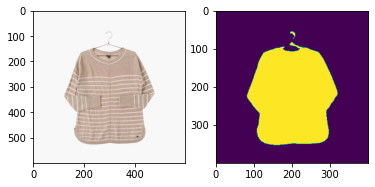

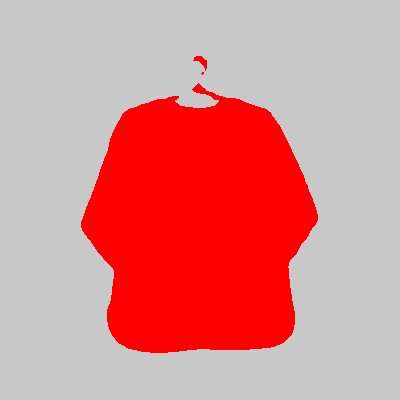

 90%|██████████████████████████████████████████████████████▉      | 811/900 [02:08<00:14,  6.03it/s]

torch.Size([1, 3, 400, 400])
/mnt/nas4/hm/datasets/shopping_clothes/data/data900_personby100/outer/image/train_6145.jpg
{'background': 0, 'top': 1, 'skirt': 2, 'outer': 3, 'dress': 4, 'bottom': 5}
Counter({3: 95975, 0: 64025})


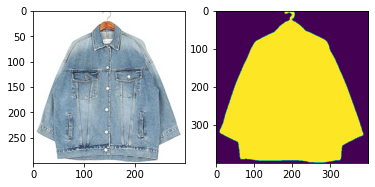

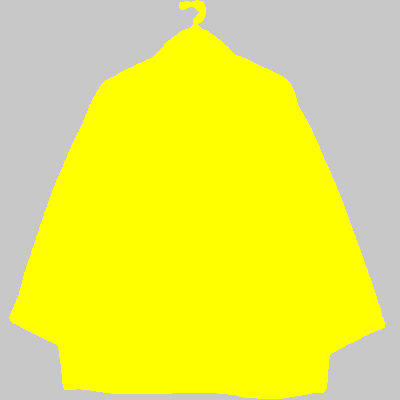

 90%|███████████████████████████████████████████████████████      | 812/900 [02:08<00:13,  6.39it/s]

torch.Size([1, 3, 400, 400])
/mnt/nas4/hm/datasets/shopping_clothes/data/data900_personby100/skirt/image/train_1299.jpg
{'background': 0, 'top': 1, 'skirt': 2, 'outer': 3, 'dress': 4, 'bottom': 5}
Counter({0: 95738, 2: 64262})


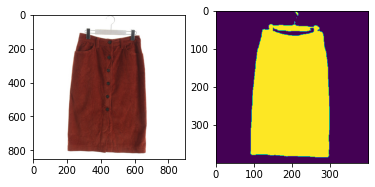

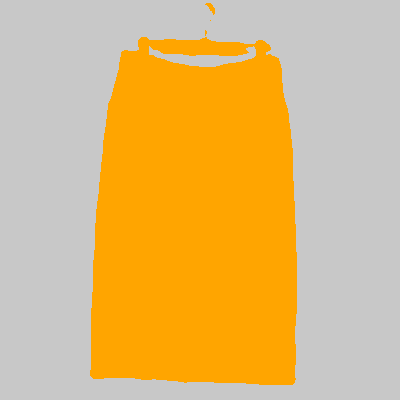

 90%|███████████████████████████████████████████████████████      | 813/900 [02:09<00:14,  6.04it/s]

torch.Size([1, 3, 400, 400])
/mnt/nas4/hm/datasets/shopping_clothes/data/data900_personby100/top/image/train_7582.jpg
{'background': 0, 'top': 1, 'skirt': 2, 'outer': 3, 'dress': 4, 'bottom': 5}
Counter({0: 101225, 1: 58775})


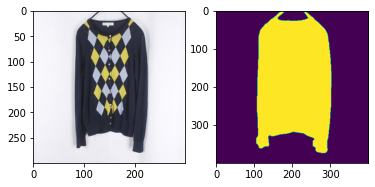

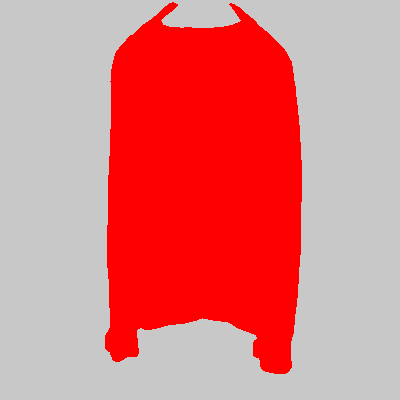

 90%|███████████████████████████████████████████████████████▏     | 814/900 [02:09<00:13,  6.40it/s]

torch.Size([1, 3, 400, 400])
/mnt/nas4/hm/datasets/shopping_clothes/data/data900_personby100/top/image/train_16646.jpg
{'background': 0, 'top': 1, 'skirt': 2, 'outer': 3, 'dress': 4, 'bottom': 5}
Counter({0: 101816, 1: 58184})


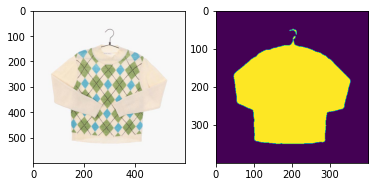

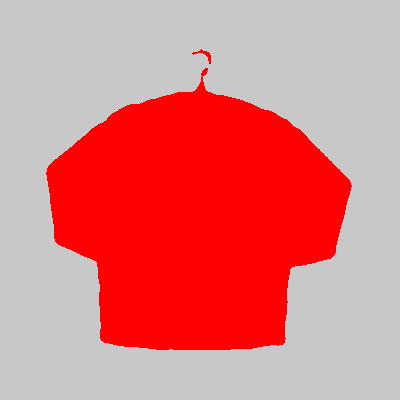

 91%|███████████████████████████████████████████████████████▏     | 815/900 [02:09<00:13,  6.45it/s]

torch.Size([1, 3, 400, 400])
/mnt/nas4/hm/datasets/shopping_clothes/data/data900_personby100/skirt/image/train_2297.jpg
{'background': 0, 'top': 1, 'skirt': 2, 'outer': 3, 'dress': 4, 'bottom': 5}
Counter({0: 81479, 2: 78521})


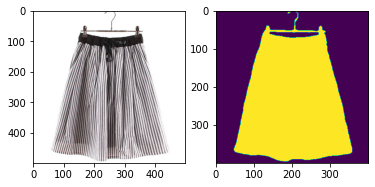

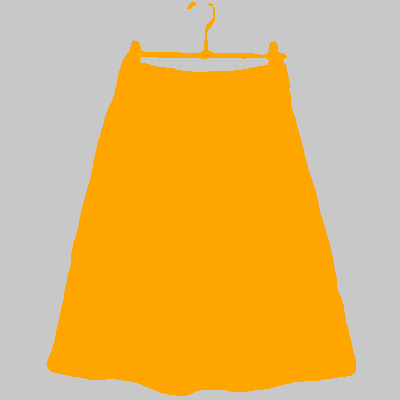

 91%|███████████████████████████████████████████████████████▎     | 816/900 [02:09<00:12,  6.58it/s]

torch.Size([1, 3, 400, 400])
/mnt/nas4/hm/datasets/shopping_clothes/data/data900_personby100/skirt/image/train_968.jpg
{'background': 0, 'top': 1, 'skirt': 2, 'outer': 3, 'dress': 4, 'bottom': 5}
Counter({0: 103947, 2: 56053})


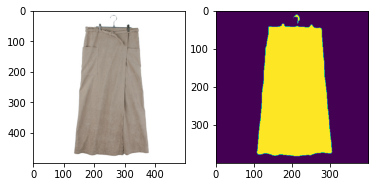

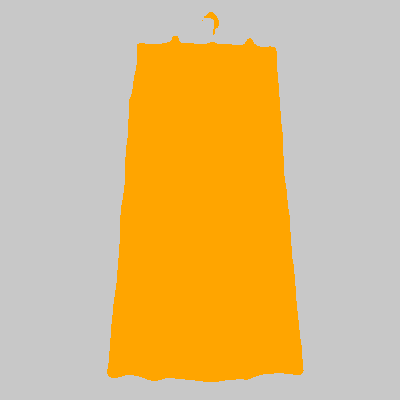

 91%|███████████████████████████████████████████████████████▎     | 817/900 [02:09<00:12,  6.64it/s]

torch.Size([1, 3, 400, 400])
/mnt/nas4/hm/datasets/shopping_clothes/data/data900_personby100/skirt/image/train_2937.jpg
{'background': 0, 'top': 1, 'skirt': 2, 'outer': 3, 'dress': 4, 'bottom': 5}
Counter({0: 103854, 2: 56146})


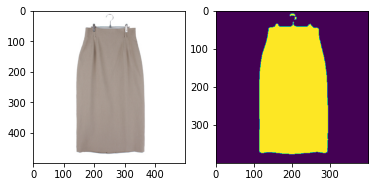

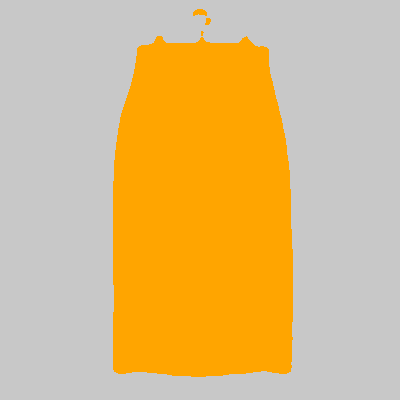

 91%|███████████████████████████████████████████████████████▍     | 818/900 [02:09<00:12,  6.70it/s]

torch.Size([1, 3, 400, 400])
/mnt/nas4/hm/datasets/shopping_clothes/data/data900_personby100/dress/image/train_3180.jpg
{'background': 0, 'top': 1, 'skirt': 2, 'outer': 3, 'dress': 4, 'bottom': 5}
Counter({0: 124386, 4: 35614})


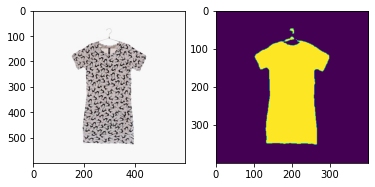

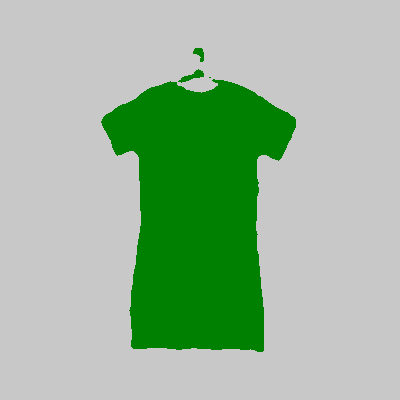

 91%|███████████████████████████████████████████████████████▌     | 819/900 [02:09<00:12,  6.70it/s]

torch.Size([1, 3, 400, 400])
/mnt/nas4/hm/datasets/shopping_clothes/data/data900_personby100/top/image/train_4829.jpg
{'background': 0, 'top': 1, 'skirt': 2, 'outer': 3, 'dress': 4, 'bottom': 5}
Counter({0: 86069, 1: 73931})


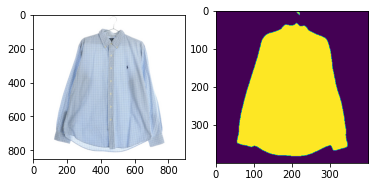

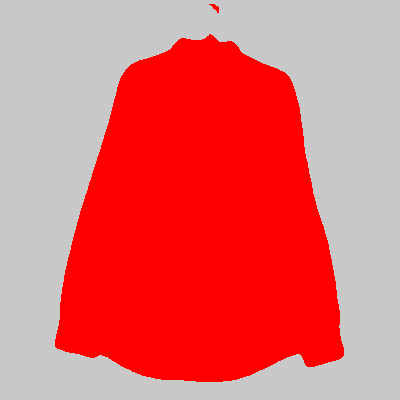

 91%|███████████████████████████████████████████████████████▌     | 820/900 [02:10<00:12,  6.17it/s]

torch.Size([1, 3, 400, 400])
/mnt/nas4/hm/datasets/shopping_clothes/data/data900_personby100/top/image/train_12056.jpg
{'background': 0, 'top': 1, 'skirt': 2, 'outer': 3, 'dress': 4, 'bottom': 5}
Counter({0: 92246, 1: 67754})


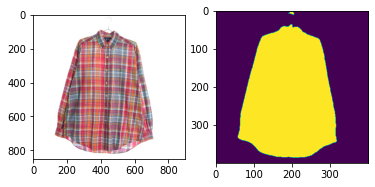

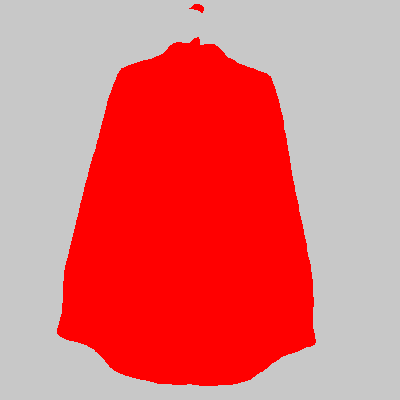

 91%|███████████████████████████████████████████████████████▋     | 821/900 [02:10<00:13,  5.92it/s]

torch.Size([1, 3, 400, 400])
/mnt/nas4/hm/datasets/shopping_clothes/data/data900_personby100/dress/image/train_3364.jpg
{'background': 0, 'top': 1, 'skirt': 2, 'outer': 3, 'dress': 4, 'bottom': 5}
Counter({0: 103455, 4: 56545})


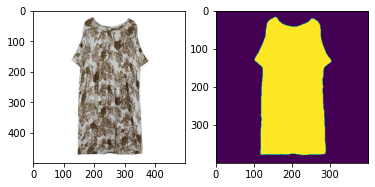

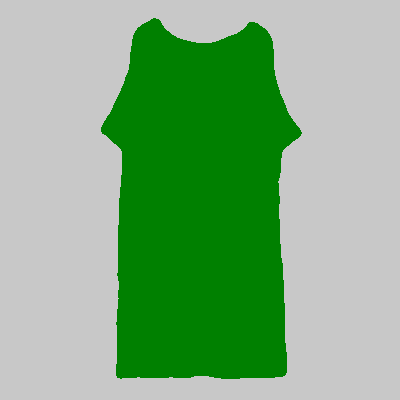

 91%|███████████████████████████████████████████████████████▋     | 822/900 [02:10<00:14,  5.50it/s]

torch.Size([1, 3, 400, 400])
/mnt/nas4/hm/datasets/shopping_clothes/data/data900_personby100/outer/image/train_6053.jpg
{'background': 0, 'top': 1, 'skirt': 2, 'outer': 3, 'dress': 4, 'bottom': 5}
Counter({0: 84205, 3: 75795})


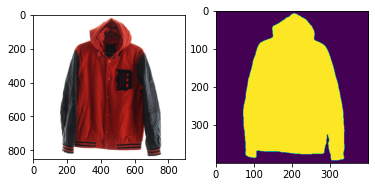

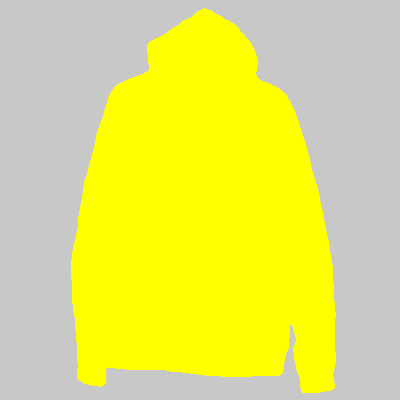

 91%|███████████████████████████████████████████████████████▊     | 823/900 [02:10<00:14,  5.40it/s]

torch.Size([1, 3, 400, 400])
/mnt/nas4/hm/datasets/shopping_clothes/data/data900_personby100/bottom/image/train_2191.jpg
{'background': 0, 'top': 1, 'skirt': 2, 'outer': 3, 'dress': 4, 'bottom': 5}
Counter({0: 97186, 5: 62710, 3: 104})


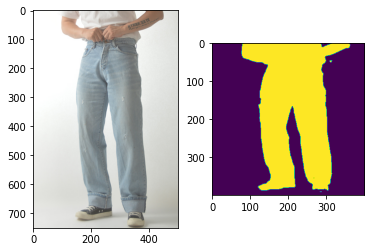

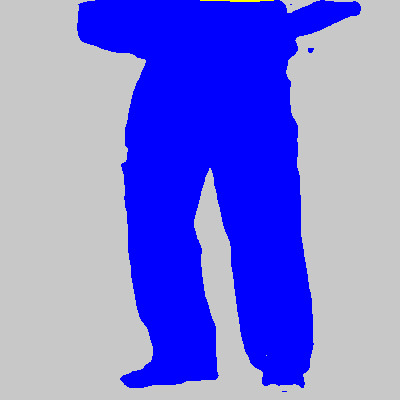

 92%|███████████████████████████████████████████████████████▊     | 824/900 [02:10<00:13,  5.56it/s]

torch.Size([1, 3, 400, 400])
/mnt/nas4/hm/datasets/shopping_clothes/data/data900_personby100/top/image/train_6533.jpg
{'background': 0, 'top': 1, 'skirt': 2, 'outer': 3, 'dress': 4, 'bottom': 5}
Counter({0: 103265, 1: 56735})


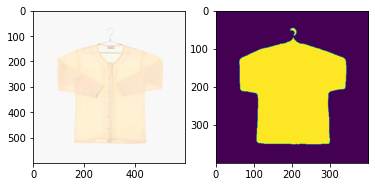

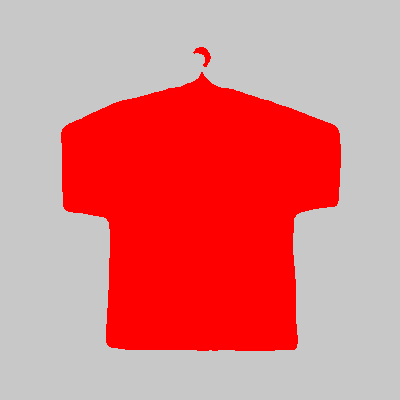

 92%|███████████████████████████████████████████████████████▉     | 825/900 [02:11<00:12,  5.84it/s]

torch.Size([1, 3, 400, 400])
/mnt/nas4/hm/datasets/shopping_clothes/data/data900_personby100/skirt/image/train_261.jpg
{'background': 0, 'top': 1, 'skirt': 2, 'outer': 3, 'dress': 4, 'bottom': 5}
Counter({0: 106525, 2: 53475})


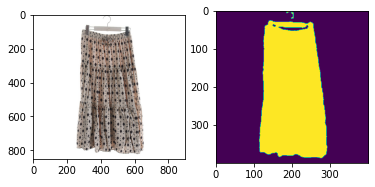

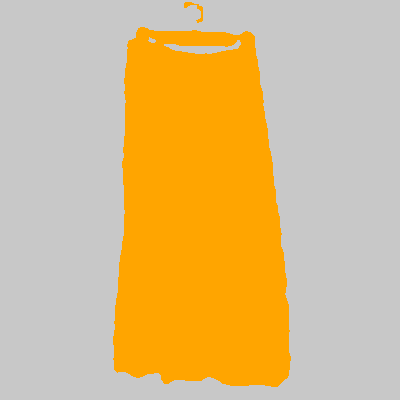

 92%|███████████████████████████████████████████████████████▉     | 826/900 [02:11<00:12,  5.72it/s]

torch.Size([1, 3, 400, 400])
/mnt/nas4/hm/datasets/shopping_clothes/data/data900_personby100/bottom/image/train_1819.jpg
{'background': 0, 'top': 1, 'skirt': 2, 'outer': 3, 'dress': 4, 'bottom': 5}
Counter({0: 125095, 5: 34905})


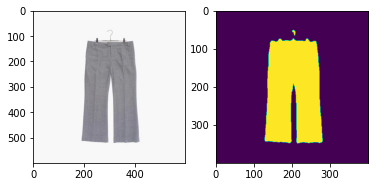

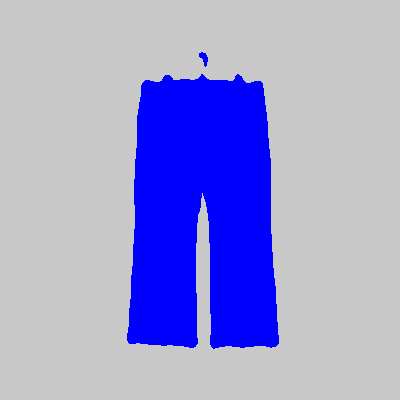

 92%|████████████████████████████████████████████████████████     | 827/900 [02:11<00:12,  5.98it/s]

torch.Size([1, 3, 400, 400])
/mnt/nas4/hm/datasets/shopping_clothes/data/data900_personby100/outer/image/train_1323.jpg
{'background': 0, 'top': 1, 'skirt': 2, 'outer': 3, 'dress': 4, 'bottom': 5}
Counter({0: 95325, 3: 64675})


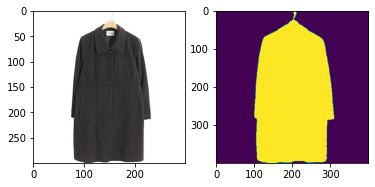

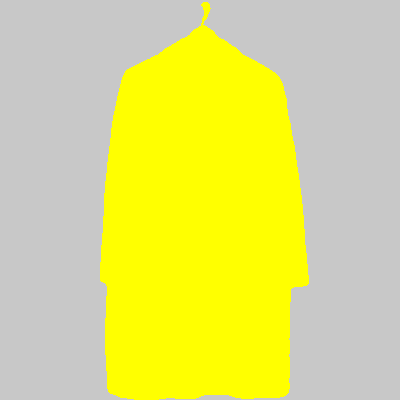

 92%|████████████████████████████████████████████████████████     | 828/900 [02:11<00:11,  6.34it/s]

torch.Size([1, 3, 400, 400])
/mnt/nas4/hm/datasets/shopping_clothes/data/data900_personby100/outer/image/train_11267.jpg
{'background': 0, 'top': 1, 'skirt': 2, 'outer': 3, 'dress': 4, 'bottom': 5}
Counter({0: 121947, 3: 38053})


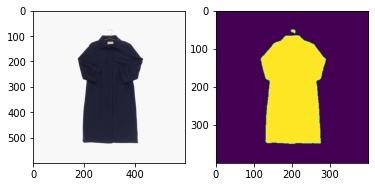

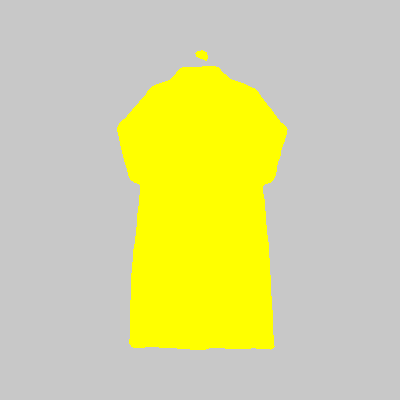

 92%|████████████████████████████████████████████████████████▏    | 829/900 [02:11<00:11,  6.43it/s]

torch.Size([1, 3, 400, 400])
/mnt/nas4/hm/datasets/shopping_clothes/data/data900_personby100/bottom/image/train_198.jpg
{'background': 0, 'top': 1, 'skirt': 2, 'outer': 3, 'dress': 4, 'bottom': 5}
Counter({0: 90565, 5: 69435})


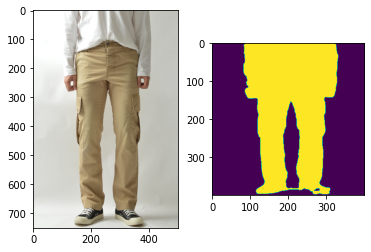

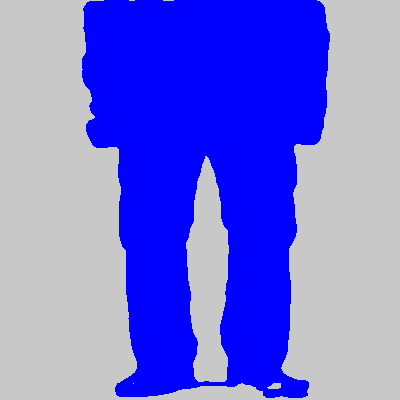

 92%|████████████████████████████████████████████████████████▎    | 830/900 [02:11<00:11,  6.28it/s]

torch.Size([1, 3, 400, 400])
/mnt/nas4/hm/datasets/shopping_clothes/data/data900_personby100/bottom/image/train_3557.jpg
{'background': 0, 'top': 1, 'skirt': 2, 'outer': 3, 'dress': 4, 'bottom': 5}
Counter({0: 111784, 5: 48216})


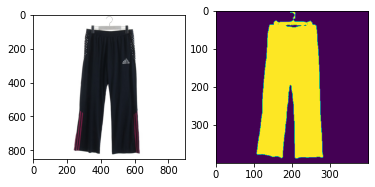

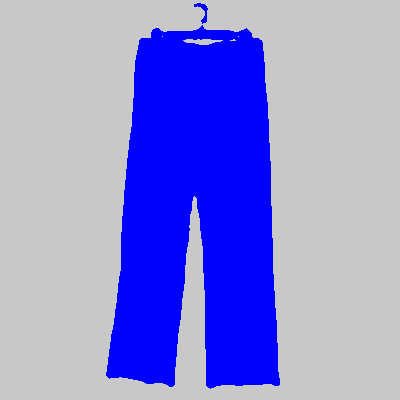

 92%|████████████████████████████████████████████████████████▎    | 831/900 [02:11<00:11,  6.01it/s]

torch.Size([1, 3, 400, 400])
/mnt/nas4/hm/datasets/shopping_clothes/data/data900_personby100/bottom/image/train_3347.jpg
{'background': 0, 'top': 1, 'skirt': 2, 'outer': 3, 'dress': 4, 'bottom': 5}
Counter({0: 127232, 5: 32768})


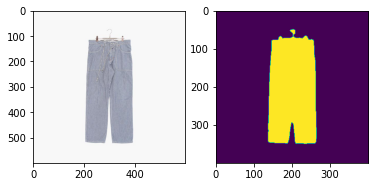

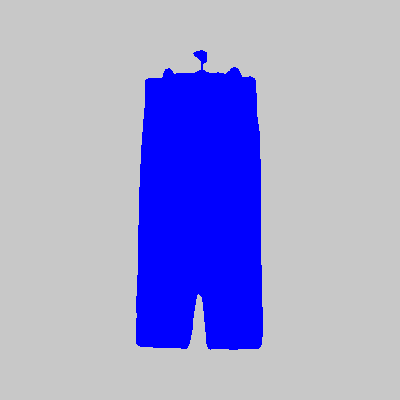

 92%|████████████████████████████████████████████████████████▍    | 832/900 [02:12<00:10,  6.18it/s]

torch.Size([1, 3, 400, 400])
/mnt/nas4/hm/datasets/shopping_clothes/data/data900_personby100/skirt/image/train_778.jpg
{'background': 0, 'top': 1, 'skirt': 2, 'outer': 3, 'dress': 4, 'bottom': 5}
Counter({0: 107794, 2: 52206})


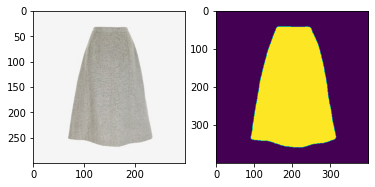

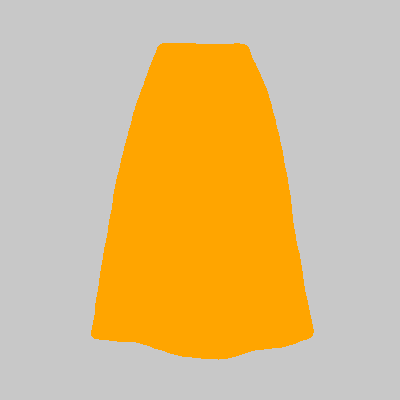

 93%|████████████████████████████████████████████████████████▍    | 833/900 [02:12<00:11,  5.82it/s]

torch.Size([1, 3, 400, 400])
/mnt/nas4/hm/datasets/shopping_clothes/data/data900_personby100/dress/image/train_2251.jpg
{'background': 0, 'top': 1, 'skirt': 2, 'outer': 3, 'dress': 4, 'bottom': 5}
Counter({0: 111320, 4: 48680})


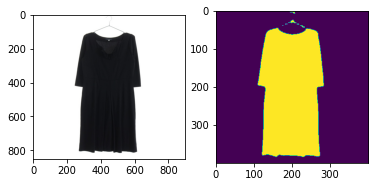

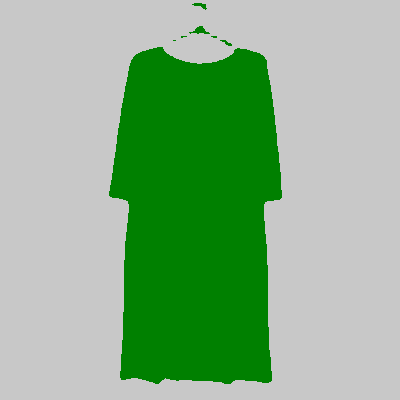

 93%|████████████████████████████████████████████████████████▌    | 834/900 [02:12<00:11,  5.71it/s]

torch.Size([1, 3, 400, 400])
/mnt/nas4/hm/datasets/shopping_clothes/data/data900_personby100/outer/image/train_2311.jpg
{'background': 0, 'top': 1, 'skirt': 2, 'outer': 3, 'dress': 4, 'bottom': 5}
Counter({3: 103706, 0: 56294})


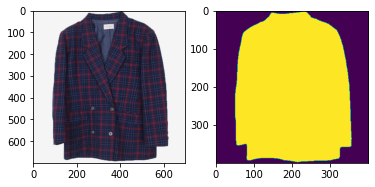

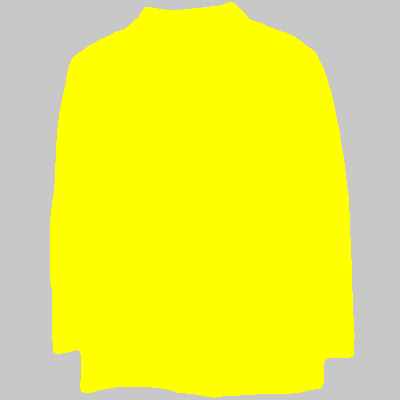

 93%|████████████████████████████████████████████████████████▌    | 835/900 [02:12<00:11,  5.76it/s]

torch.Size([1, 3, 400, 400])
/mnt/nas4/hm/datasets/shopping_clothes/data/data900_personby100/outer/image/train_5846.jpg
{'background': 0, 'top': 1, 'skirt': 2, 'outer': 3, 'dress': 4, 'bottom': 5}
Counter({0: 95292, 3: 64708})


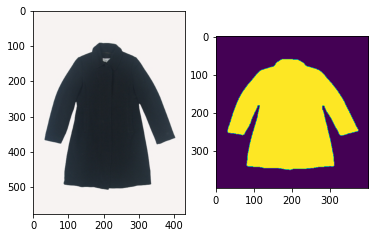

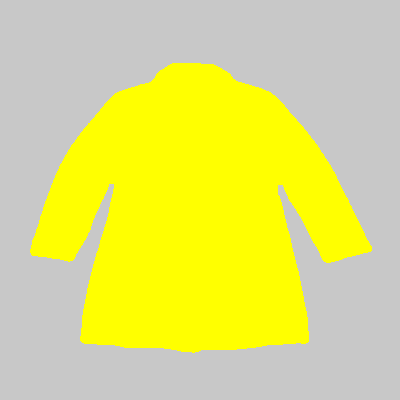

 93%|████████████████████████████████████████████████████████▋    | 836/900 [02:12<00:10,  6.01it/s]

torch.Size([1, 3, 400, 400])
/mnt/nas4/hm/datasets/shopping_clothes/data/data900_personby100/bottom/image/train_1544.jpg
{'background': 0, 'top': 1, 'skirt': 2, 'outer': 3, 'dress': 4, 'bottom': 5}
Counter({0: 95525, 5: 64475})


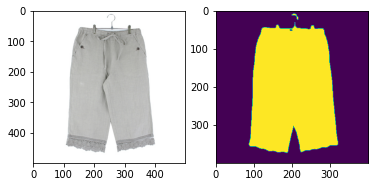

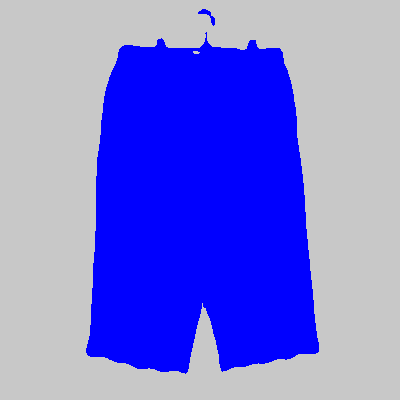

 93%|████████████████████████████████████████████████████████▋    | 837/900 [02:12<00:10,  6.19it/s]

torch.Size([1, 3, 400, 400])
/mnt/nas4/hm/datasets/shopping_clothes/data/data900_personby100/top/image/train_845.jpg
{'background': 0, 'top': 1, 'skirt': 2, 'outer': 3, 'dress': 4, 'bottom': 5}
Counter({0: 89212, 1: 70788})


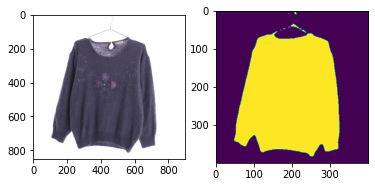

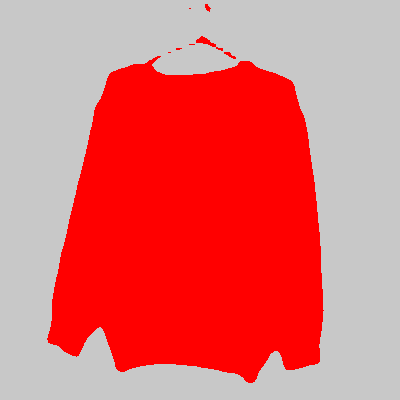

 93%|████████████████████████████████████████████████████████▊    | 838/900 [02:13<00:10,  5.91it/s]

torch.Size([1, 3, 400, 400])
/mnt/nas4/hm/datasets/shopping_clothes/data/data900_personby100/outer/image/train_3563.jpg
{'background': 0, 'top': 1, 'skirt': 2, 'outer': 3, 'dress': 4, 'bottom': 5}
Counter({3: 81583, 0: 78417})


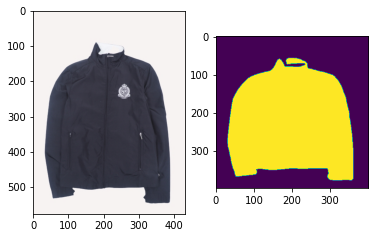

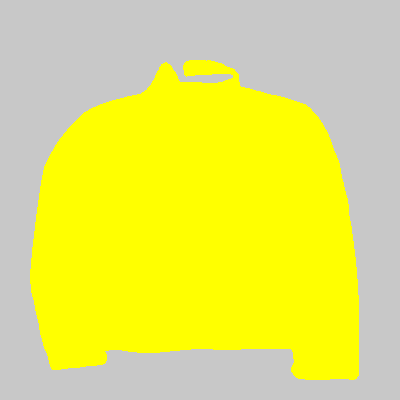

 93%|████████████████████████████████████████████████████████▊    | 839/900 [02:13<00:09,  6.12it/s]

torch.Size([1, 3, 400, 400])
/mnt/nas4/hm/datasets/shopping_clothes/data/data900_personby100/dress/image/train_355.jpg
{'background': 0, 'top': 1, 'skirt': 2, 'outer': 3, 'dress': 4, 'bottom': 5}
Counter({0: 139622, 4: 20378})


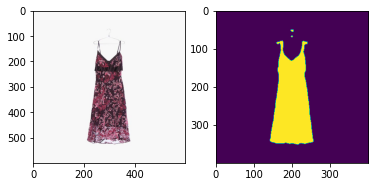

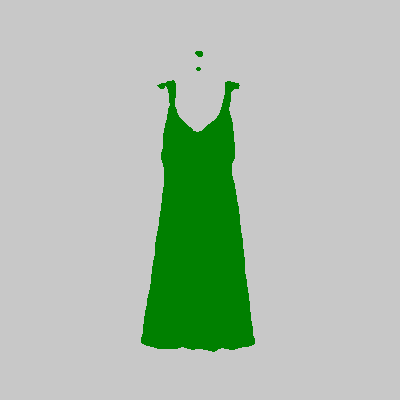

 93%|████████████████████████████████████████████████████████▉    | 840/900 [02:13<00:09,  6.29it/s]

torch.Size([1, 3, 400, 400])
/mnt/nas4/hm/datasets/shopping_clothes/data/data900_personby100/top/image/train_11197.jpg
{'background': 0, 'top': 1, 'skirt': 2, 'outer': 3, 'dress': 4, 'bottom': 5}
Counter({0: 80584, 1: 79416})


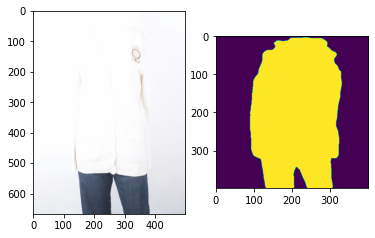

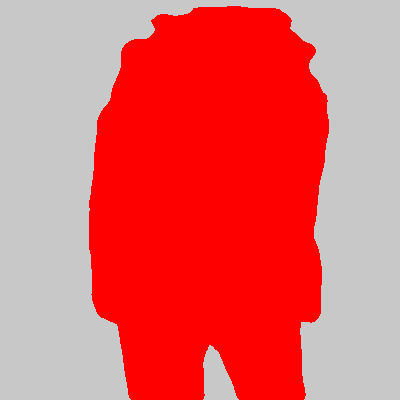

 93%|█████████████████████████████████████████████████████████    | 841/900 [02:13<00:09,  6.23it/s]

torch.Size([1, 3, 400, 400])
/mnt/nas4/hm/datasets/shopping_clothes/data/data900_personby100/bottom/image/train_1681.jpg
{'background': 0, 'top': 1, 'skirt': 2, 'outer': 3, 'dress': 4, 'bottom': 5}
Counter({0: 94771, 5: 65229})


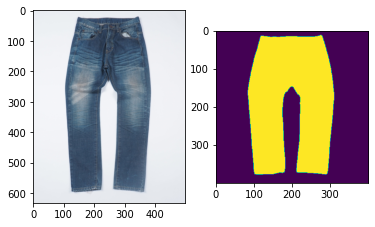

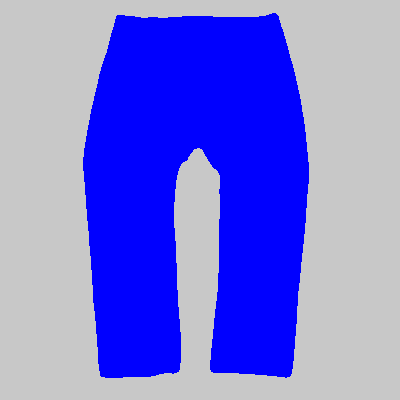

 94%|█████████████████████████████████████████████████████████    | 842/900 [02:13<00:09,  6.26it/s]

torch.Size([1, 3, 400, 400])
/mnt/nas4/hm/datasets/shopping_clothes/data/data900_personby100/bottom/image/train_1221.jpg
{'background': 0, 'top': 1, 'skirt': 2, 'outer': 3, 'dress': 4, 'bottom': 5}
Counter({0: 106172, 5: 53828})


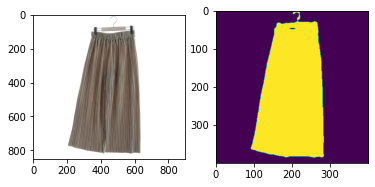

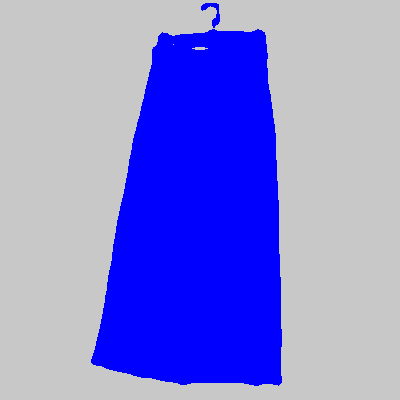

 94%|█████████████████████████████████████████████████████████▏   | 843/900 [02:13<00:09,  6.01it/s]

torch.Size([1, 3, 400, 400])
/mnt/nas4/hm/datasets/shopping_clothes/data/data900_personby100/dress/image/train_566.jpg
{'background': 0, 'top': 1, 'skirt': 2, 'outer': 3, 'dress': 4, 'bottom': 5}
Counter({0: 111358, 4: 48642})


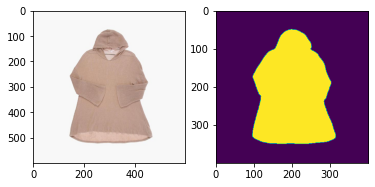

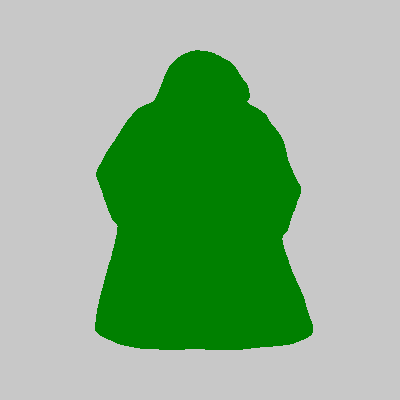

 94%|█████████████████████████████████████████████████████████▏   | 844/900 [02:14<00:10,  5.53it/s]

torch.Size([1, 3, 400, 400])
/mnt/nas4/hm/datasets/shopping_clothes/data/data900_personby100/dress/image/train_3278.jpg
{'background': 0, 'top': 1, 'skirt': 2, 'outer': 3, 'dress': 4, 'bottom': 5}
Counter({0: 107800, 4: 52200})


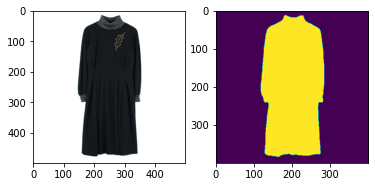

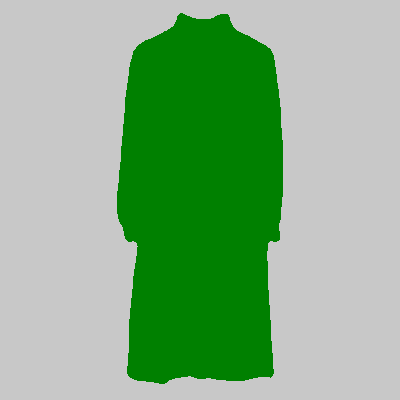

 94%|█████████████████████████████████████████████████████████▎   | 845/900 [02:14<00:09,  5.86it/s]

torch.Size([1, 3, 400, 400])
/mnt/nas4/hm/datasets/shopping_clothes/data/data900_personby100/skirt/image/train_774.jpg
{'background': 0, 'top': 1, 'skirt': 2, 'outer': 3, 'dress': 4, 'bottom': 5}
Counter({0: 81379, 2: 78621})


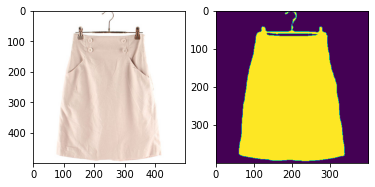

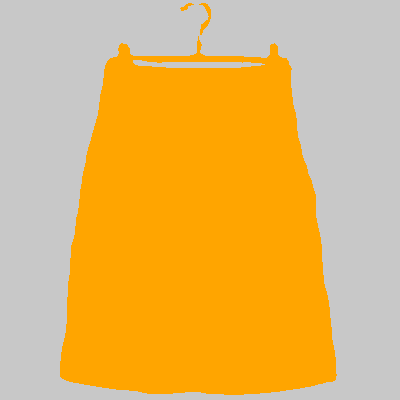

 94%|█████████████████████████████████████████████████████████▎   | 846/900 [02:14<00:08,  6.13it/s]

torch.Size([1, 3, 400, 400])
/mnt/nas4/hm/datasets/shopping_clothes/data/data900_personby100/top/image/train_18203.jpg
{'background': 0, 'top': 1, 'skirt': 2, 'outer': 3, 'dress': 4, 'bottom': 5}
Counter({0: 98107, 1: 61893})


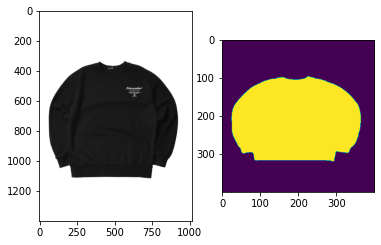

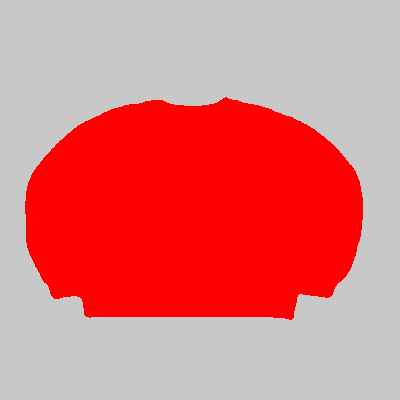

 94%|█████████████████████████████████████████████████████████▍   | 847/900 [02:14<00:09,  5.39it/s]

torch.Size([1, 3, 400, 400])
/mnt/nas4/hm/datasets/shopping_clothes/data/data900_personby100/dress/image/train_70.jpg
{'background': 0, 'top': 1, 'skirt': 2, 'outer': 3, 'dress': 4, 'bottom': 5}
Counter({0: 109979, 4: 50021})


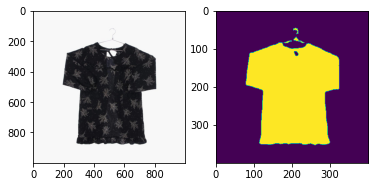

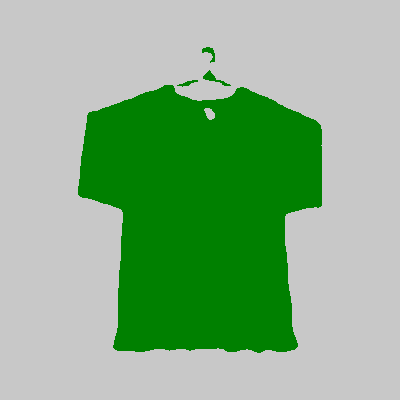

 94%|█████████████████████████████████████████████████████████▍   | 848/900 [02:14<00:09,  5.28it/s]

torch.Size([1, 3, 400, 400])
/mnt/nas4/hm/datasets/shopping_clothes/data/data900_personby100/bottom/image/train_1750.jpg
{'background': 0, 'top': 1, 'skirt': 2, 'outer': 3, 'dress': 4, 'bottom': 5}
Counter({0: 104915, 5: 55085})


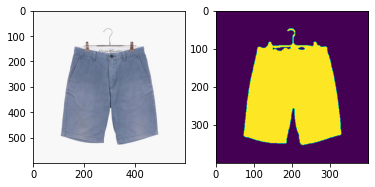

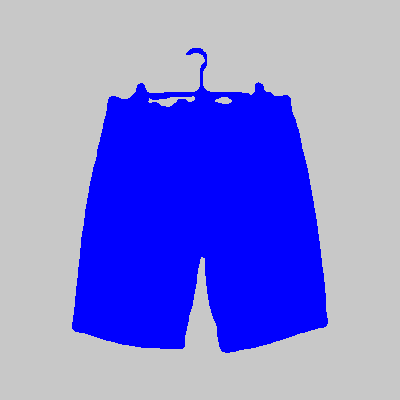

 94%|█████████████████████████████████████████████████████████▌   | 849/900 [02:15<00:09,  5.60it/s]

torch.Size([1, 3, 400, 400])
/mnt/nas4/hm/datasets/shopping_clothes/data/data900_personby100/dress/image/train_2004.jpg
{'background': 0, 'top': 1, 'skirt': 2, 'outer': 3, 'dress': 4, 'bottom': 5}
Counter({0: 104989, 4: 55011})


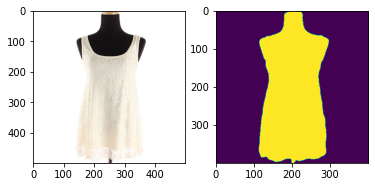

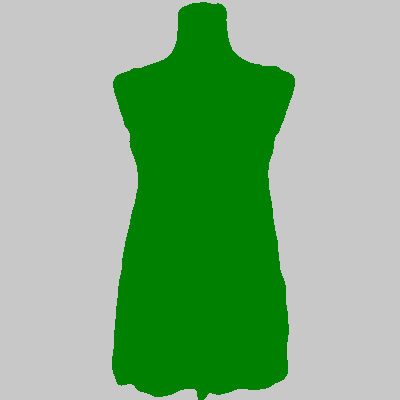

 94%|█████████████████████████████████████████████████████████▌   | 850/900 [02:15<00:08,  5.94it/s]

torch.Size([1, 3, 400, 400])
/mnt/nas4/hm/datasets/shopping_clothes/data/data900_personby100/skirt/image/train_2619.jpg
{'background': 0, 'top': 1, 'skirt': 2, 'outer': 3, 'dress': 4, 'bottom': 5}
Counter({0: 99343, 2: 60657})


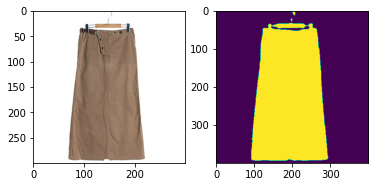

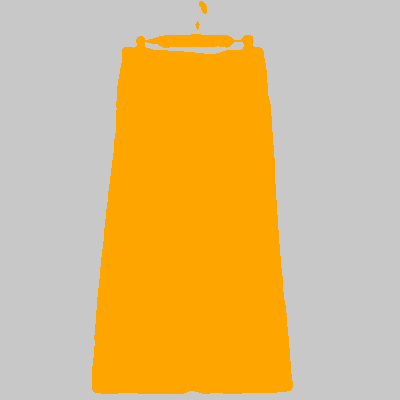

 95%|█████████████████████████████████████████████████████████▋   | 851/900 [02:15<00:07,  6.32it/s]

torch.Size([1, 3, 400, 400])
/mnt/nas4/hm/datasets/shopping_clothes/data/data900_personby100/top/image/train_10581.jpg
{'background': 0, 'top': 1, 'skirt': 2, 'outer': 3, 'dress': 4, 'bottom': 5}
Counter({1: 86059, 0: 73941})


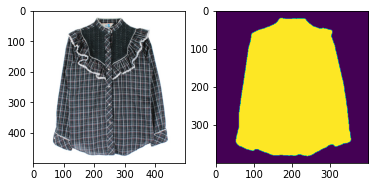

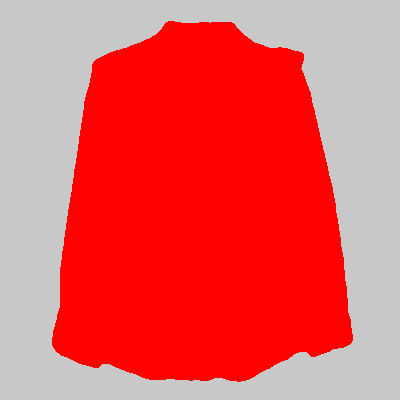

 95%|█████████████████████████████████████████████████████████▋   | 852/900 [02:15<00:07,  6.44it/s]

torch.Size([1, 3, 400, 400])
/mnt/nas4/hm/datasets/shopping_clothes/data/data900_personby100/bottom/image/train_2666.jpg
{'background': 0, 'top': 1, 'skirt': 2, 'outer': 3, 'dress': 4, 'bottom': 5}
Counter({0: 119421, 5: 40579})


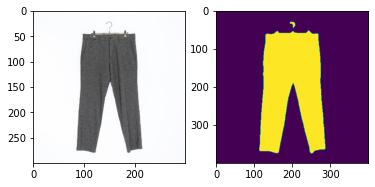

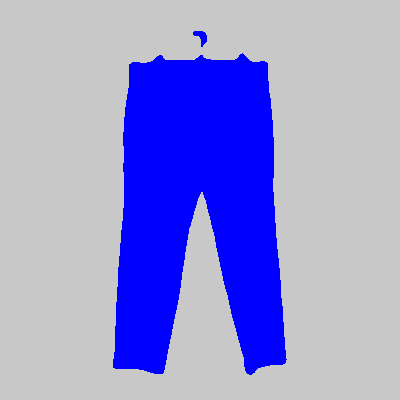

 95%|█████████████████████████████████████████████████████████▊   | 853/900 [02:15<00:06,  6.72it/s]

torch.Size([1, 3, 400, 400])
/mnt/nas4/hm/datasets/shopping_clothes/data/data900_personby100/bottom/image/train_3123.jpg
{'background': 0, 'top': 1, 'skirt': 2, 'outer': 3, 'dress': 4, 'bottom': 5}
Counter({0: 106375, 5: 53625})


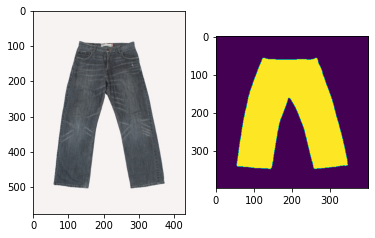

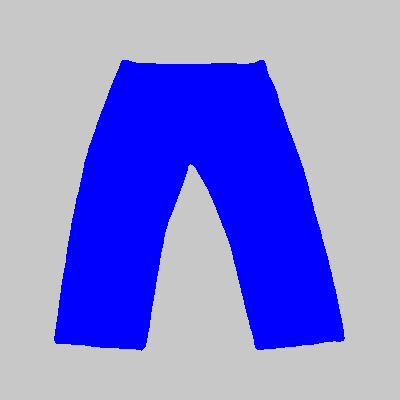

 95%|█████████████████████████████████████████████████████████▉   | 854/900 [02:15<00:06,  6.73it/s]

torch.Size([1, 3, 400, 400])
/mnt/nas4/hm/datasets/shopping_clothes/data/data900_personby100/dress/image/train_2713.jpg
{'background': 0, 'top': 1, 'skirt': 2, 'outer': 3, 'dress': 4, 'bottom': 5}
Counter({0: 119494, 4: 40506})


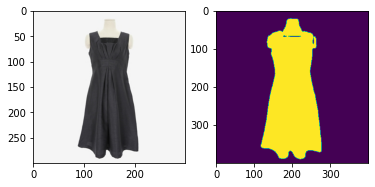

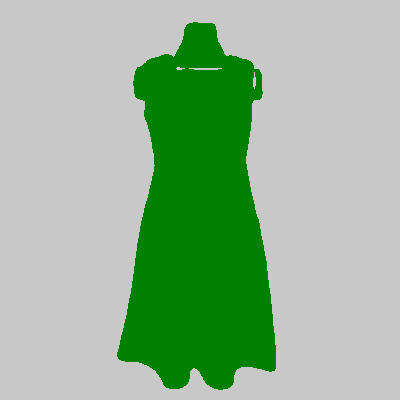

 95%|█████████████████████████████████████████████████████████▉   | 855/900 [02:15<00:07,  6.19it/s]

torch.Size([1, 3, 400, 400])
/mnt/nas4/hm/datasets/shopping_clothes/data/data900_personby100/skirt/image/train_1533.jpg
{'background': 0, 'top': 1, 'skirt': 2, 'outer': 3, 'dress': 4, 'bottom': 5}
Counter({0: 109902, 2: 50098})


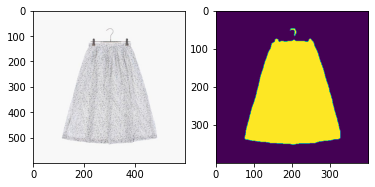

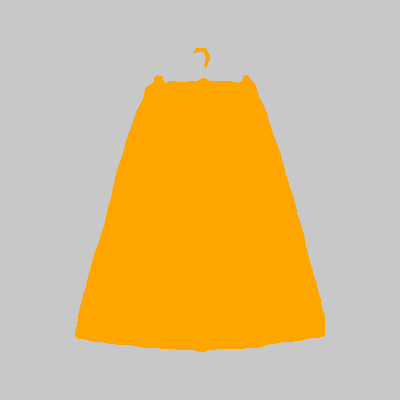

 95%|██████████████████████████████████████████████████████████   | 856/900 [02:16<00:06,  6.30it/s]

torch.Size([1, 3, 400, 400])
/mnt/nas4/hm/datasets/shopping_clothes/data/data900_personby100/top/image/train_18044.jpg
{'background': 0, 'top': 1, 'skirt': 2, 'outer': 3, 'dress': 4, 'bottom': 5}
Counter({1: 80524, 0: 79476})


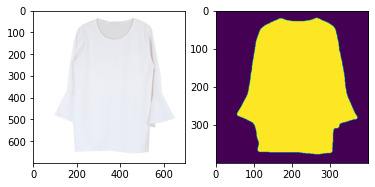

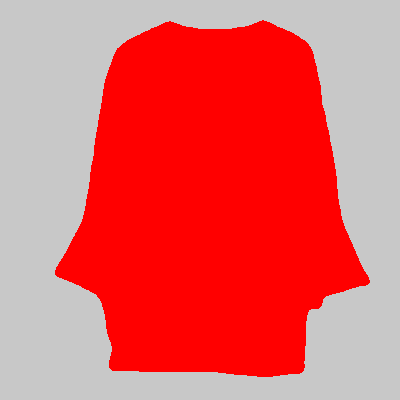

 95%|██████████████████████████████████████████████████████████   | 857/900 [02:16<00:06,  6.19it/s]

torch.Size([1, 3, 400, 400])
/mnt/nas4/hm/datasets/shopping_clothes/data/data900_personby100/skirt/image/train_2073.jpg
{'background': 0, 'top': 1, 'skirt': 2, 'outer': 3, 'dress': 4, 'bottom': 5}
Counter({2: 85576, 0: 74424})


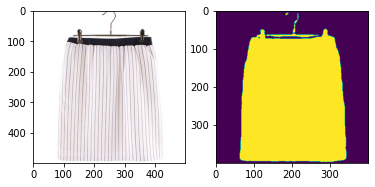

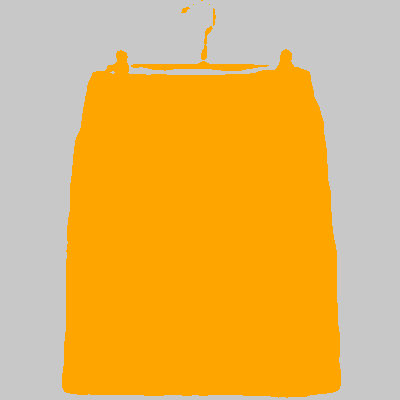

 95%|██████████████████████████████████████████████████████████▏  | 858/900 [02:16<00:06,  6.38it/s]

torch.Size([1, 3, 400, 400])
/mnt/nas4/hm/datasets/shopping_clothes/data/data900_personby100/outer/image/train_1506.jpg
{'background': 0, 'top': 1, 'skirt': 2, 'outer': 3, 'dress': 4, 'bottom': 5}
Counter({0: 92895, 3: 67105})


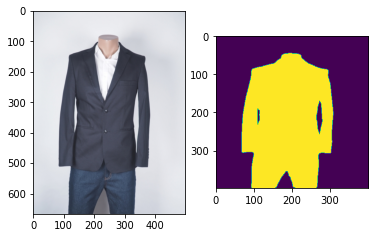

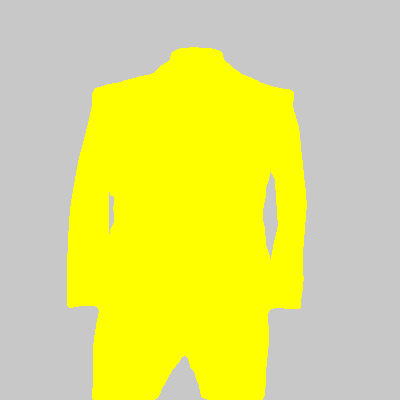

 95%|██████████████████████████████████████████████████████████▏  | 859/900 [02:16<00:06,  6.25it/s]

torch.Size([1, 3, 400, 400])
/mnt/nas4/hm/datasets/shopping_clothes/data/data900_personby100/bottom/image/train_3220.jpg
{'background': 0, 'top': 1, 'skirt': 2, 'outer': 3, 'dress': 4, 'bottom': 5}
Counter({0: 114882, 5: 45118})


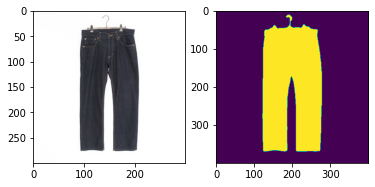

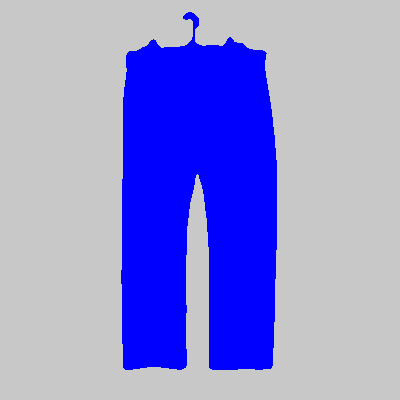

 96%|██████████████████████████████████████████████████████████▎  | 860/900 [02:16<00:06,  6.58it/s]

torch.Size([1, 3, 400, 400])
/mnt/nas4/hm/datasets/shopping_clothes/data/data900_personby100/outer/image/train_3680.jpg
{'background': 0, 'top': 1, 'skirt': 2, 'outer': 3, 'dress': 4, 'bottom': 5}
Counter({0: 100327, 3: 59673})


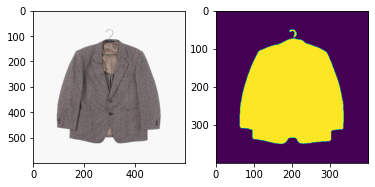

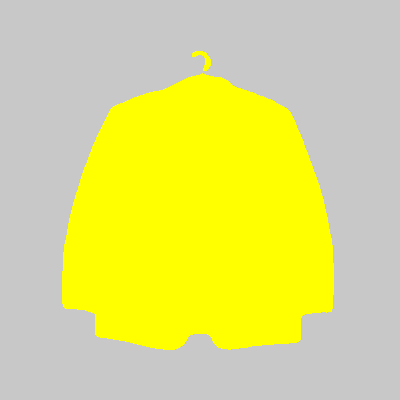

 96%|██████████████████████████████████████████████████████████▎  | 861/900 [02:16<00:05,  6.56it/s]

torch.Size([1, 3, 400, 400])
/mnt/nas4/hm/datasets/shopping_clothes/data/data900_personby100/skirt/image/train_270.jpg
{'background': 0, 'top': 1, 'skirt': 2, 'outer': 3, 'dress': 4, 'bottom': 5}
Counter({0: 94117, 2: 65883})


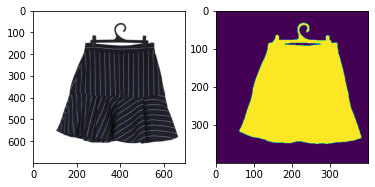

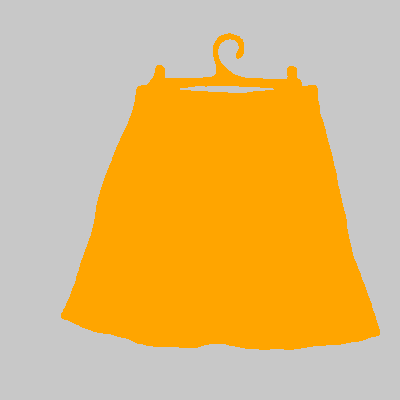

 96%|██████████████████████████████████████████████████████████▍  | 862/900 [02:17<00:05,  6.42it/s]

torch.Size([1, 3, 400, 400])
/mnt/nas4/hm/datasets/shopping_clothes/data/data900_personby100/bottom/image/train_3574.jpg
{'background': 0, 'top': 1, 'skirt': 2, 'outer': 3, 'dress': 4, 'bottom': 5}
Counter({0: 114466, 5: 45534})


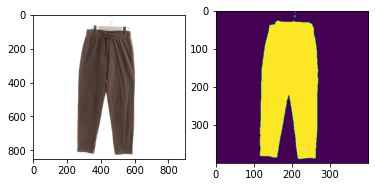

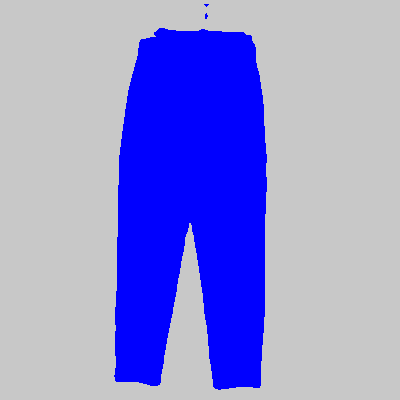

 96%|██████████████████████████████████████████████████████████▍  | 863/900 [02:17<00:06,  6.06it/s]

torch.Size([1, 3, 400, 400])
/mnt/nas4/hm/datasets/shopping_clothes/data/data900_personby100/dress/image/train_2376.jpg
{'background': 0, 'top': 1, 'skirt': 2, 'outer': 3, 'dress': 4, 'bottom': 5}
Counter({0: 102276, 4: 57724})


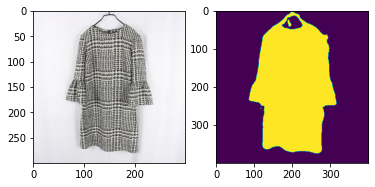

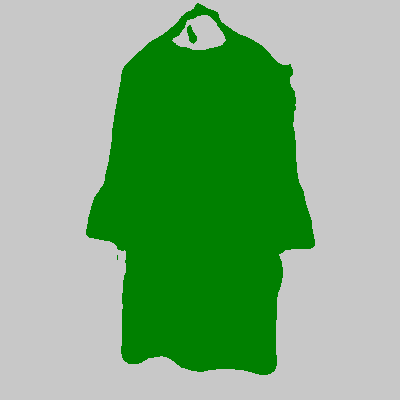

 96%|██████████████████████████████████████████████████████████▌  | 864/900 [02:17<00:05,  6.43it/s]

torch.Size([1, 3, 400, 400])
/mnt/nas4/hm/datasets/shopping_clothes/data/data900_personby100/bottom/image/train_120.jpg
{'background': 0, 'top': 1, 'skirt': 2, 'outer': 3, 'dress': 4, 'bottom': 5}
Counter({0: 113110, 5: 46890})


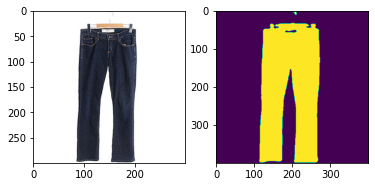

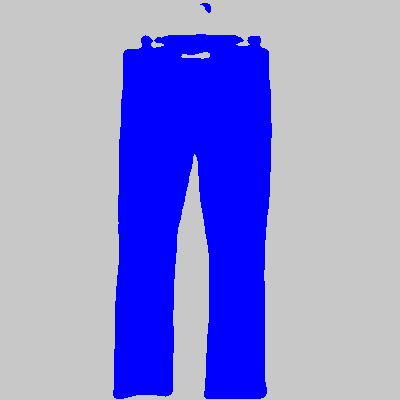

 96%|██████████████████████████████████████████████████████████▋  | 865/900 [02:17<00:05,  6.71it/s]

torch.Size([1, 3, 400, 400])
/mnt/nas4/hm/datasets/shopping_clothes/data/data900_personby100/top/image/train_10916.jpg
{'background': 0, 'top': 1, 'skirt': 2, 'outer': 3, 'dress': 4, 'bottom': 5}
Counter({0: 109958, 1: 50042})


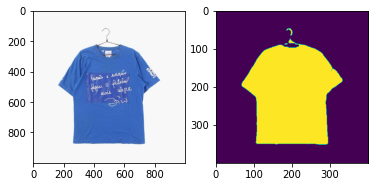

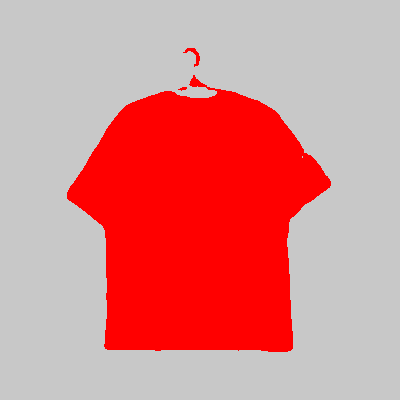

 96%|██████████████████████████████████████████████████████████▋  | 866/900 [02:17<00:06,  5.51it/s]

torch.Size([1, 3, 400, 400])
/mnt/nas4/hm/datasets/shopping_clothes/data/data900_personby100/outer/image/train_7540.jpg
{'background': 0, 'top': 1, 'skirt': 2, 'outer': 3, 'dress': 4, 'bottom': 5}
Counter({0: 84452, 3: 75548})


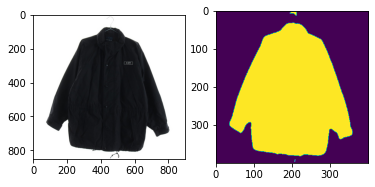

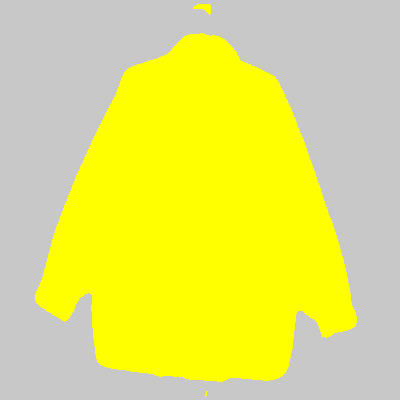

 96%|██████████████████████████████████████████████████████████▊  | 867/900 [02:17<00:06,  5.45it/s]

torch.Size([1, 3, 400, 400])
/mnt/nas4/hm/datasets/shopping_clothes/data/data900_personby100/outer/image/train_1697.jpg
{'background': 0, 'top': 1, 'skirt': 2, 'outer': 3, 'dress': 4, 'bottom': 5}
Counter({0: 91202, 3: 68798})


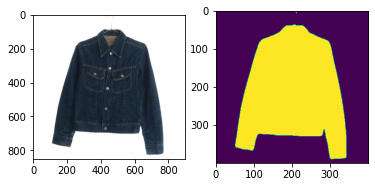

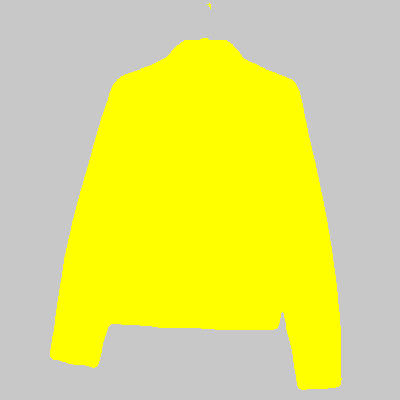

 96%|██████████████████████████████████████████████████████████▊  | 868/900 [02:18<00:05,  5.47it/s]

torch.Size([1, 3, 400, 400])
/mnt/nas4/hm/datasets/shopping_clothes/data/data900_personby100/top/image/train_16756.jpg
{'background': 0, 'top': 1, 'skirt': 2, 'outer': 3, 'dress': 4, 'bottom': 5}
Counter({0: 93640, 1: 66360})


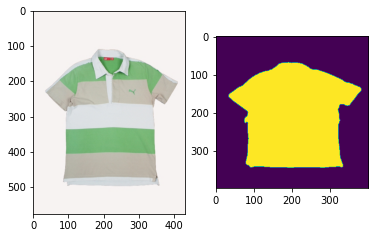

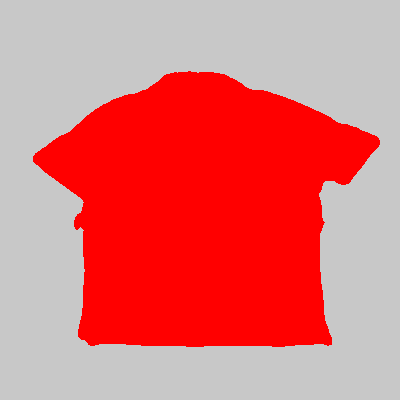

 97%|██████████████████████████████████████████████████████████▉  | 869/900 [02:18<00:05,  5.79it/s]

torch.Size([1, 3, 400, 400])
/mnt/nas4/hm/datasets/shopping_clothes/data/data900_personby100/skirt/image/train_1243.jpg
{'background': 0, 'top': 1, 'skirt': 2, 'outer': 3, 'dress': 4, 'bottom': 5}
Counter({2: 97895, 0: 62105})


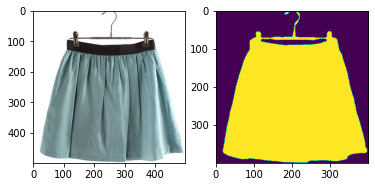

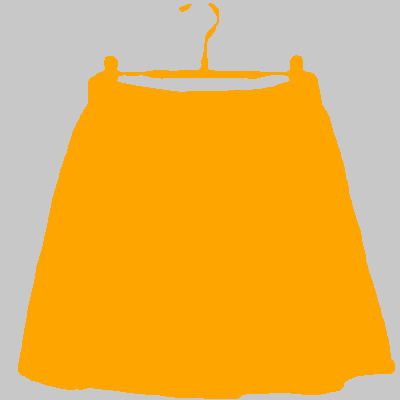

 97%|██████████████████████████████████████████████████████████▉  | 870/900 [02:18<00:04,  6.07it/s]

torch.Size([1, 3, 400, 400])
/mnt/nas4/hm/datasets/shopping_clothes/data/data900_personby100/dress/image/train_662.jpg
{'background': 0, 'top': 1, 'skirt': 2, 'outer': 3, 'dress': 4, 'bottom': 5}
Counter({0: 125496, 4: 34504})


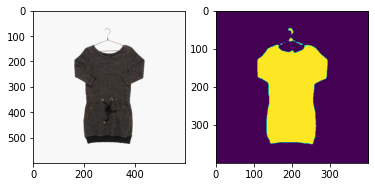

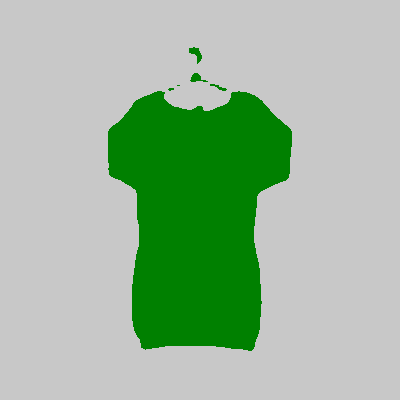

 97%|███████████████████████████████████████████████████████████  | 871/900 [02:18<00:04,  6.25it/s]

torch.Size([1, 3, 400, 400])
/mnt/nas4/hm/datasets/shopping_clothes/data/data900_personby100/top/image/train_10967.jpg
{'background': 0, 'top': 1, 'skirt': 2, 'outer': 3, 'dress': 4, 'bottom': 5}
Counter({0: 83276, 1: 76724})


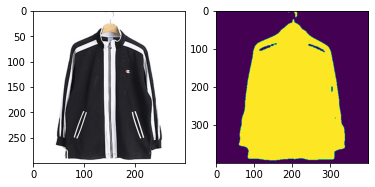

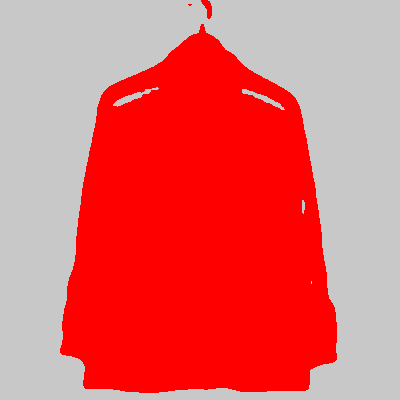

 97%|███████████████████████████████████████████████████████████  | 872/900 [02:18<00:04,  6.56it/s]

torch.Size([1, 3, 400, 400])
/mnt/nas4/hm/datasets/shopping_clothes/data/data900_personby100/top/image/train_15341.jpg
{'background': 0, 'top': 1, 'skirt': 2, 'outer': 3, 'dress': 4, 'bottom': 5}
Counter({0: 88059, 1: 71941})


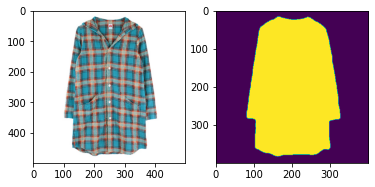

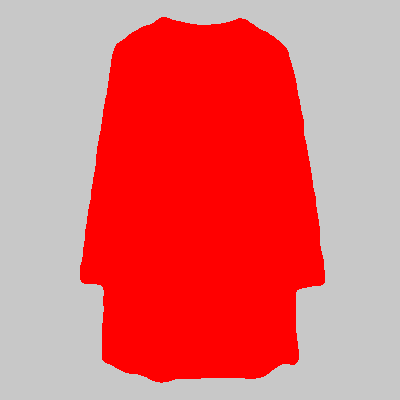

 97%|███████████████████████████████████████████████████████████▏ | 873/900 [02:18<00:04,  6.61it/s]

torch.Size([1, 3, 400, 400])
/mnt/nas4/hm/datasets/shopping_clothes/data/data900_personby100/dress/image/train_891.jpg
{'background': 0, 'top': 1, 'skirt': 2, 'outer': 3, 'dress': 4, 'bottom': 5}
Counter({0: 127486, 4: 32514})


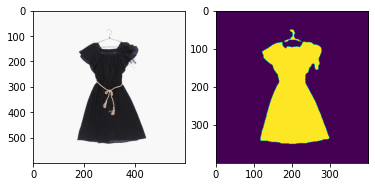

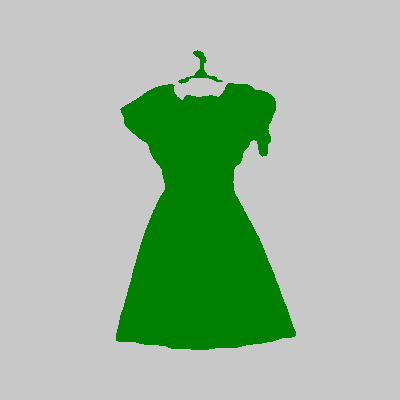

 97%|███████████████████████████████████████████████████████████▏ | 874/900 [02:19<00:03,  6.64it/s]

torch.Size([1, 3, 400, 400])
/mnt/nas4/hm/datasets/shopping_clothes/data/data900_personby100/skirt/image/train_824.jpg
{'background': 0, 'top': 1, 'skirt': 2, 'outer': 3, 'dress': 4, 'bottom': 5}
Counter({0: 112894, 2: 47106})


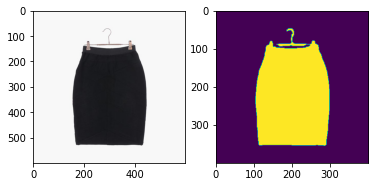

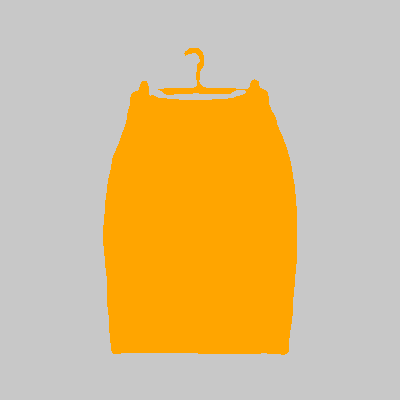

 97%|███████████████████████████████████████████████████████████▎ | 875/900 [02:19<00:03,  6.67it/s]

torch.Size([1, 3, 400, 400])
/mnt/nas4/hm/datasets/shopping_clothes/data/data900_personby100/bottom/image/train_2029.jpg
{'background': 0, 'top': 1, 'skirt': 2, 'outer': 3, 'dress': 4, 'bottom': 5}
Counter({0: 104439, 5: 55561})


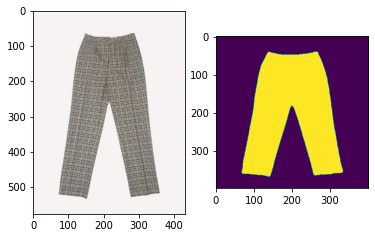

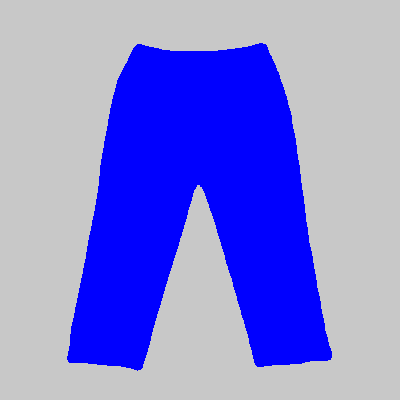

 97%|███████████████████████████████████████████████████████████▎ | 876/900 [02:19<00:03,  6.70it/s]

torch.Size([1, 3, 400, 400])
/mnt/nas4/hm/datasets/shopping_clothes/data/data900_personby100/outer/image/train_8082.jpg
{'background': 0, 'top': 1, 'skirt': 2, 'outer': 3, 'dress': 4, 'bottom': 5}
Counter({3: 98405, 0: 61595})


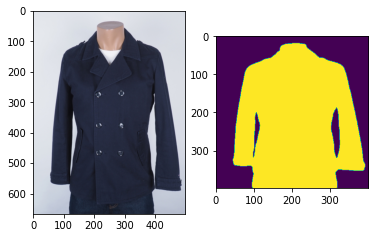

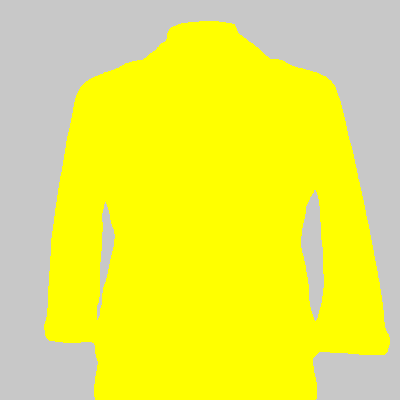

 97%|███████████████████████████████████████████████████████████▍ | 877/900 [02:19<00:03,  5.82it/s]

torch.Size([1, 3, 400, 400])
/mnt/nas4/hm/datasets/shopping_clothes/data/data900_personby100/top/image/train_9694.jpg
{'background': 0, 'top': 1, 'skirt': 2, 'outer': 3, 'dress': 4, 'bottom': 5}
Counter({0: 82612, 1: 77388})


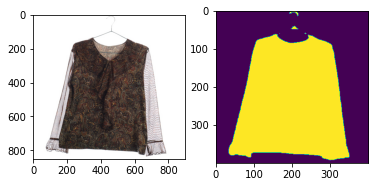

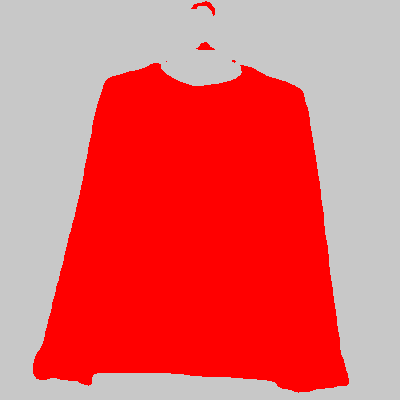

 98%|███████████████████████████████████████████████████████████▌ | 878/900 [02:19<00:03,  5.58it/s]

torch.Size([1, 3, 400, 400])
/mnt/nas4/hm/datasets/shopping_clothes/data/data900_personby100/skirt/image/train_1255.jpg
{'background': 0, 'top': 1, 'skirt': 2, 'outer': 3, 'dress': 4, 'bottom': 5}
Counter({2: 80499, 0: 79501})


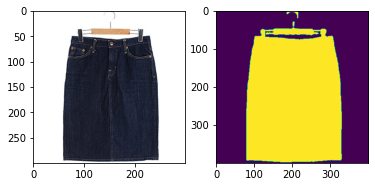

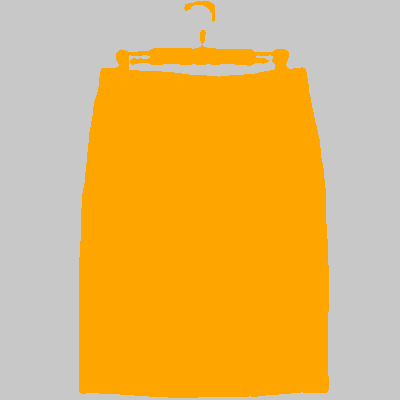

 98%|███████████████████████████████████████████████████████████▌ | 879/900 [02:19<00:03,  6.01it/s]

torch.Size([1, 3, 400, 400])
/mnt/nas4/hm/datasets/shopping_clothes/data/data900_personby100/outer/image/train_9818.jpg
{'background': 0, 'top': 1, 'skirt': 2, 'outer': 3, 'dress': 4, 'bottom': 5}
Counter({0: 94604, 3: 65396})


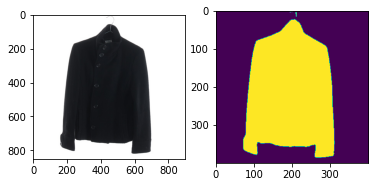

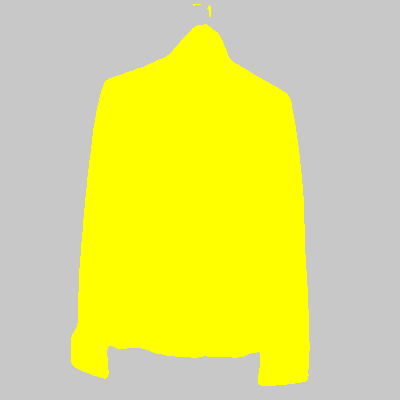

 98%|███████████████████████████████████████████████████████████▋ | 880/900 [02:20<00:03,  5.80it/s]

torch.Size([1, 3, 400, 400])
/mnt/nas4/hm/datasets/shopping_clothes/data/data900_personby100/skirt/image/train_1239.jpg
{'background': 0, 'top': 1, 'skirt': 2, 'outer': 3, 'dress': 4, 'bottom': 5}
Counter({2: 82437, 0: 77563})


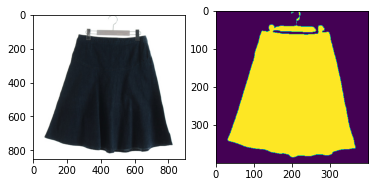

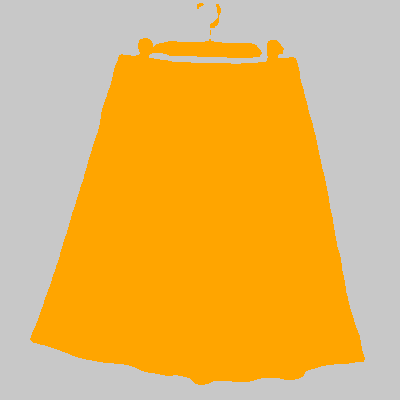

 98%|███████████████████████████████████████████████████████████▋ | 881/900 [02:20<00:03,  5.64it/s]

torch.Size([1, 3, 400, 400])
/mnt/nas4/hm/datasets/shopping_clothes/data/data900_personby100/dress/image/train_977.jpg
{'background': 0, 'top': 1, 'skirt': 2, 'outer': 3, 'dress': 4, 'bottom': 5}
Counter({0: 114701, 4: 45299})


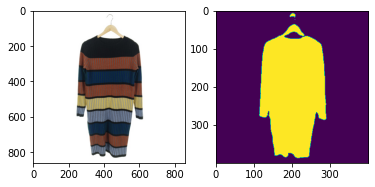

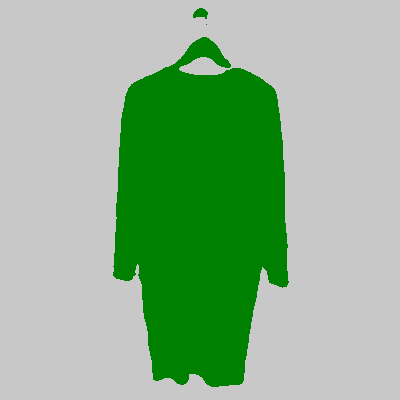

 98%|███████████████████████████████████████████████████████████▊ | 882/900 [02:20<00:03,  5.59it/s]

torch.Size([1, 3, 400, 400])
/mnt/nas4/hm/datasets/shopping_clothes/data/data900_personby100/top/image/train_5255.jpg
{'background': 0, 'top': 1, 'skirt': 2, 'outer': 3, 'dress': 4, 'bottom': 5}
Counter({0: 103926, 1: 56074})


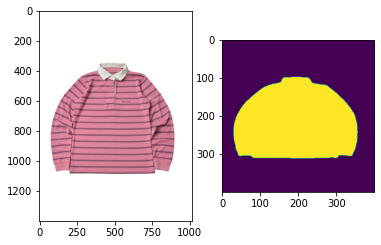

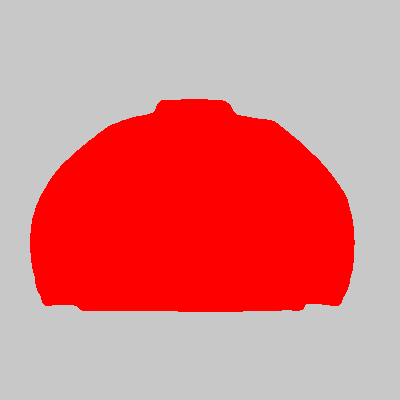

 98%|███████████████████████████████████████████████████████████▊ | 883/900 [02:20<00:03,  5.13it/s]

torch.Size([1, 3, 400, 400])
/mnt/nas4/hm/datasets/shopping_clothes/data/data900_personby100/skirt/image/train_2717.jpg
{'background': 0, 'top': 1, 'skirt': 2, 'outer': 3, 'dress': 4, 'bottom': 5}
Counter({0: 94692, 2: 65308})


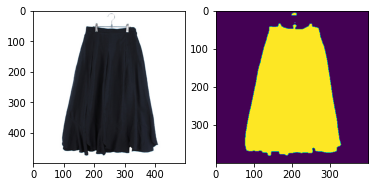

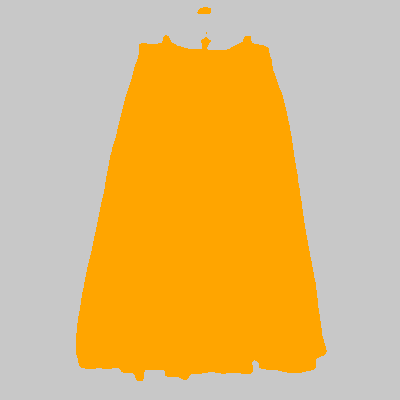

 98%|███████████████████████████████████████████████████████████▉ | 884/900 [02:20<00:02,  5.51it/s]

torch.Size([1, 3, 400, 400])
/mnt/nas4/hm/datasets/shopping_clothes/data/data900_personby100/bottom/image/train_3474.jpg
{'background': 0, 'top': 1, 'skirt': 2, 'outer': 3, 'dress': 4, 'bottom': 5}
Counter({0: 104305, 5: 55695})


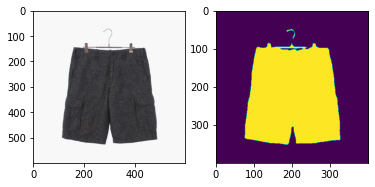

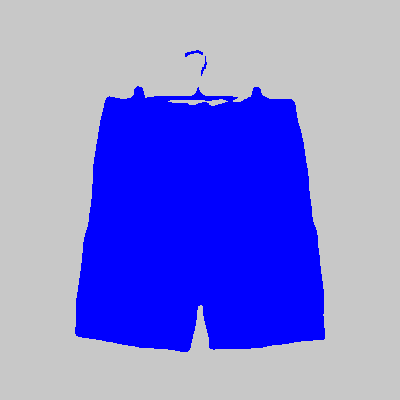

 98%|███████████████████████████████████████████████████████████▉ | 885/900 [02:20<00:02,  5.80it/s]

torch.Size([1, 3, 400, 400])
/mnt/nas4/hm/datasets/shopping_clothes/data/data900_personby100/bottom/image/train_889.jpg
{'background': 0, 'top': 1, 'skirt': 2, 'outer': 3, 'dress': 4, 'bottom': 5}
Counter({0: 129148, 5: 30852})


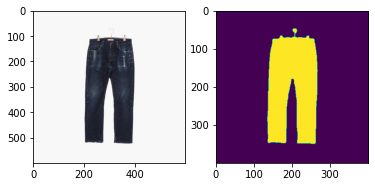

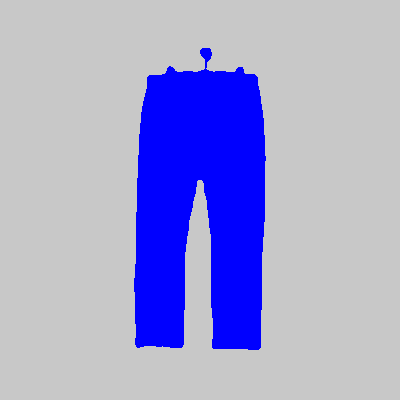

 98%|████████████████████████████████████████████████████████████ | 886/900 [02:21<00:02,  6.03it/s]

torch.Size([1, 3, 400, 400])
/mnt/nas4/hm/datasets/shopping_clothes/data/data900_personby100/dress/image/train_2715.jpg
{'background': 0, 'top': 1, 'skirt': 2, 'outer': 3, 'dress': 4, 'bottom': 5}
Counter({0: 121687, 4: 38313})


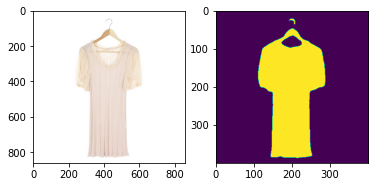

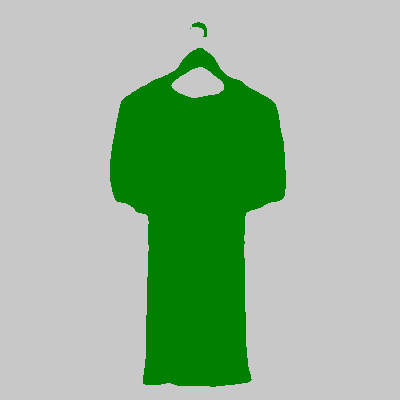

 99%|████████████████████████████████████████████████████████████ | 887/900 [02:21<00:02,  5.88it/s]

torch.Size([1, 3, 400, 400])
/mnt/nas4/hm/datasets/shopping_clothes/data/data900_personby100/dress/image/train_2973.jpg
{'background': 0, 'top': 1, 'skirt': 2, 'outer': 3, 'dress': 4, 'bottom': 5}
Counter({0: 117381, 4: 42619})


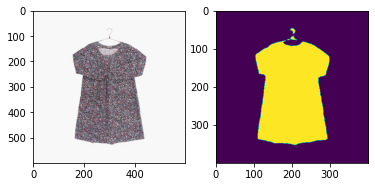

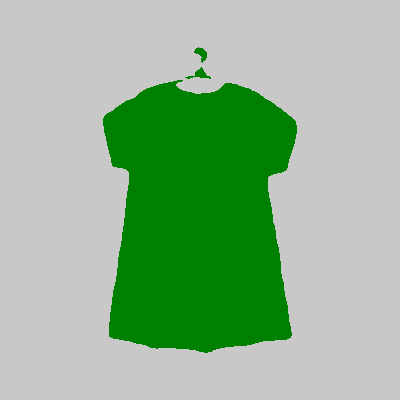

 99%|████████████████████████████████████████████████████████████▏| 888/900 [02:21<00:02,  5.44it/s]

torch.Size([1, 3, 400, 400])
/mnt/nas4/hm/datasets/shopping_clothes/data/data900_personby100/skirt/image/train_388.jpg
{'background': 0, 'top': 1, 'skirt': 2, 'outer': 3, 'dress': 4, 'bottom': 5}
Counter({0: 99723, 2: 60277})


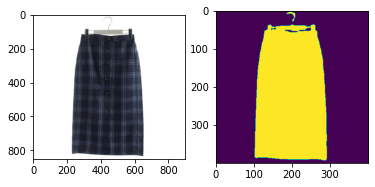

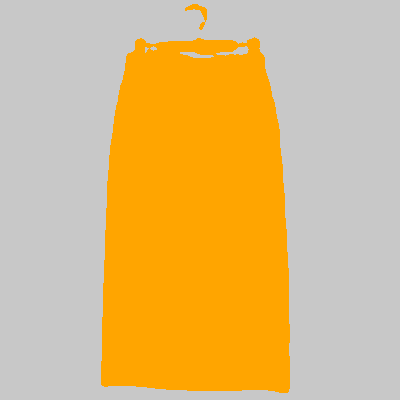

 99%|████████████████████████████████████████████████████████████▎| 889/900 [02:21<00:02,  5.39it/s]

torch.Size([1, 3, 400, 400])
/mnt/nas4/hm/datasets/shopping_clothes/data/data900_personby100/top/image/train_3399.jpg
{'background': 0, 'top': 1, 'skirt': 2, 'outer': 3, 'dress': 4, 'bottom': 5}
Counter({0: 91079, 1: 68921})


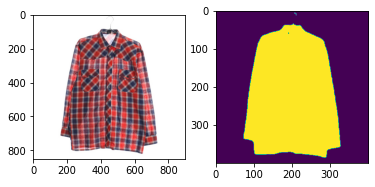

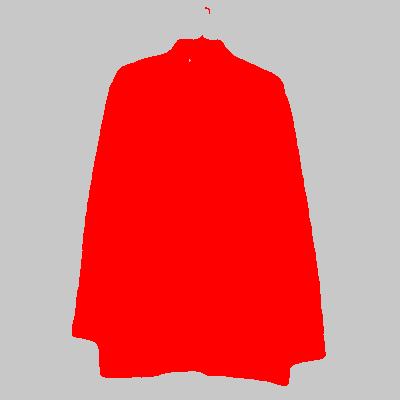

 99%|████████████████████████████████████████████████████████████▎| 890/900 [02:21<00:01,  5.37it/s]

torch.Size([1, 3, 400, 400])
/mnt/nas4/hm/datasets/shopping_clothes/data/data900_personby100/bottom/image/train_1149.jpg
{'background': 0, 'top': 1, 'skirt': 2, 'outer': 3, 'dress': 4, 'bottom': 5}
Counter({0: 98866, 5: 61134})


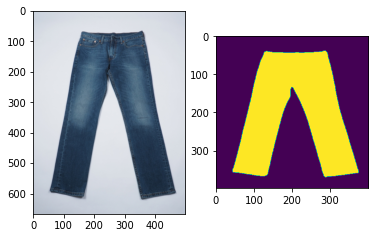

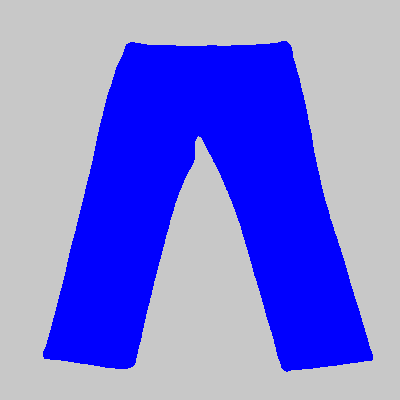

 99%|████████████████████████████████████████████████████████████▍| 891/900 [02:22<00:01,  5.52it/s]

torch.Size([1, 3, 400, 400])
/mnt/nas4/hm/datasets/shopping_clothes/data/data900_personby100/top/image/train_14332.jpg
{'background': 0, 'top': 1, 'skirt': 2, 'outer': 3, 'dress': 4, 'bottom': 5}
Counter({1: 88555, 0: 71445})


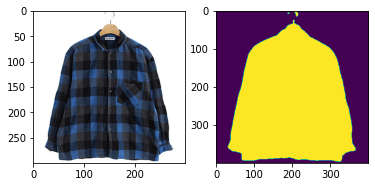

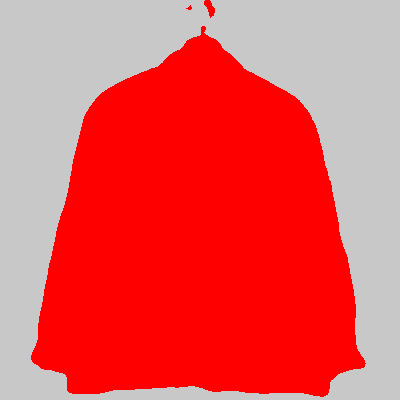

 99%|████████████████████████████████████████████████████████████▍| 892/900 [02:22<00:01,  5.96it/s]

torch.Size([1, 3, 400, 400])
/mnt/nas4/hm/datasets/shopping_clothes/data/data900_personby100/top/image/train_7940.jpg
{'background': 0, 'top': 1, 'skirt': 2, 'outer': 3, 'dress': 4, 'bottom': 5}
Counter({0: 99448, 1: 60552})


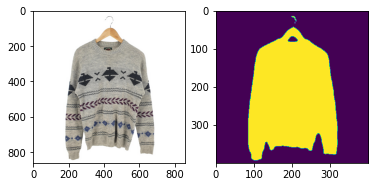

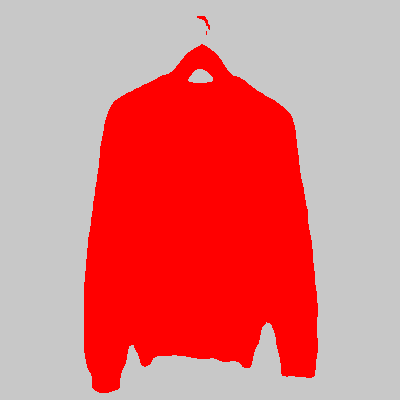

 99%|████████████████████████████████████████████████████████████▌| 893/900 [02:22<00:01,  5.81it/s]

torch.Size([1, 3, 400, 400])
/mnt/nas4/hm/datasets/shopping_clothes/data/data900_personby100/bottom/image/train_1438.jpg
{'background': 0, 'top': 1, 'skirt': 2, 'outer': 3, 'dress': 4, 'bottom': 5}
Counter({0: 116441, 5: 43559})


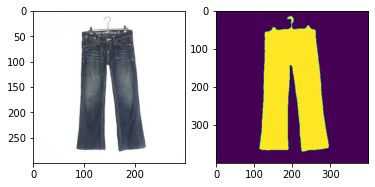

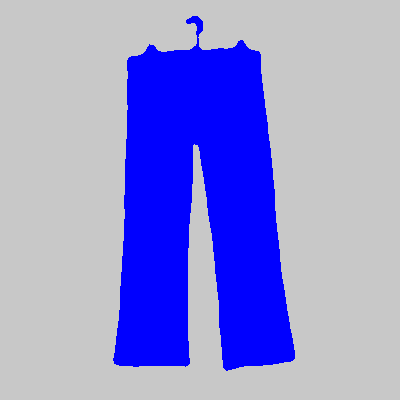

 99%|████████████████████████████████████████████████████████████▌| 894/900 [02:22<00:00,  6.23it/s]

torch.Size([1, 3, 400, 400])
/mnt/nas4/hm/datasets/shopping_clothes/data/data900_personby100/outer/image/train_9414.jpg
{'background': 0, 'top': 1, 'skirt': 2, 'outer': 3, 'dress': 4, 'bottom': 5}
Counter({0: 92984, 3: 67016})


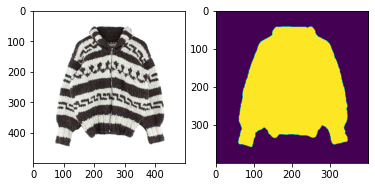

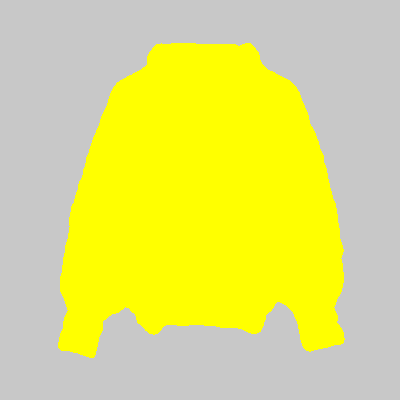

 99%|████████████████████████████████████████████████████████████▋| 895/900 [02:22<00:00,  6.36it/s]

torch.Size([1, 3, 400, 400])
/mnt/nas4/hm/datasets/shopping_clothes/data/data900_personby100/outer/image/train_7905.jpg
{'background': 0, 'top': 1, 'skirt': 2, 'outer': 3, 'dress': 4, 'bottom': 5}
Counter({0: 85356, 3: 74644})


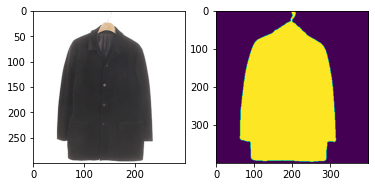

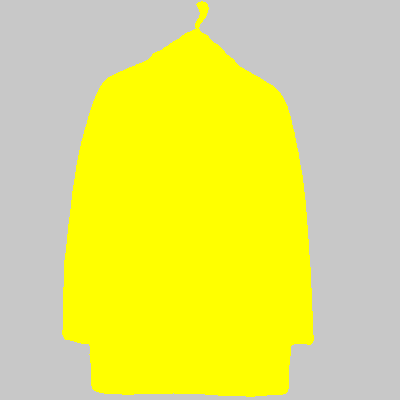

100%|████████████████████████████████████████████████████████████▋| 896/900 [02:22<00:00,  6.62it/s]

torch.Size([1, 3, 400, 400])
/mnt/nas4/hm/datasets/shopping_clothes/data/data900_personby100/dress/image/train_3810.jpg
{'background': 0, 'top': 1, 'skirt': 2, 'outer': 3, 'dress': 4, 'bottom': 5}
Counter({0: 98416, 4: 61584})


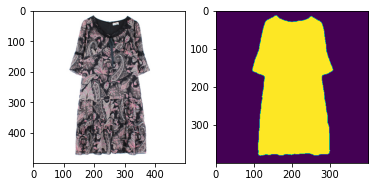

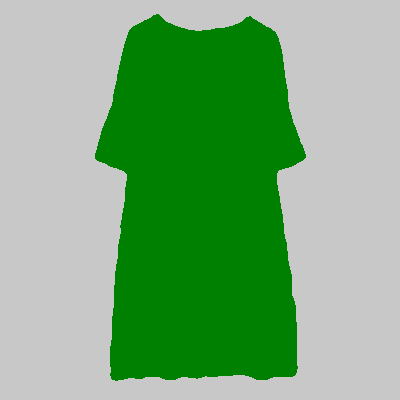

100%|████████████████████████████████████████████████████████████▊| 897/900 [02:22<00:00,  6.63it/s]

torch.Size([1, 3, 400, 400])
/mnt/nas4/hm/datasets/shopping_clothes/data/data900_personby100/skirt/image/train_2408.jpg
{'background': 0, 'top': 1, 'skirt': 2, 'outer': 3, 'dress': 4, 'bottom': 5}
Counter({0: 94015, 2: 65985})


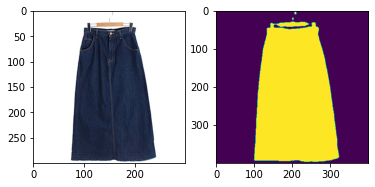

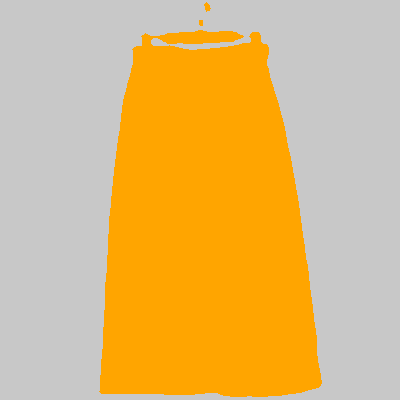

100%|████████████████████████████████████████████████████████████▊| 898/900 [02:23<00:00,  6.83it/s]

torch.Size([1, 3, 400, 400])
/mnt/nas4/hm/datasets/shopping_clothes/data/data900_personby100/skirt/image/train_613.jpg
{'background': 0, 'top': 1, 'skirt': 2, 'outer': 3, 'dress': 4, 'bottom': 5}
Counter({0: 99233, 2: 60767})


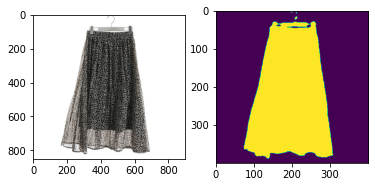

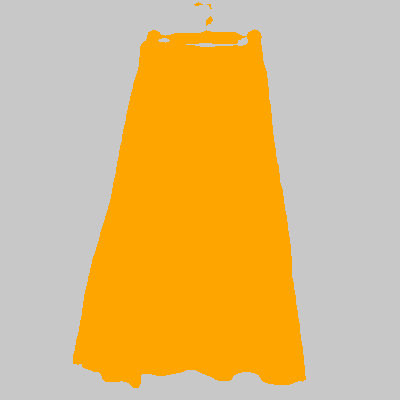

100%|████████████████████████████████████████████████████████████▉| 899/900 [02:23<00:00,  5.63it/s]

torch.Size([1, 3, 400, 400])
/mnt/nas4/hm/datasets/shopping_clothes/data/data900_personby100/dress/image/train_1363.jpg
{'background': 0, 'top': 1, 'skirt': 2, 'outer': 3, 'dress': 4, 'bottom': 5}
Counter({0: 117059, 4: 42941})


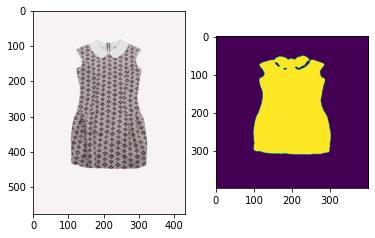

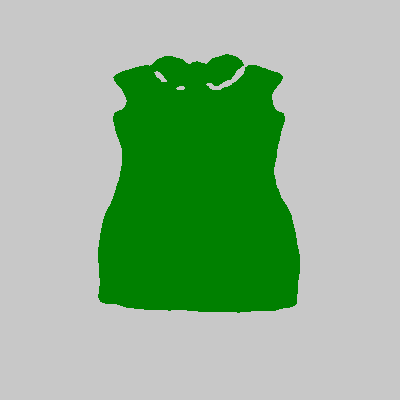

100%|█████████████████████████████████████████████████████████████| 900/900 [02:23<00:00,  6.27it/s]


In [15]:
scales = [0.75, 1.0, 1.25, 1.5, 1.75, 2.0, 2.25] 
w,h = config['val_loader']['args']['base_size'], config['val_loader']['args']['base_size']

with torch.no_grad():
    tbar = tqdm(image_files, ncols=100)
    for img_file in tbar:
        image = Image.open(img_file).convert('RGB')
        image = np.asarray(image)
        inputs = cv2.resize(image, (w, h), interpolation=cv2.INTER_LINEAR)
        inputs = normalize(to_tensor(inputs)).unsqueeze(0)
        inputs = inputs.to(device)
#         inputs = torch.tensor(inputs,dtype=torch.float32)

        if args.mode == 'multiscale':
            prediction = multi_scale_predict(model, inputs, scales, num_classes, device)
        elif args.mode == 'sliding':
            prediction = sliding_predict(model, inputs, num_classes)
        else:
            prediction = model(inputs.to(device))
            prediction = prediction.squeeze(0).cpu().numpy()
        prediction = F.softmax(torch.from_numpy(prediction), dim=0).argmax(0).cpu().numpy()
#         save_images(image, prediction, args.output, img_file, palette)

        plt.subplot(1, 2, 1) 
        print(inputs.shape)
        print(img_file)
        print(val_dataset.get_classes())
        print(Counter(prediction.flatten()))
        t = Image.open(img_file)
        plt.imshow(t)
        plt.subplot(1, 2, 2) 
        plt.imshow(prediction)
        plt.show()
        display(colorize_mask(prediction, palette))
        
#         break


  0%|                                                                        | 0/25 [00:00<?, ?it/s]

torch.Size([1, 3, 400, 400])
./test_img/real_img/jungo_Tshirts5.PNG
{'background': 0, 'top': 1, 'skirt': 2, 'outer': 3, 'dress': 4, 'bottom': 5}
Counter({1: 69061, 0: 38944, 3: 26809, 5: 21102, 2: 4063, 4: 21})


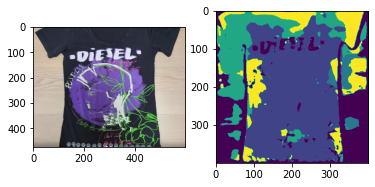

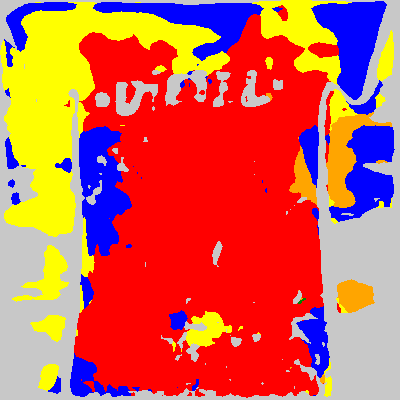

  4%|██▌                                                             | 1/25 [00:00<00:03,  6.51it/s]

torch.Size([1, 3, 400, 400])
./test_img/real_img/jungo_Tshirts4.PNG
{'background': 0, 'top': 1, 'skirt': 2, 'outer': 3, 'dress': 4, 'bottom': 5}
Counter({1: 140577, 0: 19423})


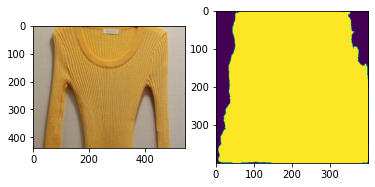

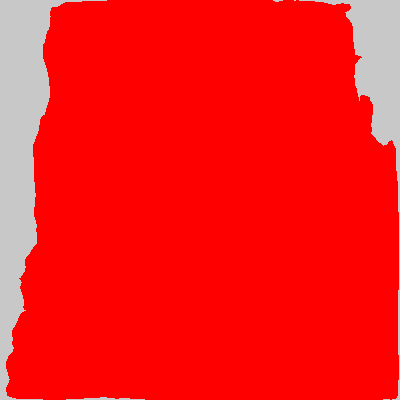

  8%|█████                                                           | 2/25 [00:00<00:03,  6.60it/s]

torch.Size([1, 3, 400, 400])
./test_img/real_img/white2.PNG
{'background': 0, 'top': 1, 'skirt': 2, 'outer': 3, 'dress': 4, 'bottom': 5}
Counter({3: 71064, 0: 65600, 4: 20813, 2: 2523})


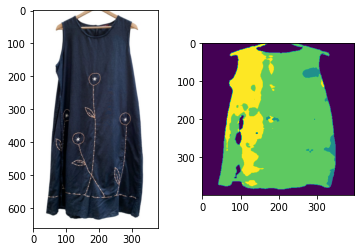

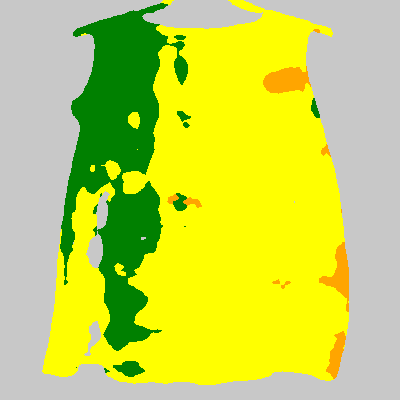

 12%|███████▋                                                        | 3/25 [00:00<00:03,  6.60it/s]

torch.Size([1, 3, 400, 400])
./test_img/real_img/jungo_pants3.PNG
{'background': 0, 'top': 1, 'skirt': 2, 'outer': 3, 'dress': 4, 'bottom': 5}
Counter({5: 120651, 0: 39092, 3: 257})


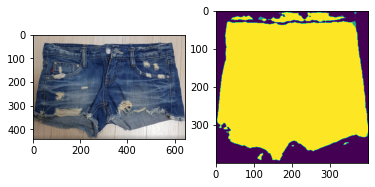

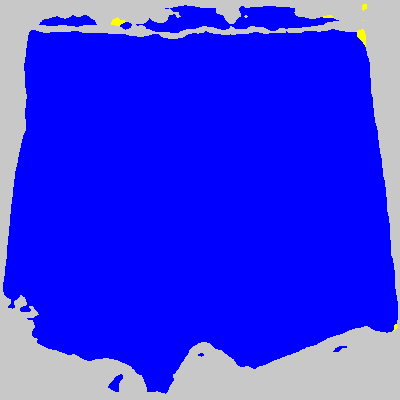

 16%|██████████▏                                                     | 4/25 [00:00<00:03,  6.55it/s]

torch.Size([1, 3, 400, 400])
./test_img/real_img/jungo_Tshirts2.PNG
{'background': 0, 'top': 1, 'skirt': 2, 'outer': 3, 'dress': 4, 'bottom': 5}
Counter({1: 133343, 0: 26310, 5: 298, 2: 49})


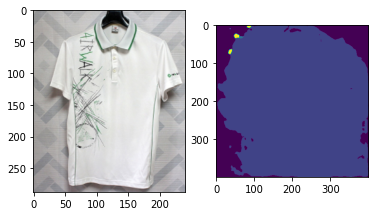

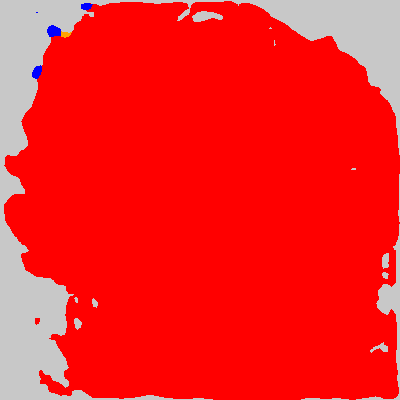

 20%|████████████▊                                                   | 5/25 [00:00<00:03,  6.62it/s]

torch.Size([1, 3, 400, 400])
./test_img/real_img/jungo_Tshirts1.PNG
{'background': 0, 'top': 1, 'skirt': 2, 'outer': 3, 'dress': 4, 'bottom': 5}
Counter({1: 86398, 0: 60199, 3: 13403})


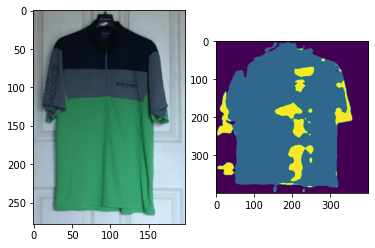

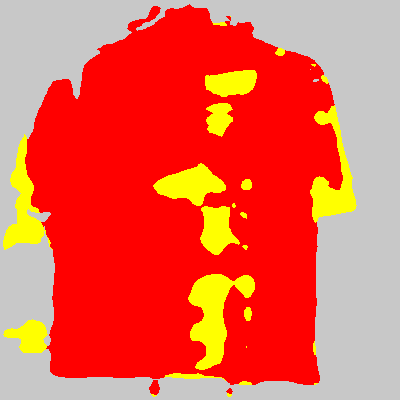

 24%|███████████████▎                                                | 6/25 [00:00<00:02,  6.76it/s]

torch.Size([1, 3, 400, 400])
./test_img/real_img/jungo_Tshirts3.PNG
{'background': 0, 'top': 1, 'skirt': 2, 'outer': 3, 'dress': 4, 'bottom': 5}
Counter({0: 106197, 1: 47975, 4: 5269, 2: 559})


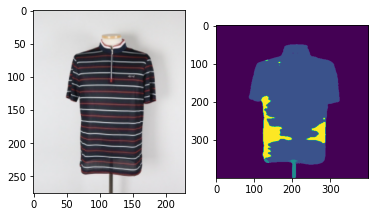

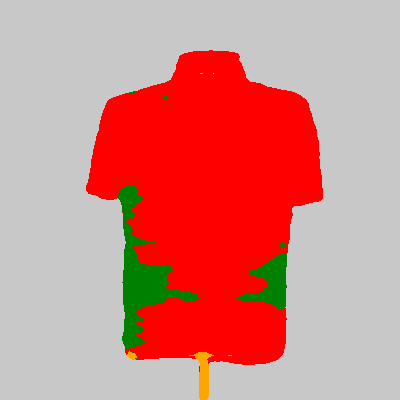

 28%|█████████████████▉                                              | 7/25 [00:01<00:02,  6.89it/s]

torch.Size([1, 3, 400, 400])
./test_img/real_img/white6.PNG
{'background': 0, 'top': 1, 'skirt': 2, 'outer': 3, 'dress': 4, 'bottom': 5}
Counter({0: 98185, 5: 61815})


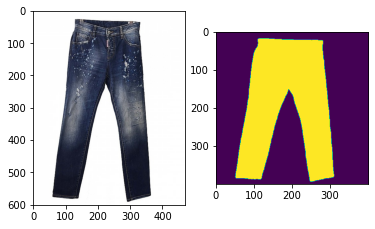

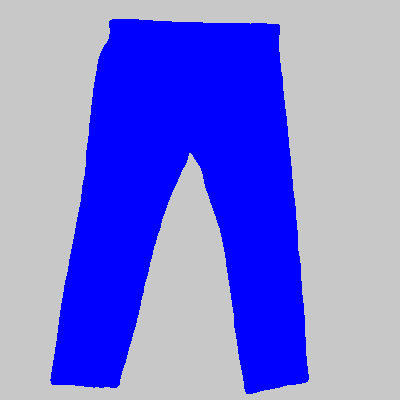

 32%|████████████████████▍                                           | 8/25 [00:01<00:02,  6.78it/s]

torch.Size([1, 3, 400, 400])
./test_img/real_img/white4.PNG
{'background': 0, 'top': 1, 'skirt': 2, 'outer': 3, 'dress': 4, 'bottom': 5}
Counter({1: 97576, 0: 62424})


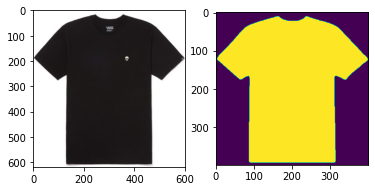

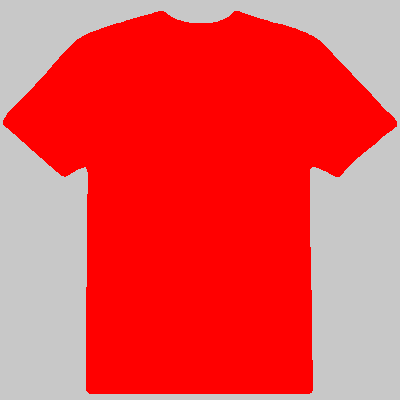

 36%|███████████████████████                                         | 9/25 [00:01<00:02,  6.66it/s]

torch.Size([1, 3, 400, 400])
./test_img/real_img/jungo_pants2.PNG
{'background': 0, 'top': 1, 'skirt': 2, 'outer': 3, 'dress': 4, 'bottom': 5}
Counter({0: 82742, 5: 77258})


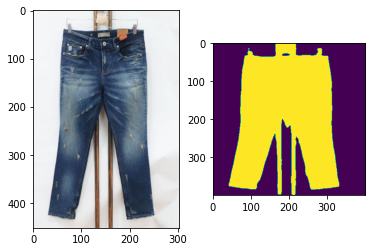

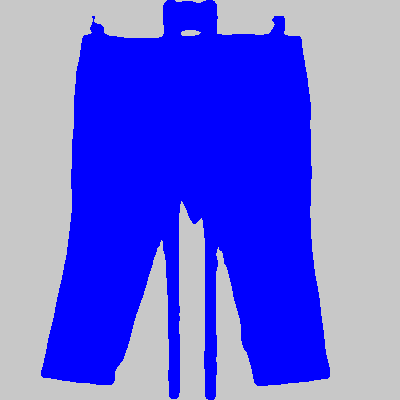

 40%|█████████████████████████▏                                     | 10/25 [00:01<00:02,  5.95it/s]

torch.Size([1, 3, 400, 400])
./test_img/real_img/jungo_onepiece3.PNG
{'background': 0, 'top': 1, 'skirt': 2, 'outer': 3, 'dress': 4, 'bottom': 5}
Counter({3: 137631, 0: 18944, 2: 2941, 5: 484})


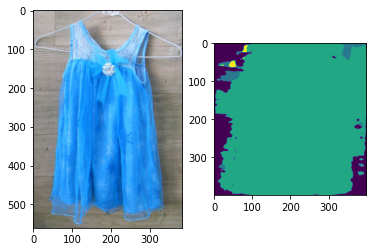

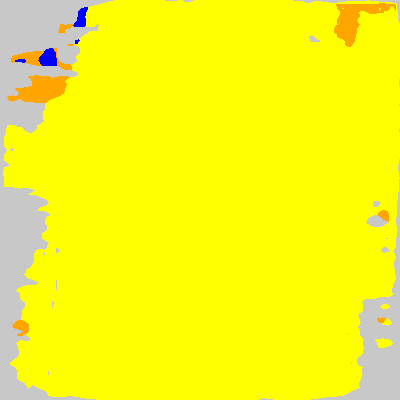

 44%|███████████████████████████▋                                   | 11/25 [00:01<00:02,  6.10it/s]

torch.Size([1, 3, 400, 400])
./test_img/real_img/jungo_Tshirts6.PNG
{'background': 0, 'top': 1, 'skirt': 2, 'outer': 3, 'dress': 4, 'bottom': 5}
Counter({1: 96158, 0: 61014, 3: 2410, 2: 418})


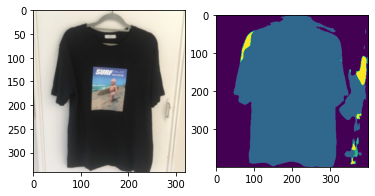

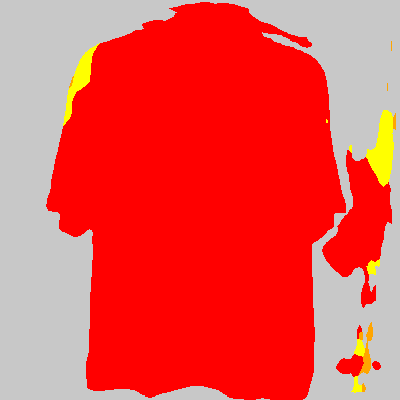

 48%|██████████████████████████████▏                                | 12/25 [00:01<00:02,  6.37it/s]

torch.Size([1, 3, 400, 400])
./test_img/real_img/잠자리원본_4854x3237.jpg
{'background': 0, 'top': 1, 'skirt': 2, 'outer': 3, 'dress': 4, 'bottom': 5}
Counter({0: 123339, 5: 36364, 2: 292, 3: 5})


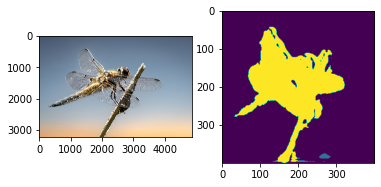

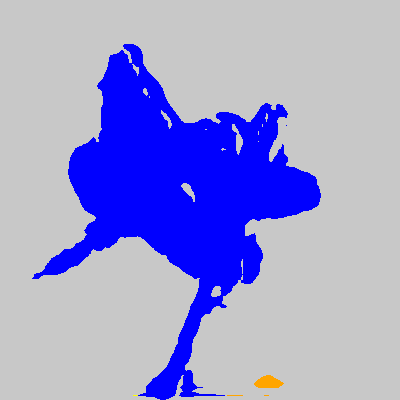

 52%|████████████████████████████████▊                              | 13/25 [00:02<00:05,  2.37it/s]

torch.Size([1, 3, 400, 400])
./test_img/real_img/white1.PNG
{'background': 0, 'top': 1, 'skirt': 2, 'outer': 3, 'dress': 4, 'bottom': 5}
Counter({0: 83069, 4: 76931})


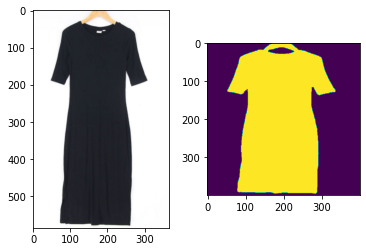

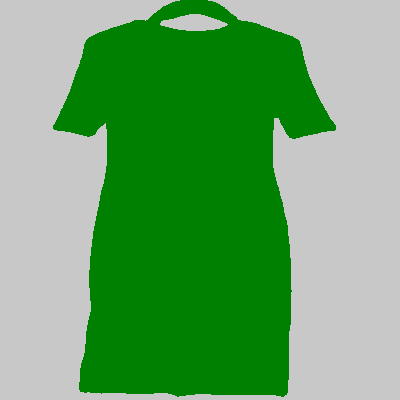

 56%|███████████████████████████████████▎                           | 14/25 [00:03<00:03,  2.95it/s]

torch.Size([1, 3, 400, 400])
./test_img/real_img/jungo_pants6.PNG
{'background': 0, 'top': 1, 'skirt': 2, 'outer': 3, 'dress': 4, 'bottom': 5}
Counter({2: 144039, 3: 9863, 0: 5917, 1: 181})


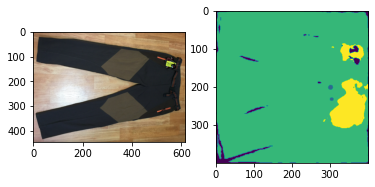

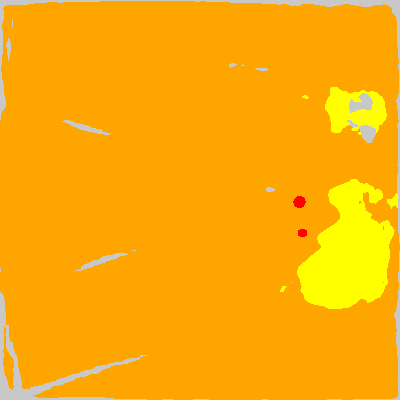

 60%|█████████████████████████████████████▊                         | 15/25 [00:03<00:02,  3.53it/s]

torch.Size([1, 3, 400, 400])
./test_img/real_img/jungo_onepiece1.PNG
{'background': 0, 'top': 1, 'skirt': 2, 'outer': 3, 'dress': 4, 'bottom': 5}
Counter({3: 133980, 0: 25234, 5: 699, 4: 87})


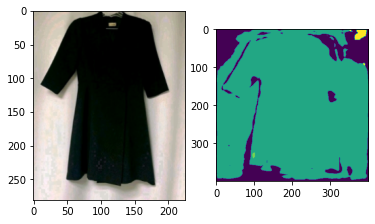

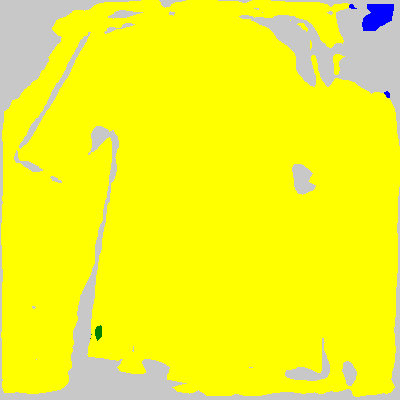

 64%|████████████████████████████████████████▎                      | 16/25 [00:03<00:02,  4.16it/s]

torch.Size([1, 3, 400, 400])
./test_img/real_img/jungo_pants4.PNG
{'background': 0, 'top': 1, 'skirt': 2, 'outer': 3, 'dress': 4, 'bottom': 5}
Counter({3: 104674, 1: 35214, 2: 15560, 0: 4513, 5: 39})


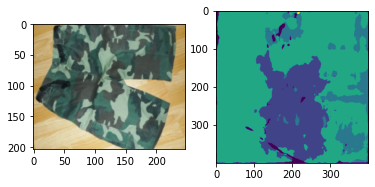

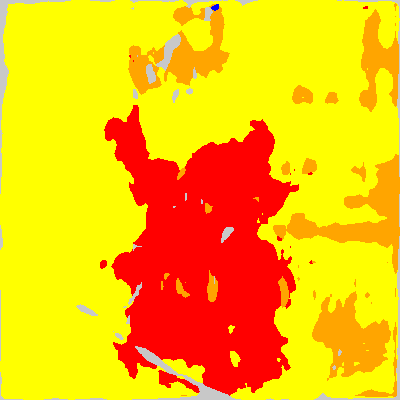

 68%|██████████████████████████████████████████▊                    | 17/25 [00:03<00:01,  4.77it/s]

torch.Size([1, 3, 400, 400])
./test_img/real_img/jungo_onepiece2.PNG
{'background': 0, 'top': 1, 'skirt': 2, 'outer': 3, 'dress': 4, 'bottom': 5}
Counter({3: 55399, 0: 43170, 4: 39302, 2: 19650, 5: 2479})


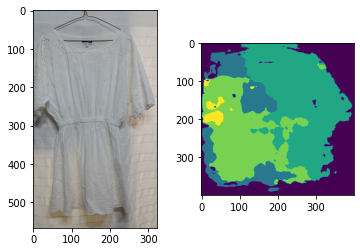

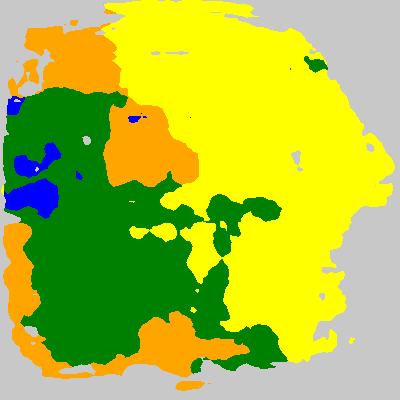

 72%|█████████████████████████████████████████████▎                 | 18/25 [00:03<00:01,  5.22it/s]

torch.Size([1, 3, 400, 400])
./test_img/real_img/jungo_pants1.PNG
{'background': 0, 'top': 1, 'skirt': 2, 'outer': 3, 'dress': 4, 'bottom': 5}
Counter({5: 87260, 0: 63695, 2: 9045})


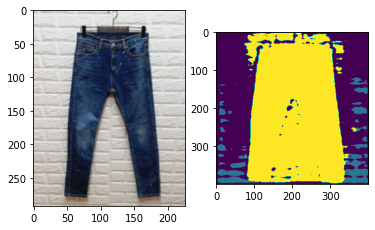

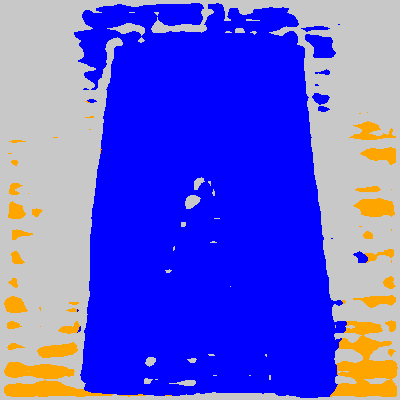

 76%|███████████████████████████████████████████████▉               | 19/25 [00:03<00:01,  5.64it/s]

torch.Size([1, 3, 400, 400])
./test_img/real_img/jungo_onepiece5.PNG
{'background': 0, 'top': 1, 'skirt': 2, 'outer': 3, 'dress': 4, 'bottom': 5}
Counter({1: 80391, 0: 77862, 5: 1035, 4: 341, 3: 192, 2: 179})


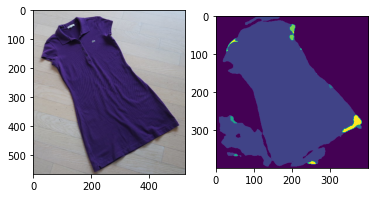

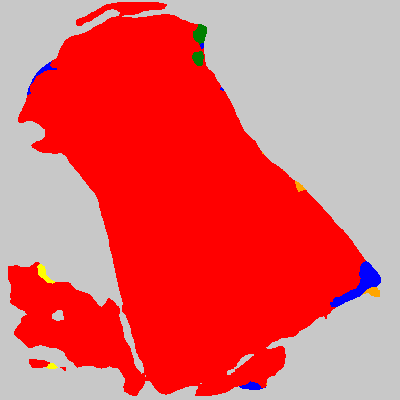

 80%|██████████████████████████████████████████████████▍            | 20/25 [00:03<00:00,  5.86it/s]

torch.Size([1, 3, 400, 400])
./test_img/real_img/jungo_onepiece6.PNG
{'background': 0, 'top': 1, 'skirt': 2, 'outer': 3, 'dress': 4, 'bottom': 5}
Counter({1: 79668, 0: 53049, 4: 19429, 3: 6054, 2: 1800})


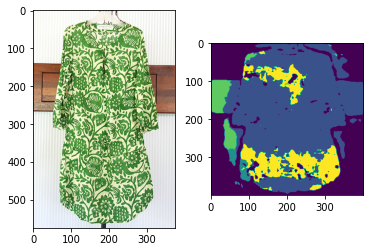

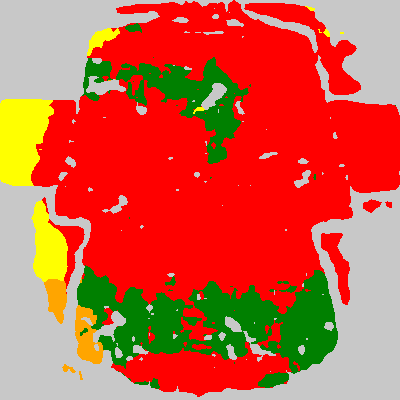

 84%|████████████████████████████████████████████████████▉          | 21/25 [00:04<00:00,  5.48it/s]

torch.Size([1, 3, 400, 400])
./test_img/real_img/white3.PNG
{'background': 0, 'top': 1, 'skirt': 2, 'outer': 3, 'dress': 4, 'bottom': 5}
Counter({4: 92589, 0: 64235, 1: 3066, 3: 110})


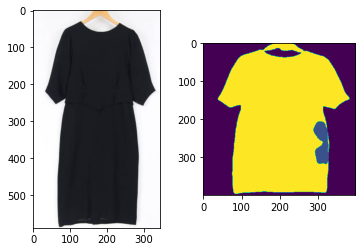

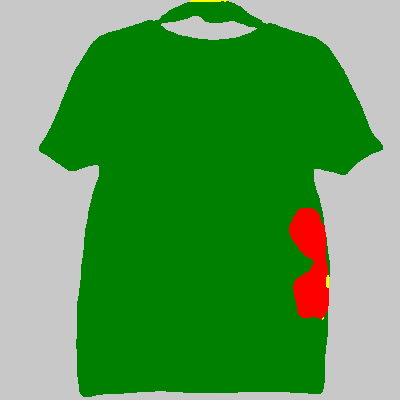

 88%|███████████████████████████████████████████████████████▍       | 22/25 [00:04<00:00,  5.86it/s]

torch.Size([1, 3, 400, 400])
./test_img/real_img/white5.PNG
{'background': 0, 'top': 1, 'skirt': 2, 'outer': 3, 'dress': 4, 'bottom': 5}
Counter({5: 101615, 0: 57670, 2: 715})


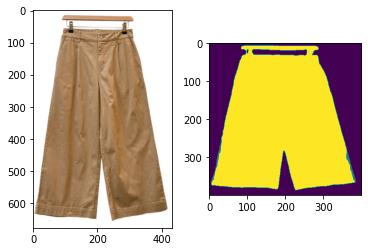

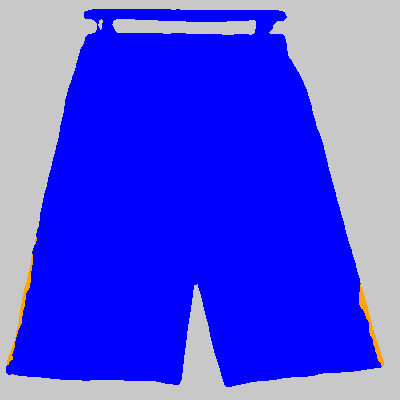

 92%|█████████████████████████████████████████████████████████▉     | 23/25 [00:04<00:00,  6.01it/s]

torch.Size([1, 3, 400, 400])
./test_img/real_img/jungo_onepiece4.PNG
{'background': 0, 'top': 1, 'skirt': 2, 'outer': 3, 'dress': 4, 'bottom': 5}
Counter({0: 72808, 3: 72134, 2: 10289, 4: 4643, 5: 126})


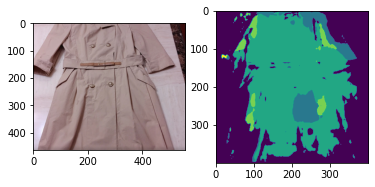

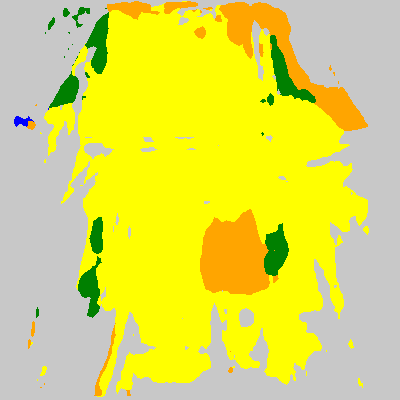

 96%|████████████████████████████████████████████████████████████▍  | 24/25 [00:04<00:00,  6.19it/s]

torch.Size([1, 3, 400, 400])
./test_img/real_img/jungo_pants5.PNG
{'background': 0, 'top': 1, 'skirt': 2, 'outer': 3, 'dress': 4, 'bottom': 5}
Counter({5: 93067, 0: 61004, 2: 5929})


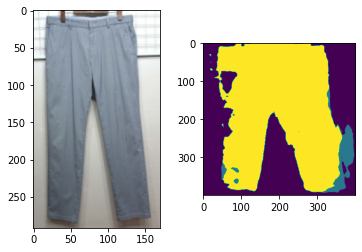

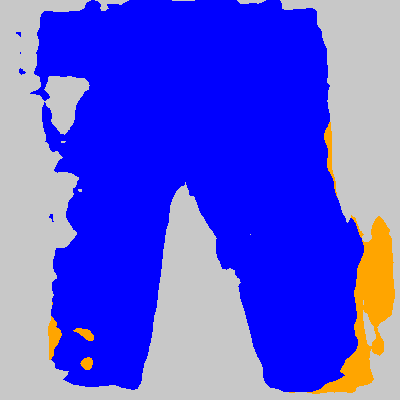

100%|███████████████████████████████████████████████████████████████| 25/25 [00:04<00:00,  5.31it/s]


In [16]:
image_files = os.listdir('./test_img/real_img')
image_files = [os.path.join('./test_img/real_img',i) for i in image_files]

scales = [0.75, 1.0, 1.25, 1.5, 1.75, 2.0, 2.25] 
w,h = config['val_loader']['args']['base_size'], config['val_loader']['args']['base_size']

with torch.no_grad():
    tbar = tqdm(image_files, ncols=100)
    for img_file in tbar:
        image = Image.open(img_file).convert('RGB')
        image = np.asarray(image)
        inputs = cv2.resize(image, (w, h), interpolation=cv2.INTER_LINEAR)
        inputs = normalize(to_tensor(inputs)).unsqueeze(0)
        inputs = inputs.to(device)
#         inputs = torch.tensor(inputs,dtype=torch.float32)

        if args.mode == 'multiscale':
            prediction = multi_scale_predict(model, inputs, scales, num_classes, device)
        elif args.mode == 'sliding':
            prediction = sliding_predict(model, inputs, num_classes)
        else:
            prediction = model(inputs.to(device))
            prediction = prediction.squeeze(0).cpu().numpy()
        prediction = F.softmax(torch.from_numpy(prediction), dim=0).argmax(0).cpu().numpy()
#         save_images(image, prediction, args.output, img_file, palette)

        plt.subplot(1, 2, 1) 
        print(inputs.shape)
        print(img_file)
        print(val_dataset.get_classes())
        print(Counter(prediction.flatten()))
        t = Image.open(img_file)
        plt.imshow(t)
        plt.subplot(1, 2, 2) 
        plt.imshow(prediction)
        plt.show()
        display(colorize_mask(prediction, palette))
        
#         break
